In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
!nvidia-smi

Mon Feb 27 11:42:34 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.82.01    Driver Version: 470.82.01    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla T4            Off  | 00000000:00:05.0 Off |                    0 |
| N/A   

In [3]:
# import the libraries
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [4]:
# visualization function
def show(tensor, ch = 1, size = (28,28), num = 16):
  data = tensor.detach().cpu().view(-1,ch, *size)
  """detaches the variable(tensor) from all gradient computation . We want to just visualize what's 
  contained in the variable and not the gradient computation which is done during back propagation. Then we pass it to the cpu for visualization .
   Then we restructure(28x28= 784) the tensor
   with the function view and store it in a variable called data.
   The tensor is going to have the size of 128( we are going to use a batch size of 128) x 784, 
   -1 means whatever remains after 1(ch)x28x28 will be 1 dimensional i.e. in 128x784 , what remains after 1x28x28 is 128, so 128 is the size of 1 dimension"""
  grid = make_grid(data[:num], nrow  = 4 ).permute(1,2,0) 
  """ make_grid will give a series of images with structure 1x 28x28. But to display in matplotlib . The order of image is different for pytorch and in matplotlib
   pytorch is using the dimension as ch, width & height. But if we want to use matplotlib we want to have width, height and channel. So we need to change the order when we want to visualize the image from pytorch to matplotlib.
  so 1 X 28 x 28 becomes 28 x 28 x 1( width, height, channel or ch)"""
  plt.imshow(grid)
  plt.show()

In [5]:
# setup of the main parameters and hyerparameters
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0 
mean_disc_loss = 0 #mean discriminator loss

z_dim = 64  #dimensionality of the latent space of the noise vector i.e.the input
# vector of the generator that we are going to learn
lr = 0.00001 # speed of the neural network that we are going to tweak the nn i.e.
# push the nn in the negative directiof of the gradient.
loss_func = nn.BCEWithLogitsLoss()  # BCELoss is already coded by pytorch. It has
# two possibilities. BCEWithLogitsLoss and BCELoss. You first want to convert the
# numberical values to the range 0 to 1 . You want to that before you calculate 
#the loss. You can get result that are numerically more stable with this approach.

bs = 128  # batch size, during each step of the training how many images are we 
# going to preocess at once in the GPU.
device = 'cuda' # we cna proces tthe dat ain tht CPU but we can process it much 
# faster in the GPU.

dataloader = DataLoader(MNIST('.',download =True, transform = transforms.ToTensor()), shuffle = True, batch_size = bs)  
"""holds the trianing data . its a structure call the iterator that we will get tback a batch aof the training data  that will contaain a se tof the inut dat afa and a st of lable for those inpout data.
Where we want to store the data - in root ( '.'), download the data ( MNIST). After we download the data to the roor forlder then transofrm it to the format of a multidimensional tensor. Shuffle is true means after every epoch the data is going to be reshufflled. 

number of steps = 60000/128( batch size) = 468.75 / # MNIST DATAset has 60000 images. So each batch size will be of size 469."""


  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



"holds the trianing data . its a structure call the iterator that we will get tback a batch aof the training data  that will contaain a se tof the inut dat afa and a st of lable for those inpout data.\nWhere we want to store the data - in root ( '.'), download the data ( MNIST). After we download the data to the roor forlder then transofrm it to the format of a multidimensional tensor. Shuffle is true means after every epoch the data is going to be reshufflled. \n\nnumber of steps = 60000/128( batch size) = 468.75 / # MNIST DATAset has 60000 images. So each batch size will be of size 469."

In [6]:
# declare our models

# Generator 

def genBlock(inp , out):
  return nn.Sequential(
      nn.Linear(inp, out), 
      nn.BatchNorm1d(out),
      nn.ReLU(  inplace = True)
       )
  """ 
  non linear network e.g. ReLu introduced here as non linear function in between 
  linear layers to learn complex functions. Whatever is negagive it sets to 0 and
  whatevet is positve it just let it to pass
  """
class Generator(nn.Module):
  def __init__(self, z_dim = 64, i_dim = 784, h_dim = 128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), # 64, 128 - generator is receiving an input of 
        # noise vector of size 64 and outputs an image of size 784 = 28x 28 , 
        # i.e. the size of the MNIST dataset images. To produce the noise vector 
        # we are going to call the gen_noise function, the number will be 
        # corresponding to the size of the batch and the size of the batch is 128.
        genBlock(h_dim, h_dim*2), # 128 , 256
        genBlock(h_dim*2, h_dim*4), # 256 , 512
        genBlock(h_dim*4, h_dim*8), # 512, 1024
        nn.Linear( h_dim*8, i_dim),  # for the output a single fully connected layer 
        nn.Sigmoid(), #we want the output to be between 0 and 1. Sigmoid function
        # sets the output values between 0 and 1
        
    )

  def forward(self, noise):
    return self.gen(noise)

def gen_noise(number, z_dim):
  return torch.randn(number, z_dim).to(device)
  """
  randn is a stochastic function that returns a tensor field random no. from a
  normal distribution with mean 0 and var 1 called standard normal distribution.
   Then we store the input of the generator in the GPU
  """
## Discriminator
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2) 
      #non linearity so that the discriminator can learn complex 
      # mappings. Leaky ReLu has the danger of what we call the dying ReLu cause
      # we are setting all the negative avalue to 0 . Some neurons may actually 
      # die , they may become 0 and give gradient of 0 . To avoid this we use 
      # leaky Rlu . it will giv ethem a small negaitve value instead of 0 on a 
      #certain slope.this is gonna hekp specially the discrimanator to make the 
      # training better.

  )

class Discriminator(nn.Module):
  def __init__(self, i_dim = 784, h_dim = 256):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim, h_dim*4), # 784, 1024-- The input of discriminator is an
        # image of size 28 x 28 = 784 . It will go form the dimension of
        # the image to the dimension of the hidden layer. We are going to start
        # as if we are going to go from large no.  of dimmersoin  untill we 
        # finish in the dimension of 1 value. The output is going to say if the 
        # image if real or fake. Real mean 1 and fake image means it will give 0
        discBlock(h_dim*4, h_dim*2),# 1024, 512
        discBlock(h_dim*2, h_dim), # 512, 256
        nn.Linear(h_dim, 1) # 256, 1
    )

  def forward( self, image):
    return self.disc(image)# The discriminator will return an output of value o or 1
    


In [7]:
gen = Generator(z_dim).to(device)# we want the input data to be on the GPU with to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr = lr) # the optimizer will be incharge of calculatin ghe gardinet doing the 
#back propagaiton an then tweaking and updatein g=a;; teh parameter so both the generaors and siccriminatora applijng the correct learning rate with teht correct algorithnm
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr)

In [8]:
!nvidia-smi

Mon Feb 27 11:42:46 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.82.01    Driver Version: 470.82.01    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    26W /  70W |    552MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla T4            Off  | 00000000:00:05.0 Off |                    0 |
| N/A   

In [9]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [10]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [11]:
x, y = next(iter(dataloader))# take the data loader structure and cast it as 
# an iterator and give me the nex tbatch . the loader is gonna give u a whole bathc of 128 images.
print(x.shape, y.shape)
print(y[:10])

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([3, 0, 8, 3, 0, 5, 8, 6, 5, 9])


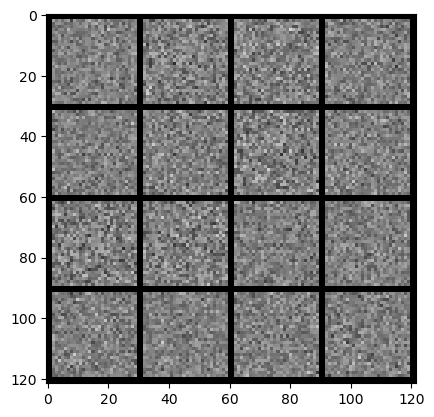

In [12]:
noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

What we are seeing above is the inital output of passing the noise through the 
generator. Because the generator did not begin to learn, it produces a very noisy output.

In [13]:
# calculating the loss

# generator loss
def calc_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  pred = disc(fake)
  targets = torch.ones_like(pred) #its gonna create a tenor with the dimensionsality similar to the prediction sand its gonna fil it up with ones. 
  gen_loss = loss_func(pred, targets)
  return gen_loss


def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  disc_fake = disc(fake.detach()) #when pytorch backpropagates this loss i.e. the loss
  # of the discriminator we dont want to change the parameter of generator, when we are optiminsing the parameters of the generator.We
  # want to optimize and tweak only the parameter so the discriminators not the 
  # ones of the generator so we detach the fake images from the calculations of the gradients,etc. with detach.
  disc_fake_targets = torch.zeros_like(disc_fake)
  disc_fake_loss = loss_func(disc_fake, disc_fake_targets)

  disc_real = disc(real)
  disc_real_targets = torch.ones_like(disc_real)
  disc_real_loss = loss_func(disc_real, disc_real_targets)

  disc_loss = (disc_fake_loss + disc_real_loss)/2
  
  return disc_loss
    
    

### 60000/ 128 = 468.75 ~ 469 steps in each epoch
### Each step is going to process 128 images= size of the batch (except the last step)

  0%|          | 0/469 [00:00<?, ?it/s]

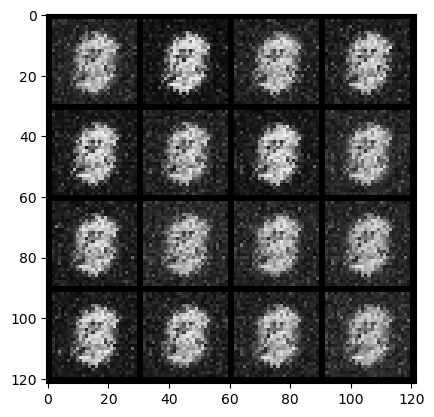

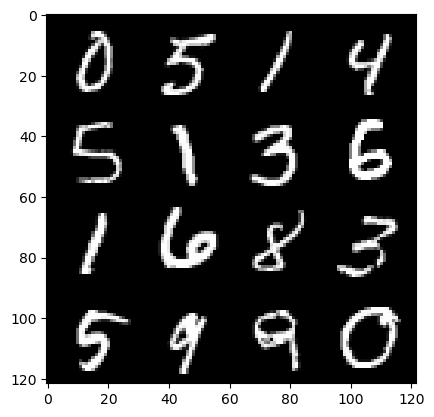

0: step 300/ Gen loss: 1.8815399863322568/ disc_loss: 0.34358587744335345


  0%|          | 0/469 [00:00<?, ?it/s]

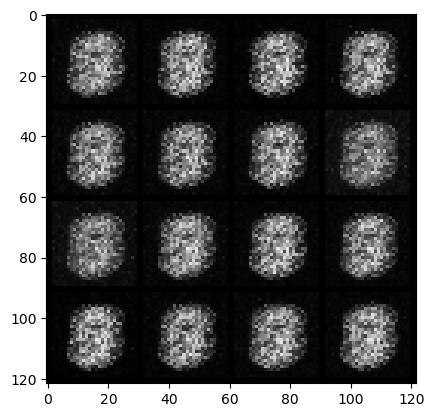

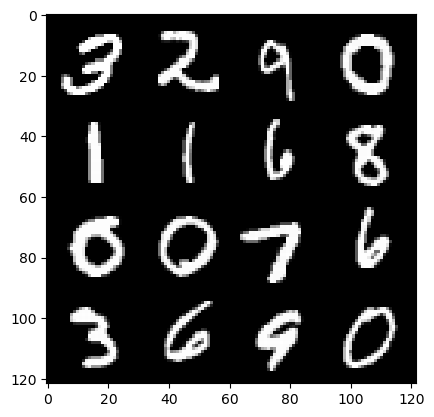

1: step 600/ Gen loss: 3.5230854201316846/ disc_loss: 0.11375158960620554


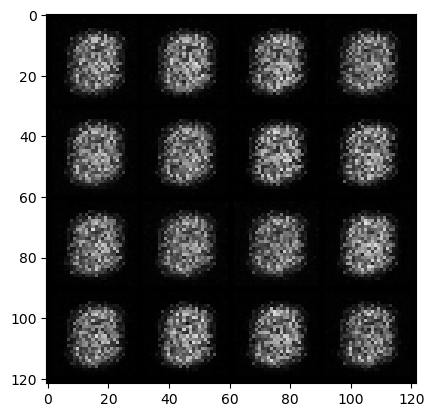

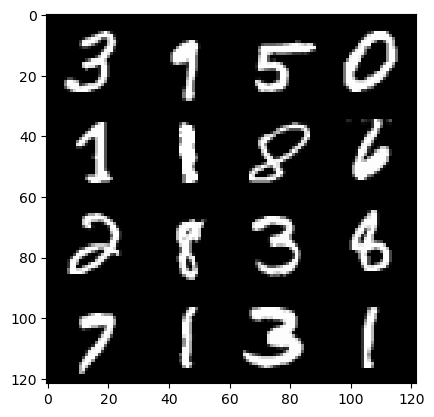

1: step 900/ Gen loss: 3.4999063396453853/ disc_loss: 0.05253375476847091


  0%|          | 0/469 [00:00<?, ?it/s]

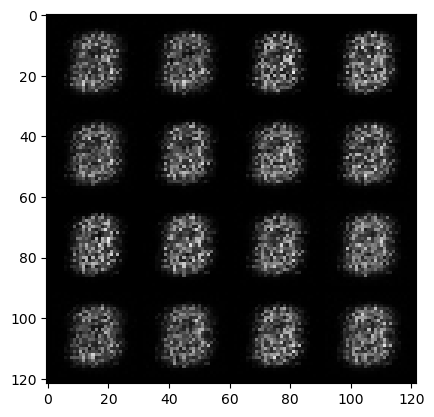

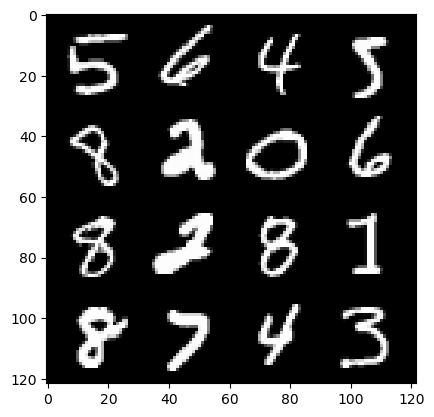

2: step 1200/ Gen loss: 3.5085643641153976/ disc_loss: 0.03736115556210278


  0%|          | 0/469 [00:00<?, ?it/s]

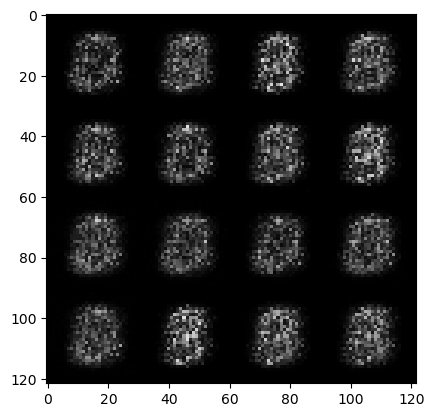

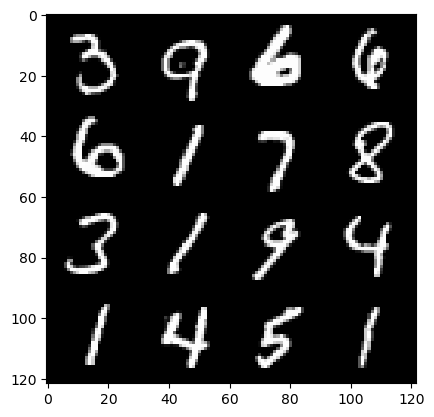

3: step 1500/ Gen loss: 3.4287541238466916/ disc_loss: 0.039929246374716336


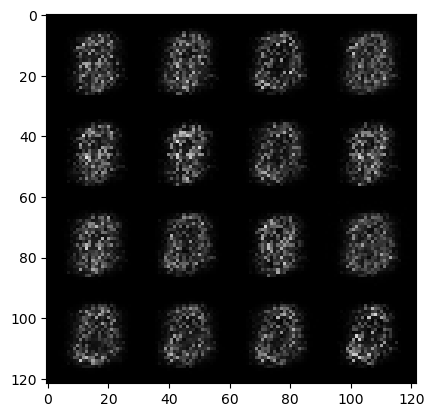

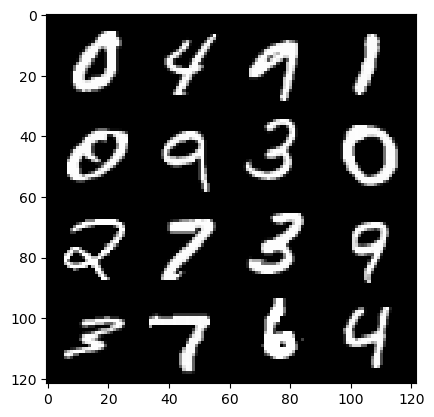

3: step 1800/ Gen loss: 3.357361790339152/ disc_loss: 0.046350920957823546


  0%|          | 0/469 [00:00<?, ?it/s]

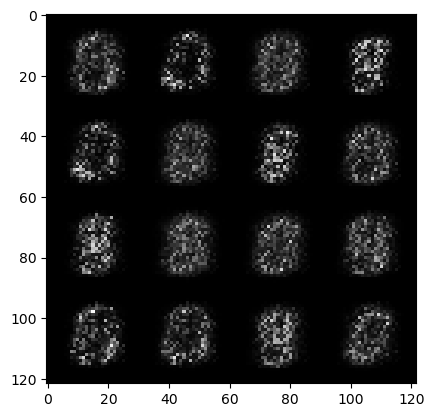

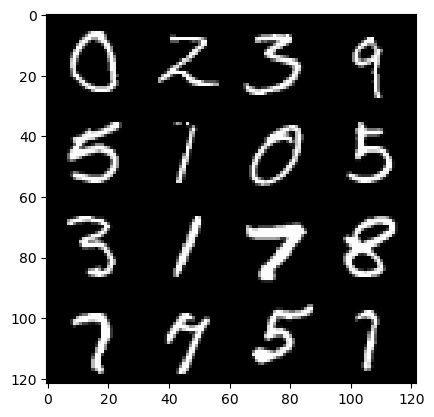

4: step 2100/ Gen loss: 3.6022352250417047/ disc_loss: 0.04558706707010667


  0%|          | 0/469 [00:00<?, ?it/s]

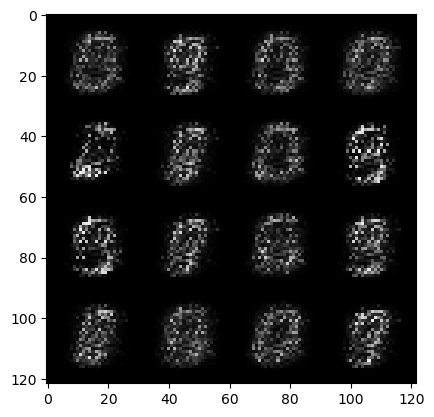

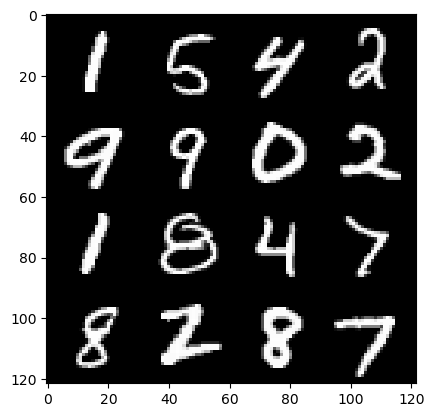

5: step 2400/ Gen loss: 4.080313518047332/ disc_loss: 0.03642924221232531


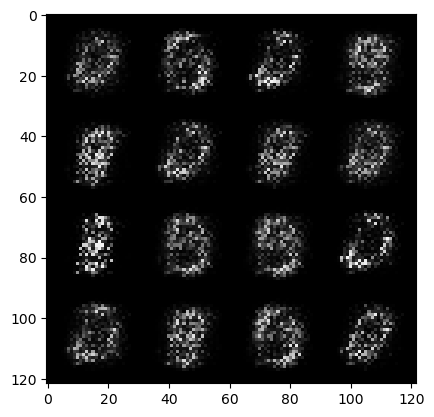

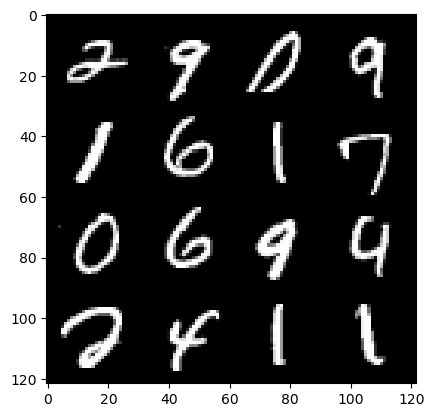

5: step 2700/ Gen loss: 4.355641249815623/ disc_loss: 0.030123697227487964


  0%|          | 0/469 [00:00<?, ?it/s]

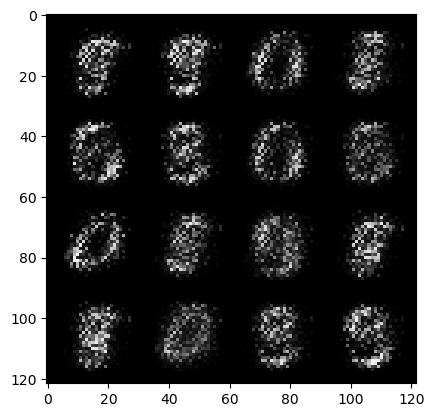

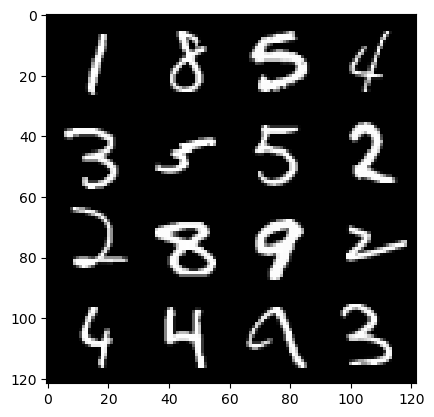

6: step 3000/ Gen loss: 4.971518616676333/ disc_loss: 0.024141903690372894


  0%|          | 0/469 [00:00<?, ?it/s]

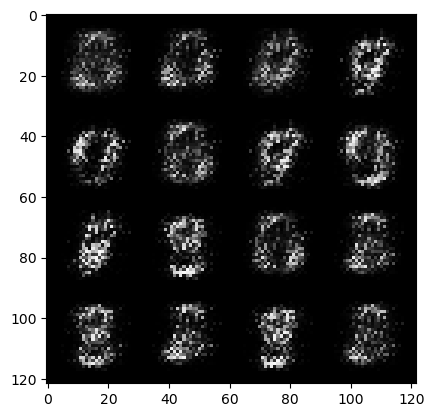

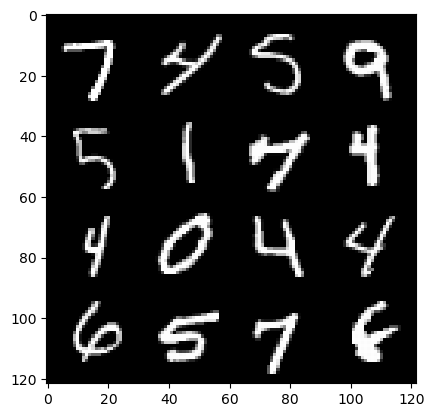

7: step 3300/ Gen loss: 5.115478868484495/ disc_loss: 0.024880779335896164


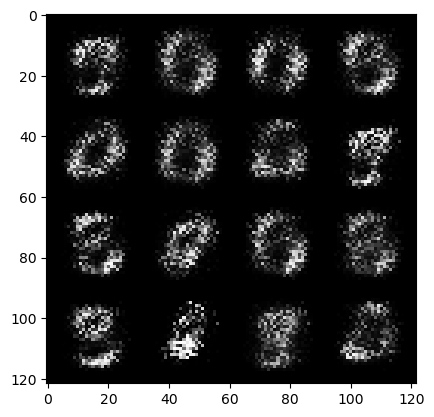

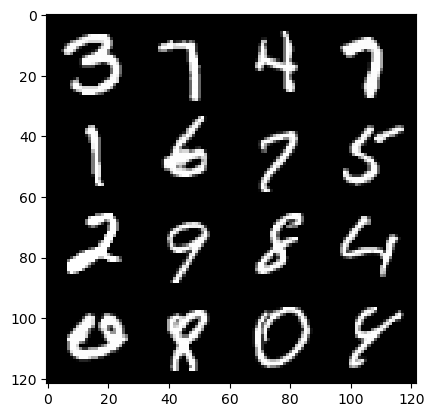

7: step 3600/ Gen loss: 5.3646067253748555/ disc_loss: 0.025898220827803024


  0%|          | 0/469 [00:00<?, ?it/s]

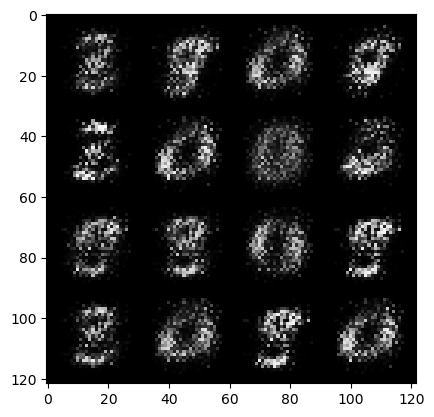

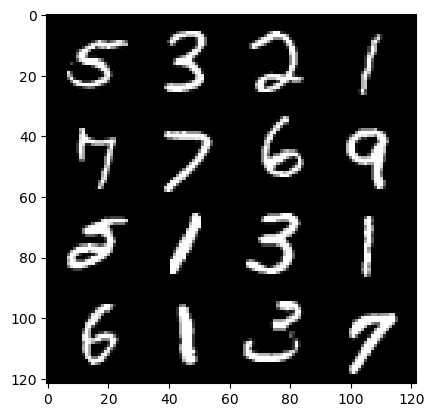

8: step 3900/ Gen loss: 5.613070958455405/ disc_loss: 0.022411556557441745


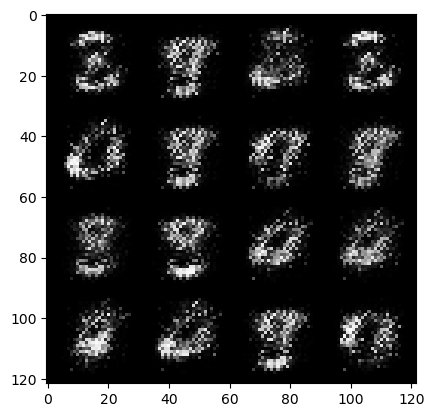

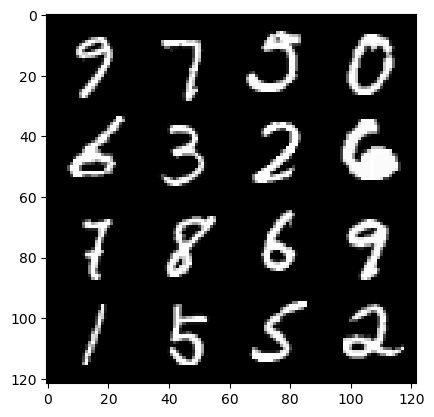

8: step 4200/ Gen loss: 5.657980395952854/ disc_loss: 0.020395380149905884


  0%|          | 0/469 [00:00<?, ?it/s]

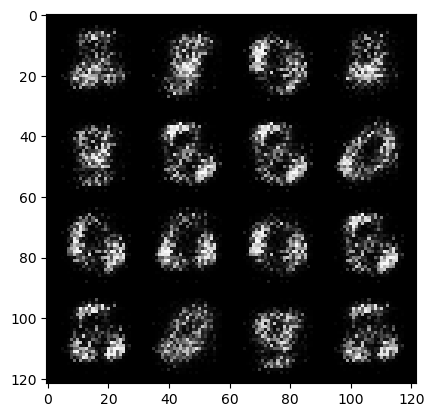

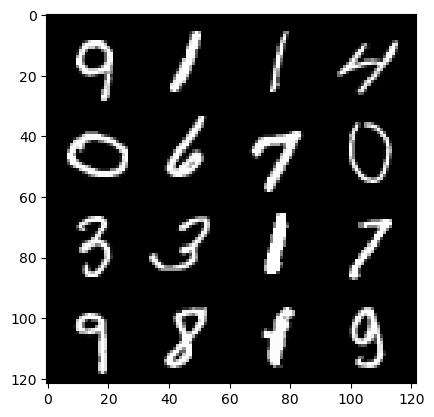

9: step 4500/ Gen loss: 6.121738095283505/ disc_loss: 0.016048592996473102


  0%|          | 0/469 [00:00<?, ?it/s]

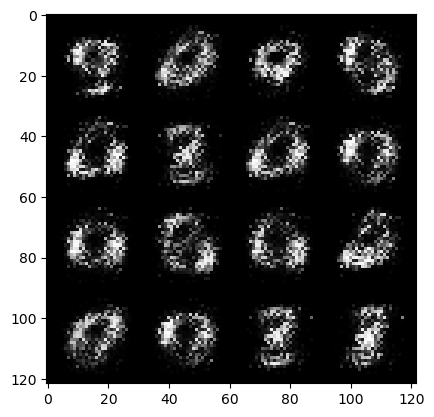

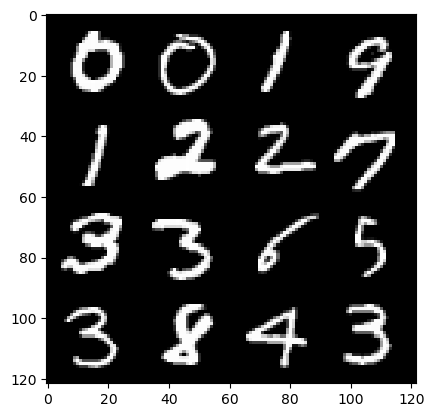

10: step 4800/ Gen loss: 5.7660209051767985/ disc_loss: 0.01644120371900499


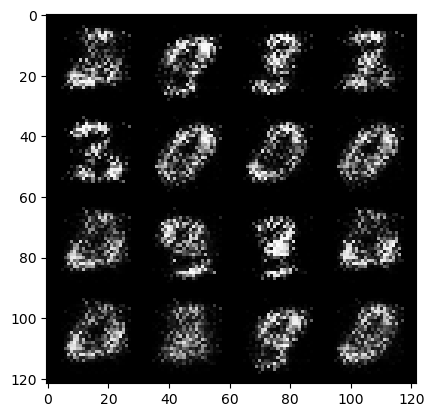

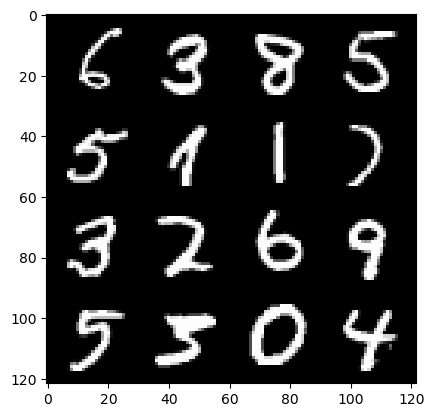

10: step 5100/ Gen loss: 6.0492368682225495/ disc_loss: 0.012414247867030404


  0%|          | 0/469 [00:00<?, ?it/s]

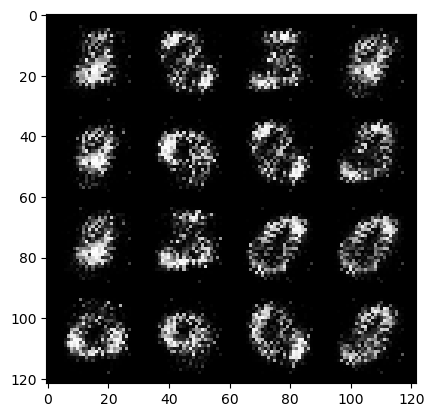

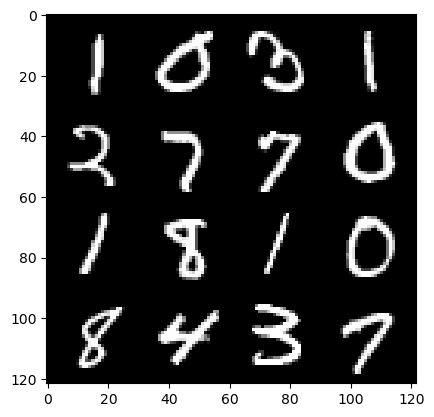

11: step 5400/ Gen loss: 6.538637674649555/ disc_loss: 0.010817541917786016


  0%|          | 0/469 [00:00<?, ?it/s]

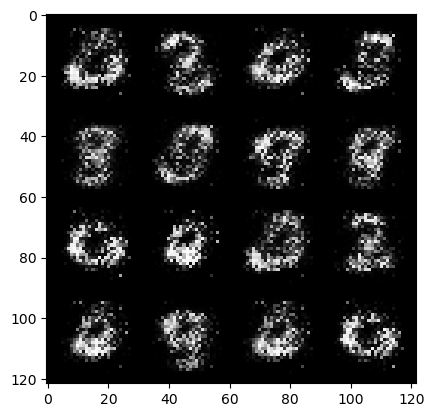

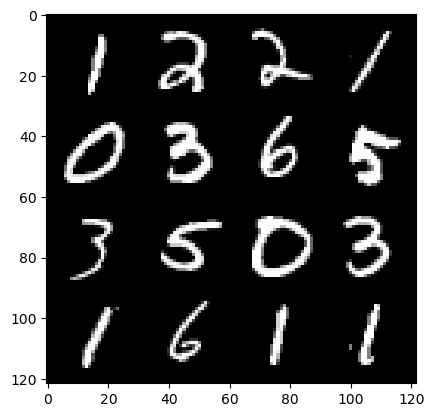

12: step 5700/ Gen loss: 6.77269797960917/ disc_loss: 0.009264141235811015


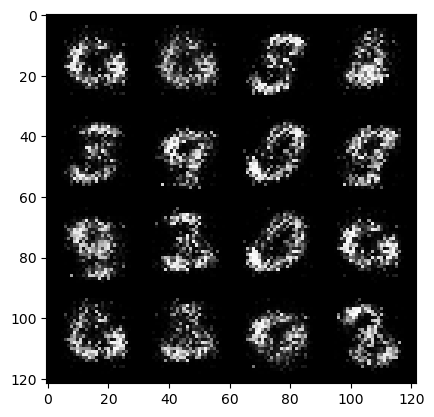

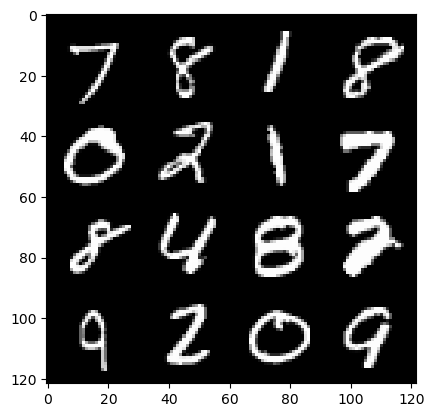

12: step 6000/ Gen loss: 6.89559586842855/ disc_loss: 0.007740678195065512


  0%|          | 0/469 [00:00<?, ?it/s]

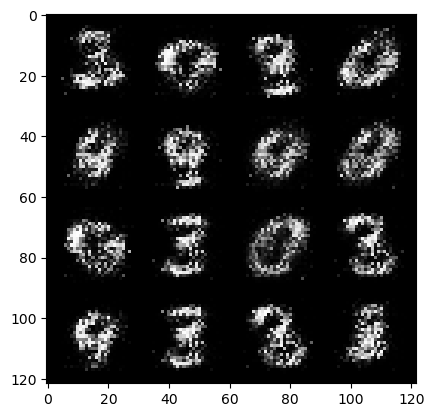

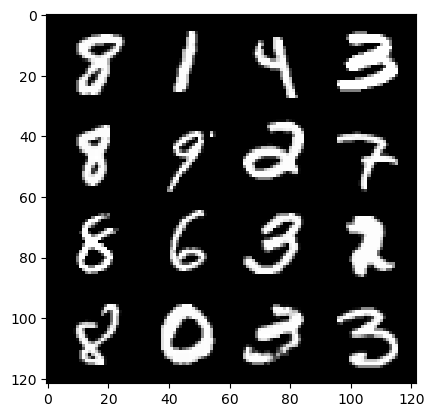

13: step 6300/ Gen loss: 6.706680715878802/ disc_loss: 0.008791547982643056


  0%|          | 0/469 [00:00<?, ?it/s]

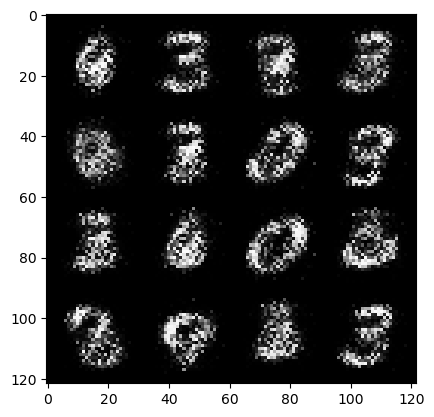

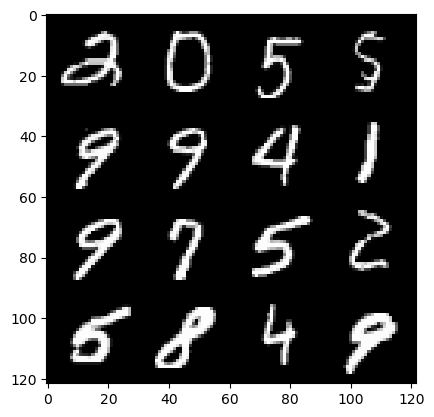

14: step 6600/ Gen loss: 6.741011295318602/ disc_loss: 0.007855677293458327


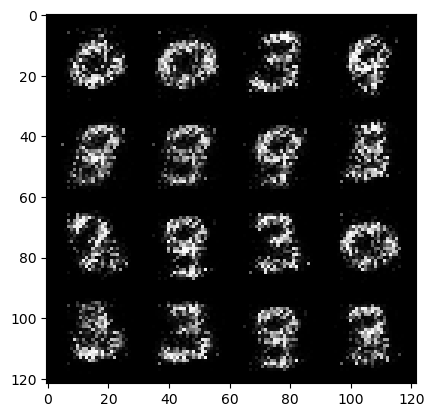

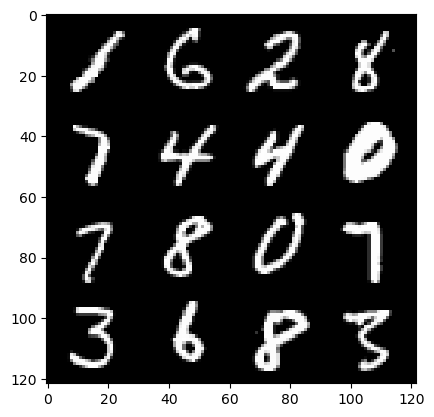

14: step 6900/ Gen loss: 6.88747074286143/ disc_loss: 0.006855142071144657


  0%|          | 0/469 [00:00<?, ?it/s]

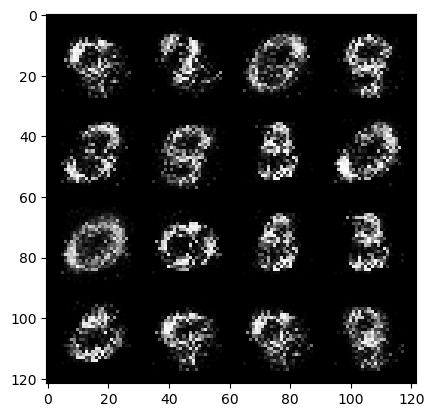

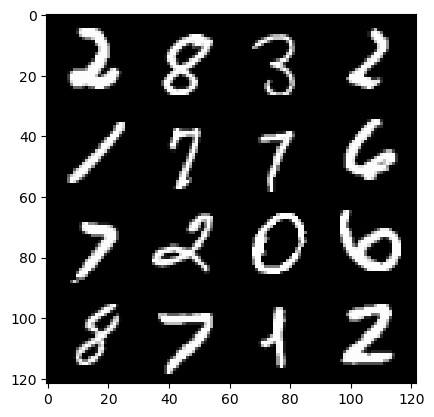

15: step 7200/ Gen loss: 7.072496075630189/ disc_loss: 0.008421633946321283


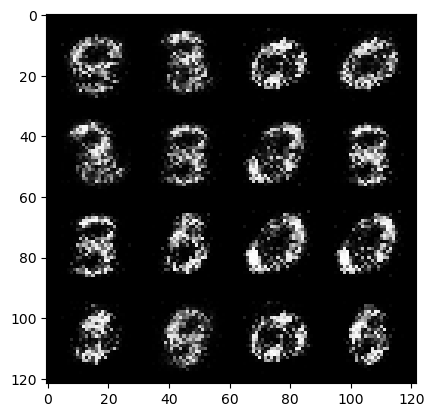

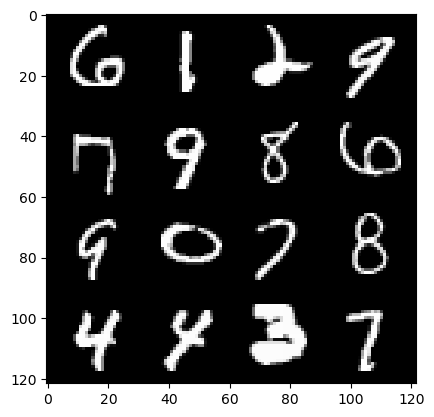

15: step 7500/ Gen loss: 7.1722883160908975/ disc_loss: 0.010258368746532753


  0%|          | 0/469 [00:00<?, ?it/s]

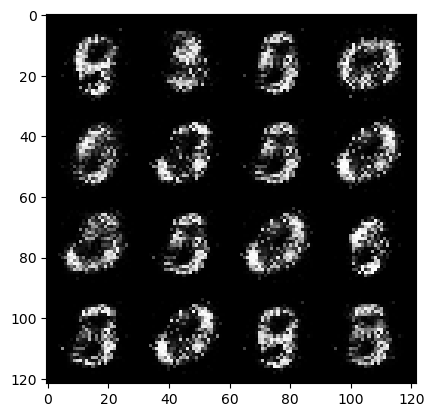

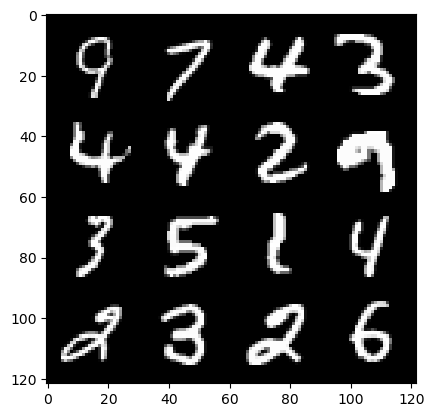

16: step 7800/ Gen loss: 7.129432649612423/ disc_loss: 0.011625899362067382


  0%|          | 0/469 [00:00<?, ?it/s]

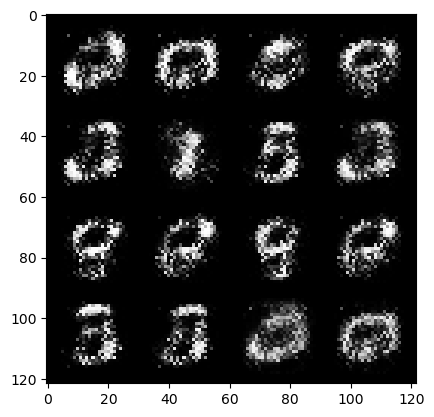

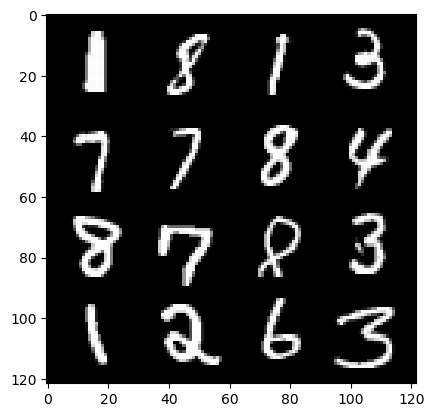

17: step 8100/ Gen loss: 7.2511692825953125/ disc_loss: 0.012829992043164883


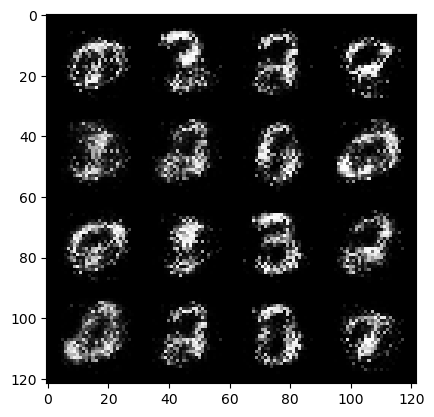

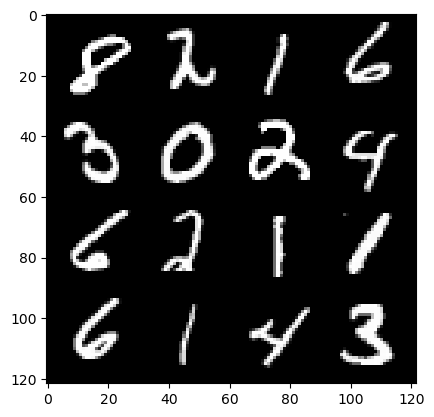

17: step 8400/ Gen loss: 7.229581845601397/ disc_loss: 0.00994151659542694


  0%|          | 0/469 [00:00<?, ?it/s]

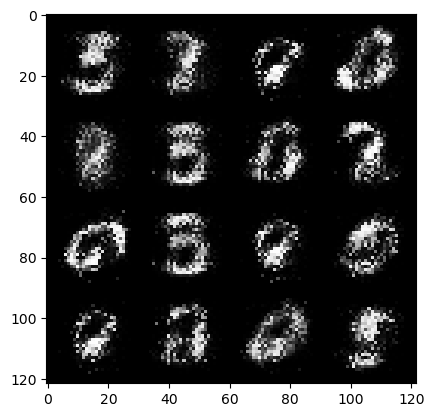

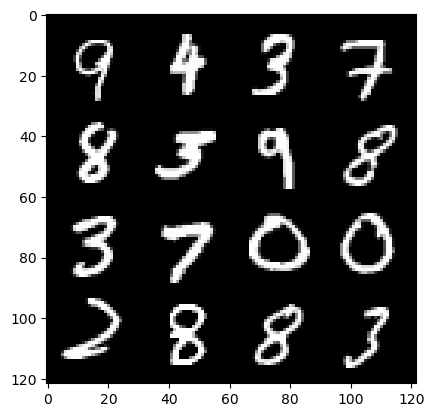

18: step 8700/ Gen loss: 7.3303581698735565/ disc_loss: 0.00867033854864227


  0%|          | 0/469 [00:00<?, ?it/s]

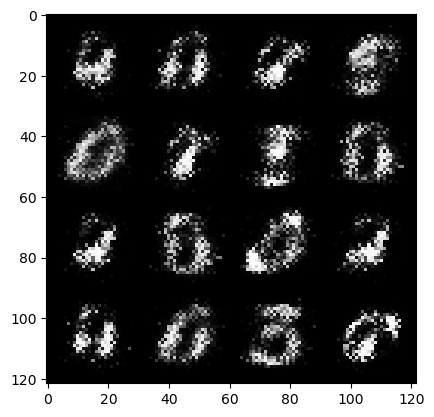

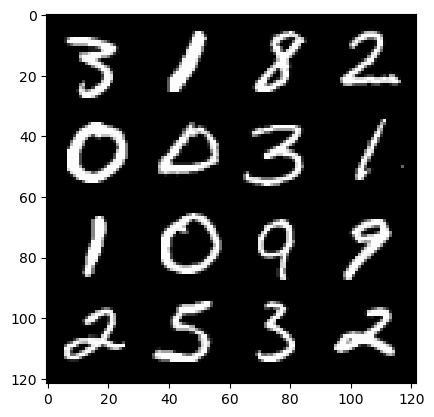

19: step 9000/ Gen loss: 7.405301666259768/ disc_loss: 0.009019869502711423


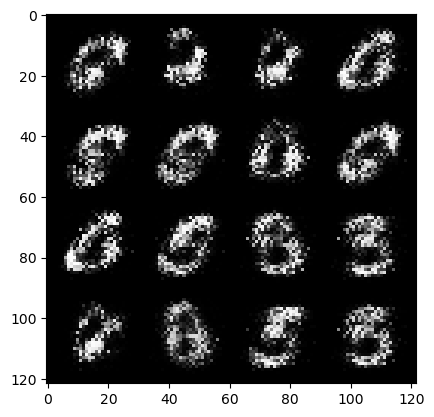

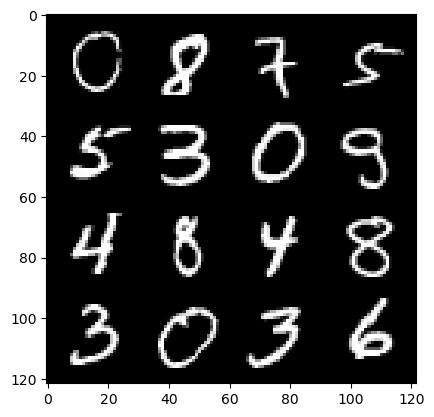

19: step 9300/ Gen loss: 7.306635944048565/ disc_loss: 0.009197277291677892


  0%|          | 0/469 [00:00<?, ?it/s]

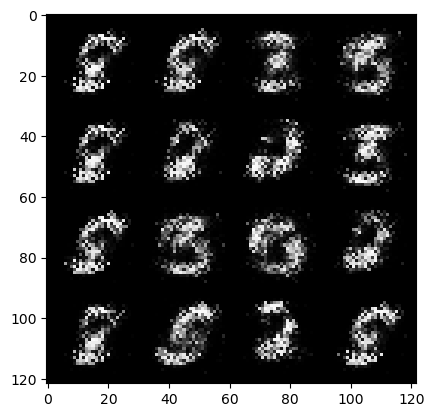

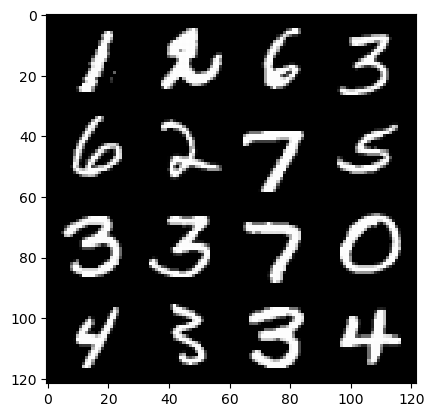

20: step 9600/ Gen loss: 7.609059961636859/ disc_loss: 0.009582869109775249


  0%|          | 0/469 [00:00<?, ?it/s]

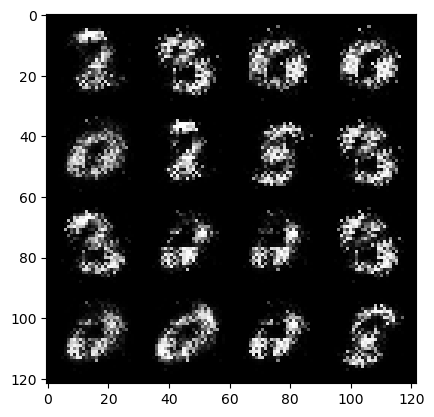

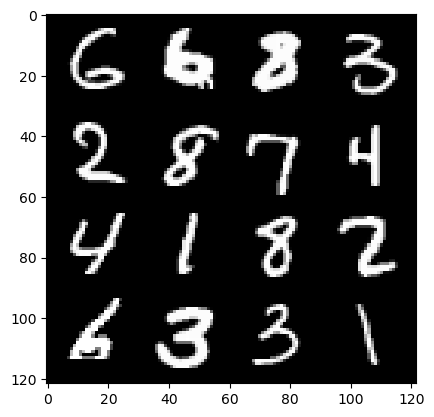

21: step 9900/ Gen loss: 7.335343812306722/ disc_loss: 0.009520063898526134


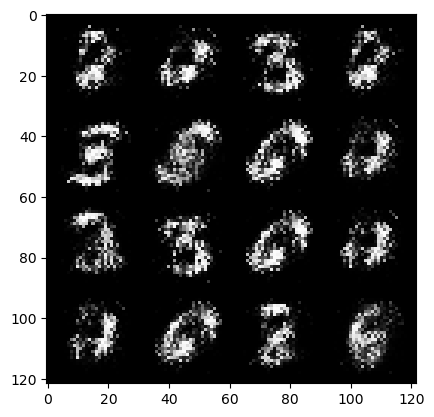

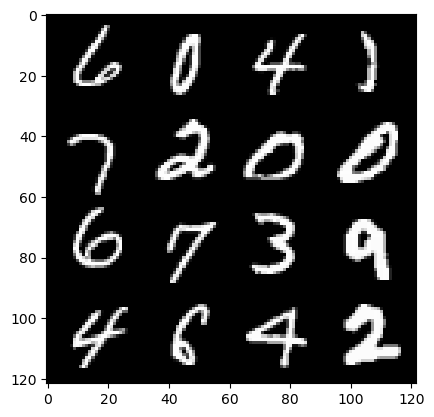

21: step 10200/ Gen loss: 7.202773265838623/ disc_loss: 0.007602095666419096


  0%|          | 0/469 [00:00<?, ?it/s]

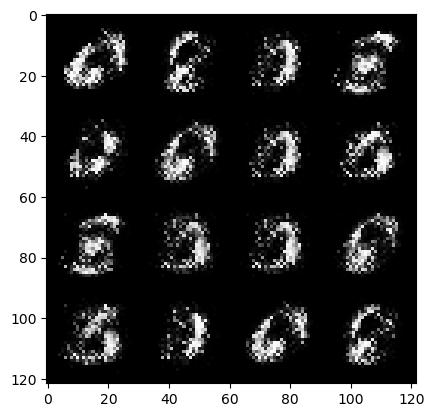

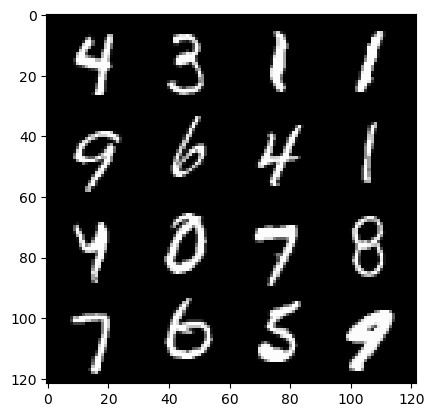

22: step 10500/ Gen loss: 7.1122248570124365/ disc_loss: 0.007653735908679664


  0%|          | 0/469 [00:00<?, ?it/s]

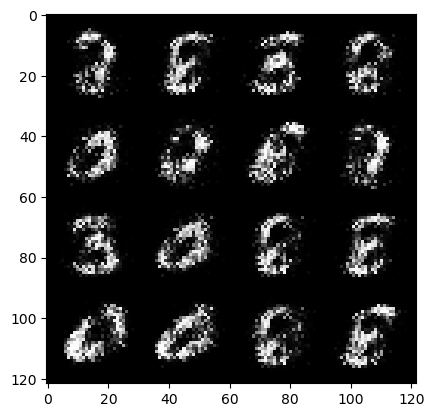

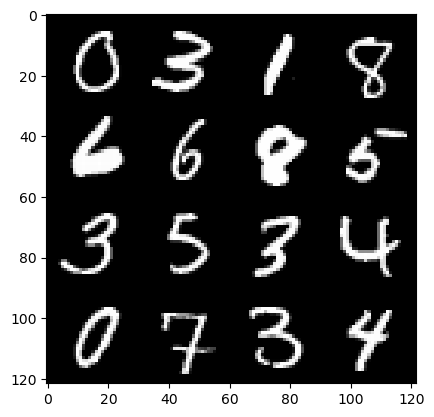

23: step 10800/ Gen loss: 7.1037891022364255/ disc_loss: 0.008699860428071887


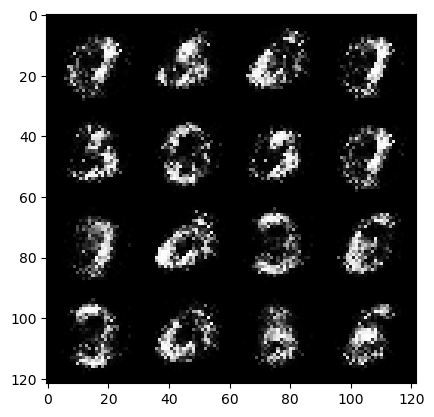

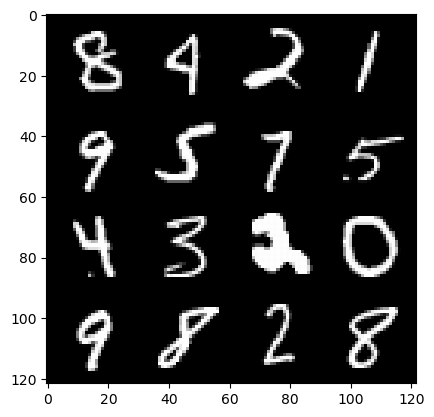

23: step 11100/ Gen loss: 7.227694525718688/ disc_loss: 0.009275733933318401


  0%|          | 0/469 [00:00<?, ?it/s]

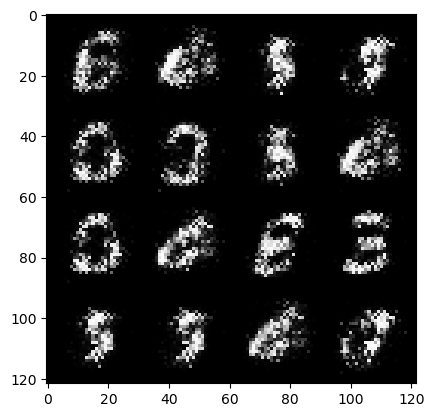

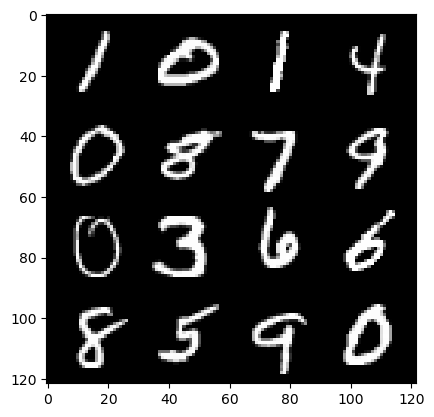

24: step 11400/ Gen loss: 7.76721742630005/ disc_loss: 0.01245159258522714


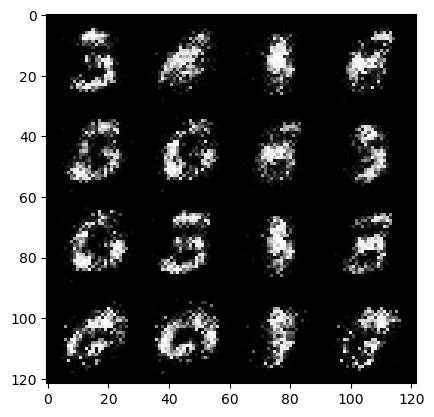

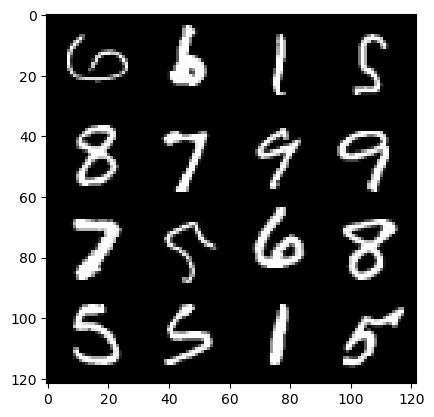

24: step 11700/ Gen loss: 7.584101769129434/ disc_loss: 0.010493081894237543


  0%|          | 0/469 [00:00<?, ?it/s]

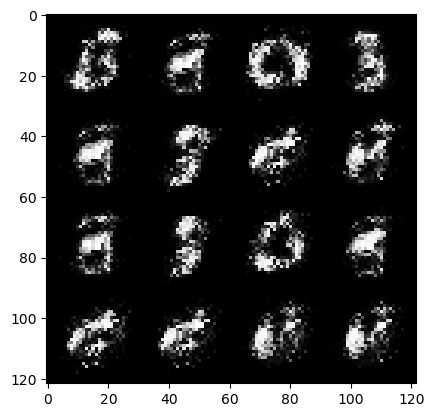

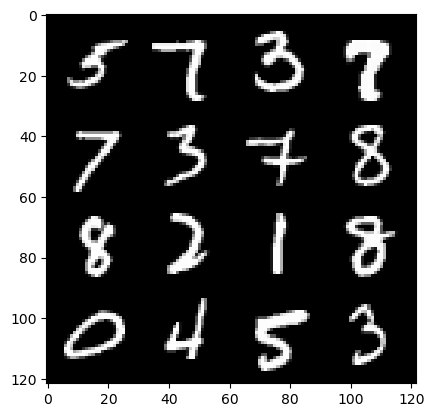

25: step 12000/ Gen loss: 7.527878979047142/ disc_loss: 0.012538365040672954


  0%|          | 0/469 [00:00<?, ?it/s]

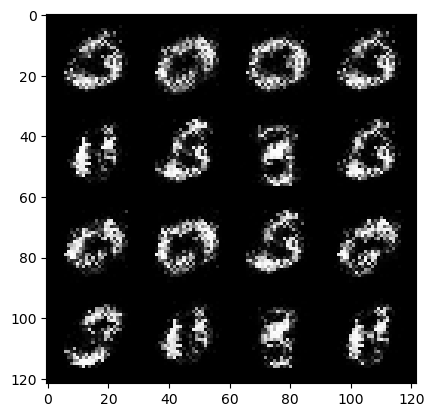

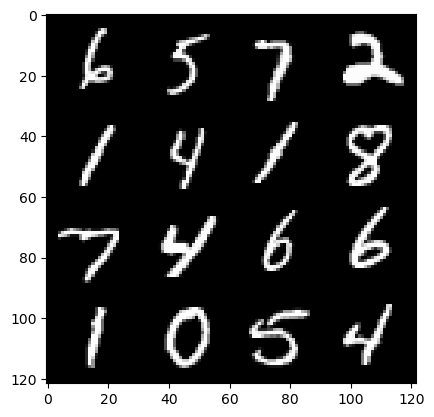

26: step 12300/ Gen loss: 7.0214697583516426/ disc_loss: 0.01320525095177192


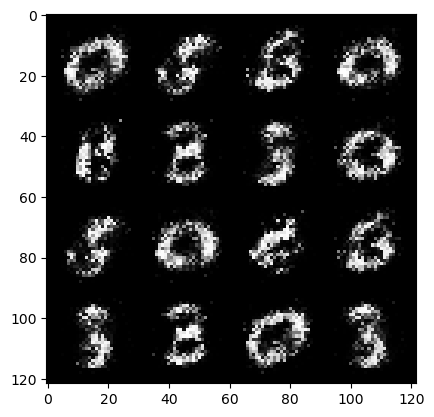

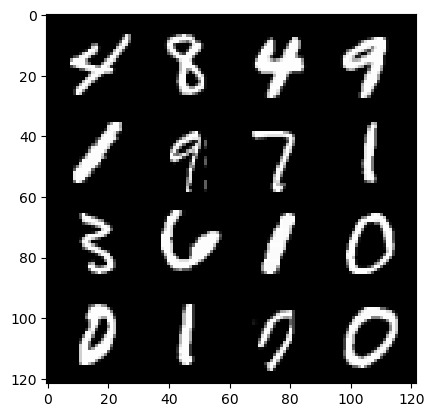

26: step 12600/ Gen loss: 7.245276783307394/ disc_loss: 0.011439577532776938


  0%|          | 0/469 [00:00<?, ?it/s]

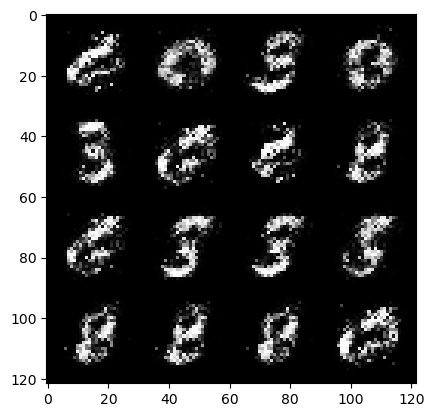

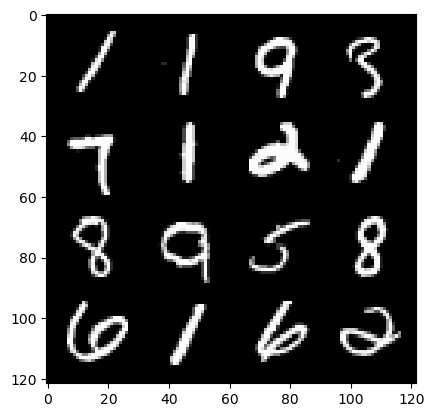

27: step 12900/ Gen loss: 7.410005027453111/ disc_loss: 0.011638440768001598


  0%|          | 0/469 [00:00<?, ?it/s]

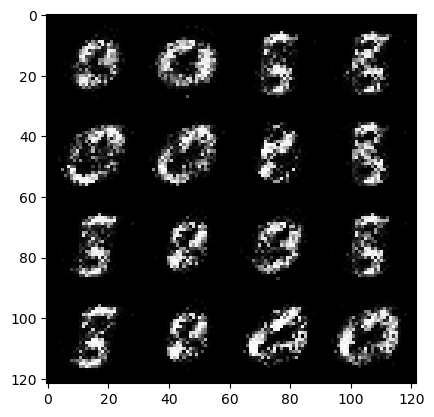

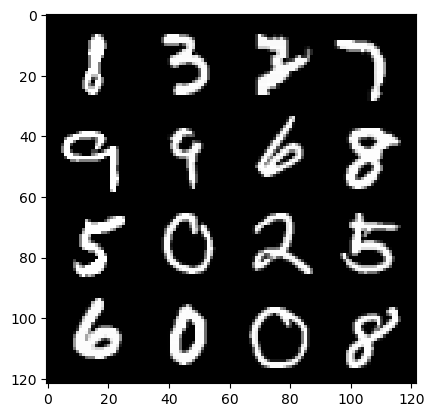

28: step 13200/ Gen loss: 7.032287718454998/ disc_loss: 0.01292087694940468


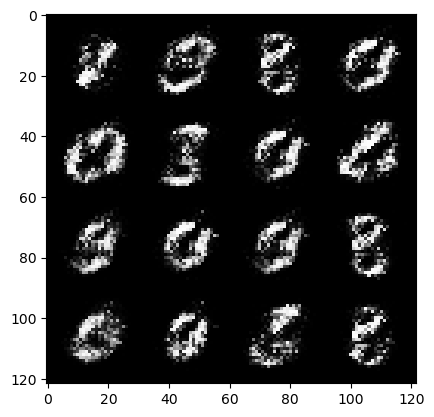

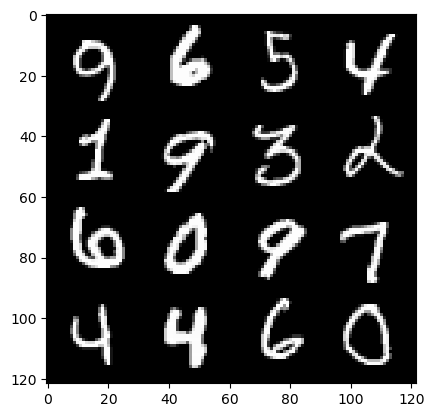

28: step 13500/ Gen loss: 6.904318283398952/ disc_loss: 0.011813884923079365


  0%|          | 0/469 [00:00<?, ?it/s]

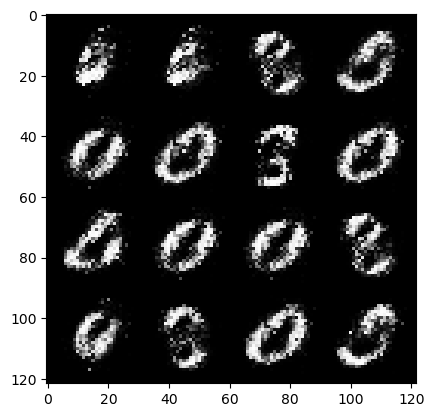

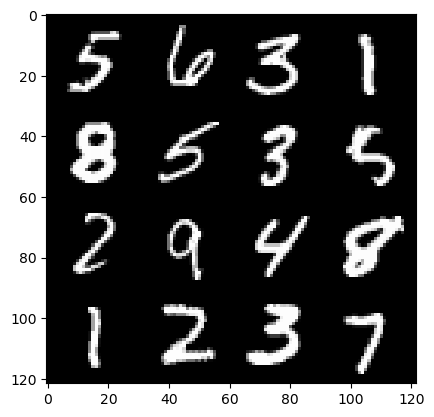

29: step 13800/ Gen loss: 6.5395378891626965/ disc_loss: 0.013697826879409453


  0%|          | 0/469 [00:00<?, ?it/s]

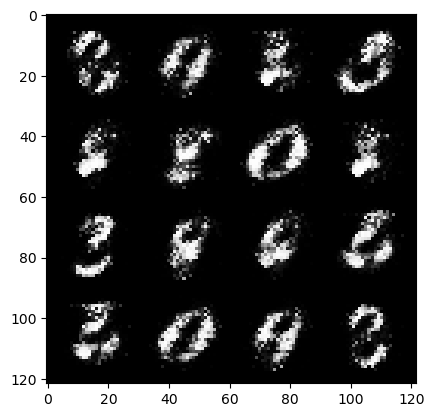

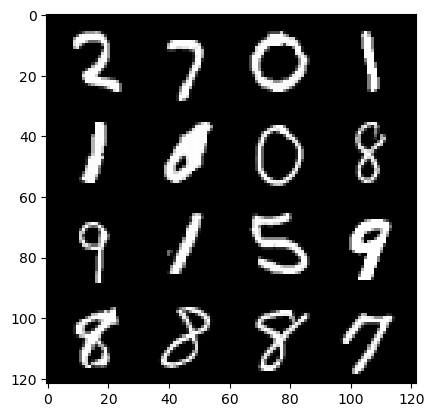

30: step 14100/ Gen loss: 6.695327119827274/ disc_loss: 0.01582567433593794


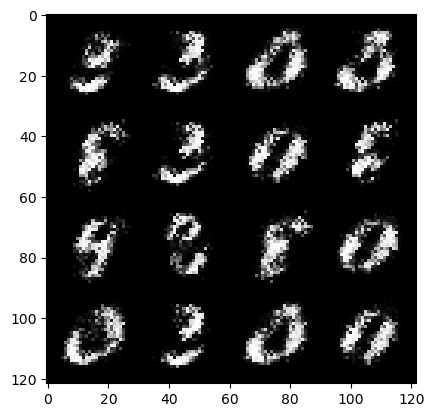

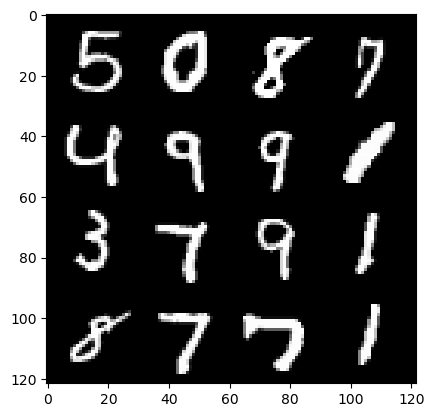

30: step 14400/ Gen loss: 6.703714787165325/ disc_loss: 0.017144324582380556


  0%|          | 0/469 [00:00<?, ?it/s]

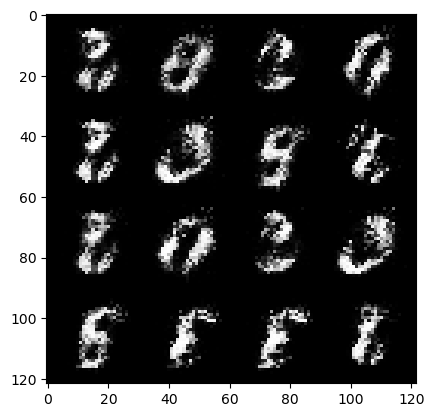

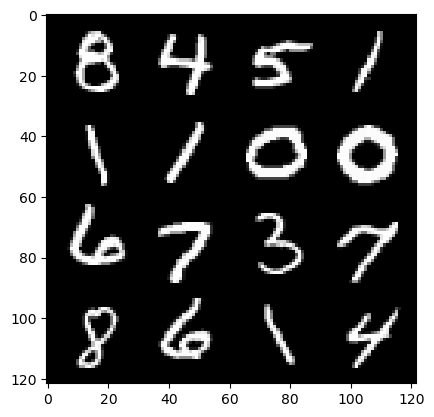

31: step 14700/ Gen loss: 6.73062740802765/ disc_loss: 0.01622100222312536


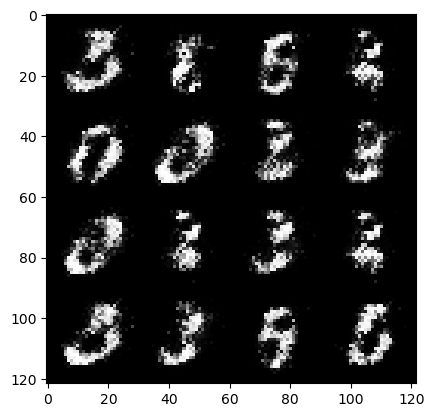

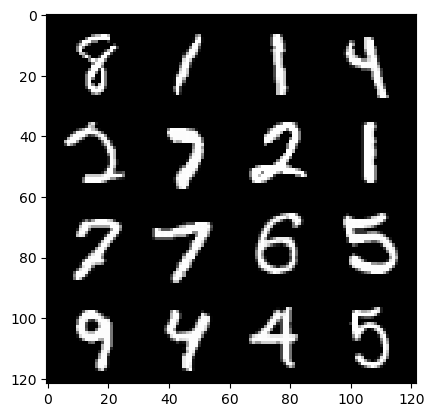

31: step 15000/ Gen loss: 6.675178955396019/ disc_loss: 0.015557894994659973


  0%|          | 0/469 [00:00<?, ?it/s]

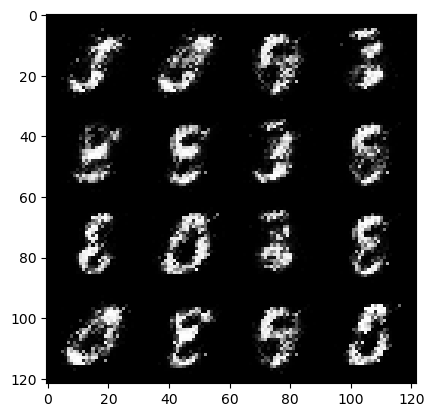

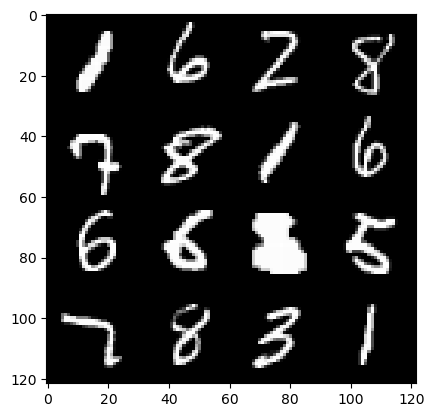

32: step 15300/ Gen loss: 6.488162940343218/ disc_loss: 0.016870217223186053


  0%|          | 0/469 [00:00<?, ?it/s]

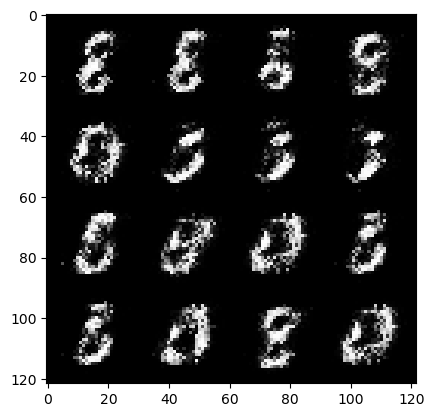

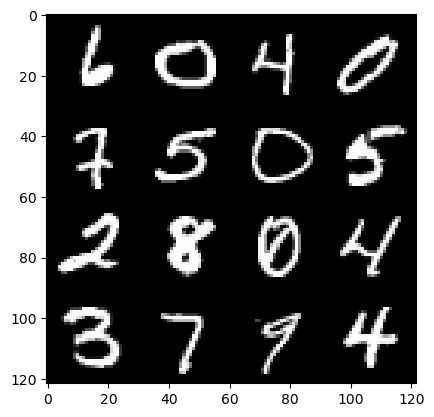

33: step 15600/ Gen loss: 6.223056756655368/ disc_loss: 0.02000310299141952


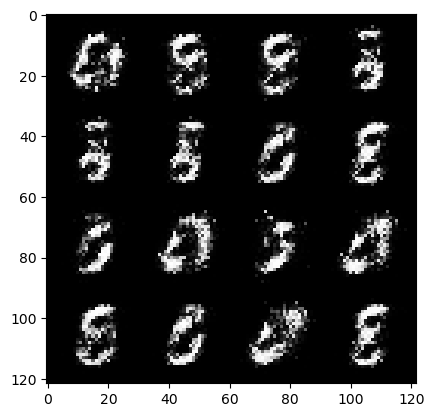

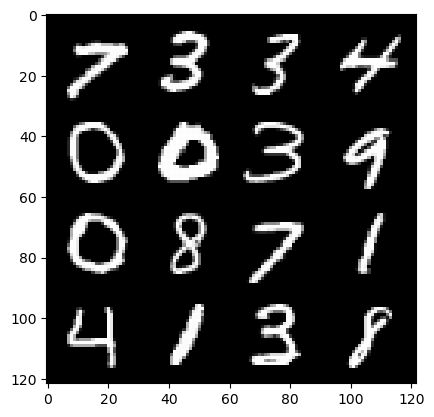

33: step 15900/ Gen loss: 6.040670908292131/ disc_loss: 0.016563882639165976


  0%|          | 0/469 [00:00<?, ?it/s]

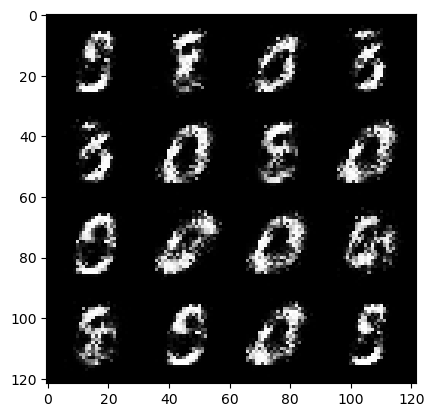

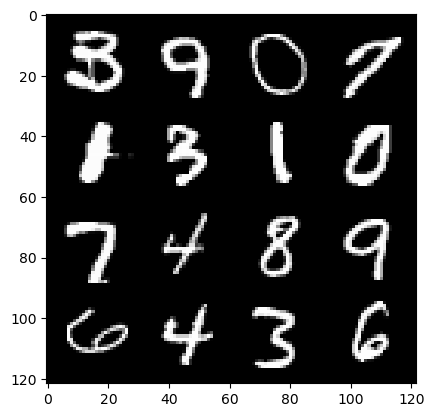

34: step 16200/ Gen loss: 6.872457736333214/ disc_loss: 0.015331465316315487


  0%|          | 0/469 [00:00<?, ?it/s]

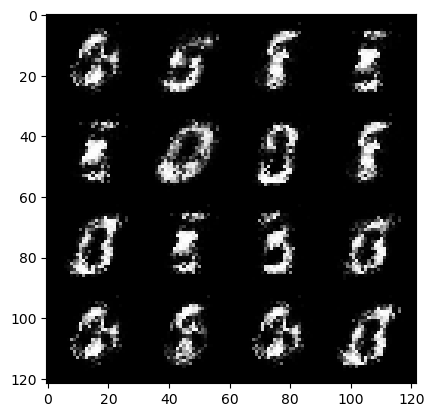

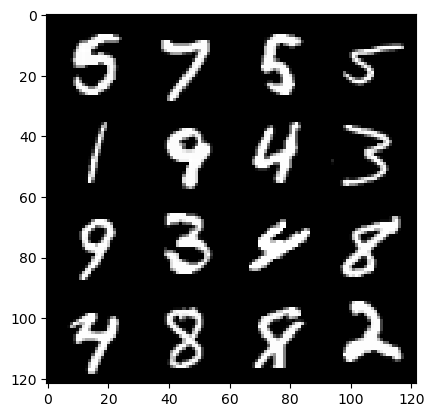

35: step 16500/ Gen loss: 6.519451381365456/ disc_loss: 0.018883996211613217


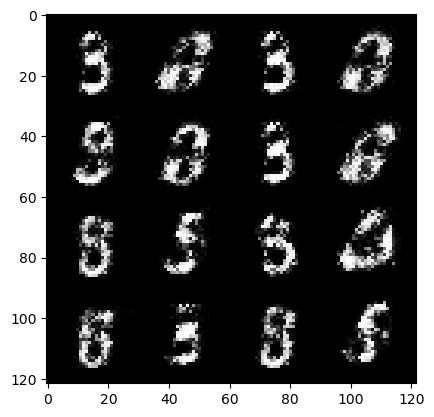

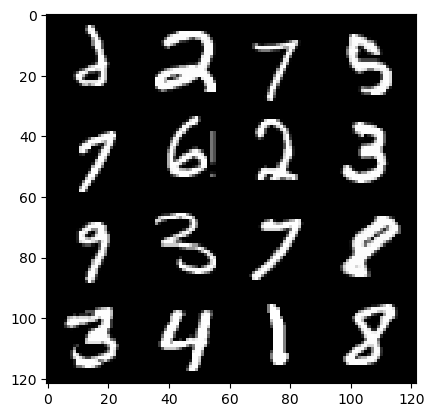

35: step 16800/ Gen loss: 6.146765578587853/ disc_loss: 0.022026012834782414


  0%|          | 0/469 [00:00<?, ?it/s]

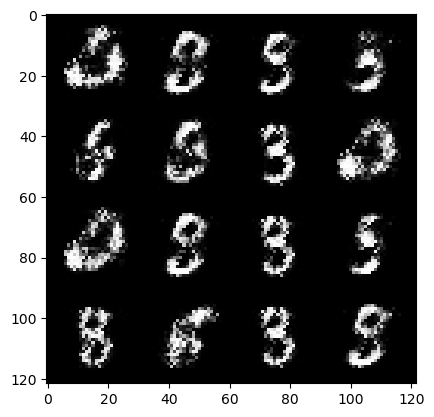

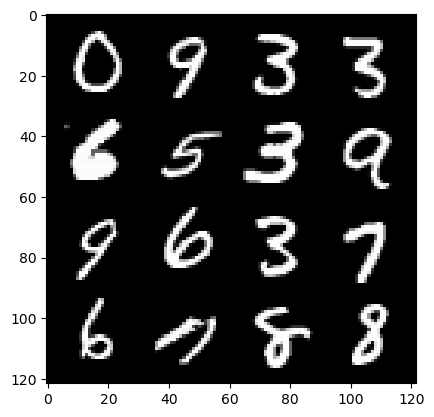

36: step 17100/ Gen loss: 5.999374666213984/ disc_loss: 0.02333658944116906


  0%|          | 0/469 [00:00<?, ?it/s]

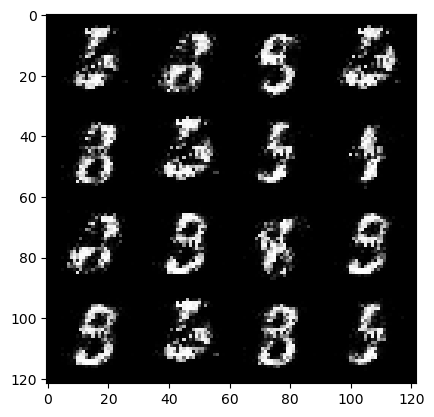

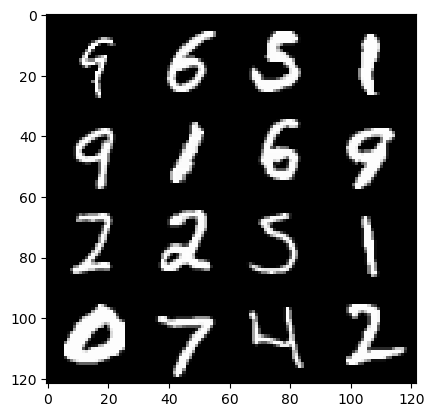

37: step 17400/ Gen loss: 6.462268142700197/ disc_loss: 0.01705510108421246


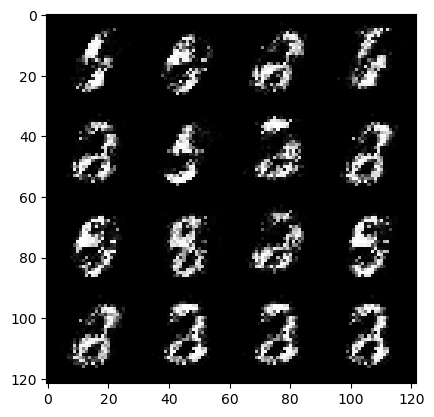

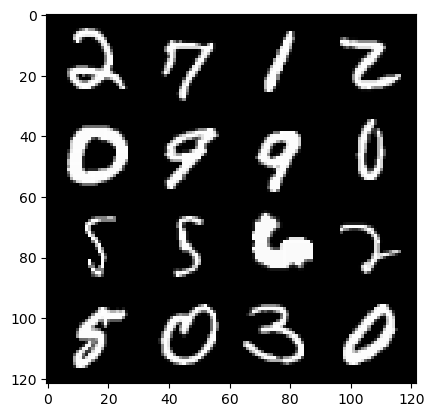

37: step 17700/ Gen loss: 6.562402930259704/ disc_loss: 0.01728200342118118


  0%|          | 0/469 [00:00<?, ?it/s]

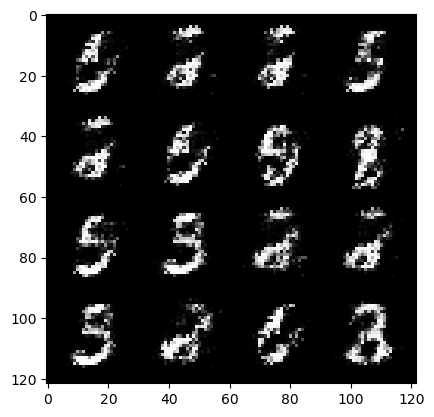

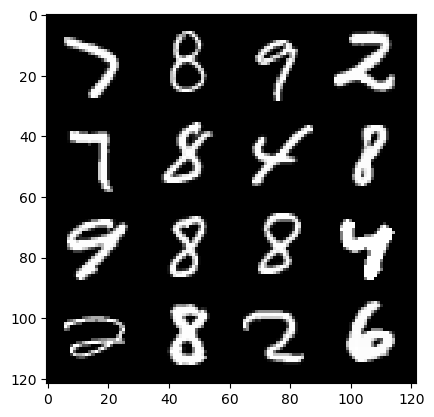

38: step 18000/ Gen loss: 6.944491202036541/ disc_loss: 0.0165495487038667


  0%|          | 0/469 [00:00<?, ?it/s]

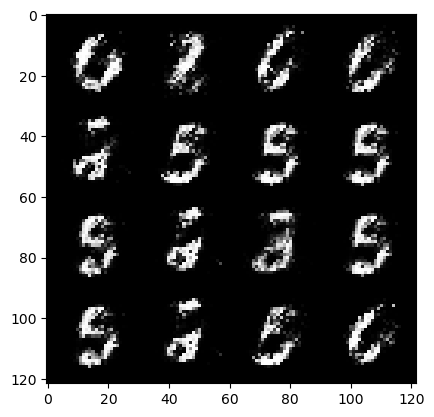

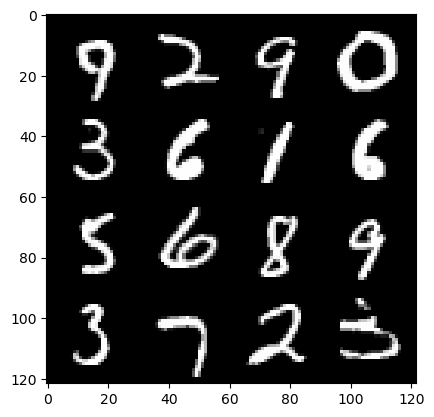

39: step 18300/ Gen loss: 6.685218512217204/ disc_loss: 0.019696695886862774


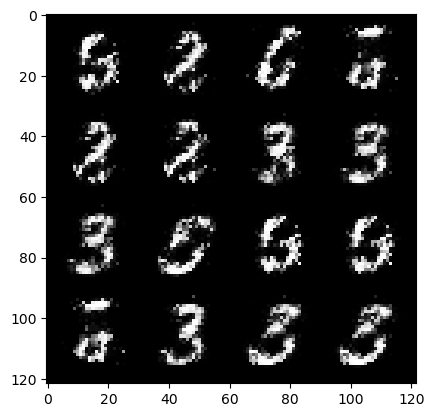

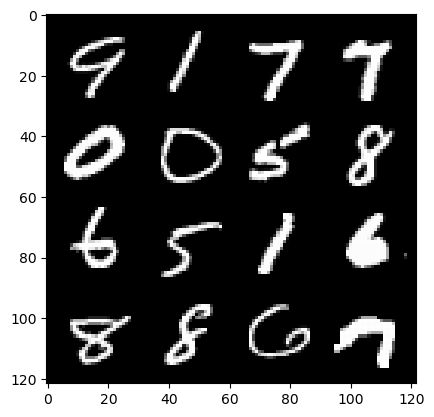

39: step 18600/ Gen loss: 6.699785766601562/ disc_loss: 0.01812432791028793


  0%|          | 0/469 [00:00<?, ?it/s]

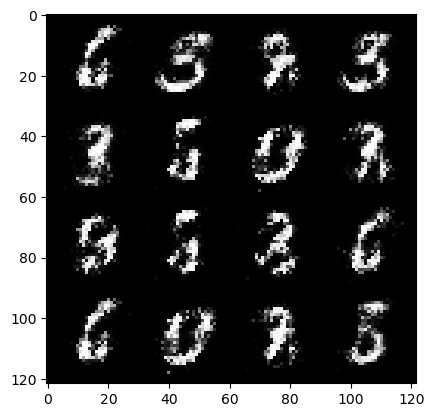

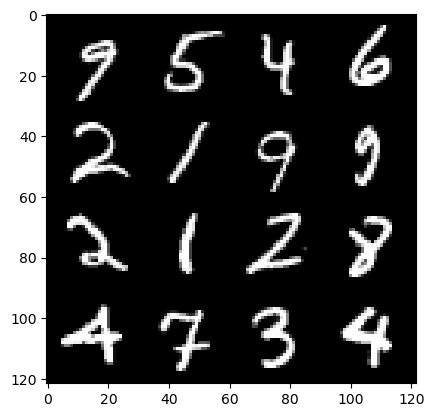

40: step 18900/ Gen loss: 6.9019623533884715/ disc_loss: 0.018483566629389932


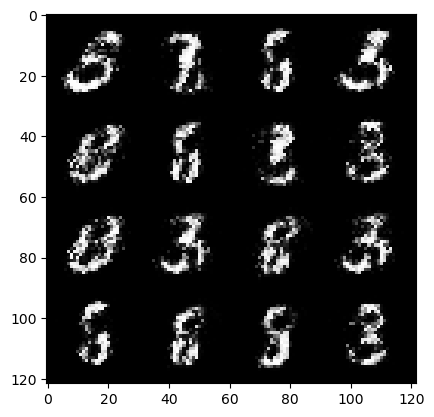

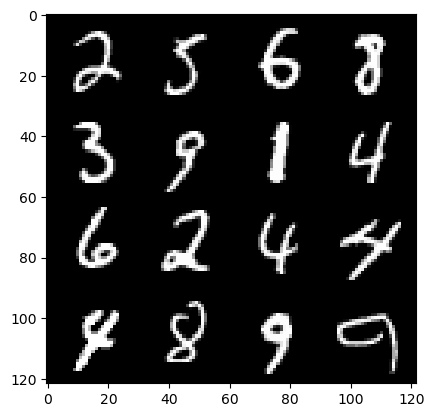

40: step 19200/ Gen loss: 6.69970704714457/ disc_loss: 0.023841916972305623


  0%|          | 0/469 [00:00<?, ?it/s]

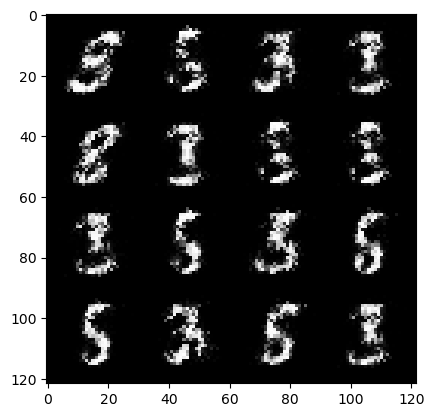

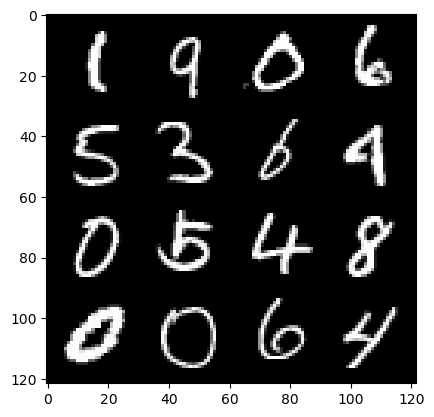

41: step 19500/ Gen loss: 6.348993916511534/ disc_loss: 0.02352595772438991


  0%|          | 0/469 [00:00<?, ?it/s]

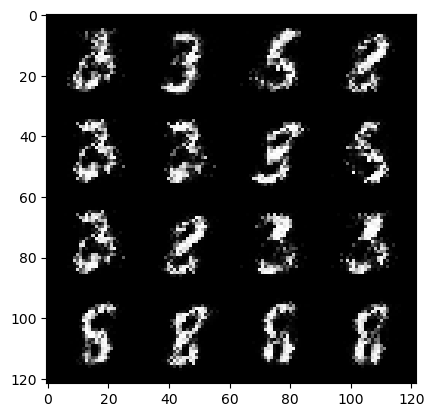

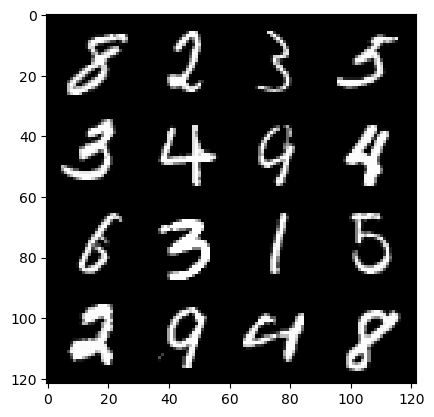

42: step 19800/ Gen loss: 6.089314994812012/ disc_loss: 0.024176027652962735


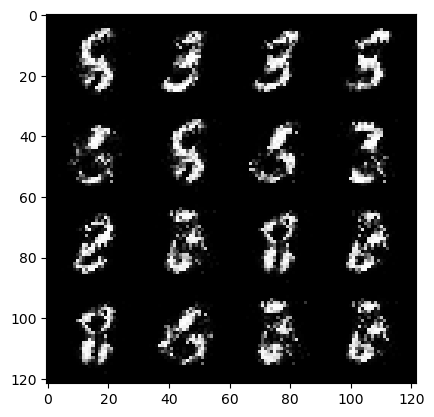

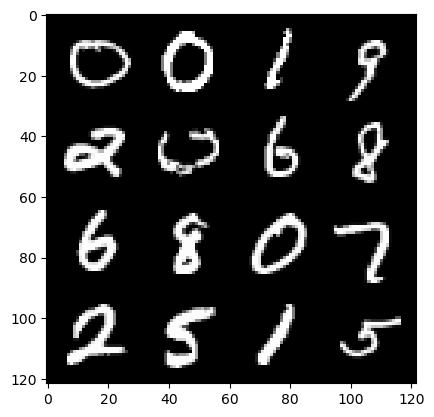

42: step 20100/ Gen loss: 6.670342869758608/ disc_loss: 0.02084578205908959


  0%|          | 0/469 [00:00<?, ?it/s]

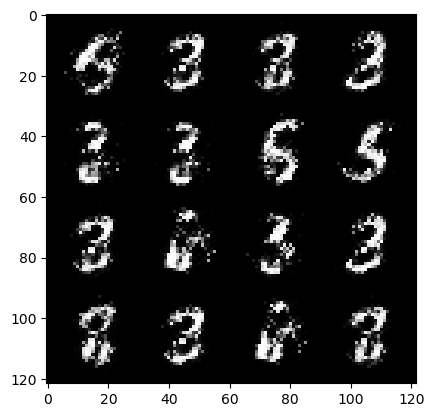

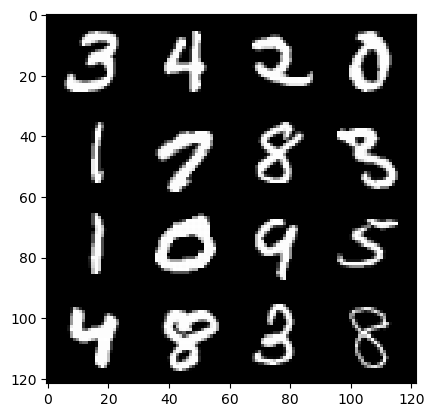

43: step 20400/ Gen loss: 6.5080631462732965/ disc_loss: 0.02372358259977772


  0%|          | 0/469 [00:00<?, ?it/s]

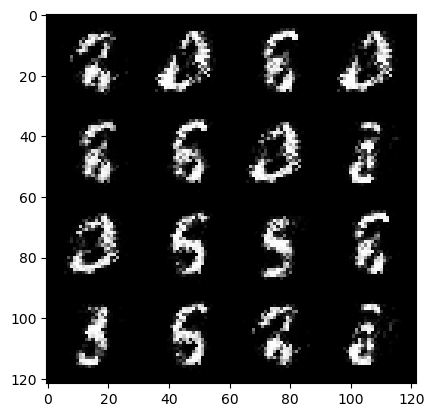

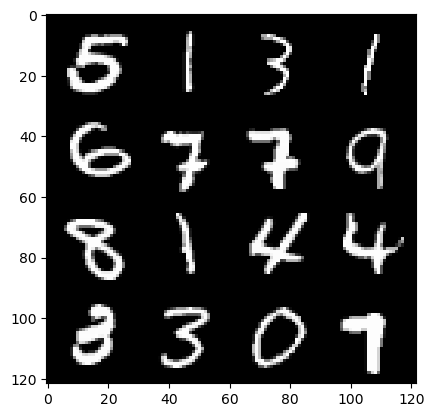

44: step 20700/ Gen loss: 6.5958433278401705/ disc_loss: 0.028974178385299938


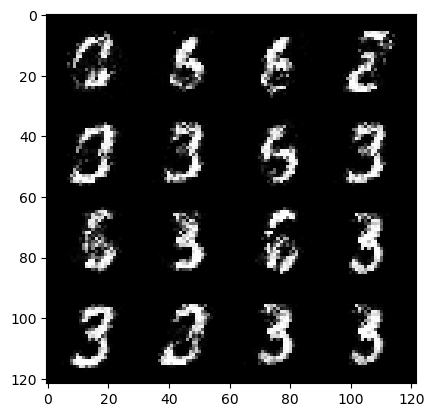

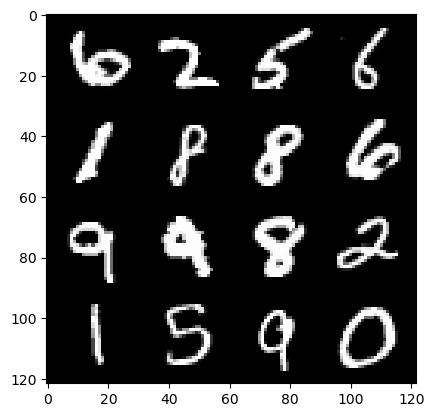

44: step 21000/ Gen loss: 6.469900449117022/ disc_loss: 0.024629448132279002


  0%|          | 0/469 [00:00<?, ?it/s]

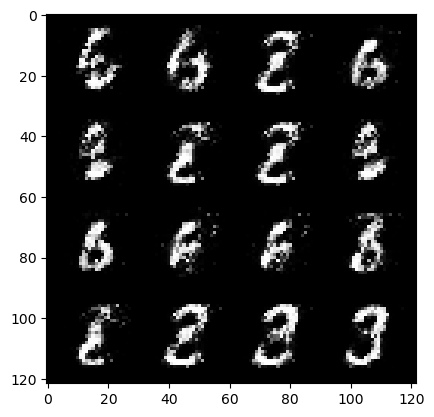

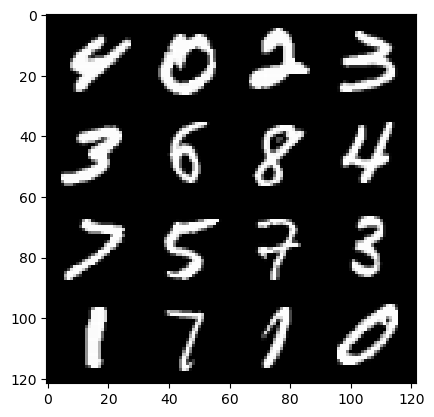

45: step 21300/ Gen loss: 6.249982169469195/ disc_loss: 0.02594434610723208


  0%|          | 0/469 [00:00<?, ?it/s]

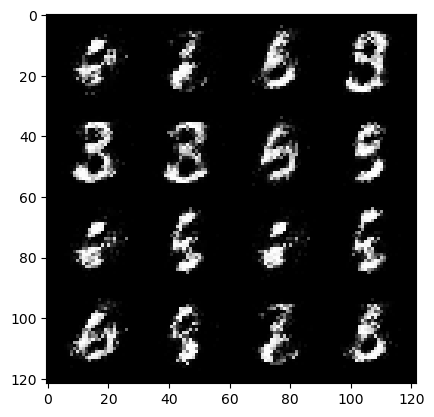

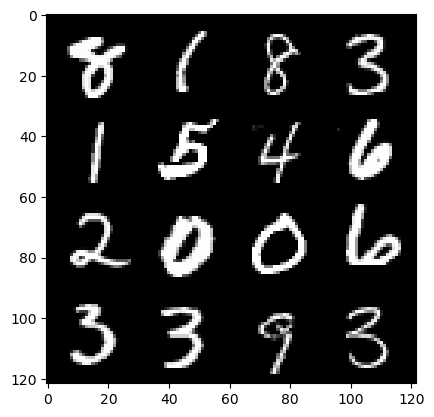

46: step 21600/ Gen loss: 6.022898557980855/ disc_loss: 0.03334086427309858


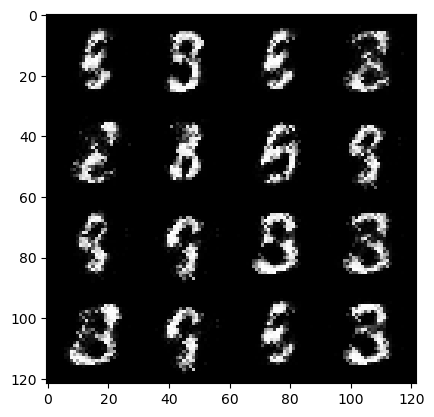

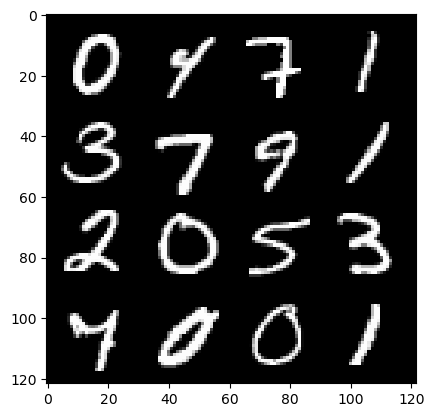

46: step 21900/ Gen loss: 6.614907323519386/ disc_loss: 0.038214490547155325


  0%|          | 0/469 [00:00<?, ?it/s]

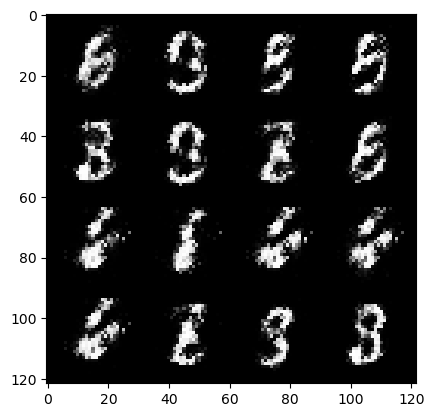

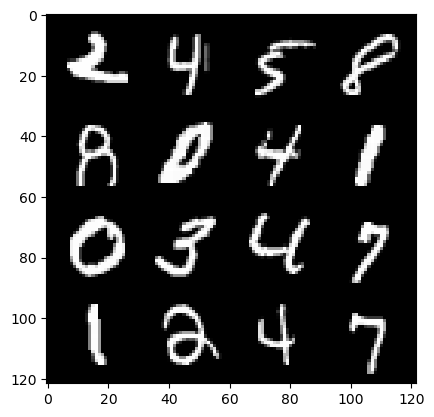

47: step 22200/ Gen loss: 6.268242635726927/ disc_loss: 0.03890365248856446


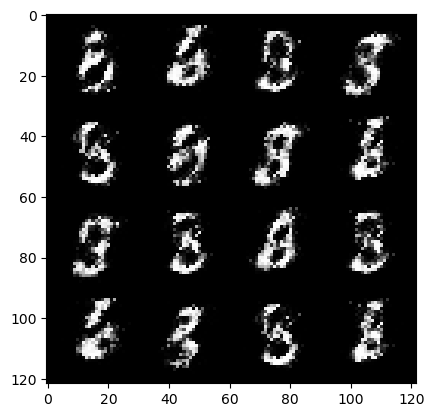

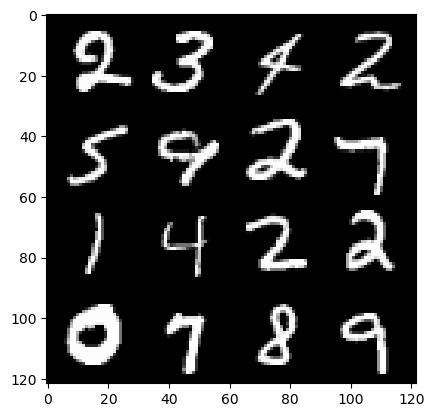

47: step 22500/ Gen loss: 6.009319305419921/ disc_loss: 0.03639018903486431


  0%|          | 0/469 [00:00<?, ?it/s]

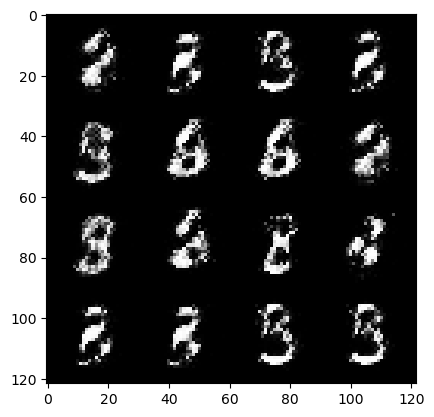

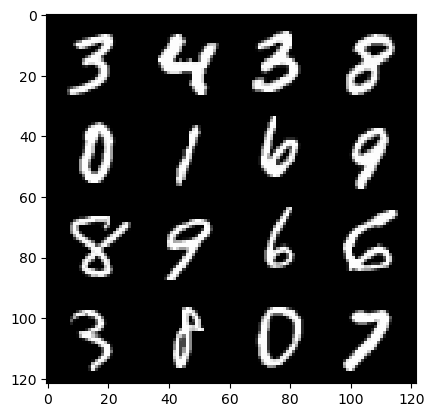

48: step 22800/ Gen loss: 5.788002568880713/ disc_loss: 0.03294950040833405


  0%|          | 0/469 [00:00<?, ?it/s]

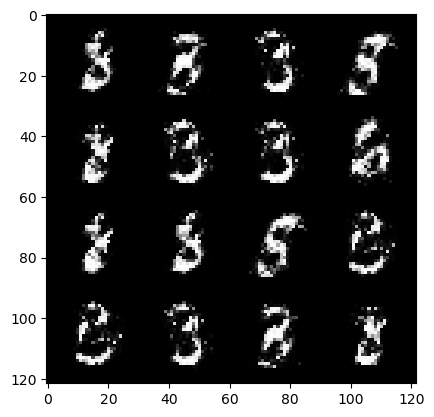

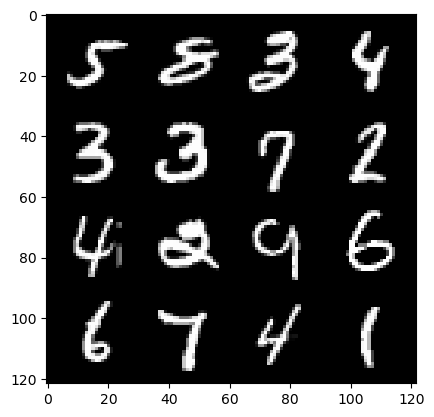

49: step 23100/ Gen loss: 6.092193638483691/ disc_loss: 0.03414164963488778


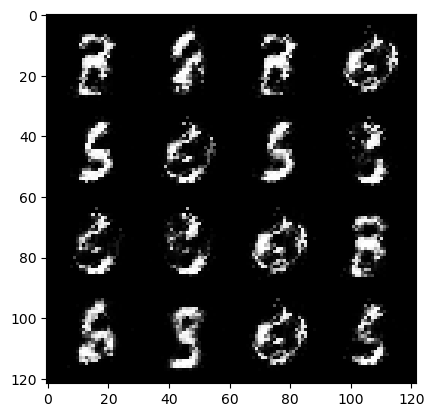

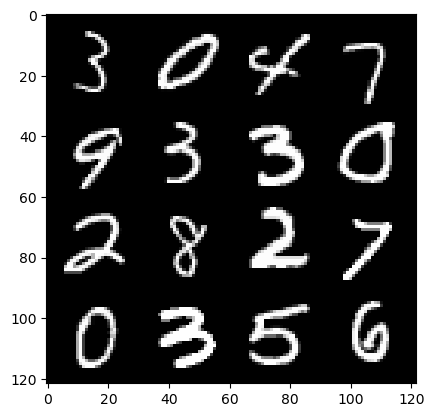

49: step 23400/ Gen loss: 6.0883112891515045/ disc_loss: 0.03500966117717324


  0%|          | 0/469 [00:00<?, ?it/s]

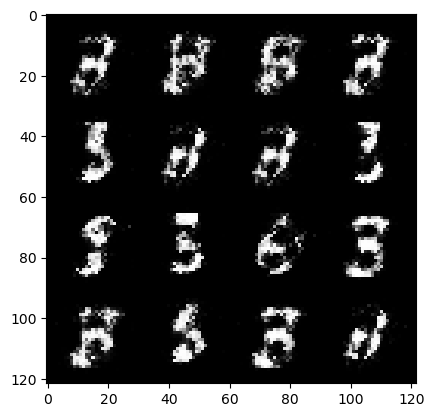

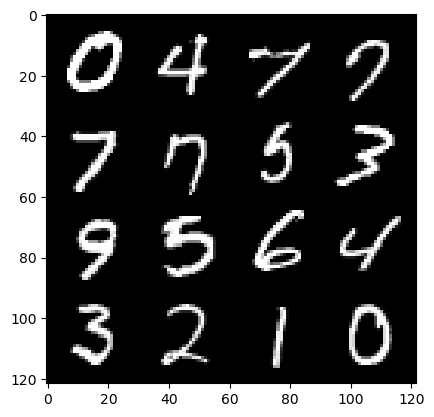

50: step 23700/ Gen loss: 6.457582206726075/ disc_loss: 0.03950863478394847


  0%|          | 0/469 [00:00<?, ?it/s]

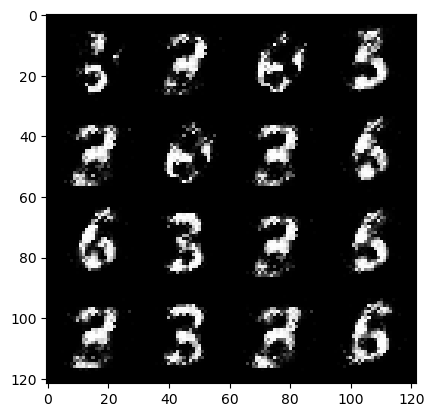

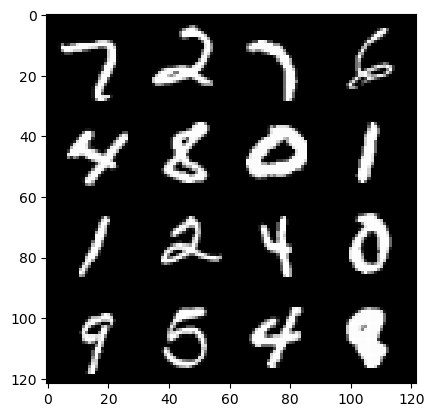

51: step 24000/ Gen loss: 6.11024801572164/ disc_loss: 0.03662791671541829


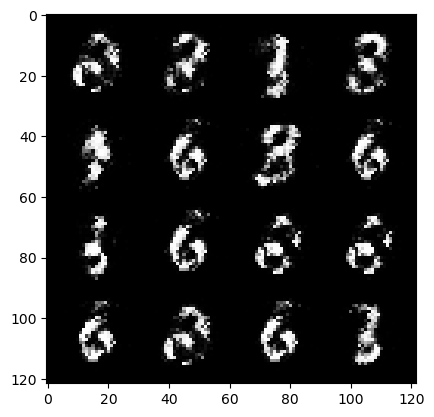

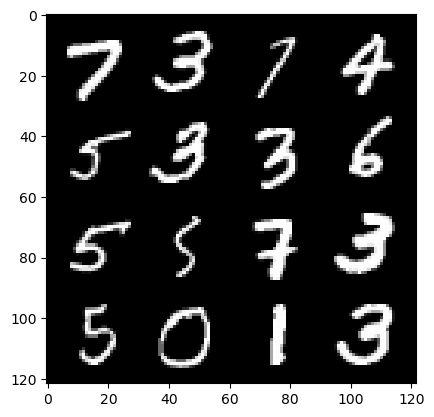

51: step 24300/ Gen loss: 5.8314367151260385/ disc_loss: 0.03186727329700564


  0%|          | 0/469 [00:00<?, ?it/s]

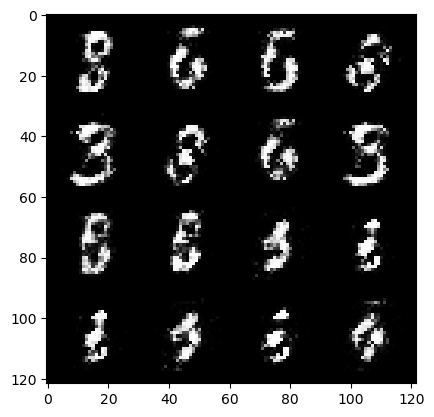

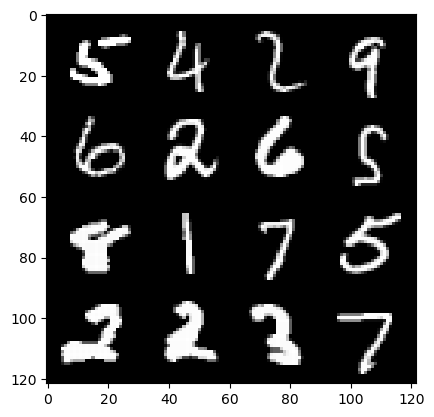

52: step 24600/ Gen loss: 5.758413012822473/ disc_loss: 0.03741207303479315


  0%|          | 0/469 [00:00<?, ?it/s]

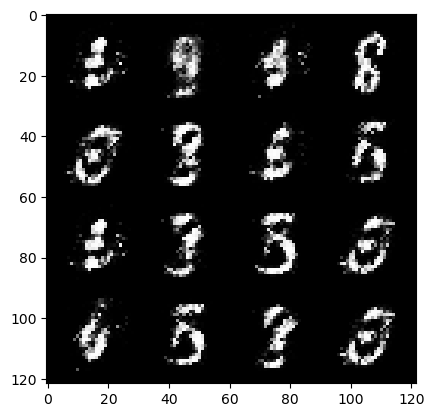

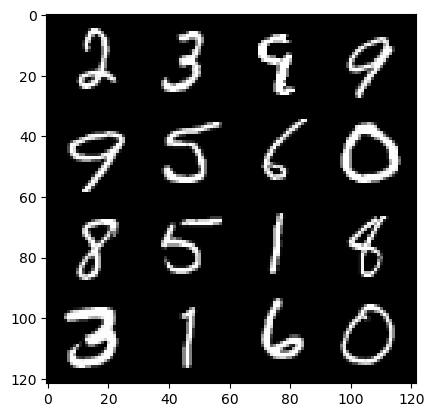

53: step 24900/ Gen loss: 5.750623078346255/ disc_loss: 0.042497122517476484


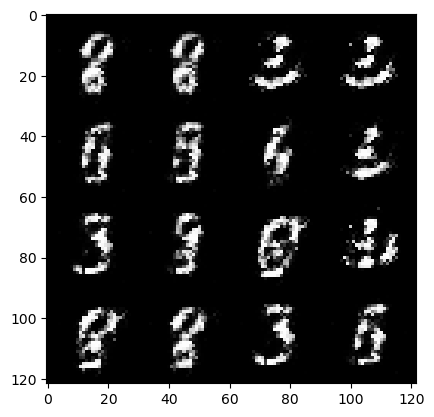

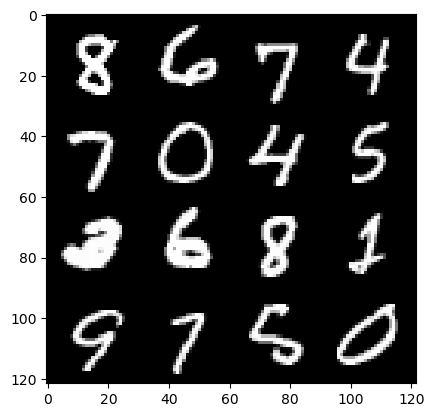

53: step 25200/ Gen loss: 5.688272770245868/ disc_loss: 0.0442086744494736


  0%|          | 0/469 [00:00<?, ?it/s]

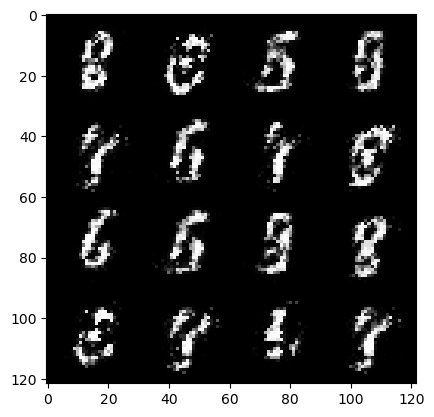

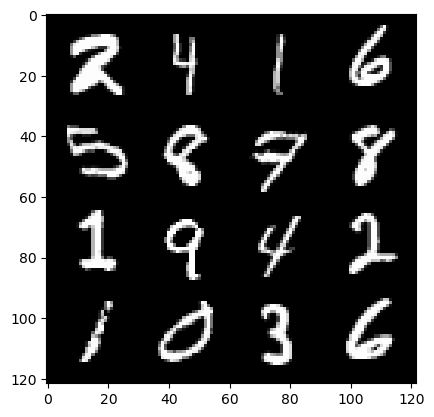

54: step 25500/ Gen loss: 5.781157800356545/ disc_loss: 0.04274849509820342


  0%|          | 0/469 [00:00<?, ?it/s]

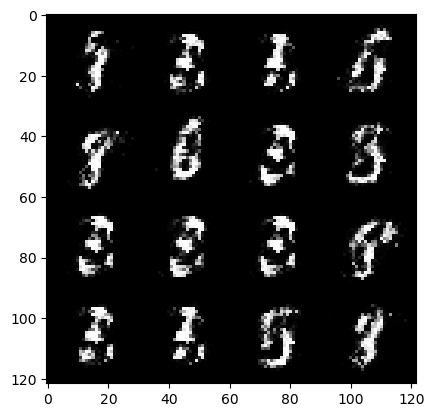

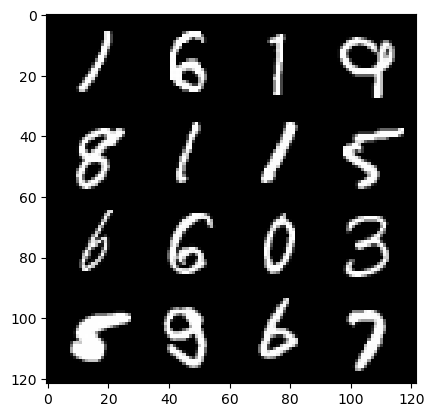

55: step 25800/ Gen loss: 5.678995134035744/ disc_loss: 0.038436615633157374


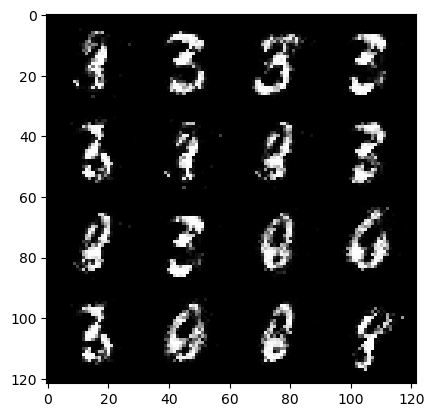

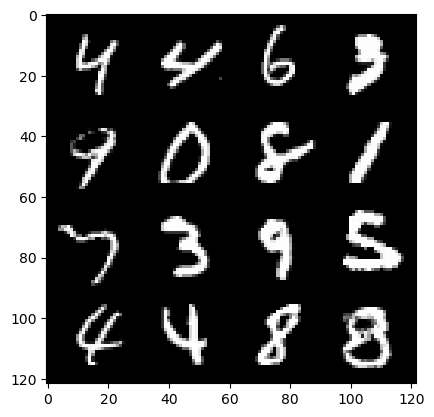

55: step 26100/ Gen loss: 5.622891483306879/ disc_loss: 0.042357385035914664


  0%|          | 0/469 [00:00<?, ?it/s]

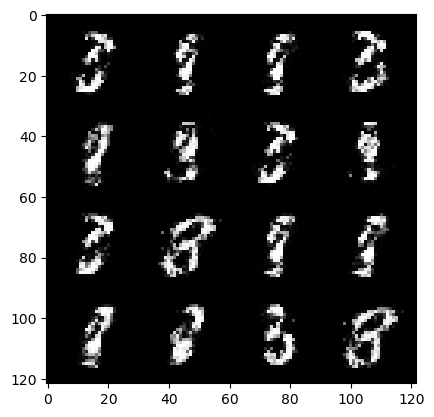

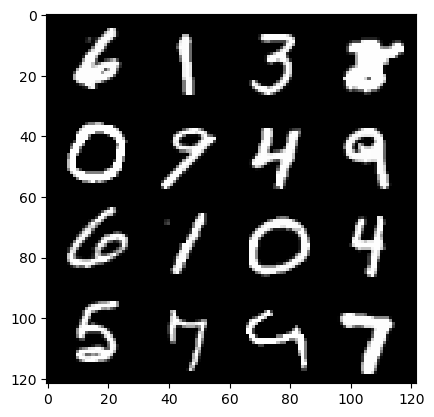

56: step 26400/ Gen loss: 5.389519986311596/ disc_loss: 0.059880301014830696


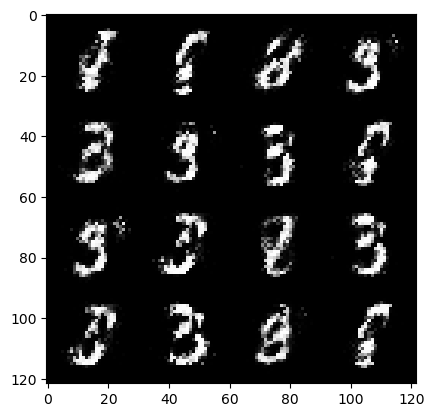

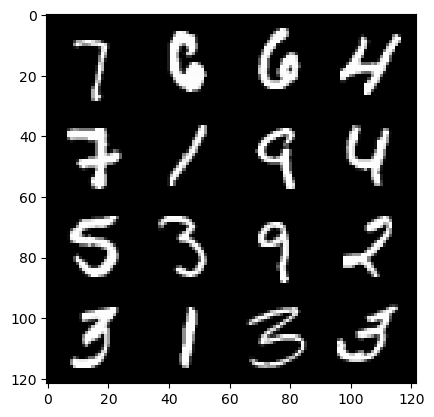

56: step 26700/ Gen loss: 6.039310779571533/ disc_loss: 0.05193492033208409


  0%|          | 0/469 [00:00<?, ?it/s]

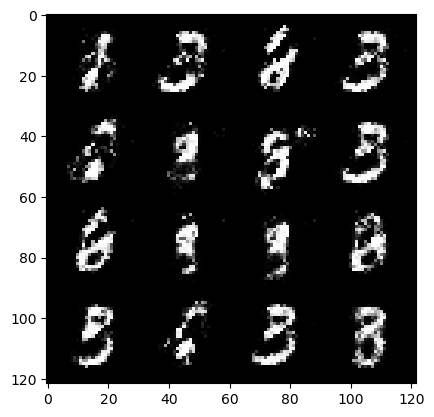

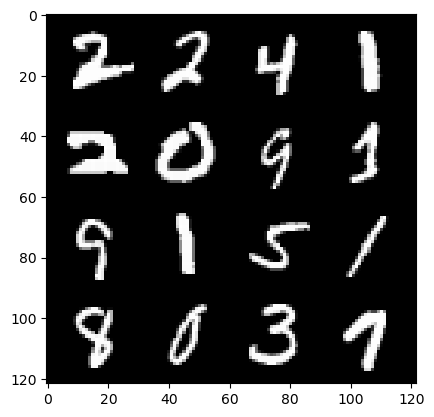

57: step 27000/ Gen loss: 5.687390306790669/ disc_loss: 0.04529804656282067


  0%|          | 0/469 [00:00<?, ?it/s]

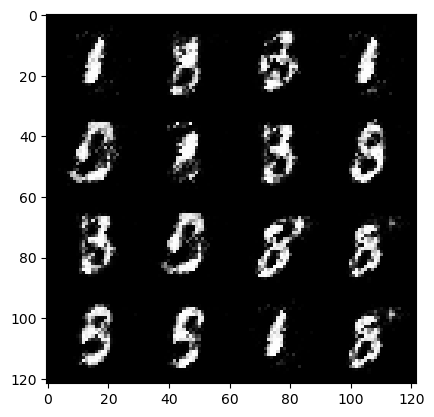

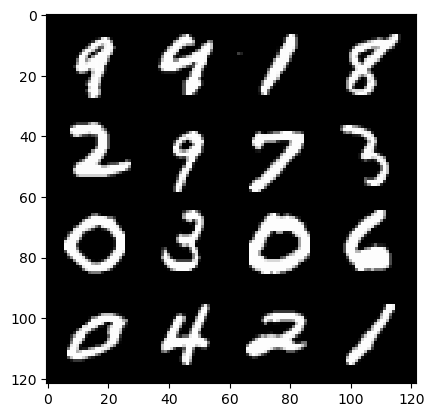

58: step 27300/ Gen loss: 5.430392888387047/ disc_loss: 0.04434421325723326


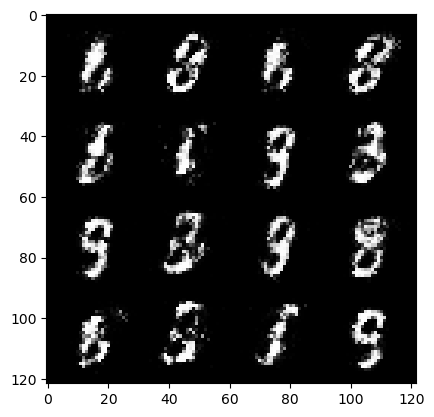

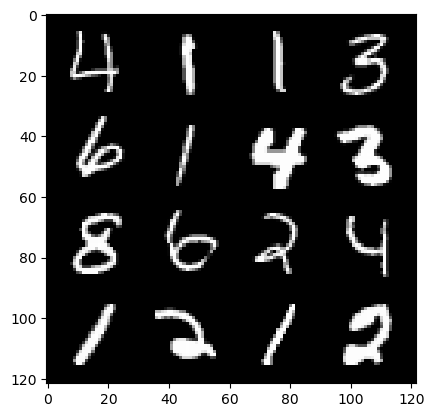

58: step 27600/ Gen loss: 5.407567450205483/ disc_loss: 0.05067253586215279


  0%|          | 0/469 [00:00<?, ?it/s]

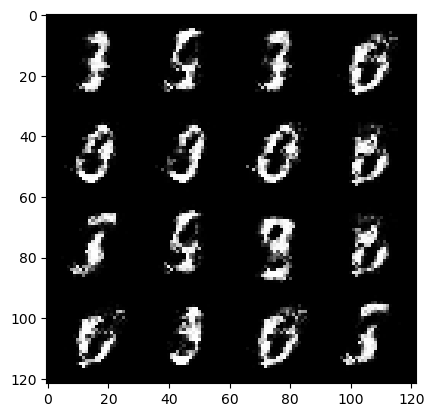

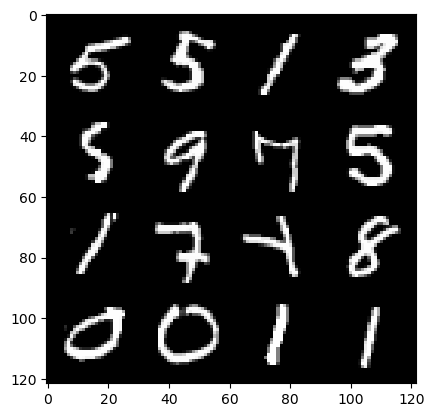

59: step 27900/ Gen loss: 5.271011260350544/ disc_loss: 0.052324367755403105


  0%|          | 0/469 [00:00<?, ?it/s]

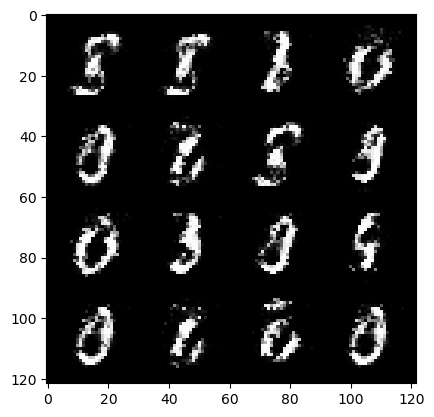

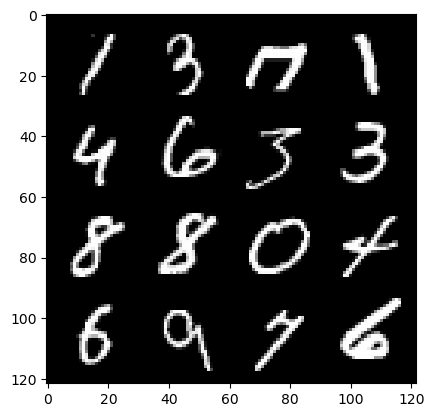

60: step 28200/ Gen loss: 5.201165946324663/ disc_loss: 0.047925326181575634


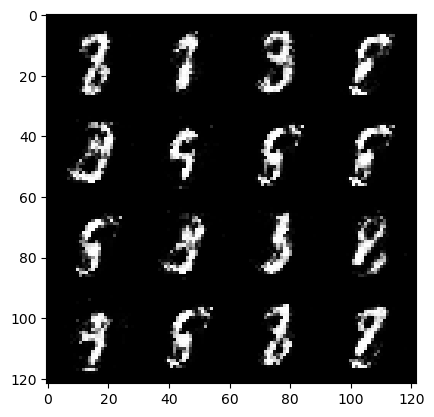

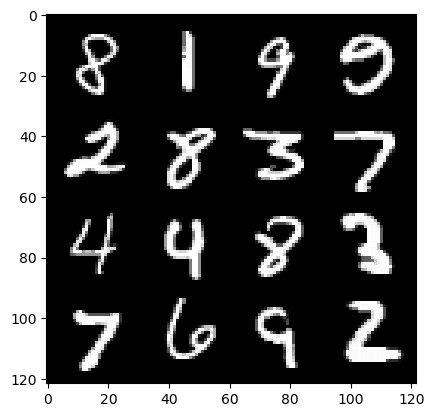

60: step 28500/ Gen loss: 5.26973618666331/ disc_loss: 0.05122961658673978


  0%|          | 0/469 [00:00<?, ?it/s]

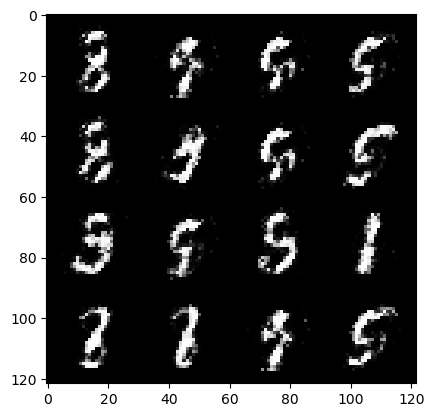

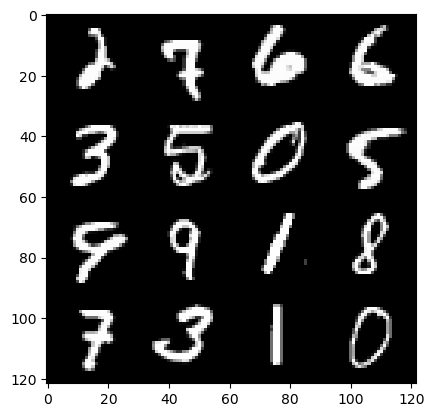

61: step 28800/ Gen loss: 5.154495204289755/ disc_loss: 0.04693230337463317


  0%|          | 0/469 [00:00<?, ?it/s]

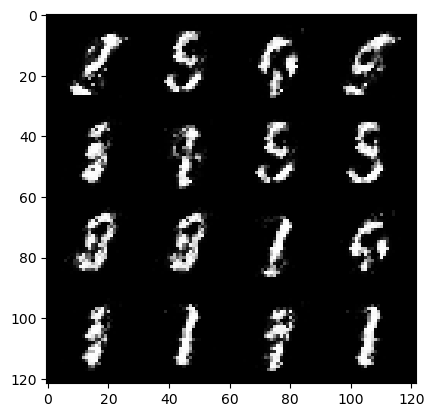

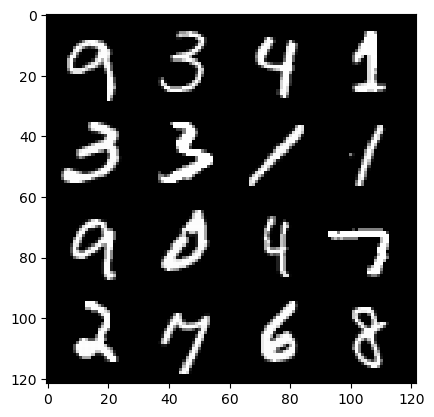

62: step 29100/ Gen loss: 4.9575393565495816/ disc_loss: 0.060758152393003334


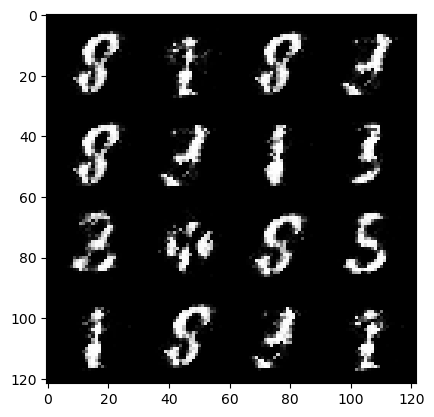

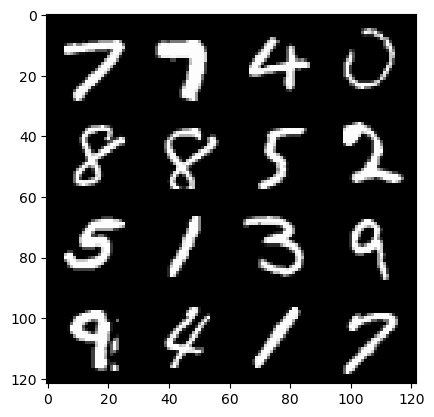

62: step 29400/ Gen loss: 4.89116269270579/ disc_loss: 0.06220359791070222


  0%|          | 0/469 [00:00<?, ?it/s]

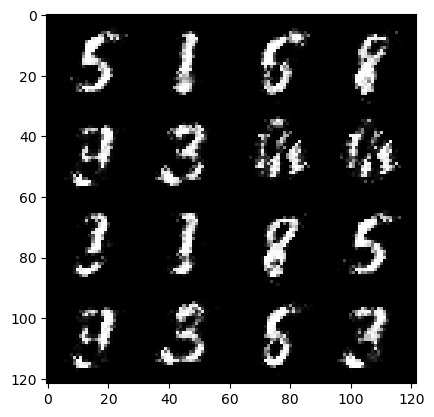

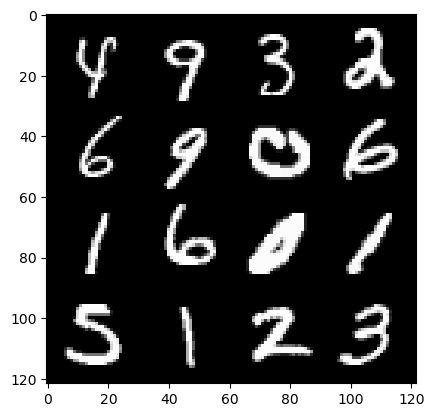

63: step 29700/ Gen loss: 5.040529264609018/ disc_loss: 0.06373075058062874


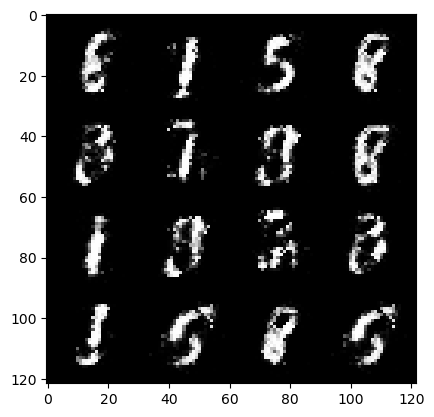

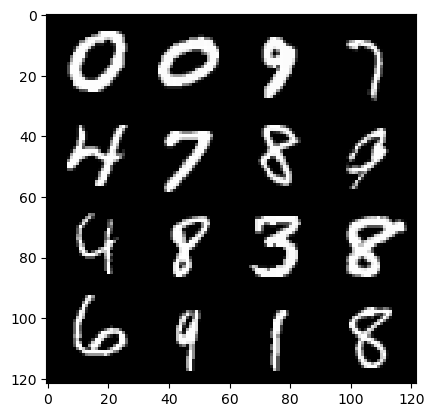

63: step 30000/ Gen loss: 5.112323278586073/ disc_loss: 0.06048987130944929


  0%|          | 0/469 [00:00<?, ?it/s]

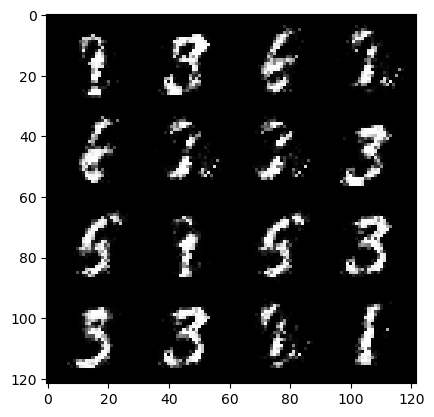

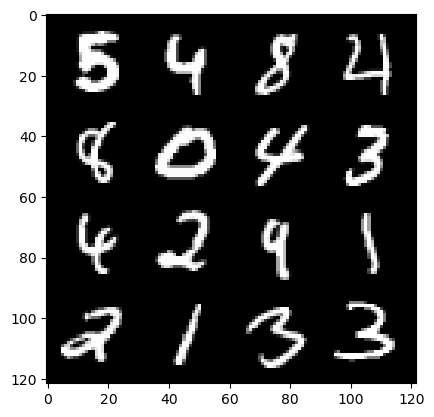

64: step 30300/ Gen loss: 5.053759634494782/ disc_loss: 0.05902355681794382


  0%|          | 0/469 [00:00<?, ?it/s]

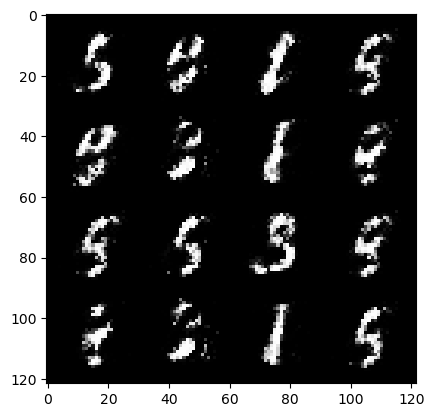

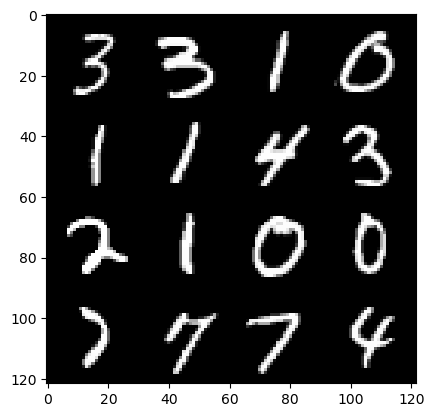

65: step 30600/ Gen loss: 5.232717862129211/ disc_loss: 0.058018097790578975


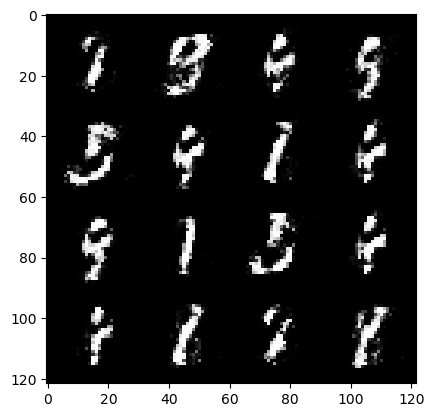

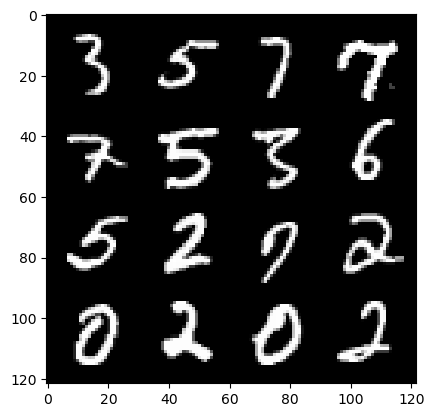

65: step 30900/ Gen loss: 5.21585894902547/ disc_loss: 0.06215659345189728


  0%|          | 0/469 [00:00<?, ?it/s]

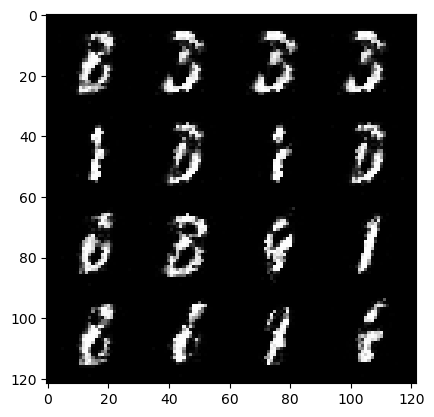

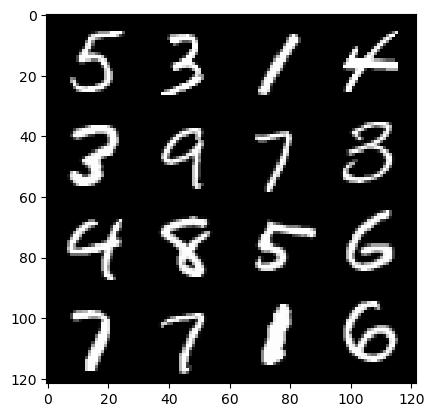

66: step 31200/ Gen loss: 4.744649483362834/ disc_loss: 0.07538117163504164


  0%|          | 0/469 [00:00<?, ?it/s]

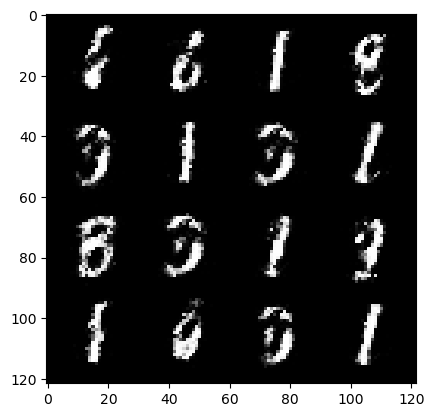

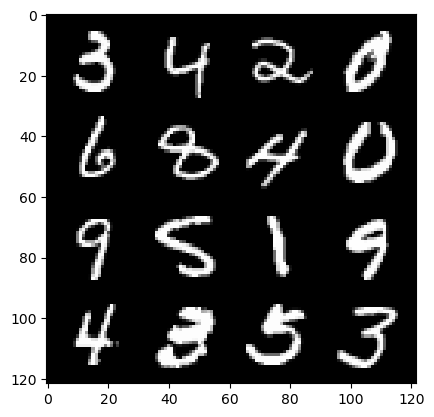

67: step 31500/ Gen loss: 4.80771013577779/ disc_loss: 0.07107684801953532


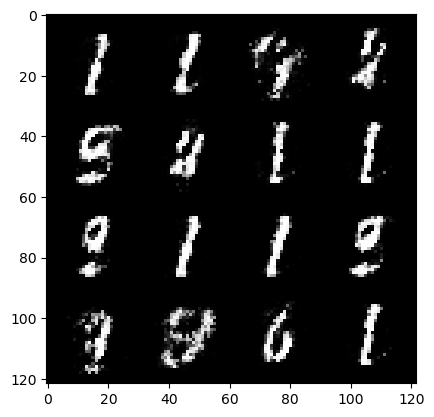

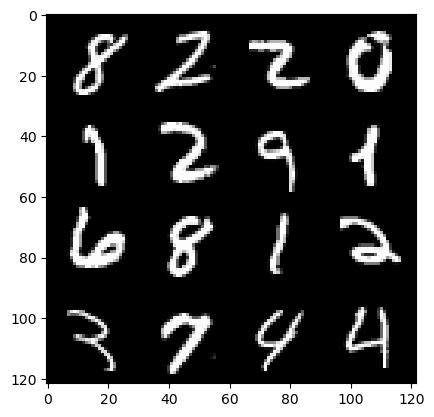

67: step 31800/ Gen loss: 4.532287693818411/ disc_loss: 0.08410685655971364


  0%|          | 0/469 [00:00<?, ?it/s]

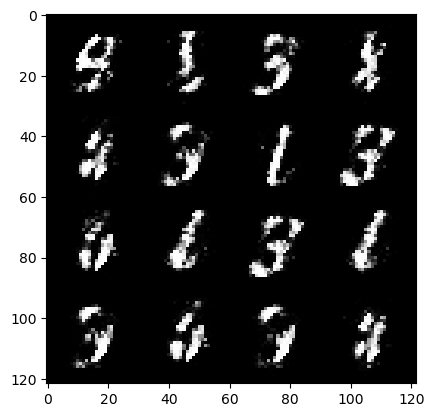

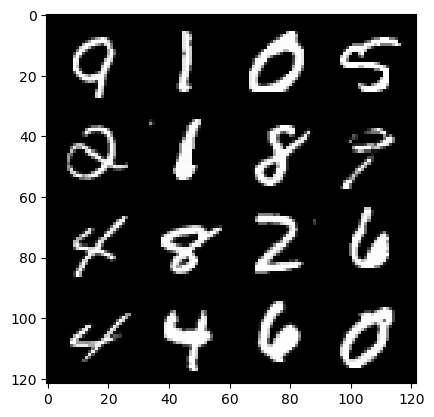

68: step 32100/ Gen loss: 4.634678897857671/ disc_loss: 0.06712544243161869


  0%|          | 0/469 [00:00<?, ?it/s]

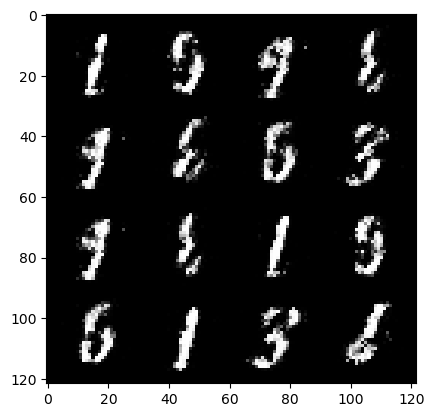

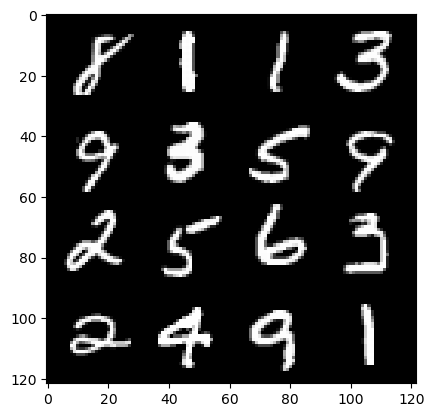

69: step 32400/ Gen loss: 4.9712769428889/ disc_loss: 0.06917303771711886


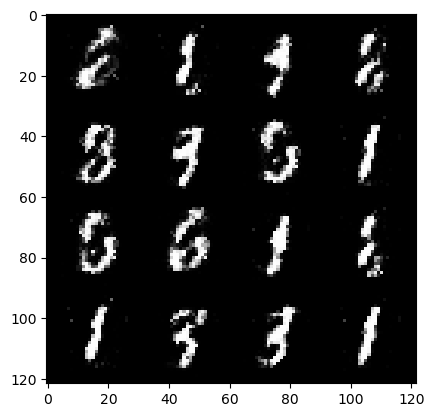

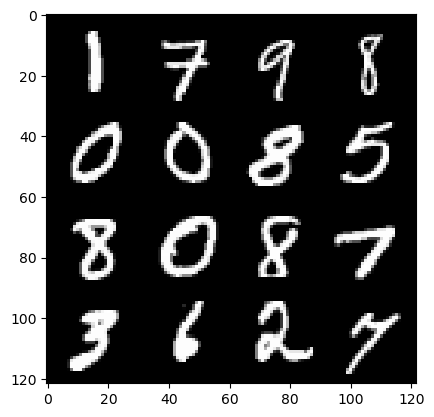

69: step 32700/ Gen loss: 4.967870428562165/ disc_loss: 0.06815572967131937


  0%|          | 0/469 [00:00<?, ?it/s]

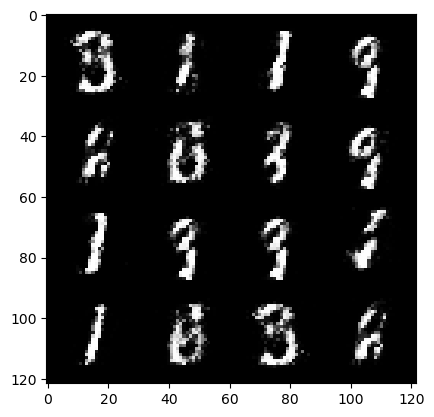

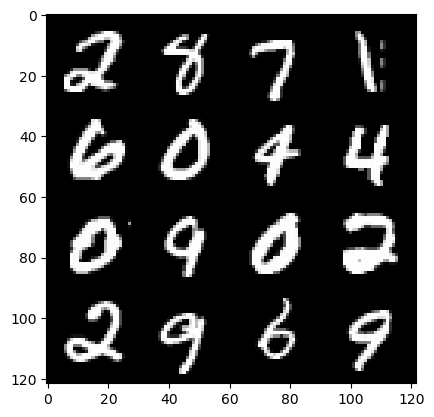

70: step 33000/ Gen loss: 4.720252345403035/ disc_loss: 0.08894776937241353


  0%|          | 0/469 [00:00<?, ?it/s]

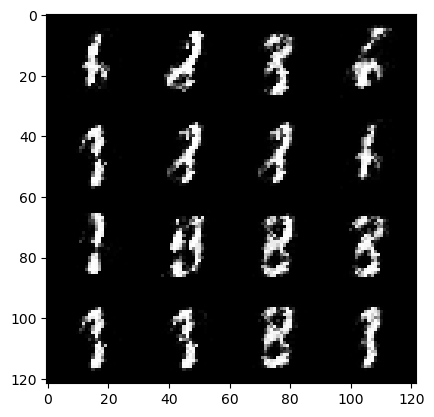

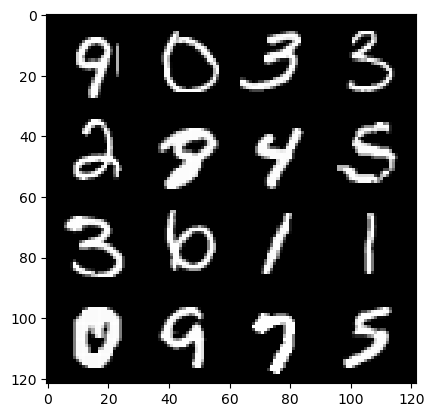

71: step 33300/ Gen loss: 4.258967266082761/ disc_loss: 0.10010911275322243


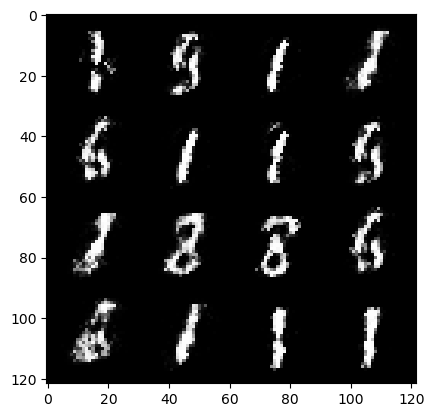

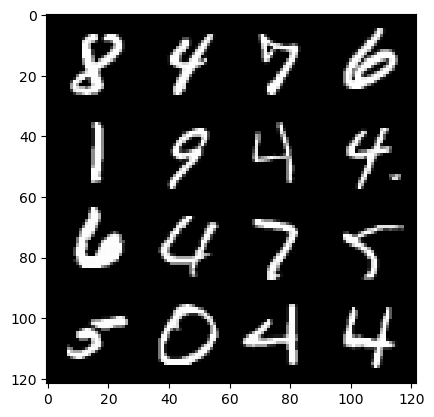

71: step 33600/ Gen loss: 4.289922308921812/ disc_loss: 0.10412547819316385


  0%|          | 0/469 [00:00<?, ?it/s]

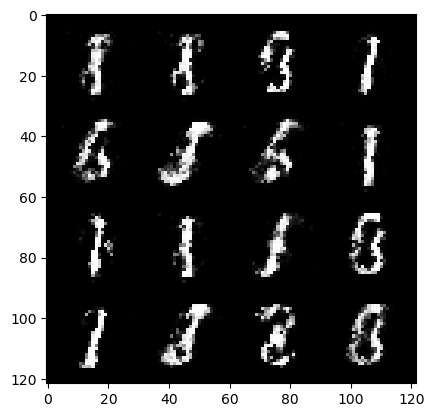

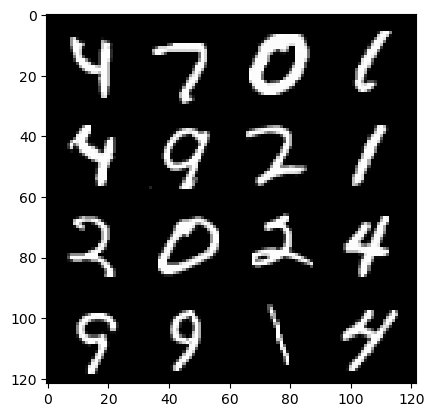

72: step 33900/ Gen loss: 4.120508179664614/ disc_loss: 0.10161271353562674


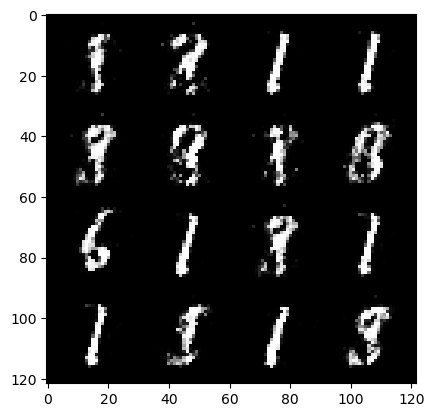

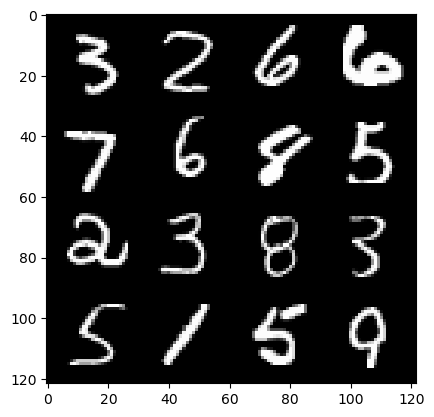

72: step 34200/ Gen loss: 4.598225588798519/ disc_loss: 0.061525231283158066


  0%|          | 0/469 [00:00<?, ?it/s]

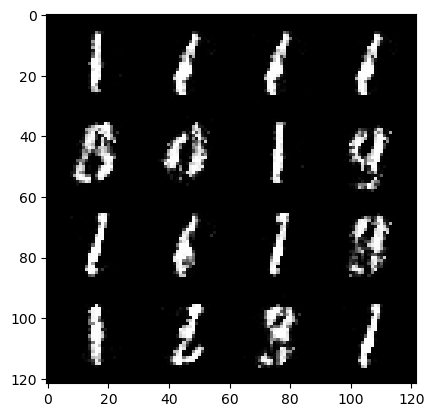

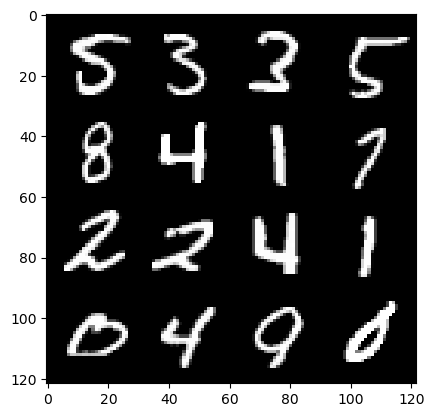

73: step 34500/ Gen loss: 4.541377797921497/ disc_loss: 0.09551350143427653


  0%|          | 0/469 [00:00<?, ?it/s]

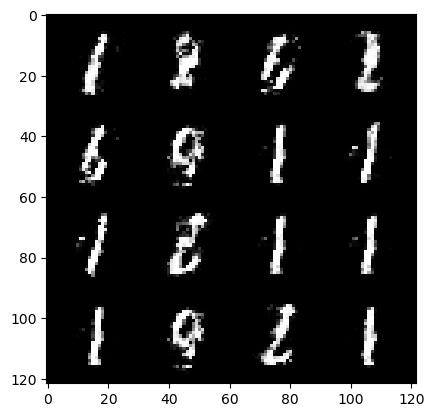

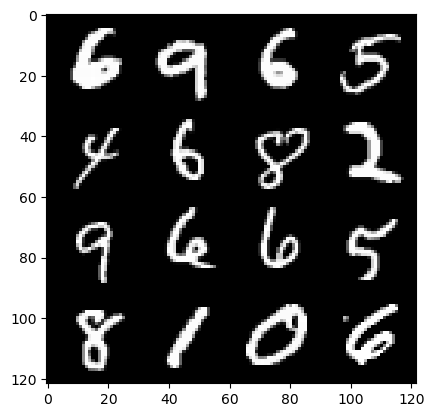

74: step 34800/ Gen loss: 4.061728119055432/ disc_loss: 0.09309408959001297


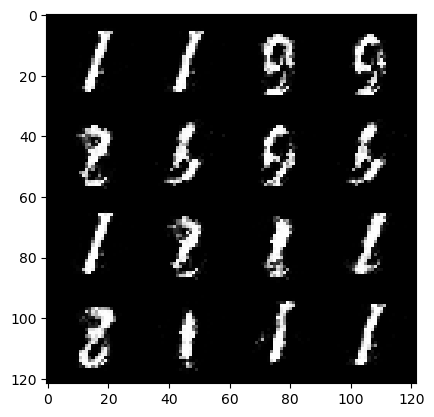

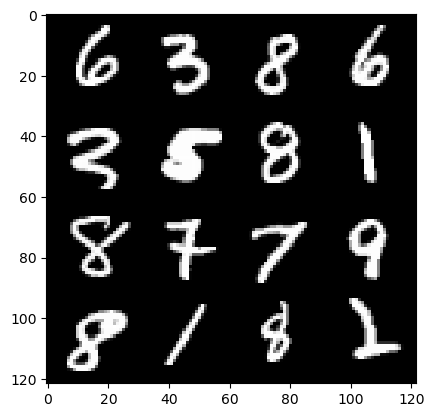

74: step 35100/ Gen loss: 4.559826455911001/ disc_loss: 0.07055133669947584


  0%|          | 0/469 [00:00<?, ?it/s]

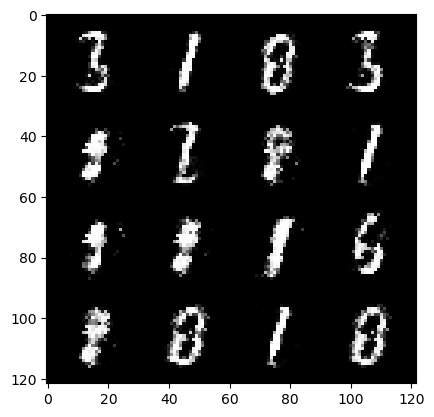

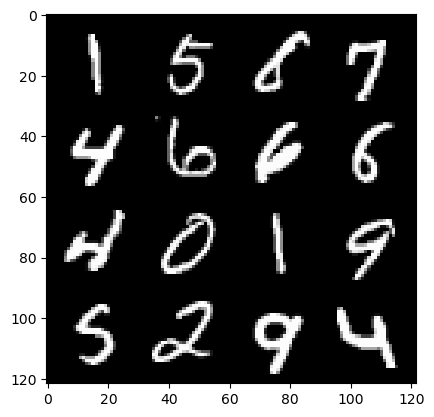

75: step 35400/ Gen loss: 4.39515698512395/ disc_loss: 0.08478041119873528


  0%|          | 0/469 [00:00<?, ?it/s]

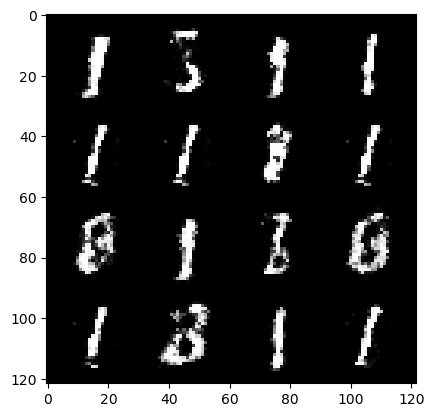

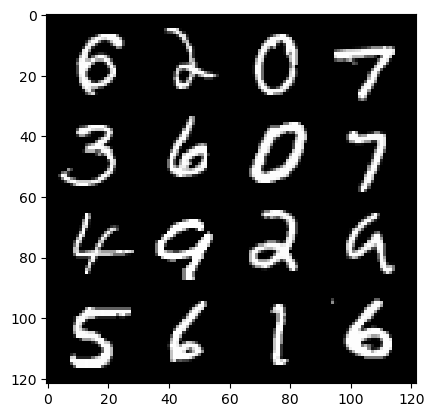

76: step 35700/ Gen loss: 4.446660031477612/ disc_loss: 0.08822542418415351


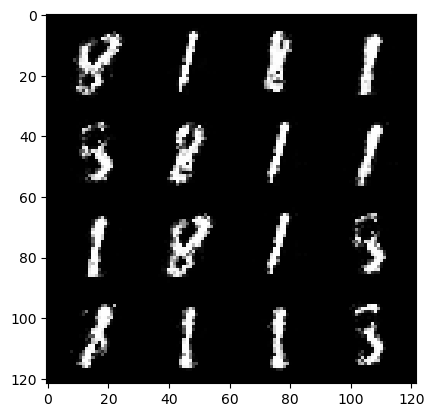

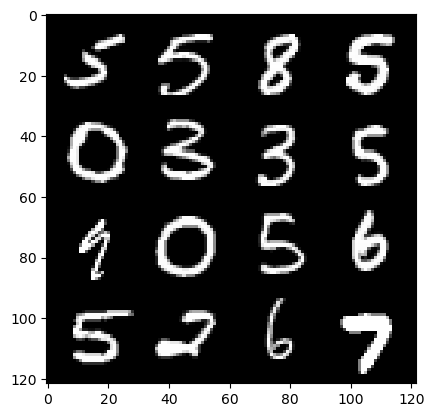

76: step 36000/ Gen loss: 3.923599233627319/ disc_loss: 0.10845195280387997


  0%|          | 0/469 [00:00<?, ?it/s]

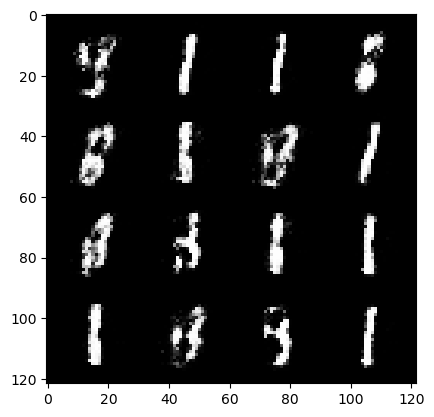

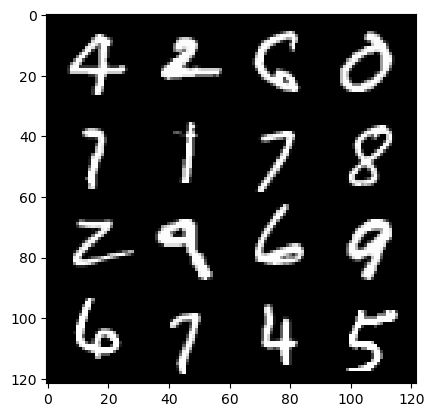

77: step 36300/ Gen loss: 4.2808396037419625/ disc_loss: 0.09603704428921143


  0%|          | 0/469 [00:00<?, ?it/s]

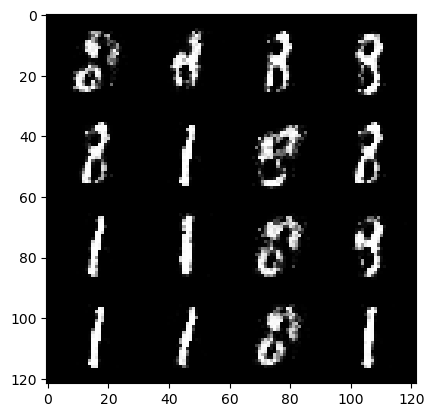

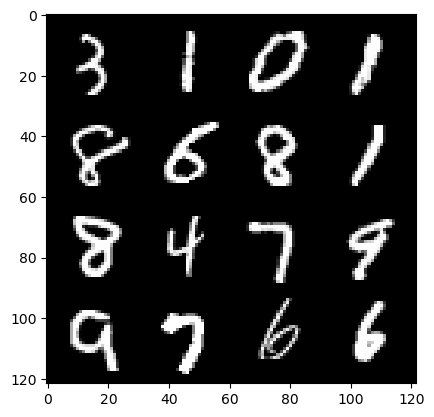

78: step 36600/ Gen loss: 3.836092253526052/ disc_loss: 0.12474456424514457


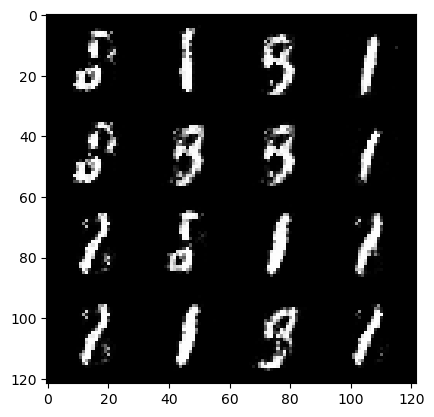

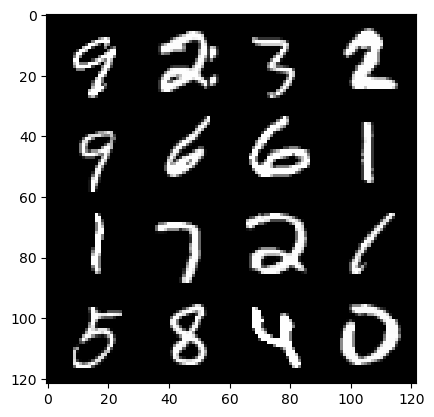

78: step 36900/ Gen loss: 3.8974546845754023/ disc_loss: 0.11288850187013547


  0%|          | 0/469 [00:00<?, ?it/s]

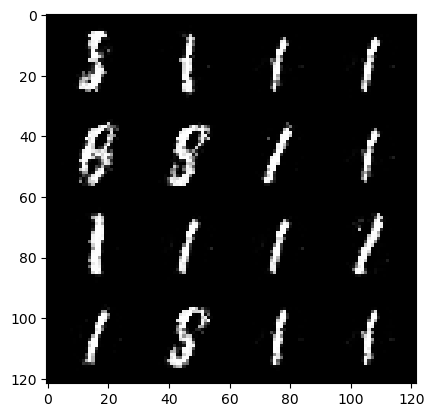

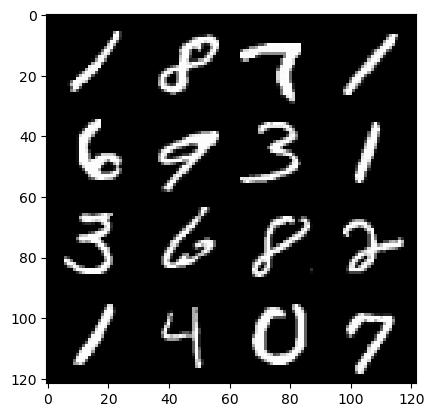

79: step 37200/ Gen loss: 4.002448123296101/ disc_loss: 0.10683765565355613


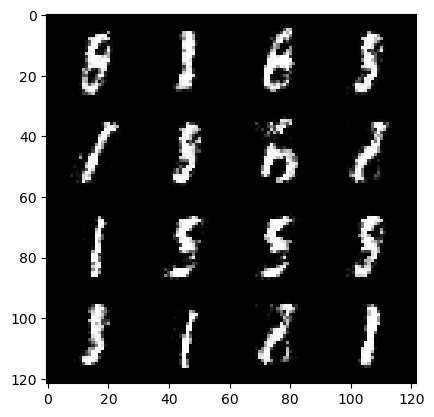

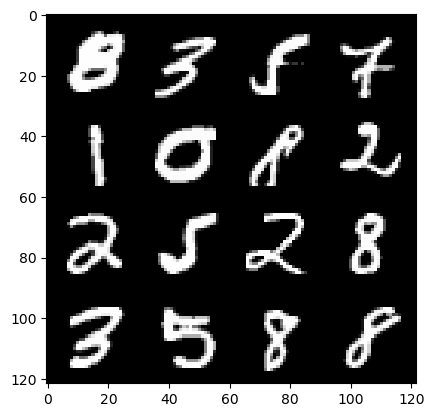

79: step 37500/ Gen loss: 3.9009199364980054/ disc_loss: 0.11450400490313763


  0%|          | 0/469 [00:00<?, ?it/s]

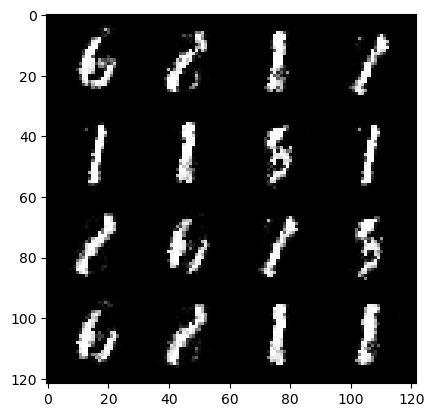

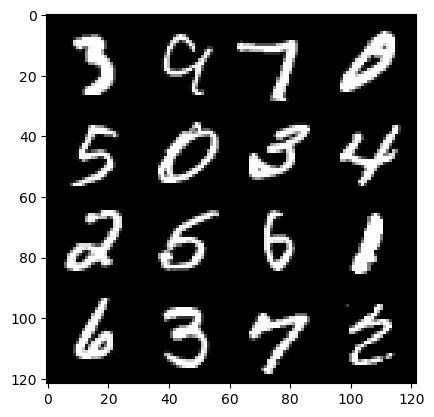

80: step 37800/ Gen loss: 3.6728874905904156/ disc_loss: 0.12378199032197403


  0%|          | 0/469 [00:00<?, ?it/s]

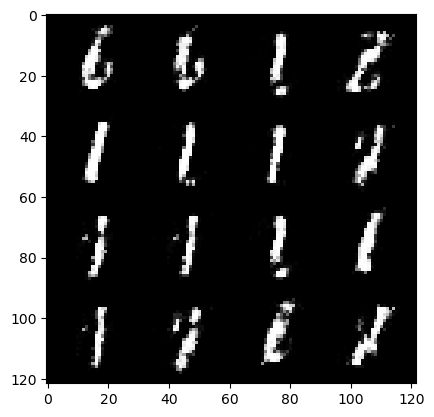

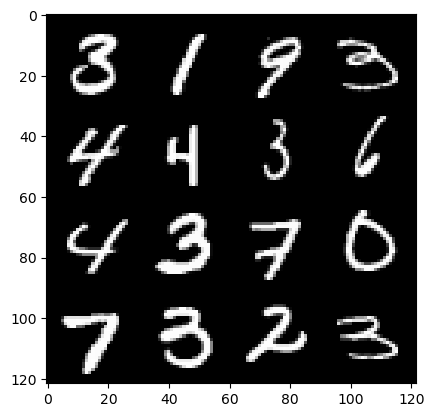

81: step 38100/ Gen loss: 3.583056242465974/ disc_loss: 0.16607259703179209


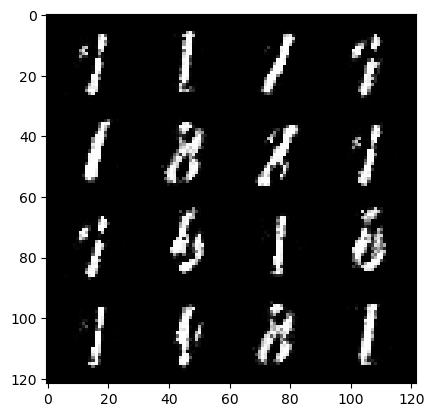

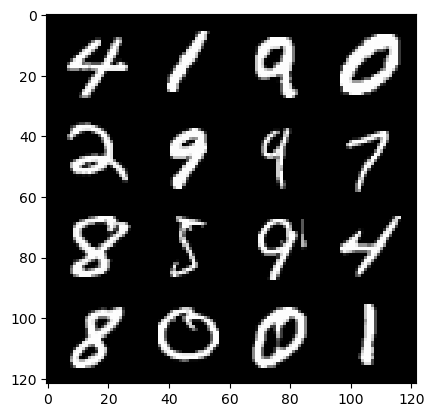

81: step 38400/ Gen loss: 3.463097593784332/ disc_loss: 0.1463596325616042


  0%|          | 0/469 [00:00<?, ?it/s]

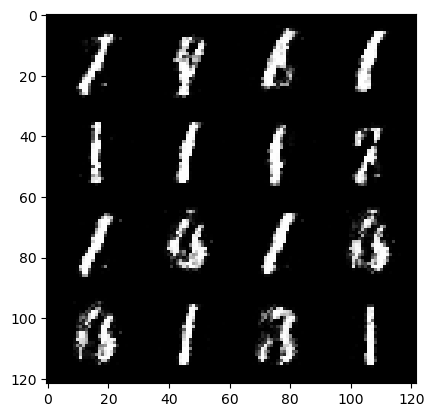

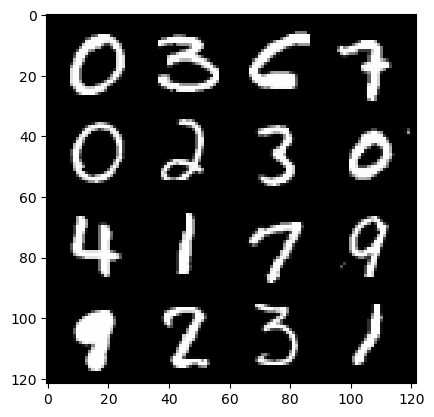

82: step 38700/ Gen loss: 3.5769944667816134/ disc_loss: 0.13912126539275046


  0%|          | 0/469 [00:00<?, ?it/s]

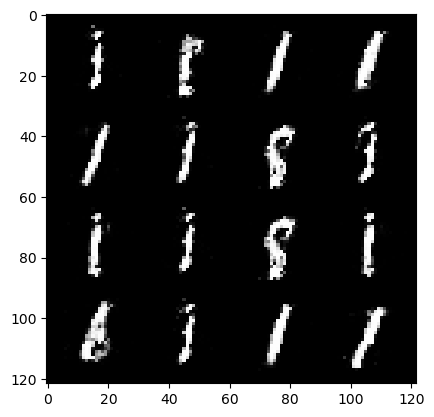

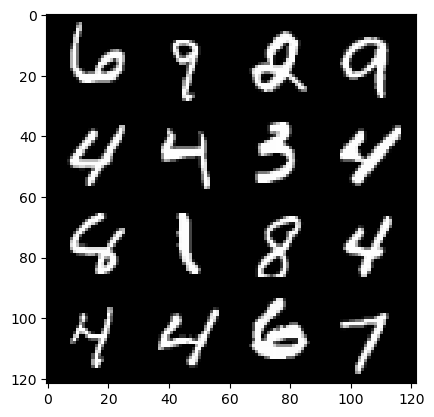

83: step 39000/ Gen loss: 3.466749113400778/ disc_loss: 0.14804929359505573


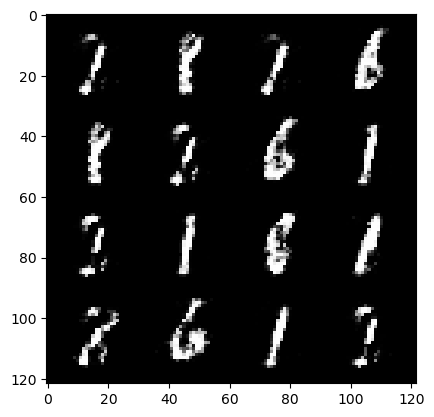

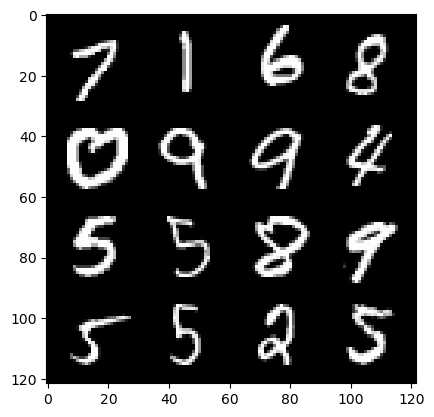

83: step 39300/ Gen loss: 3.3630473279952993/ disc_loss: 0.13564653643717375


  0%|          | 0/469 [00:00<?, ?it/s]

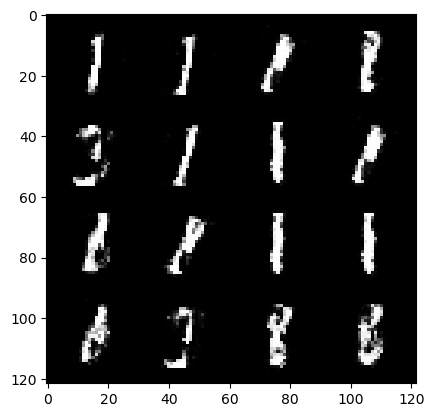

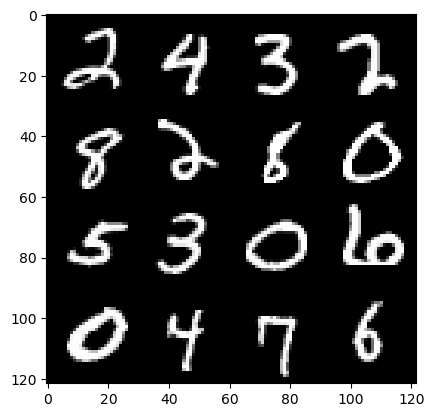

84: step 39600/ Gen loss: 3.549101821581524/ disc_loss: 0.13443715060750647


  0%|          | 0/469 [00:00<?, ?it/s]

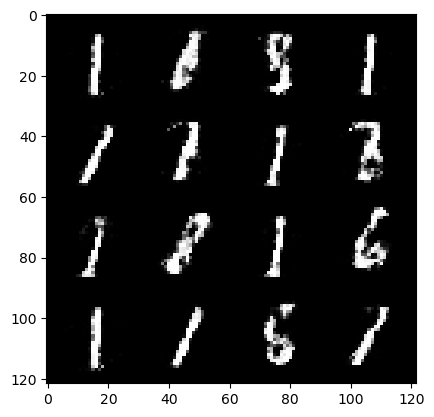

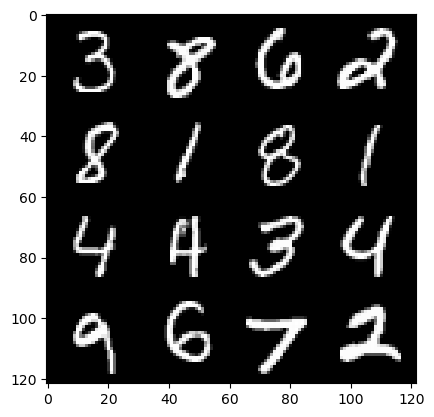

85: step 39900/ Gen loss: 3.4474165280659994/ disc_loss: 0.15315014936029903


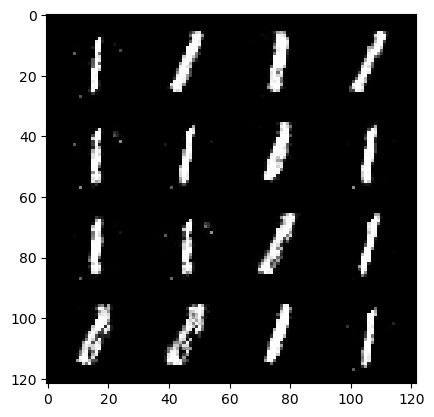

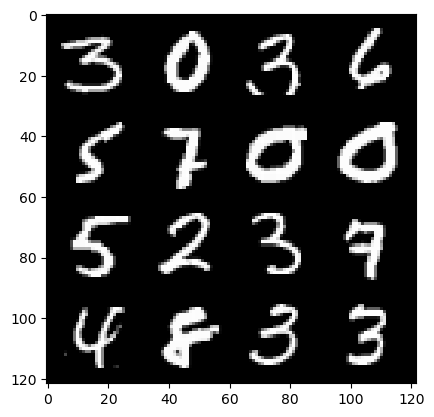

85: step 40200/ Gen loss: 3.2176286824544267/ disc_loss: 0.1627546521276236


  0%|          | 0/469 [00:00<?, ?it/s]

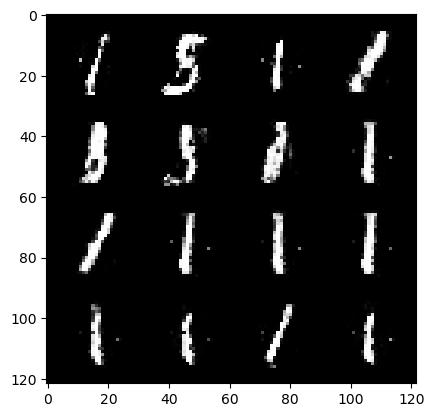

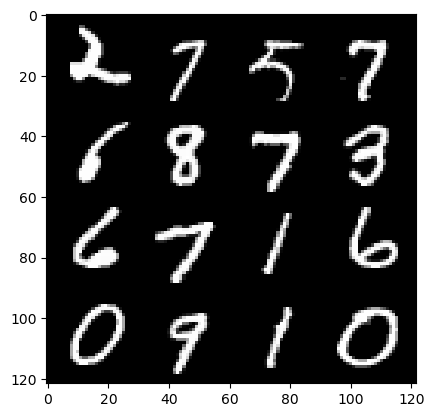

86: step 40500/ Gen loss: 3.0917365733782445/ disc_loss: 0.14940135135004928


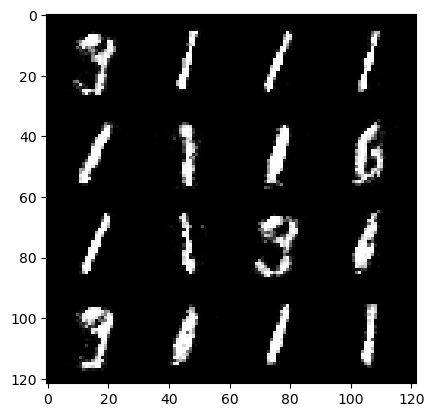

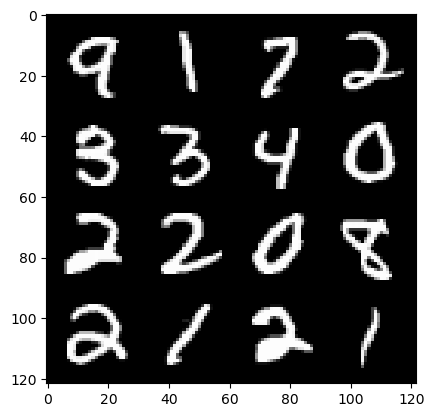

86: step 40800/ Gen loss: 3.207263046900431/ disc_loss: 0.17736981155971676


  0%|          | 0/469 [00:00<?, ?it/s]

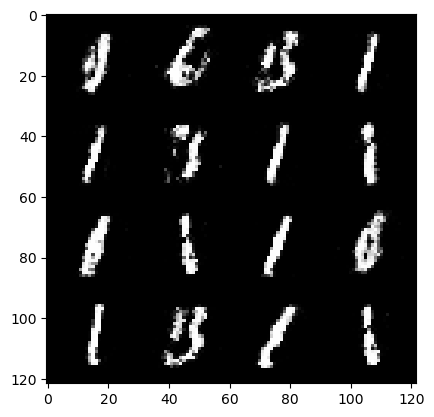

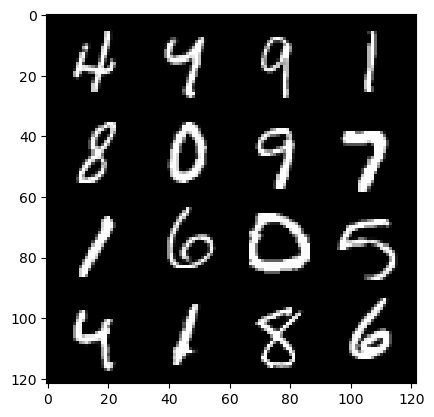

87: step 41100/ Gen loss: 3.124472992420195/ disc_loss: 0.17314604712029297


  0%|          | 0/469 [00:00<?, ?it/s]

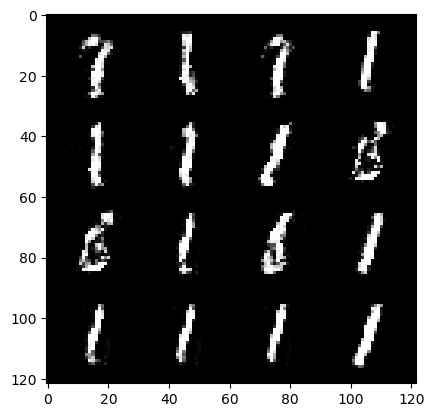

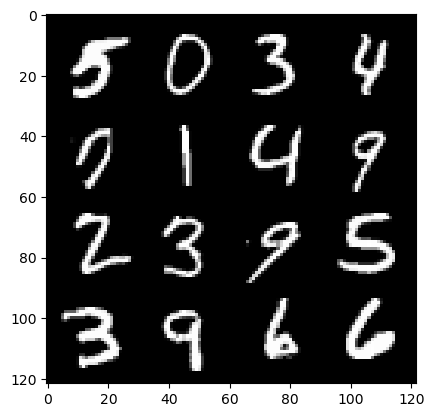

88: step 41400/ Gen loss: 3.137170767784116/ disc_loss: 0.14539402343332772


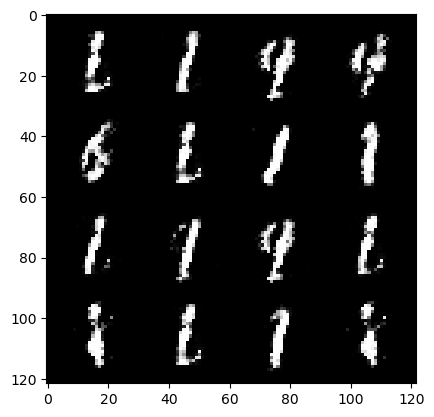

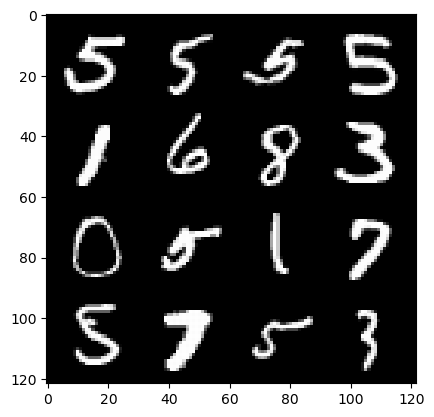

88: step 41700/ Gen loss: 3.4517337600390112/ disc_loss: 0.12438247814774521


  0%|          | 0/469 [00:00<?, ?it/s]

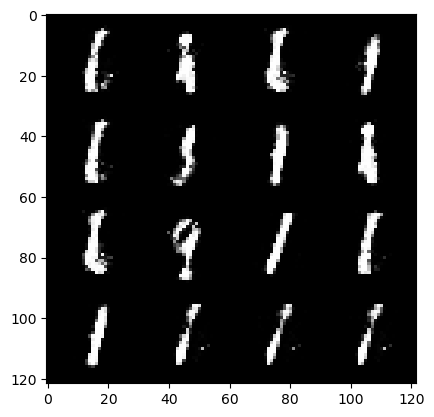

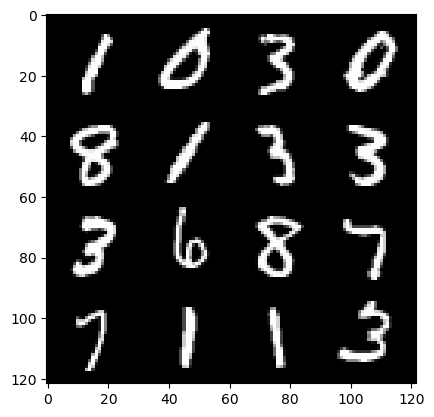

89: step 42000/ Gen loss: 3.509555782477063/ disc_loss: 0.12260419294238094


  0%|          | 0/469 [00:00<?, ?it/s]

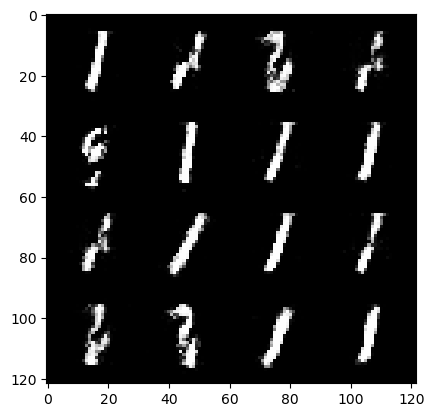

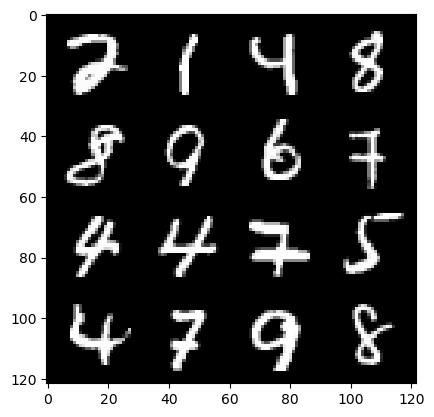

90: step 42300/ Gen loss: 3.3145491369565327/ disc_loss: 0.1372463623682658


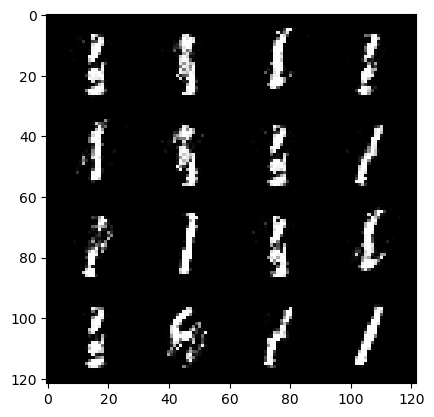

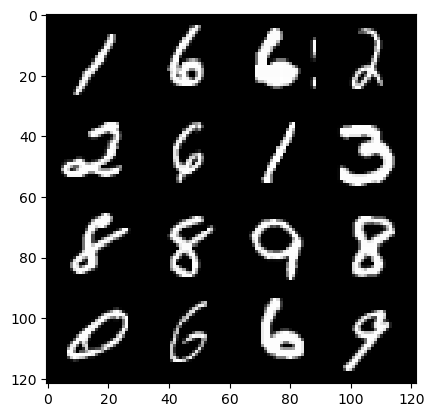

90: step 42600/ Gen loss: 3.2329686578114827/ disc_loss: 0.152036523843805


  0%|          | 0/469 [00:00<?, ?it/s]

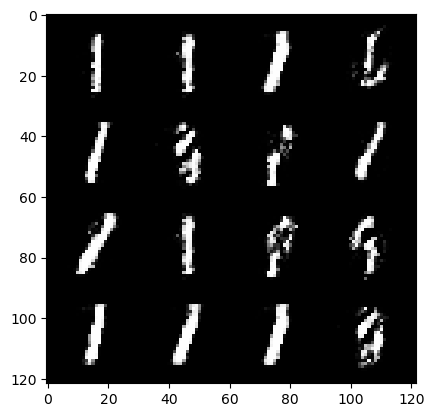

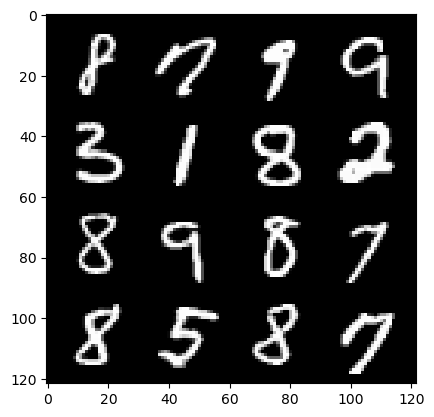

91: step 42900/ Gen loss: 3.34344169139862/ disc_loss: 0.1431141020605961


  0%|          | 0/469 [00:00<?, ?it/s]

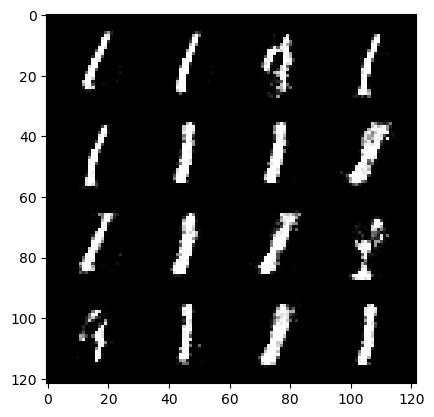

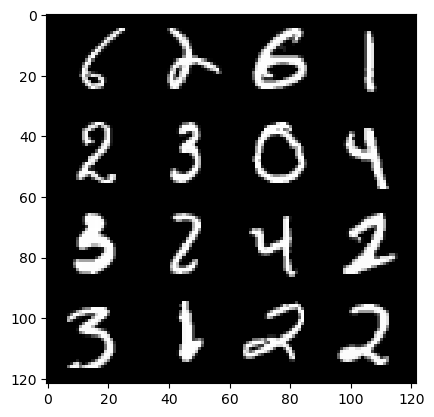

92: step 43200/ Gen loss: 3.1015313673019427/ disc_loss: 0.15154007563988367


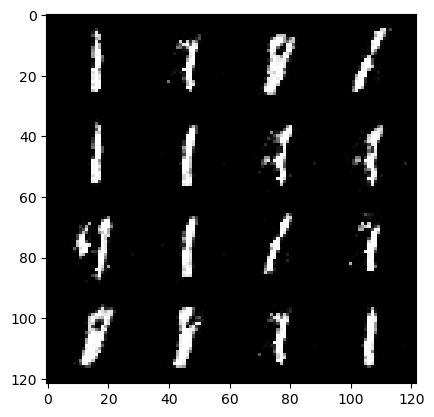

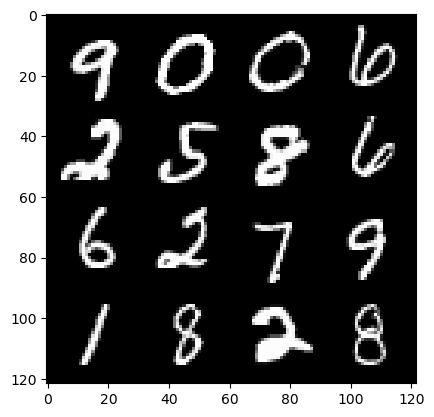

92: step 43500/ Gen loss: 3.214480988979338/ disc_loss: 0.15618354114393387


  0%|          | 0/469 [00:00<?, ?it/s]

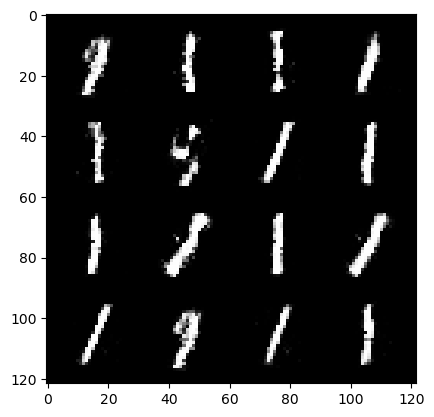

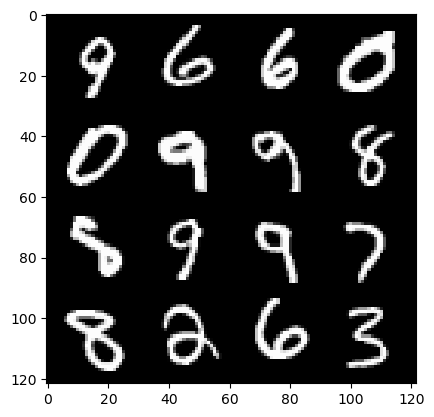

93: step 43800/ Gen loss: 3.093095010916392/ disc_loss: 0.14501538009693232


  0%|          | 0/469 [00:00<?, ?it/s]

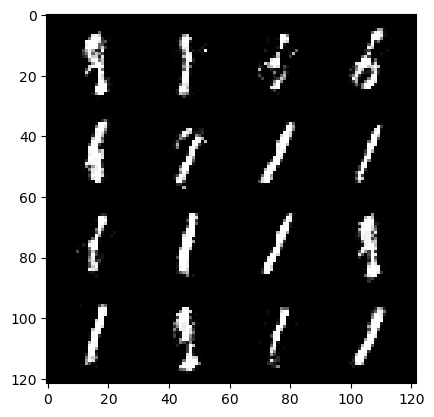

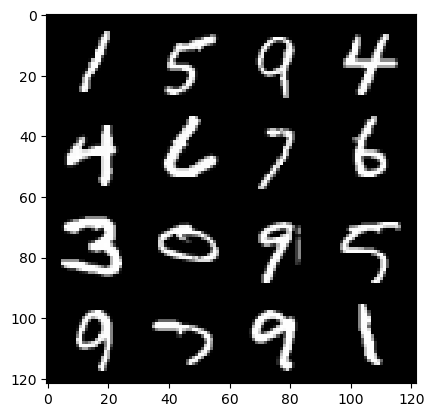

94: step 44100/ Gen loss: 3.052484009265901/ disc_loss: 0.18138987069328627


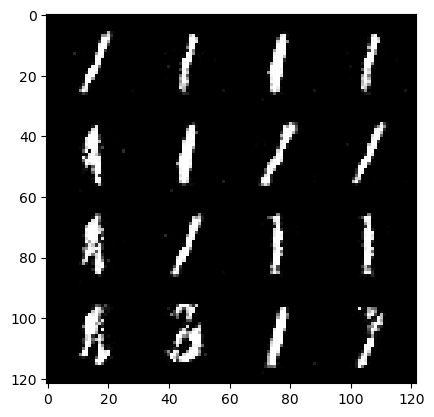

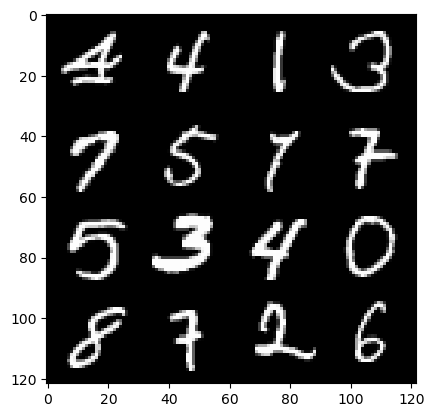

94: step 44400/ Gen loss: 2.9939598608016973/ disc_loss: 0.16338550264636664


  0%|          | 0/469 [00:00<?, ?it/s]

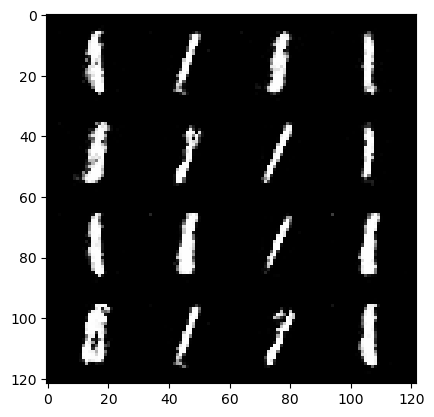

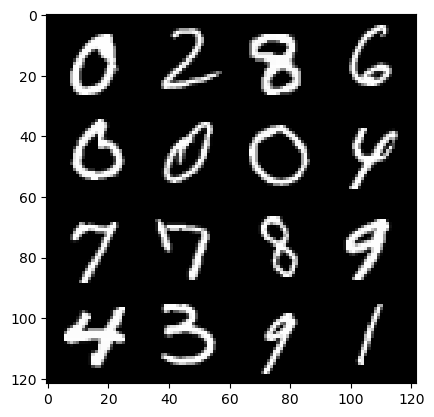

95: step 44700/ Gen loss: 3.098989561398822/ disc_loss: 0.15313903413712965


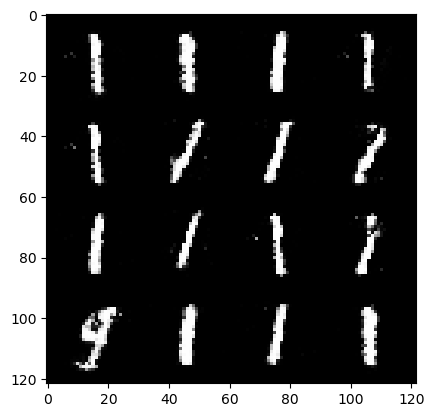

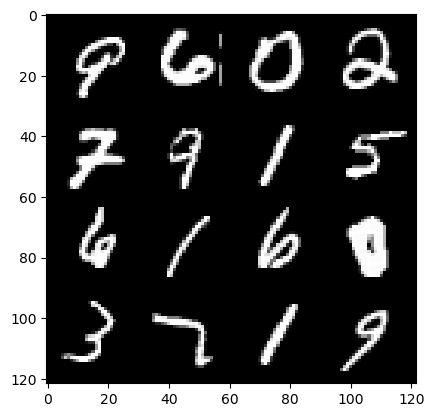

95: step 45000/ Gen loss: 2.9937467050552375/ disc_loss: 0.15015170404066638


  0%|          | 0/469 [00:00<?, ?it/s]

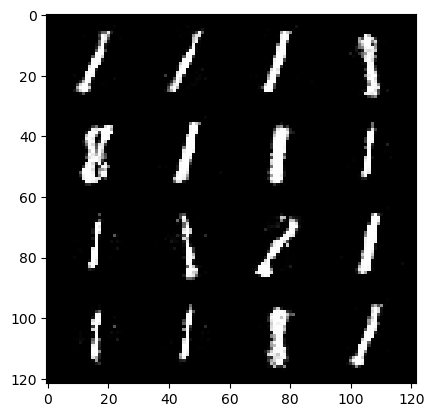

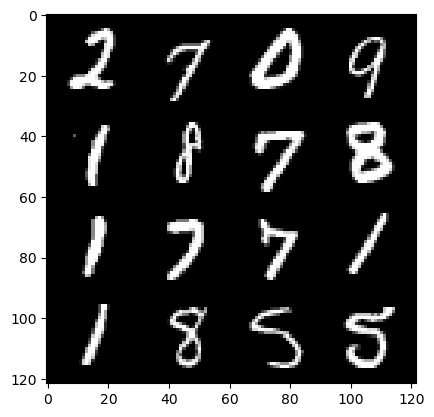

96: step 45300/ Gen loss: 2.853043396472932/ disc_loss: 0.16509541074434916


  0%|          | 0/469 [00:00<?, ?it/s]

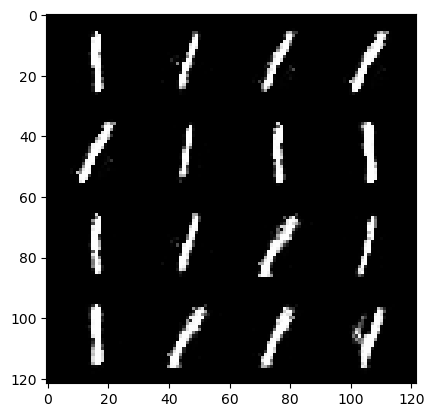

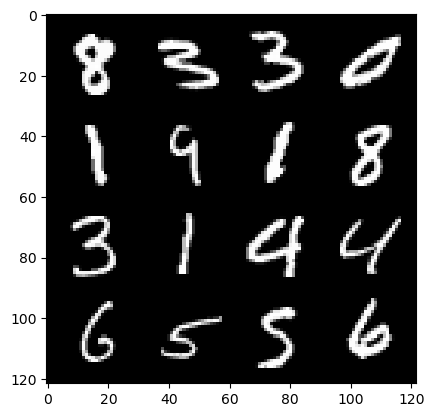

97: step 45600/ Gen loss: 2.8621707685788467/ disc_loss: 0.1651468219856421


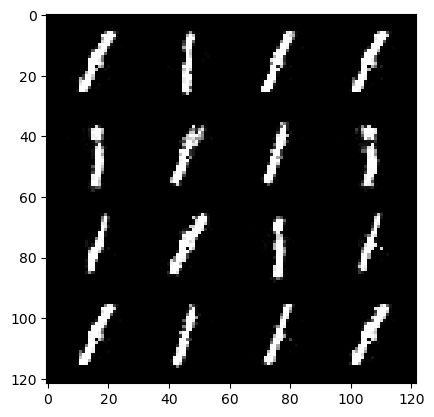

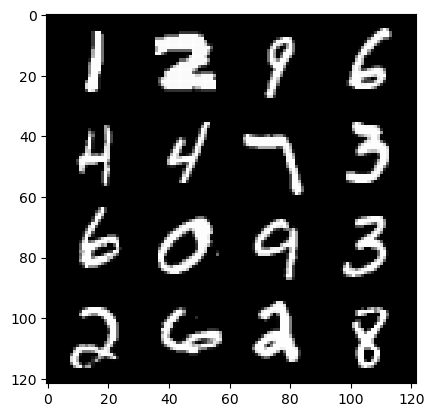

97: step 45900/ Gen loss: 2.839245386918386/ disc_loss: 0.17380013716717554


  0%|          | 0/469 [00:00<?, ?it/s]

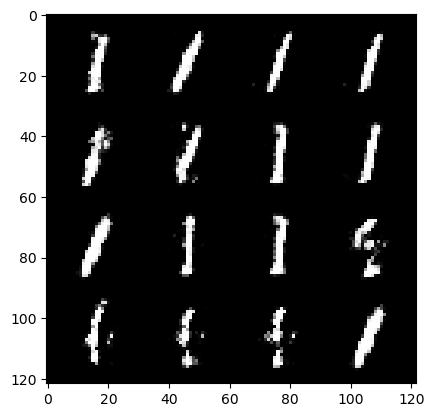

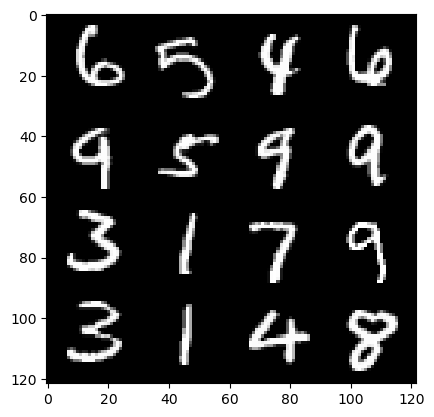

98: step 46200/ Gen loss: 3.0694935607910168/ disc_loss: 0.15217230262855694


  0%|          | 0/469 [00:00<?, ?it/s]

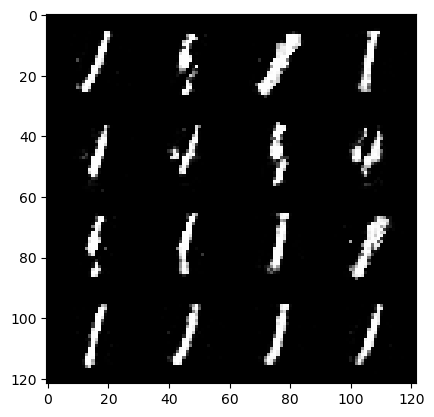

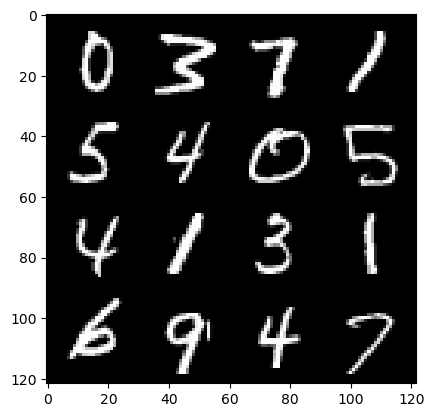

99: step 46500/ Gen loss: 2.939548941453298/ disc_loss: 0.15004406481981272


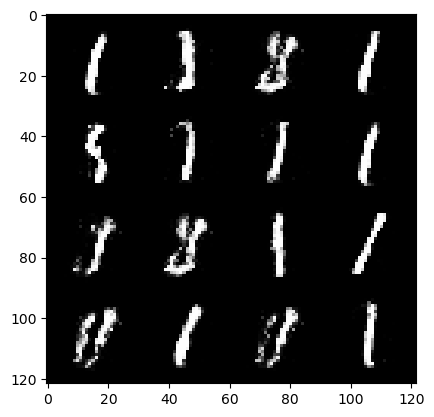

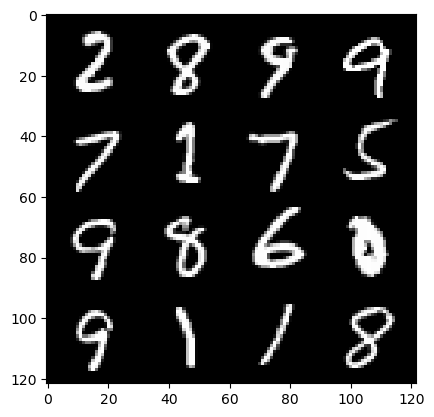

99: step 46800/ Gen loss: 3.1874354680379215/ disc_loss: 0.12972295920054125


  0%|          | 0/469 [00:00<?, ?it/s]

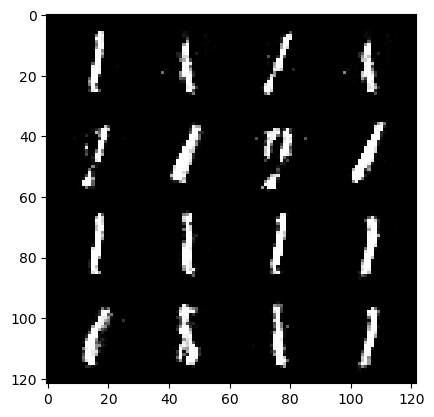

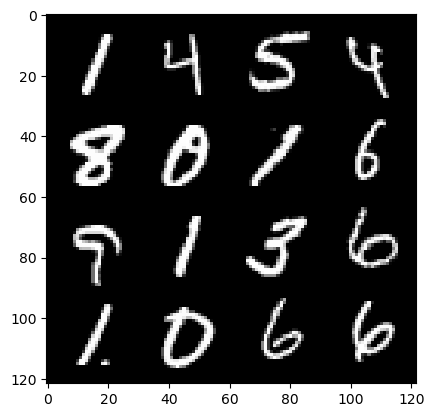

100: step 47100/ Gen loss: 3.0260088284810385/ disc_loss: 0.15571647311250367


  0%|          | 0/469 [00:00<?, ?it/s]

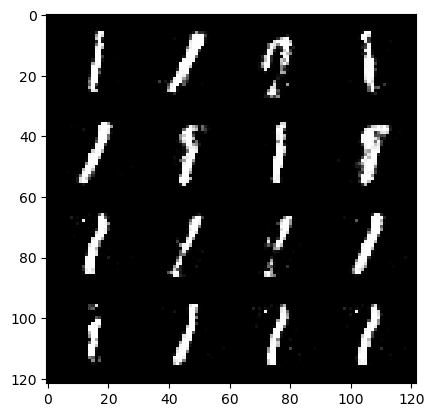

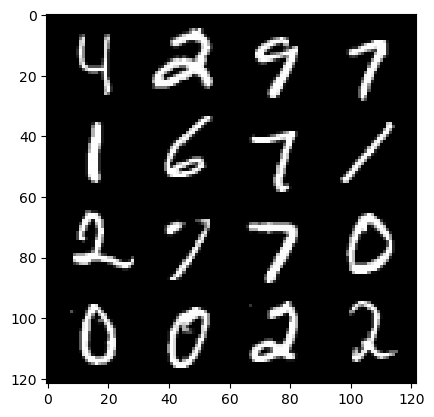

101: step 47400/ Gen loss: 2.81838519414266/ disc_loss: 0.1657511479904254


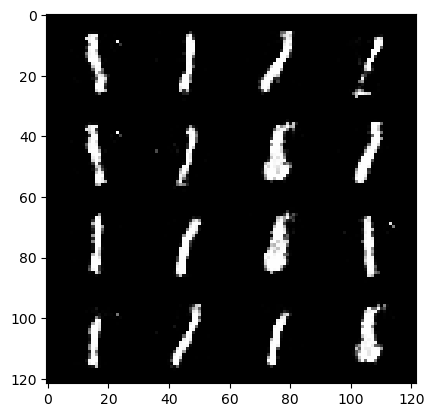

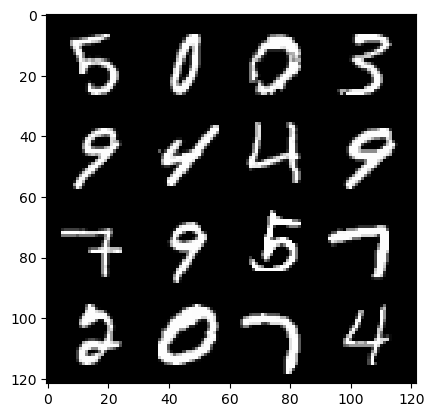

101: step 47700/ Gen loss: 2.782341288725536/ disc_loss: 0.1753166572501261


  0%|          | 0/469 [00:00<?, ?it/s]

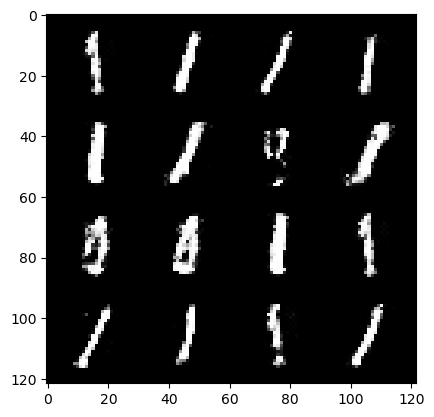

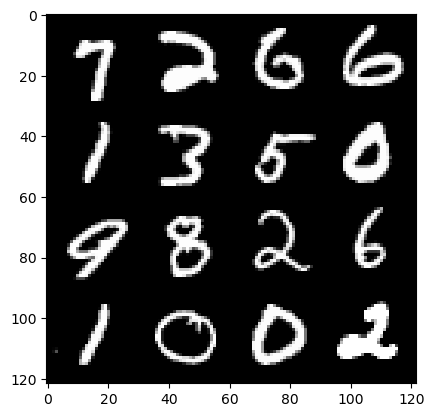

102: step 48000/ Gen loss: 2.7066295305887857/ disc_loss: 0.18145643353462212


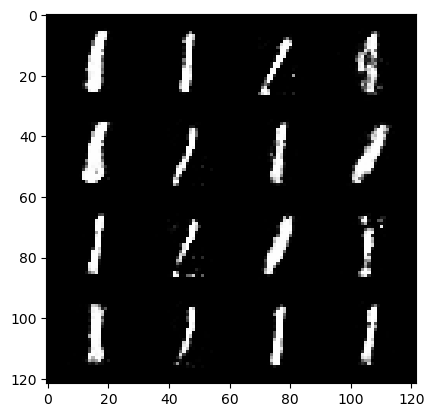

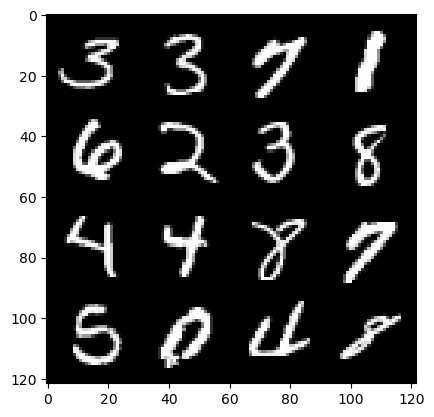

102: step 48300/ Gen loss: 2.6932589308420805/ disc_loss: 0.180909217422207


  0%|          | 0/469 [00:00<?, ?it/s]

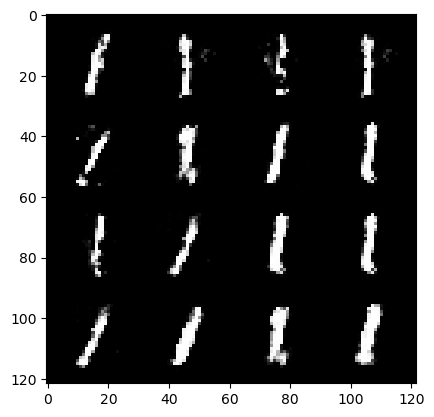

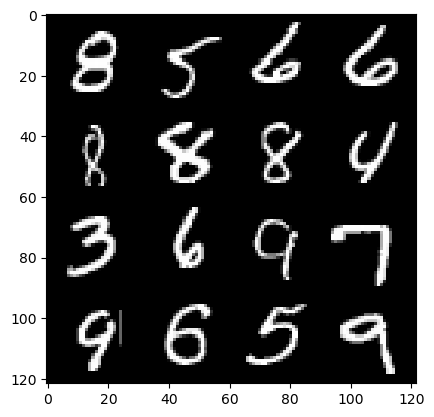

103: step 48600/ Gen loss: 2.715084725220998/ disc_loss: 0.1706005554397899


  0%|          | 0/469 [00:00<?, ?it/s]

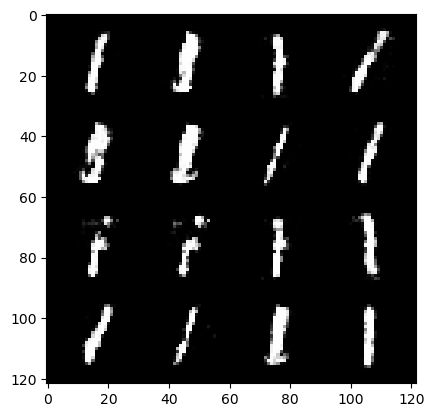

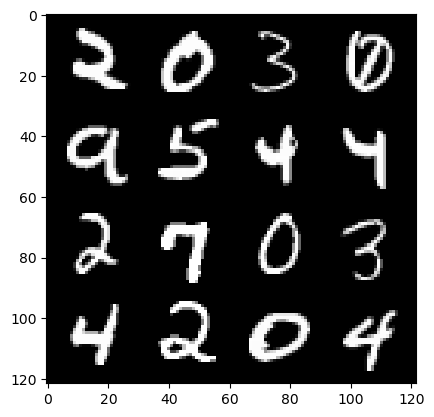

104: step 48900/ Gen loss: 2.730181138515472/ disc_loss: 0.17598532326519484


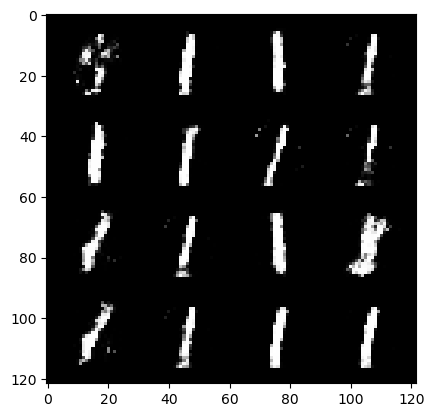

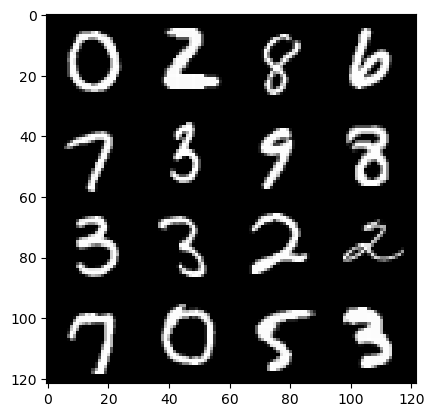

104: step 49200/ Gen loss: 2.6195286329587346/ disc_loss: 0.18791976876556887


  0%|          | 0/469 [00:00<?, ?it/s]

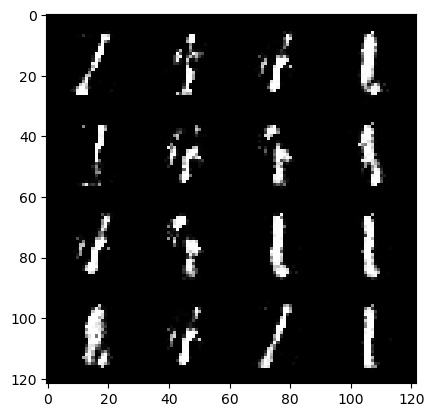

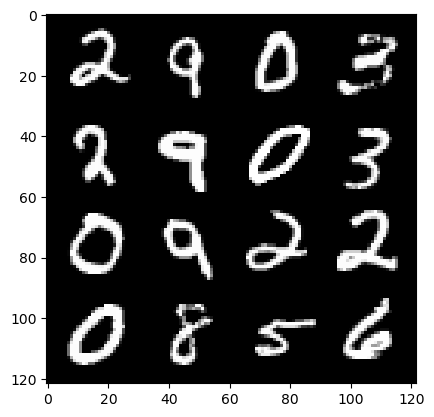

105: step 49500/ Gen loss: 2.6947699348131815/ disc_loss: 0.180954360589385


  0%|          | 0/469 [00:00<?, ?it/s]

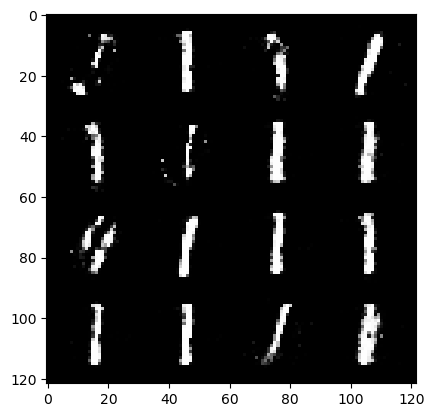

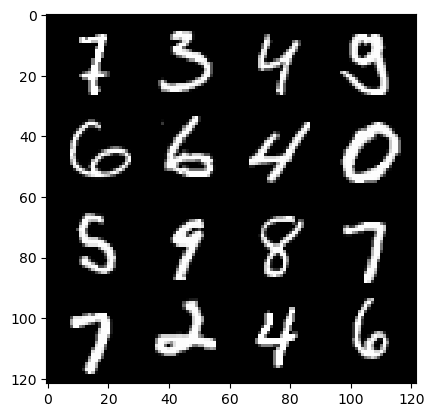

106: step 49800/ Gen loss: 2.8221252187093087/ disc_loss: 0.16315595857799056


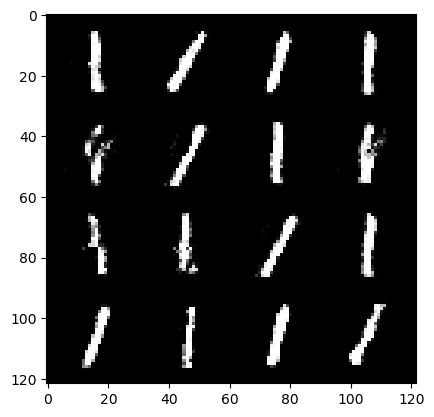

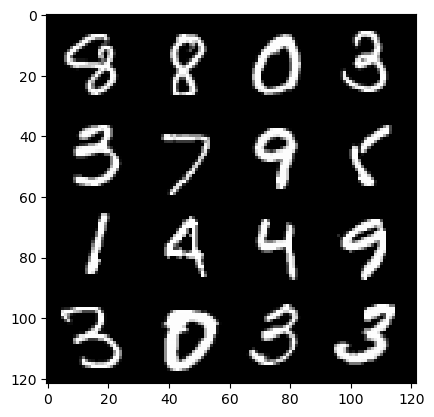

106: step 50100/ Gen loss: 2.6336817487080877/ disc_loss: 0.17593558520078662


  0%|          | 0/469 [00:00<?, ?it/s]

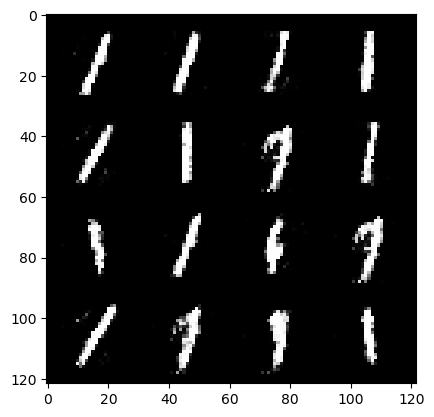

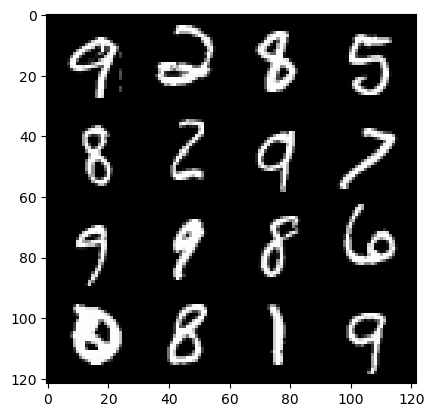

107: step 50400/ Gen loss: 2.669443118572236/ disc_loss: 0.16468941323459155


  0%|          | 0/469 [00:00<?, ?it/s]

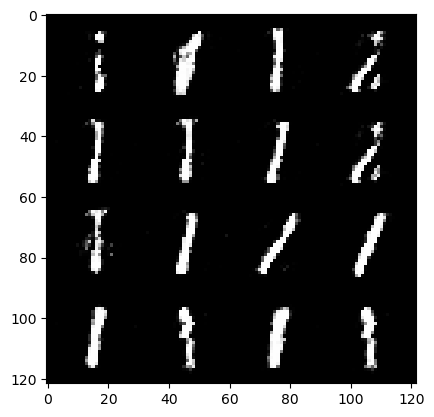

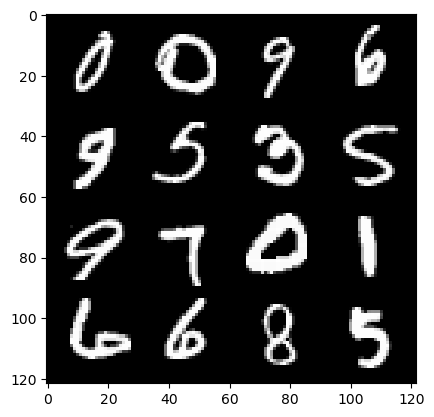

108: step 50700/ Gen loss: 2.7385167431831343/ disc_loss: 0.1683579328159492


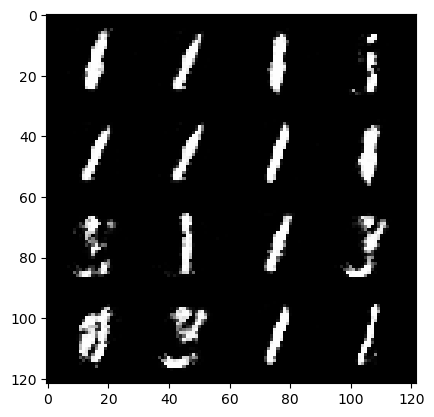

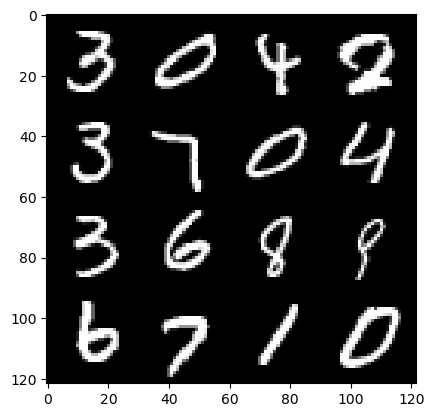

108: step 51000/ Gen loss: 2.724135016600291/ disc_loss: 0.17383507303893567


  0%|          | 0/469 [00:00<?, ?it/s]

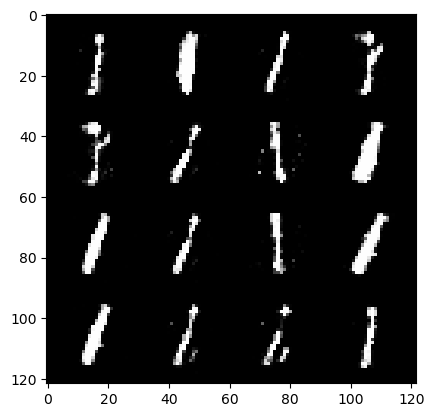

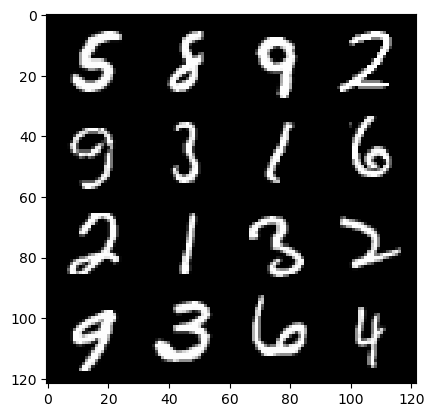

109: step 51300/ Gen loss: 2.619452697436012/ disc_loss: 0.17204114022354286


  0%|          | 0/469 [00:00<?, ?it/s]

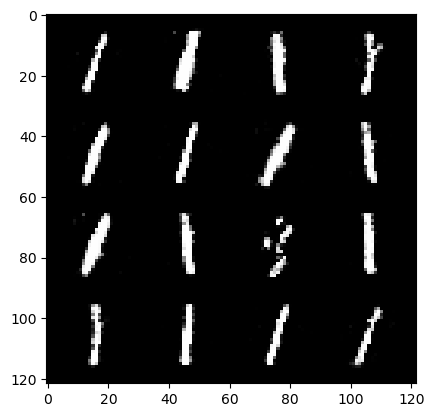

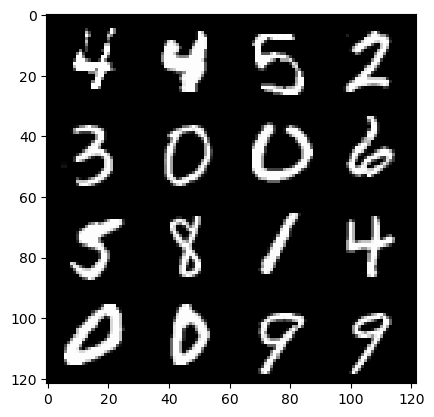

110: step 51600/ Gen loss: 2.615610342820486/ disc_loss: 0.1714356112480163


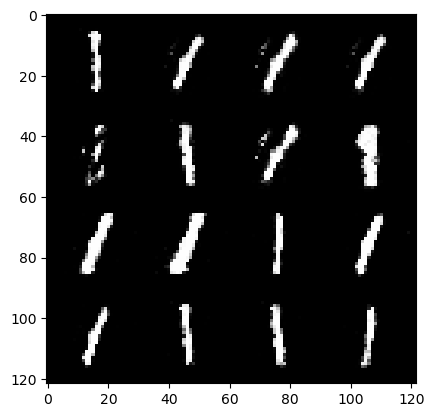

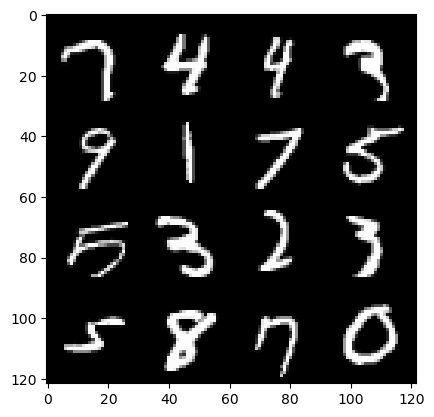

110: step 51900/ Gen loss: 2.630970745086672/ disc_loss: 0.1582432736208042


  0%|          | 0/469 [00:00<?, ?it/s]

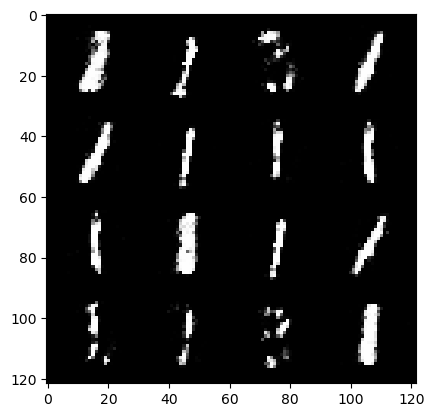

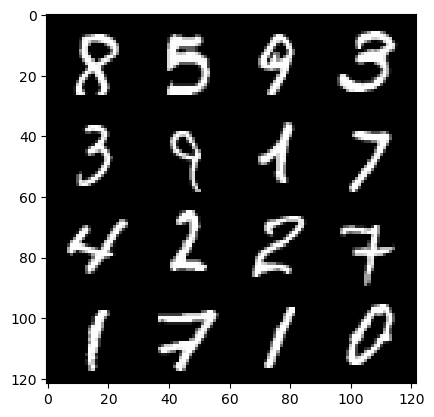

111: step 52200/ Gen loss: 2.7462543002764384/ disc_loss: 0.15749908037483693


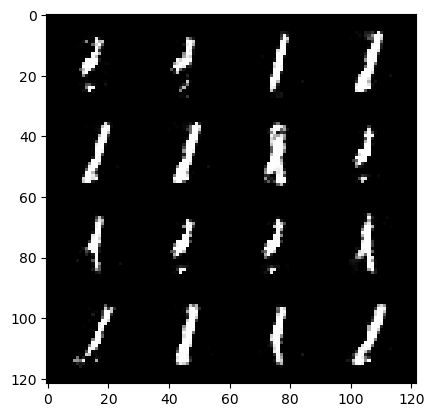

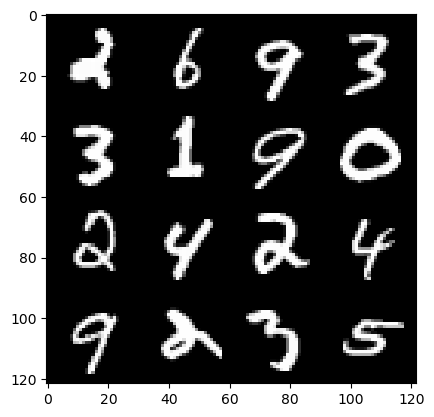

111: step 52500/ Gen loss: 2.6913573193550113/ disc_loss: 0.16849733700354902


  0%|          | 0/469 [00:00<?, ?it/s]

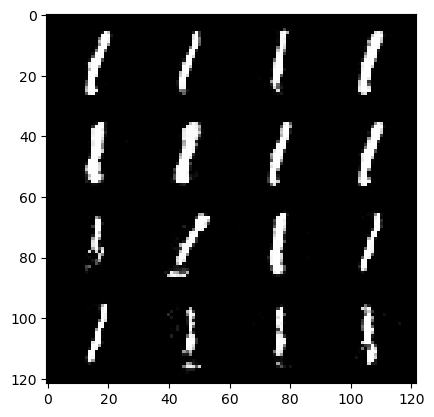

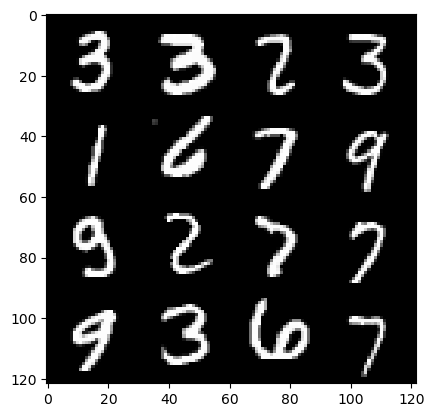

112: step 52800/ Gen loss: 2.8249195567766816/ disc_loss: 0.14948460202664135


  0%|          | 0/469 [00:00<?, ?it/s]

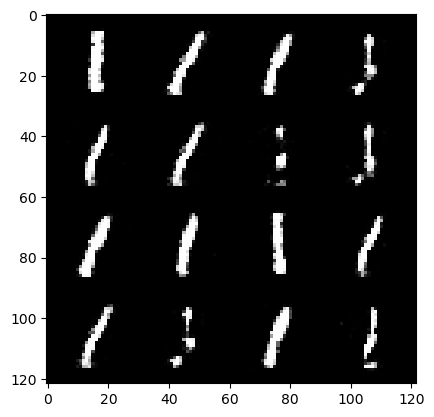

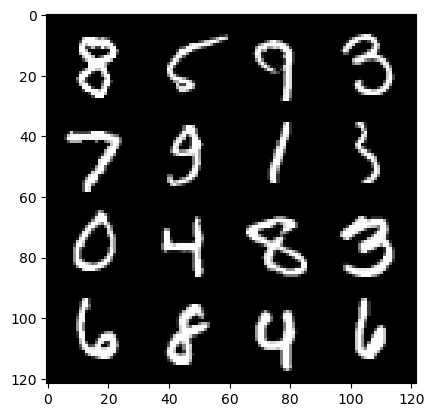

113: step 53100/ Gen loss: 2.6666259606679277/ disc_loss: 0.17324850924313073


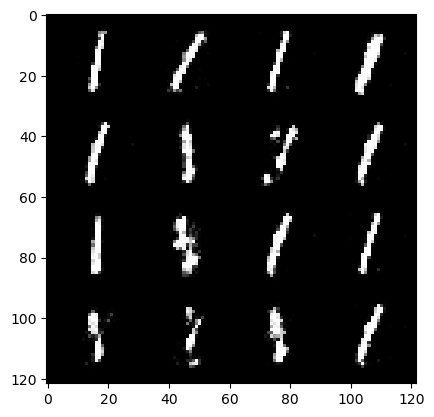

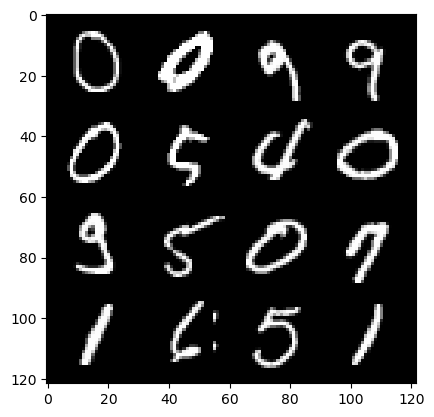

113: step 53400/ Gen loss: 2.5592611893018096/ disc_loss: 0.17804354404409722


  0%|          | 0/469 [00:00<?, ?it/s]

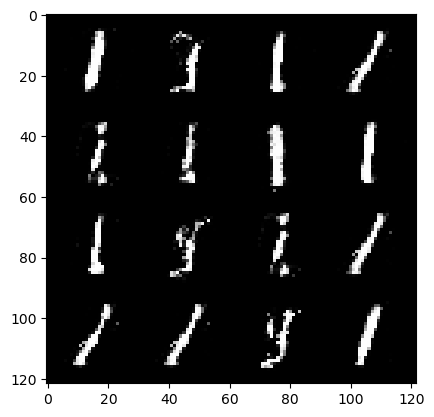

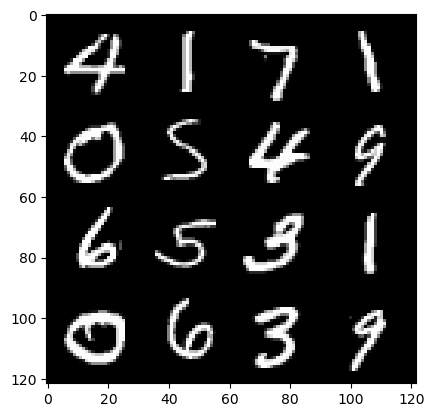

114: step 53700/ Gen loss: 2.6420296724637353/ disc_loss: 0.1703613352278869


  0%|          | 0/469 [00:00<?, ?it/s]

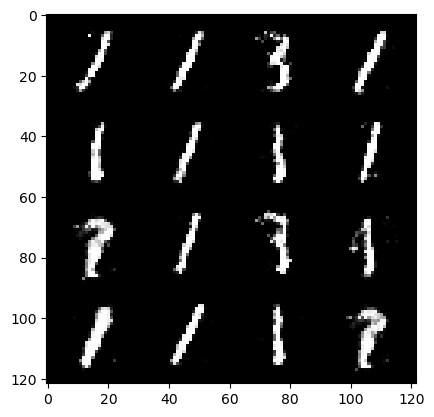

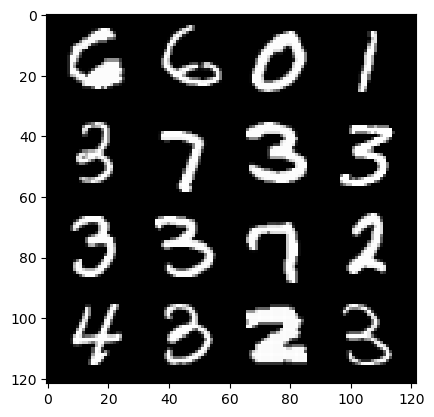

115: step 54000/ Gen loss: 2.697738051414491/ disc_loss: 0.1725866800794999


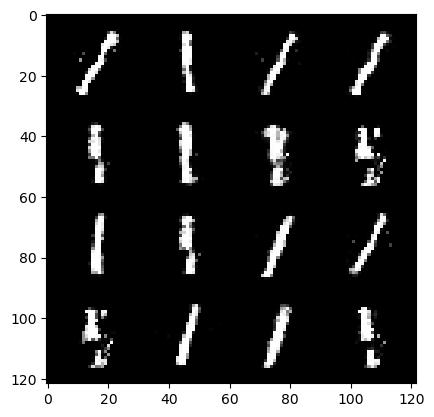

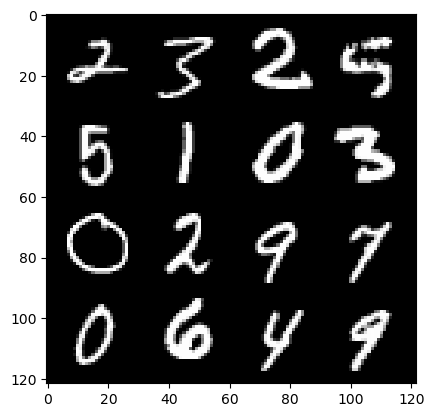

115: step 54300/ Gen loss: 2.718530683517454/ disc_loss: 0.16669961194197327


  0%|          | 0/469 [00:00<?, ?it/s]

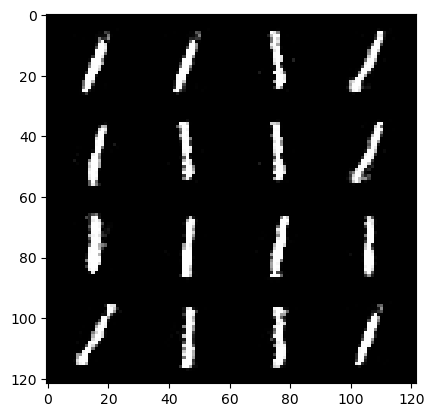

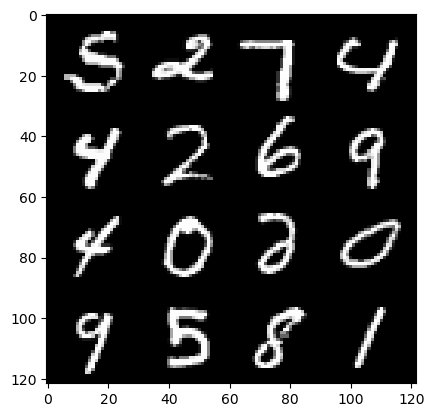

116: step 54600/ Gen loss: 2.6810938930511488/ disc_loss: 0.16896232095857475


  0%|          | 0/469 [00:00<?, ?it/s]

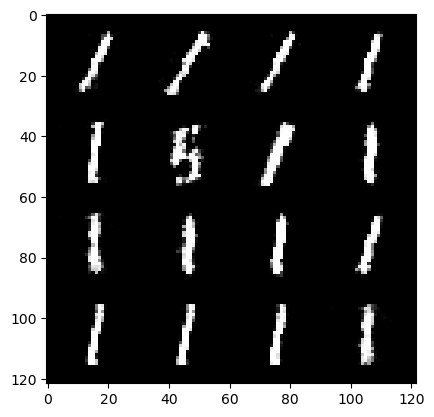

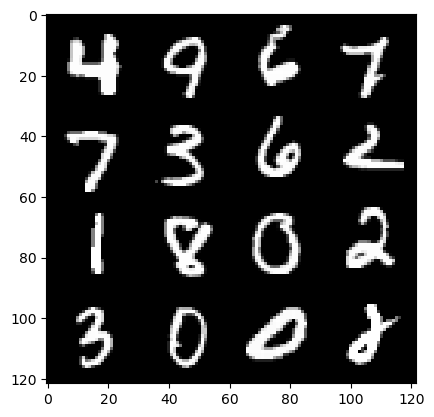

117: step 54900/ Gen loss: 2.65697120587031/ disc_loss: 0.18368876099586487


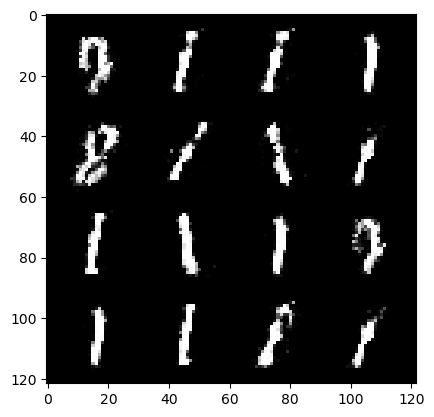

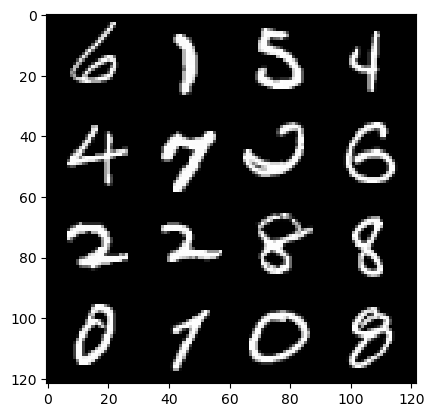

117: step 55200/ Gen loss: 2.440979272127153/ disc_loss: 0.20167993570367496


  0%|          | 0/469 [00:00<?, ?it/s]

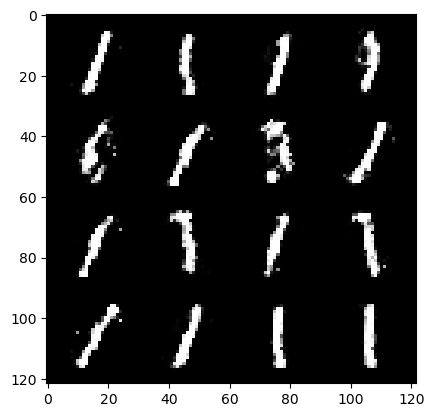

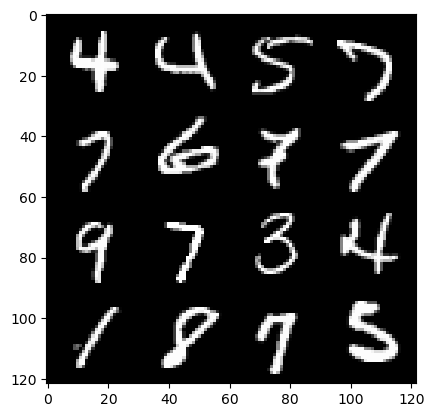

118: step 55500/ Gen loss: 2.5094275474548353/ disc_loss: 0.18961560746033992


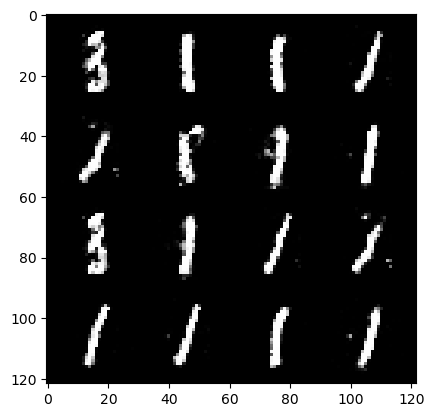

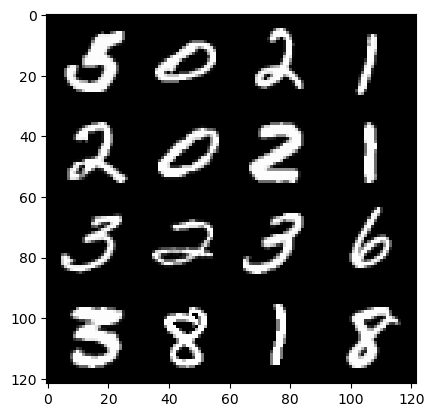

118: step 55800/ Gen loss: 2.5629925092061363/ disc_loss: 0.18349136799573892


  0%|          | 0/469 [00:00<?, ?it/s]

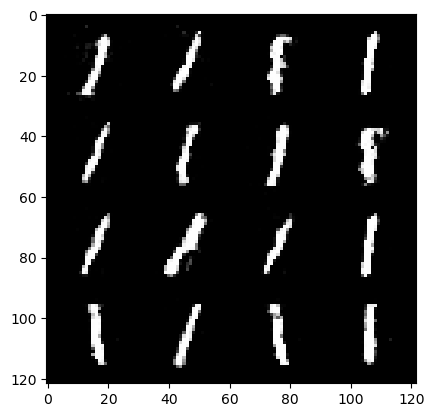

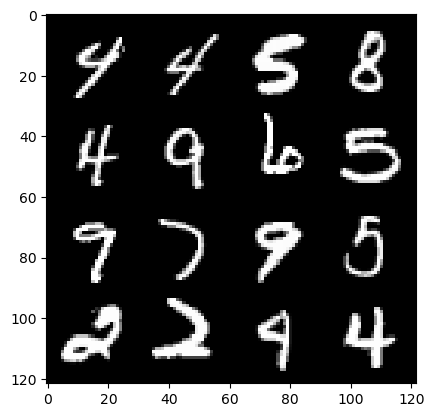

119: step 56100/ Gen loss: 2.623287688891093/ disc_loss: 0.16592921763658522


  0%|          | 0/469 [00:00<?, ?it/s]

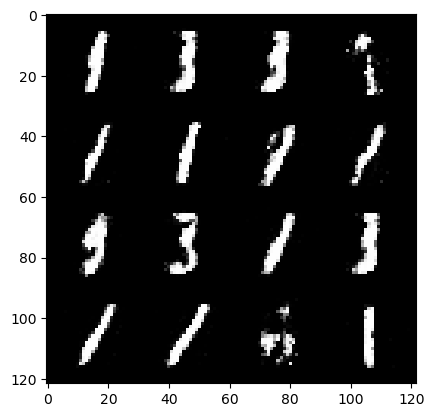

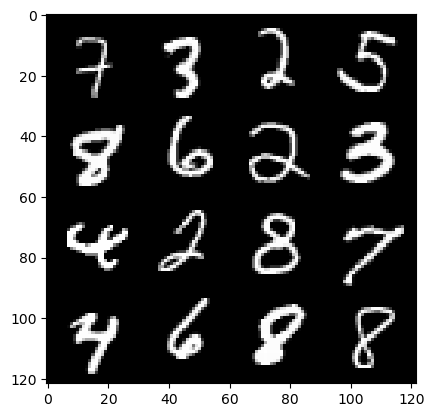

120: step 56400/ Gen loss: 2.5984642020861317/ disc_loss: 0.1831050161520641


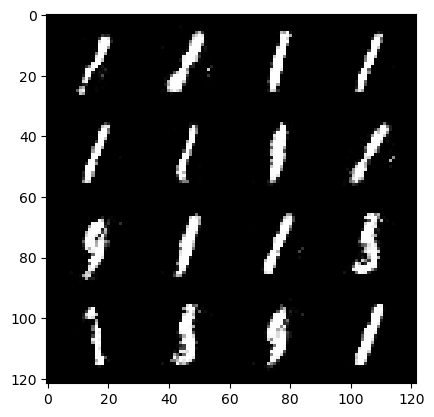

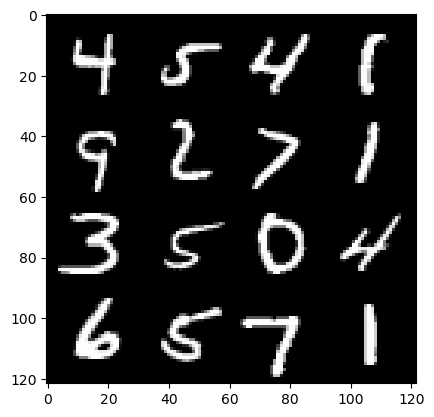

120: step 56700/ Gen loss: 2.4432831931114194/ disc_loss: 0.1857206807782253


  0%|          | 0/469 [00:00<?, ?it/s]

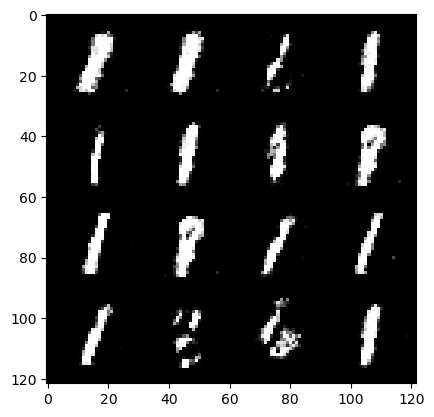

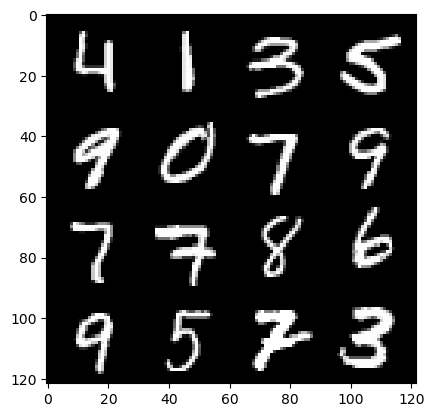

121: step 57000/ Gen loss: 2.4965065431594855/ disc_loss: 0.1885888963689407


  0%|          | 0/469 [00:00<?, ?it/s]

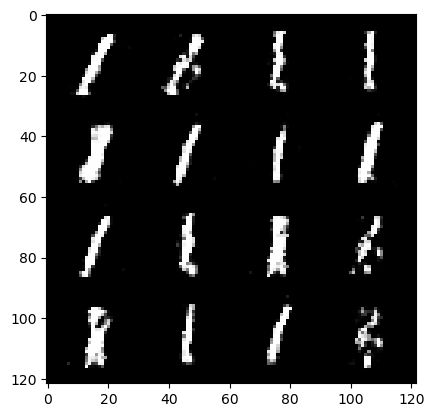

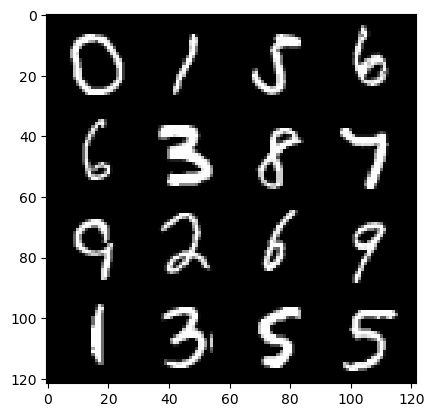

122: step 57300/ Gen loss: 2.517152547041574/ disc_loss: 0.18617588296532614


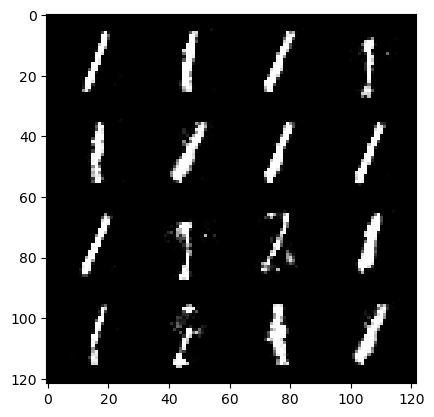

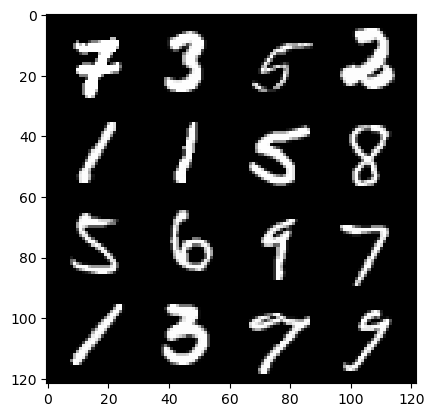

122: step 57600/ Gen loss: 2.441572081247965/ disc_loss: 0.19331001482903956


  0%|          | 0/469 [00:00<?, ?it/s]

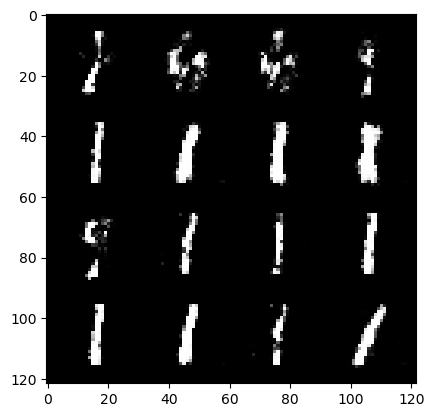

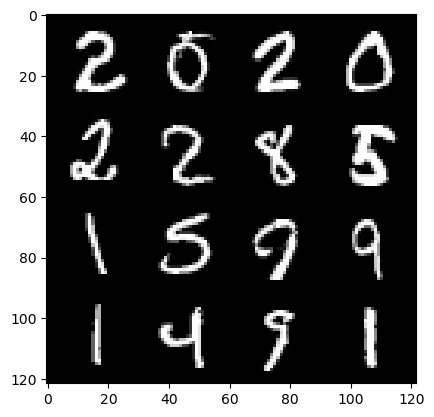

123: step 57900/ Gen loss: 2.4849774066607164/ disc_loss: 0.18022250448664043


  0%|          | 0/469 [00:00<?, ?it/s]

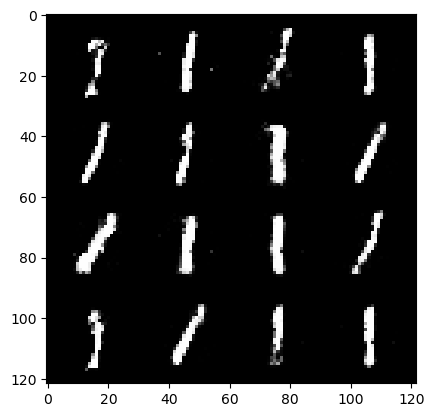

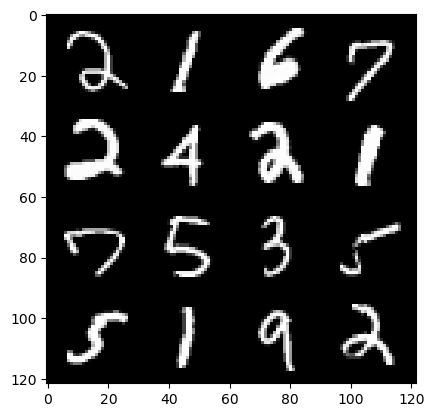

124: step 58200/ Gen loss: 2.5177395304044095/ disc_loss: 0.16467709342638648


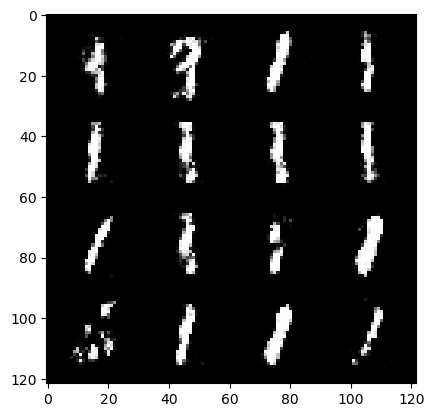

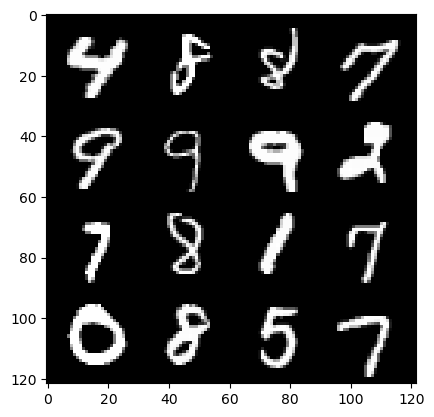

124: step 58500/ Gen loss: 2.6546684630711863/ disc_loss: 0.1780690516283114


  0%|          | 0/469 [00:00<?, ?it/s]

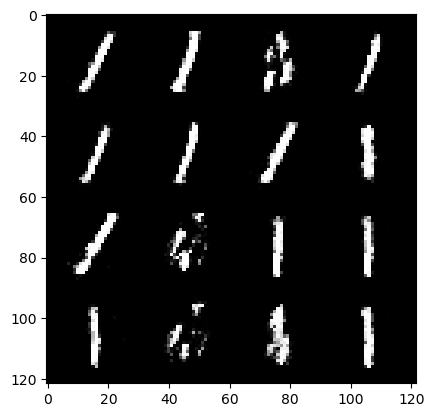

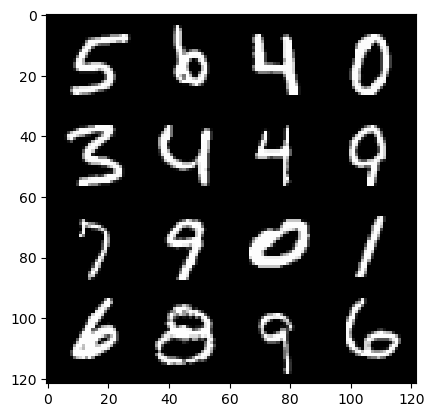

125: step 58800/ Gen loss: 2.526214454174041/ disc_loss: 0.18289096054931495


  0%|          | 0/469 [00:00<?, ?it/s]

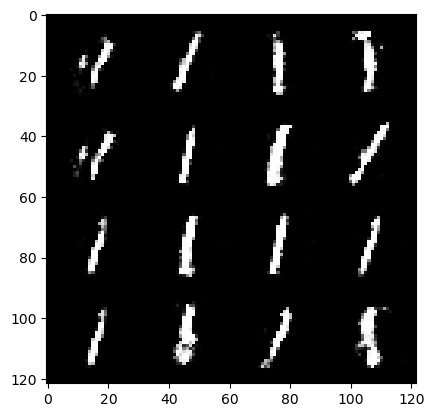

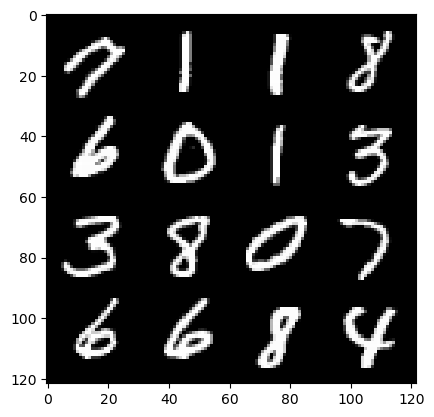

126: step 59100/ Gen loss: 2.4977250130971274/ disc_loss: 0.19039769525329264


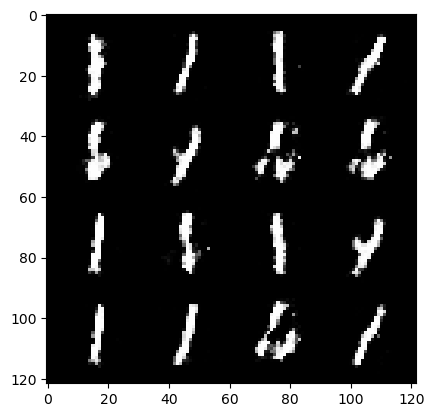

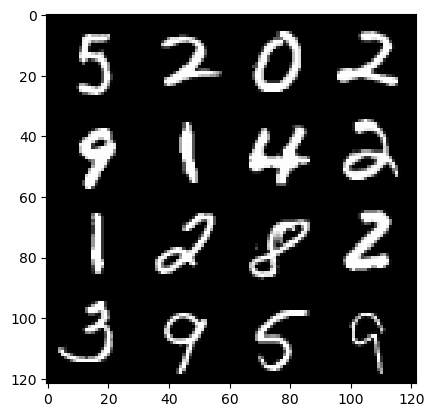

126: step 59400/ Gen loss: 2.4357677543163283/ disc_loss: 0.1902752978603045


  0%|          | 0/469 [00:00<?, ?it/s]

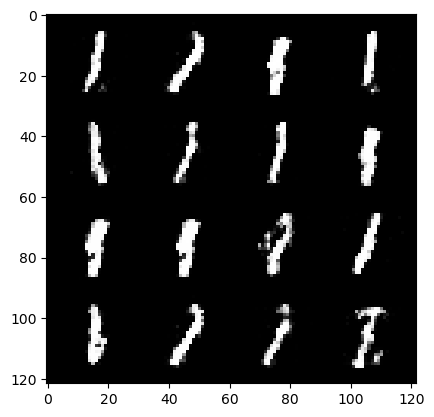

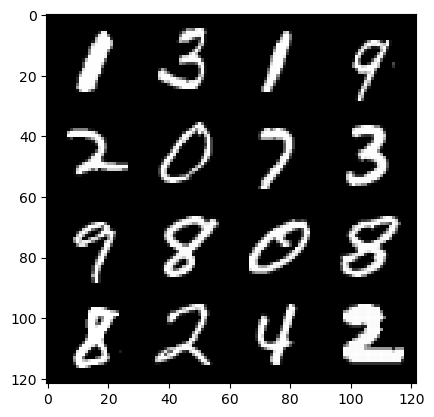

127: step 59700/ Gen loss: 2.5768200882275902/ disc_loss: 0.1842969255397717


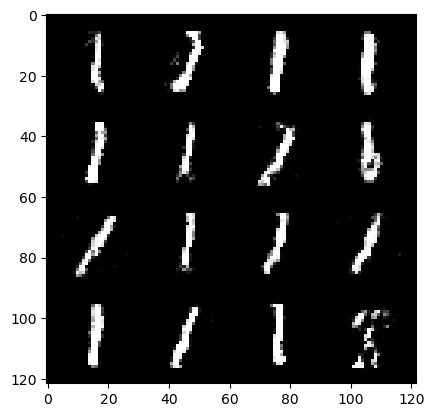

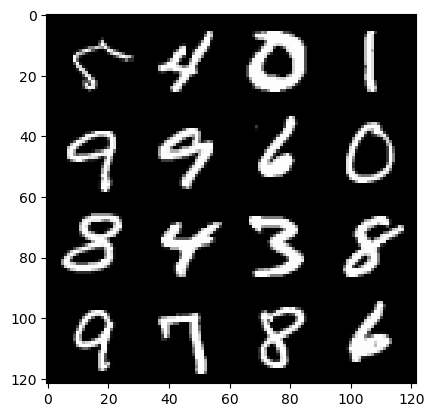

127: step 60000/ Gen loss: 2.56005220333735/ disc_loss: 0.1849167492737373


  0%|          | 0/469 [00:00<?, ?it/s]

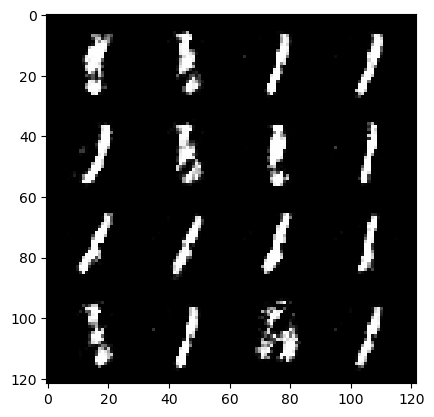

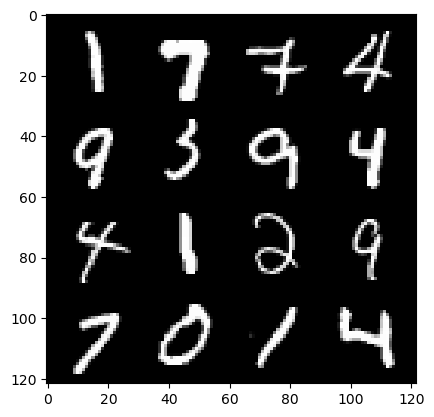

128: step 60300/ Gen loss: 2.5364084227879844/ disc_loss: 0.17628163543840242


  0%|          | 0/469 [00:00<?, ?it/s]

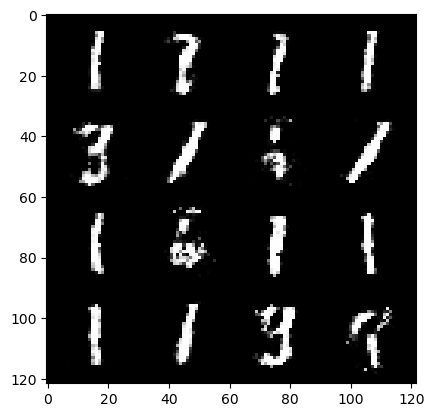

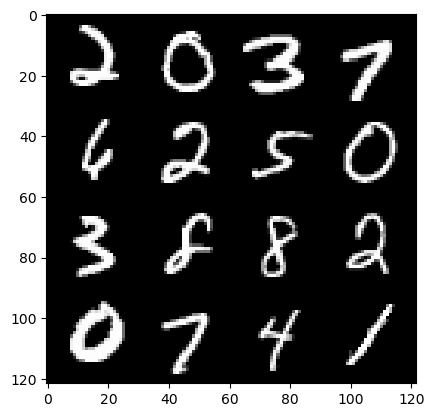

129: step 60600/ Gen loss: 2.6283520134290073/ disc_loss: 0.17222977042198184


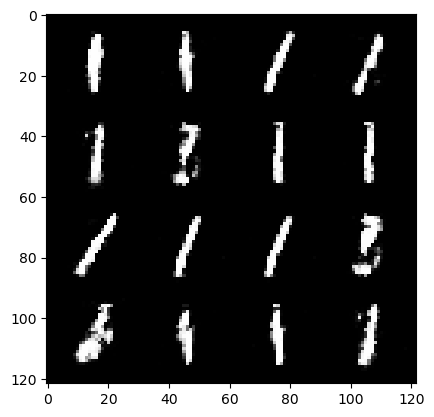

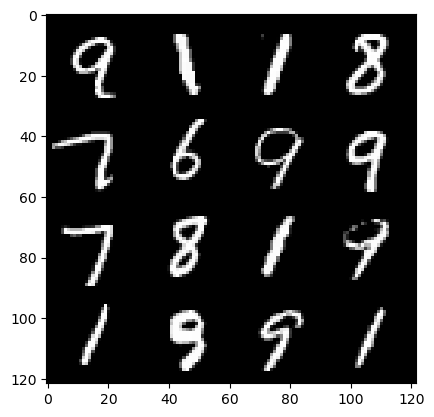

129: step 60900/ Gen loss: 2.608626518249509/ disc_loss: 0.17189402066171167


  0%|          | 0/469 [00:00<?, ?it/s]

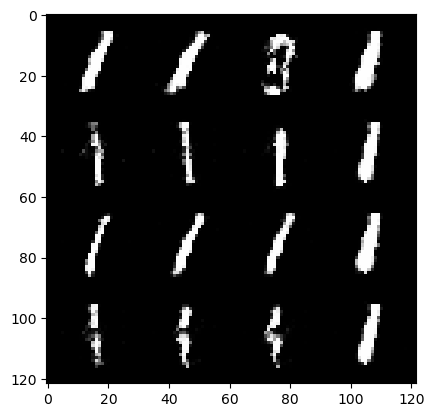

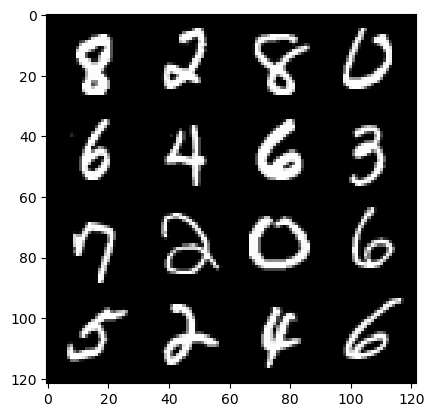

130: step 61200/ Gen loss: 2.4954717508951836/ disc_loss: 0.18531209784249483


  0%|          | 0/469 [00:00<?, ?it/s]

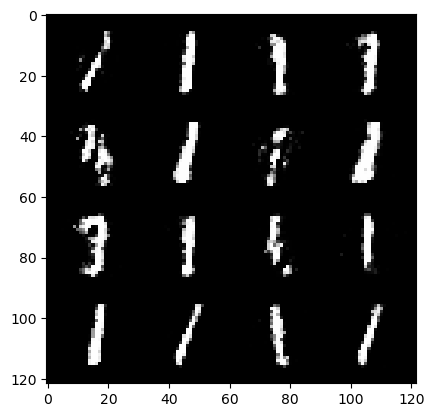

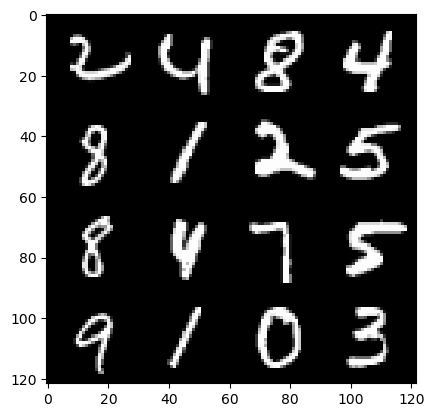

131: step 61500/ Gen loss: 2.466059776941936/ disc_loss: 0.1902175041039784


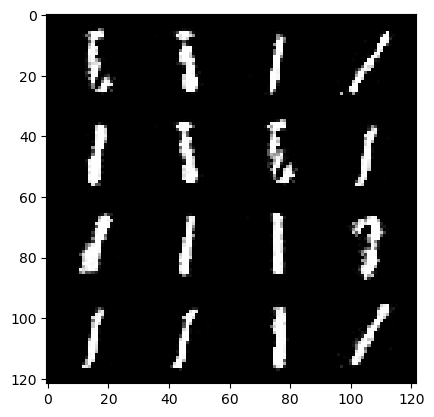

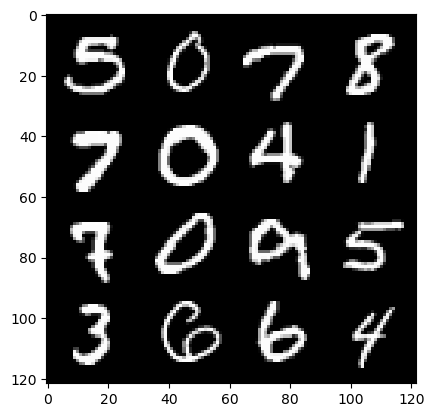

131: step 61800/ Gen loss: 2.4064506705602002/ disc_loss: 0.1963555185000101


  0%|          | 0/469 [00:00<?, ?it/s]

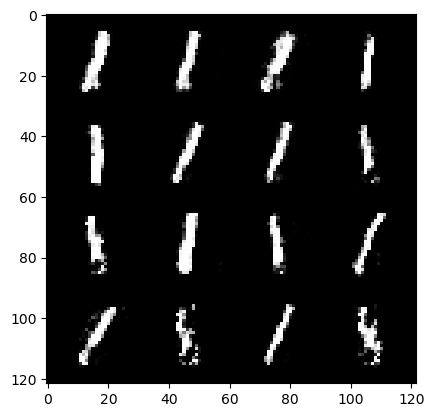

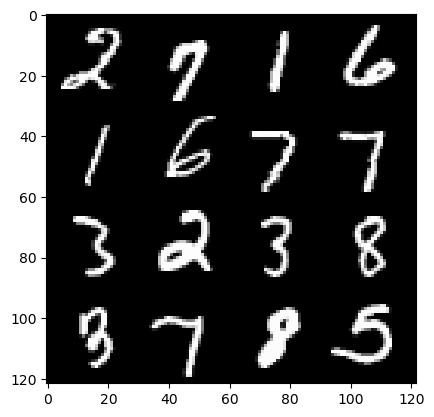

132: step 62100/ Gen loss: 2.458837976455688/ disc_loss: 0.18082781501114376


  0%|          | 0/469 [00:00<?, ?it/s]

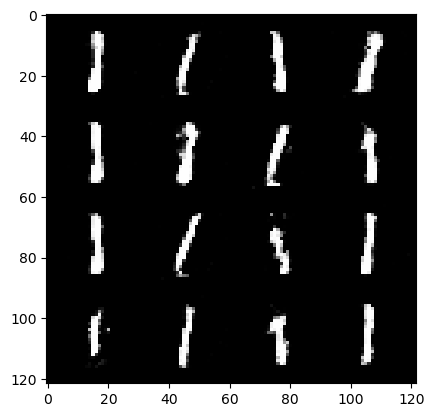

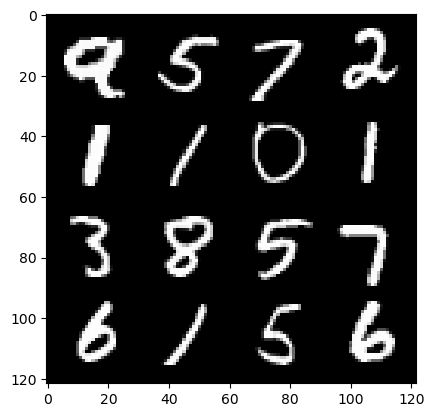

133: step 62400/ Gen loss: 2.486074747244515/ disc_loss: 0.17206376021107037


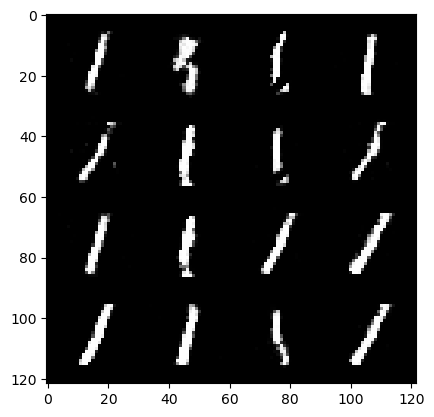

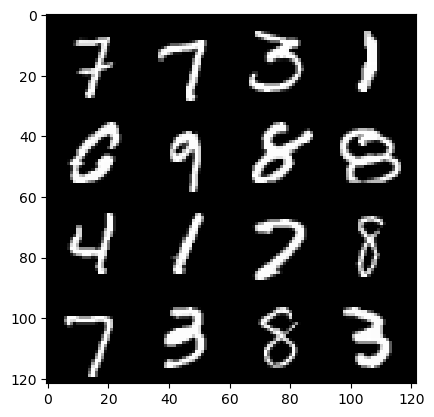

133: step 62700/ Gen loss: 2.530023053487141/ disc_loss: 0.17448933437466635


  0%|          | 0/469 [00:00<?, ?it/s]

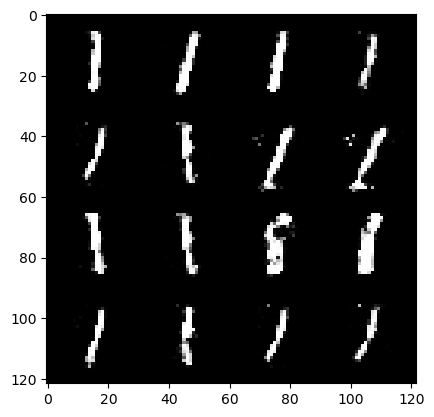

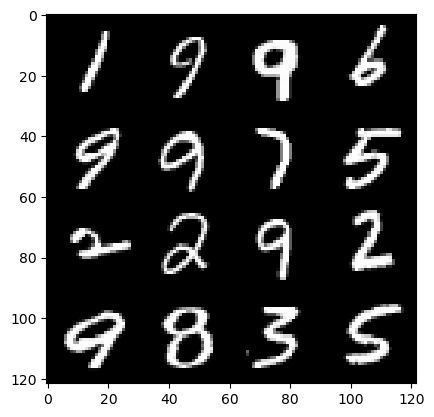

134: step 63000/ Gen loss: 2.489618857701618/ disc_loss: 0.1807719175517558


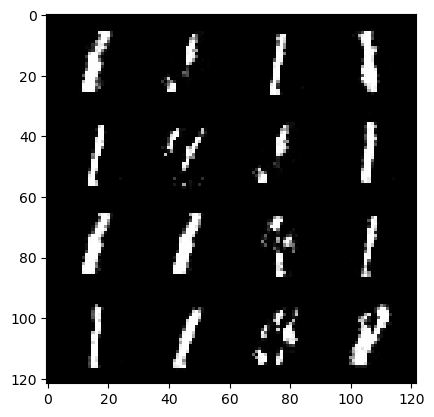

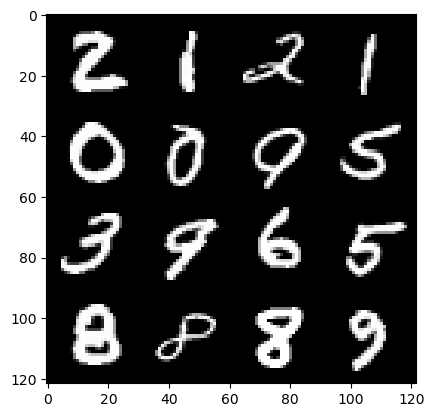

134: step 63300/ Gen loss: 2.6574556430180873/ disc_loss: 0.17558643529812493


  0%|          | 0/469 [00:00<?, ?it/s]

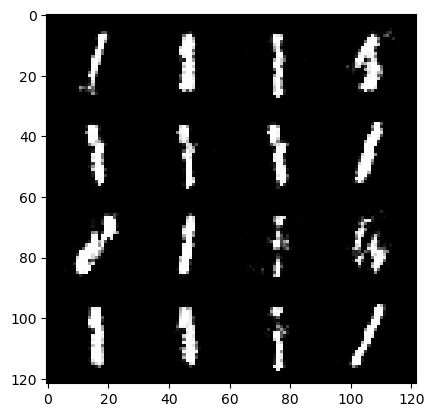

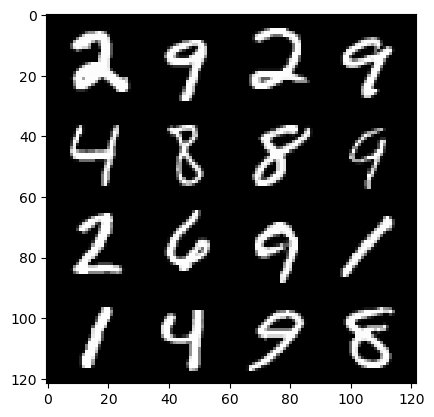

135: step 63600/ Gen loss: 2.4670828437805175/ disc_loss: 0.19015655184785543


  0%|          | 0/469 [00:00<?, ?it/s]

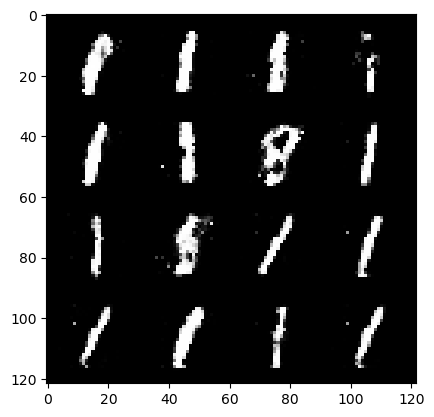

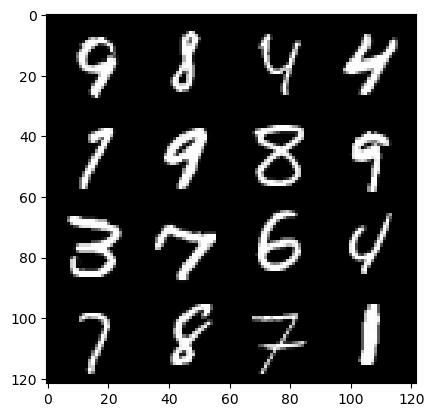

136: step 63900/ Gen loss: 2.4294694113731383/ disc_loss: 0.19397338976462689


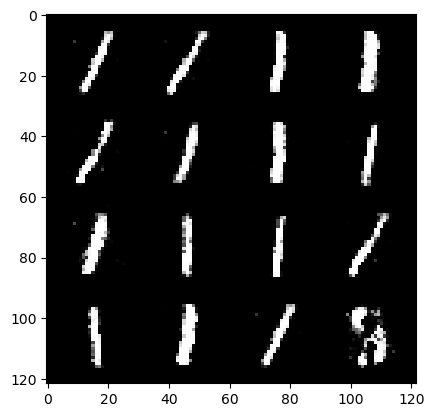

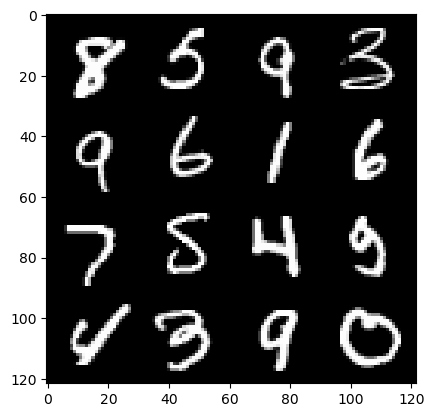

136: step 64200/ Gen loss: 2.5142177955309535/ disc_loss: 0.17835732532044252


  0%|          | 0/469 [00:00<?, ?it/s]

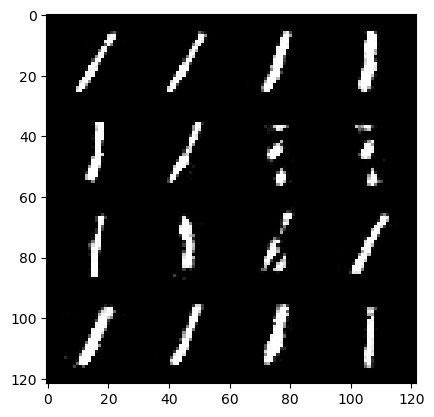

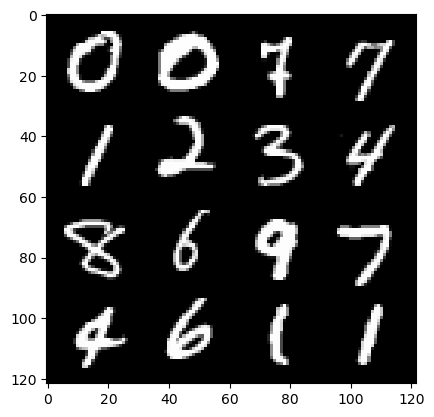

137: step 64500/ Gen loss: 2.356375686327616/ disc_loss: 0.20027409620583034


  0%|          | 0/469 [00:00<?, ?it/s]

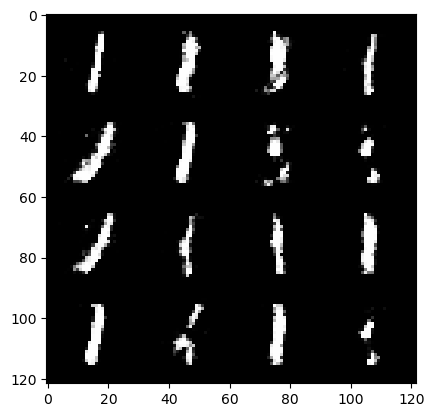

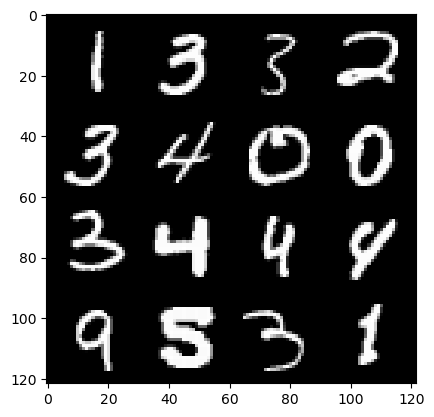

138: step 64800/ Gen loss: 2.4041566165288257/ disc_loss: 0.19352283085385955


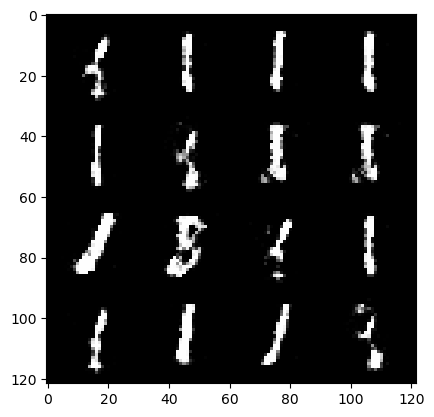

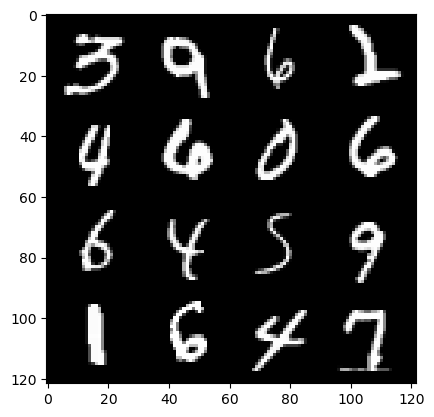

138: step 65100/ Gen loss: 2.472839660644531/ disc_loss: 0.17770029895007605


  0%|          | 0/469 [00:00<?, ?it/s]

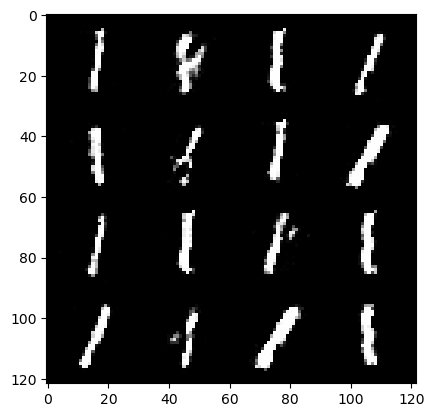

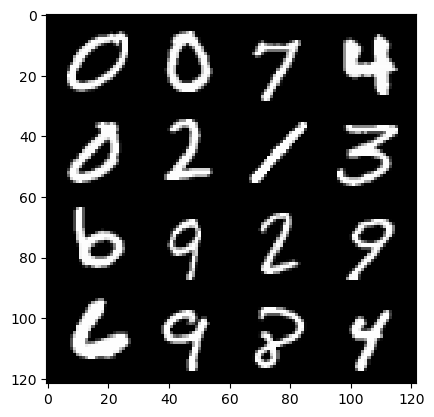

139: step 65400/ Gen loss: 2.383739514350893/ disc_loss: 0.20389526682595405


  0%|          | 0/469 [00:00<?, ?it/s]

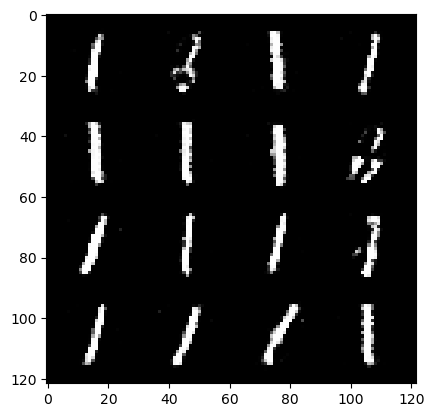

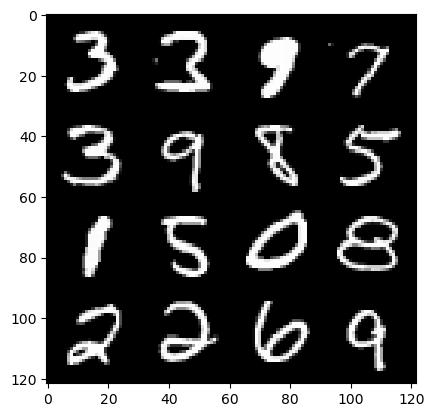

140: step 65700/ Gen loss: 2.417457079887388/ disc_loss: 0.19552857160568246


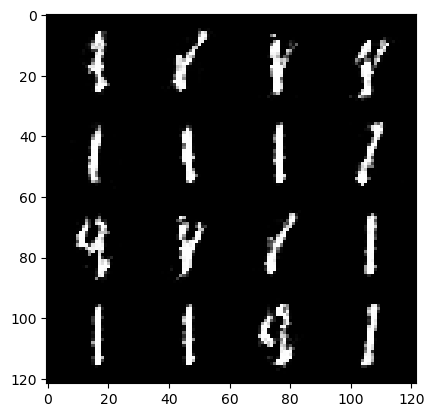

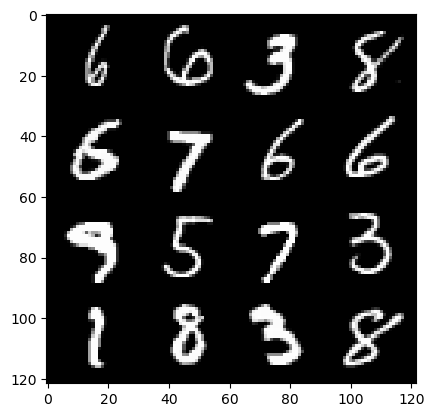

140: step 66000/ Gen loss: 2.3793516437212623/ disc_loss: 0.1992486806710561


  0%|          | 0/469 [00:00<?, ?it/s]

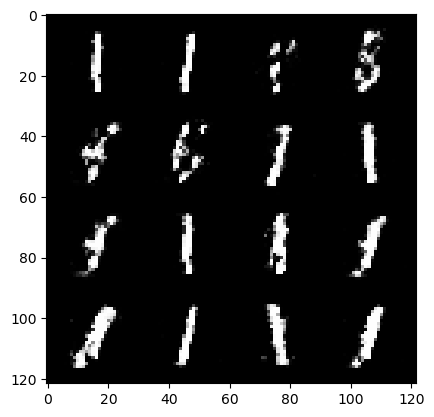

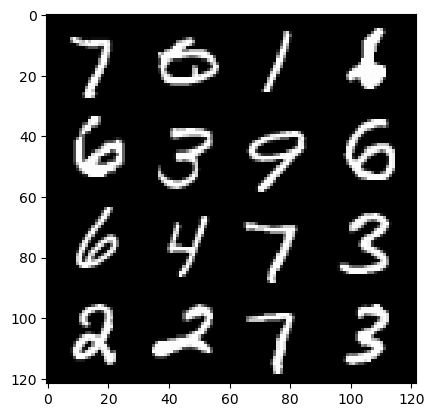

141: step 66300/ Gen loss: 2.4046327384312933/ disc_loss: 0.1959229062000911


  0%|          | 0/469 [00:00<?, ?it/s]

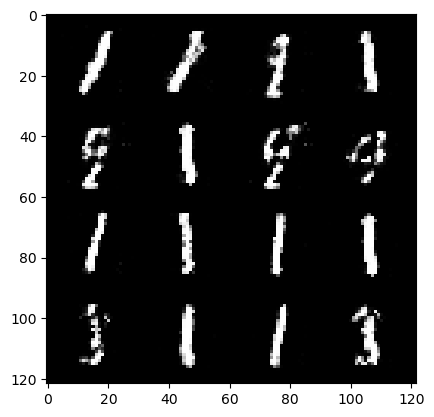

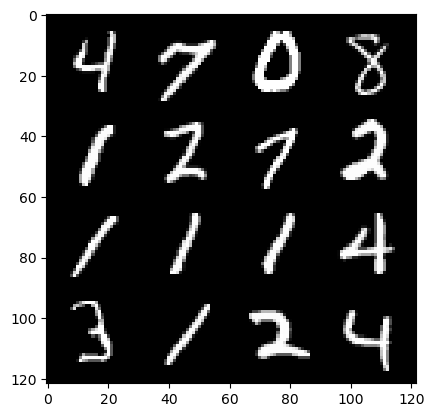

142: step 66600/ Gen loss: 2.4080101847648643/ disc_loss: 0.2085304928322634


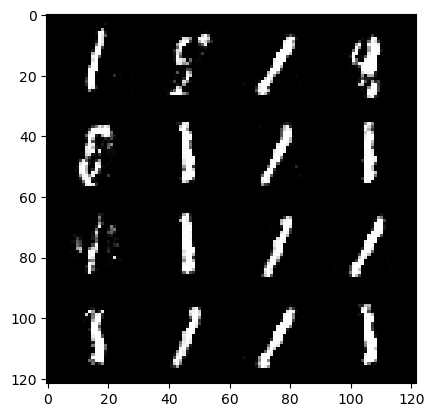

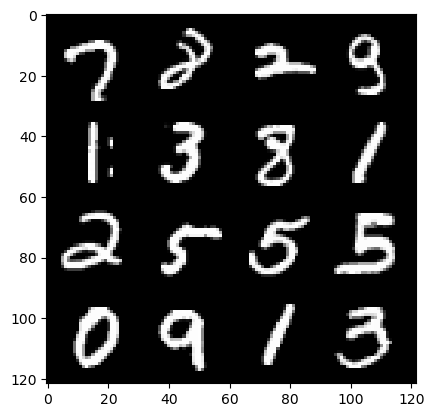

142: step 66900/ Gen loss: 2.2363878770669294/ disc_loss: 0.2200970641275247


  0%|          | 0/469 [00:00<?, ?it/s]

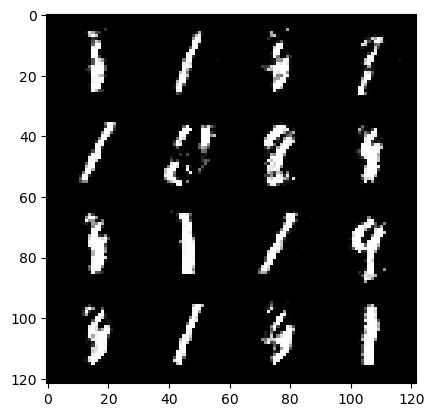

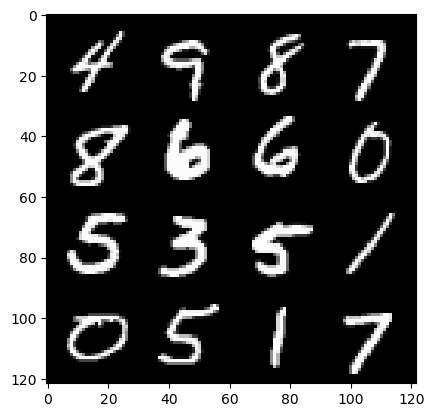

143: step 67200/ Gen loss: 2.288492726882298/ disc_loss: 0.21829641446471235


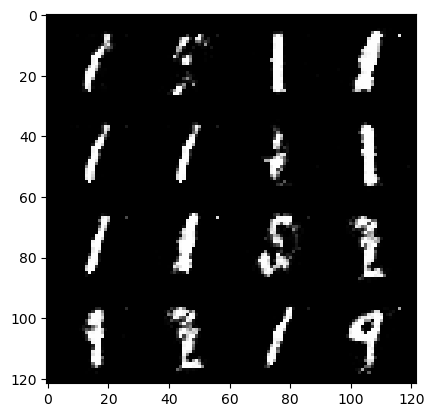

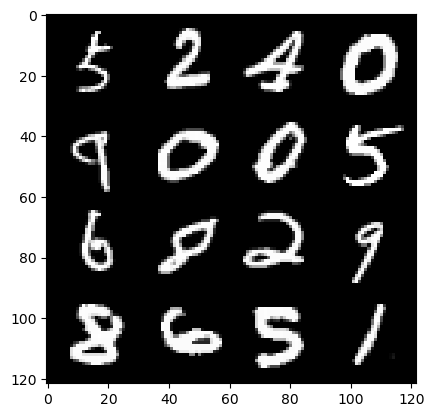

143: step 67500/ Gen loss: 2.240044894218447/ disc_loss: 0.23011178861061715


  0%|          | 0/469 [00:00<?, ?it/s]

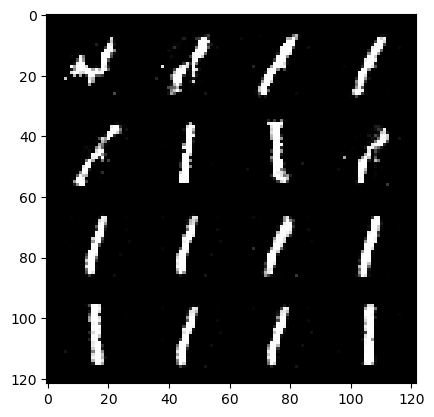

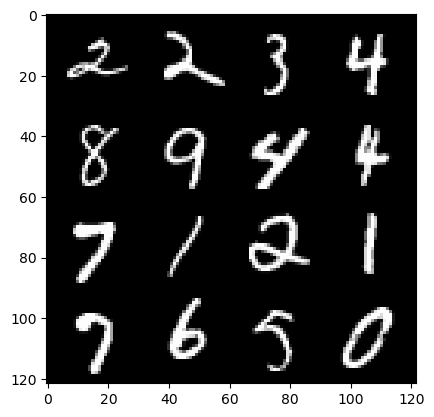

144: step 67800/ Gen loss: 2.329531218210857/ disc_loss: 0.19602012492716317


  0%|          | 0/469 [00:00<?, ?it/s]

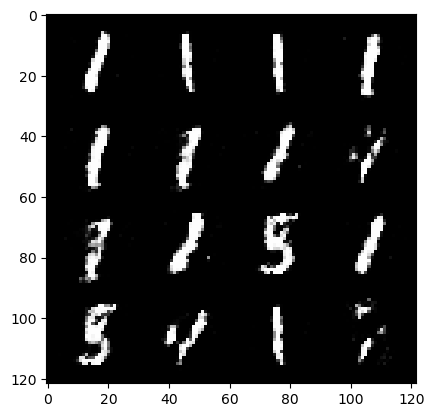

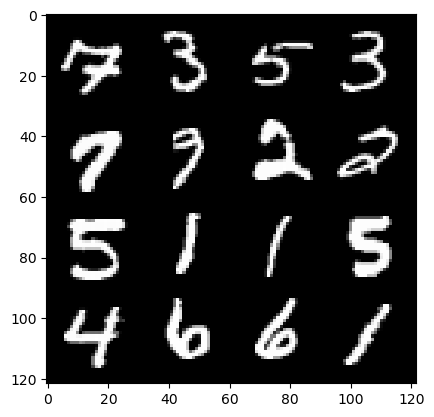

145: step 68100/ Gen loss: 2.399046349525451/ disc_loss: 0.2112037478139003


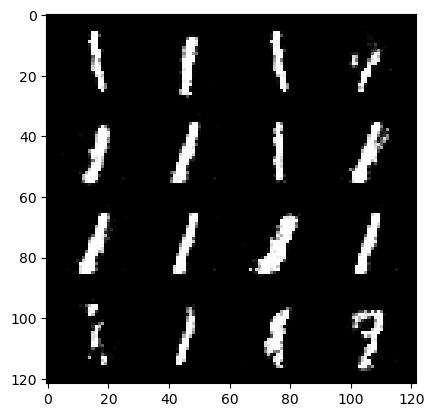

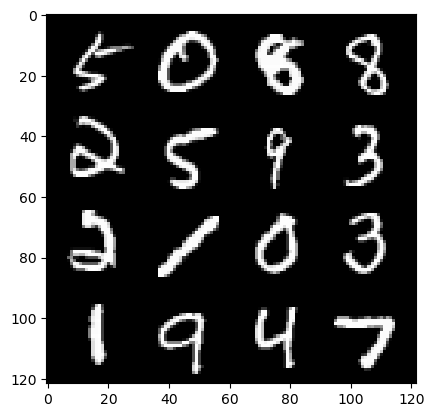

145: step 68400/ Gen loss: 2.369611553351082/ disc_loss: 0.2020628160238266


  0%|          | 0/469 [00:00<?, ?it/s]

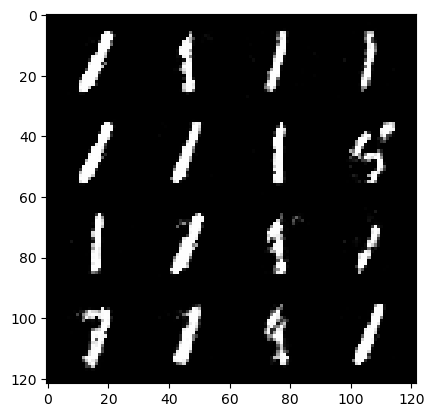

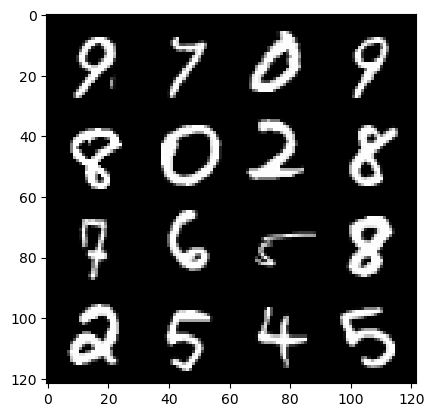

146: step 68700/ Gen loss: 2.4339831757545474/ disc_loss: 0.1868656667321921


  0%|          | 0/469 [00:00<?, ?it/s]

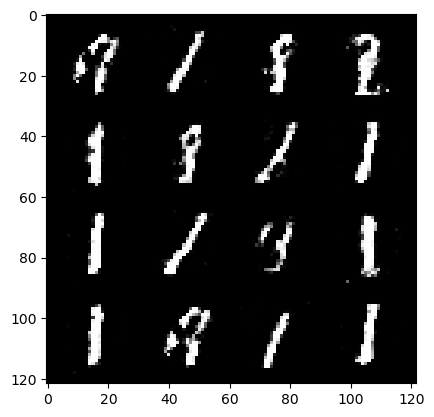

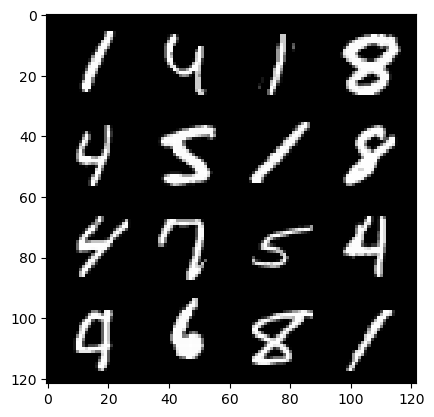

147: step 69000/ Gen loss: 2.410477497975033/ disc_loss: 0.20275061500569183


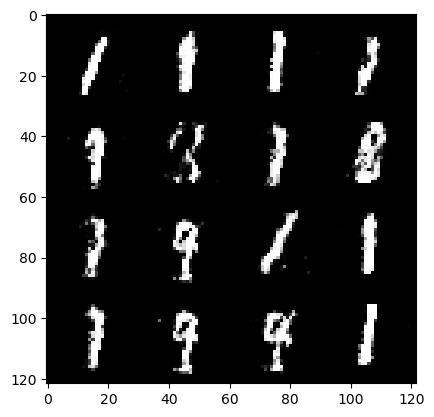

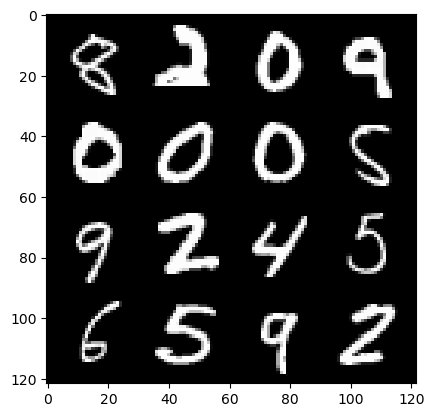

147: step 69300/ Gen loss: 2.411276463667552/ disc_loss: 0.20844887991746266


  0%|          | 0/469 [00:00<?, ?it/s]

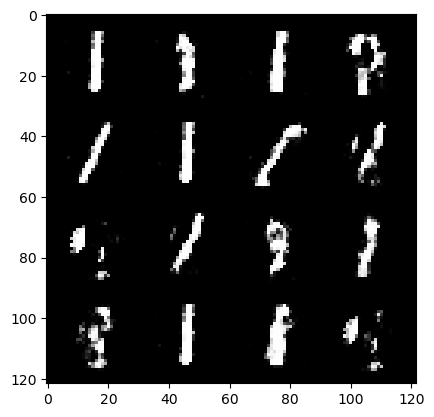

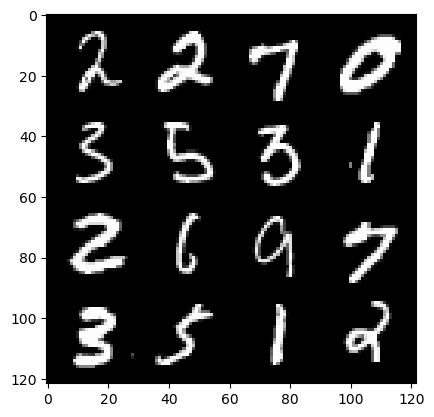

148: step 69600/ Gen loss: 2.412425707976025/ disc_loss: 0.19840850179394082


  0%|          | 0/469 [00:00<?, ?it/s]

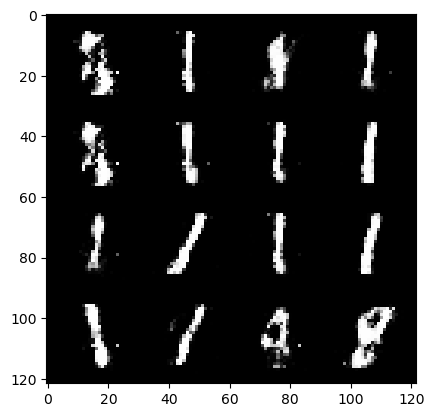

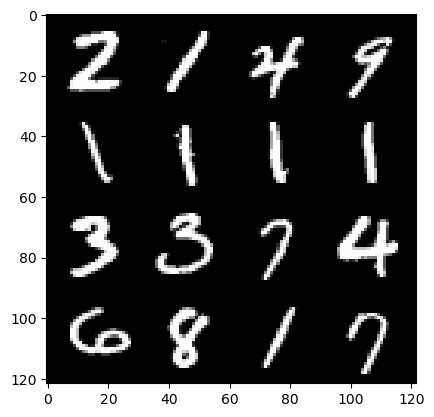

149: step 69900/ Gen loss: 2.344404082695644/ disc_loss: 0.2247566653291384


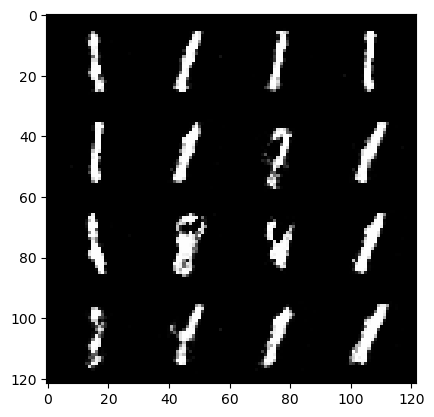

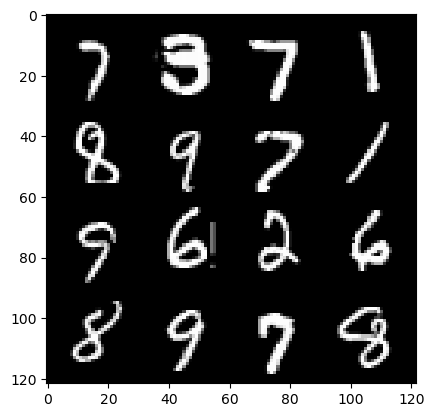

149: step 70200/ Gen loss: 2.187020217180251/ disc_loss: 0.23356918717424072


  0%|          | 0/469 [00:00<?, ?it/s]

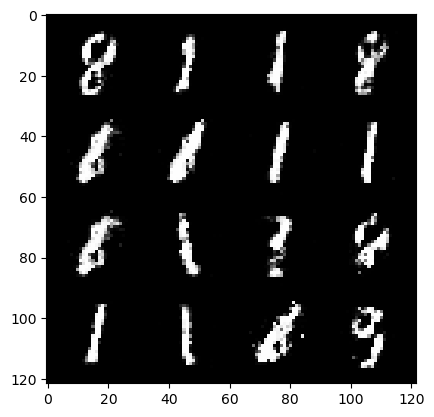

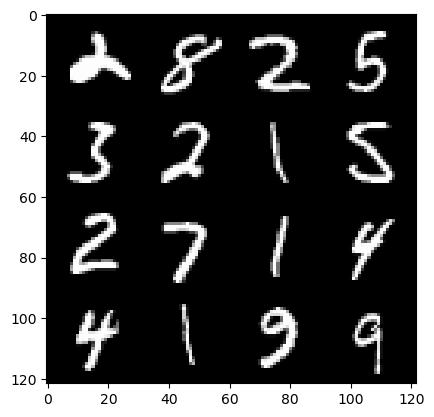

150: step 70500/ Gen loss: 2.1620568811893475/ disc_loss: 0.23111152000725274


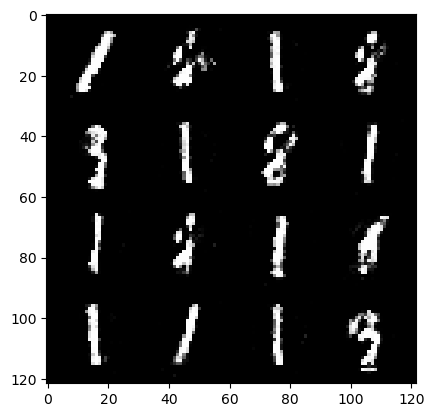

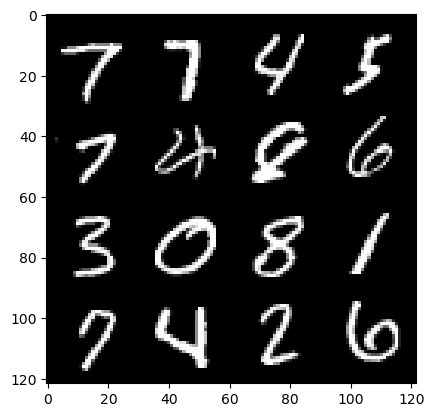

150: step 70800/ Gen loss: 2.2093807256221774/ disc_loss: 0.2281720423201721


  0%|          | 0/469 [00:00<?, ?it/s]

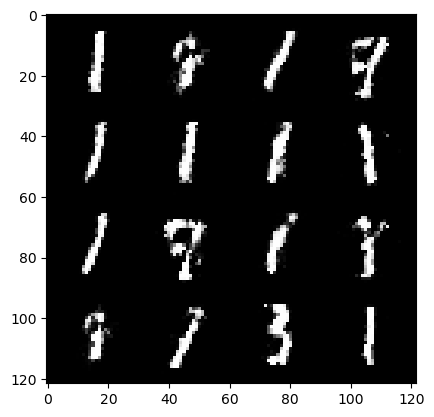

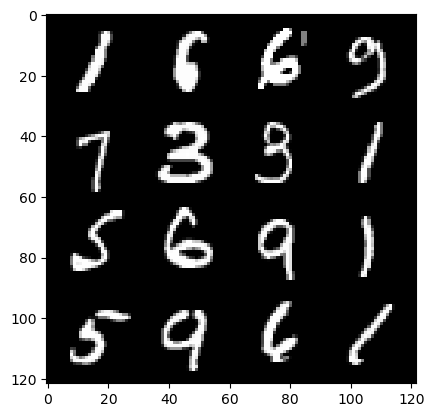

151: step 71100/ Gen loss: 2.2083495481808986/ disc_loss: 0.22107736671964334


  0%|          | 0/469 [00:00<?, ?it/s]

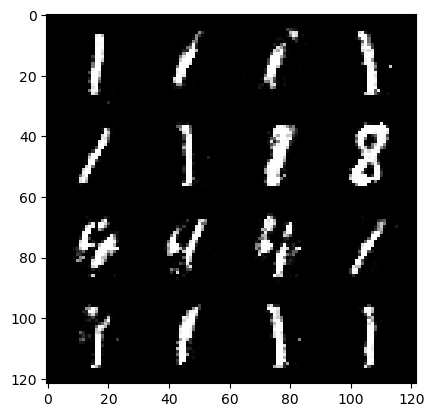

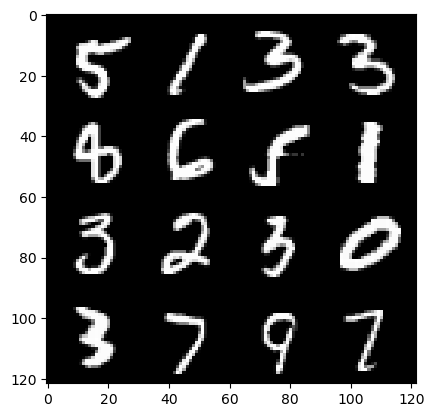

152: step 71400/ Gen loss: 2.143532841205596/ disc_loss: 0.2423976521690686


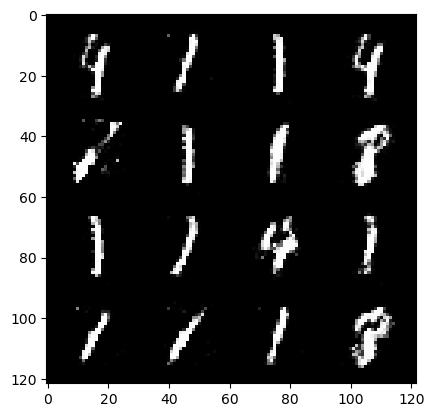

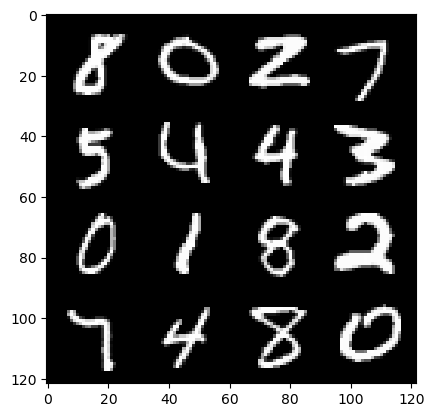

152: step 71700/ Gen loss: 2.0709598787625616/ disc_loss: 0.23696151733398446


  0%|          | 0/469 [00:00<?, ?it/s]

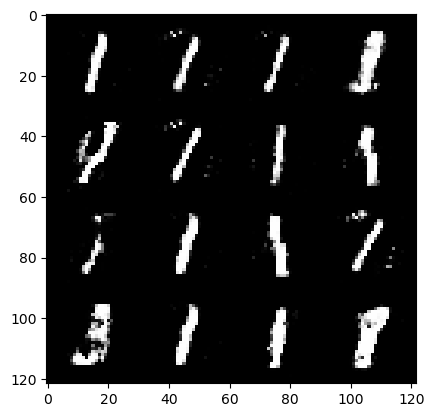

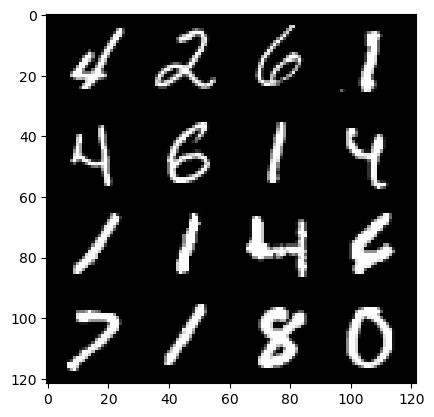

153: step 72000/ Gen loss: 2.189498119354247/ disc_loss: 0.22734142887095604


  0%|          | 0/469 [00:00<?, ?it/s]

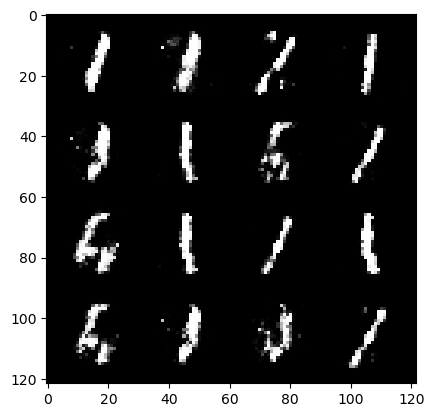

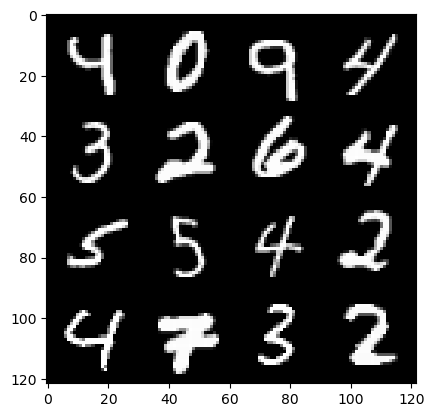

154: step 72300/ Gen loss: 2.203973430792491/ disc_loss: 0.21572644442319888


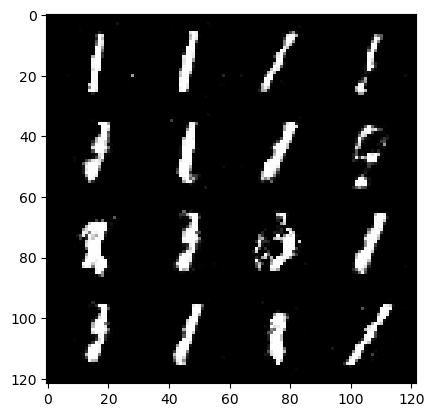

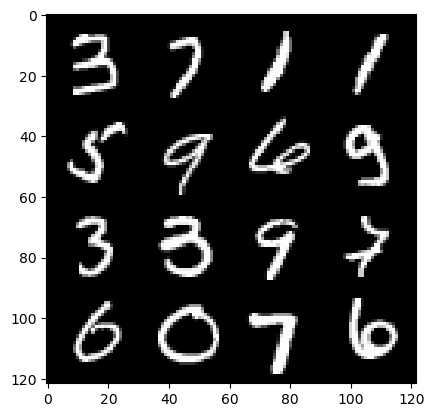

154: step 72600/ Gen loss: 2.271802646716435/ disc_loss: 0.20404469879964987


  0%|          | 0/469 [00:00<?, ?it/s]

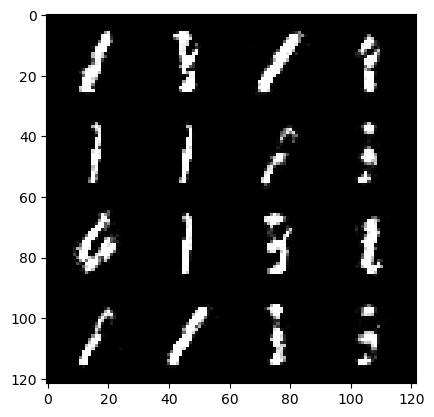

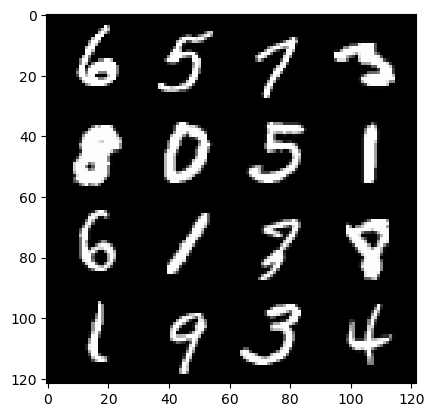

155: step 72900/ Gen loss: 2.2030878889560674/ disc_loss: 0.23064856586356963


  0%|          | 0/469 [00:00<?, ?it/s]

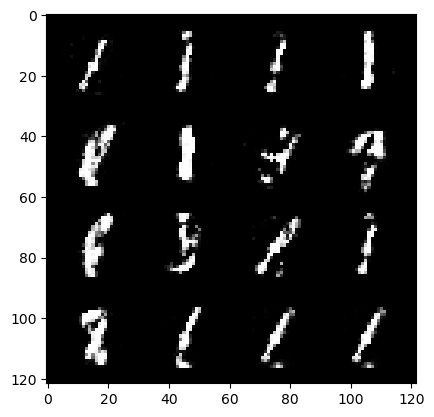

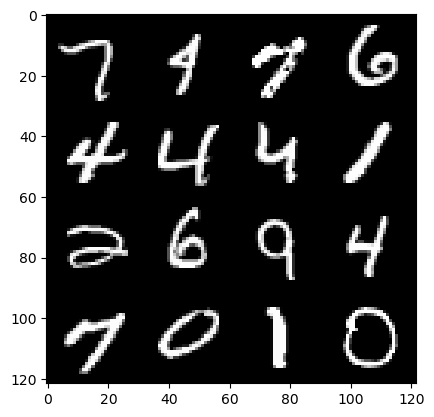

156: step 73200/ Gen loss: 2.209616624911626/ disc_loss: 0.2203970852742594


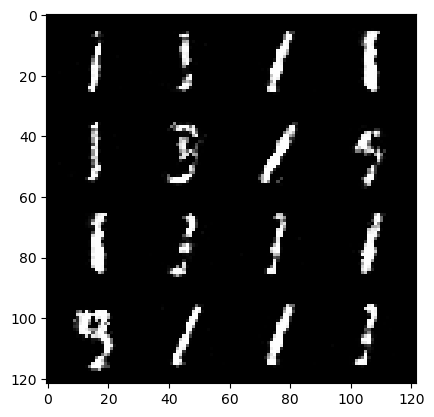

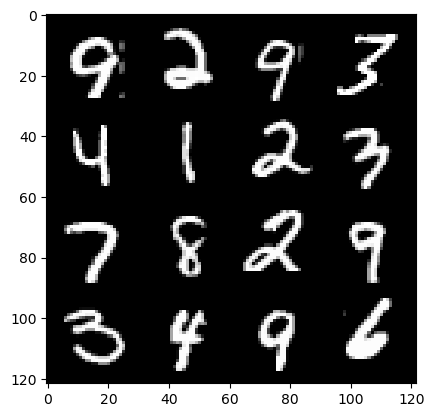

156: step 73500/ Gen loss: 2.2702272597948694/ disc_loss: 0.2080532840391001


  0%|          | 0/469 [00:00<?, ?it/s]

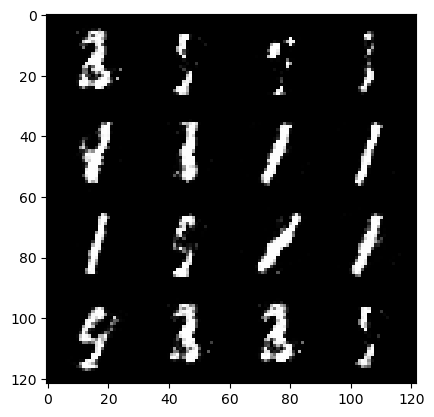

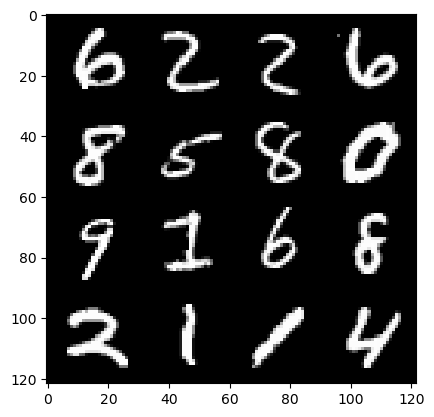

157: step 73800/ Gen loss: 2.2309546951452903/ disc_loss: 0.21689777622620265


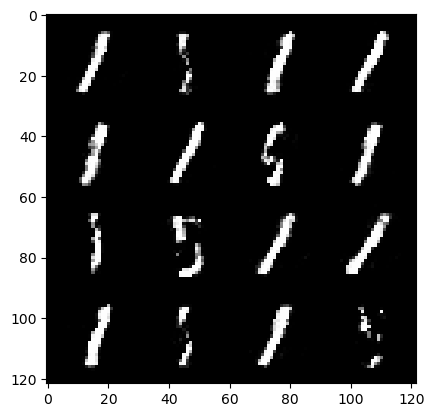

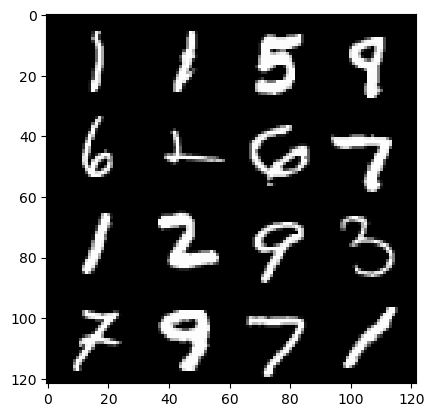

157: step 74100/ Gen loss: 2.2184566855430607/ disc_loss: 0.2161749742428462


  0%|          | 0/469 [00:00<?, ?it/s]

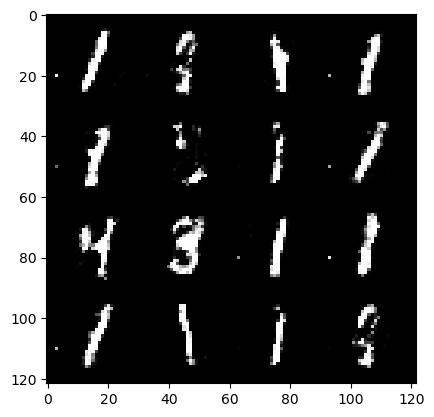

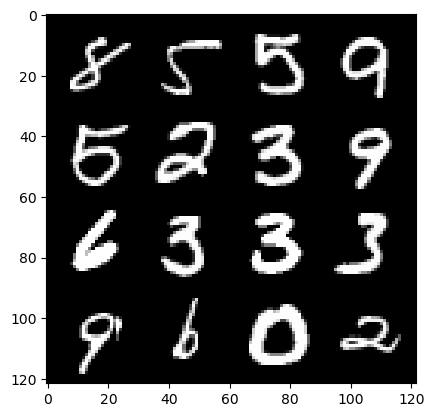

158: step 74400/ Gen loss: 2.1316760714848857/ disc_loss: 0.2389536905785401


  0%|          | 0/469 [00:00<?, ?it/s]

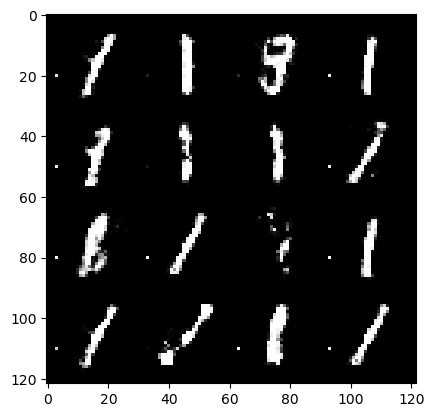

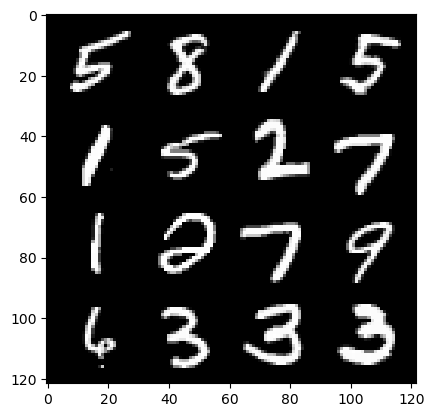

159: step 74700/ Gen loss: 1.9932249132792155/ disc_loss: 0.263173651943604


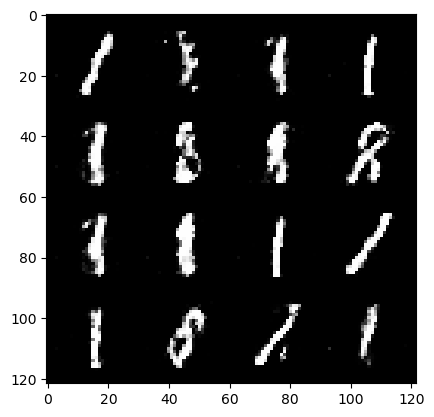

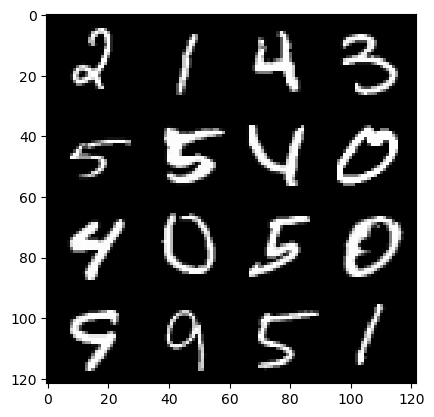

159: step 75000/ Gen loss: 2.199451763232549/ disc_loss: 0.22696187148491548


  0%|          | 0/469 [00:00<?, ?it/s]

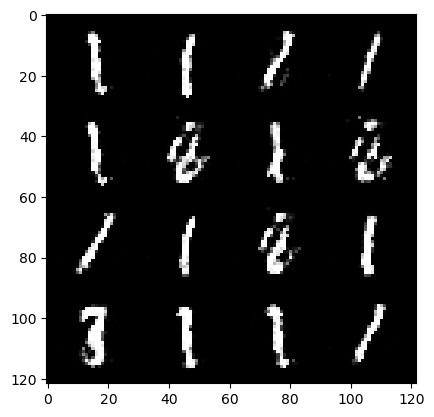

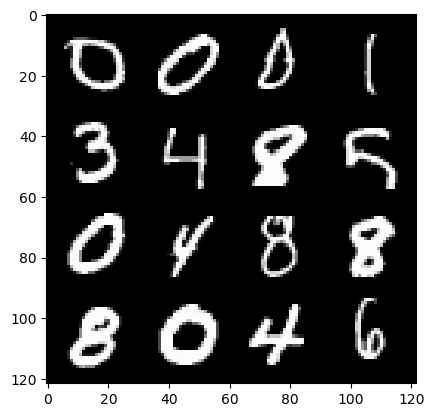

160: step 75300/ Gen loss: 2.1027907168865196/ disc_loss: 0.25117185150583576


  0%|          | 0/469 [00:00<?, ?it/s]

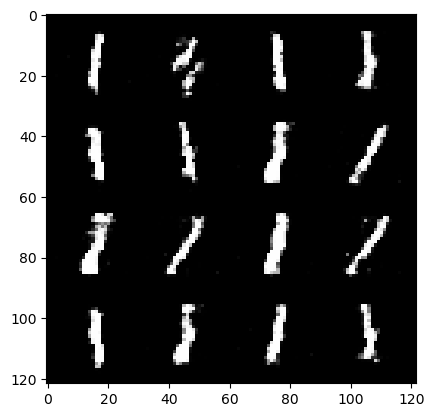

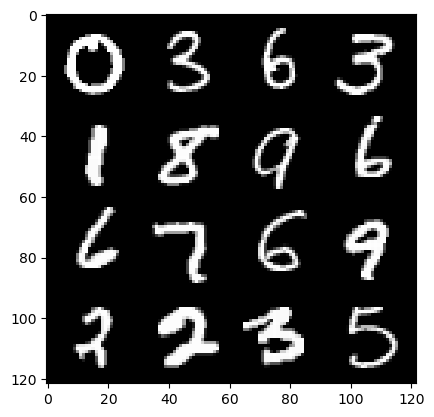

161: step 75600/ Gen loss: 2.1178305443127963/ disc_loss: 0.228620326668024


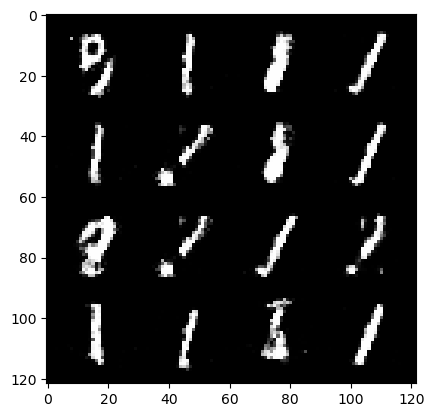

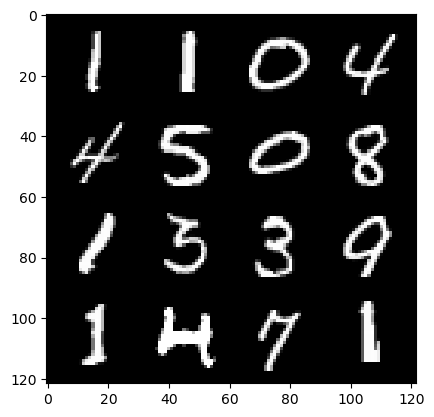

161: step 75900/ Gen loss: 2.099065972566605/ disc_loss: 0.2529536032676696


  0%|          | 0/469 [00:00<?, ?it/s]

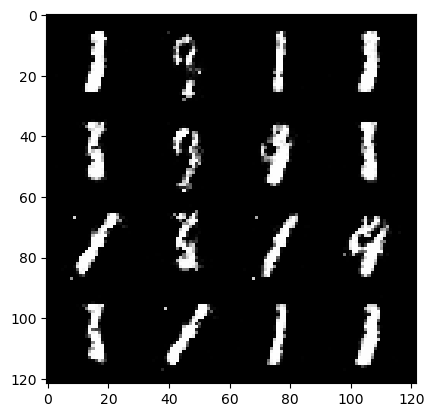

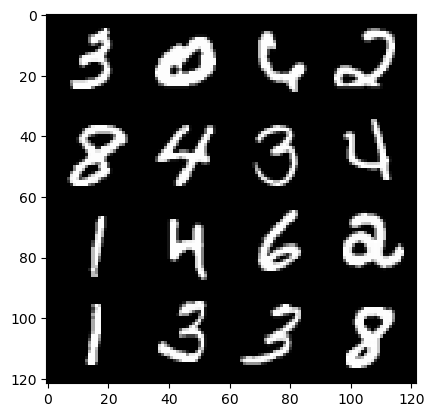

162: step 76200/ Gen loss: 2.087876120805741/ disc_loss: 0.24220573832591363


  0%|          | 0/469 [00:00<?, ?it/s]

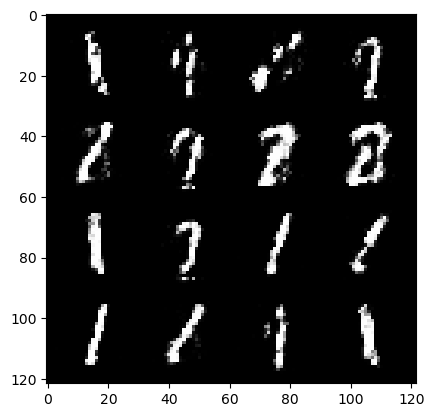

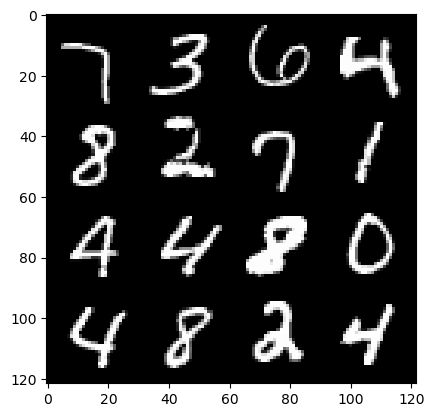

163: step 76500/ Gen loss: 2.0415585219860084/ disc_loss: 0.25616657242178903


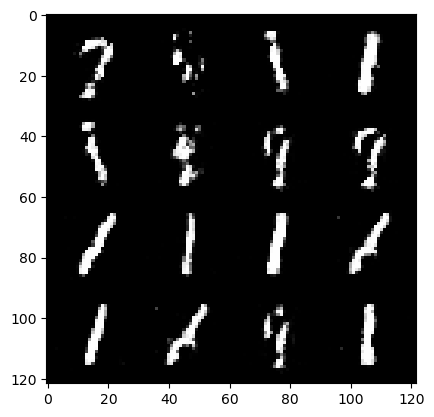

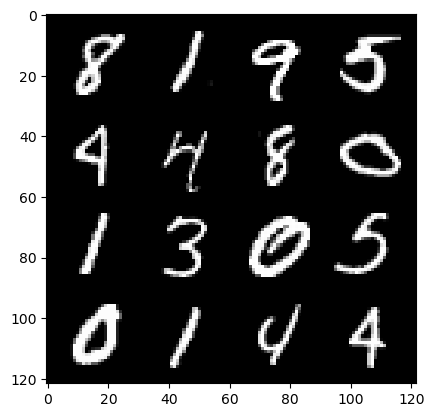

163: step 76800/ Gen loss: 2.175812387863794/ disc_loss: 0.22761790732542678


  0%|          | 0/469 [00:00<?, ?it/s]

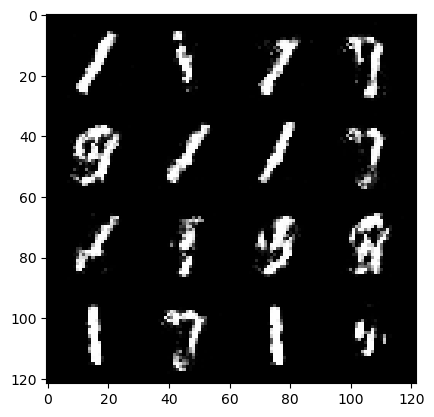

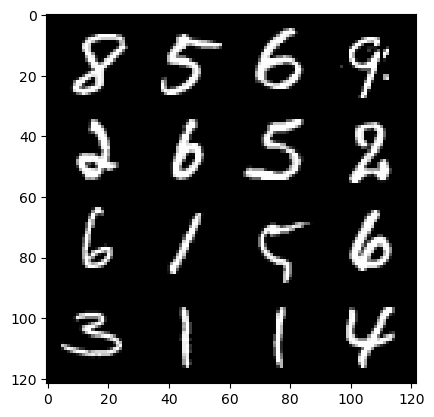

164: step 77100/ Gen loss: 2.0976438792546603/ disc_loss: 0.23494442547361055


  0%|          | 0/469 [00:00<?, ?it/s]

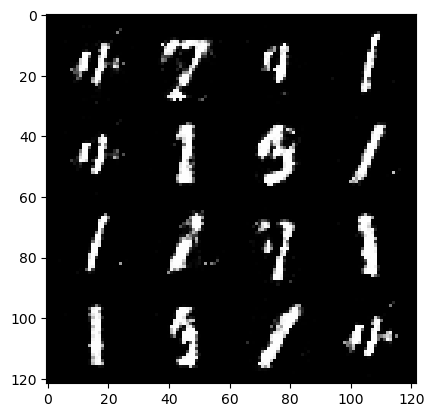

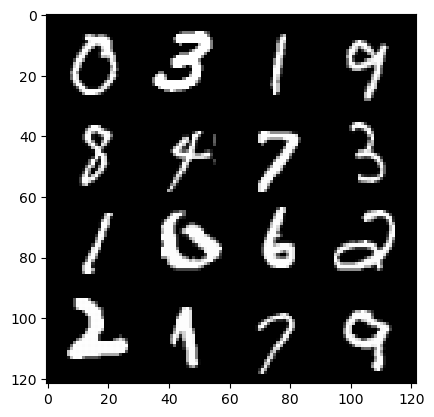

165: step 77400/ Gen loss: 2.0953825843334184/ disc_loss: 0.2540931318203607


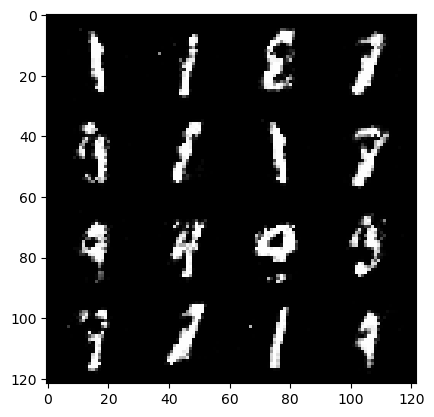

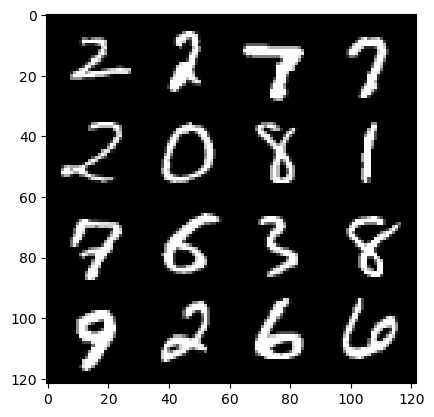

165: step 77700/ Gen loss: 2.1329797029495228/ disc_loss: 0.24258887752890587


  0%|          | 0/469 [00:00<?, ?it/s]

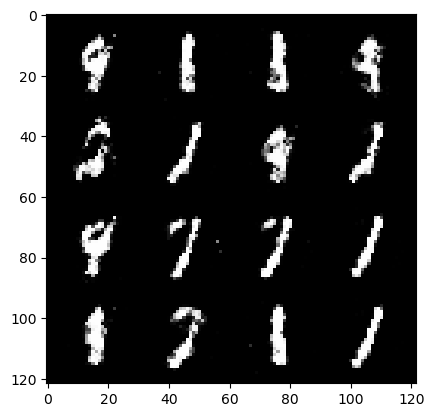

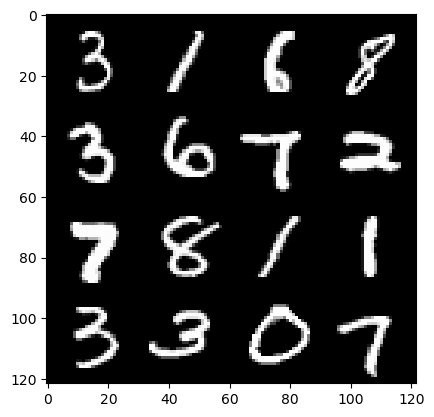

166: step 78000/ Gen loss: 2.061247131427132/ disc_loss: 0.26537111769119887


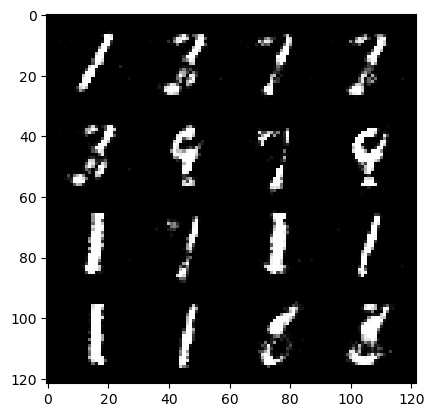

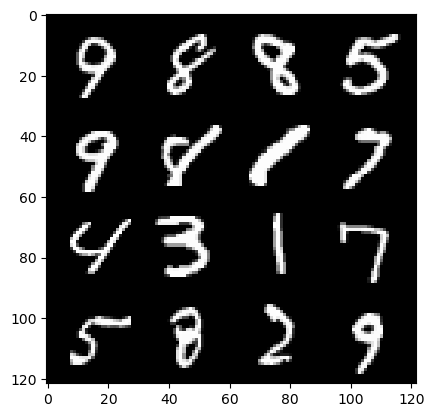

166: step 78300/ Gen loss: 2.0851353689034777/ disc_loss: 0.25291288003325463


  0%|          | 0/469 [00:00<?, ?it/s]

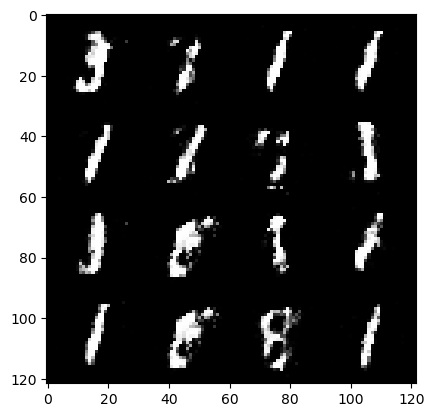

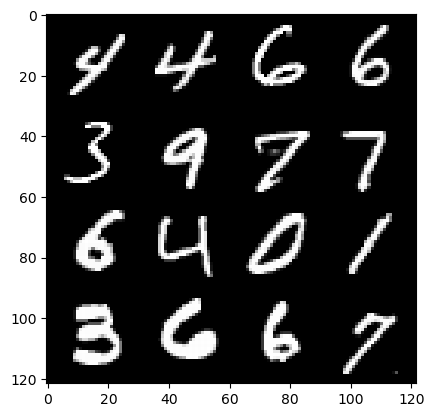

167: step 78600/ Gen loss: 2.068253760735194/ disc_loss: 0.251949252883593


  0%|          | 0/469 [00:00<?, ?it/s]

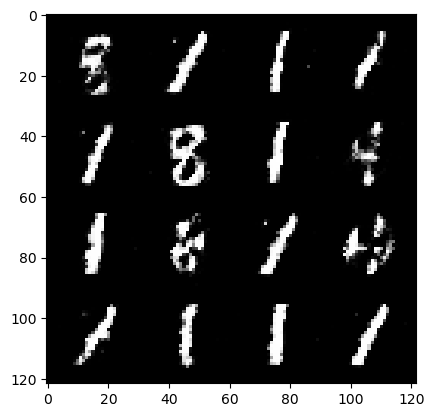

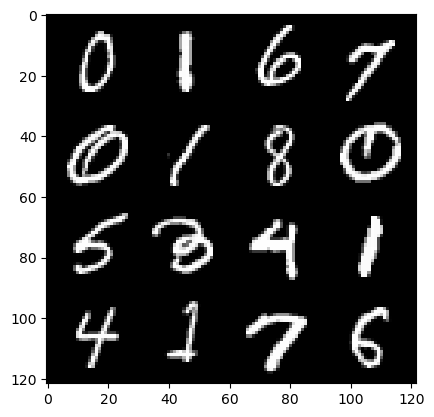

168: step 78900/ Gen loss: 1.9854935483137754/ disc_loss: 0.27111790483196585


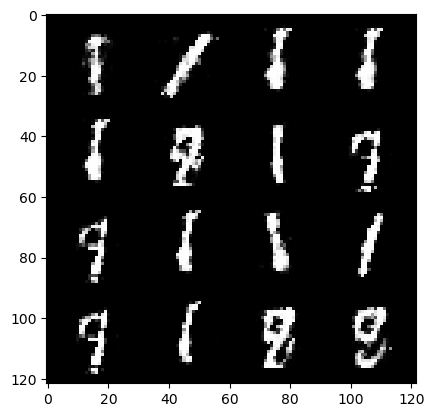

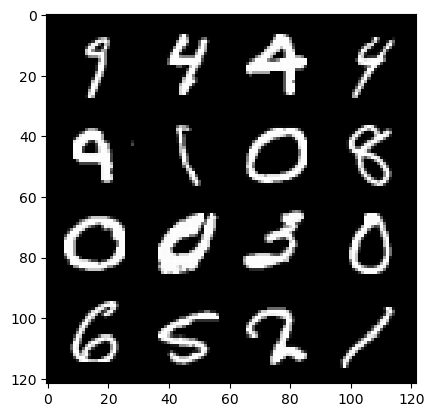

168: step 79200/ Gen loss: 2.042745197216669/ disc_loss: 0.26155337125062944


  0%|          | 0/469 [00:00<?, ?it/s]

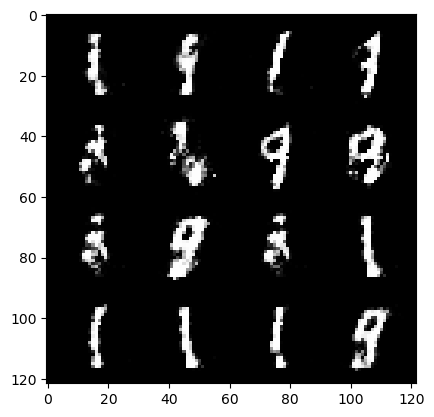

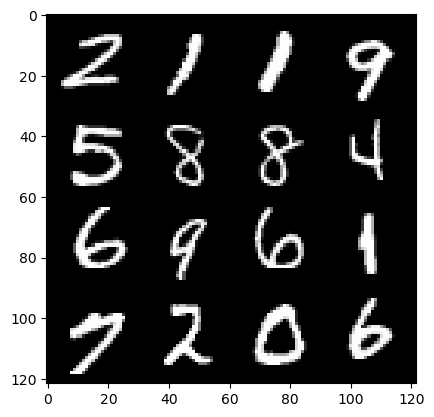

169: step 79500/ Gen loss: 2.0489061053593938/ disc_loss: 0.2518377161522706


  0%|          | 0/469 [00:00<?, ?it/s]

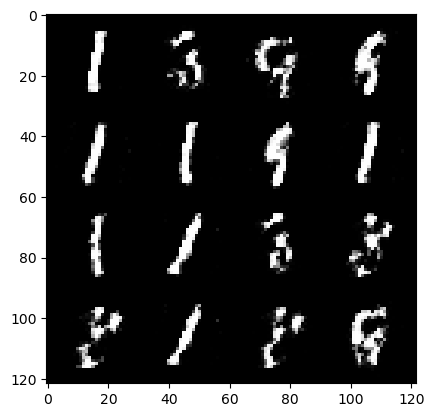

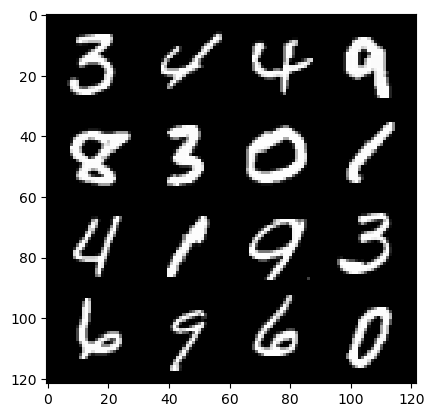

170: step 79800/ Gen loss: 2.017937134504318/ disc_loss: 0.2582525152961411


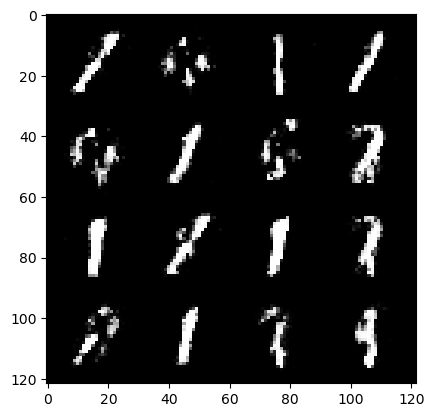

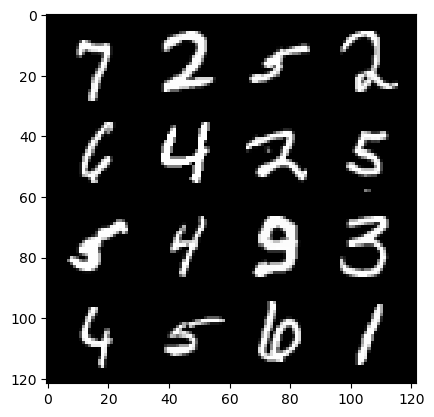

170: step 80100/ Gen loss: 2.17753697037697/ disc_loss: 0.24096455082297338


  0%|          | 0/469 [00:00<?, ?it/s]

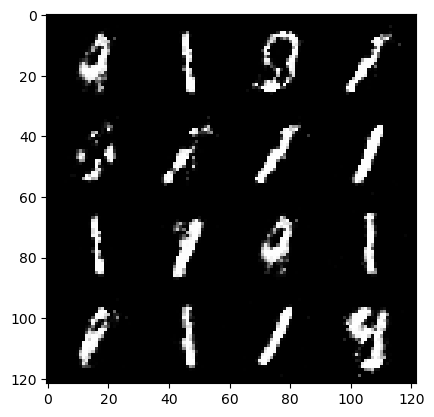

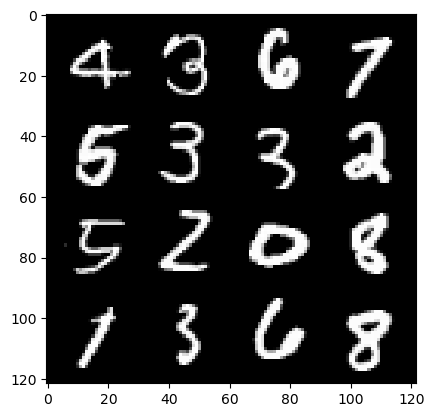

171: step 80400/ Gen loss: 2.0356540656089788/ disc_loss: 0.24941012009978297


  0%|          | 0/469 [00:00<?, ?it/s]

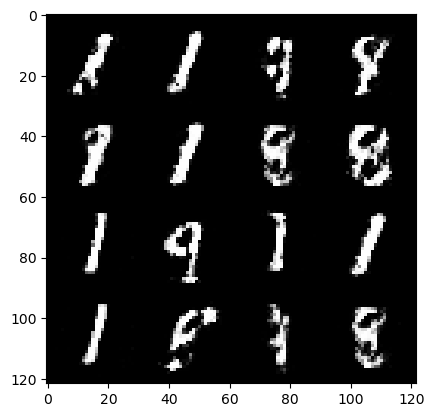

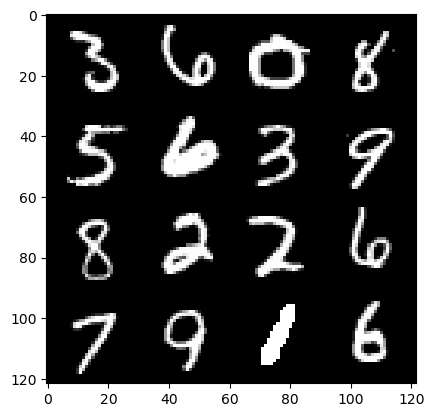

172: step 80700/ Gen loss: 2.0135836700598393/ disc_loss: 0.2654952892164387


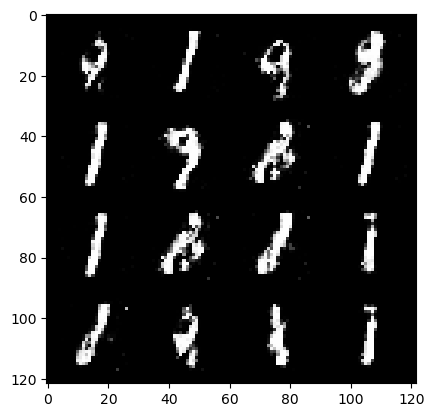

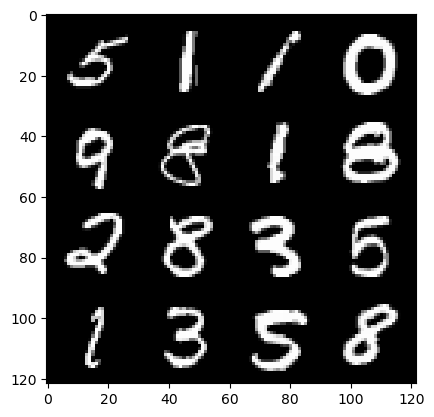

172: step 81000/ Gen loss: 2.0409908068180083/ disc_loss: 0.24837830151120813


  0%|          | 0/469 [00:00<?, ?it/s]

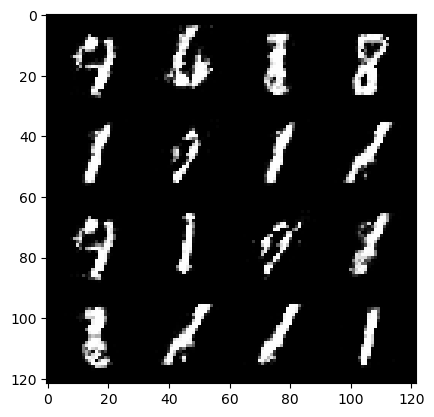

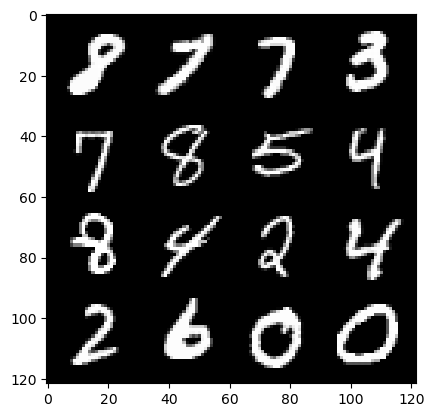

173: step 81300/ Gen loss: 2.1097858945528665/ disc_loss: 0.25985623985528944


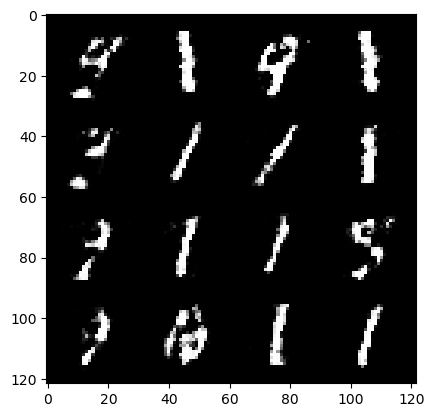

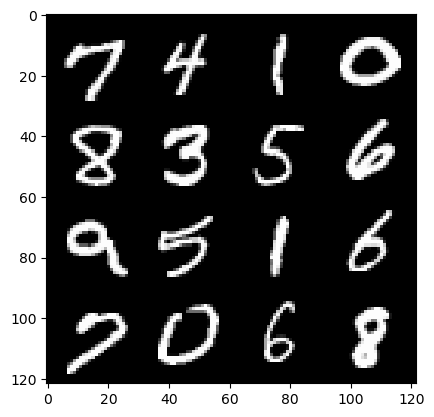

173: step 81600/ Gen loss: 2.011578557093939/ disc_loss: 0.2622771582007408


  0%|          | 0/469 [00:00<?, ?it/s]

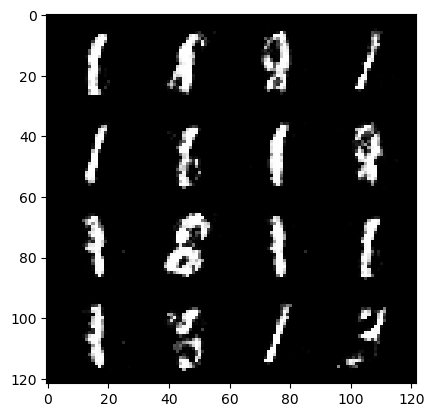

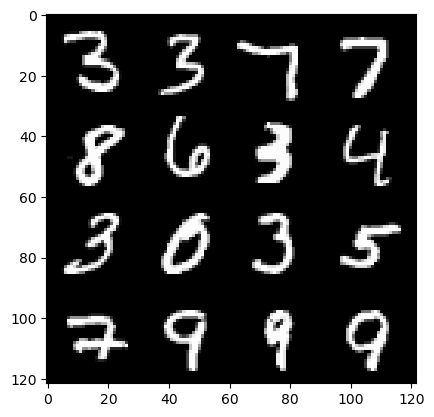

174: step 81900/ Gen loss: 1.9493986296653734/ disc_loss: 0.2682460368673006


  0%|          | 0/469 [00:00<?, ?it/s]

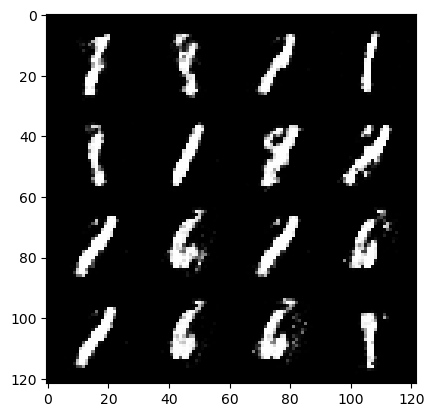

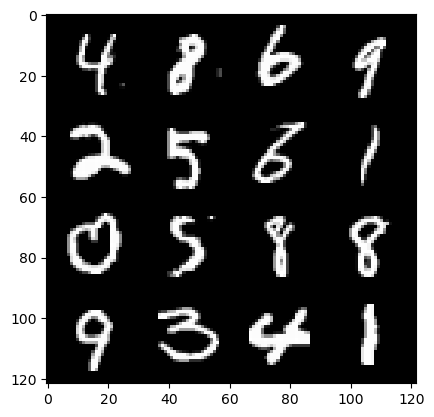

175: step 82200/ Gen loss: 1.9171842312812797/ disc_loss: 0.2809268014132975


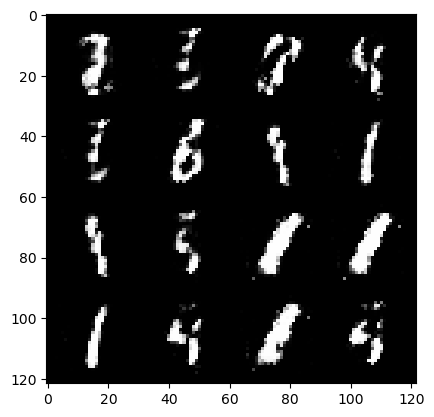

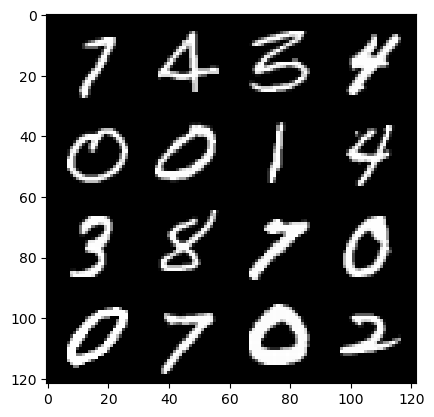

175: step 82500/ Gen loss: 2.0676760812600454/ disc_loss: 0.25714680030941944


  0%|          | 0/469 [00:00<?, ?it/s]

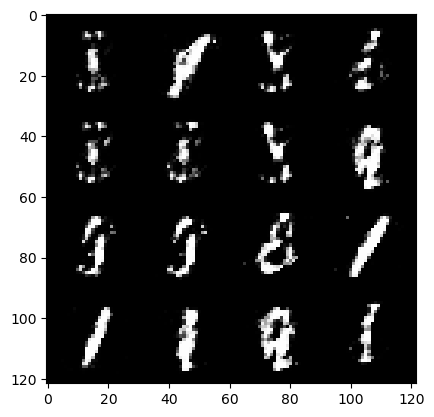

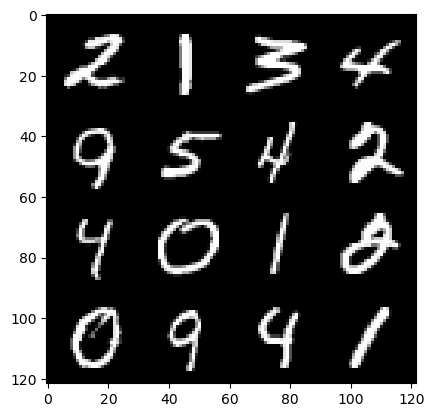

176: step 82800/ Gen loss: 2.106114750703178/ disc_loss: 0.2378009690344333


  0%|          | 0/469 [00:00<?, ?it/s]

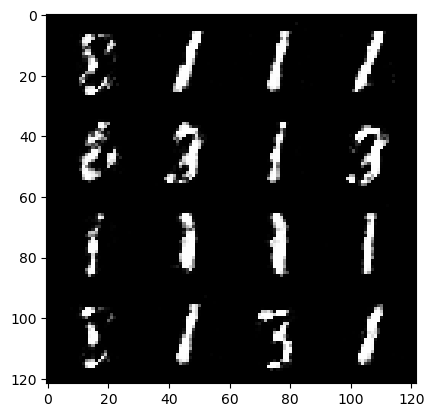

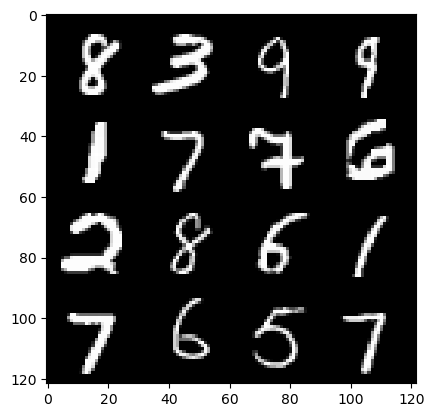

177: step 83100/ Gen loss: 2.0630276246865593/ disc_loss: 0.25828878258665416


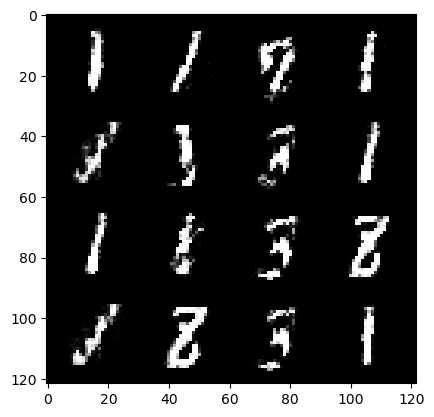

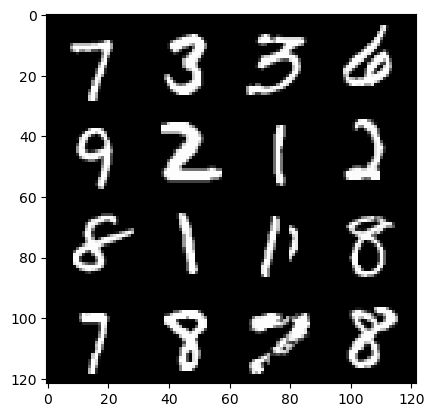

177: step 83400/ Gen loss: 2.012001505295436/ disc_loss: 0.2595206426580747


  0%|          | 0/469 [00:00<?, ?it/s]

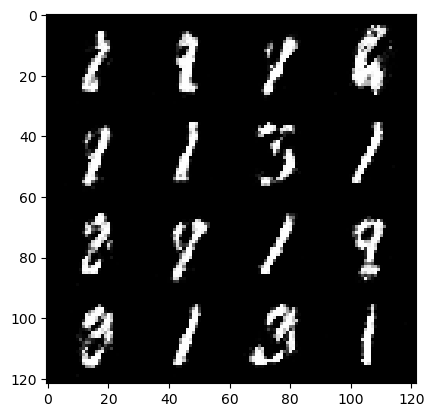

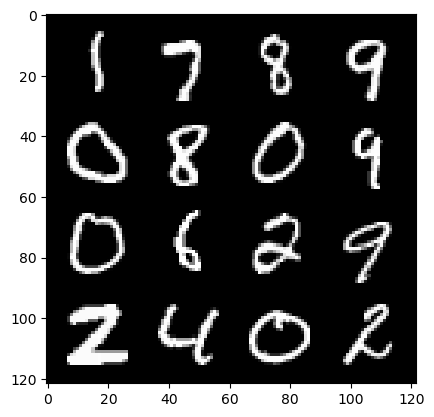

178: step 83700/ Gen loss: 1.944728238185247/ disc_loss: 0.27290506372849144


  0%|          | 0/469 [00:00<?, ?it/s]

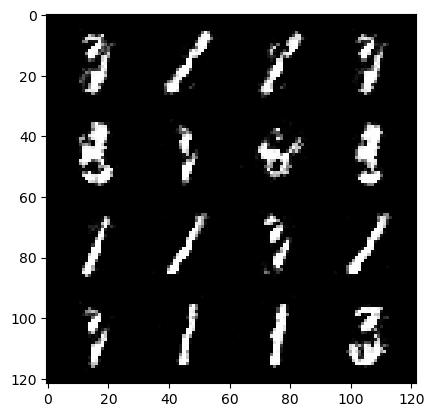

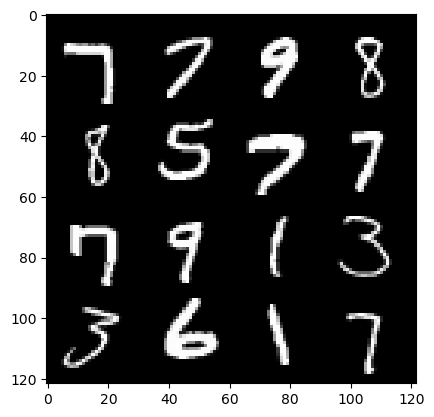

179: step 84000/ Gen loss: 1.858093864520391/ disc_loss: 0.283961056768894


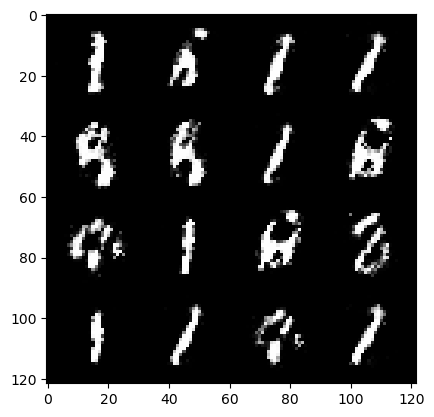

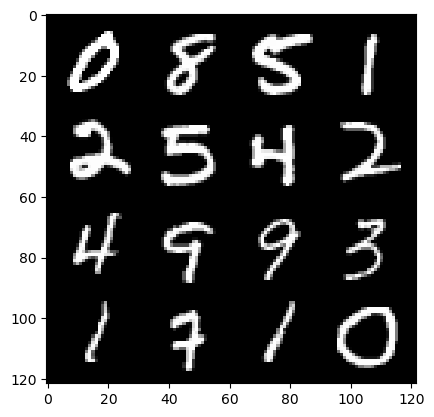

179: step 84300/ Gen loss: 1.8718024313449866/ disc_loss: 0.27899429266651493


  0%|          | 0/469 [00:00<?, ?it/s]

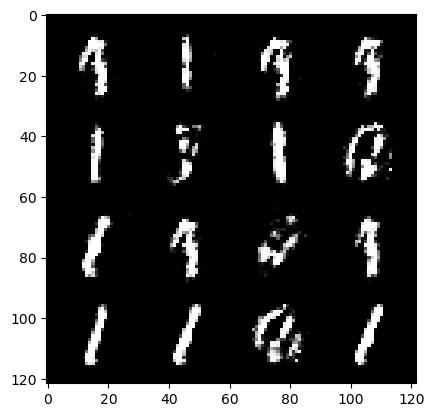

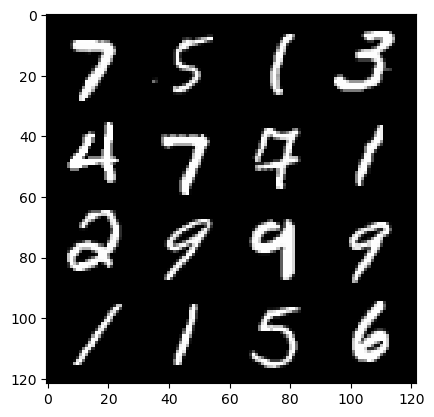

180: step 84600/ Gen loss: 1.9536448514461529/ disc_loss: 0.26408899441361416


  0%|          | 0/469 [00:00<?, ?it/s]

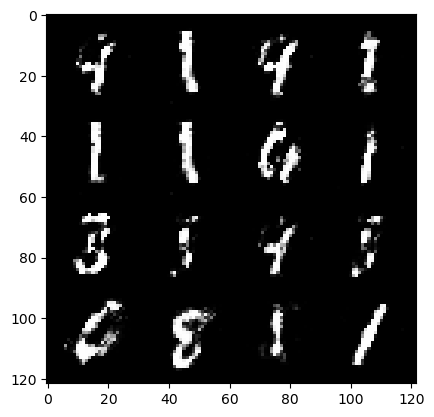

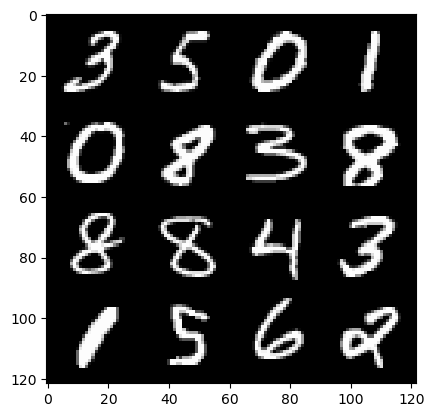

181: step 84900/ Gen loss: 2.0449502070744825/ disc_loss: 0.2462033692995708


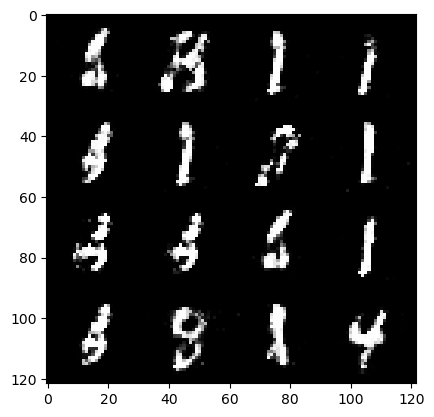

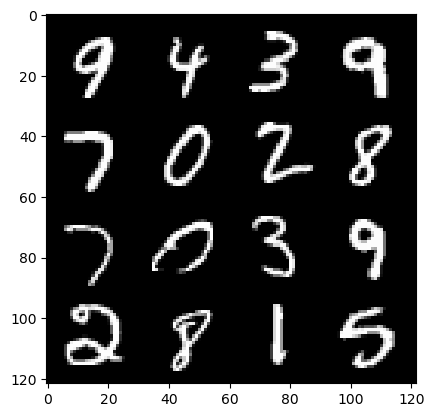

181: step 85200/ Gen loss: 1.9432504677772509/ disc_loss: 0.2720644871393839


  0%|          | 0/469 [00:00<?, ?it/s]

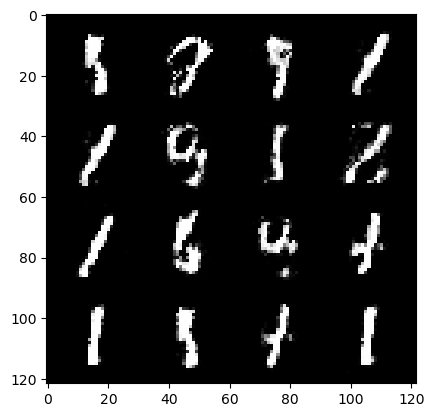

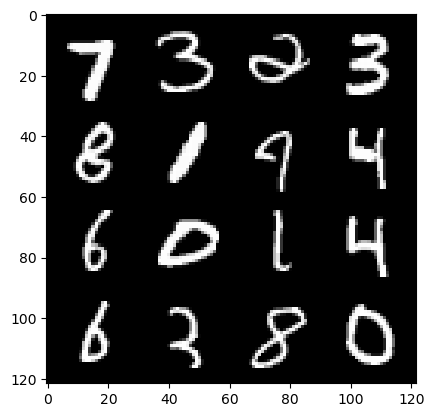

182: step 85500/ Gen loss: 2.112622214555739/ disc_loss: 0.24742619479695951


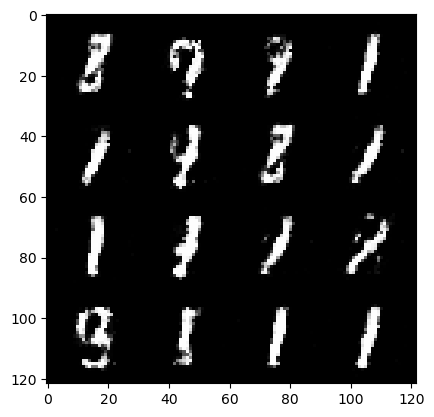

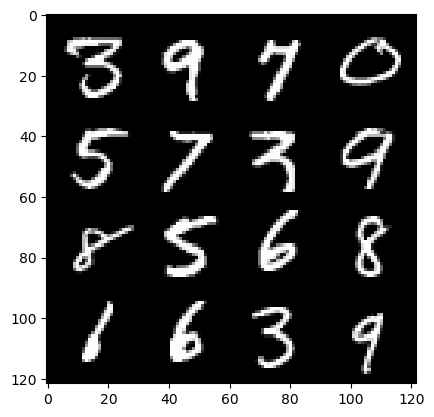

182: step 85800/ Gen loss: 2.0428869978586817/ disc_loss: 0.2566956241428853


  0%|          | 0/469 [00:00<?, ?it/s]

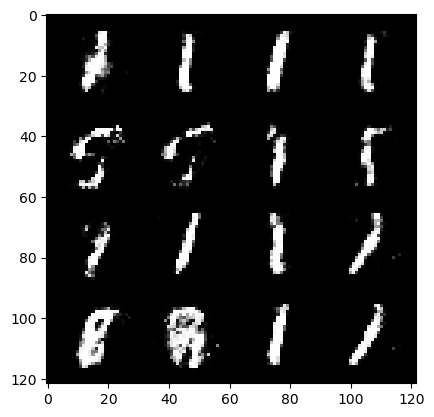

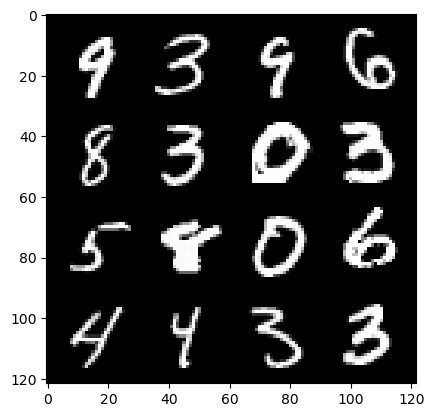

183: step 86100/ Gen loss: 1.930720661083858/ disc_loss: 0.27704871485630683


  0%|          | 0/469 [00:00<?, ?it/s]

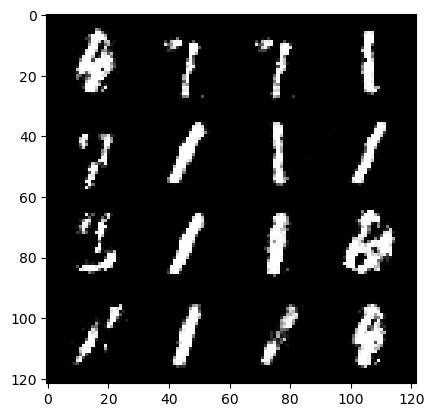

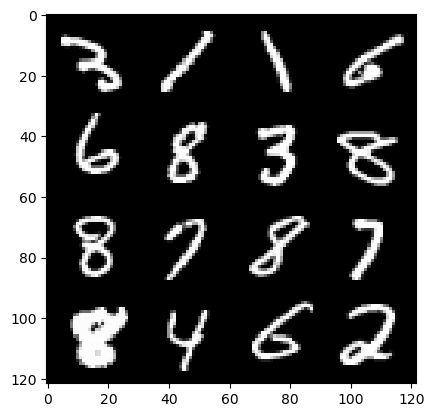

184: step 86400/ Gen loss: 1.8861836079756409/ disc_loss: 0.28338548243045814


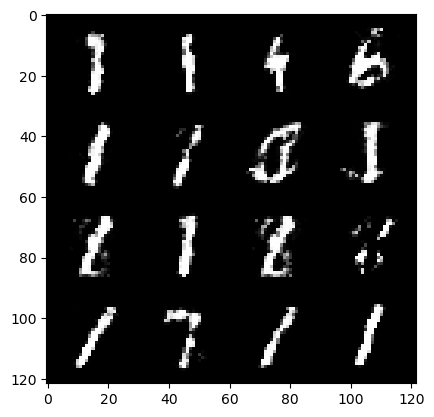

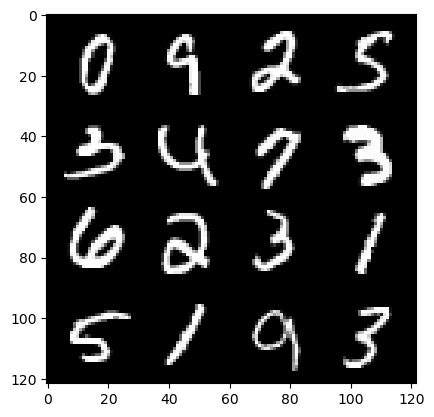

184: step 86700/ Gen loss: 1.937687799533208/ disc_loss: 0.2778409716486932


  0%|          | 0/469 [00:00<?, ?it/s]

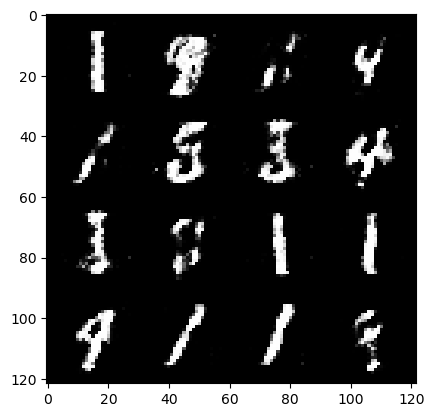

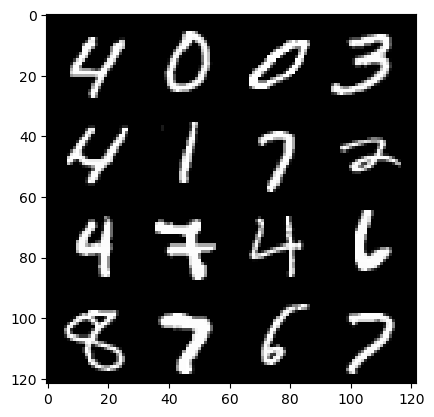

185: step 87000/ Gen loss: 1.9672494645913443/ disc_loss: 0.2730122036238513


  0%|          | 0/469 [00:00<?, ?it/s]

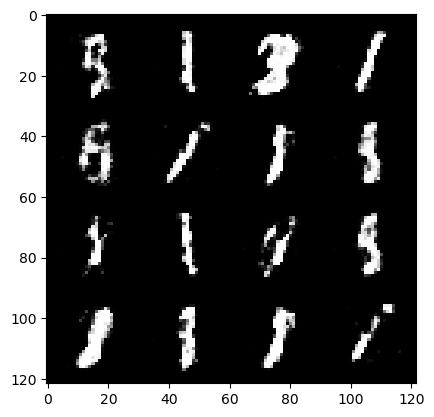

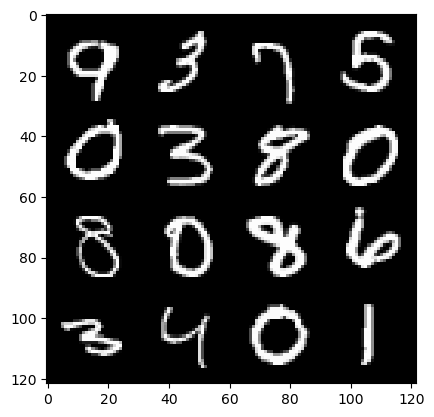

186: step 87300/ Gen loss: 1.897325890461604/ disc_loss: 0.27984730844696365


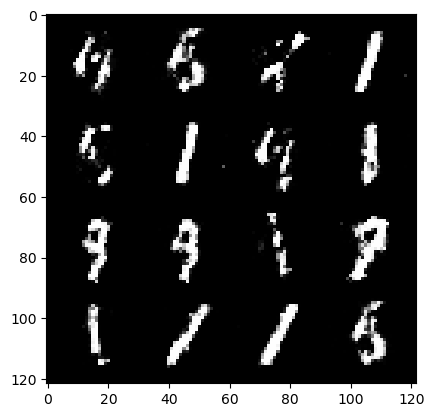

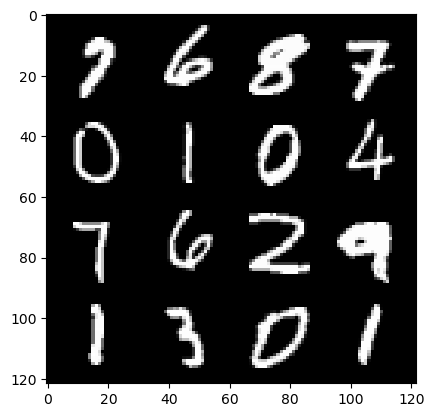

186: step 87600/ Gen loss: 1.8822438637415566/ disc_loss: 0.28816653544704135


  0%|          | 0/469 [00:00<?, ?it/s]

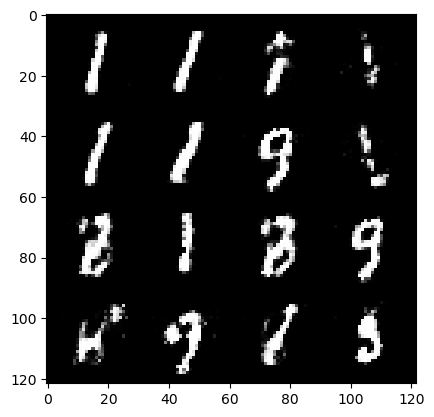

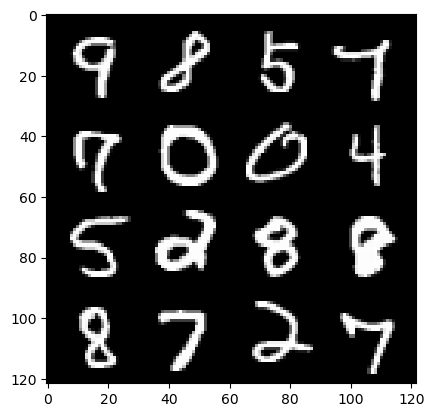

187: step 87900/ Gen loss: 1.830367163419723/ disc_loss: 0.30604491119583466


  0%|          | 0/469 [00:00<?, ?it/s]

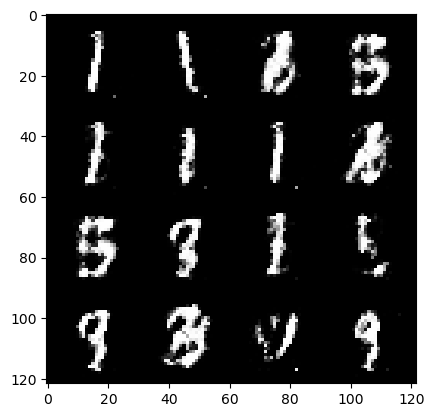

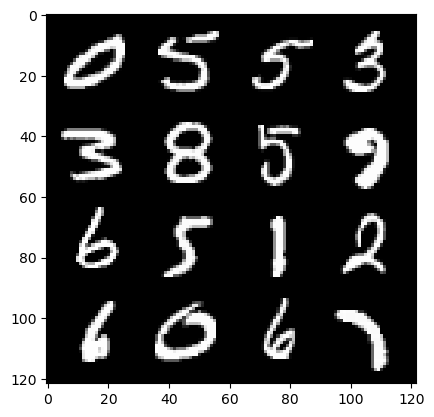

188: step 88200/ Gen loss: 1.7926460564136497/ disc_loss: 0.3042913172642392


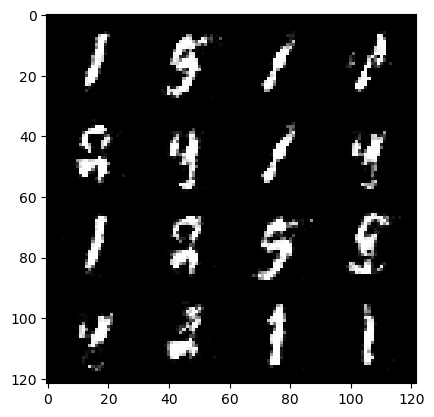

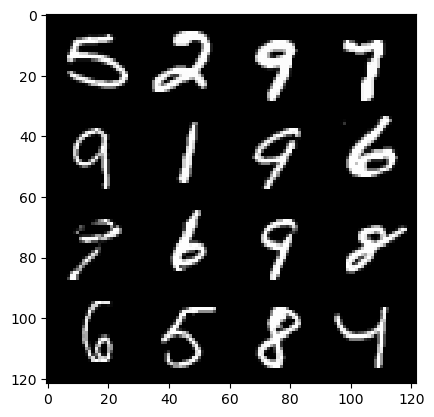

188: step 88500/ Gen loss: 1.9443832711378726/ disc_loss: 0.2672522505124411


  0%|          | 0/469 [00:00<?, ?it/s]

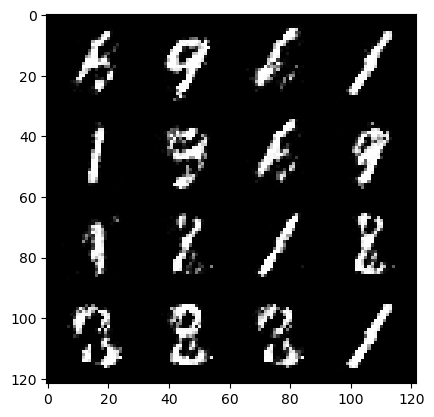

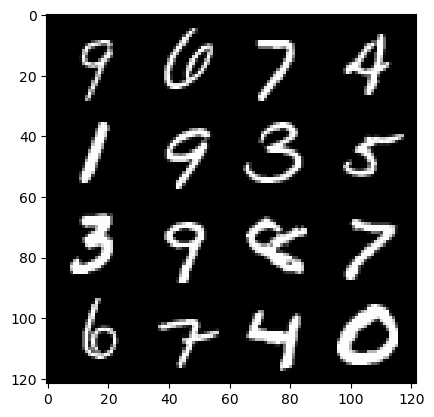

189: step 88800/ Gen loss: 2.0042567209402726/ disc_loss: 0.26691886534293474


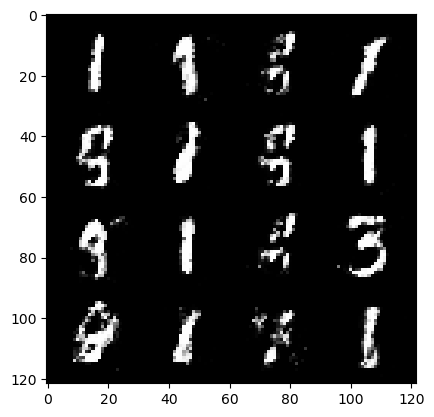

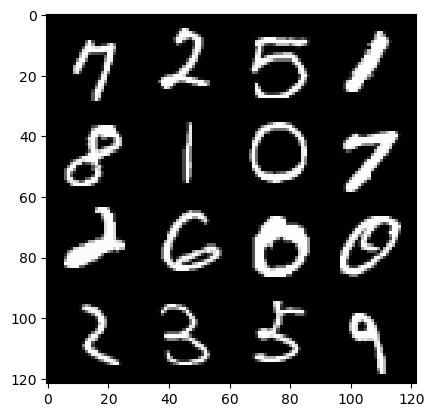

189: step 89100/ Gen loss: 1.8368818171819048/ disc_loss: 0.3006294641892116


  0%|          | 0/469 [00:00<?, ?it/s]

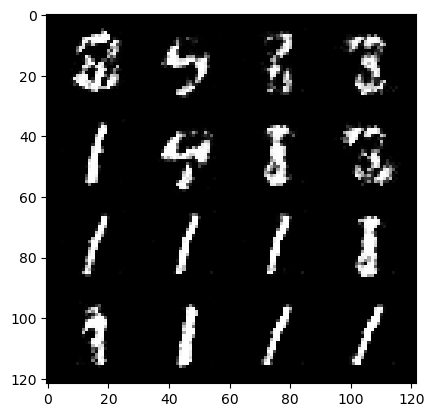

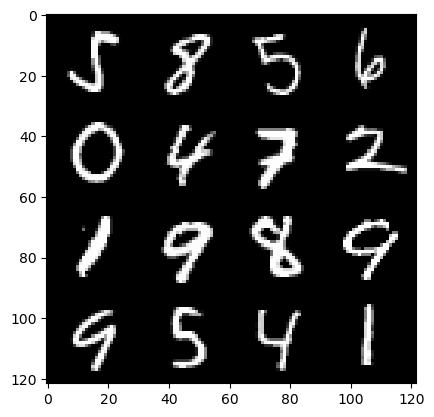

190: step 89400/ Gen loss: 1.8723925157388057/ disc_loss: 0.29373141114910456


  0%|          | 0/469 [00:00<?, ?it/s]

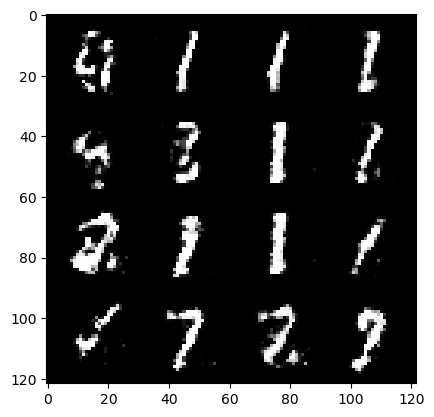

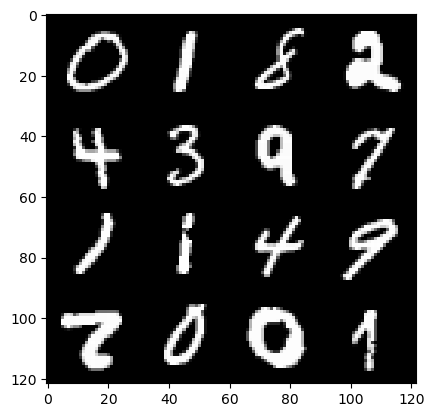

191: step 89700/ Gen loss: 1.8252661319573722/ disc_loss: 0.3052020611365637


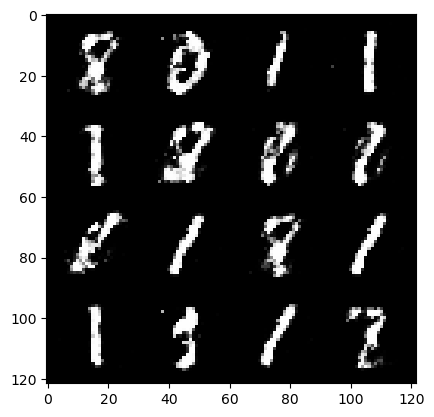

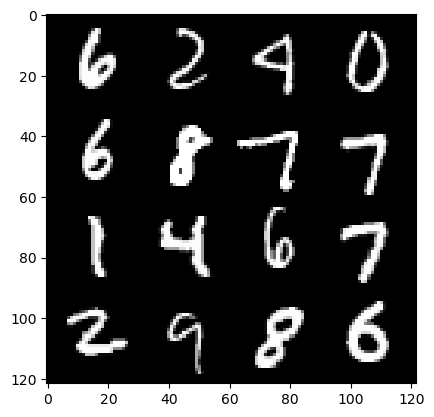

191: step 90000/ Gen loss: 1.9040044367313393/ disc_loss: 0.27959919591744753


  0%|          | 0/469 [00:00<?, ?it/s]

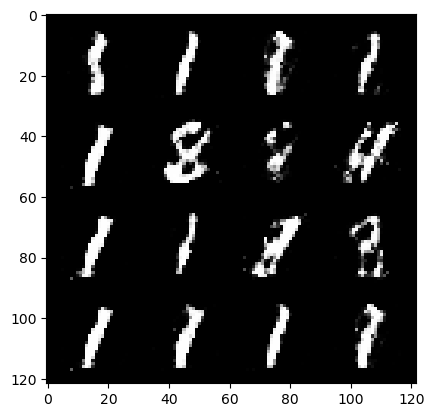

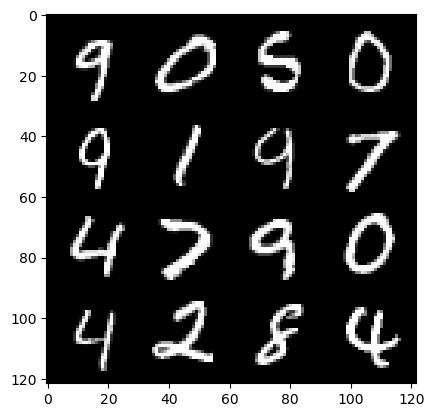

192: step 90300/ Gen loss: 1.8834906057516734/ disc_loss: 0.29961876039703694


  0%|          | 0/469 [00:00<?, ?it/s]

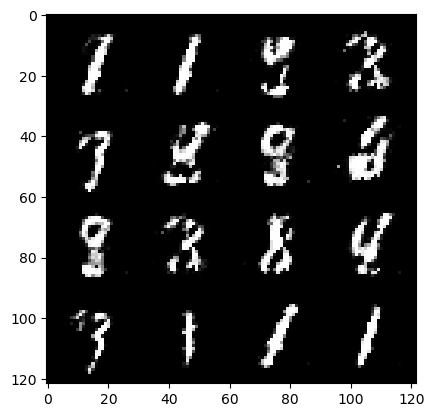

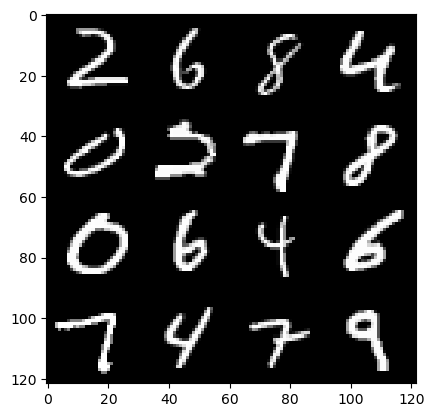

193: step 90600/ Gen loss: 1.9617107446988424/ disc_loss: 0.2802065984904764


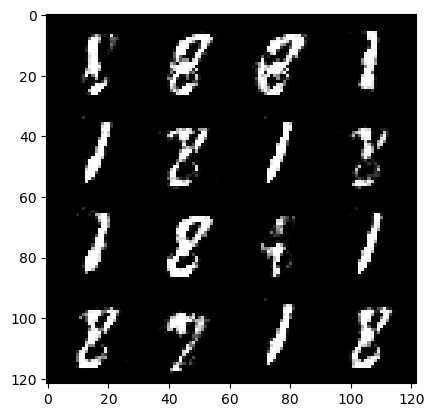

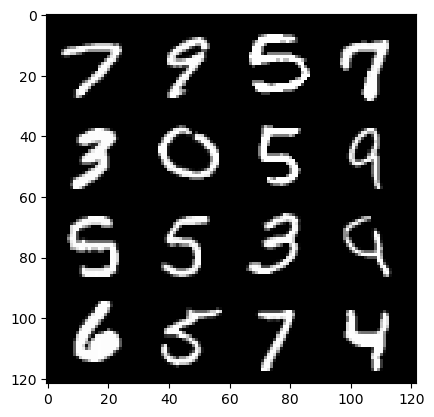

193: step 90900/ Gen loss: 1.910281049013138/ disc_loss: 0.28261218175292


  0%|          | 0/469 [00:00<?, ?it/s]

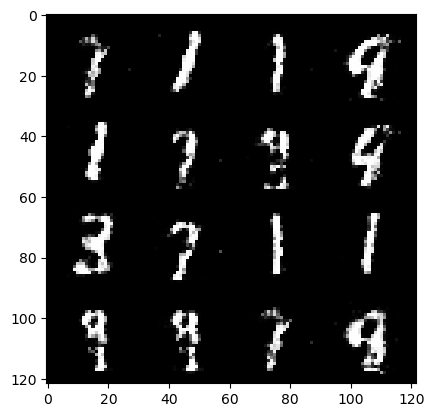

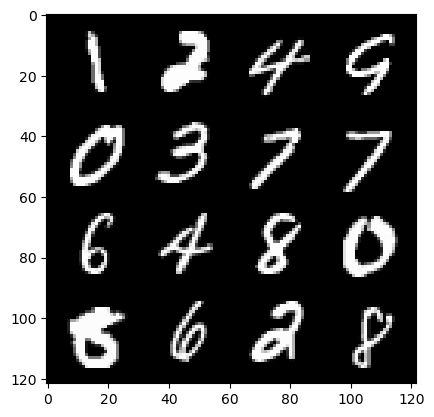

194: step 91200/ Gen loss: 1.9548299280802401/ disc_loss: 0.2771519617239636


  0%|          | 0/469 [00:00<?, ?it/s]

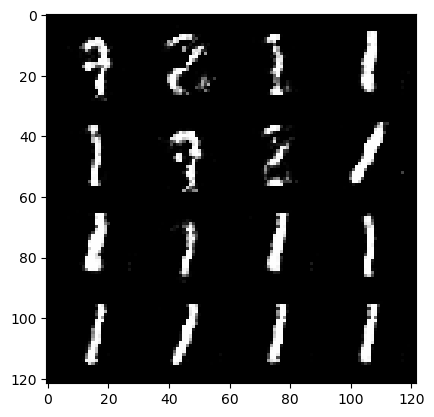

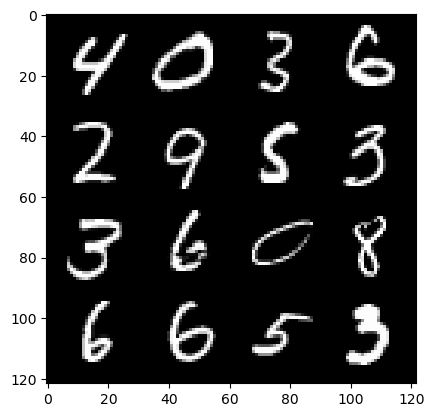

195: step 91500/ Gen loss: 1.9886896391709632/ disc_loss: 0.26553742801149693


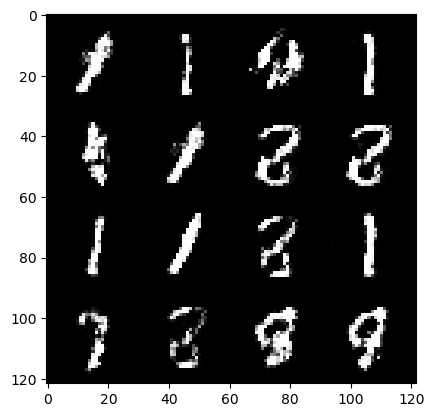

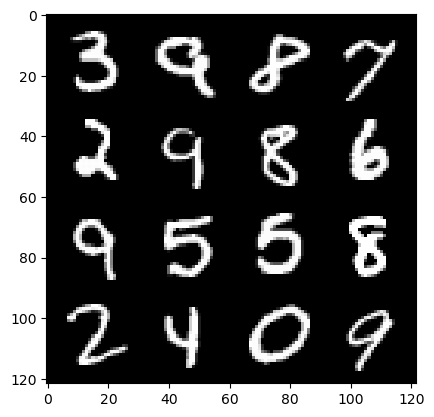

195: step 91800/ Gen loss: 1.9817805627981833/ disc_loss: 0.2682374984522659


  0%|          | 0/469 [00:00<?, ?it/s]

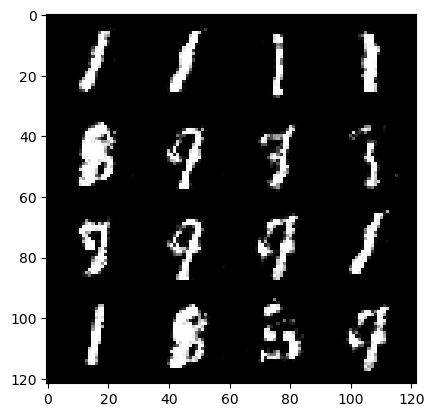

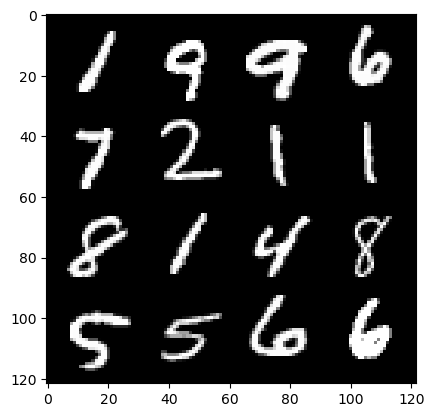

196: step 92100/ Gen loss: 1.9296433742841095/ disc_loss: 0.276136170824369


  0%|          | 0/469 [00:00<?, ?it/s]

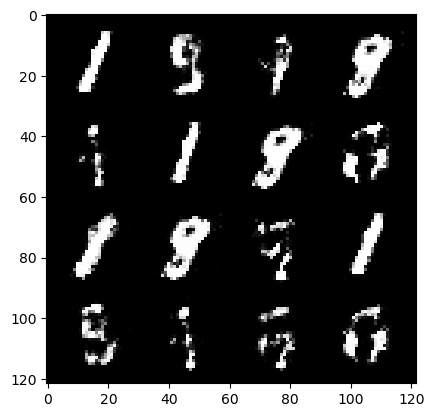

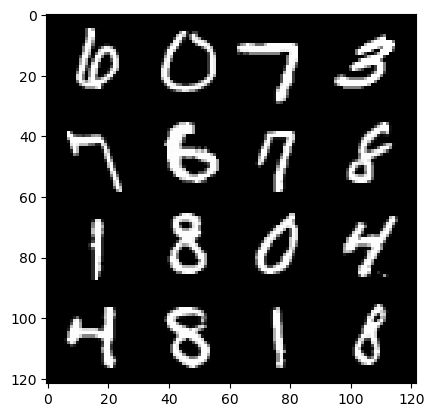

197: step 92400/ Gen loss: 1.914786313772202/ disc_loss: 0.2726243446270626


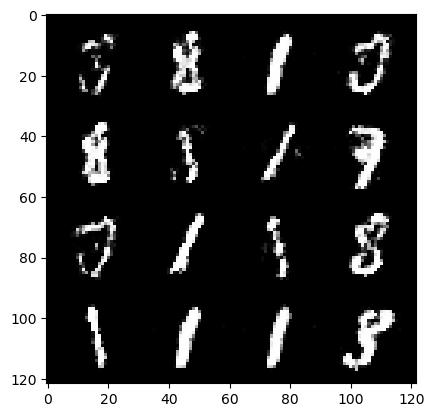

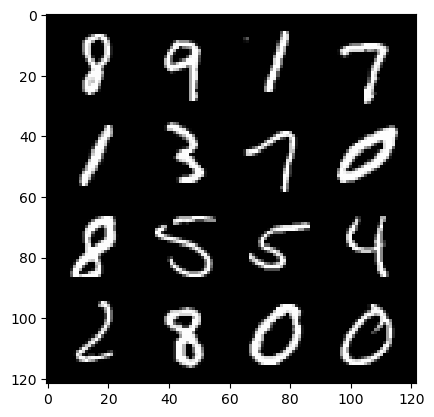

197: step 92700/ Gen loss: 1.8131265302499142/ disc_loss: 0.2922911198437213


  0%|          | 0/469 [00:00<?, ?it/s]

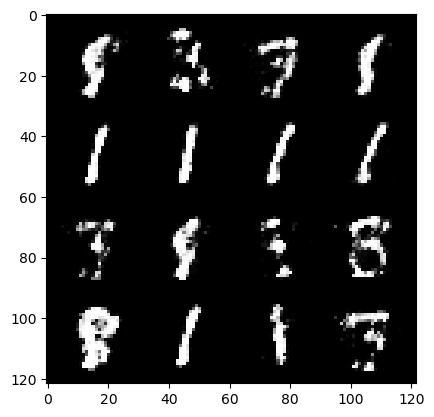

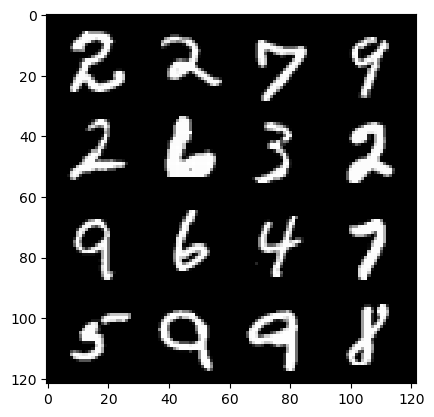

198: step 93000/ Gen loss: 1.7689581747849772/ disc_loss: 0.31839158852895094


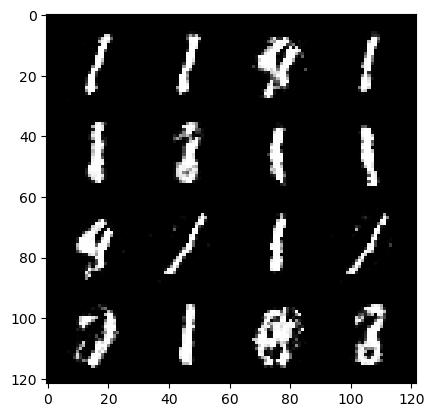

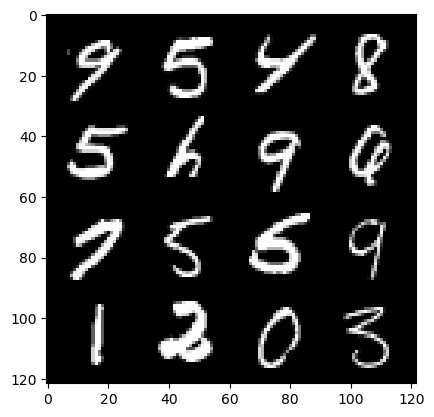

198: step 93300/ Gen loss: 1.7441868674755108/ disc_loss: 0.3126796180009842


  0%|          | 0/469 [00:00<?, ?it/s]

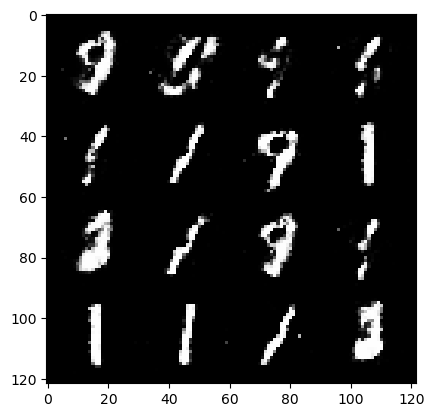

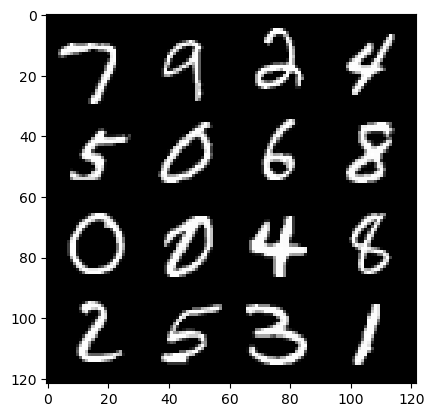

199: step 93600/ Gen loss: 1.8443373950322477/ disc_loss: 0.28635995114843044


  0%|          | 0/469 [00:00<?, ?it/s]

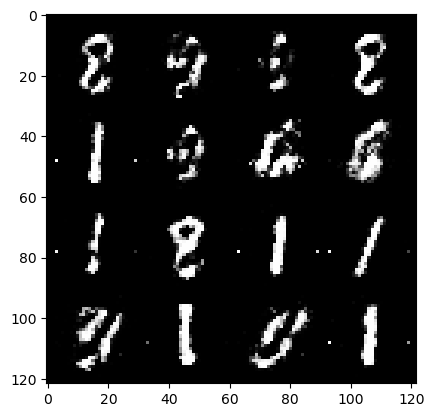

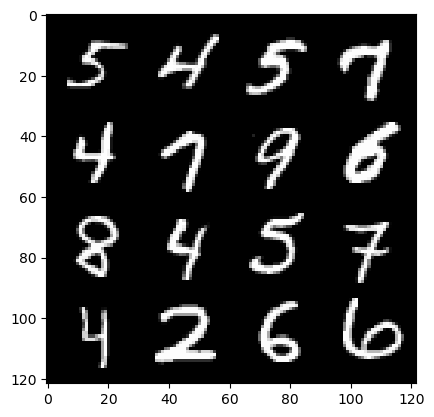

200: step 93900/ Gen loss: 1.77669157822927/ disc_loss: 0.31549891476829844


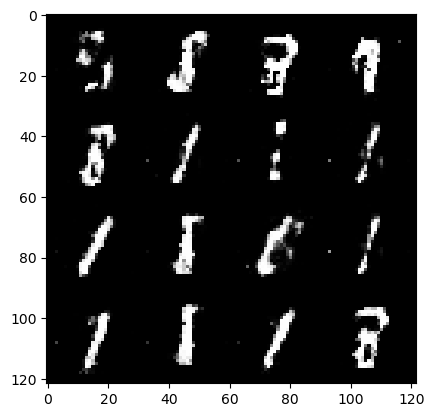

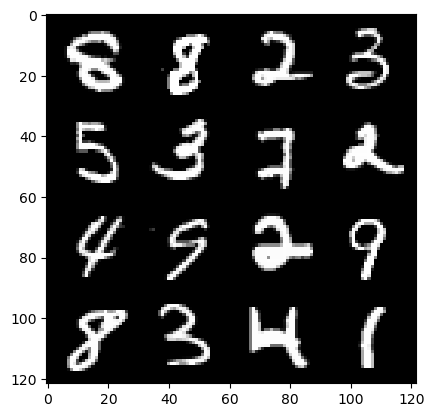

200: step 94200/ Gen loss: 1.907150666713715/ disc_loss: 0.27405059441924084


  0%|          | 0/469 [00:00<?, ?it/s]

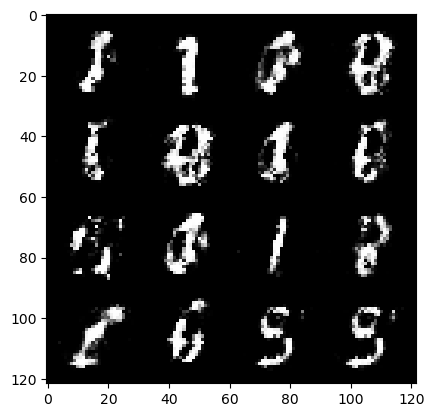

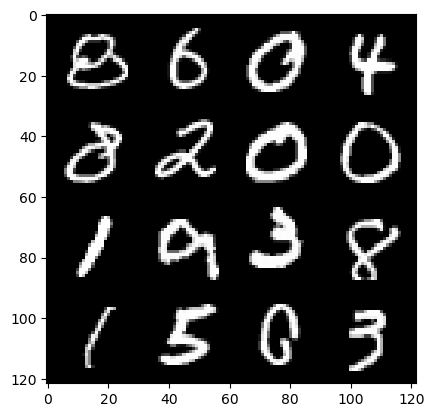

201: step 94500/ Gen loss: 1.9442423288027453/ disc_loss: 0.2716077024241287


  0%|          | 0/469 [00:00<?, ?it/s]

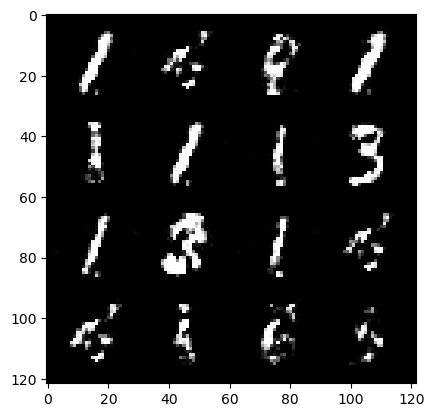

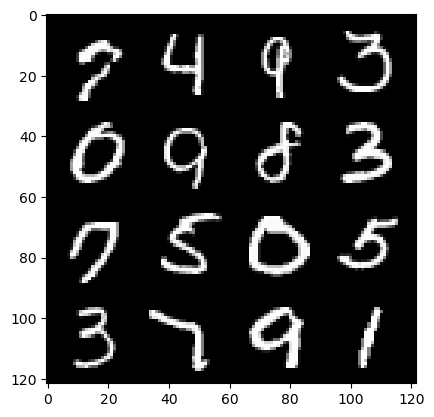

202: step 94800/ Gen loss: 1.7147472675641382/ disc_loss: 0.3163363606234393


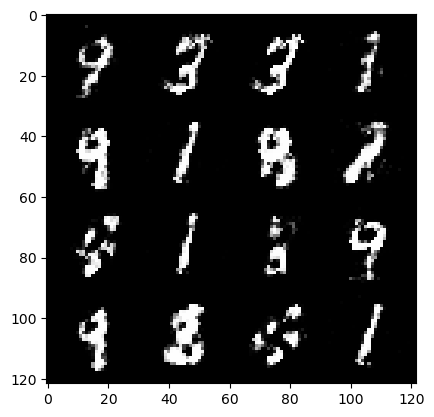

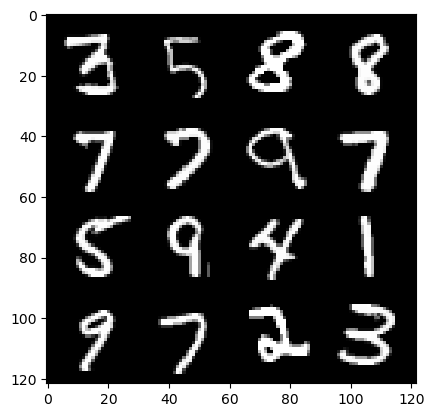

202: step 95100/ Gen loss: 1.7941108910242718/ disc_loss: 0.2852347435553869


  0%|          | 0/469 [00:00<?, ?it/s]

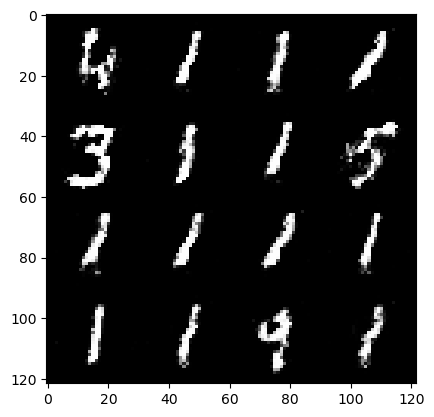

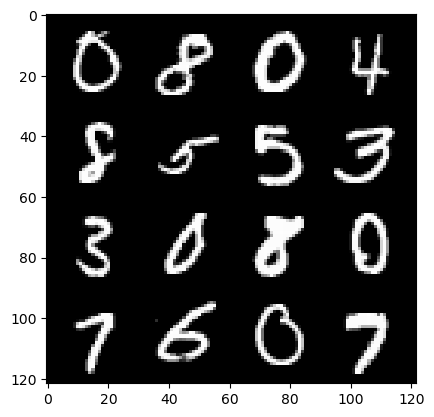

203: step 95400/ Gen loss: 1.8994312457243612/ disc_loss: 0.2851715238392354


  0%|          | 0/469 [00:00<?, ?it/s]

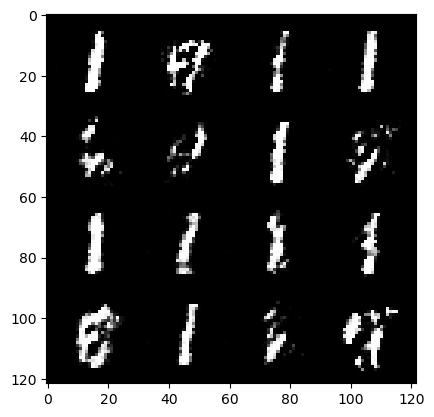

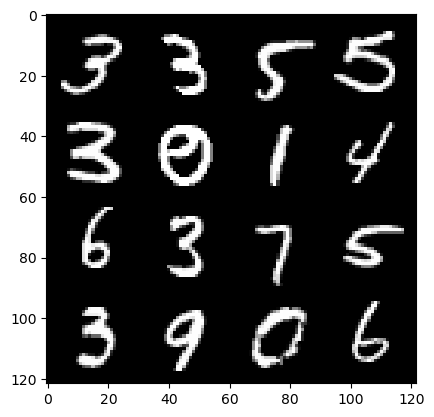

204: step 95700/ Gen loss: 1.8821471126874283/ disc_loss: 0.2826494641105332


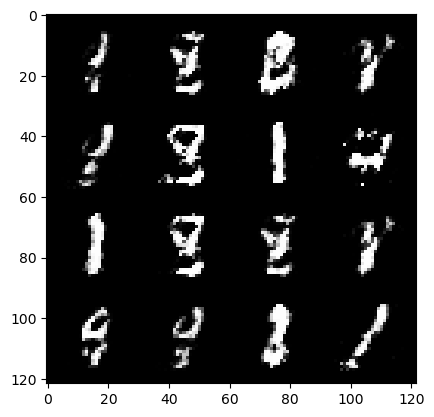

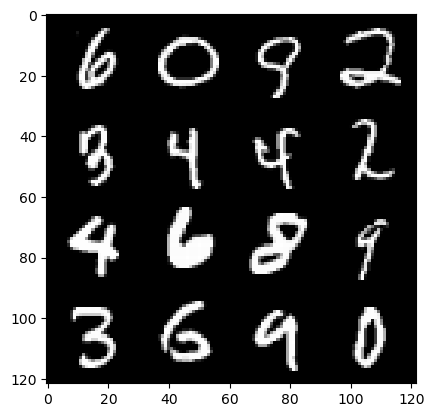

204: step 96000/ Gen loss: 1.9273707159360256/ disc_loss: 0.2667475363612176


  0%|          | 0/469 [00:00<?, ?it/s]

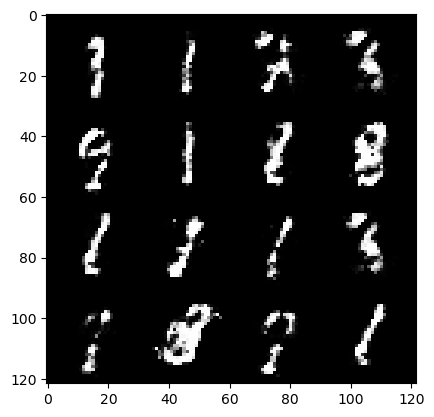

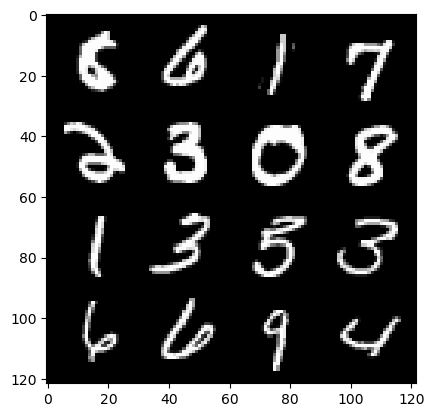

205: step 96300/ Gen loss: 1.8751068441073109/ disc_loss: 0.275903452336788


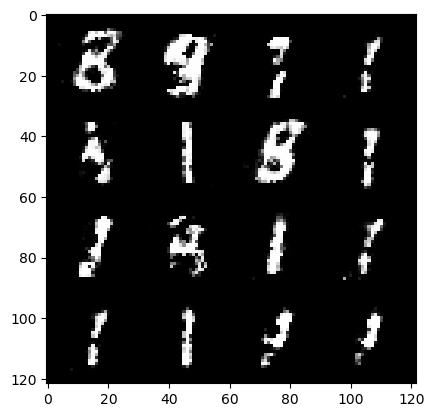

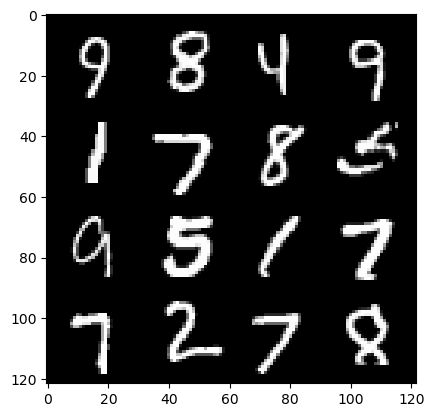

205: step 96600/ Gen loss: 1.879013873338699/ disc_loss: 0.28534667938947667


  0%|          | 0/469 [00:00<?, ?it/s]

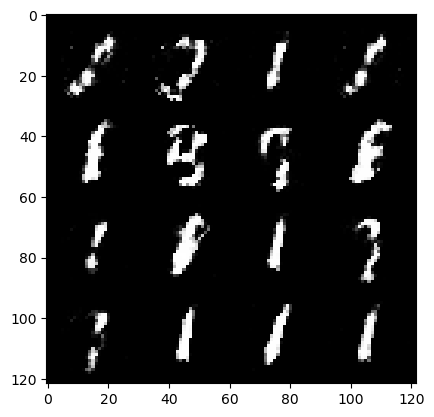

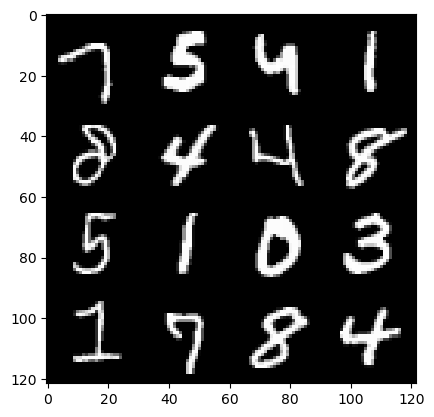

206: step 96900/ Gen loss: 1.8401214869817095/ disc_loss: 0.2829022798935574


  0%|          | 0/469 [00:00<?, ?it/s]

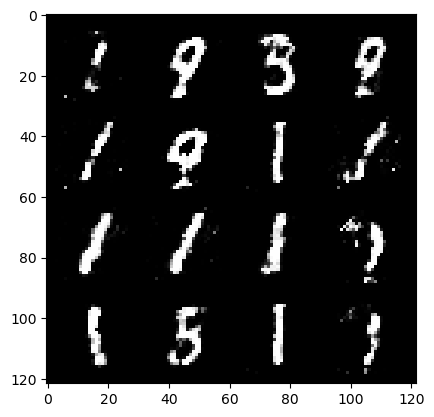

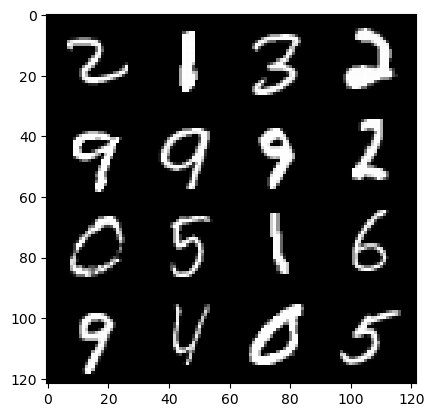

207: step 97200/ Gen loss: 1.8358408013979595/ disc_loss: 0.2989548009137313


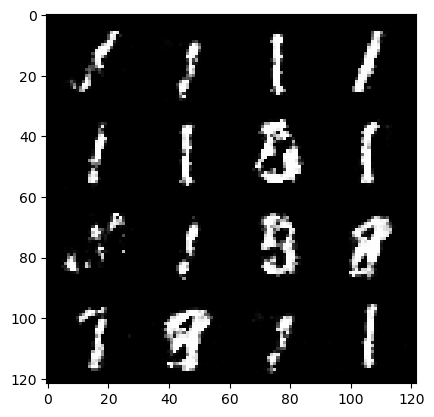

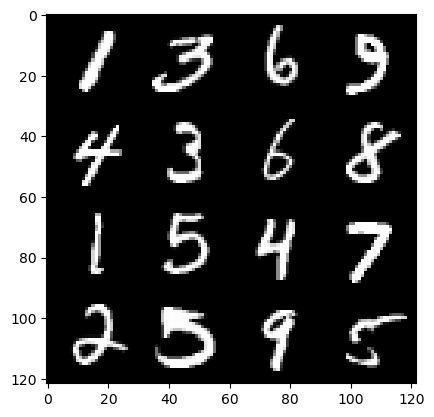

207: step 97500/ Gen loss: 1.9388908632596342/ disc_loss: 0.28373248368501675


  0%|          | 0/469 [00:00<?, ?it/s]

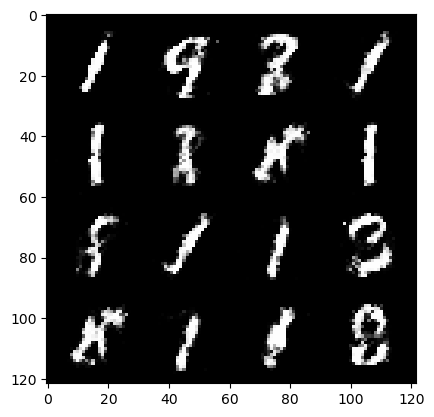

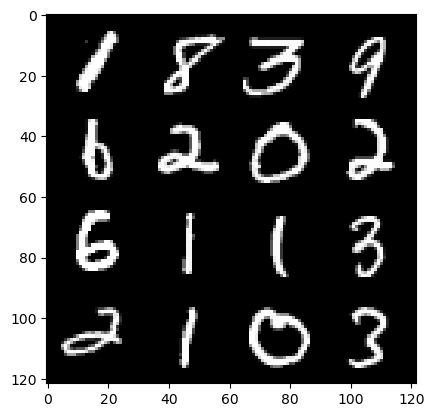

208: step 97800/ Gen loss: 1.7987814597288758/ disc_loss: 0.3110754764080049


  0%|          | 0/469 [00:00<?, ?it/s]

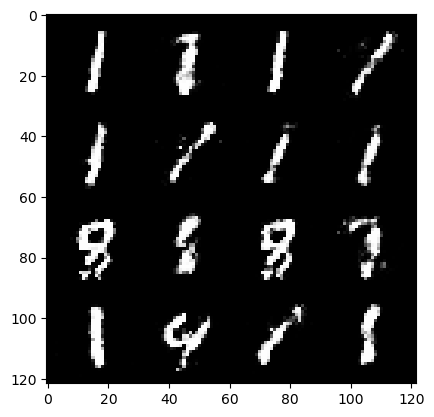

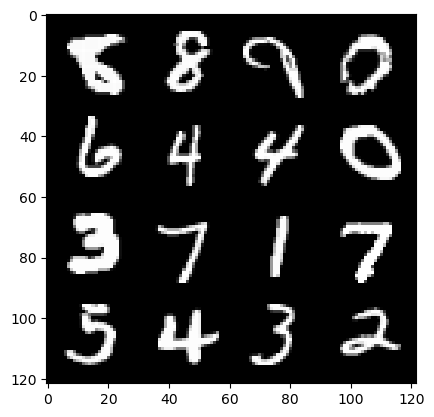

209: step 98100/ Gen loss: 1.7848054023583728/ disc_loss: 0.3032443078855673


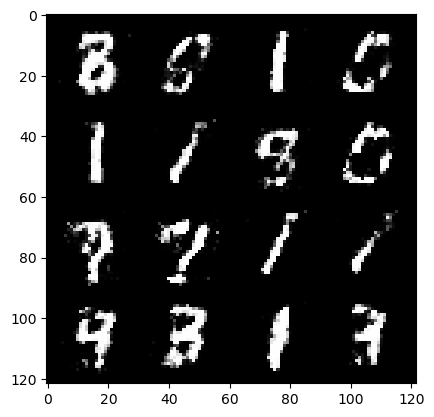

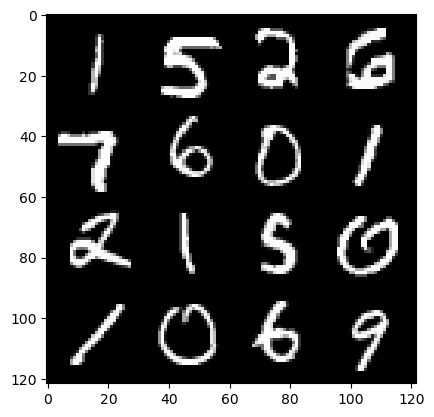

209: step 98400/ Gen loss: 1.7141791959603638/ disc_loss: 0.31290345887343096


  0%|          | 0/469 [00:00<?, ?it/s]

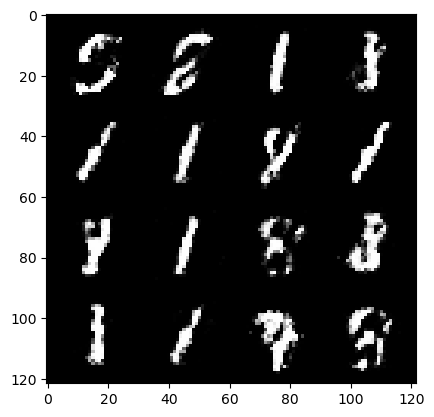

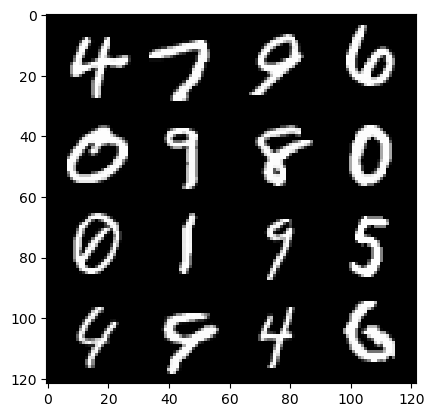

210: step 98700/ Gen loss: 1.801336419582366/ disc_loss: 0.31216639141241725


  0%|          | 0/469 [00:00<?, ?it/s]

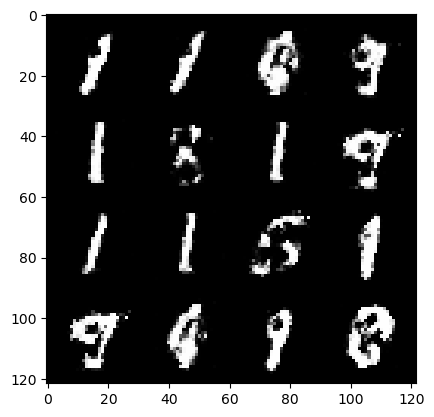

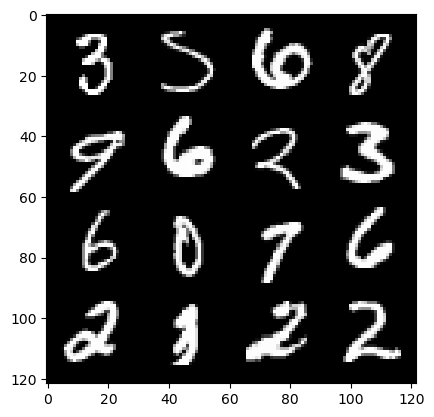

211: step 99000/ Gen loss: 1.7785925932725273/ disc_loss: 0.29609241157770155


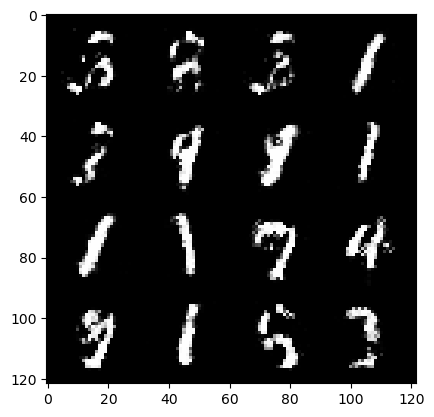

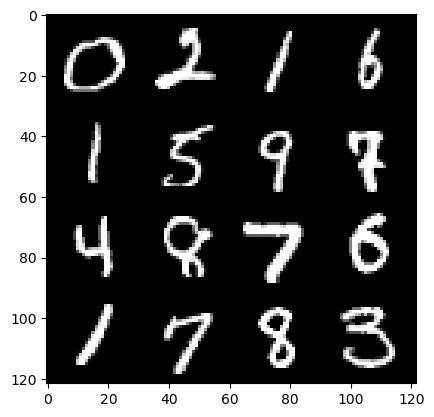

211: step 99300/ Gen loss: 1.7057427195707955/ disc_loss: 0.3158906739950183


  0%|          | 0/469 [00:00<?, ?it/s]

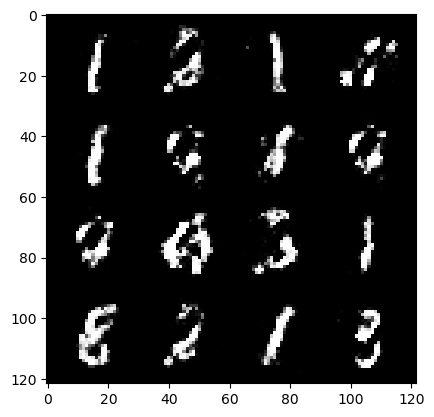

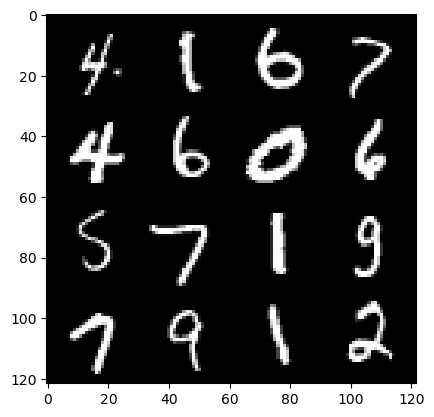

212: step 99600/ Gen loss: 1.8160184260209422/ disc_loss: 0.29985471616188697


  0%|          | 0/469 [00:00<?, ?it/s]

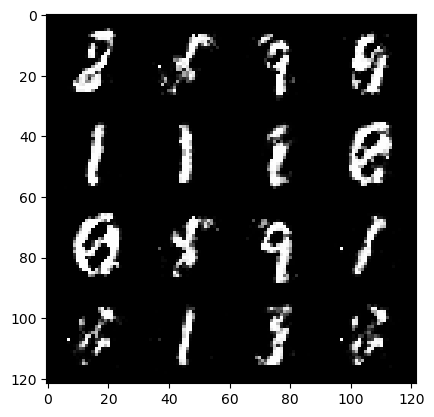

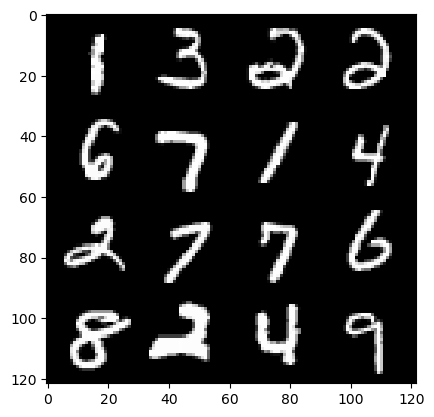

213: step 99900/ Gen loss: 1.8938130569457992/ disc_loss: 0.28872097507119177


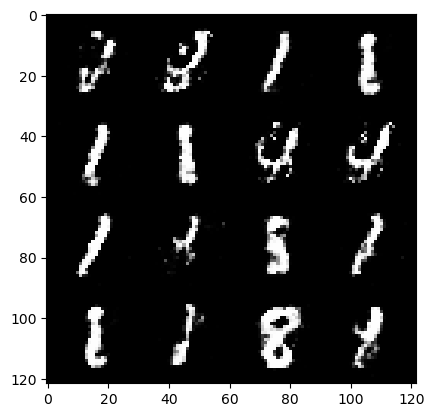

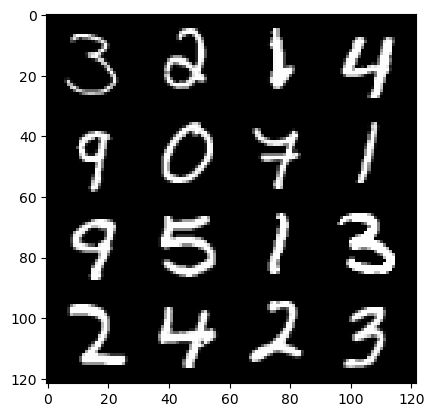

213: step 100200/ Gen loss: 1.896986509958902/ disc_loss: 0.29054630751411137


  0%|          | 0/469 [00:00<?, ?it/s]

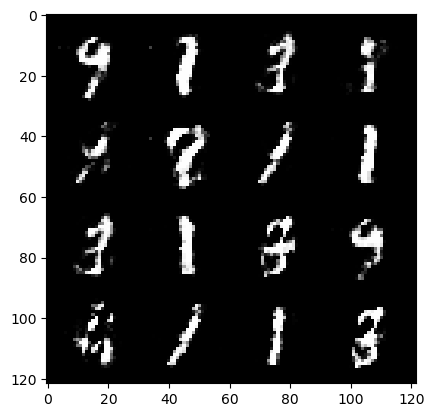

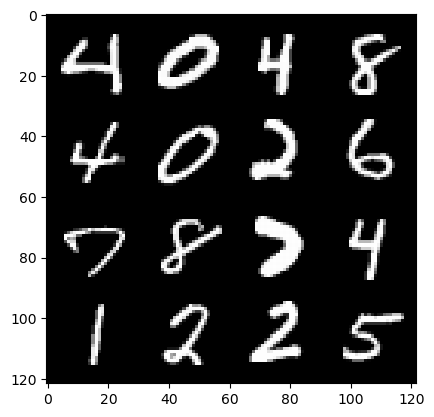

214: step 100500/ Gen loss: 1.9867235958576204/ disc_loss: 0.26821928019324925


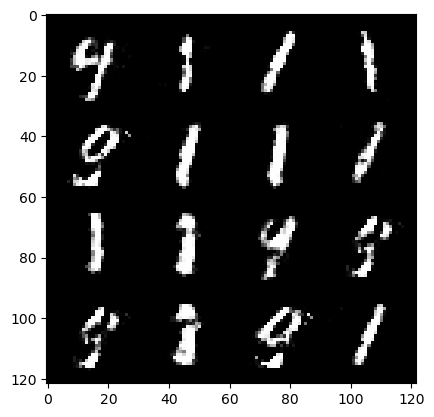

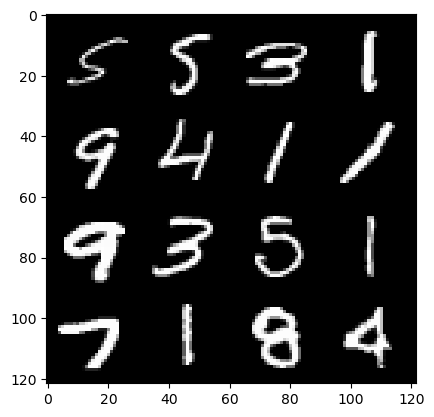

214: step 100800/ Gen loss: 2.0344392422835025/ disc_loss: 0.26747978428999586


  0%|          | 0/469 [00:00<?, ?it/s]

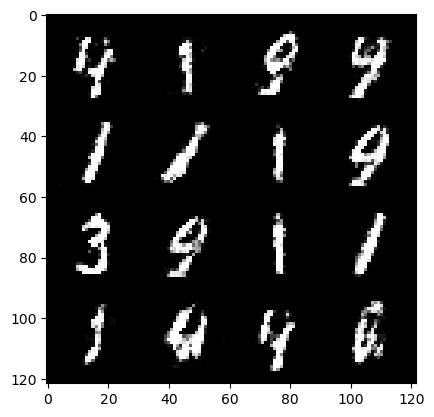

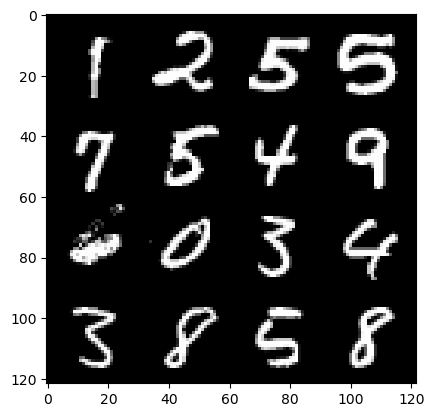

215: step 101100/ Gen loss: 1.8053085410594936/ disc_loss: 0.30047493884960785


  0%|          | 0/469 [00:00<?, ?it/s]

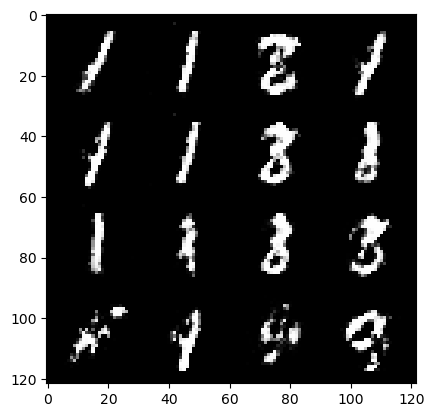

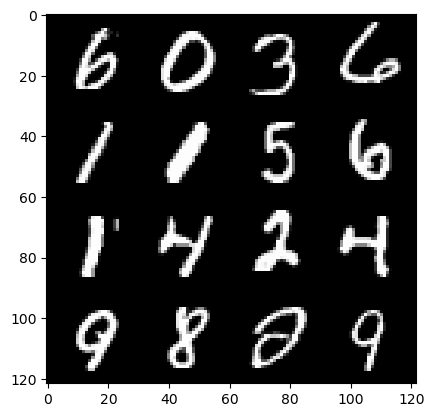

216: step 101400/ Gen loss: 1.8295411721865333/ disc_loss: 0.2889153524239858


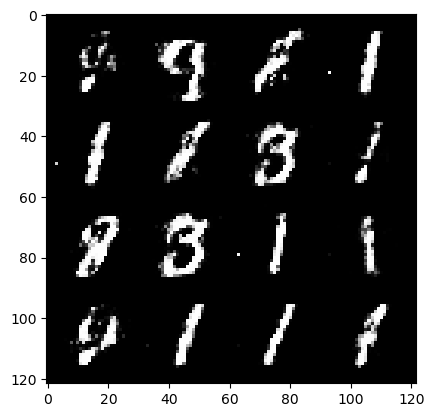

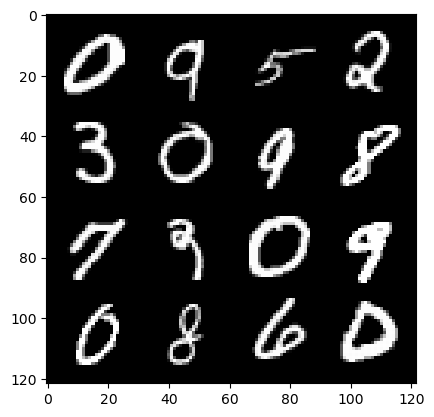

216: step 101700/ Gen loss: 1.7443606519699086/ disc_loss: 0.30998746698101337


  0%|          | 0/469 [00:00<?, ?it/s]

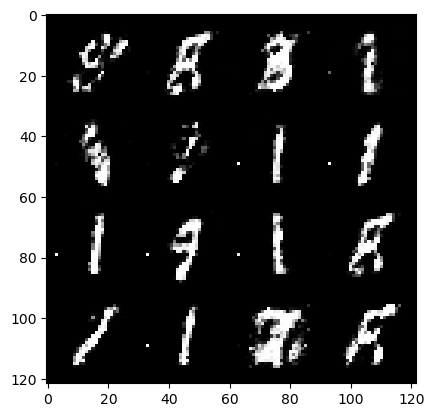

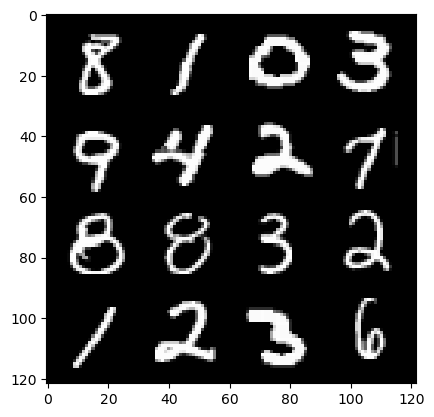

217: step 102000/ Gen loss: 1.5167841780185707/ disc_loss: 0.35461803108453743


  0%|          | 0/469 [00:00<?, ?it/s]

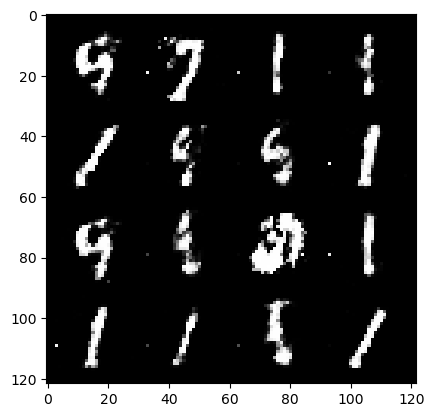

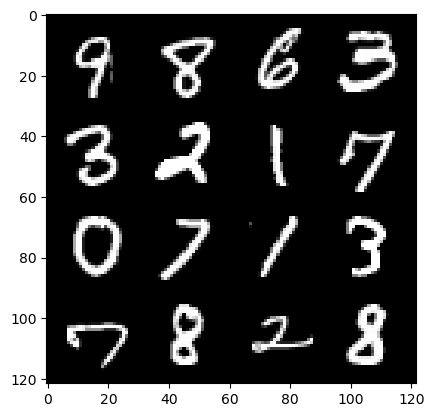

218: step 102300/ Gen loss: 1.6326756087938952/ disc_loss: 0.32127723048130674


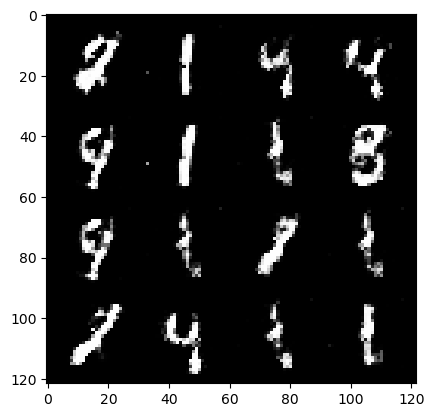

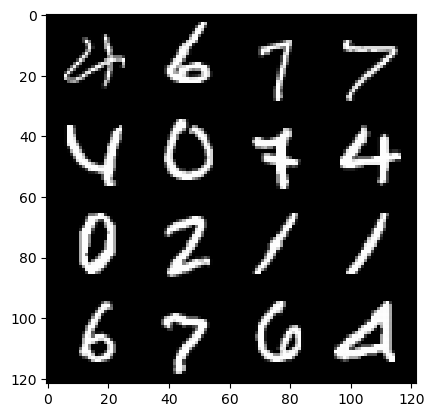

218: step 102600/ Gen loss: 1.6813970446586592/ disc_loss: 0.3120768592754997


  0%|          | 0/469 [00:00<?, ?it/s]

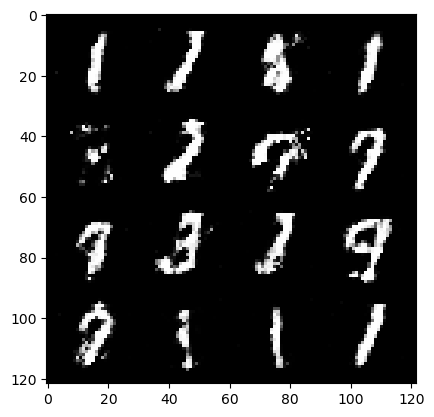

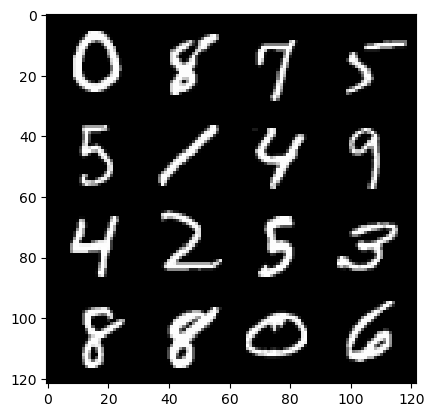

219: step 102900/ Gen loss: 1.719716142018636/ disc_loss: 0.3123298824826872


  0%|          | 0/469 [00:00<?, ?it/s]

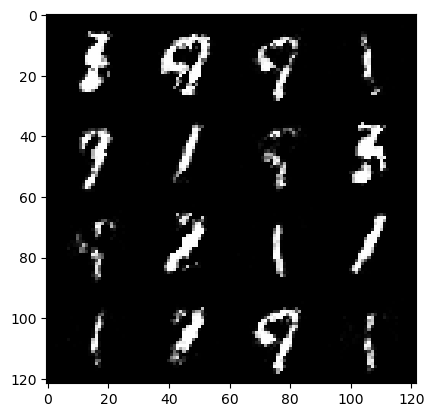

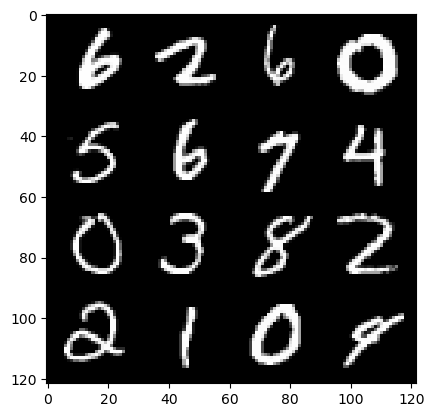

220: step 103200/ Gen loss: 1.8725057518482209/ disc_loss: 0.28344572598735485


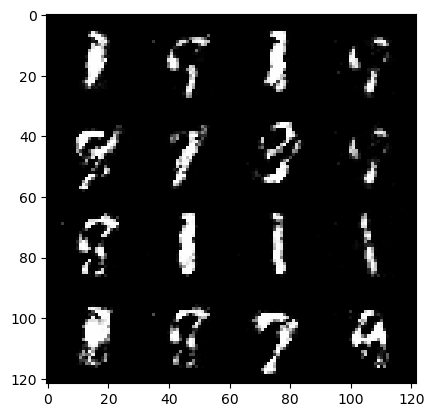

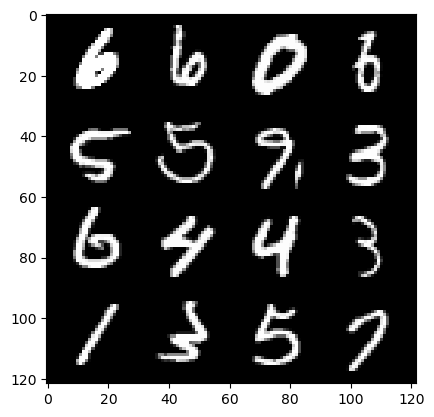

220: step 103500/ Gen loss: 1.8737335038185132/ disc_loss: 0.272557706683874


  0%|          | 0/469 [00:00<?, ?it/s]

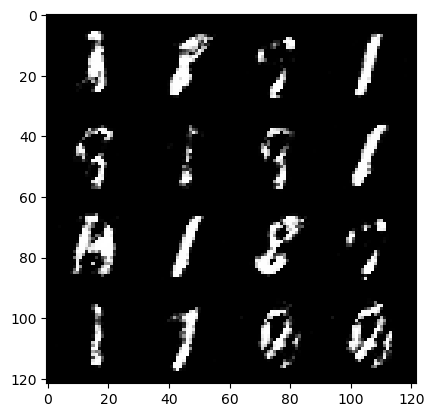

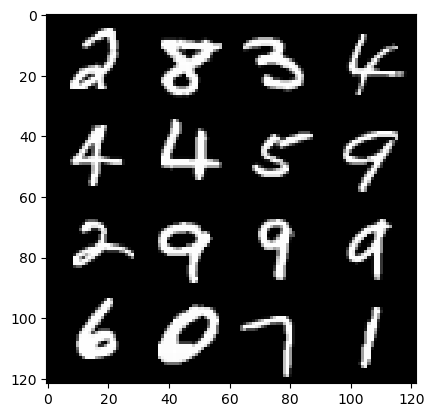

221: step 103800/ Gen loss: 1.7238563215732552/ disc_loss: 0.2977531785766281


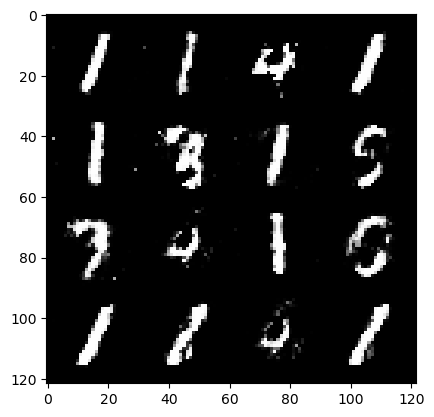

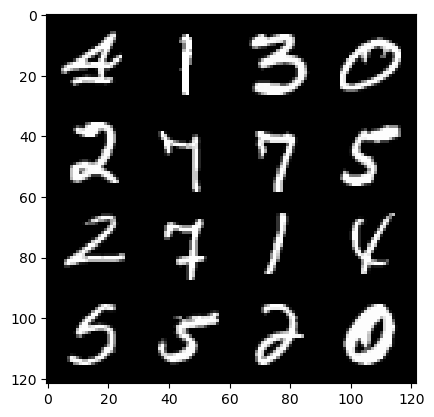

221: step 104100/ Gen loss: 1.9158726163705186/ disc_loss: 0.2742559355497358


  0%|          | 0/469 [00:00<?, ?it/s]

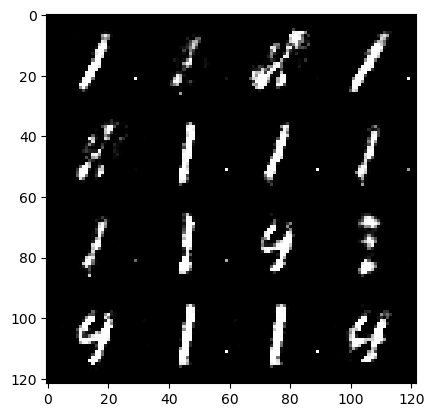

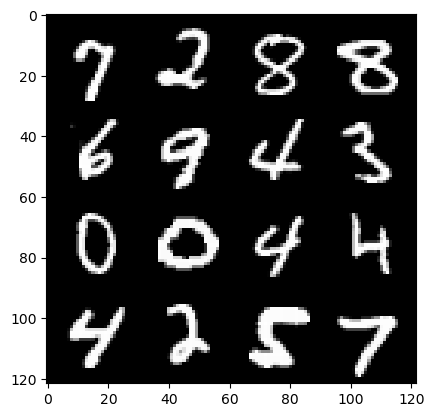

222: step 104400/ Gen loss: 1.5656726789474487/ disc_loss: 0.3811308115224044


  0%|          | 0/469 [00:00<?, ?it/s]

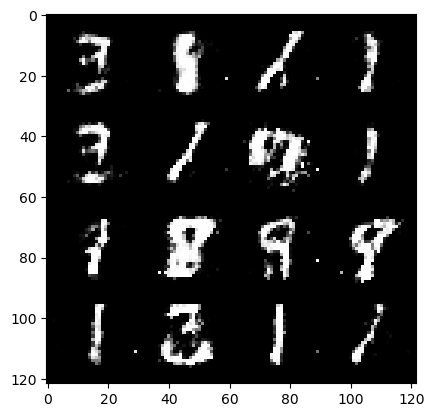

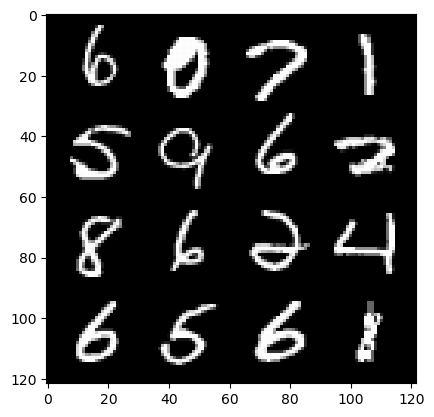

223: step 104700/ Gen loss: 1.3611135156949365/ disc_loss: 0.39128651599089315


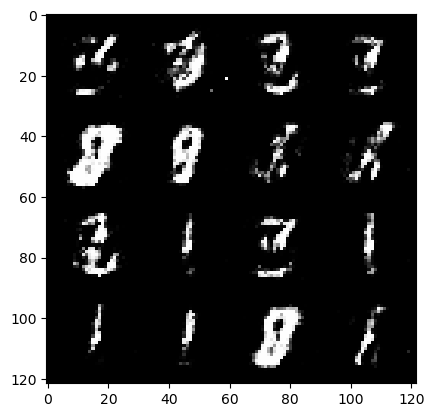

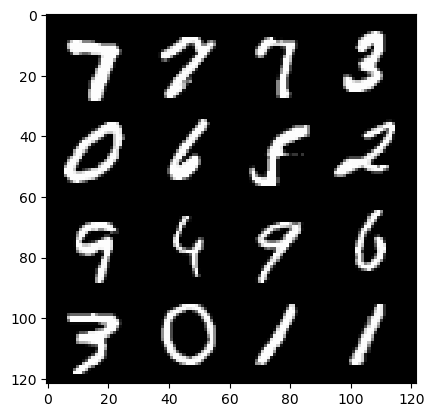

223: step 105000/ Gen loss: 1.3925676886240648/ disc_loss: 0.37929633051157


  0%|          | 0/469 [00:00<?, ?it/s]

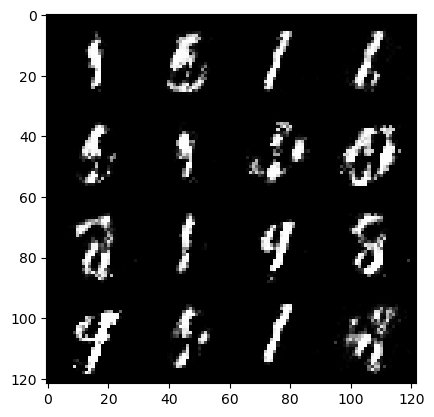

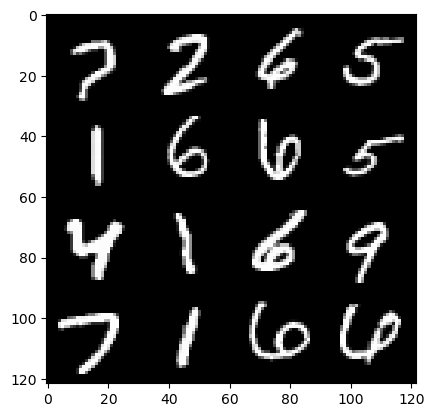

224: step 105300/ Gen loss: 1.3602541327476503/ disc_loss: 0.37818564385175735


  0%|          | 0/469 [00:00<?, ?it/s]

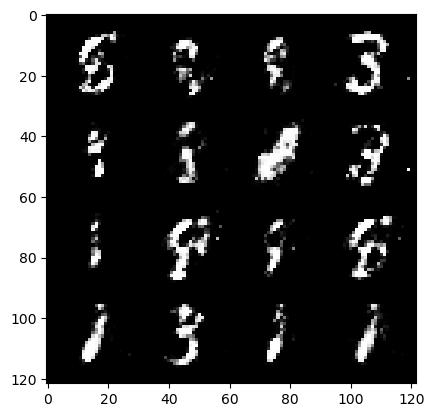

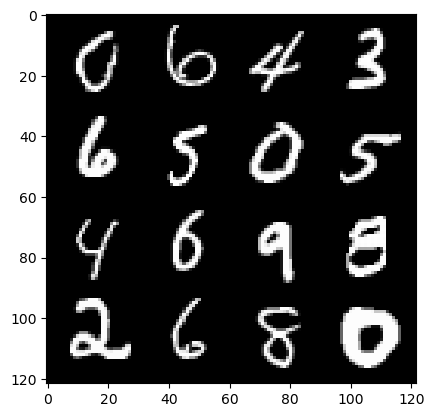

225: step 105600/ Gen loss: 1.5404028832912438/ disc_loss: 0.34225165655215584


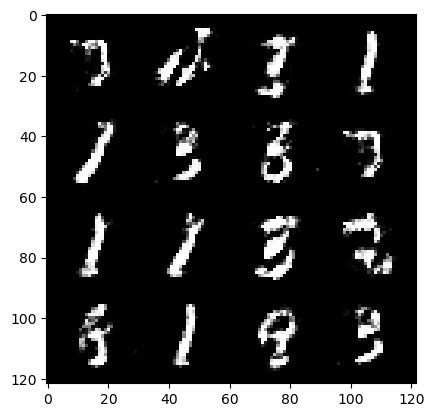

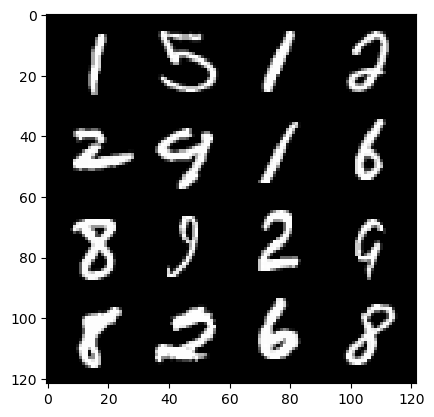

225: step 105900/ Gen loss: 1.650808707475663/ disc_loss: 0.3186214195688567


  0%|          | 0/469 [00:00<?, ?it/s]

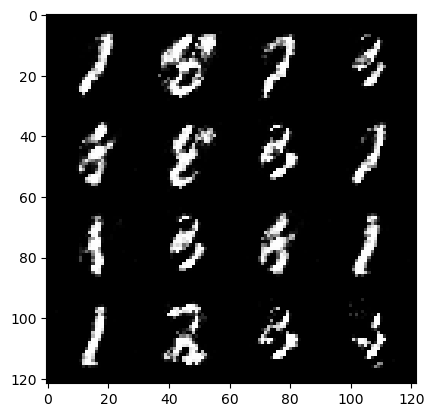

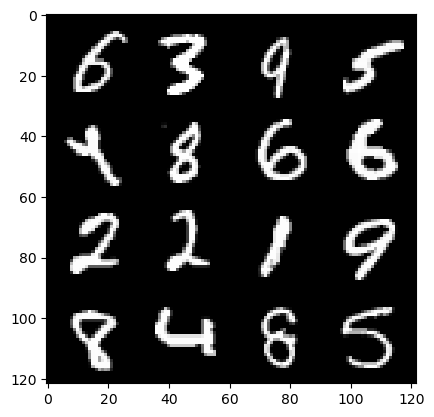

226: step 106200/ Gen loss: 1.6868511235713974/ disc_loss: 0.32703116456667586


  0%|          | 0/469 [00:00<?, ?it/s]

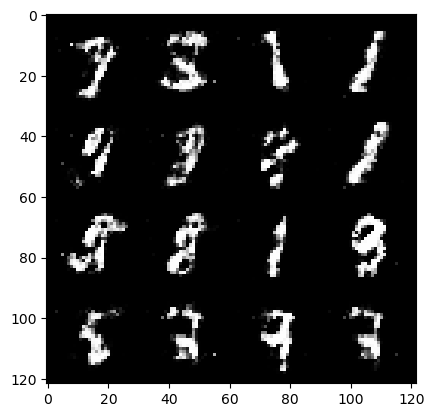

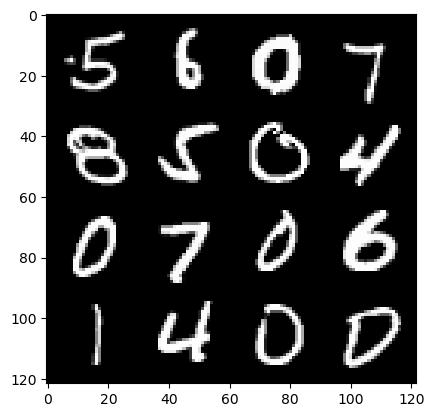

227: step 106500/ Gen loss: 1.819553643465042/ disc_loss: 0.3135300442079704


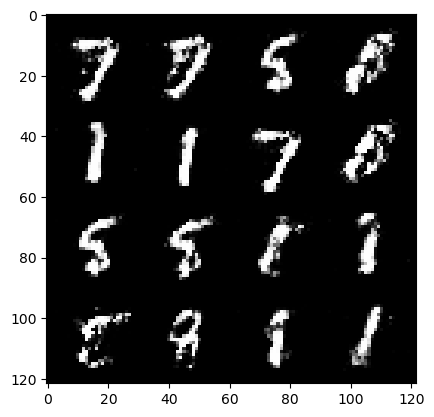

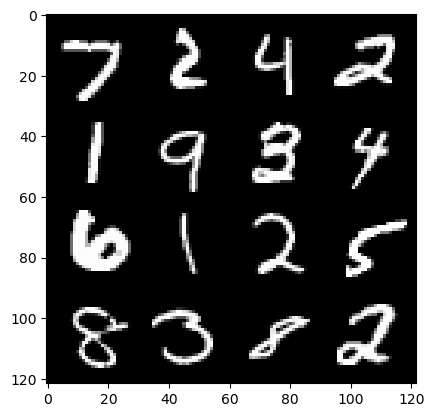

227: step 106800/ Gen loss: 1.7863332351048786/ disc_loss: 0.29618988012274106


  0%|          | 0/469 [00:00<?, ?it/s]

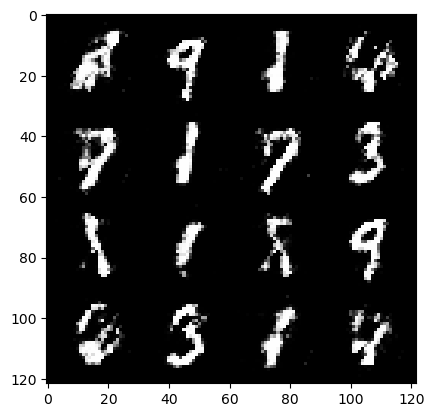

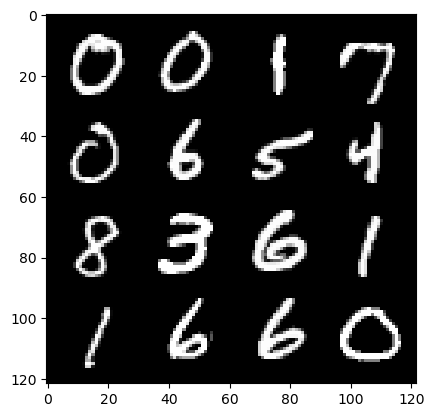

228: step 107100/ Gen loss: 1.7487681400775918/ disc_loss: 0.32105250746011743


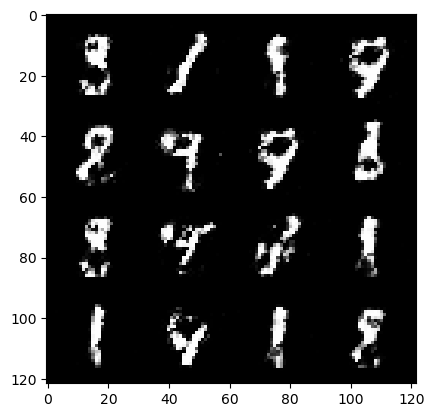

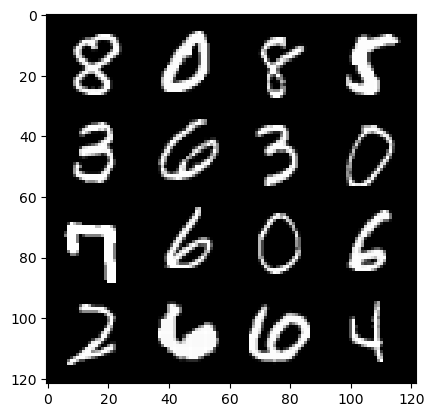

228: step 107400/ Gen loss: 1.8136134902636212/ disc_loss: 0.3336779750386874


  0%|          | 0/469 [00:00<?, ?it/s]

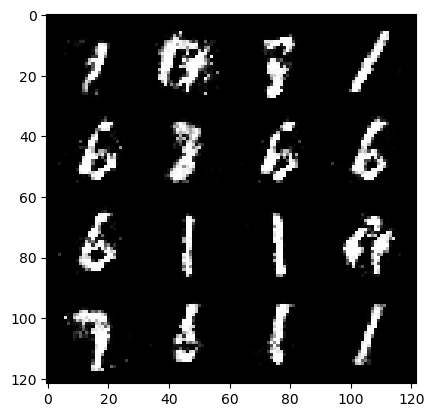

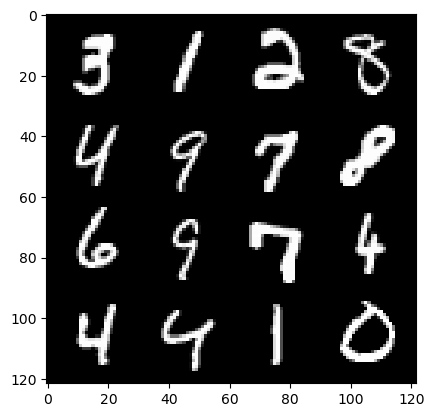

229: step 107700/ Gen loss: 1.984742481311162/ disc_loss: 0.27993766218423843


  0%|          | 0/469 [00:00<?, ?it/s]

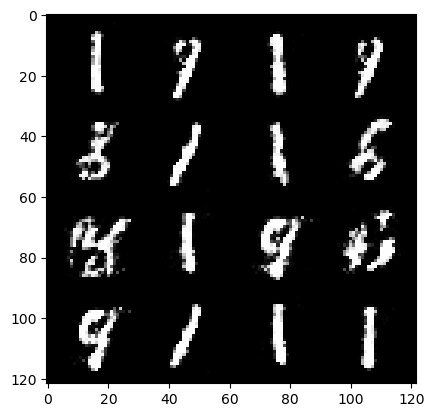

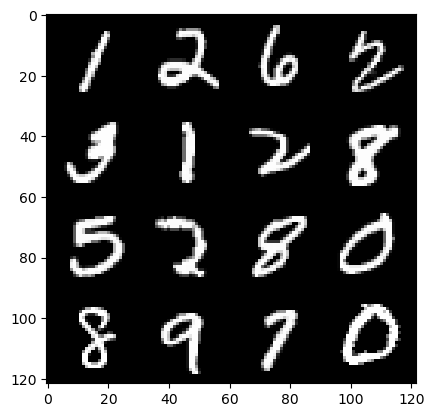

230: step 108000/ Gen loss: 2.0301636242866503/ disc_loss: 0.27949298416574797


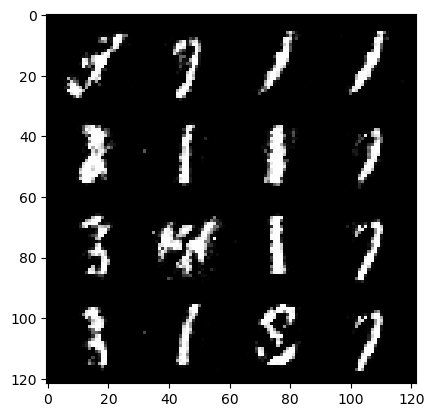

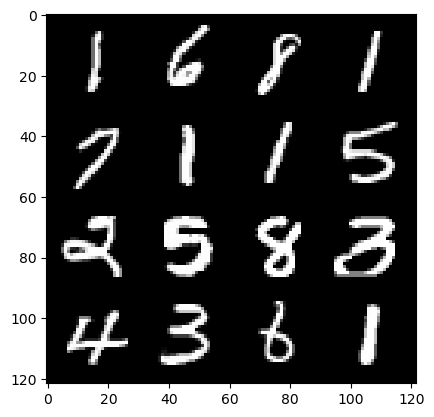

230: step 108300/ Gen loss: 1.9004760773976648/ disc_loss: 0.30200013379255947


  0%|          | 0/469 [00:00<?, ?it/s]

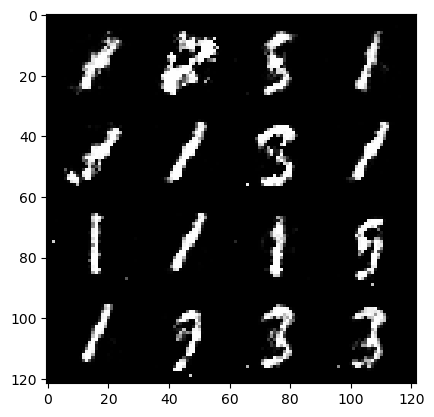

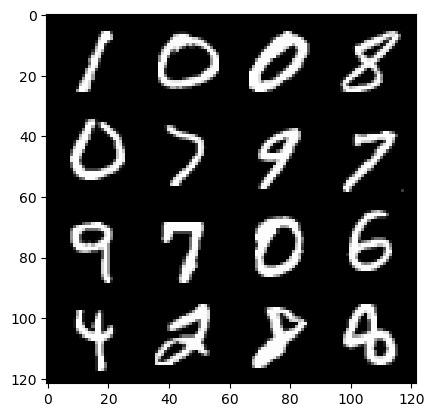

231: step 108600/ Gen loss: 1.7612079207102476/ disc_loss: 0.31596572036544496


  0%|          | 0/469 [00:00<?, ?it/s]

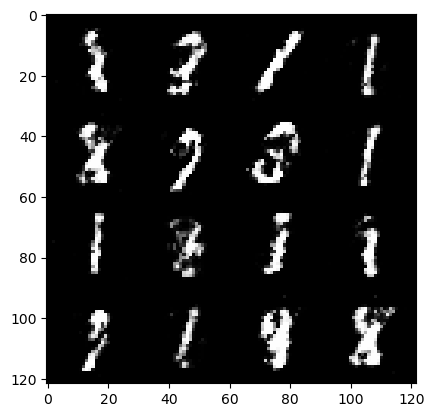

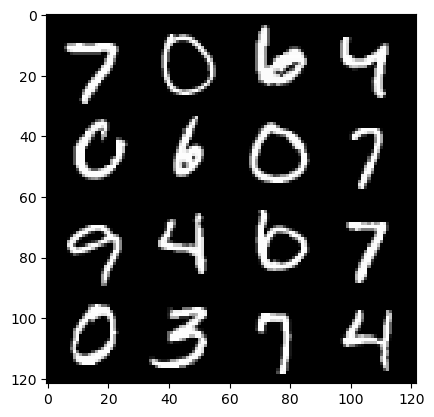

232: step 108900/ Gen loss: 1.8516743075847641/ disc_loss: 0.28865320151050894


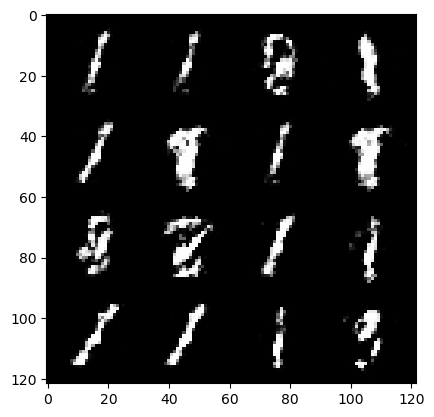

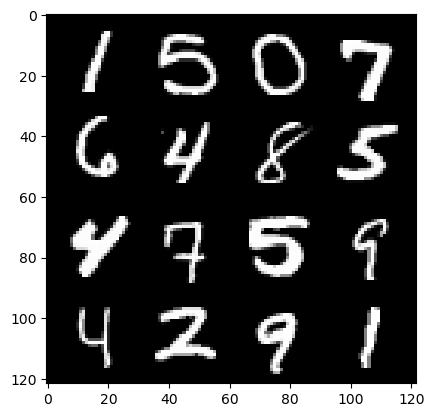

232: step 109200/ Gen loss: 1.822401083310445/ disc_loss: 0.29938205237189924


  0%|          | 0/469 [00:00<?, ?it/s]

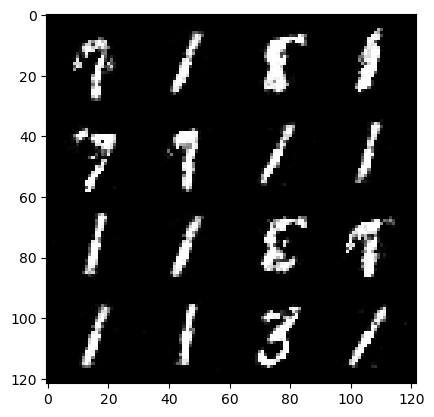

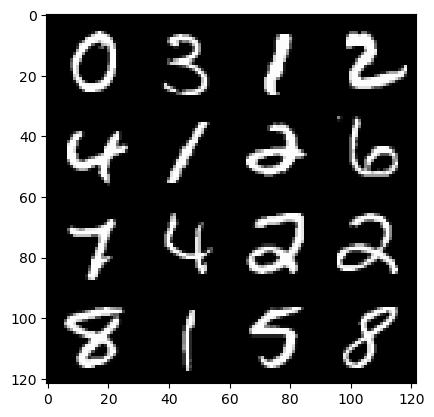

233: step 109500/ Gen loss: 1.9302418645222983/ disc_loss: 0.27599256222446766


  0%|          | 0/469 [00:00<?, ?it/s]

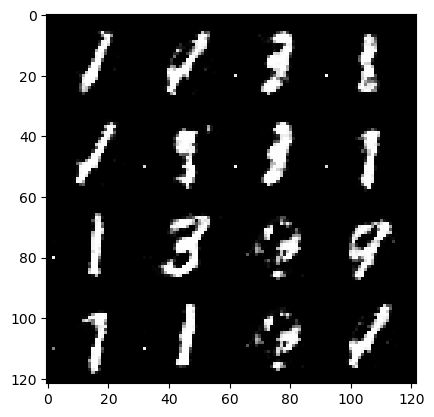

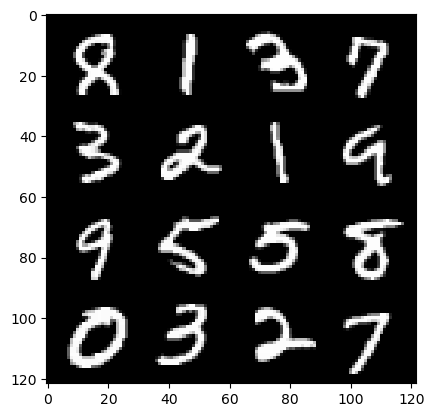

234: step 109800/ Gen loss: 1.7566103752454123/ disc_loss: 0.3262571468949318


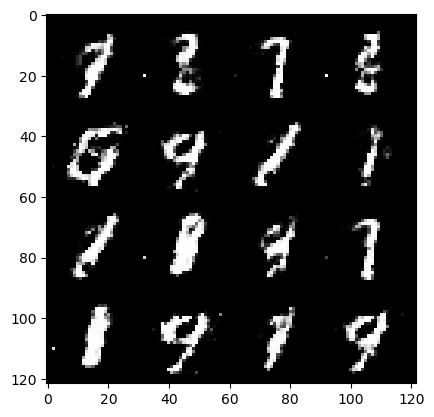

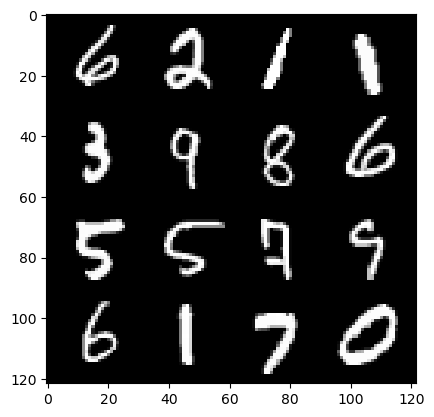

234: step 110100/ Gen loss: 1.654099618991216/ disc_loss: 0.3215567227701348


  0%|          | 0/469 [00:00<?, ?it/s]

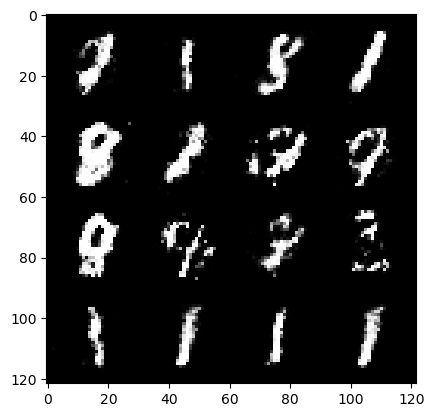

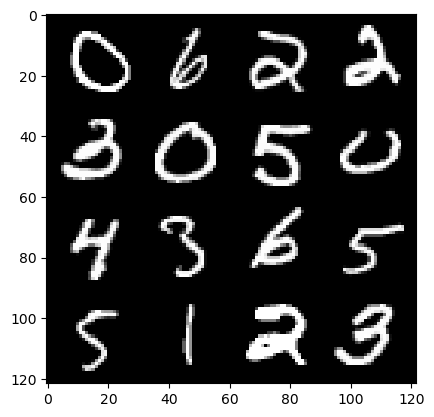

235: step 110400/ Gen loss: 1.8059617809454593/ disc_loss: 0.322197719713052


  0%|          | 0/469 [00:00<?, ?it/s]

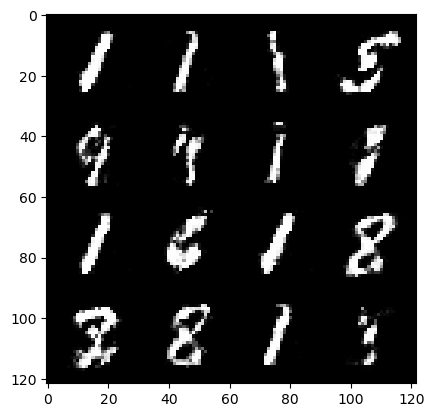

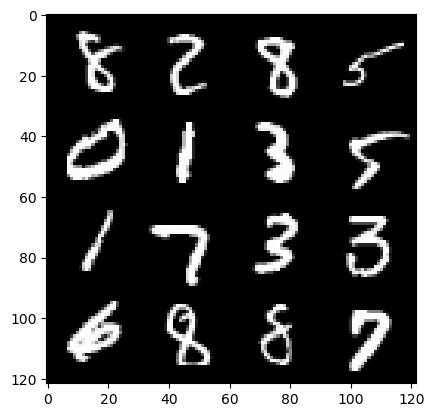

236: step 110700/ Gen loss: 1.7963931449254353/ disc_loss: 0.2969683107733727


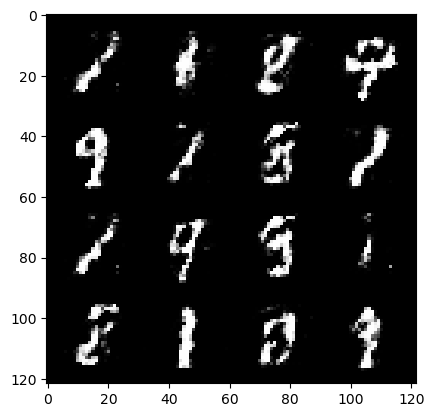

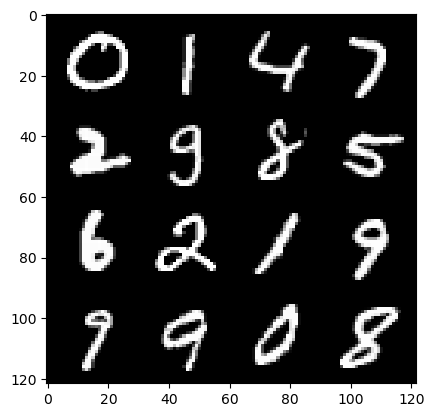

236: step 111000/ Gen loss: 1.9661536856492365/ disc_loss: 0.2708013251920541


  0%|          | 0/469 [00:00<?, ?it/s]

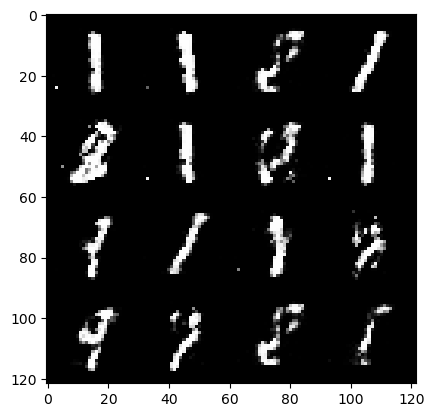

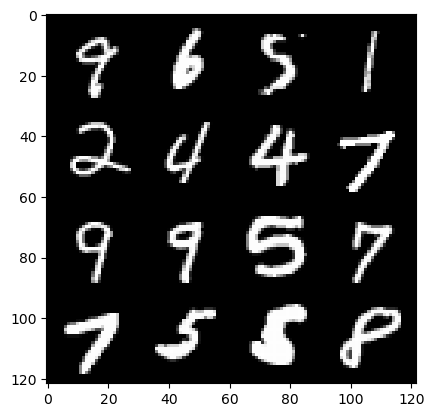

237: step 111300/ Gen loss: 2.198937346935273/ disc_loss: 0.2563311666746935


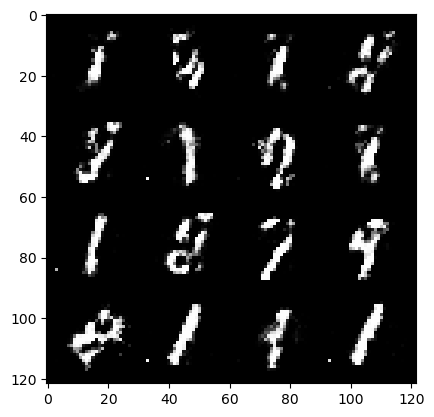

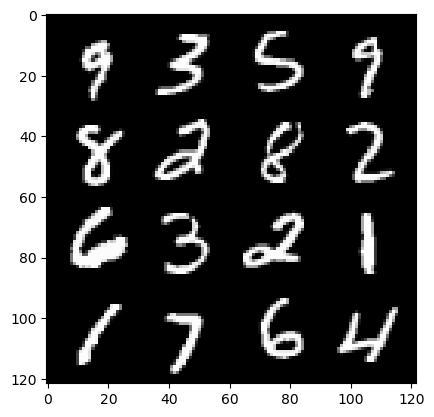

237: step 111600/ Gen loss: 1.8525233666102094/ disc_loss: 0.27359453678131096


  0%|          | 0/469 [00:00<?, ?it/s]

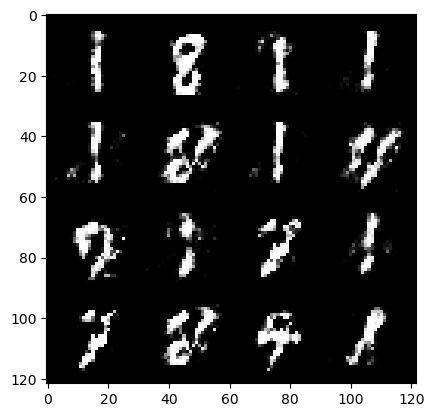

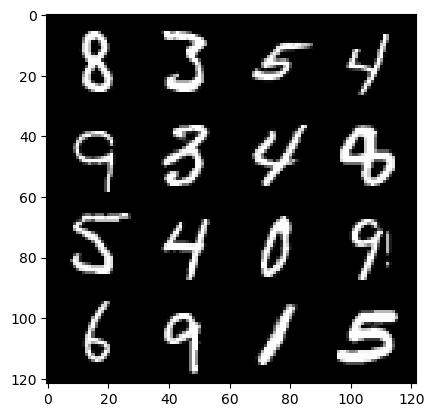

238: step 111900/ Gen loss: 1.833504256407419/ disc_loss: 0.2890768980483213


  0%|          | 0/469 [00:00<?, ?it/s]

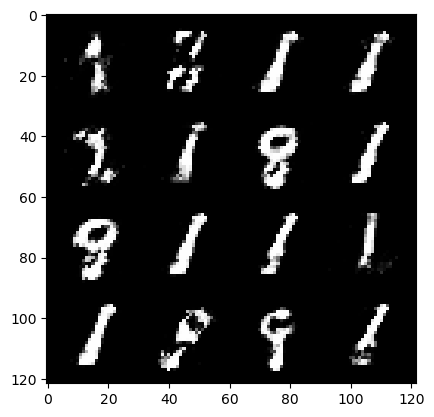

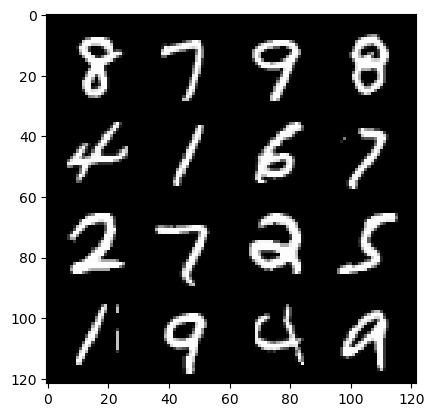

239: step 112200/ Gen loss: 2.0261185252666483/ disc_loss: 0.2648558564980825


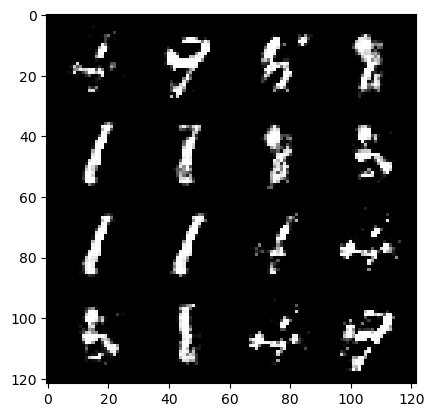

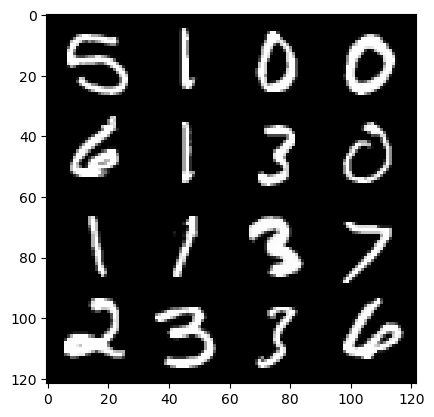

239: step 112500/ Gen loss: 2.0764333013693492/ disc_loss: 0.25520798330505695


  0%|          | 0/469 [00:00<?, ?it/s]

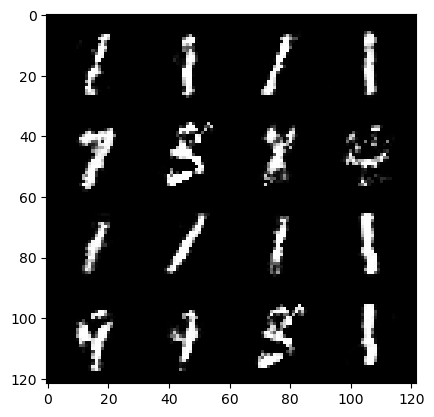

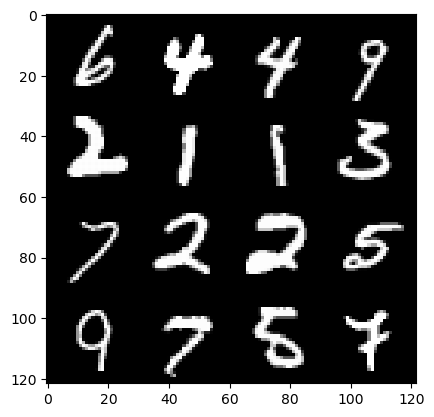

240: step 112800/ Gen loss: 1.889071427186329/ disc_loss: 0.286504150032997


  0%|          | 0/469 [00:00<?, ?it/s]

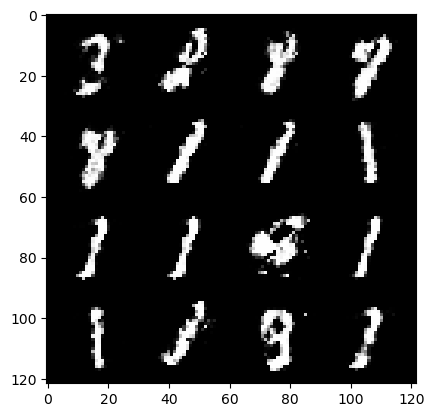

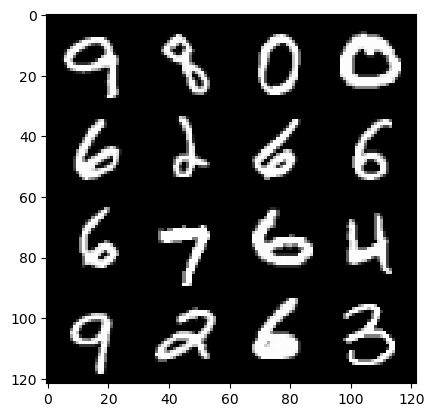

241: step 113100/ Gen loss: 1.9254137639204671/ disc_loss: 0.28332357441385597


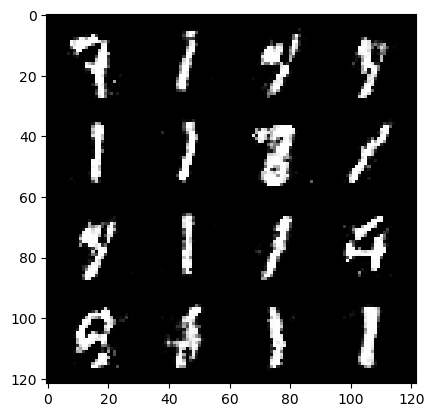

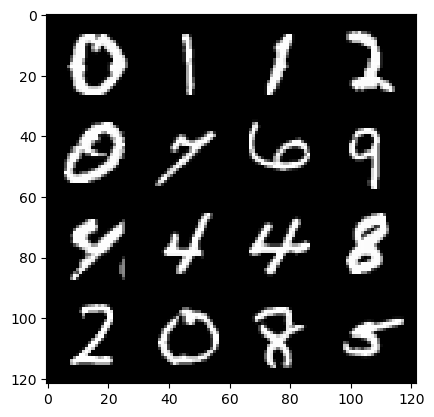

241: step 113400/ Gen loss: 1.952167680263518/ disc_loss: 0.28637753193577137


  0%|          | 0/469 [00:00<?, ?it/s]

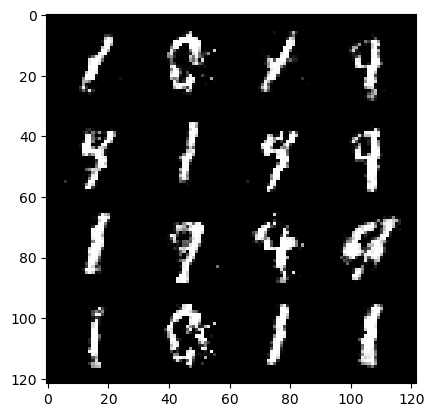

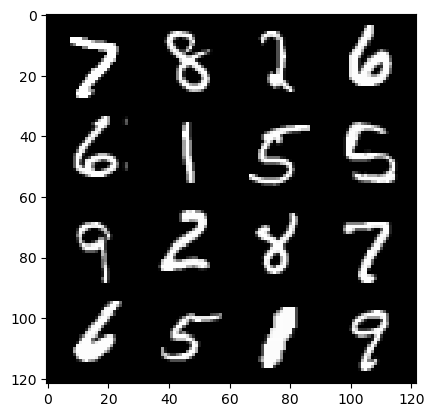

242: step 113700/ Gen loss: 1.8994980458418533/ disc_loss: 0.285012995103995


  0%|          | 0/469 [00:00<?, ?it/s]

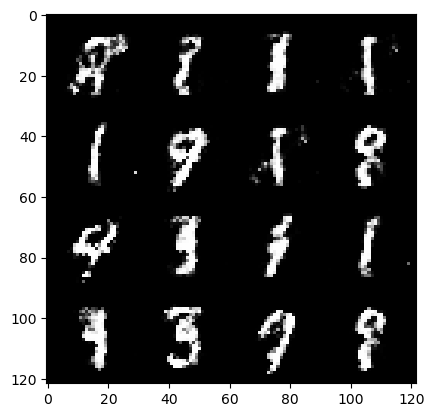

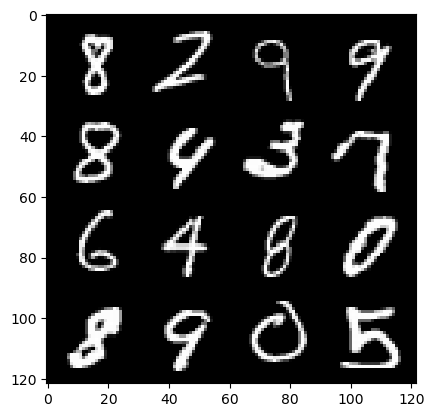

243: step 114000/ Gen loss: 1.9289458954334244/ disc_loss: 0.283366601318121


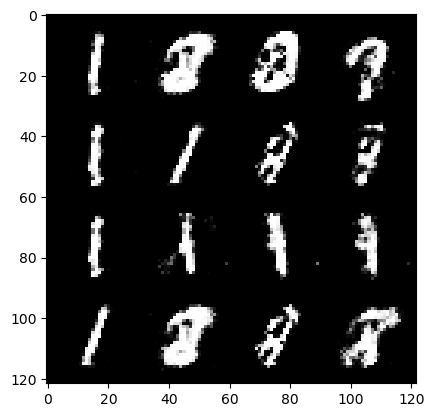

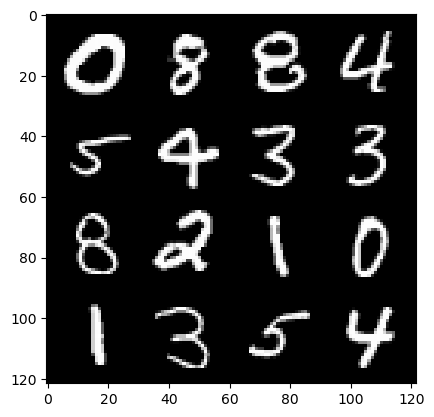

243: step 114300/ Gen loss: 1.815363344748816/ disc_loss: 0.30203083152572313


  0%|          | 0/469 [00:00<?, ?it/s]

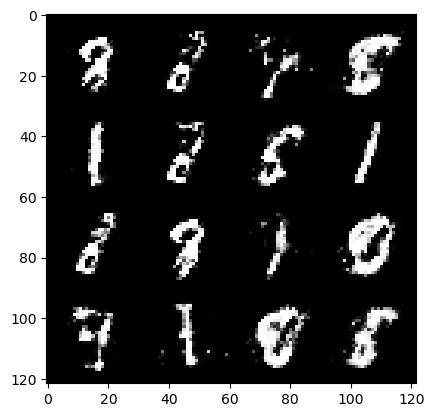

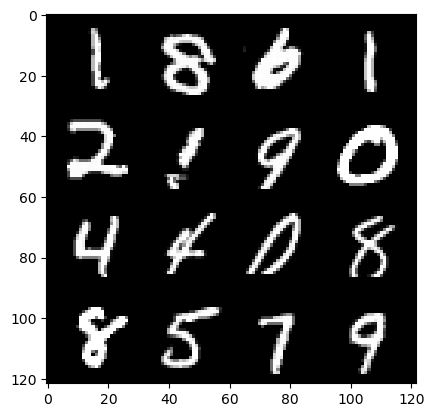

244: step 114600/ Gen loss: 1.9651439543565117/ disc_loss: 0.2684922220806282


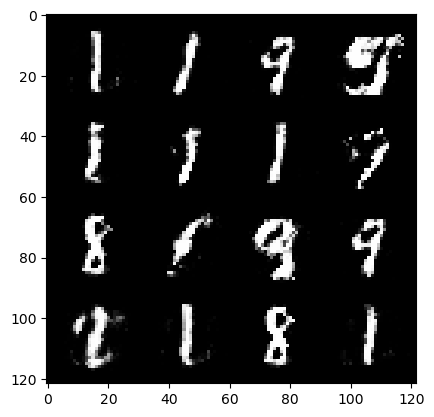

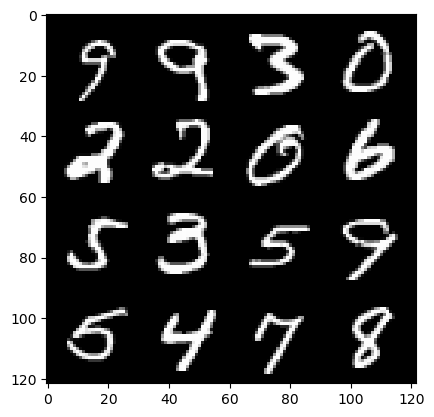

244: step 114900/ Gen loss: 2.016169481674831/ disc_loss: 0.26341480731964106


  0%|          | 0/469 [00:00<?, ?it/s]

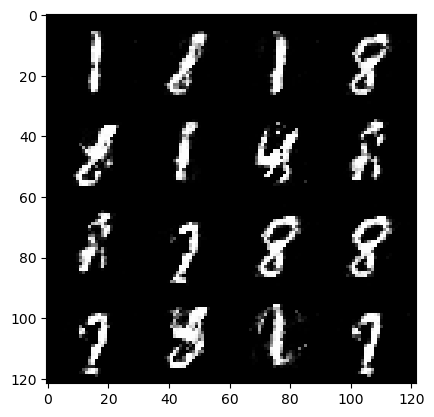

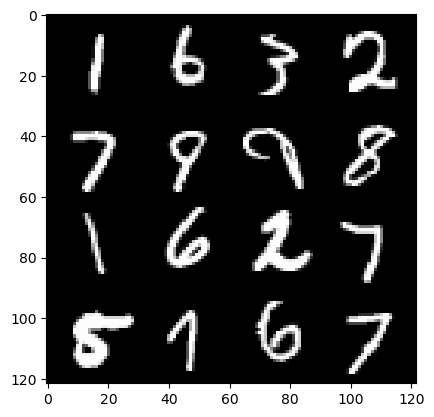

245: step 115200/ Gen loss: 2.0890308042367294/ disc_loss: 0.25699174786607426


  0%|          | 0/469 [00:00<?, ?it/s]

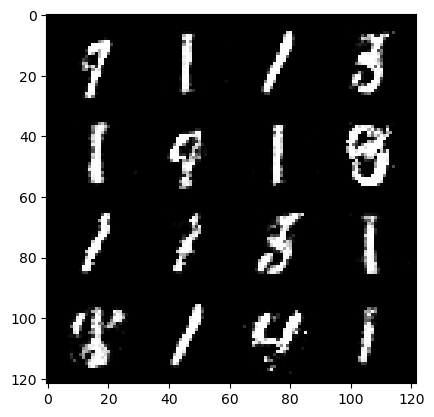

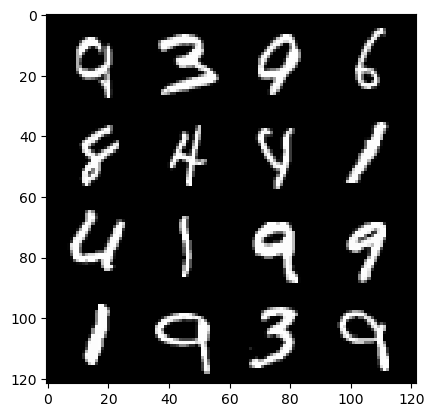

246: step 115500/ Gen loss: 2.0531498889128366/ disc_loss: 0.2588506487011909


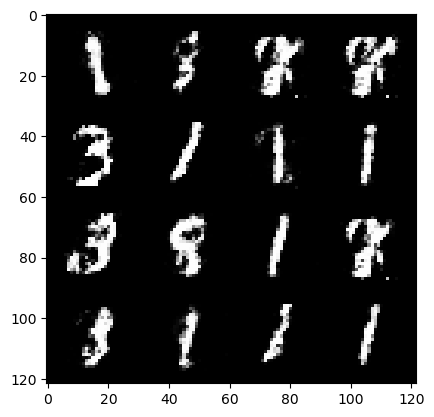

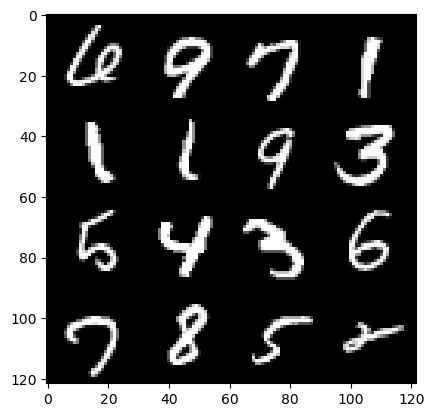

246: step 115800/ Gen loss: 1.9516687472661332/ disc_loss: 0.29137098724643407


  0%|          | 0/469 [00:00<?, ?it/s]

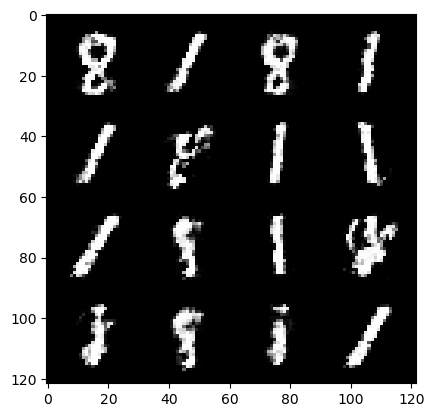

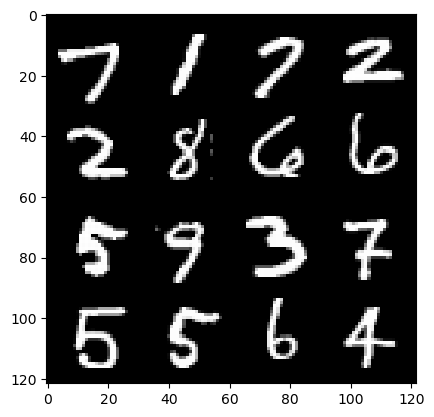

247: step 116100/ Gen loss: 1.833888121445975/ disc_loss: 0.3012251477440199


  0%|          | 0/469 [00:00<?, ?it/s]

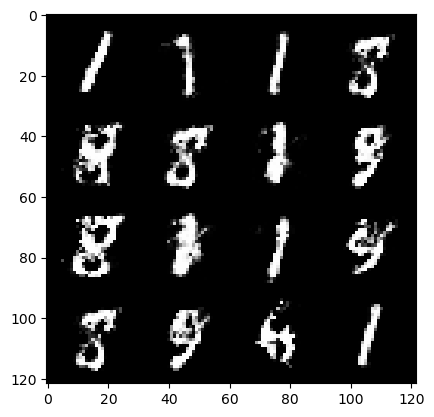

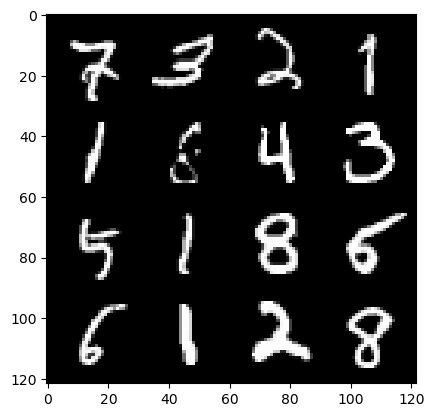

248: step 116400/ Gen loss: 1.845141456127166/ disc_loss: 0.3035338472326598


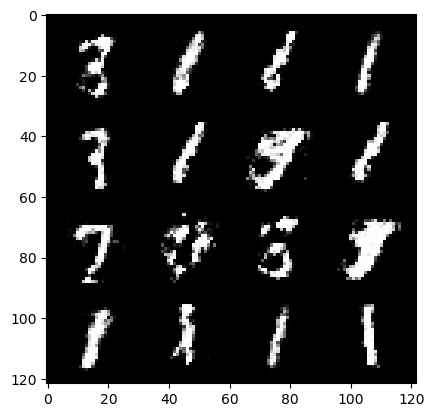

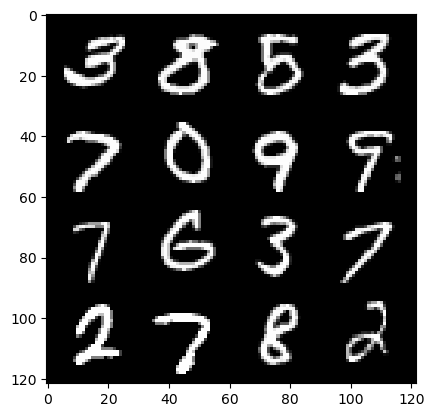

248: step 116700/ Gen loss: 1.9087441170215607/ disc_loss: 0.2982241377234461


  0%|          | 0/469 [00:00<?, ?it/s]

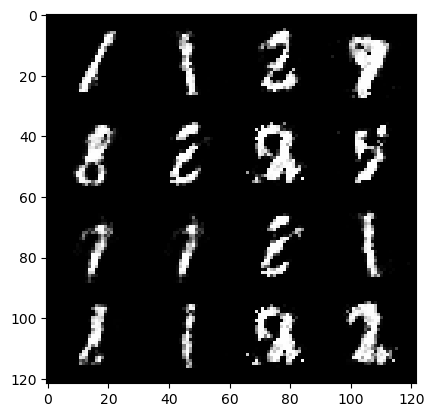

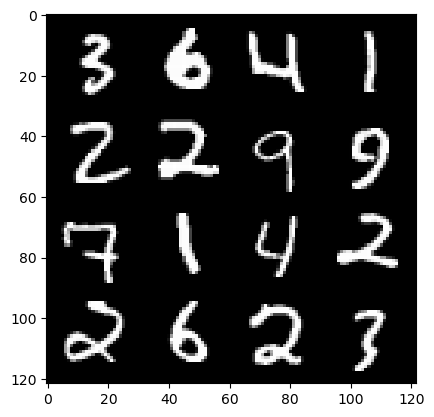

249: step 117000/ Gen loss: 1.9595629187424992/ disc_loss: 0.2793934590617817


  0%|          | 0/469 [00:00<?, ?it/s]

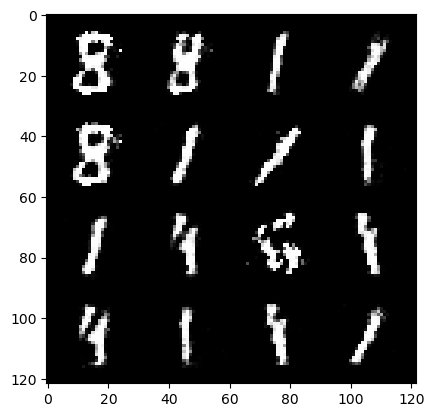

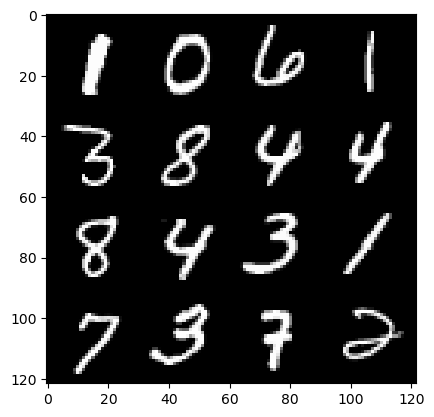

250: step 117300/ Gen loss: 1.9963286546866104/ disc_loss: 0.2885679678618909


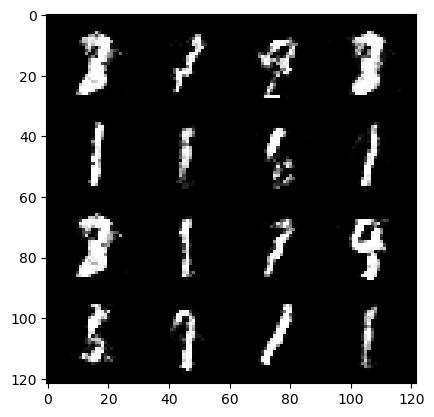

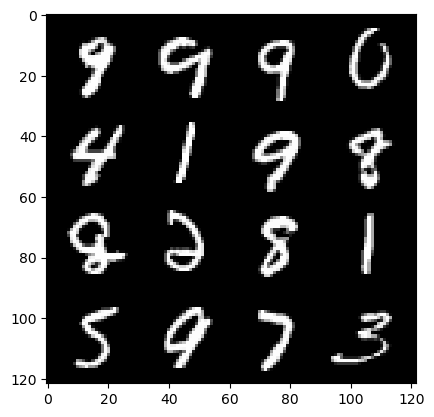

250: step 117600/ Gen loss: 1.9382434475421915/ disc_loss: 0.27267480338613187


  0%|          | 0/469 [00:00<?, ?it/s]

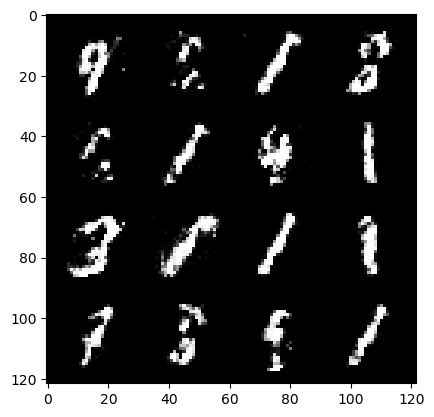

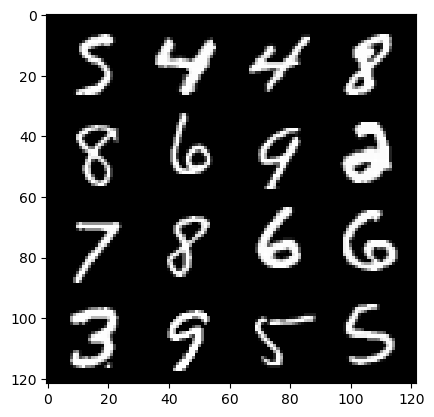

251: step 117900/ Gen loss: 1.9825626353422798/ disc_loss: 0.26699512854218466


  0%|          | 0/469 [00:00<?, ?it/s]

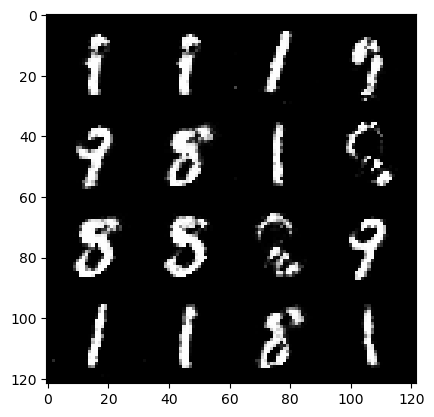

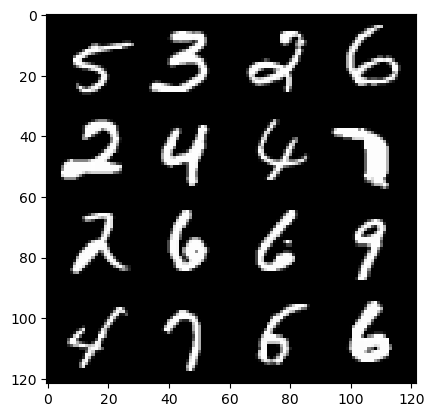

252: step 118200/ Gen loss: 1.8866084349155434/ disc_loss: 0.3019993182023366


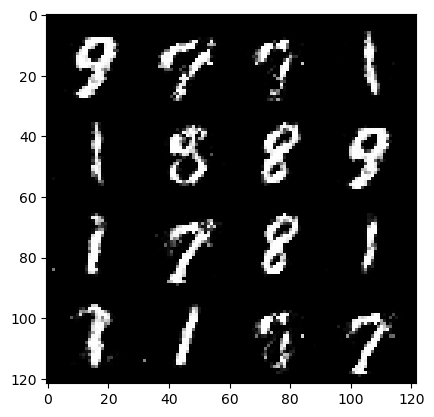

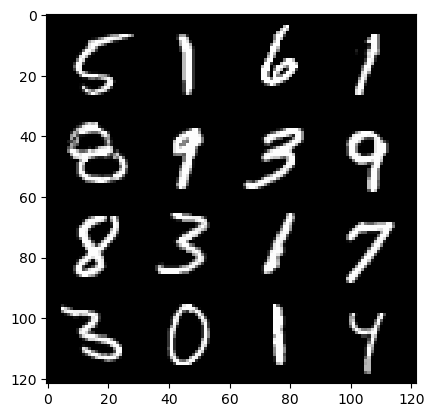

252: step 118500/ Gen loss: 1.789609080950419/ disc_loss: 0.3072892488042514


  0%|          | 0/469 [00:00<?, ?it/s]

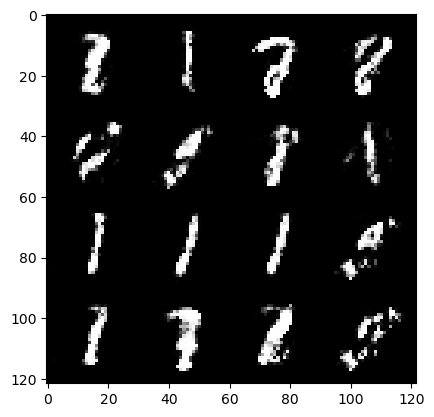

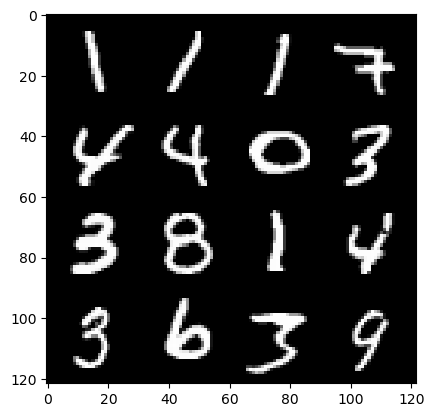

253: step 118800/ Gen loss: 1.94858438372612/ disc_loss: 0.2771653768420223


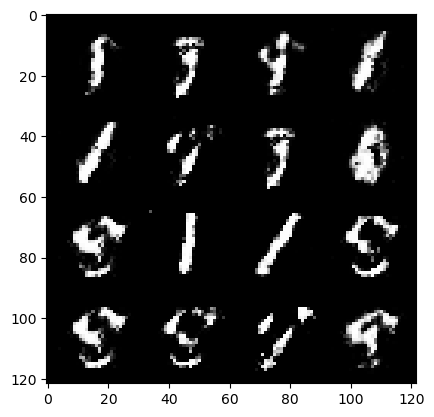

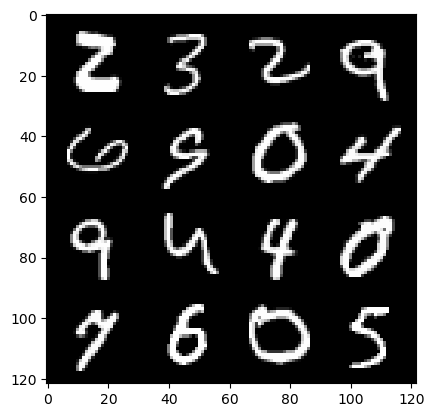

253: step 119100/ Gen loss: 2.0620771280924504/ disc_loss: 0.25678932035962737


  0%|          | 0/469 [00:00<?, ?it/s]

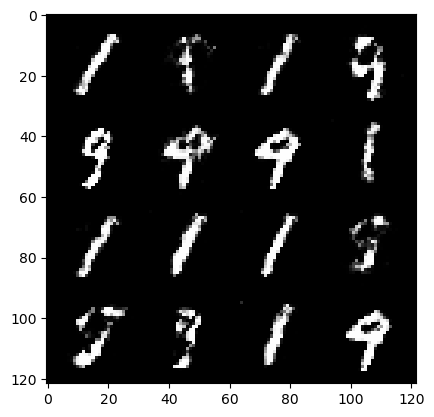

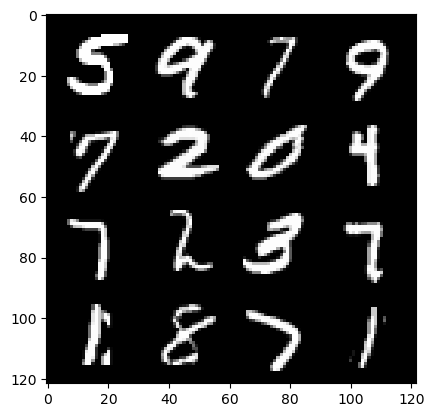

254: step 119400/ Gen loss: 1.9306715730826063/ disc_loss: 0.27676051264007867


  0%|          | 0/469 [00:00<?, ?it/s]

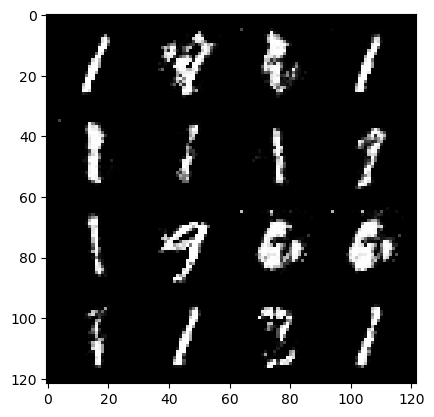

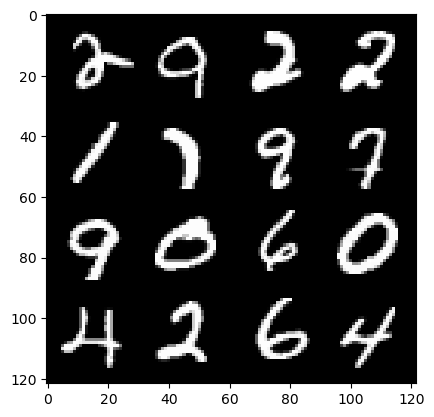

255: step 119700/ Gen loss: 1.931100964943567/ disc_loss: 0.27366227264205606


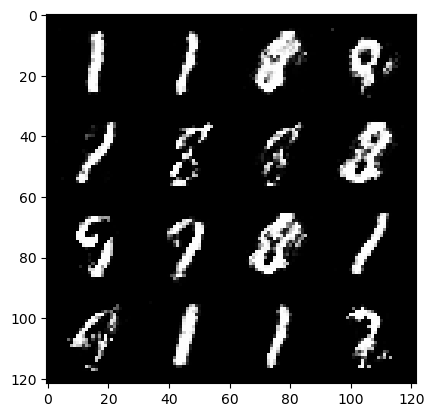

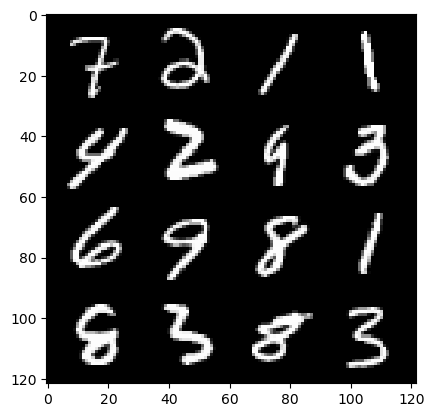

255: step 120000/ Gen loss: 2.0096136780579896/ disc_loss: 0.2632866923014323


  0%|          | 0/469 [00:00<?, ?it/s]

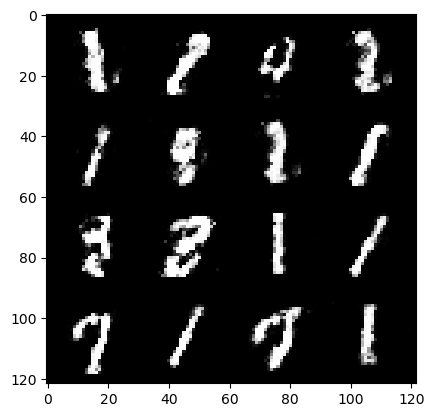

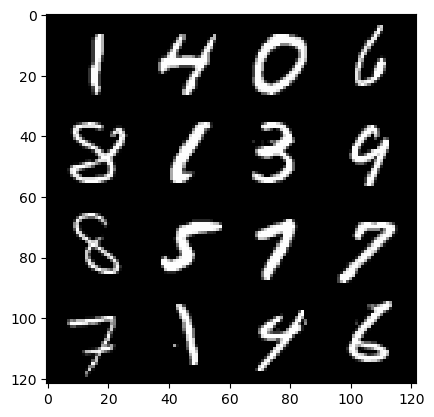

256: step 120300/ Gen loss: 1.977165846824646/ disc_loss: 0.2795732635756335


  0%|          | 0/469 [00:00<?, ?it/s]

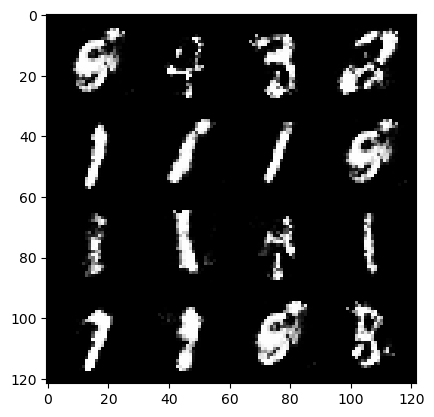

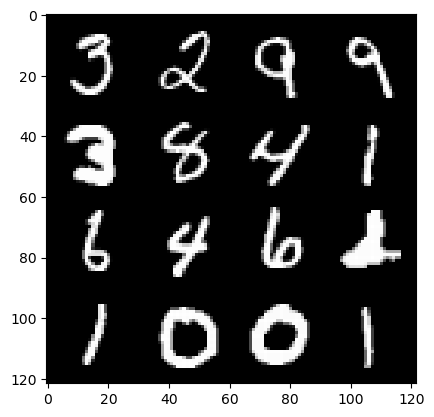

257: step 120600/ Gen loss: 1.858622837464014/ disc_loss: 0.3176311640938123


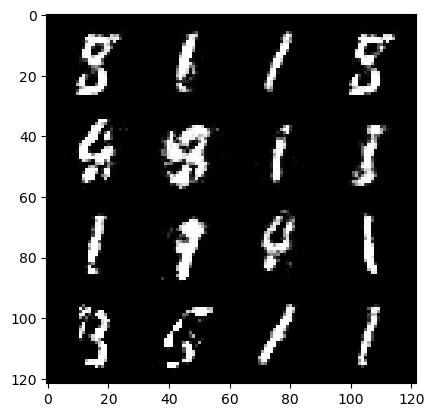

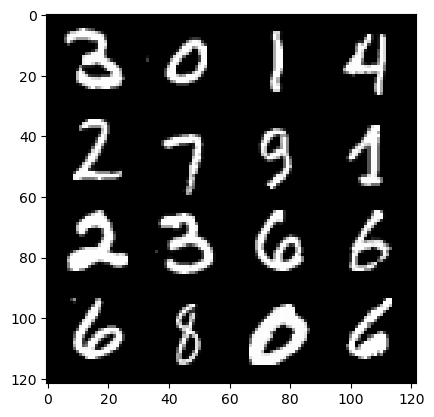

257: step 120900/ Gen loss: 1.8692862149079654/ disc_loss: 0.2971915738781293


  0%|          | 0/469 [00:00<?, ?it/s]

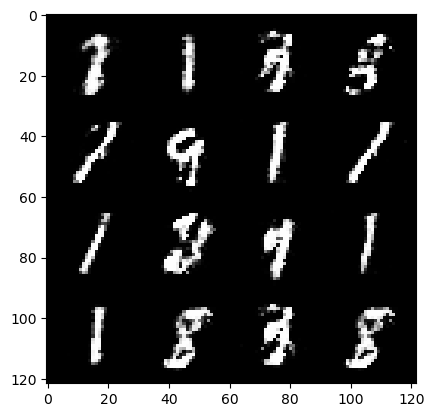

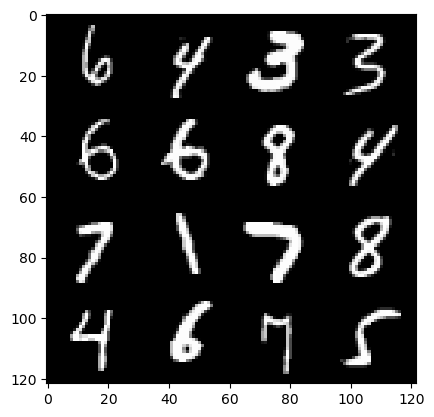

258: step 121200/ Gen loss: 1.928156559069953/ disc_loss: 0.27445728734135616


  0%|          | 0/469 [00:00<?, ?it/s]

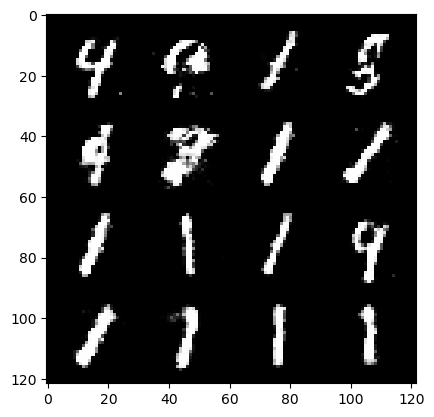

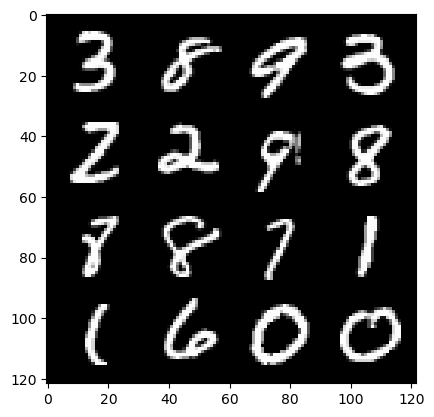

259: step 121500/ Gen loss: 1.8795632306734715/ disc_loss: 0.2965612138311067


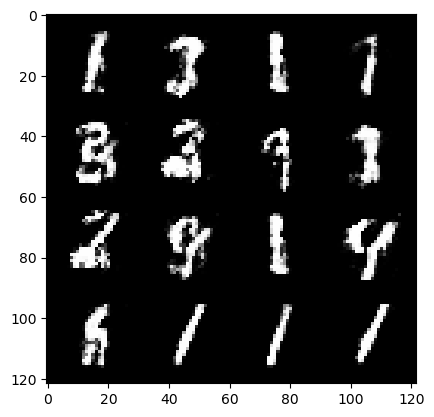

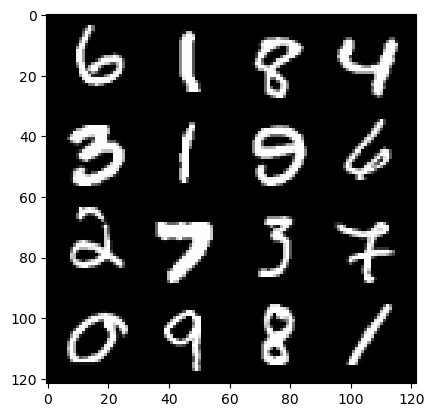

259: step 121800/ Gen loss: 1.8889130735397328/ disc_loss: 0.27935545558730757


  0%|          | 0/469 [00:00<?, ?it/s]

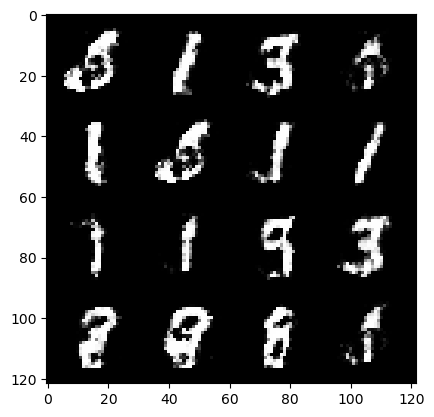

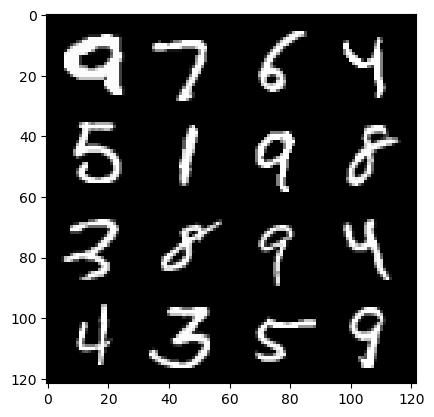

260: step 122100/ Gen loss: 2.0775990041097017/ disc_loss: 0.2639380113780499


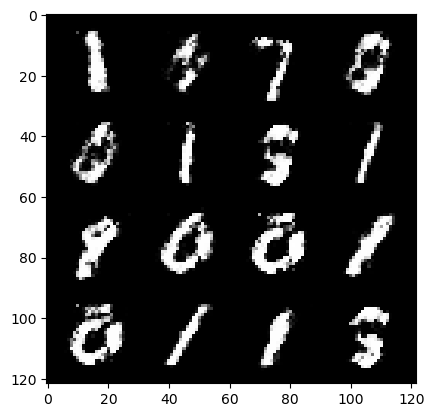

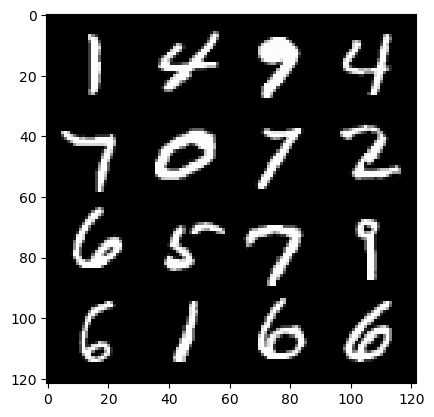

260: step 122400/ Gen loss: 1.9564448650677992/ disc_loss: 0.2981041239698724


  0%|          | 0/469 [00:00<?, ?it/s]

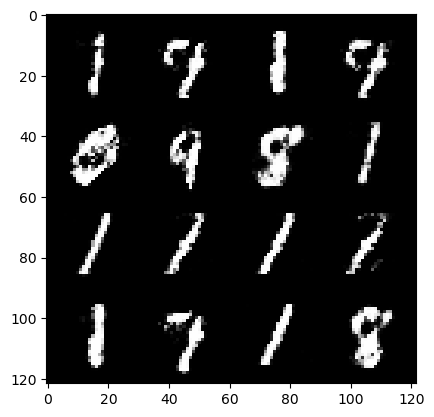

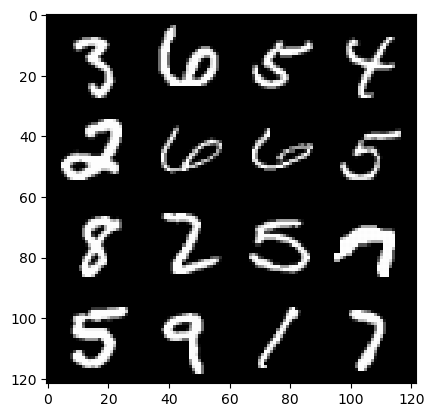

261: step 122700/ Gen loss: 1.8548323194185883/ disc_loss: 0.3055641990900039


  0%|          | 0/469 [00:00<?, ?it/s]

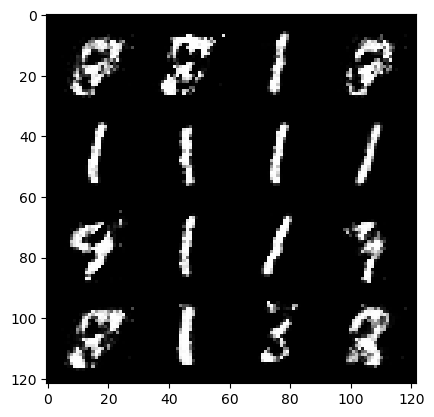

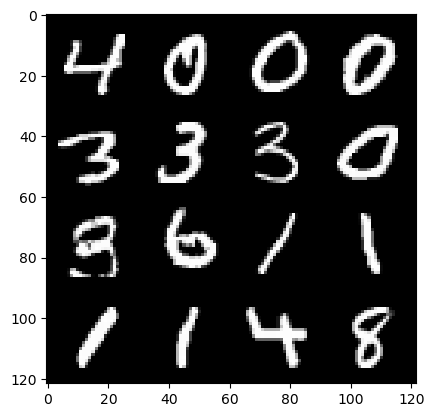

262: step 123000/ Gen loss: 1.949844816128413/ disc_loss: 0.29389968479673073


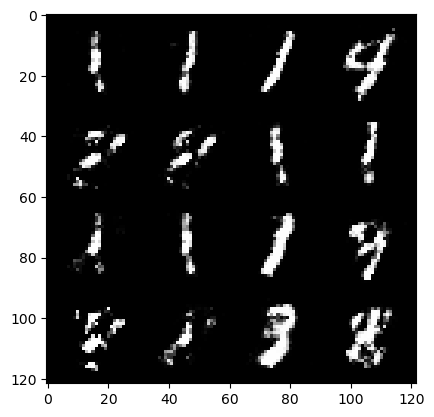

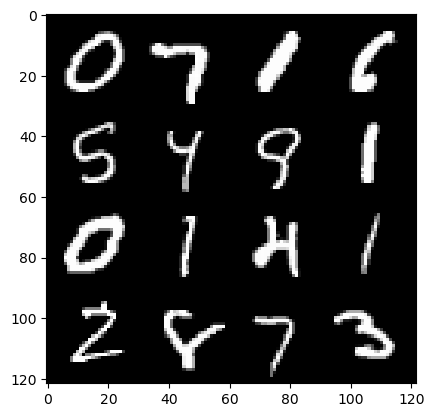

262: step 123300/ Gen loss: 1.9738984421888983/ disc_loss: 0.2887177057067554


  0%|          | 0/469 [00:00<?, ?it/s]

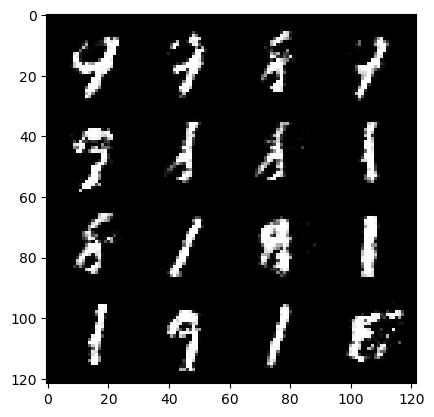

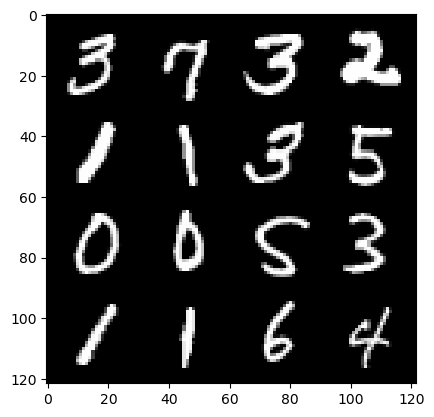

263: step 123600/ Gen loss: 1.9300549983978281/ disc_loss: 0.2764628789325555


  0%|          | 0/469 [00:00<?, ?it/s]

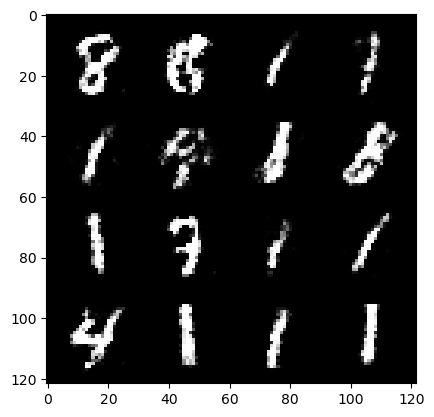

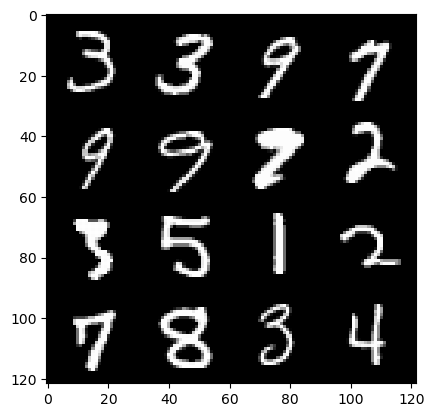

264: step 123900/ Gen loss: 1.9352057770887998/ disc_loss: 0.2982175162931284


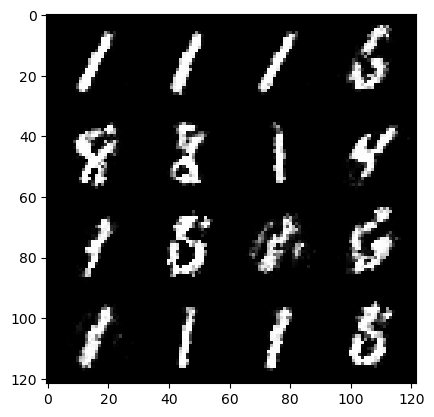

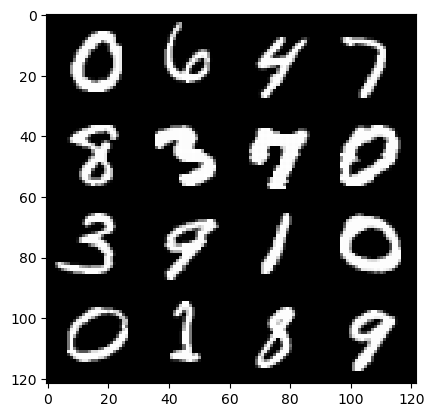

264: step 124200/ Gen loss: 1.8575722738107039/ disc_loss: 0.3086441892385482


  0%|          | 0/469 [00:00<?, ?it/s]

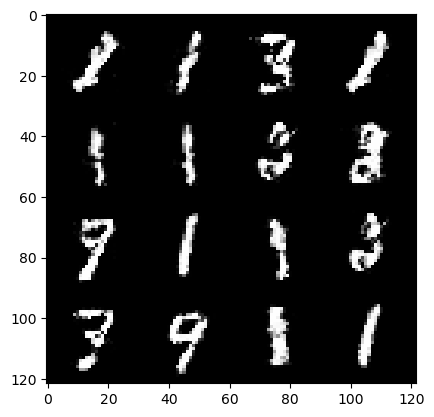

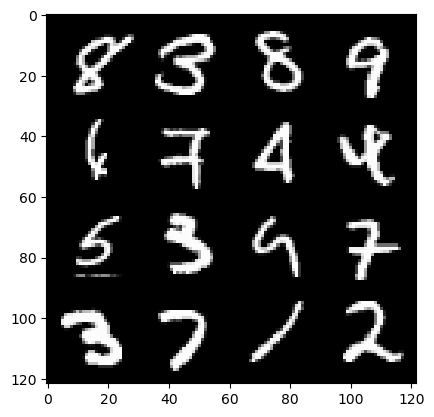

265: step 124500/ Gen loss: 1.7720183726151775/ disc_loss: 0.3137471851209797


  0%|          | 0/469 [00:00<?, ?it/s]

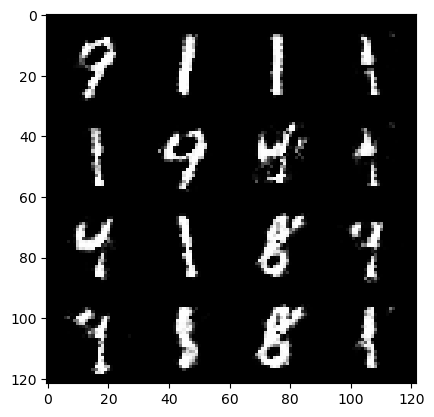

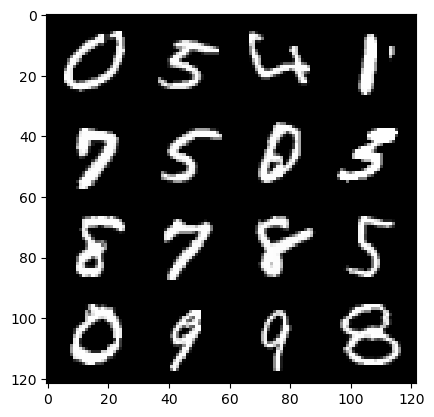

266: step 124800/ Gen loss: 1.8020187278588604/ disc_loss: 0.312027148505052


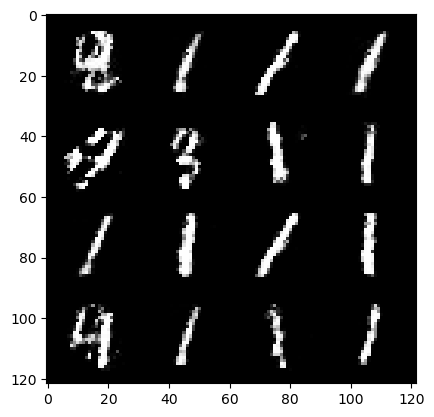

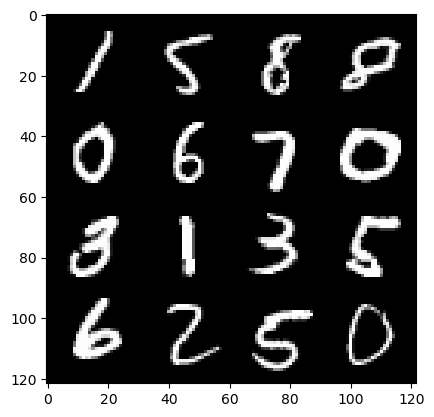

266: step 125100/ Gen loss: 1.7688931095600136/ disc_loss: 0.3089053147534531


  0%|          | 0/469 [00:00<?, ?it/s]

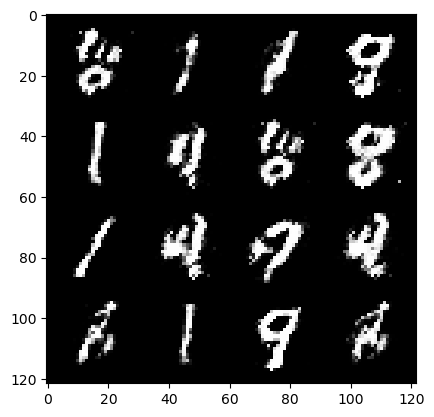

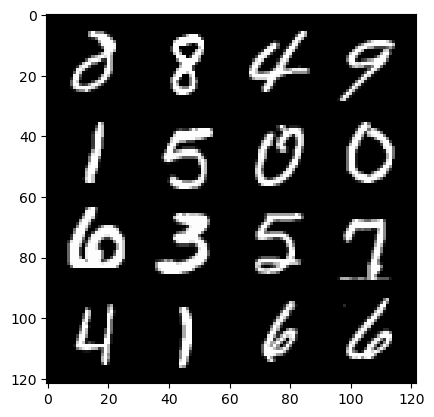

267: step 125400/ Gen loss: 1.8389415343602493/ disc_loss: 0.30509893760085116


  0%|          | 0/469 [00:00<?, ?it/s]

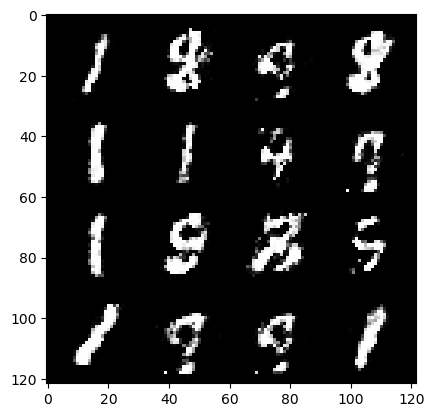

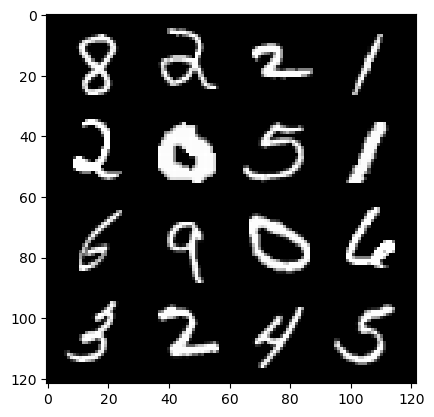

268: step 125700/ Gen loss: 1.8924551920096078/ disc_loss: 0.30050159424543393


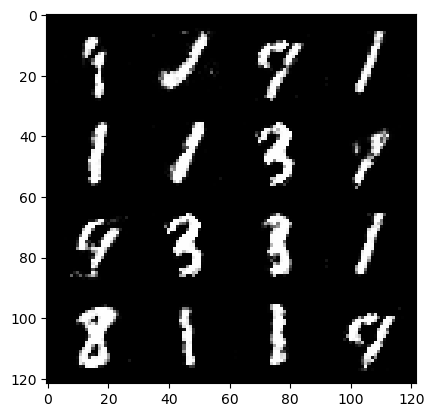

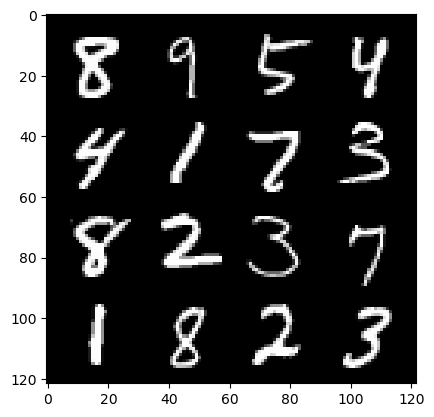

268: step 126000/ Gen loss: 1.9048346217473346/ disc_loss: 0.295122045179208


  0%|          | 0/469 [00:00<?, ?it/s]

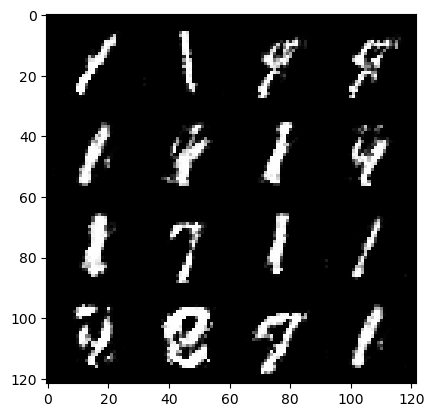

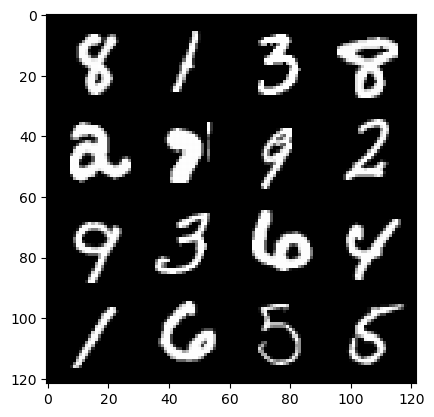

269: step 126300/ Gen loss: 1.7513807364304859/ disc_loss: 0.3349592791001002


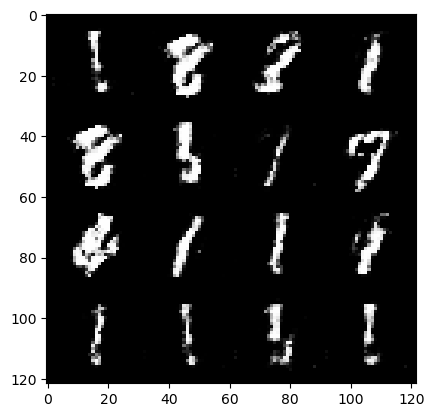

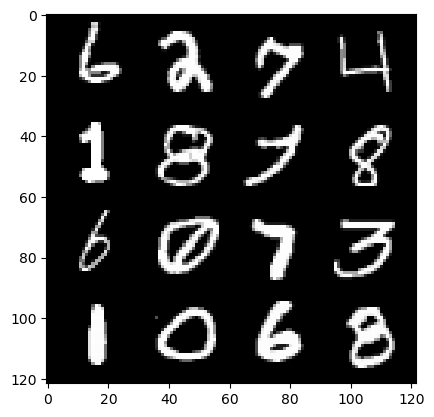

269: step 126600/ Gen loss: 1.706865333716076/ disc_loss: 0.3259549235800901


  0%|          | 0/469 [00:00<?, ?it/s]

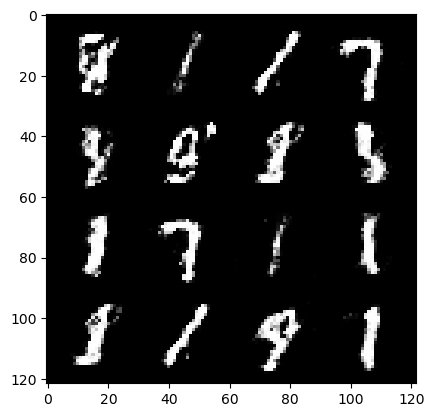

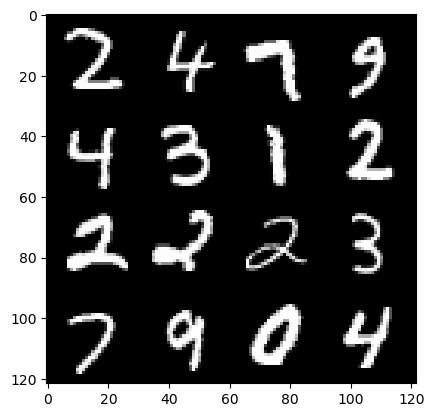

270: step 126900/ Gen loss: 1.779926380316416/ disc_loss: 0.299985661059618


  0%|          | 0/469 [00:00<?, ?it/s]

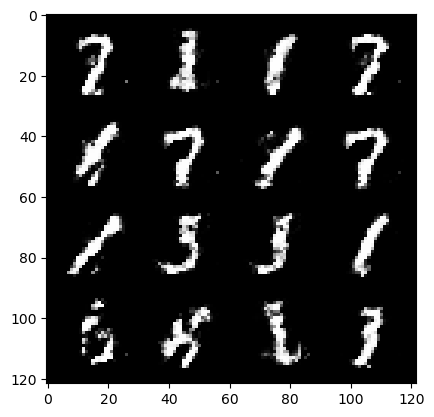

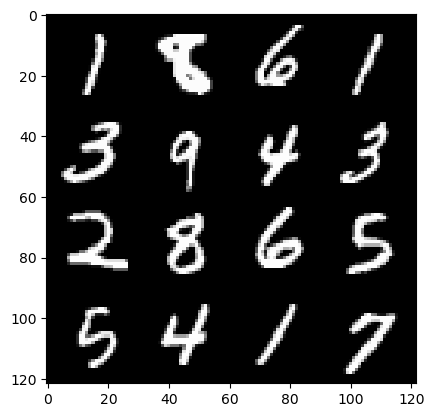

271: step 127200/ Gen loss: 1.875777534643809/ disc_loss: 0.2932484180231889


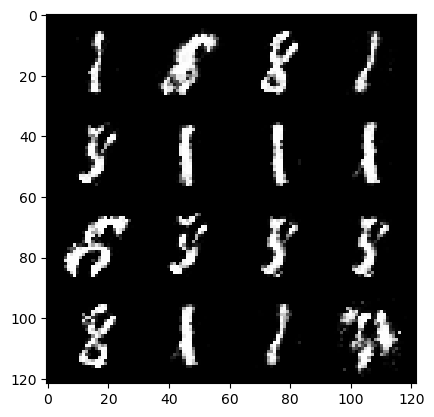

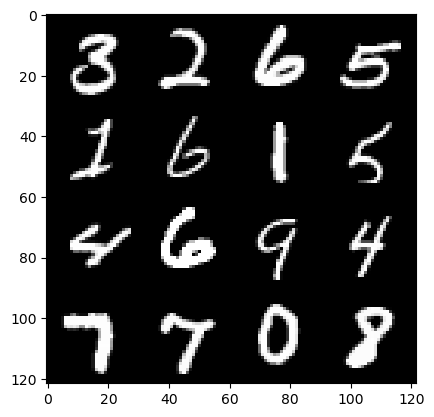

271: step 127500/ Gen loss: 1.798728043635687/ disc_loss: 0.31554730847477896


  0%|          | 0/469 [00:00<?, ?it/s]

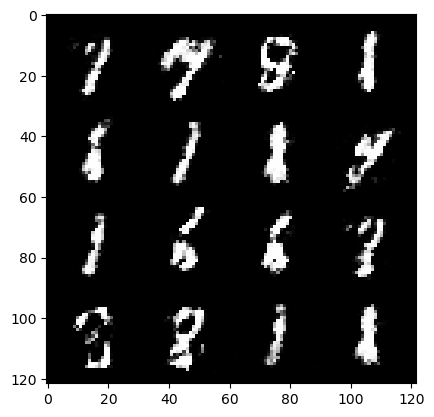

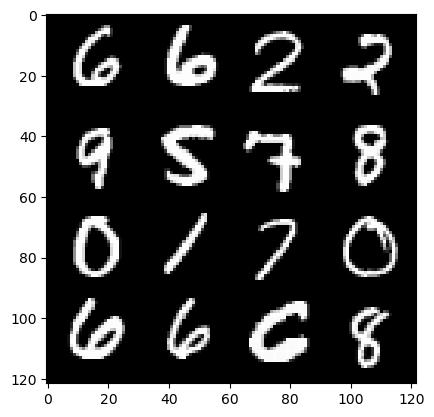

272: step 127800/ Gen loss: 2.0616014254093167/ disc_loss: 0.2880184214810528


  0%|          | 0/469 [00:00<?, ?it/s]

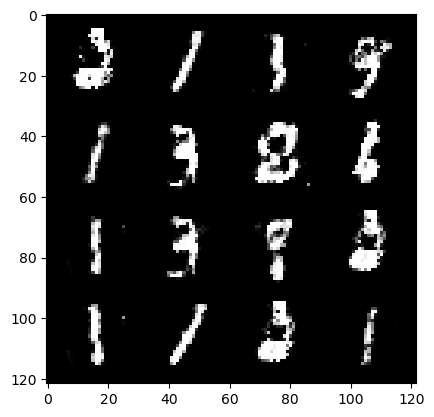

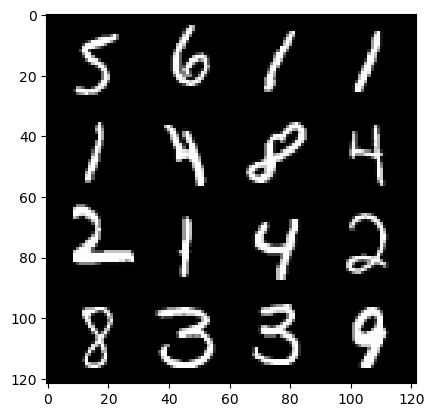

273: step 128100/ Gen loss: 2.033138147592545/ disc_loss: 0.2690019503235818


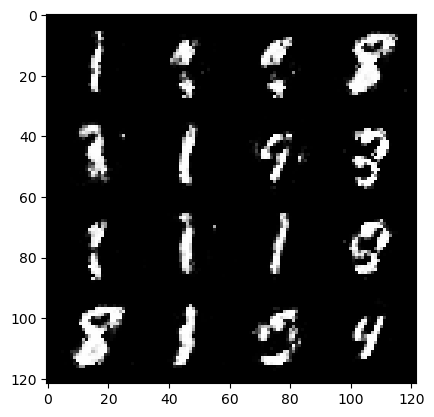

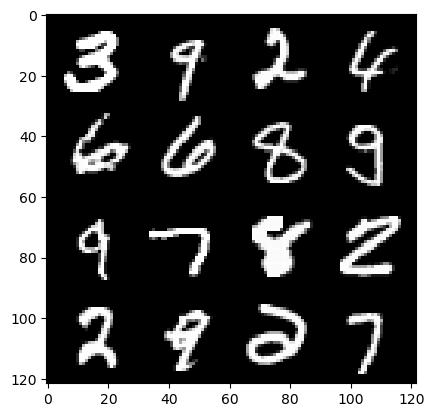

273: step 128400/ Gen loss: 2.0768015944957745/ disc_loss: 0.25612737601002056


  0%|          | 0/469 [00:00<?, ?it/s]

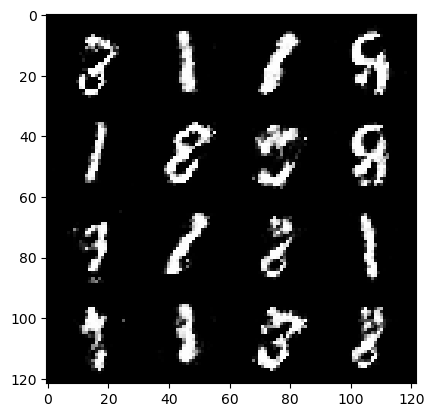

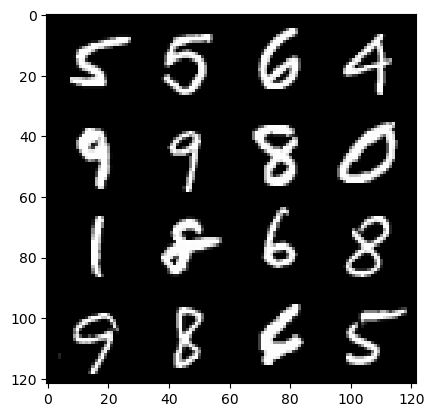

274: step 128700/ Gen loss: 2.1260240721702583/ disc_loss: 0.2572536931435266


  0%|          | 0/469 [00:00<?, ?it/s]

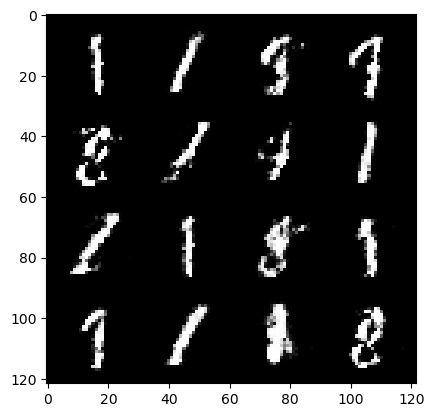

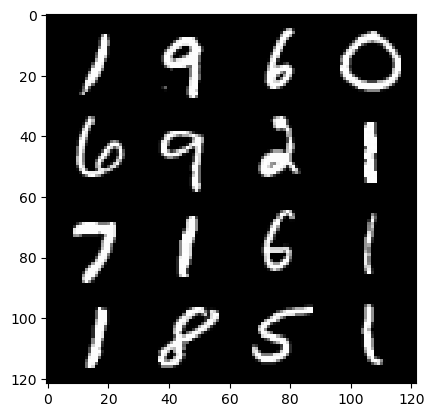

275: step 129000/ Gen loss: 2.020405934651694/ disc_loss: 0.2651478828986482


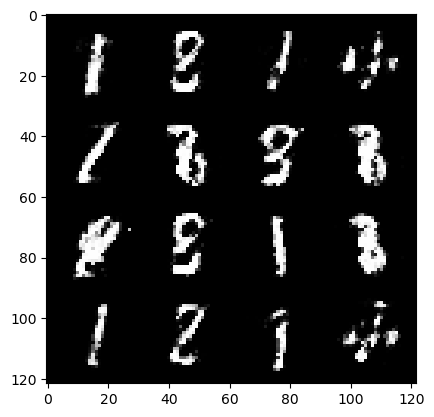

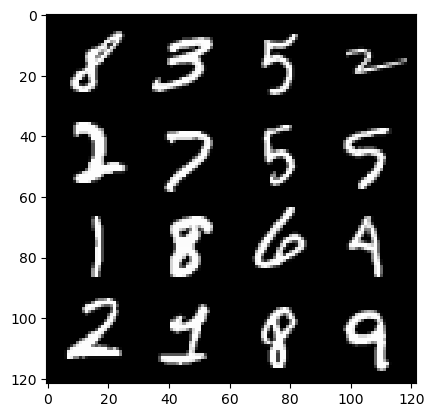

275: step 129300/ Gen loss: 2.0360067927837378/ disc_loss: 0.2984549986819423


  0%|          | 0/469 [00:00<?, ?it/s]

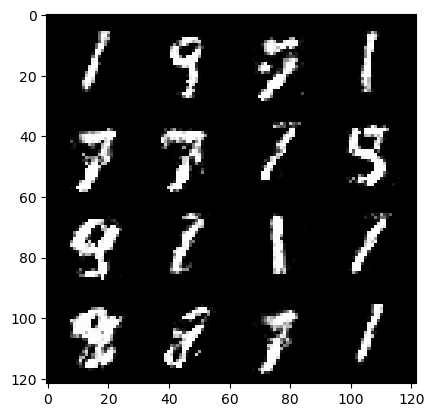

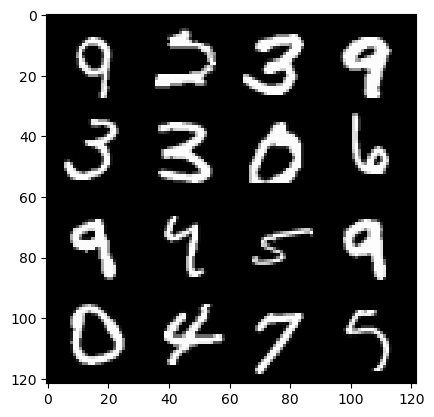

276: step 129600/ Gen loss: 1.9695420602957394/ disc_loss: 0.2883283493916194


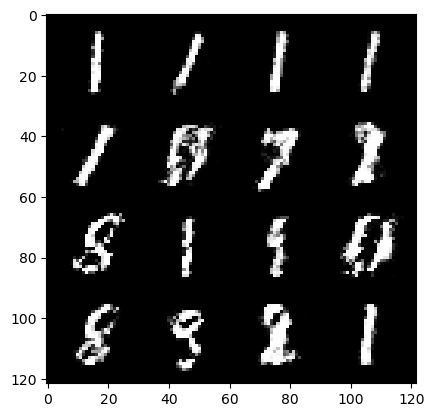

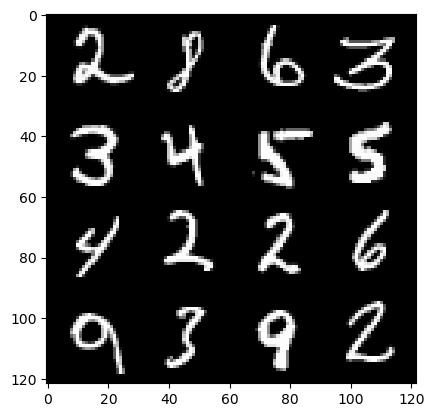

276: step 129900/ Gen loss: 1.958396924336753/ disc_loss: 0.2821897878746191


  0%|          | 0/469 [00:00<?, ?it/s]

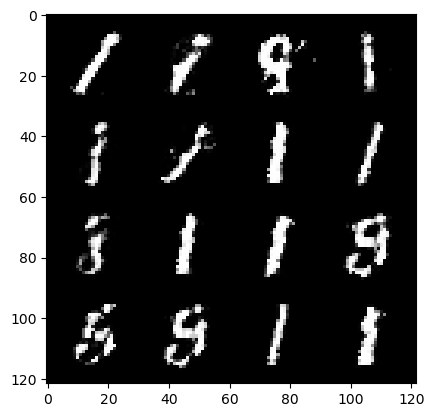

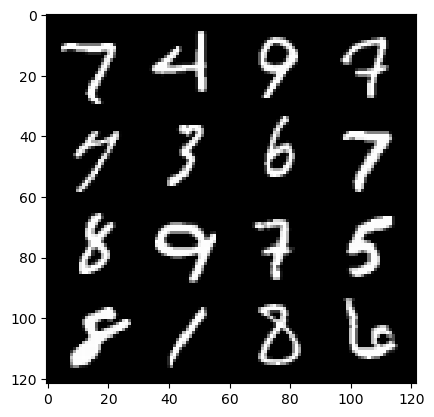

277: step 130200/ Gen loss: 1.8611305491129553/ disc_loss: 0.30366520096858335


  0%|          | 0/469 [00:00<?, ?it/s]

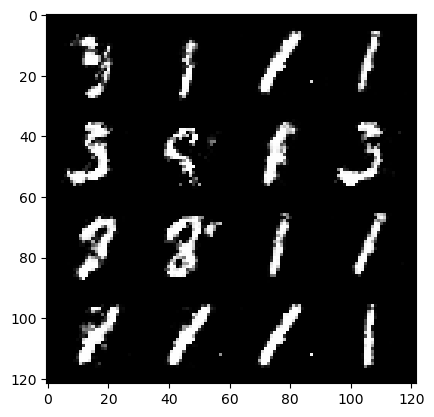

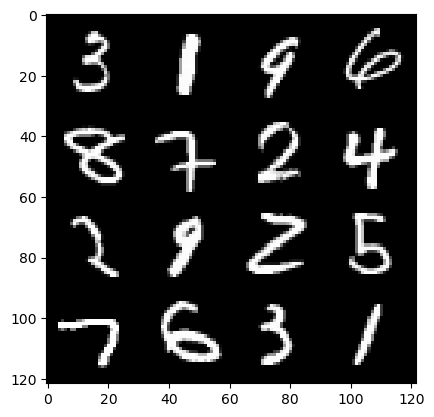

278: step 130500/ Gen loss: 1.8097428695360815/ disc_loss: 0.31031705290079103


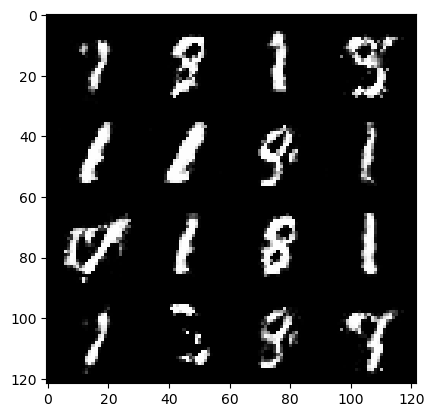

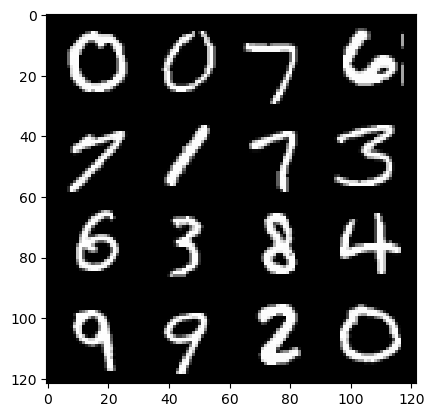

278: step 130800/ Gen loss: 1.832357212702434/ disc_loss: 0.31215056831638066


  0%|          | 0/469 [00:00<?, ?it/s]

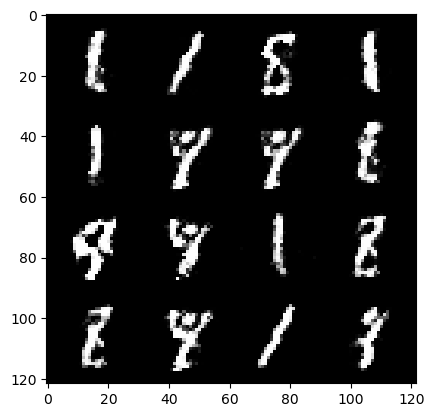

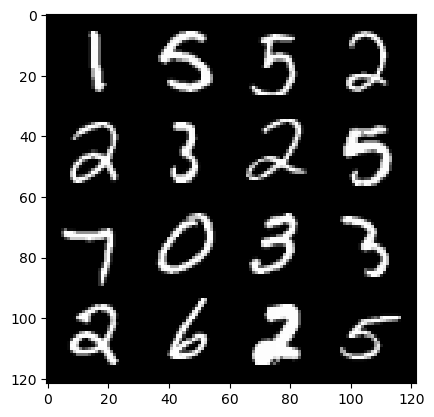

279: step 131100/ Gen loss: 2.002443699439367/ disc_loss: 0.27141886343558613


  0%|          | 0/469 [00:00<?, ?it/s]

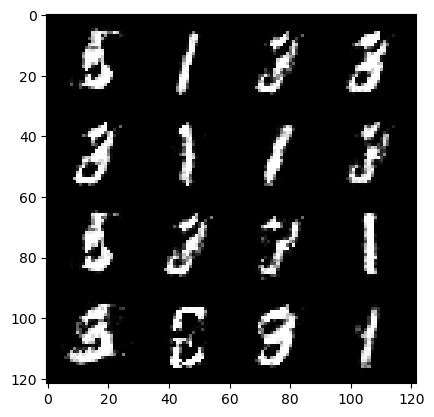

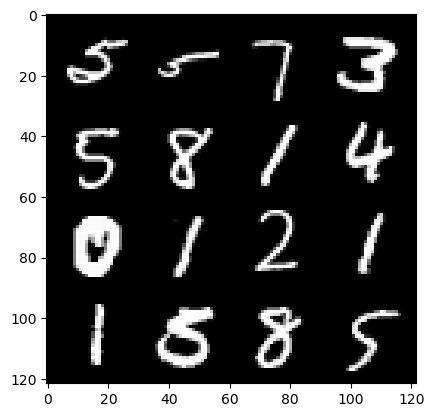

280: step 131400/ Gen loss: 2.0721991900602994/ disc_loss: 0.2713746537268162


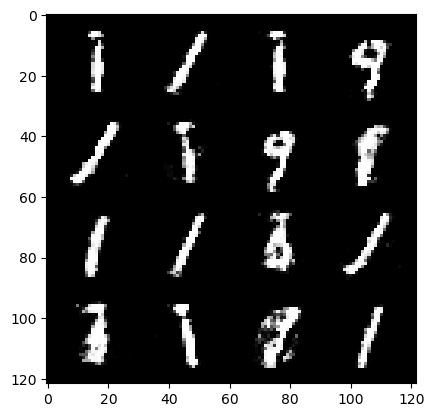

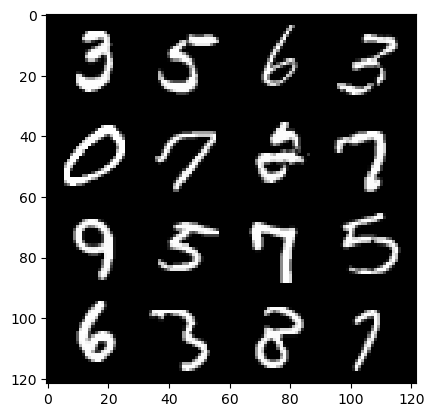

280: step 131700/ Gen loss: 2.0409277160962427/ disc_loss: 0.2902837236225603


  0%|          | 0/469 [00:00<?, ?it/s]

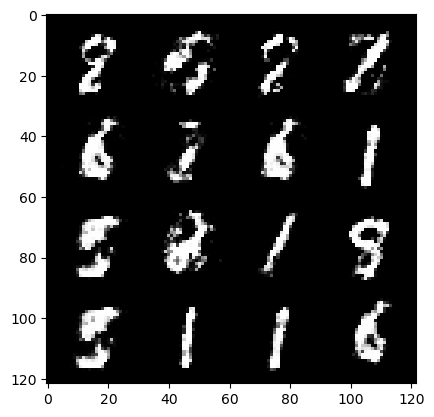

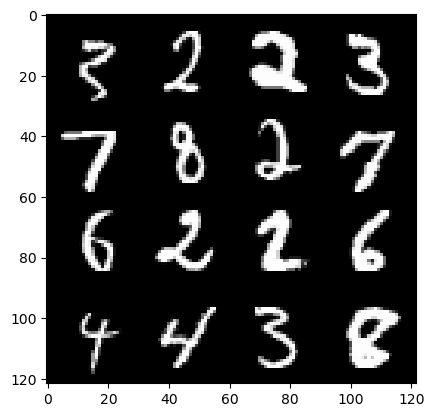

281: step 132000/ Gen loss: 1.9998853317896514/ disc_loss: 0.2831999434034031


  0%|          | 0/469 [00:00<?, ?it/s]

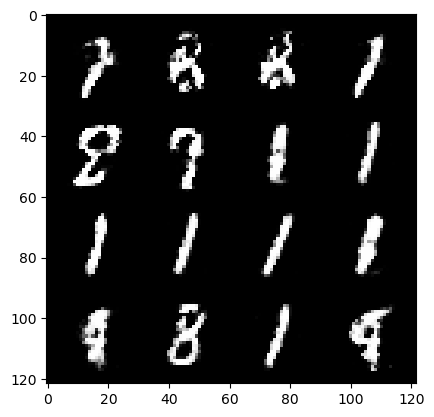

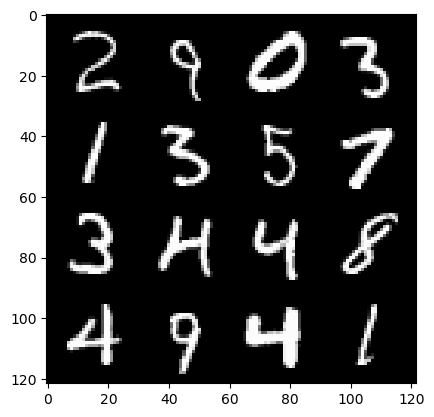

282: step 132300/ Gen loss: 1.9297399544715865/ disc_loss: 0.2783976252377034


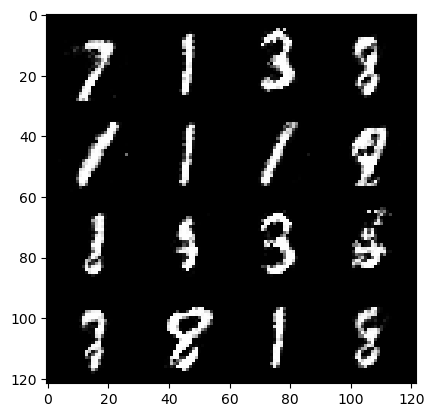

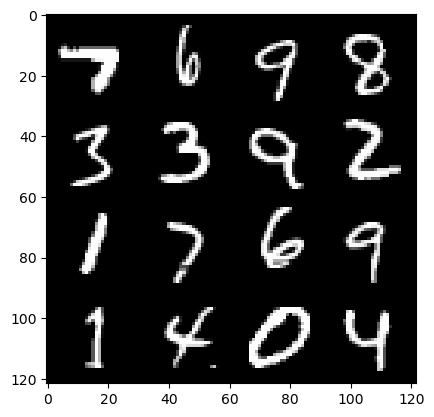

282: step 132600/ Gen loss: 1.8811552500724786/ disc_loss: 0.3057248349487781


  0%|          | 0/469 [00:00<?, ?it/s]

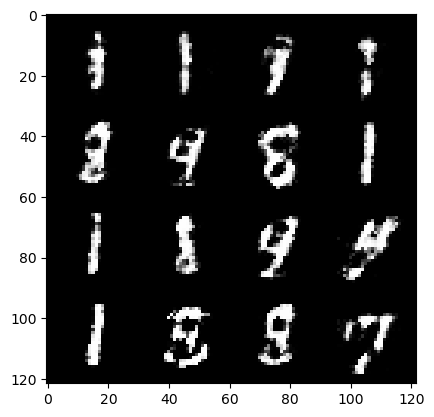

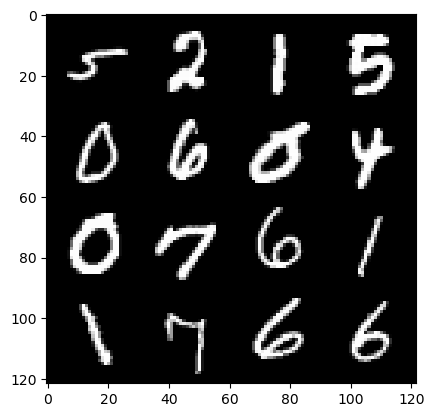

283: step 132900/ Gen loss: 1.8411581377188357/ disc_loss: 0.3162619358797871


  0%|          | 0/469 [00:00<?, ?it/s]

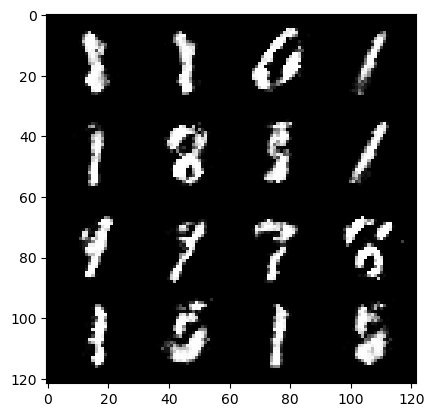

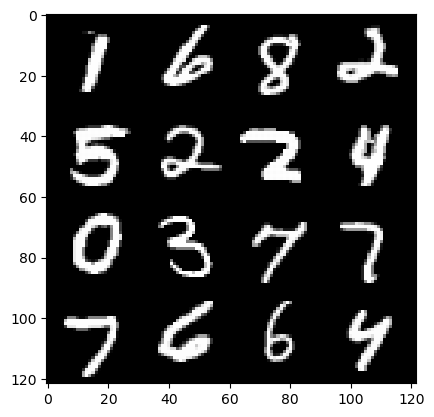

284: step 133200/ Gen loss: 1.9721697048346196/ disc_loss: 0.28168901885549236


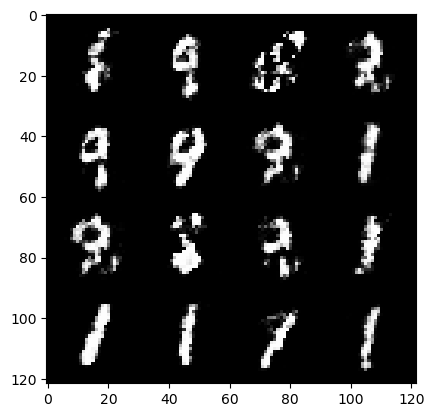

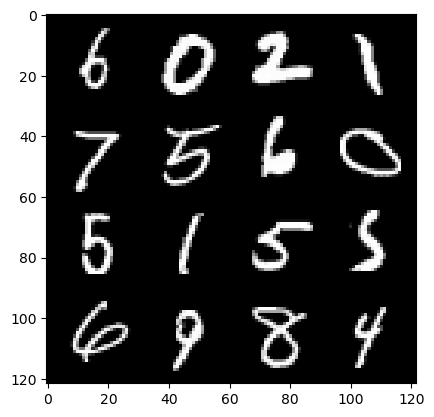

284: step 133500/ Gen loss: 1.962289617856342/ disc_loss: 0.28242080926895147


  0%|          | 0/469 [00:00<?, ?it/s]

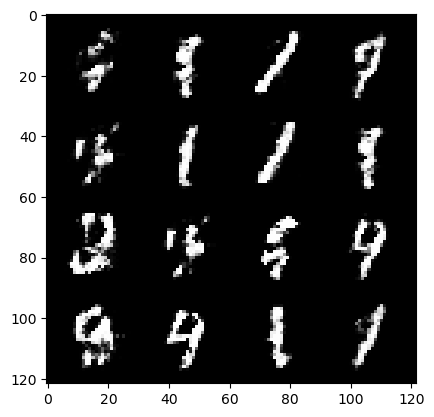

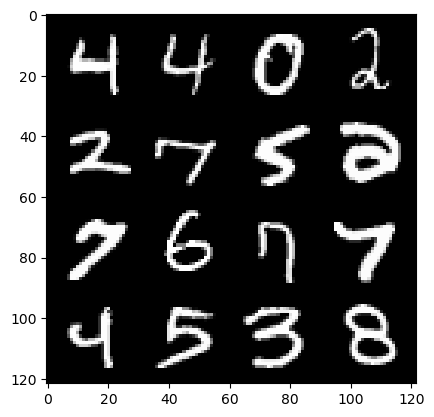

285: step 133800/ Gen loss: 1.9883805783589688/ disc_loss: 0.2846886176864307


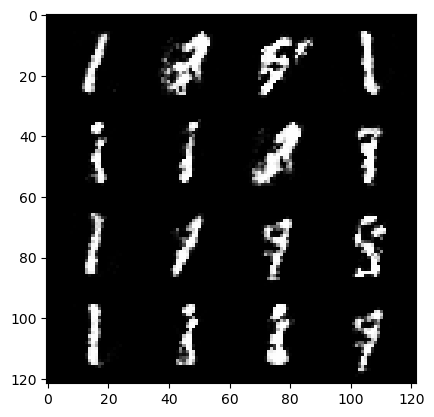

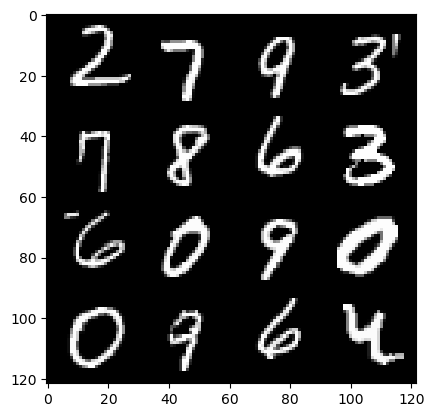

285: step 134100/ Gen loss: 1.977206591367722/ disc_loss: 0.2863627924025058


  0%|          | 0/469 [00:00<?, ?it/s]

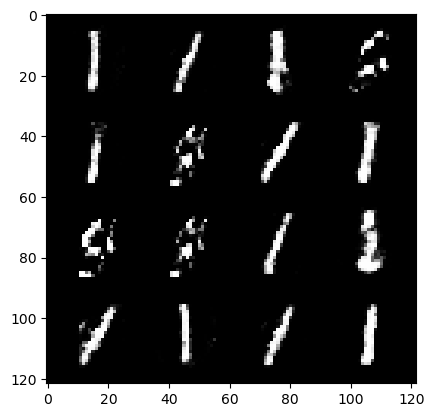

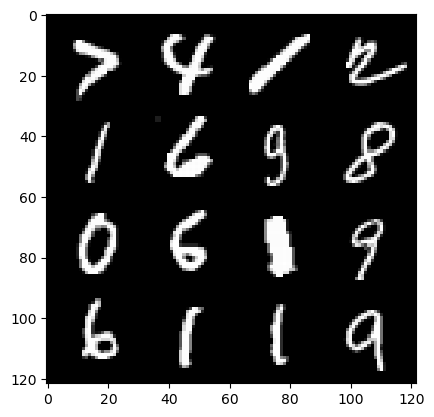

286: step 134400/ Gen loss: 1.9814030694961544/ disc_loss: 0.28415515214204795


  0%|          | 0/469 [00:00<?, ?it/s]

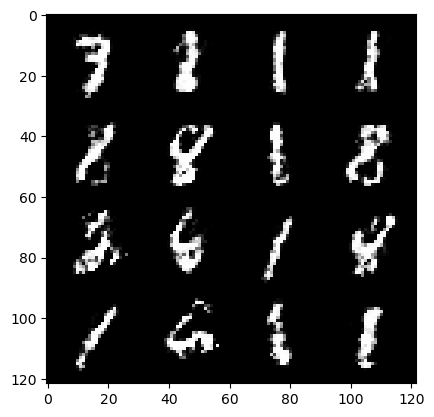

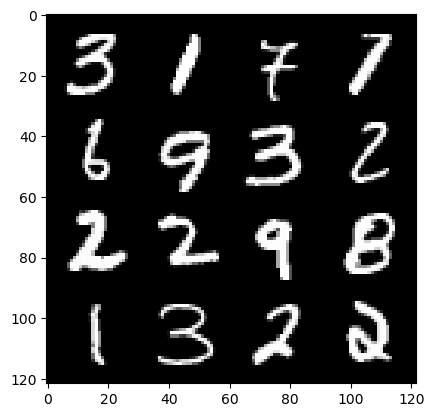

287: step 134700/ Gen loss: 1.7849068160851793/ disc_loss: 0.31860326995452254


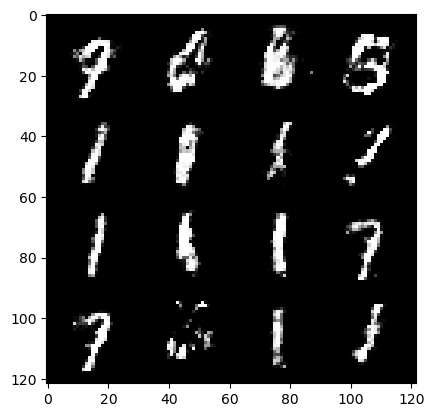

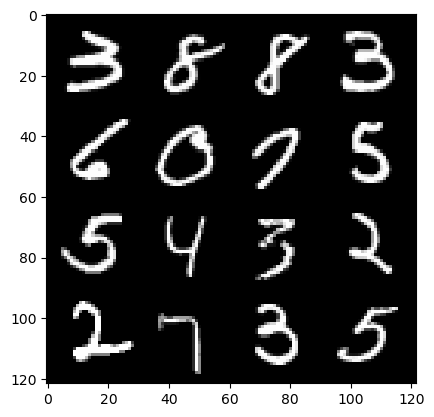

287: step 135000/ Gen loss: 1.895233824650447/ disc_loss: 0.3077325722078484


  0%|          | 0/469 [00:00<?, ?it/s]

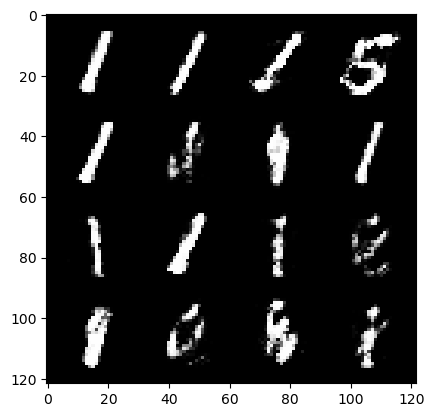

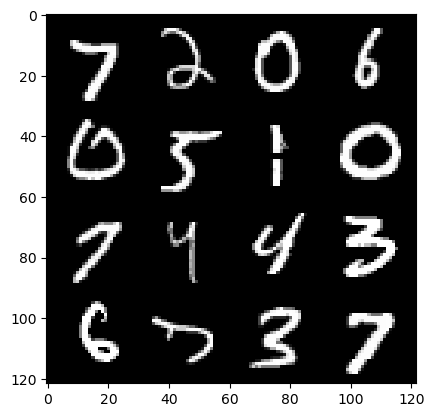

288: step 135300/ Gen loss: 1.8583094322681426/ disc_loss: 0.31027607356508574


  0%|          | 0/469 [00:00<?, ?it/s]

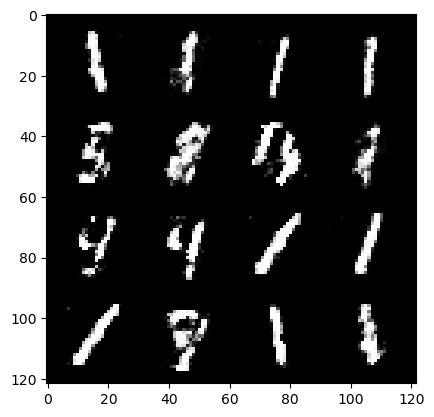

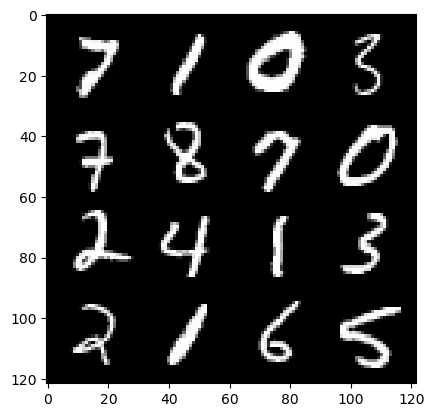

289: step 135600/ Gen loss: 1.7638964203993477/ disc_loss: 0.3251727524399758


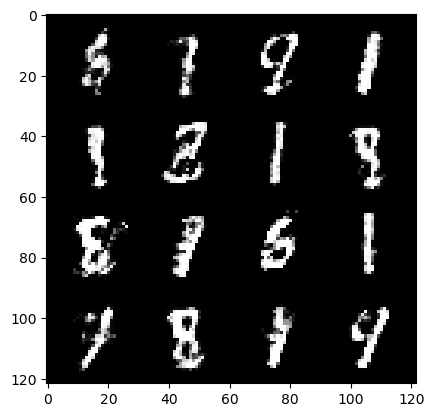

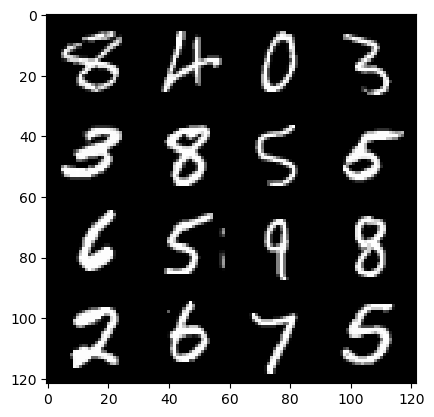

289: step 135900/ Gen loss: 1.735143282016118/ disc_loss: 0.33565179740389195


  0%|          | 0/469 [00:00<?, ?it/s]

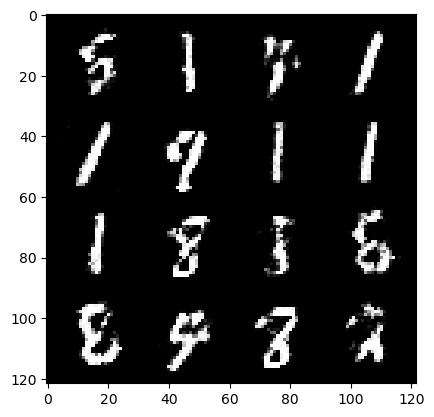

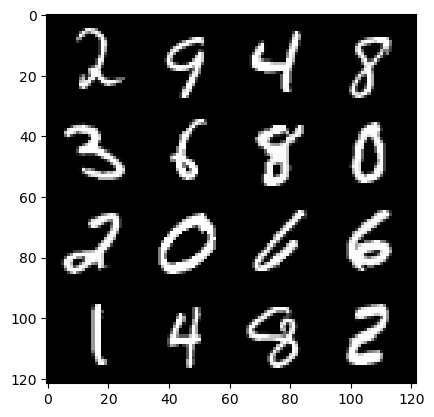

290: step 136200/ Gen loss: 1.7671783105532322/ disc_loss: 0.33030731822053583


  0%|          | 0/469 [00:00<?, ?it/s]

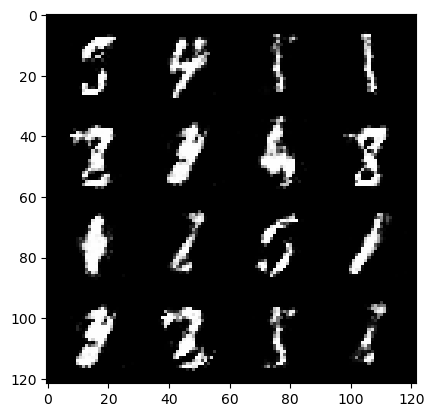

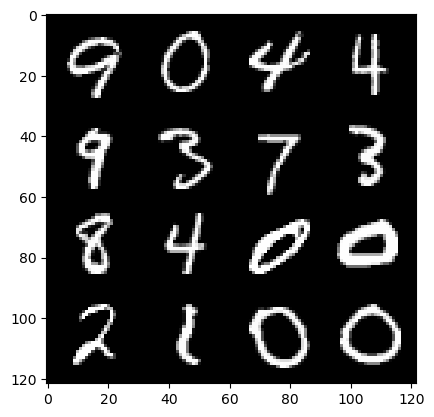

291: step 136500/ Gen loss: 1.786542833248773/ disc_loss: 0.3178515600164731


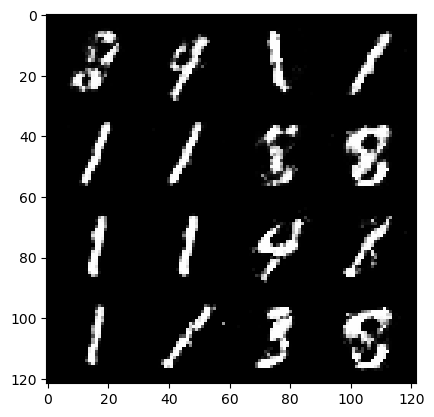

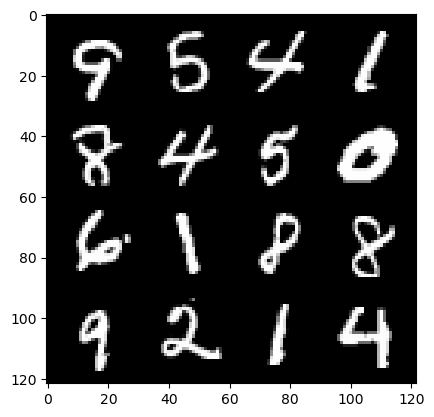

291: step 136800/ Gen loss: 1.8315577081839245/ disc_loss: 0.32179503803451853


  0%|          | 0/469 [00:00<?, ?it/s]

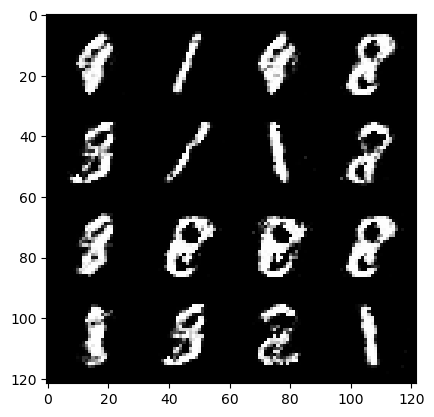

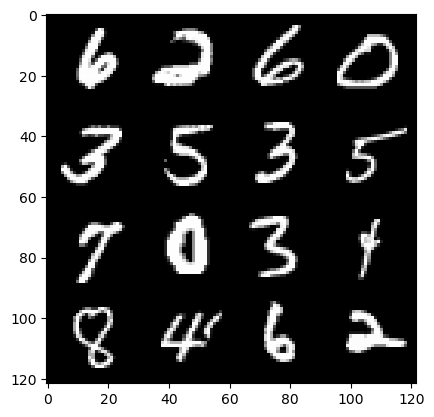

292: step 137100/ Gen loss: 1.7534212474028266/ disc_loss: 0.34986226876576737


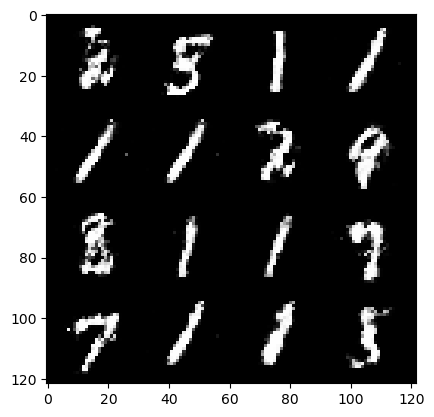

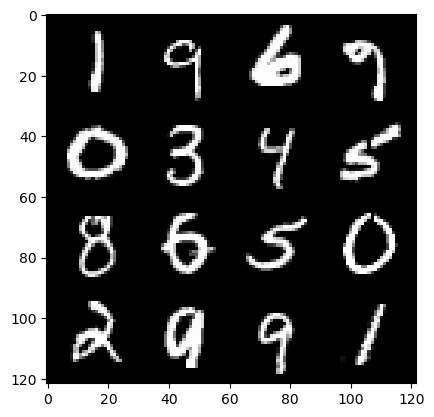

292: step 137400/ Gen loss: 1.7741001474857323/ disc_loss: 0.3290266962349412


  0%|          | 0/469 [00:00<?, ?it/s]

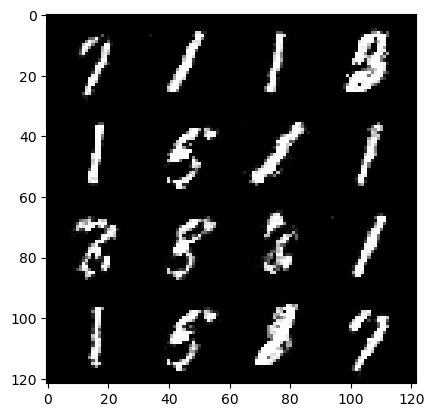

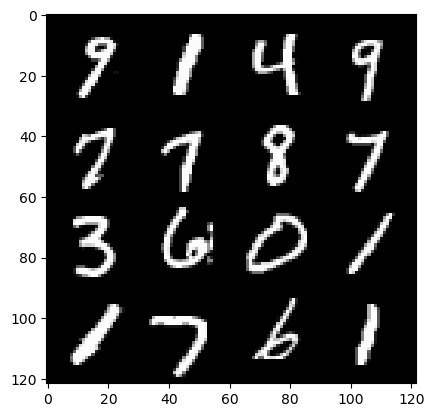

293: step 137700/ Gen loss: 1.7604259622097003/ disc_loss: 0.33323838373025233


  0%|          | 0/469 [00:00<?, ?it/s]

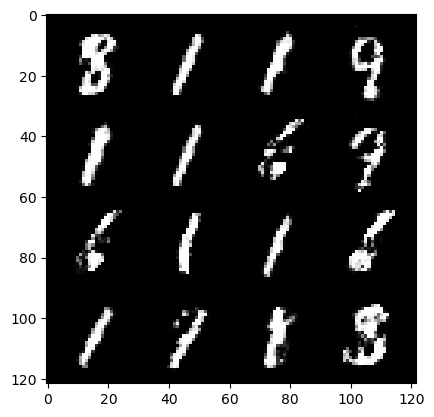

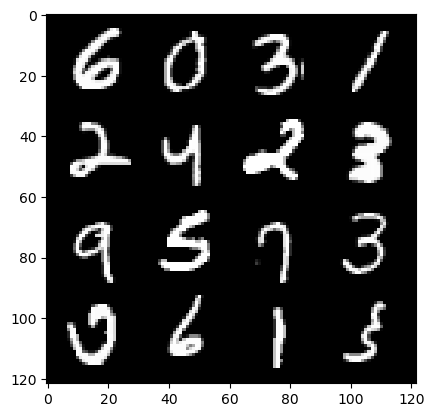

294: step 138000/ Gen loss: 1.8165302220980348/ disc_loss: 0.3177363526324428


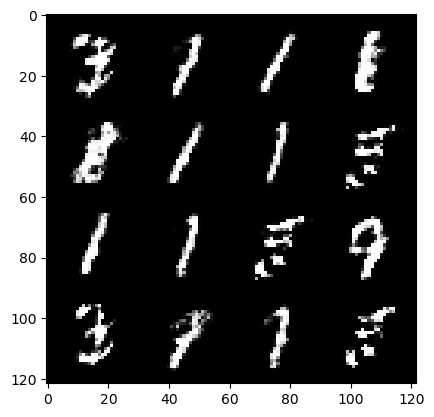

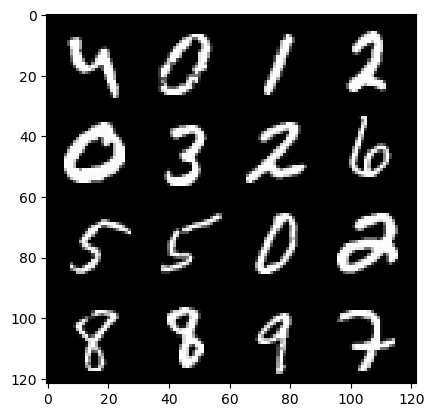

294: step 138300/ Gen loss: 1.8294672171274804/ disc_loss: 0.310606564829747


  0%|          | 0/469 [00:00<?, ?it/s]

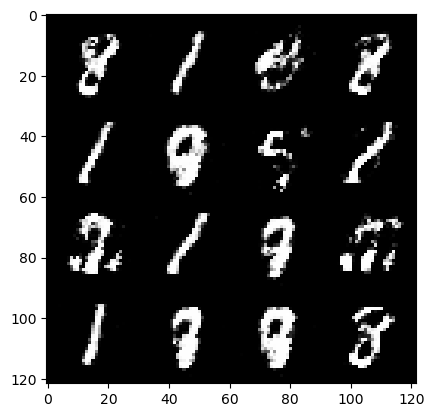

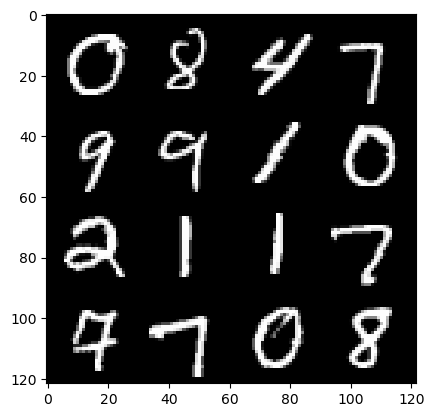

295: step 138600/ Gen loss: 1.8860186171531668/ disc_loss: 0.3108853260179359


  0%|          | 0/469 [00:00<?, ?it/s]

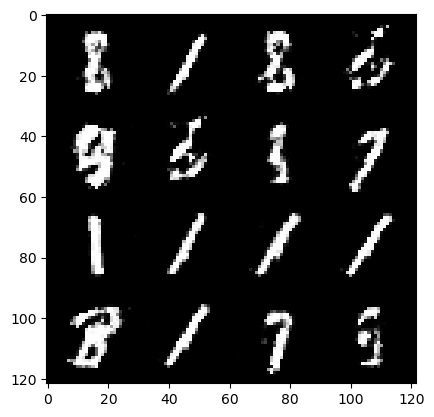

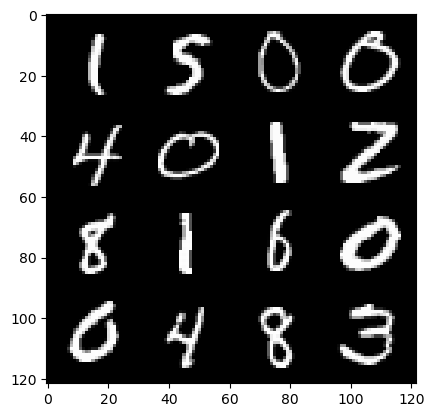

296: step 138900/ Gen loss: 1.8687815431753803/ disc_loss: 0.30770533507068953


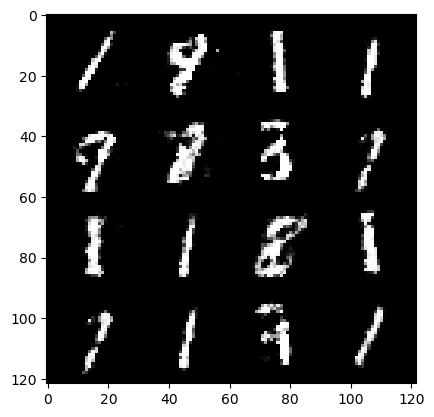

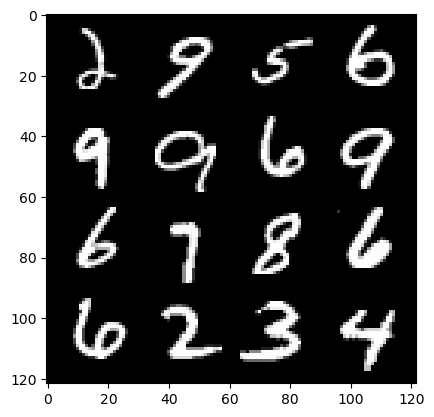

296: step 139200/ Gen loss: 1.8921073095003769/ disc_loss: 0.2988633254170419


  0%|          | 0/469 [00:00<?, ?it/s]

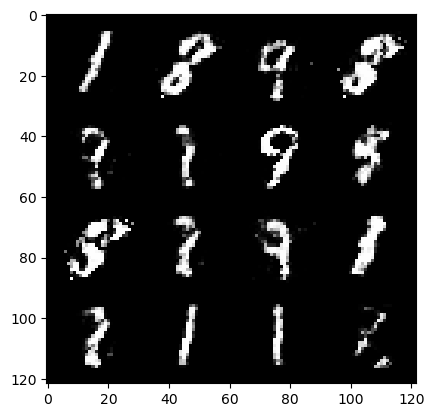

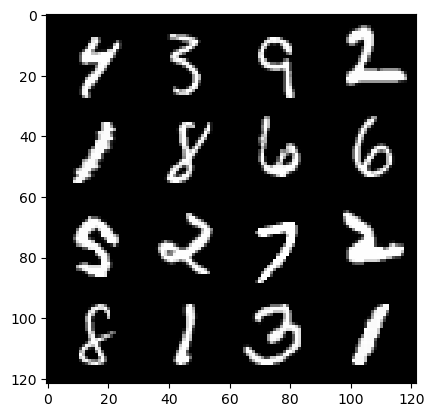

297: step 139500/ Gen loss: 1.789293826421103/ disc_loss: 0.32252533624569607


  0%|          | 0/469 [00:00<?, ?it/s]

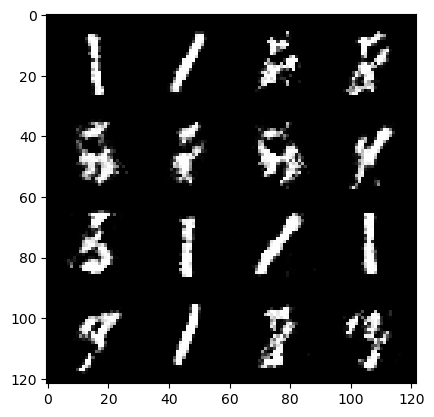

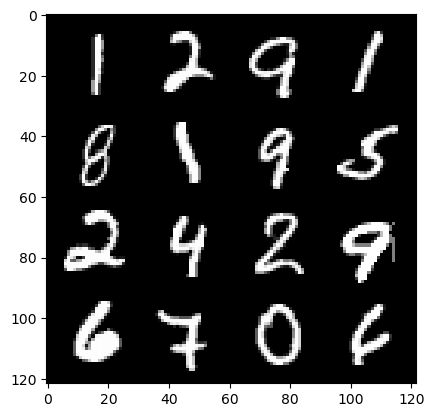

298: step 139800/ Gen loss: 1.7428092996279394/ disc_loss: 0.316180607875188


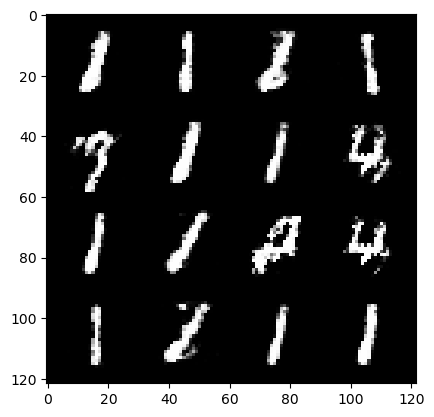

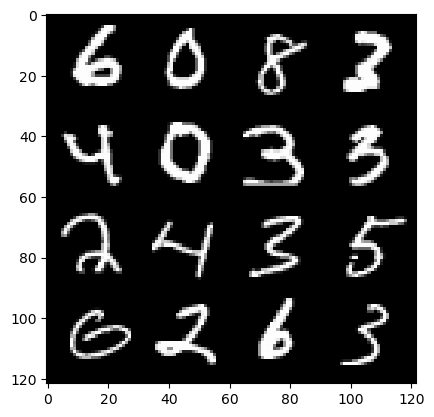

298: step 140100/ Gen loss: 1.8015343507130923/ disc_loss: 0.33363476713498424


  0%|          | 0/469 [00:00<?, ?it/s]

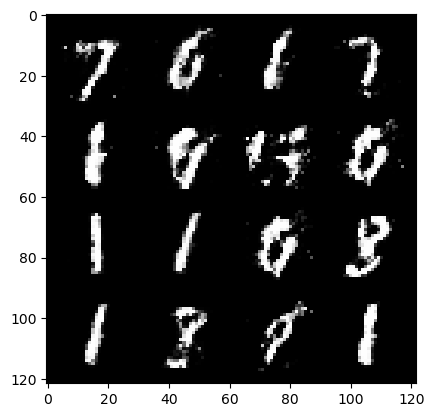

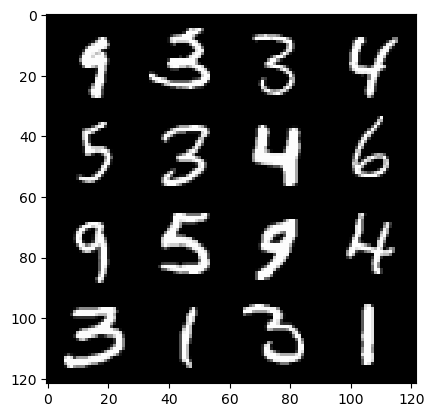

299: step 140400/ Gen loss: 1.8038178869088497/ disc_loss: 0.3174413775404293


  0%|          | 0/469 [00:00<?, ?it/s]

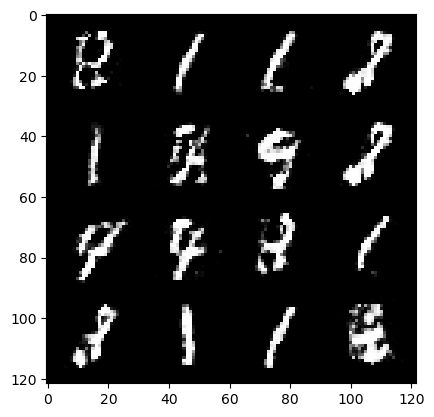

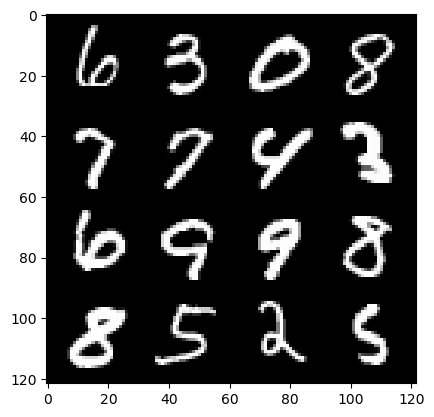

300: step 140700/ Gen loss: 1.8885059356689458/ disc_loss: 0.29707518334190053


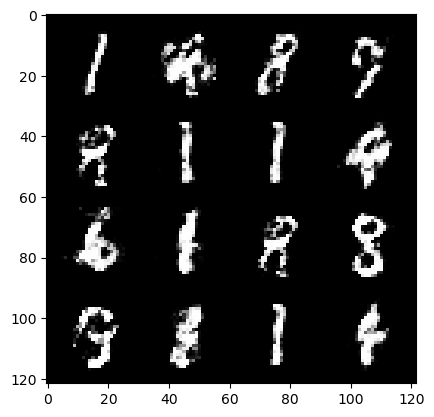

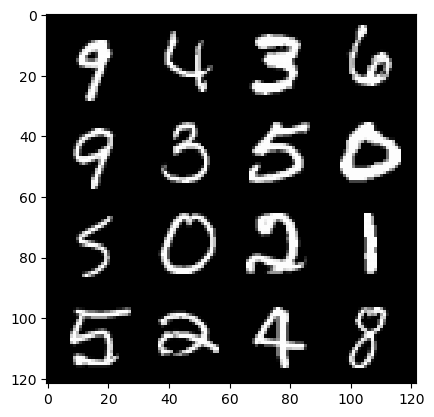

300: step 141000/ Gen loss: 1.974869748751322/ disc_loss: 0.29387174641092617


  0%|          | 0/469 [00:00<?, ?it/s]

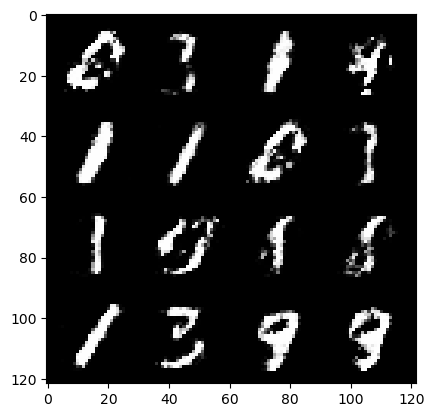

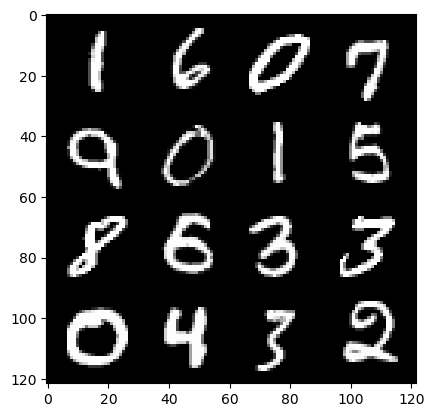

301: step 141300/ Gen loss: 1.8388679746786765/ disc_loss: 0.3366616559525333


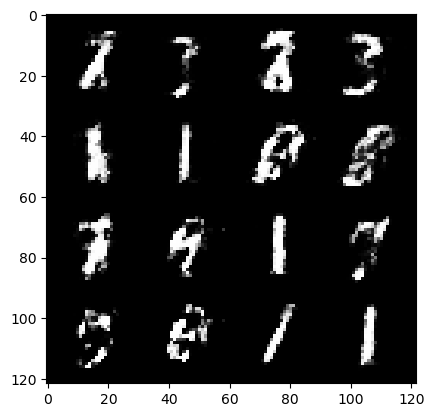

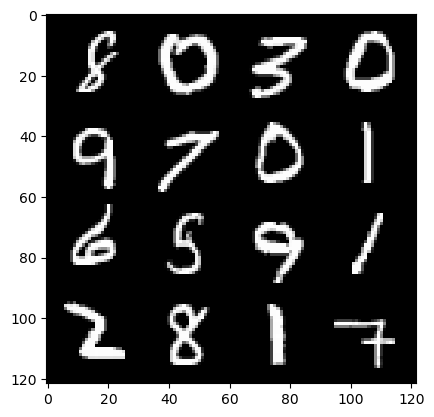

301: step 141600/ Gen loss: 1.857095538775125/ disc_loss: 0.30690267766515417


  0%|          | 0/469 [00:00<?, ?it/s]

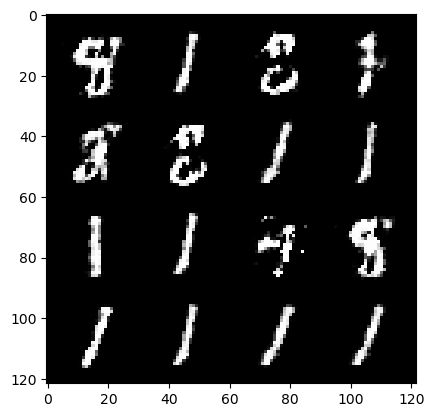

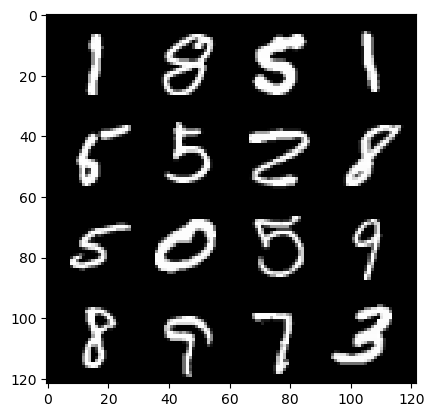

302: step 141900/ Gen loss: 2.0200364708900445/ disc_loss: 0.2831062650183836


  0%|          | 0/469 [00:00<?, ?it/s]

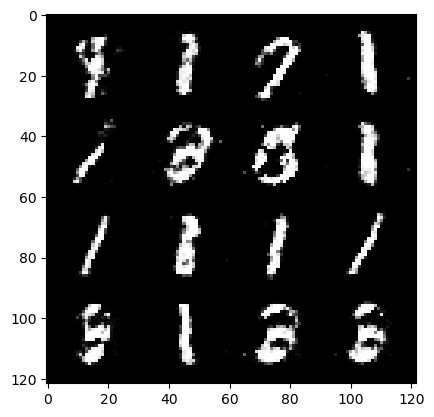

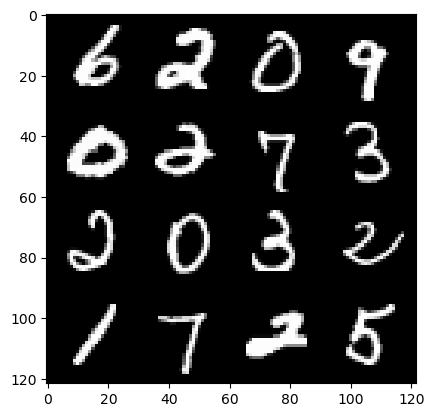

303: step 142200/ Gen loss: 1.9636958487828573/ disc_loss: 0.28336487064758964


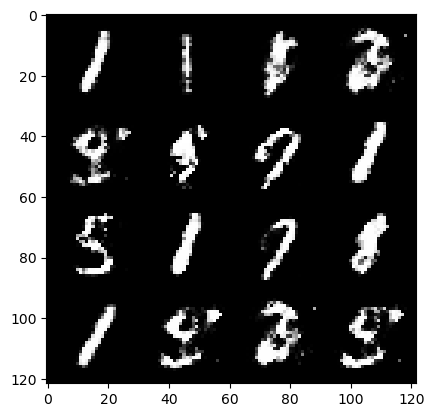

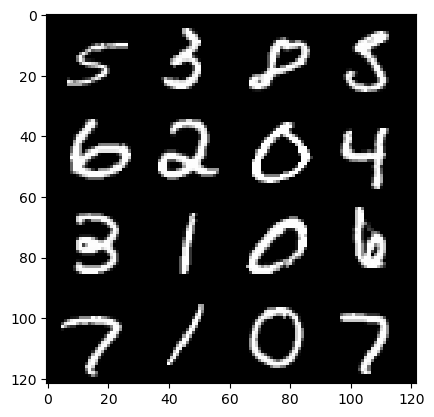

303: step 142500/ Gen loss: 1.9507036797205601/ disc_loss: 0.2856121300160885


  0%|          | 0/469 [00:00<?, ?it/s]

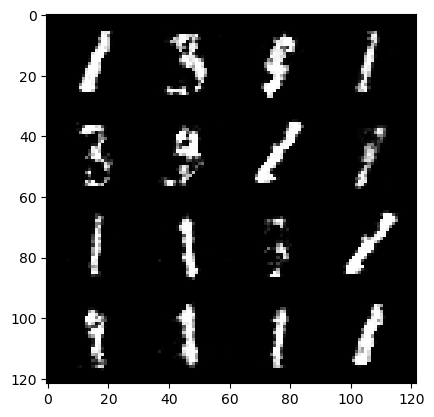

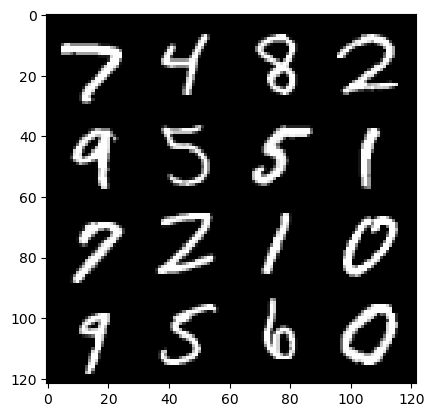

304: step 142800/ Gen loss: 1.8996541782220215/ disc_loss: 0.28927292461196563


  0%|          | 0/469 [00:00<?, ?it/s]

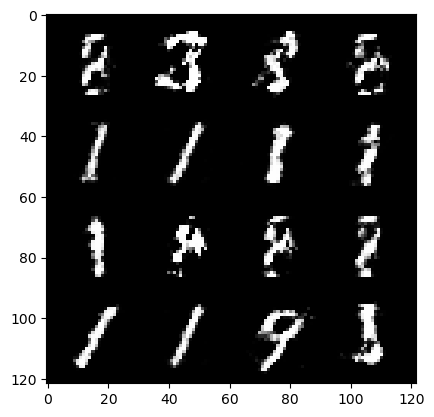

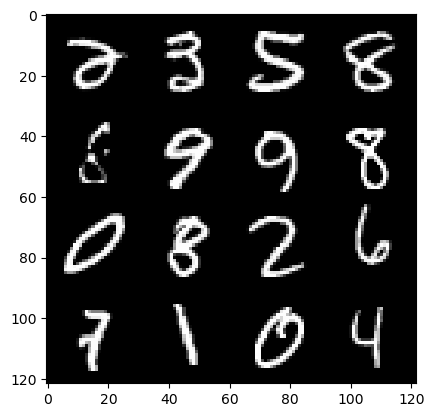

305: step 143100/ Gen loss: 2.0055688556035345/ disc_loss: 0.2754332018891971


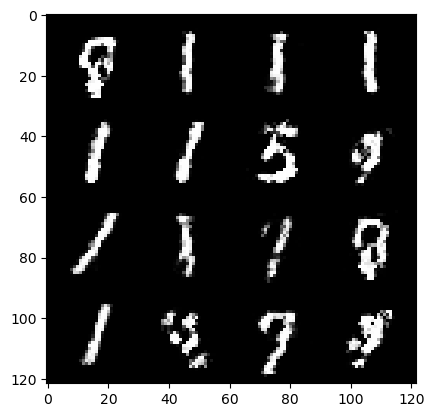

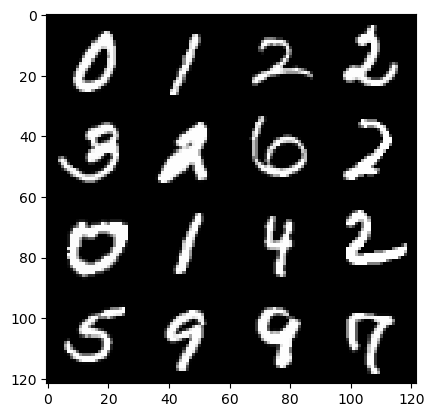

305: step 143400/ Gen loss: 1.9005204586188003/ disc_loss: 0.3082254518071811


  0%|          | 0/469 [00:00<?, ?it/s]

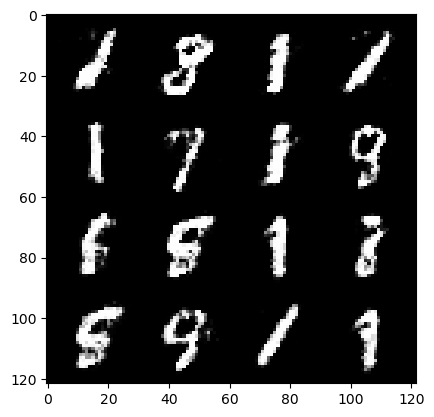

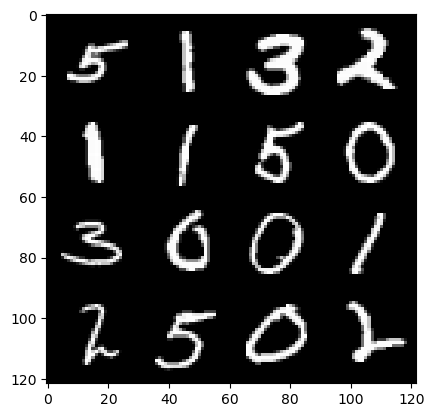

306: step 143700/ Gen loss: 1.9330942463874805/ disc_loss: 0.3223093848427138


  0%|          | 0/469 [00:00<?, ?it/s]

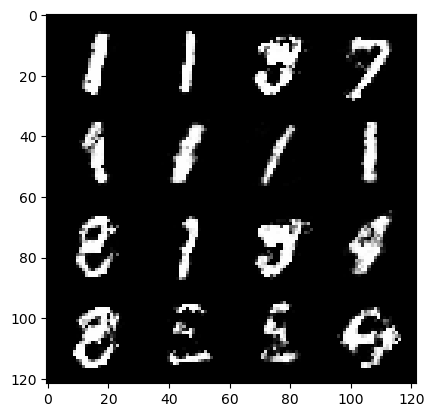

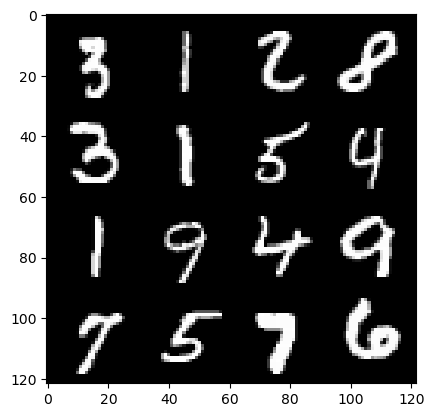

307: step 144000/ Gen loss: 1.907747449874877/ disc_loss: 0.3311711204548676


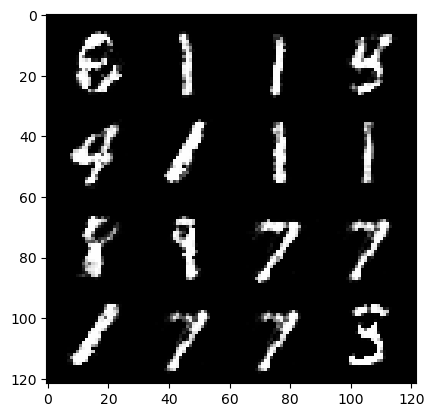

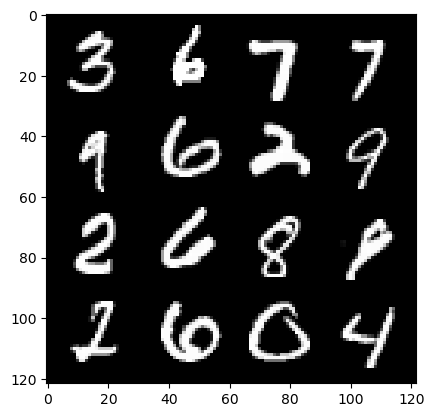

307: step 144300/ Gen loss: 1.7732646818955724/ disc_loss: 0.3352199766536554


  0%|          | 0/469 [00:00<?, ?it/s]

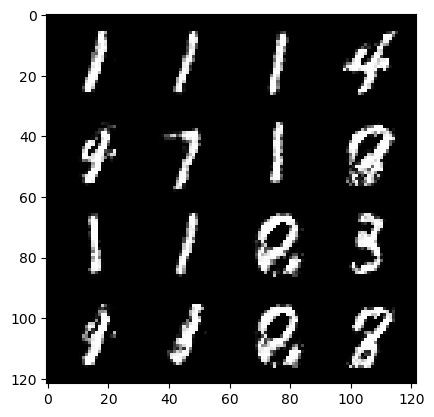

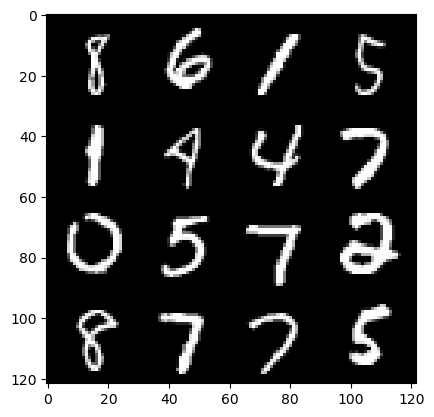

308: step 144600/ Gen loss: 1.7094037707646685/ disc_loss: 0.3433004130919776


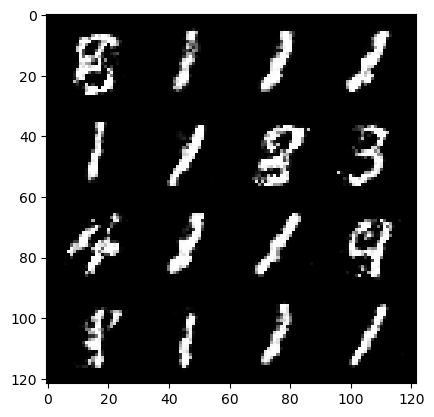

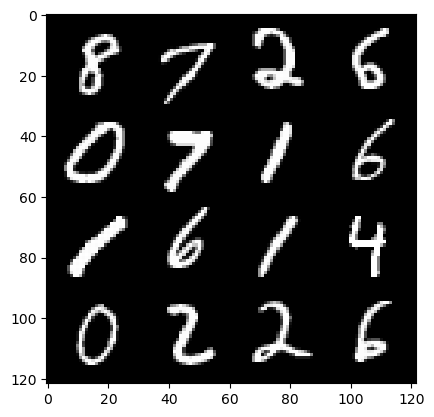

308: step 144900/ Gen loss: 1.7858951230843865/ disc_loss: 0.3247734258075557


  0%|          | 0/469 [00:00<?, ?it/s]

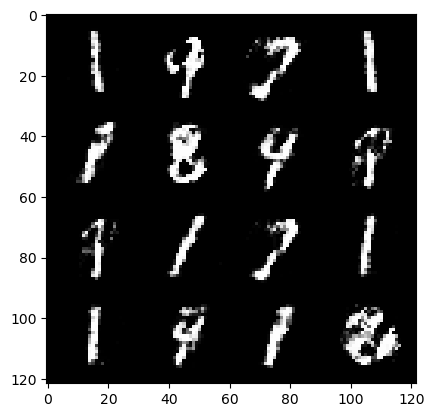

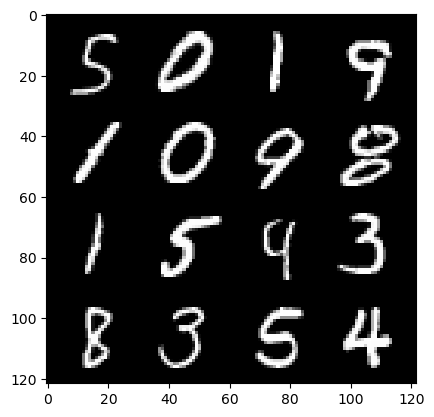

309: step 145200/ Gen loss: 1.7854935753345509/ disc_loss: 0.313027502298355


  0%|          | 0/469 [00:00<?, ?it/s]

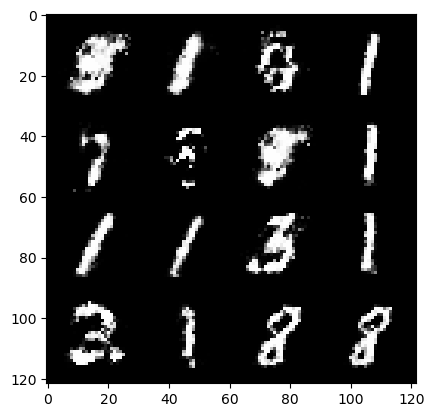

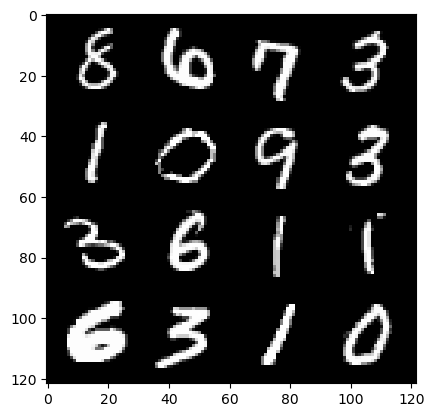

310: step 145500/ Gen loss: 1.7942838299274444/ disc_loss: 0.32407581706841787


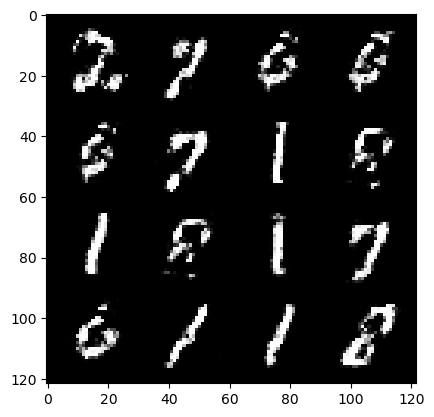

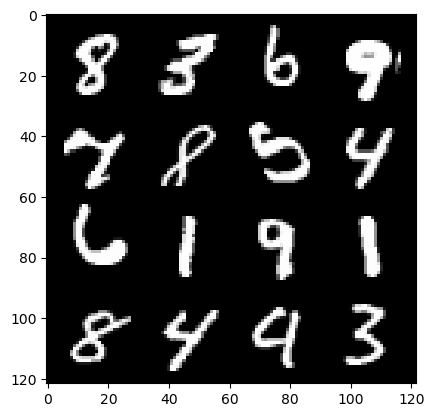

310: step 145800/ Gen loss: 1.7962345953782386/ disc_loss: 0.32415185391902923


  0%|          | 0/469 [00:00<?, ?it/s]

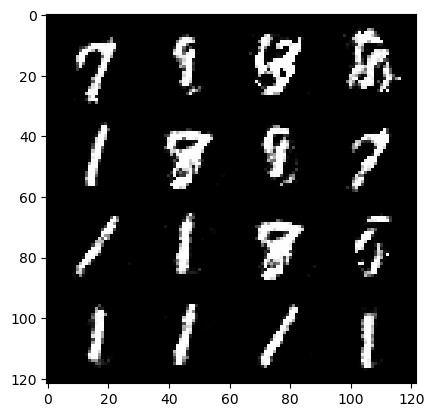

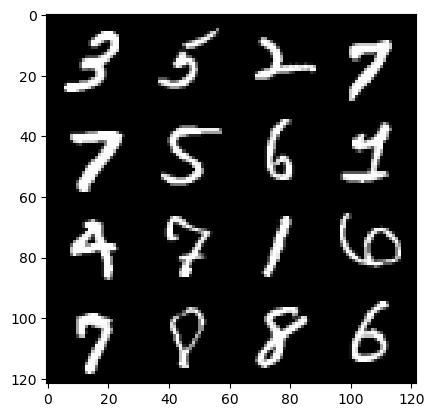

311: step 146100/ Gen loss: 1.8740952285130827/ disc_loss: 0.3031742441157498


  0%|          | 0/469 [00:00<?, ?it/s]

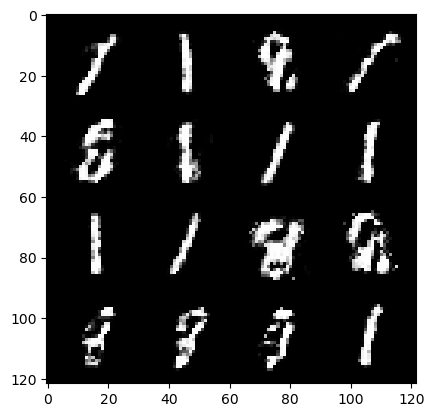

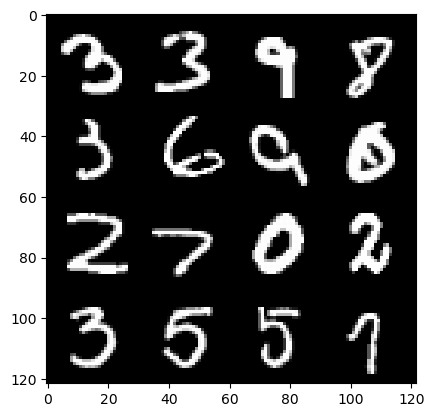

312: step 146400/ Gen loss: 1.9450687615076694/ disc_loss: 0.28853373363614065


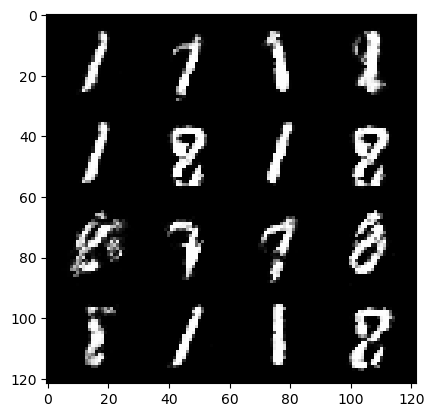

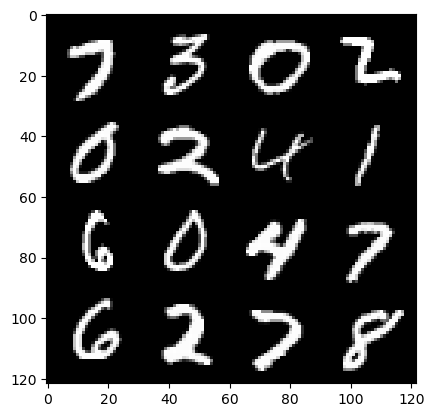

312: step 146700/ Gen loss: 1.8481732773780826/ disc_loss: 0.3092372931043309


  0%|          | 0/469 [00:00<?, ?it/s]

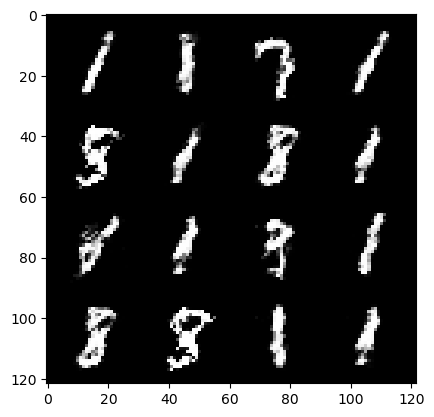

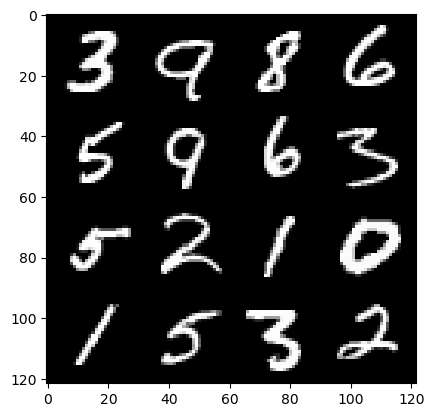

313: step 147000/ Gen loss: 1.886862702767055/ disc_loss: 0.3135442489385604


  0%|          | 0/469 [00:00<?, ?it/s]

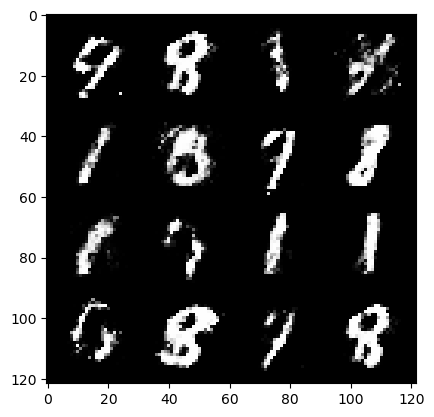

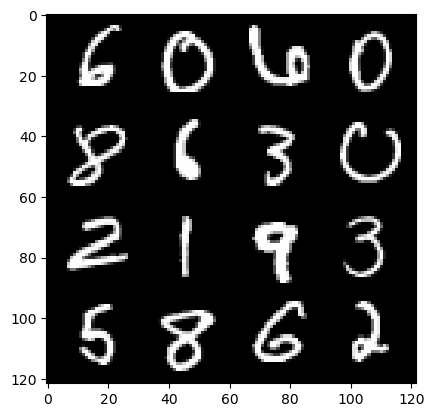

314: step 147300/ Gen loss: 1.9125318578879045/ disc_loss: 0.2976975660522782


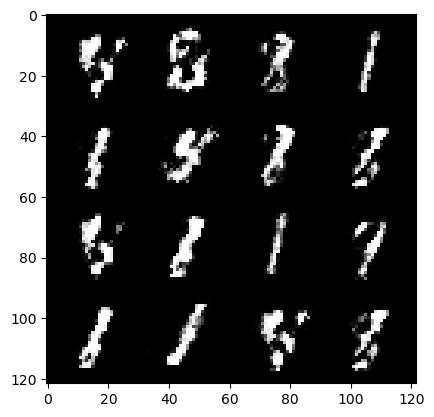

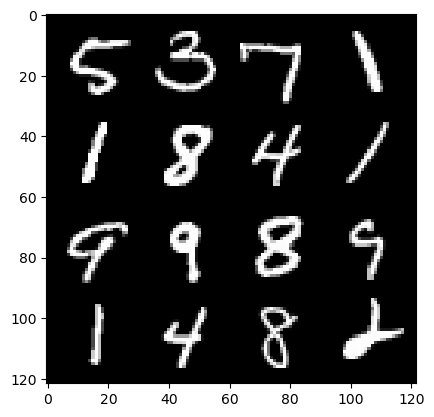

314: step 147600/ Gen loss: 1.9702023092905676/ disc_loss: 0.28989171564579025


  0%|          | 0/469 [00:00<?, ?it/s]

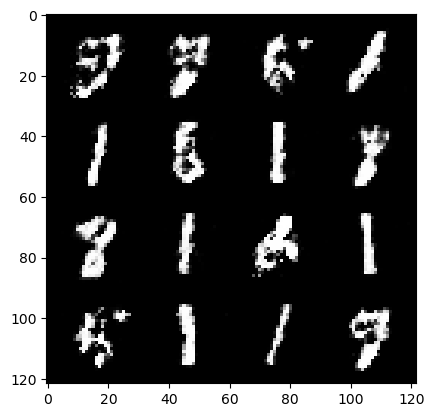

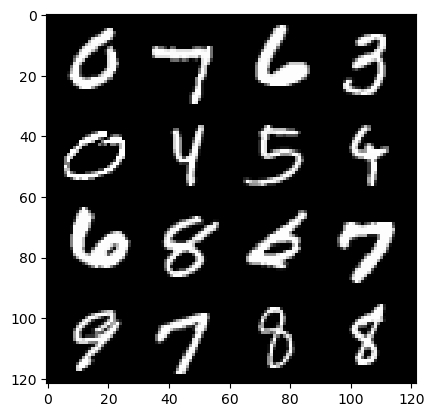

315: step 147900/ Gen loss: 2.0418412840366362/ disc_loss: 0.27588013882438345


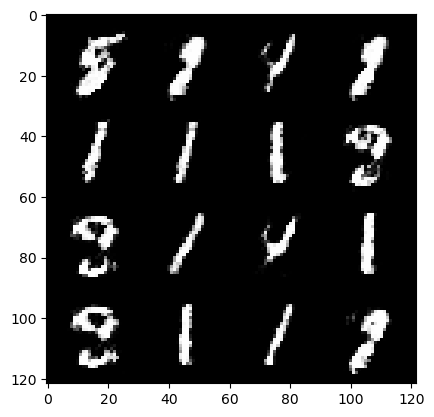

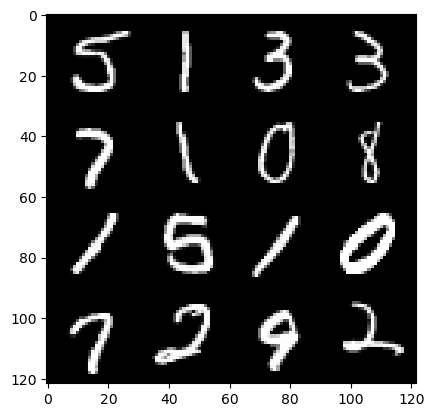

315: step 148200/ Gen loss: 1.9456457436084742/ disc_loss: 0.2800976986189684


  0%|          | 0/469 [00:00<?, ?it/s]

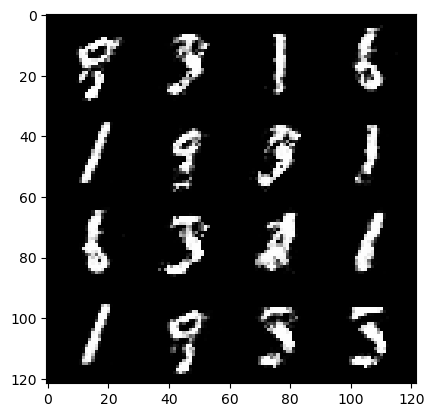

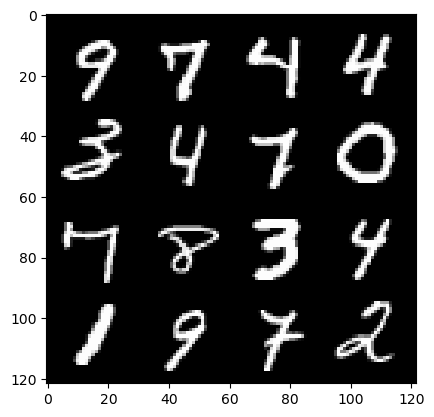

316: step 148500/ Gen loss: 1.9010072966416667/ disc_loss: 0.2989768445988495


  0%|          | 0/469 [00:00<?, ?it/s]

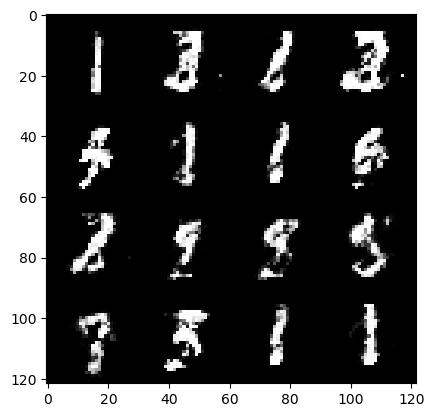

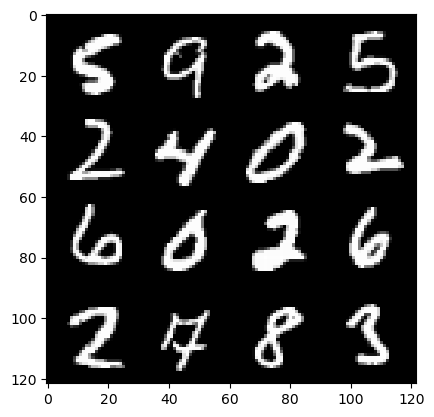

317: step 148800/ Gen loss: 1.8784977555274955/ disc_loss: 0.3011903652052083


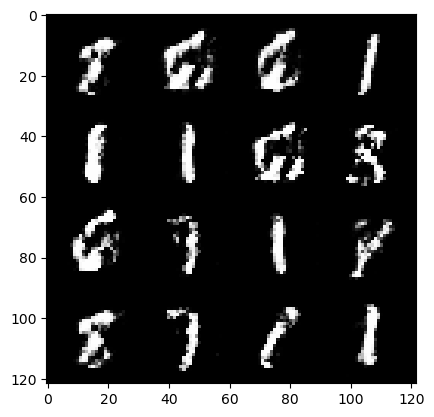

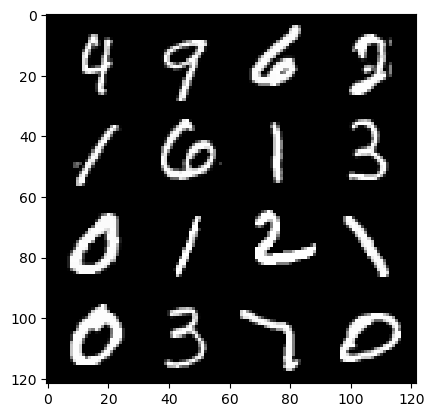

317: step 149100/ Gen loss: 1.9881248112519572/ disc_loss: 0.29266544411579765


  0%|          | 0/469 [00:00<?, ?it/s]

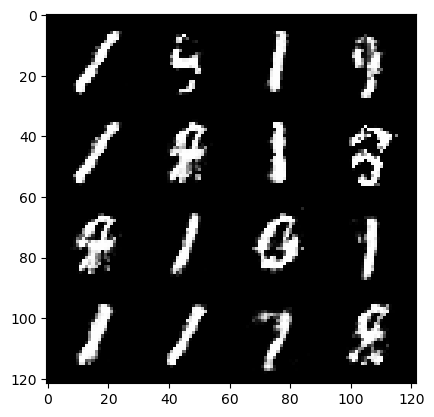

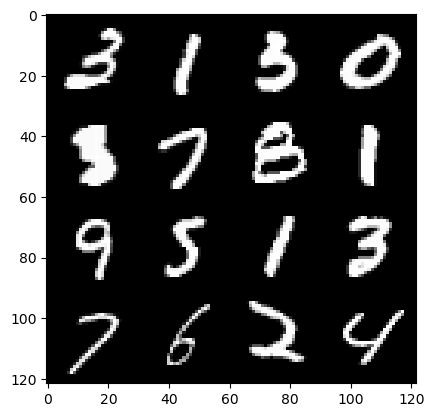

318: step 149400/ Gen loss: 1.9616215268770845/ disc_loss: 0.2978211250404518


  0%|          | 0/469 [00:00<?, ?it/s]

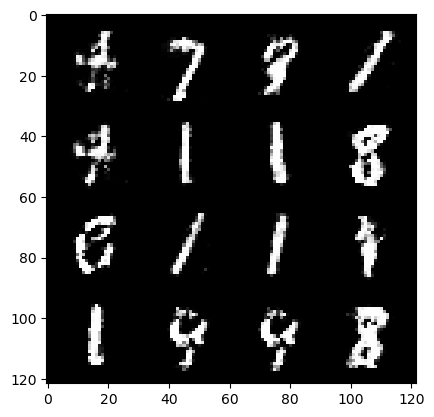

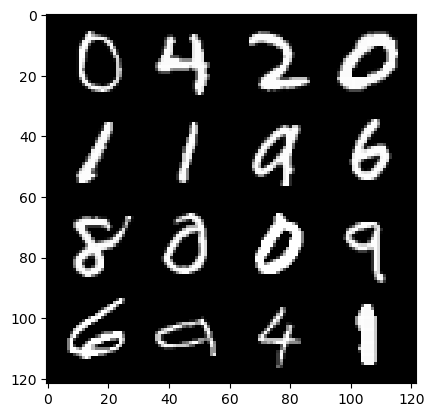

319: step 149700/ Gen loss: 1.8542499144872036/ disc_loss: 0.3056785716613134


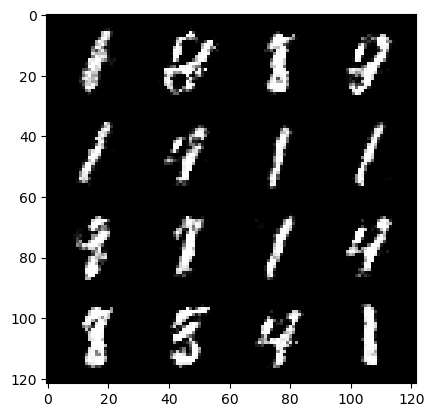

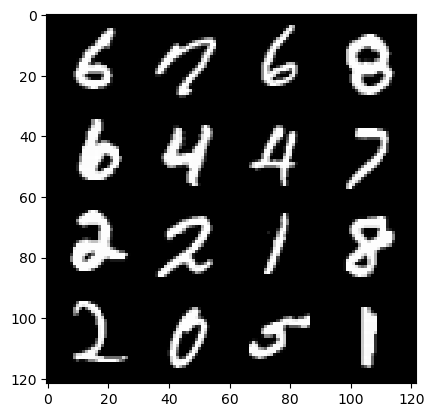

319: step 150000/ Gen loss: 1.952650822003683/ disc_loss: 0.3012597472469013


  0%|          | 0/469 [00:00<?, ?it/s]

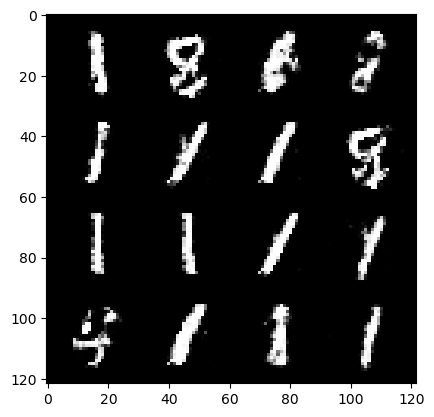

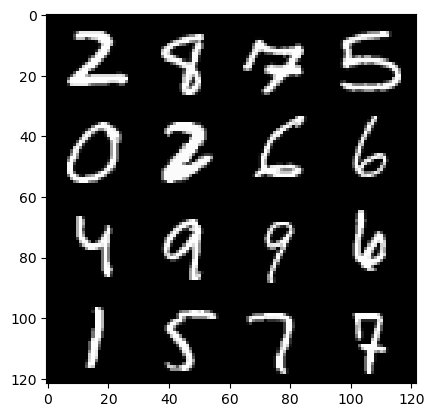

320: step 150300/ Gen loss: 1.8640026156107572/ disc_loss: 0.3093027468522389


  0%|          | 0/469 [00:00<?, ?it/s]

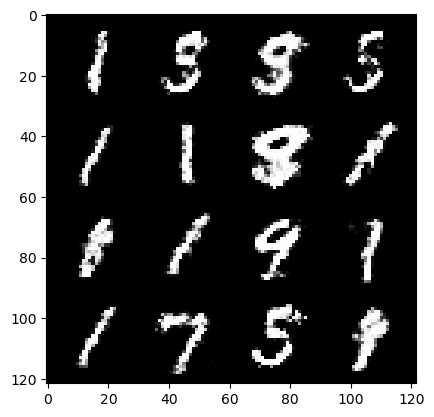

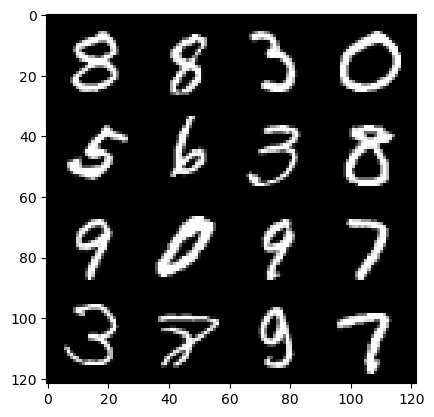

321: step 150600/ Gen loss: 1.8799045467376714/ disc_loss: 0.3096878096958


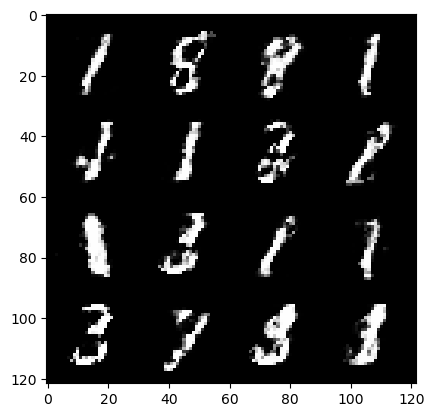

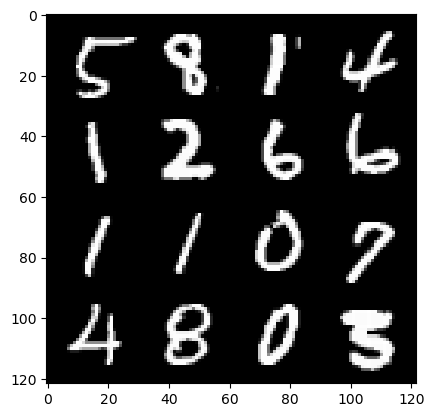

321: step 150900/ Gen loss: 1.8698790442943578/ disc_loss: 0.29803185115257896


  0%|          | 0/469 [00:00<?, ?it/s]

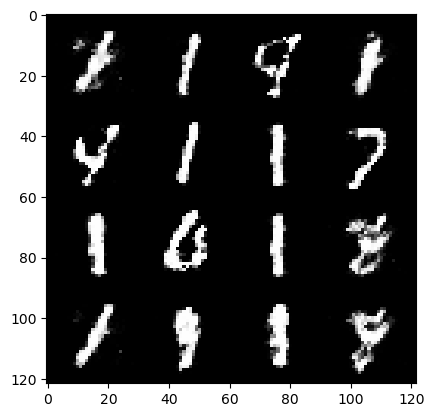

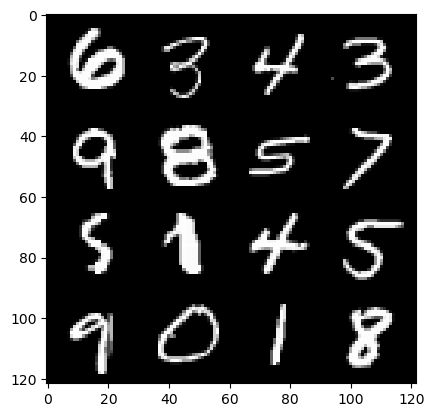

322: step 151200/ Gen loss: 1.908055360317231/ disc_loss: 0.29915530880292246


  0%|          | 0/469 [00:00<?, ?it/s]

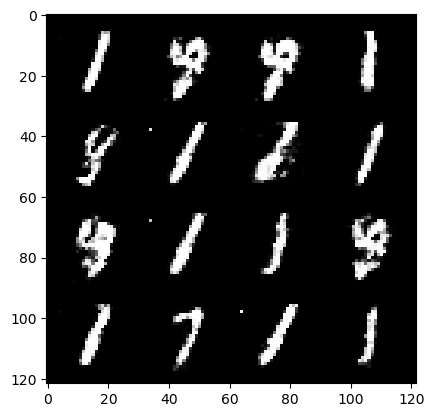

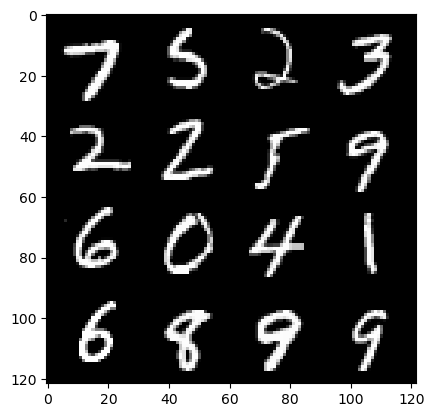

323: step 151500/ Gen loss: 1.930253110726675/ disc_loss: 0.3077695092558858


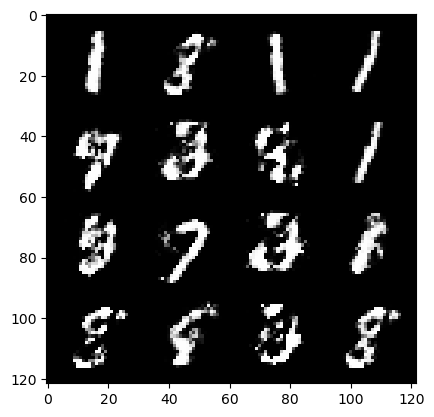

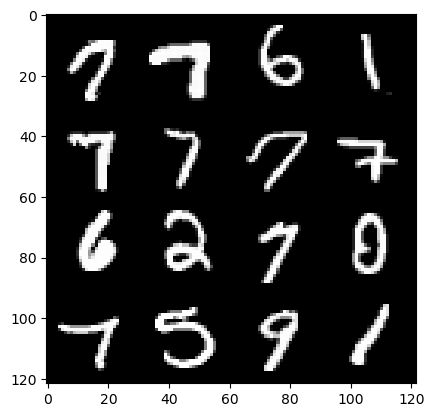

323: step 151800/ Gen loss: 1.9541765924294796/ disc_loss: 0.30309779211878796


  0%|          | 0/469 [00:00<?, ?it/s]

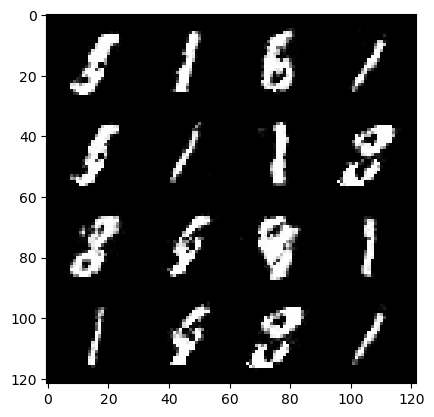

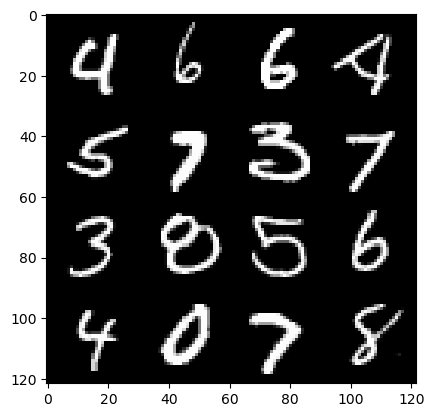

324: step 152100/ Gen loss: 1.9333566443125412/ disc_loss: 0.29515377417206756


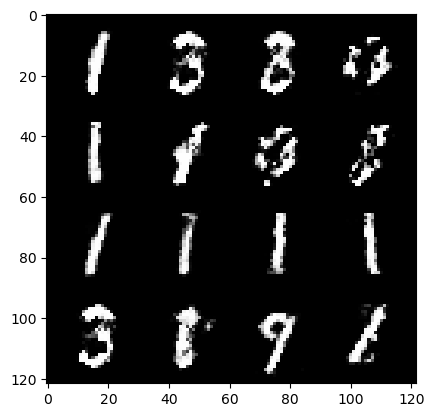

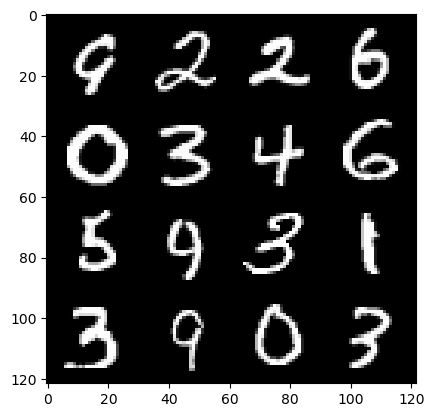

324: step 152400/ Gen loss: 1.9454764366149895/ disc_loss: 0.30969183415174495


  0%|          | 0/469 [00:00<?, ?it/s]

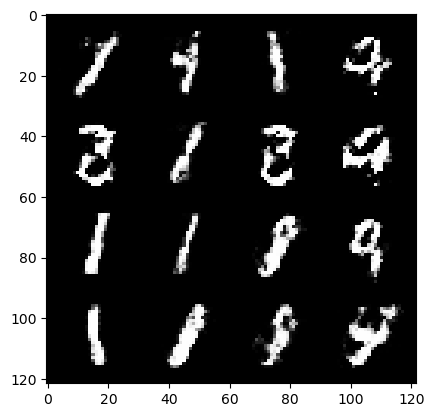

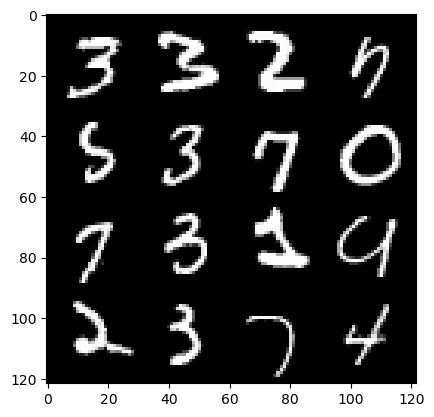

325: step 152700/ Gen loss: 1.8342724744478869/ disc_loss: 0.3065483754873275


  0%|          | 0/469 [00:00<?, ?it/s]

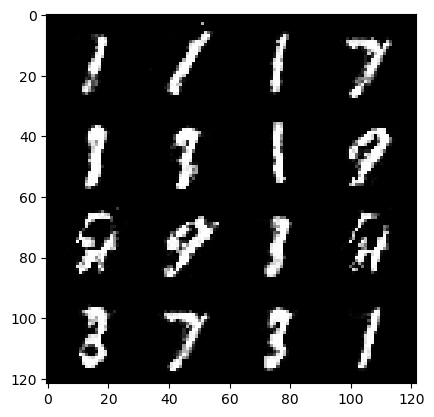

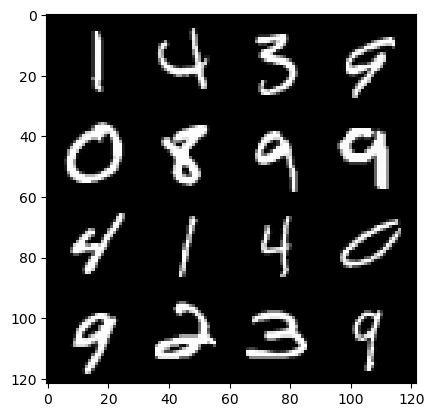

326: step 153000/ Gen loss: 1.947680139938991/ disc_loss: 0.29417723104357707


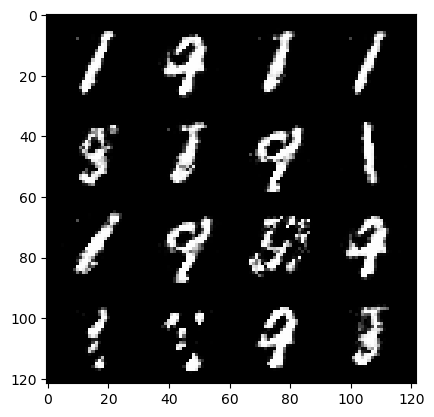

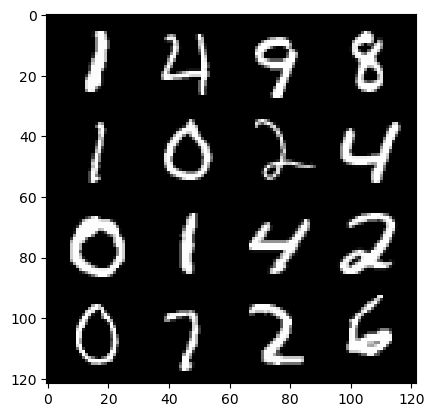

326: step 153300/ Gen loss: 2.1686130781968433/ disc_loss: 0.27697212959329287


  0%|          | 0/469 [00:00<?, ?it/s]

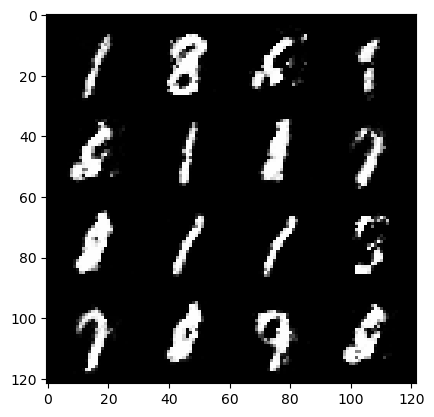

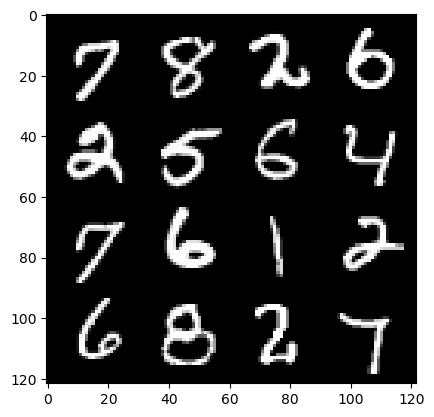

327: step 153600/ Gen loss: 2.034364964962004/ disc_loss: 0.27563970968127255


  0%|          | 0/469 [00:00<?, ?it/s]

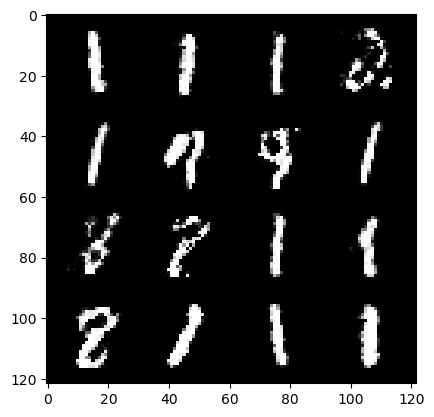

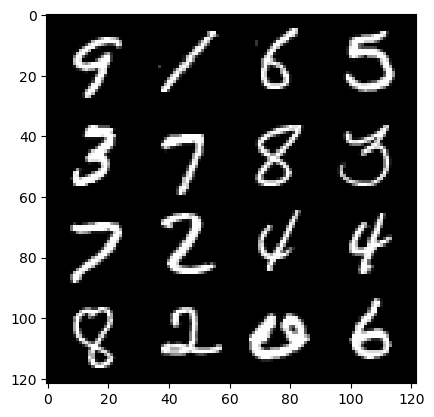

328: step 153900/ Gen loss: 2.103435592651366/ disc_loss: 0.2563998049994308


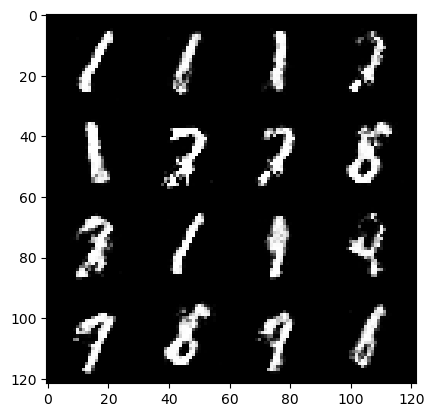

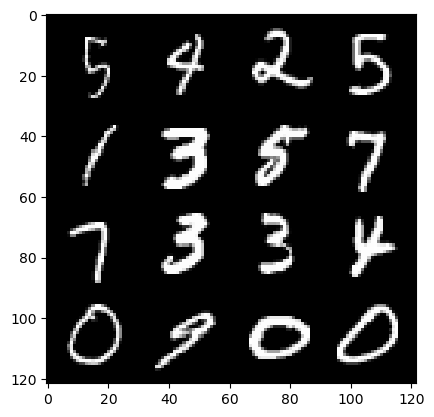

328: step 154200/ Gen loss: 2.0807838090260815/ disc_loss: 0.26933804949124673


  0%|          | 0/469 [00:00<?, ?it/s]

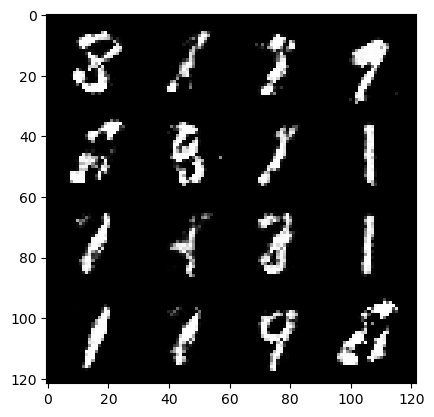

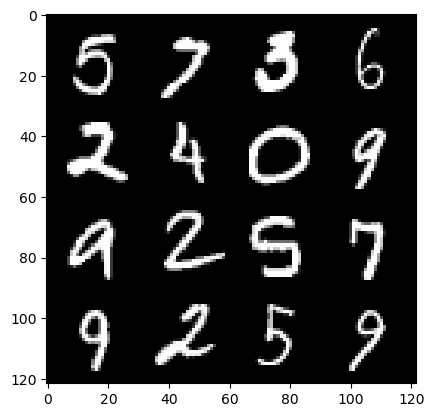

329: step 154500/ Gen loss: 1.851733978192011/ disc_loss: 0.31130526224772126


  0%|          | 0/469 [00:00<?, ?it/s]

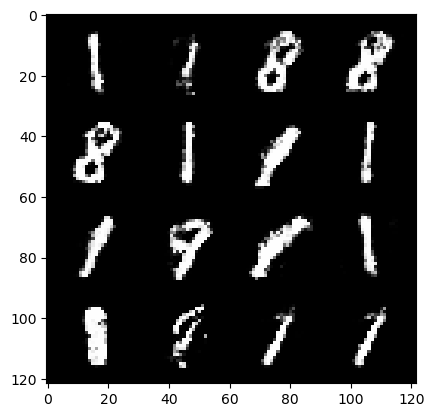

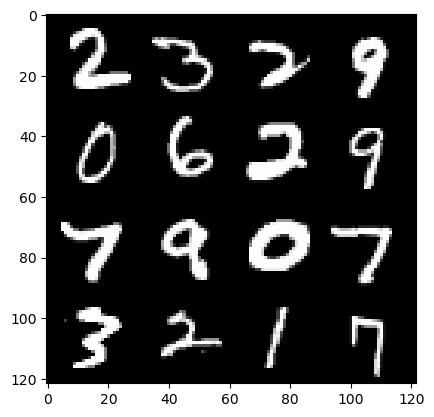

330: step 154800/ Gen loss: 1.973720183372497/ disc_loss: 0.284713178326686


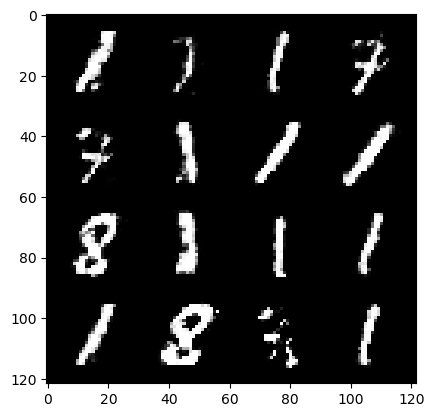

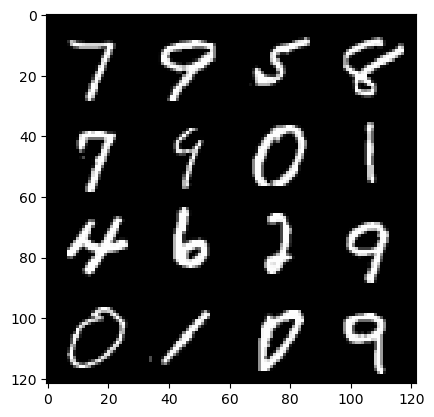

330: step 155100/ Gen loss: 1.8964812624454512/ disc_loss: 0.31362879266341537


  0%|          | 0/469 [00:00<?, ?it/s]

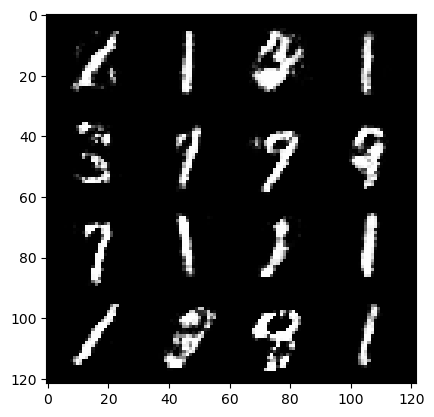

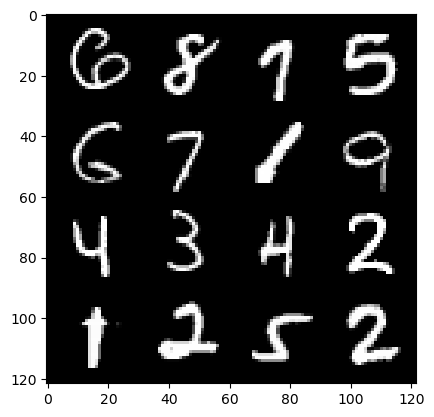

331: step 155400/ Gen loss: 1.9606123006343845/ disc_loss: 0.3050072565674785


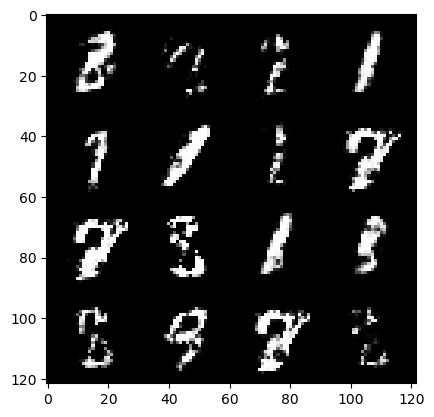

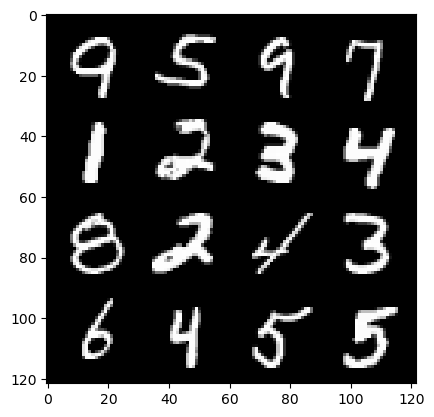

331: step 155700/ Gen loss: 1.8730253291130057/ disc_loss: 0.3126697803040344


  0%|          | 0/469 [00:00<?, ?it/s]

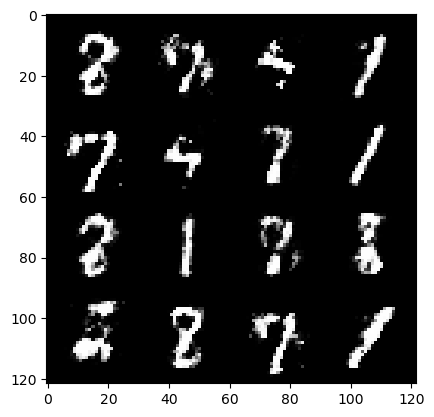

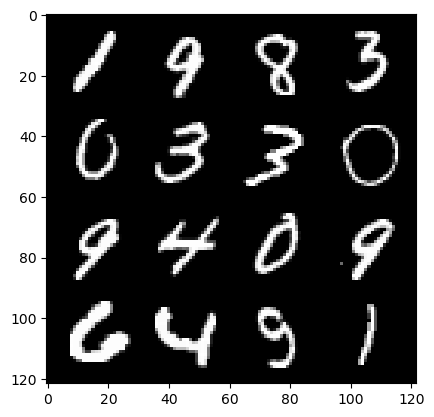

332: step 156000/ Gen loss: 1.9010479728380842/ disc_loss: 0.2929755264520644


  0%|          | 0/469 [00:00<?, ?it/s]

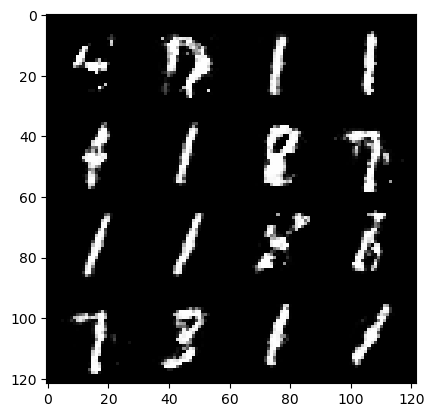

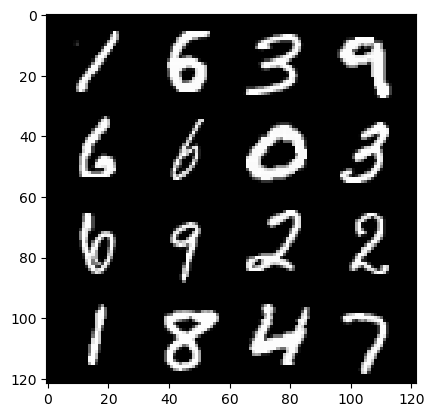

333: step 156300/ Gen loss: 1.872663638194402/ disc_loss: 0.30278162002563463


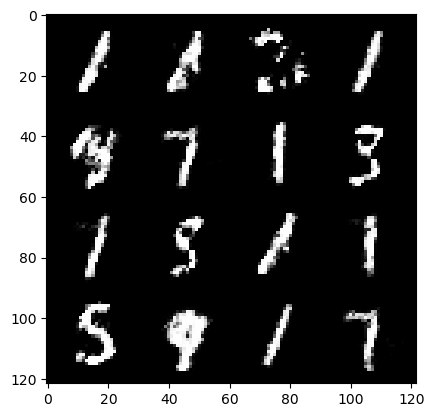

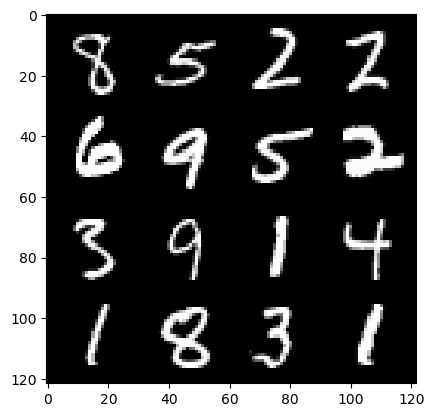

333: step 156600/ Gen loss: 1.8831406696637487/ disc_loss: 0.3334363635381062


  0%|          | 0/469 [00:00<?, ?it/s]

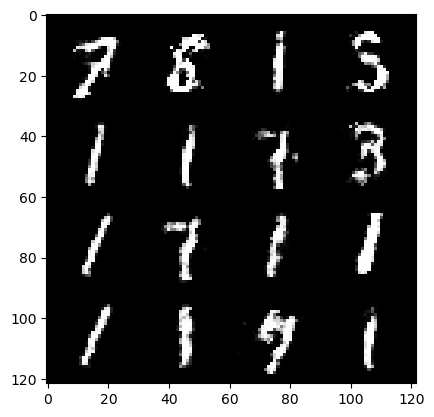

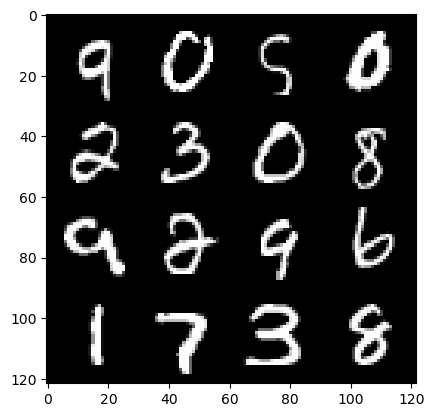

334: step 156900/ Gen loss: 1.8405011419455224/ disc_loss: 0.3111018106838068


  0%|          | 0/469 [00:00<?, ?it/s]

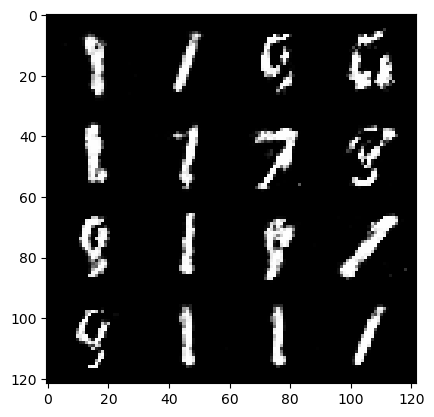

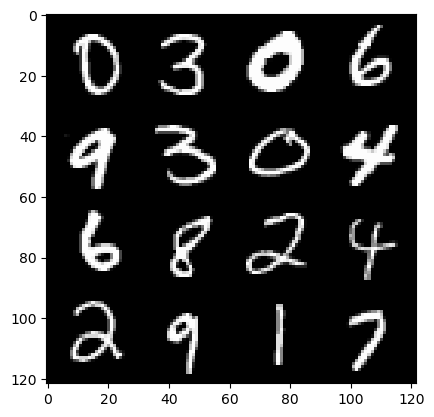

335: step 157200/ Gen loss: 1.8124209205309556/ disc_loss: 0.32278898268938083


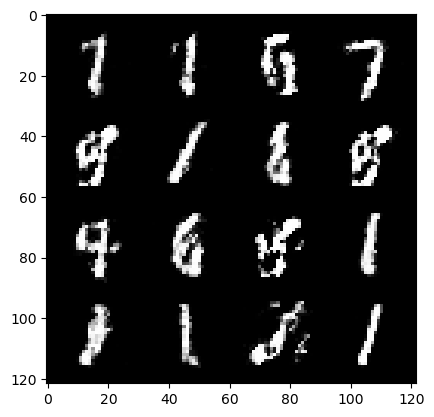

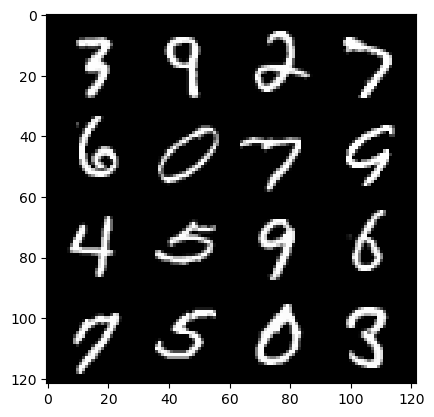

335: step 157500/ Gen loss: 1.8943287245432534/ disc_loss: 0.3075559625526269


  0%|          | 0/469 [00:00<?, ?it/s]

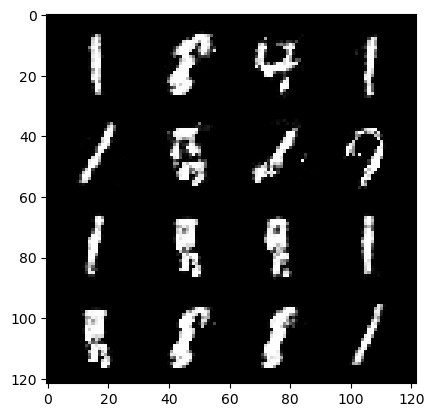

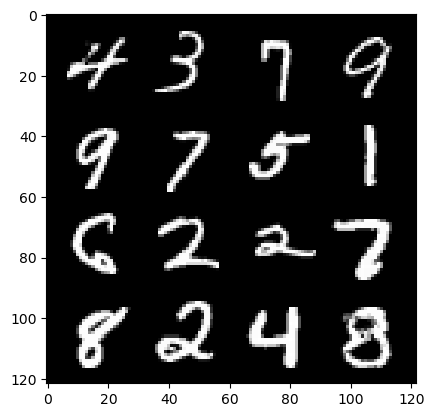

336: step 157800/ Gen loss: 1.879829922914505/ disc_loss: 0.3228511623044807


  0%|          | 0/469 [00:00<?, ?it/s]

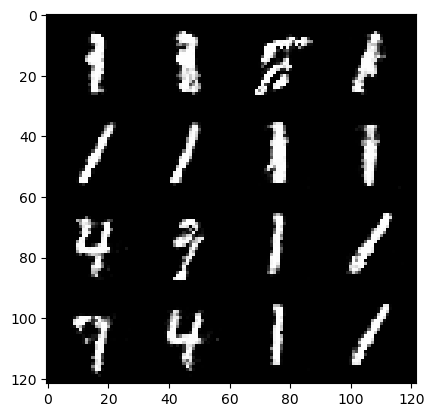

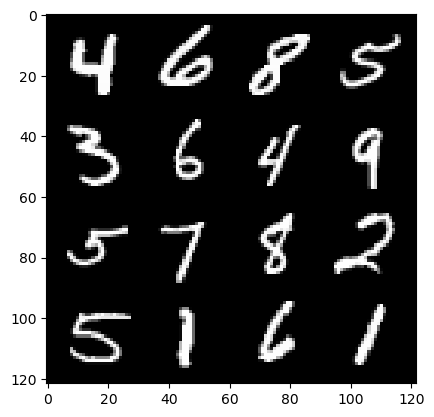

337: step 158100/ Gen loss: 1.934227036635082/ disc_loss: 0.3047866221268972


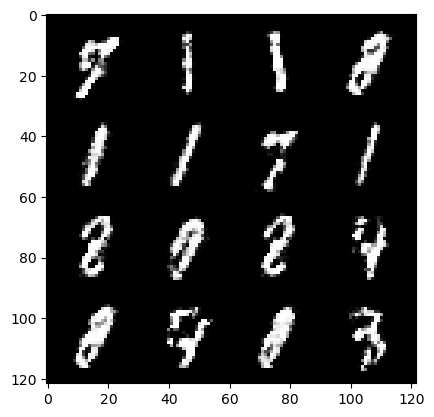

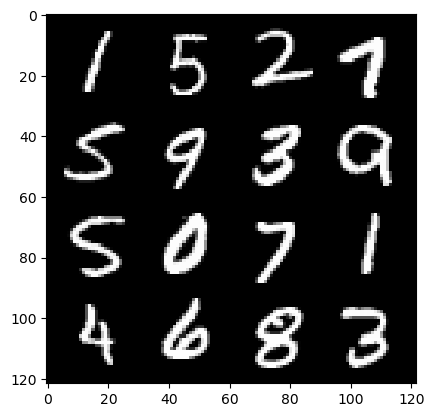

337: step 158400/ Gen loss: 1.8935587426026668/ disc_loss: 0.31749087616801275


  0%|          | 0/469 [00:00<?, ?it/s]

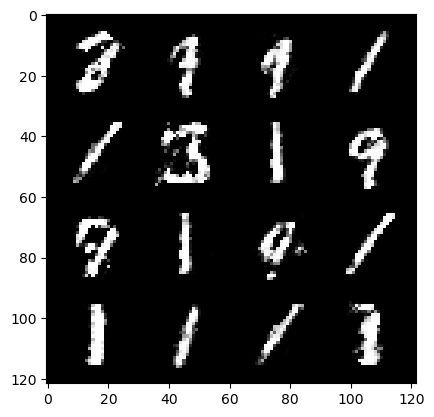

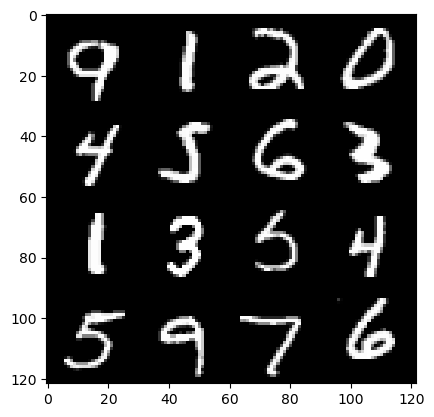

338: step 158700/ Gen loss: 1.9251215851306915/ disc_loss: 0.3184154713650543


  0%|          | 0/469 [00:00<?, ?it/s]

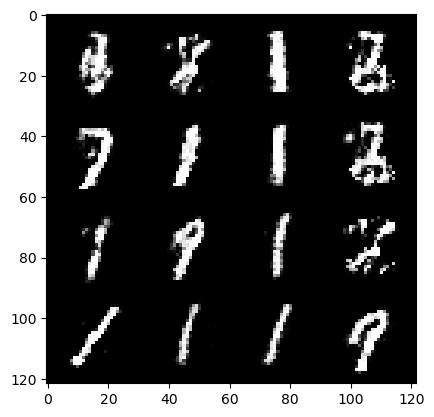

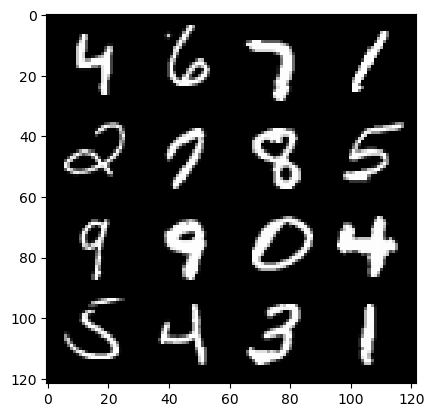

339: step 159000/ Gen loss: 1.9533759295940378/ disc_loss: 0.29155737037459983


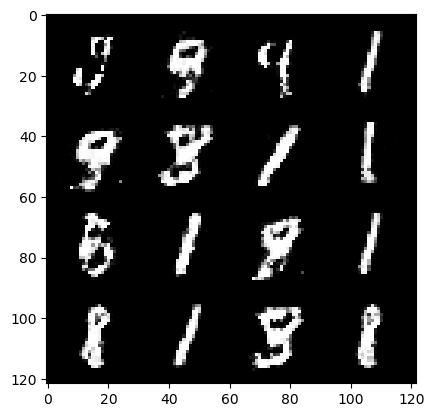

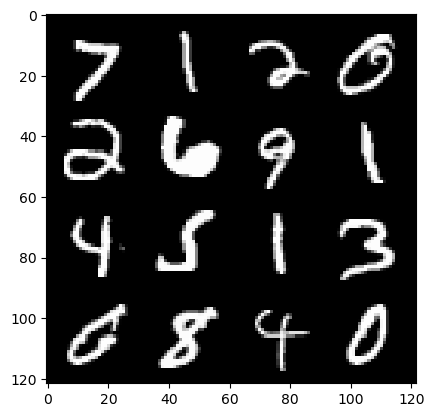

339: step 159300/ Gen loss: 1.871900141636531/ disc_loss: 0.30660323426127445


  0%|          | 0/469 [00:00<?, ?it/s]

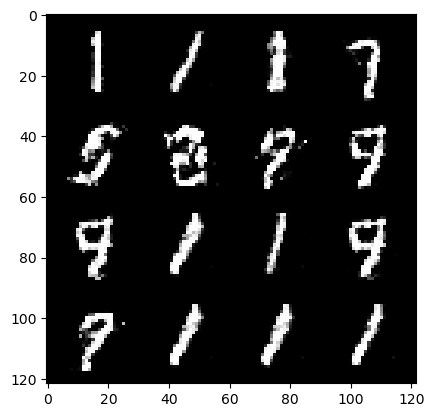

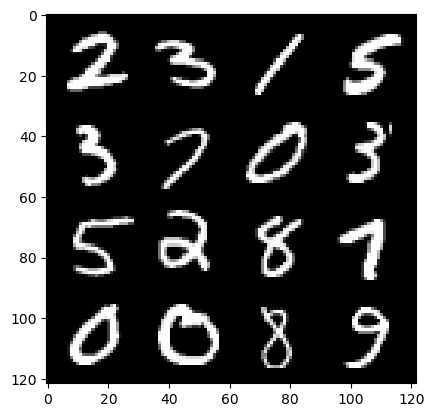

340: step 159600/ Gen loss: 1.8508132922649392/ disc_loss: 0.3179712913930418


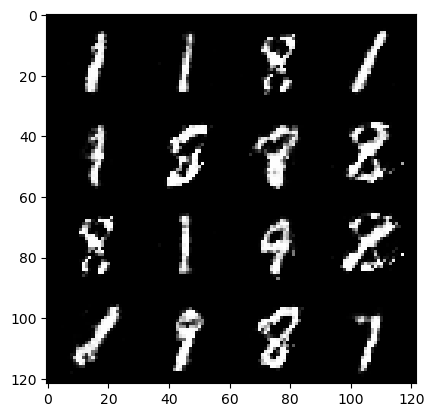

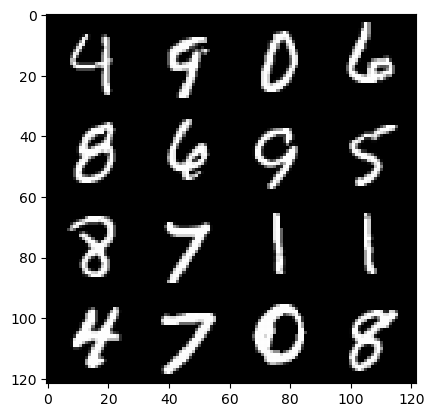

340: step 159900/ Gen loss: 1.8632719163099924/ disc_loss: 0.3162843789160252


  0%|          | 0/469 [00:00<?, ?it/s]

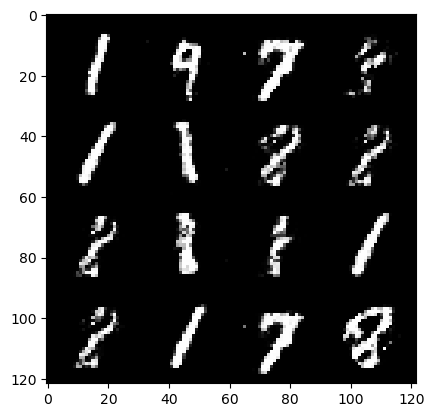

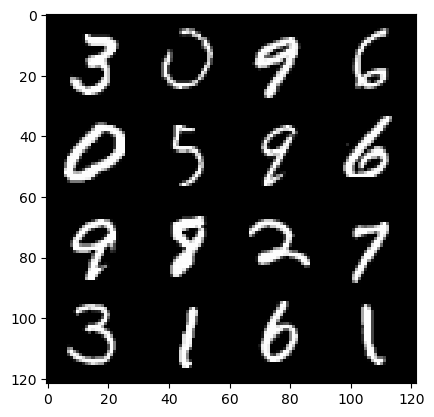

341: step 160200/ Gen loss: 1.9356110811233525/ disc_loss: 0.29902527689933767


  0%|          | 0/469 [00:00<?, ?it/s]

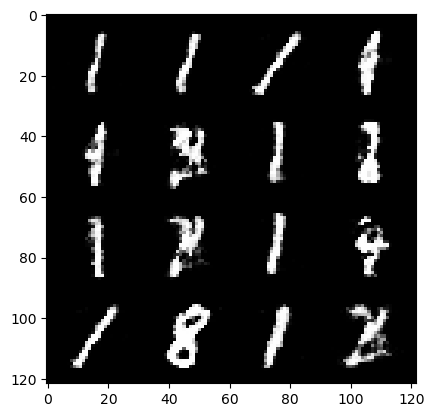

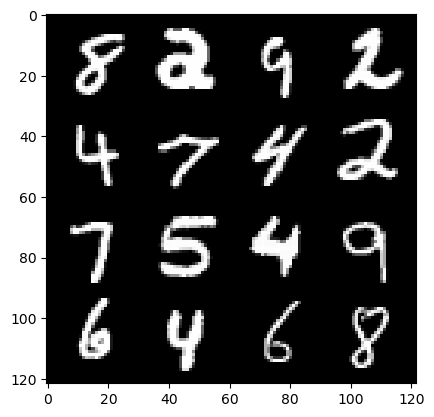

342: step 160500/ Gen loss: 1.890180121660233/ disc_loss: 0.3024895641704401


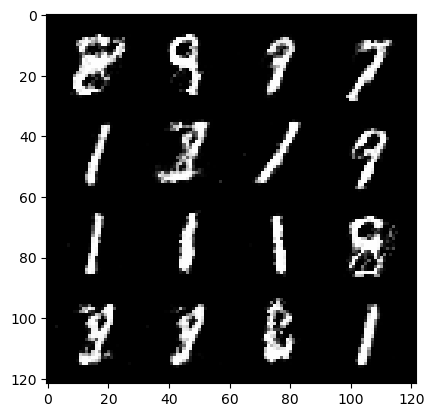

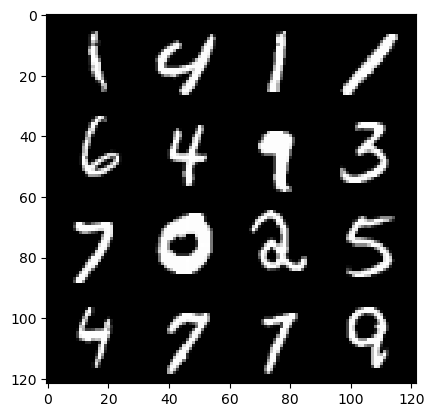

342: step 160800/ Gen loss: 1.9433704404036192/ disc_loss: 0.286509802589814


  0%|          | 0/469 [00:00<?, ?it/s]

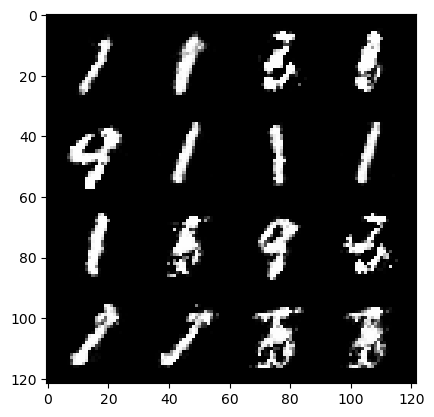

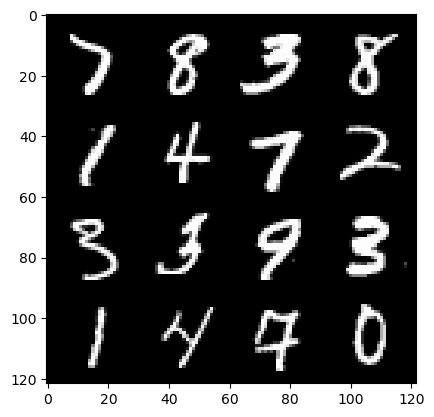

343: step 161100/ Gen loss: 1.9722973648707076/ disc_loss: 0.30107661416133247


  0%|          | 0/469 [00:00<?, ?it/s]

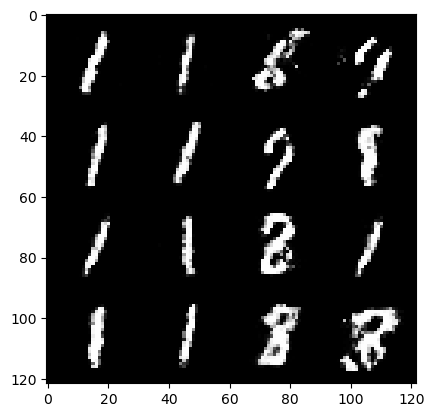

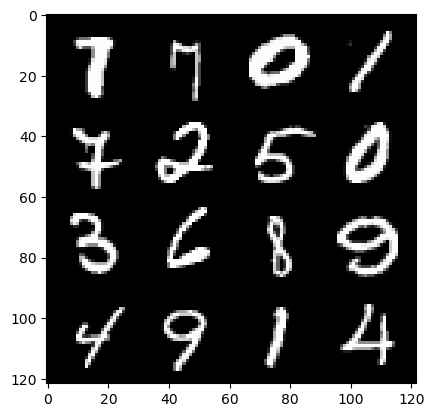

344: step 161400/ Gen loss: 1.9974007360140467/ disc_loss: 0.2898899665971596


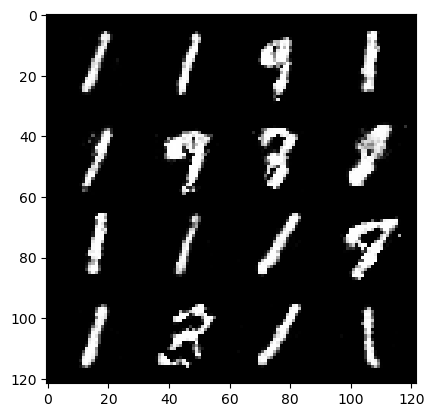

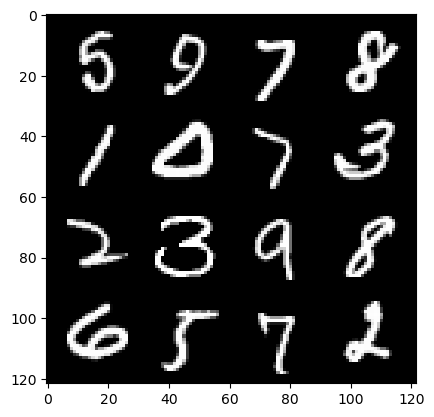

344: step 161700/ Gen loss: 2.0382707182566313/ disc_loss: 0.30003735477725657


  0%|          | 0/469 [00:00<?, ?it/s]

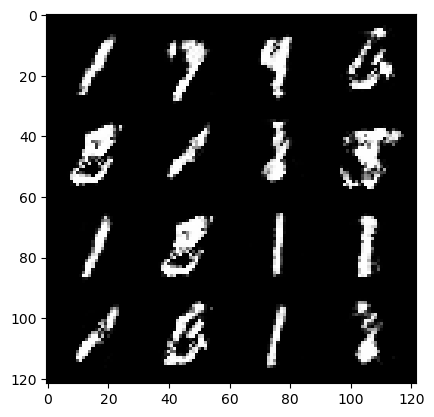

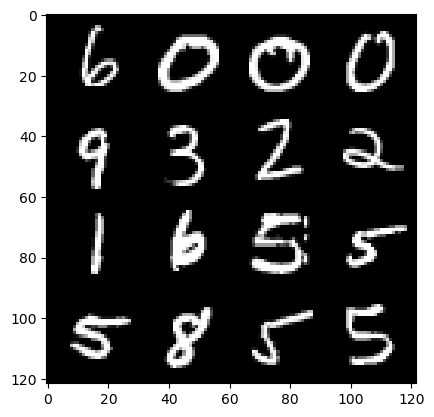

345: step 162000/ Gen loss: 1.9565143382549282/ disc_loss: 0.2918222118417422


  0%|          | 0/469 [00:00<?, ?it/s]

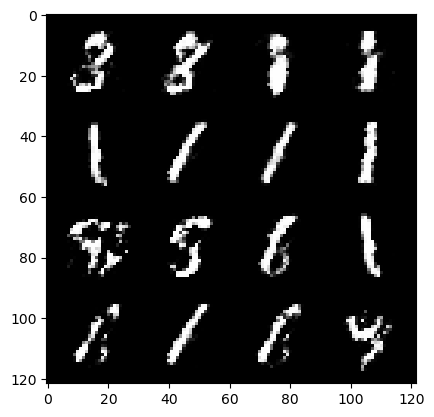

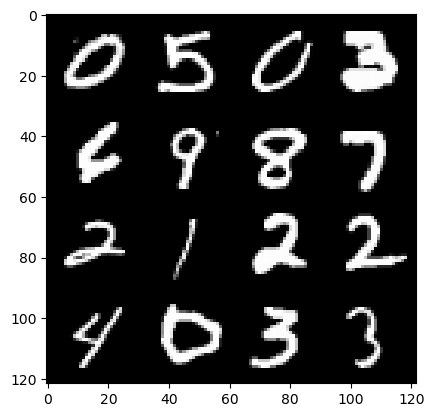

346: step 162300/ Gen loss: 1.9747091174125673/ disc_loss: 0.2953706368803977


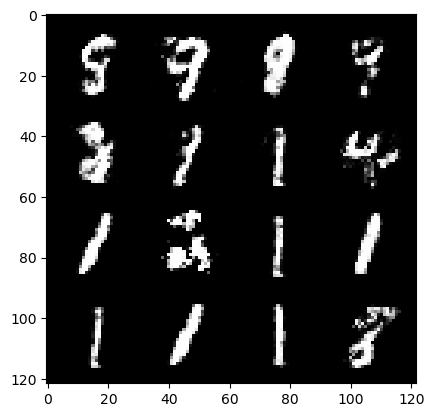

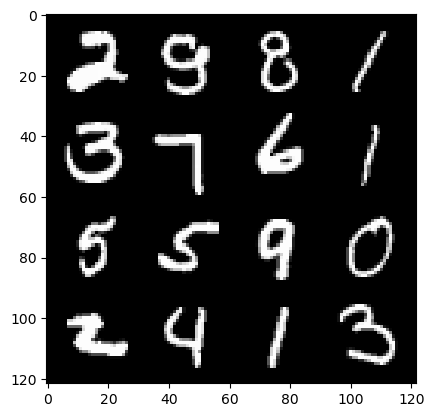

346: step 162600/ Gen loss: 1.8690499520301824/ disc_loss: 0.3187040969232718


  0%|          | 0/469 [00:00<?, ?it/s]

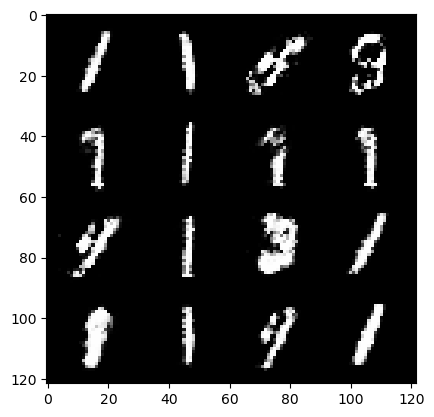

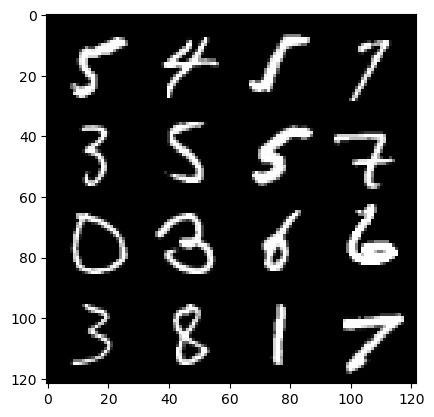

347: step 162900/ Gen loss: 1.896619655688603/ disc_loss: 0.3023955727616944


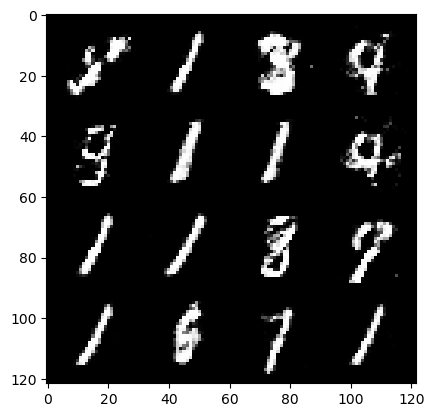

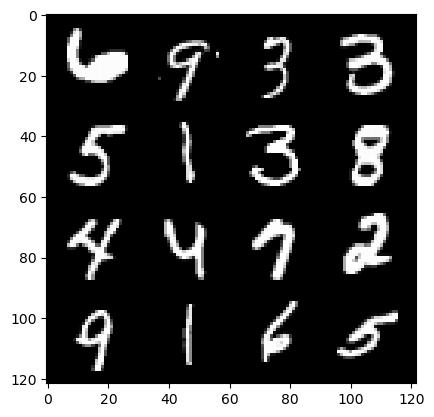

347: step 163200/ Gen loss: 1.8238363015651708/ disc_loss: 0.32080533415079127


  0%|          | 0/469 [00:00<?, ?it/s]

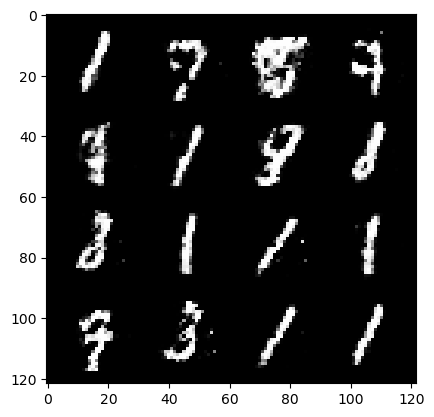

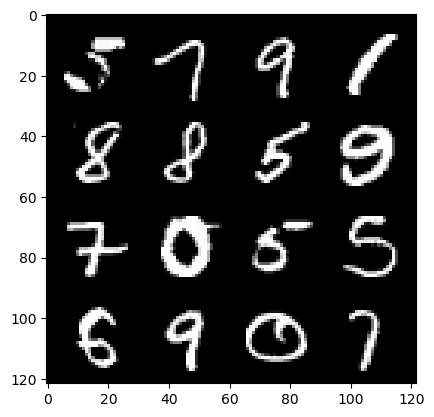

348: step 163500/ Gen loss: 1.873837289810183/ disc_loss: 0.3118383660415811


  0%|          | 0/469 [00:00<?, ?it/s]

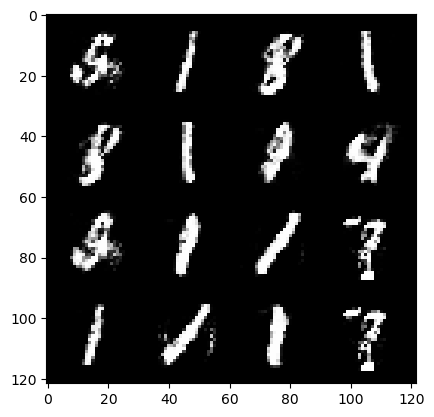

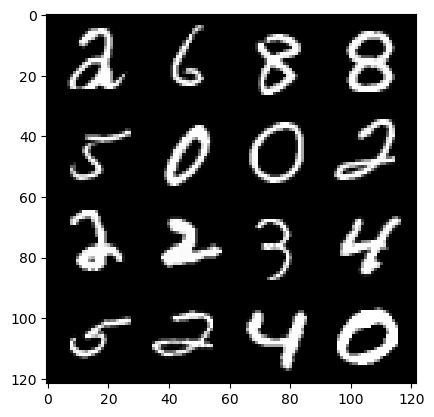

349: step 163800/ Gen loss: 1.929216022491457/ disc_loss: 0.300342567761739


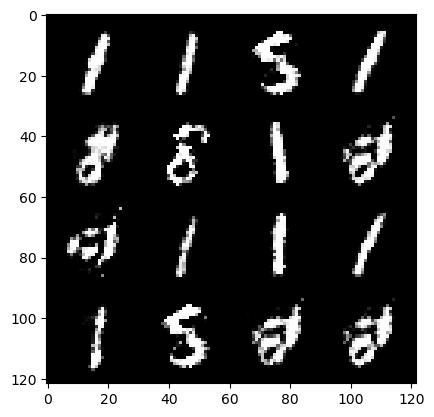

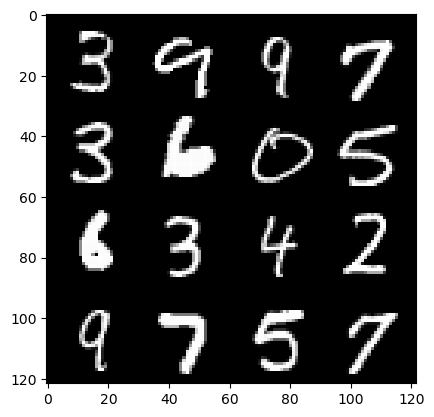

349: step 164100/ Gen loss: 1.9617522231737774/ disc_loss: 0.30356697266300514


  0%|          | 0/469 [00:00<?, ?it/s]

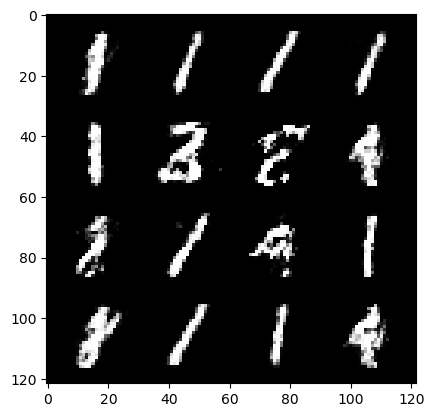

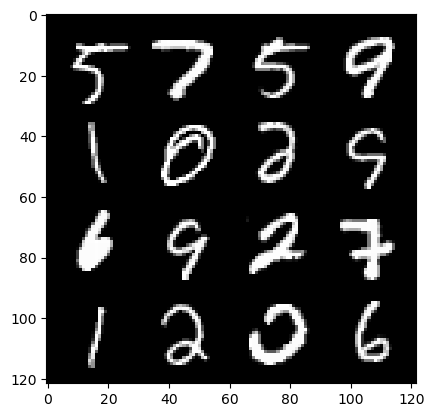

350: step 164400/ Gen loss: 1.9725112803777054/ disc_loss: 0.28658913215001436


  0%|          | 0/469 [00:00<?, ?it/s]

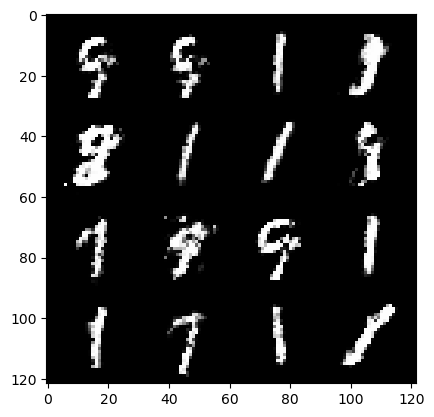

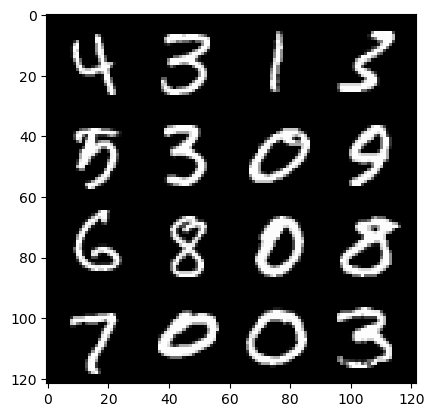

351: step 164700/ Gen loss: 2.0084555335839585/ disc_loss: 0.29565198585391067


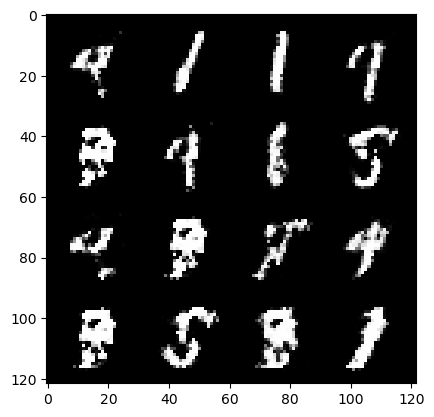

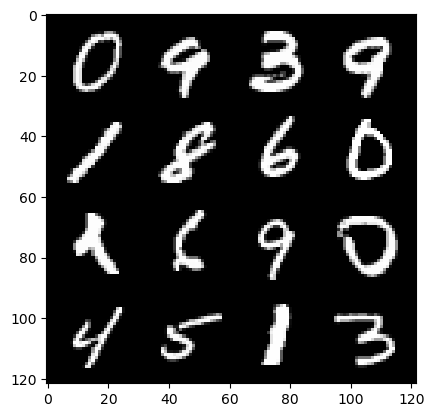

351: step 165000/ Gen loss: 1.9736391750971474/ disc_loss: 0.2833207643528783


  0%|          | 0/469 [00:00<?, ?it/s]

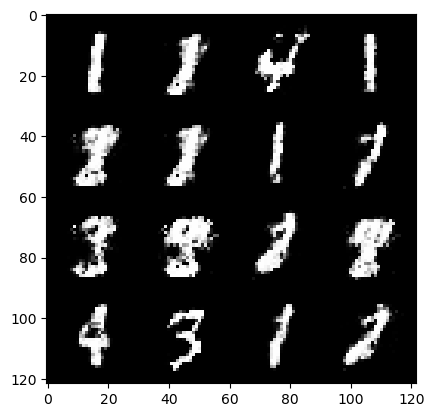

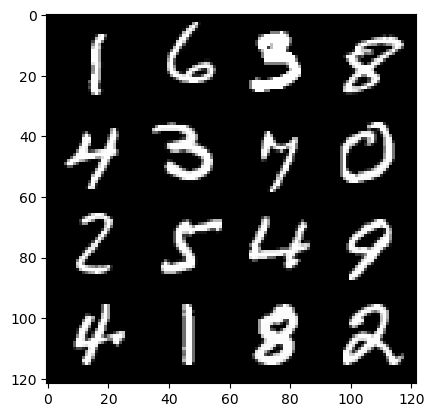

352: step 165300/ Gen loss: 2.088342321316402/ disc_loss: 0.28540013000369086


  0%|          | 0/469 [00:00<?, ?it/s]

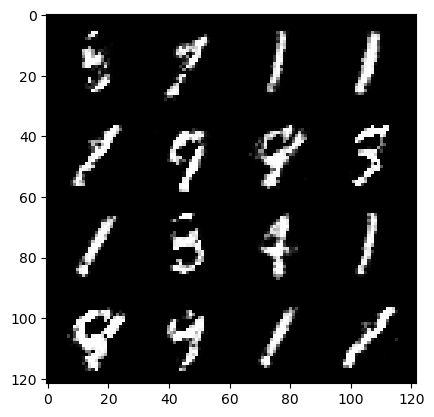

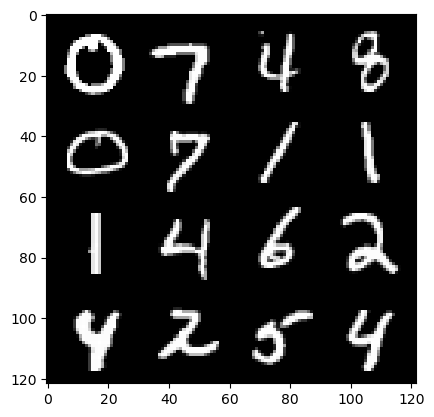

353: step 165600/ Gen loss: 1.95397438844045/ disc_loss: 0.30085697929064453


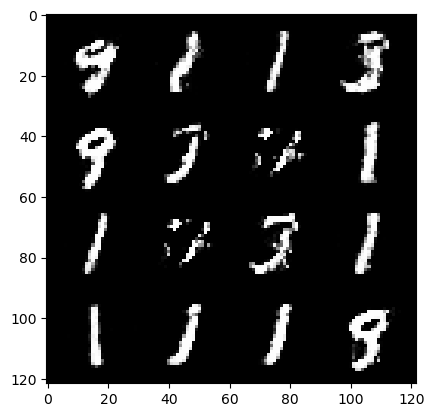

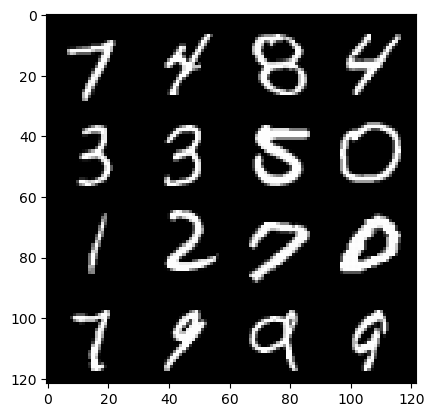

353: step 165900/ Gen loss: 2.010122421582539/ disc_loss: 0.29970316817363135


  0%|          | 0/469 [00:00<?, ?it/s]

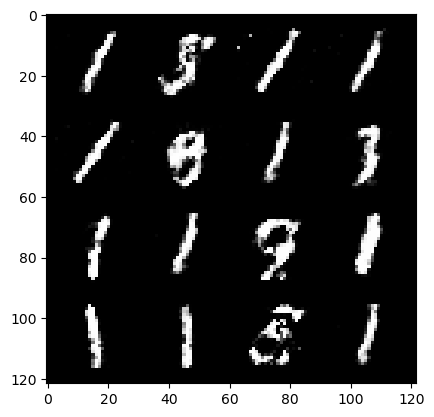

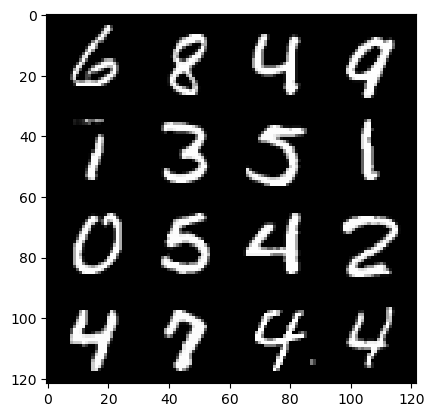

354: step 166200/ Gen loss: 1.9928347901503243/ disc_loss: 0.3053620674709479


  0%|          | 0/469 [00:00<?, ?it/s]

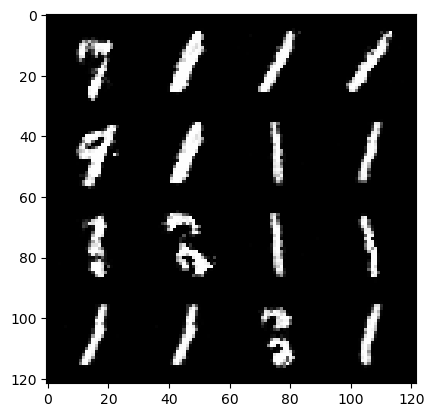

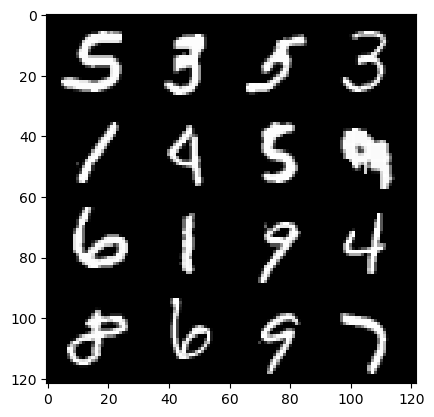

355: step 166500/ Gen loss: 1.861606757243474/ disc_loss: 0.31069754863778765


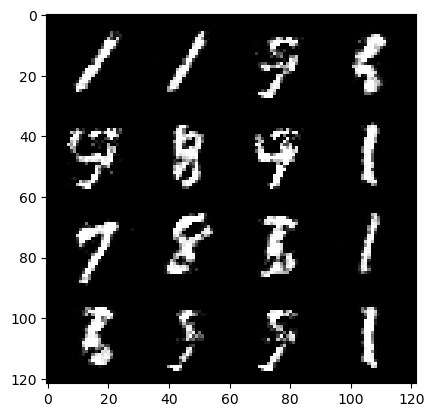

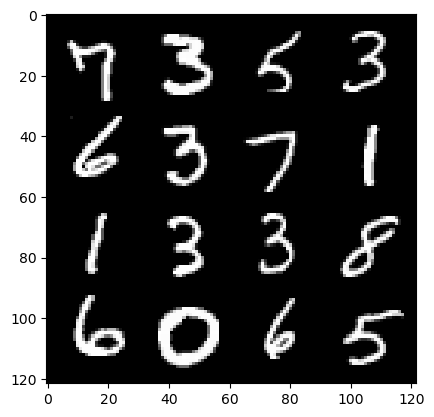

355: step 166800/ Gen loss: 1.978012832005819/ disc_loss: 0.2789692764977614


  0%|          | 0/469 [00:00<?, ?it/s]

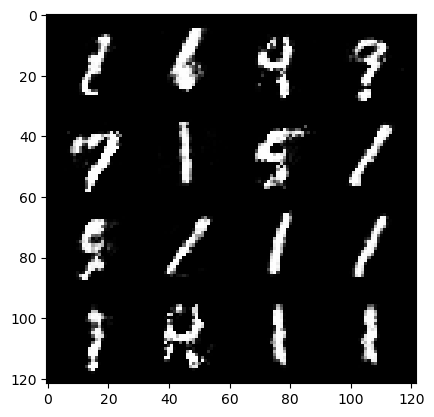

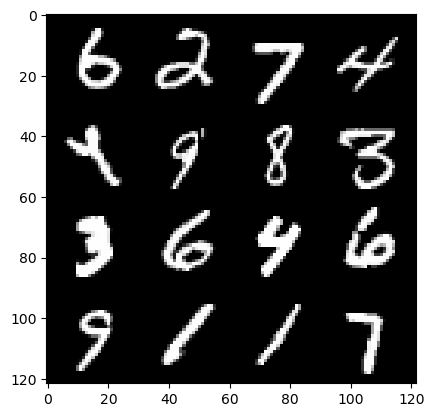

356: step 167100/ Gen loss: 1.9017318801085152/ disc_loss: 0.30088057135542207


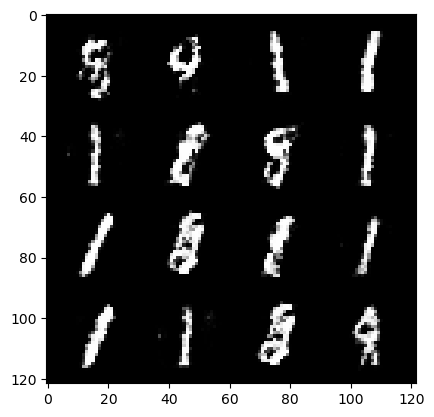

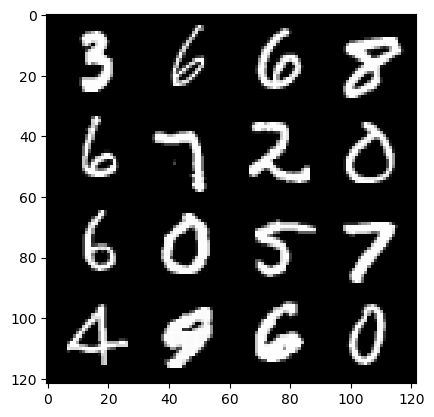

356: step 167400/ Gen loss: 1.9650536378224688/ disc_loss: 0.2933255828917026


  0%|          | 0/469 [00:00<?, ?it/s]

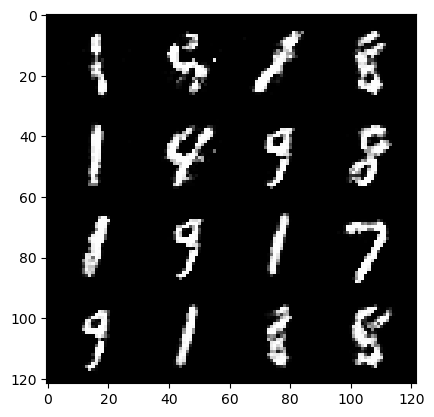

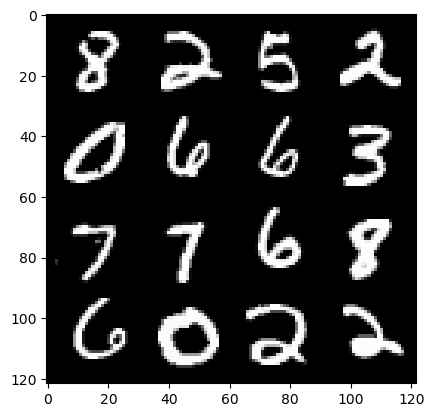

357: step 167700/ Gen loss: 1.976189006567001/ disc_loss: 0.28964157447218924


  0%|          | 0/469 [00:00<?, ?it/s]

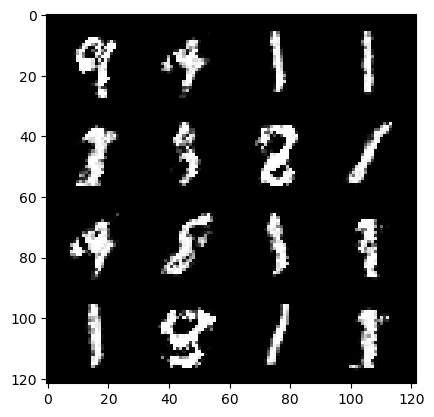

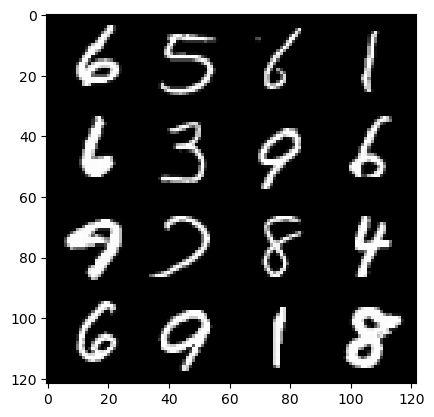

358: step 168000/ Gen loss: 1.975147215525309/ disc_loss: 0.29563694879412633


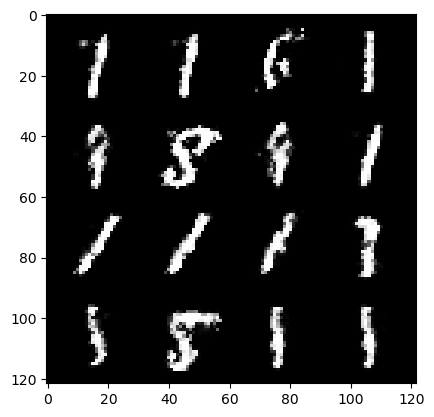

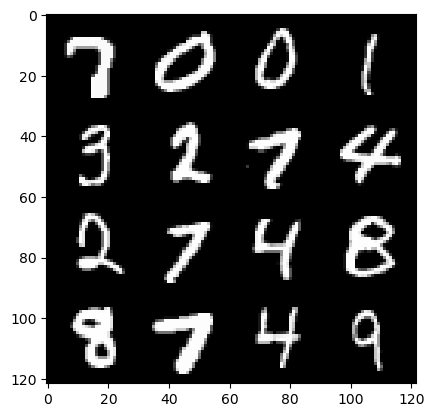

358: step 168300/ Gen loss: 2.001080849965413/ disc_loss: 0.30017584651708584


  0%|          | 0/469 [00:00<?, ?it/s]

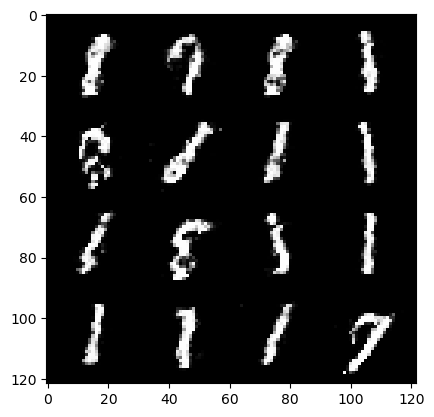

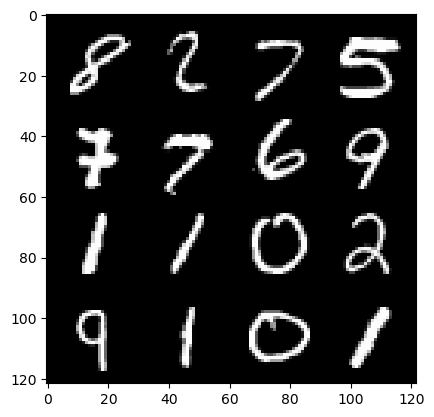

359: step 168600/ Gen loss: 1.9010429592927298/ disc_loss: 0.30499141260981555


  0%|          | 0/469 [00:00<?, ?it/s]

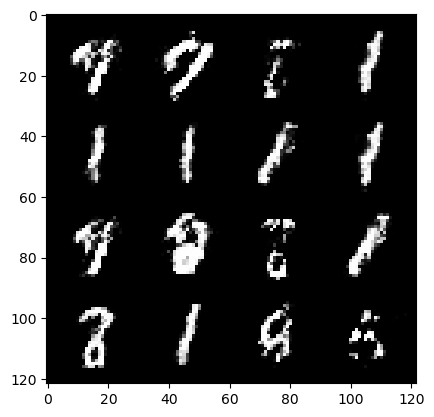

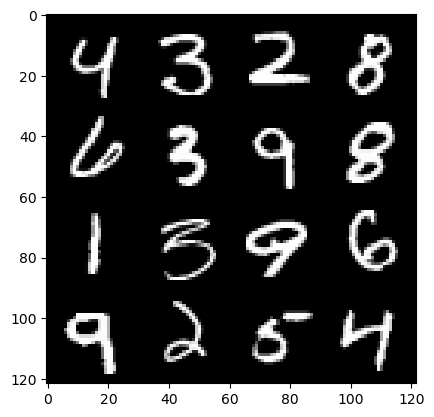

360: step 168900/ Gen loss: 2.0026160252094267/ disc_loss: 0.27273301338156086


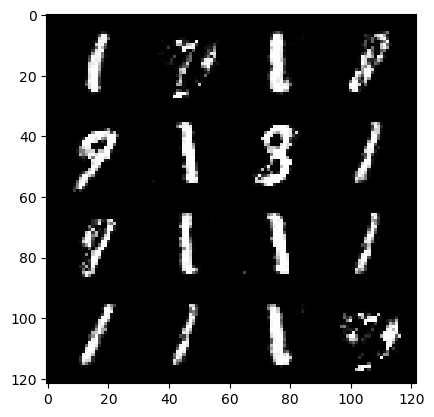

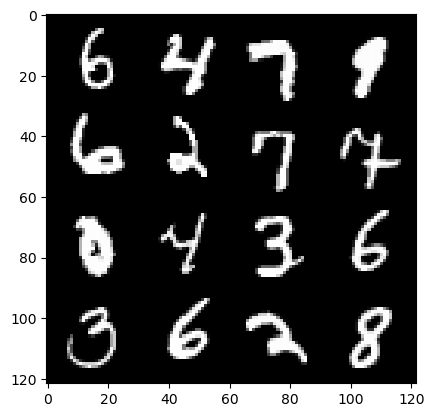

360: step 169200/ Gen loss: 2.014003534317016/ disc_loss: 0.2930296545227367


  0%|          | 0/469 [00:00<?, ?it/s]

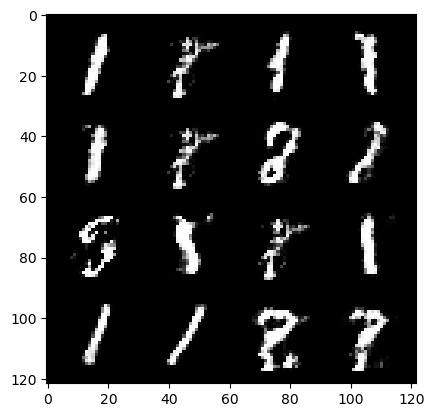

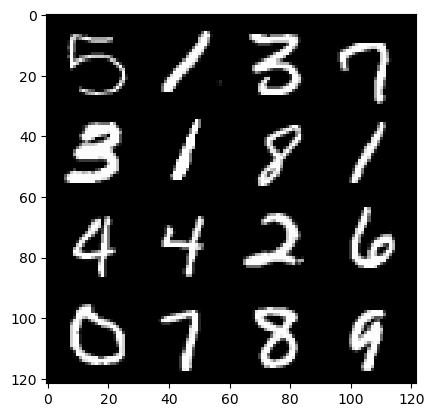

361: step 169500/ Gen loss: 2.007446132500965/ disc_loss: 0.29553270881374694


  0%|          | 0/469 [00:00<?, ?it/s]

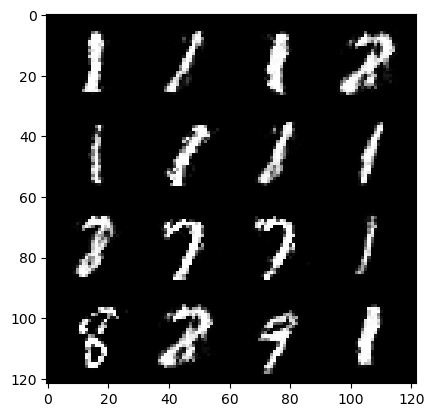

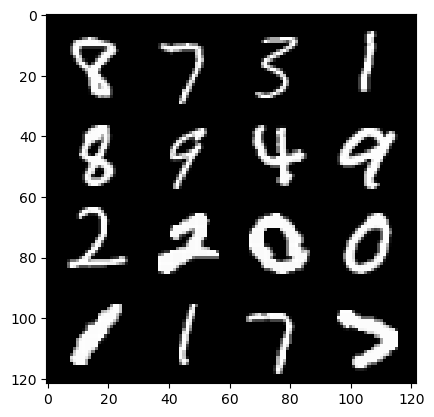

362: step 169800/ Gen loss: 1.8574740115801491/ disc_loss: 0.3243345749874909


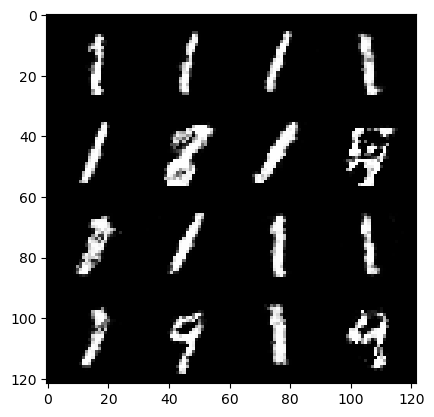

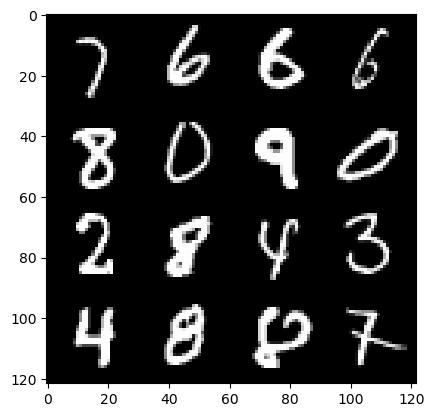

362: step 170100/ Gen loss: 1.9286229622364026/ disc_loss: 0.30486435532569867


  0%|          | 0/469 [00:00<?, ?it/s]

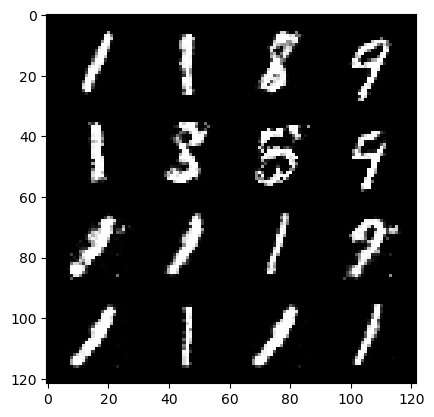

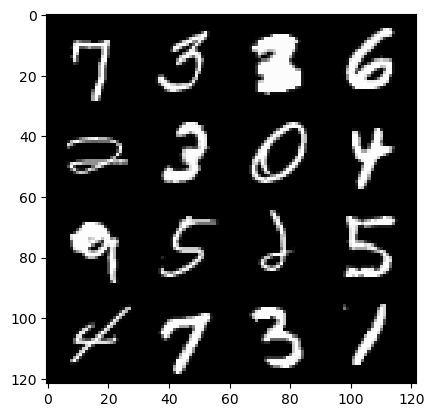

363: step 170400/ Gen loss: 1.9216286381085717/ disc_loss: 0.3159735774000487


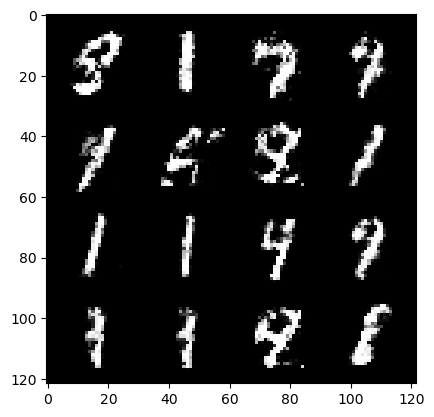

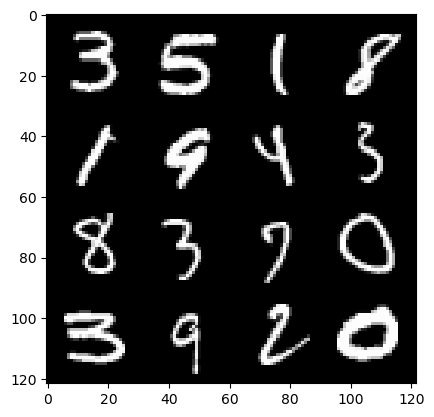

363: step 170700/ Gen loss: 1.885446983973187/ disc_loss: 0.3110423743724822


  0%|          | 0/469 [00:00<?, ?it/s]

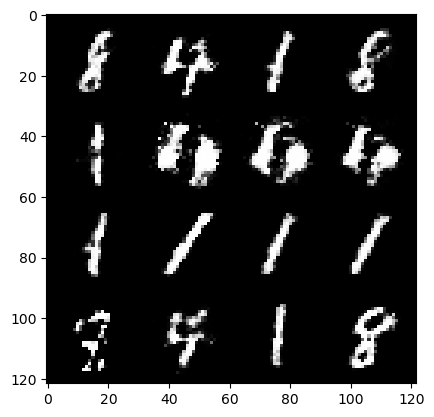

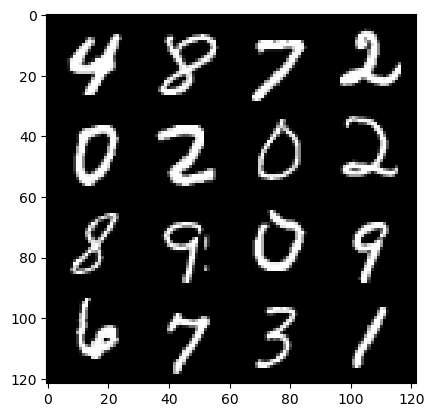

364: step 171000/ Gen loss: 1.949200259049735/ disc_loss: 0.29714177340269077


  0%|          | 0/469 [00:00<?, ?it/s]

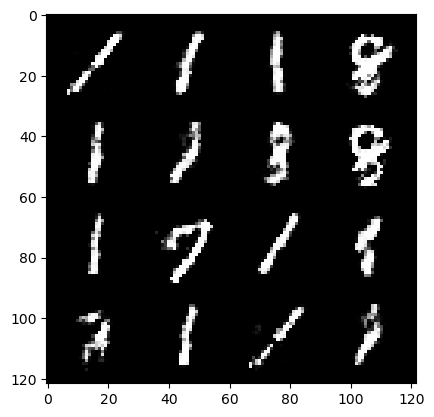

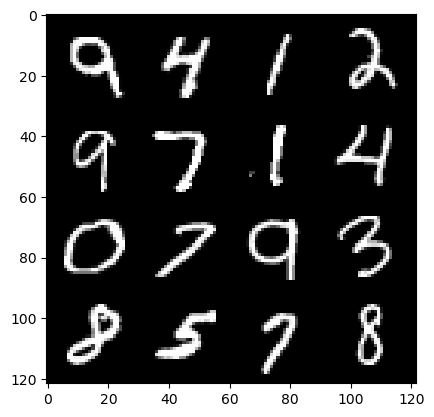

365: step 171300/ Gen loss: 1.9268936995665242/ disc_loss: 0.3042580961684386


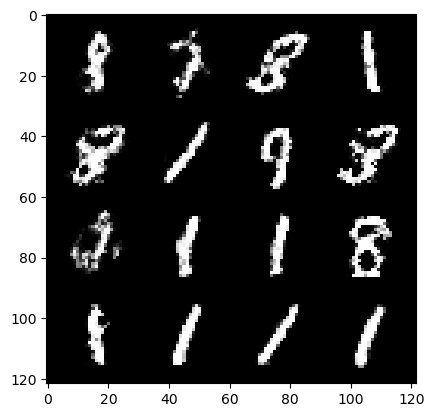

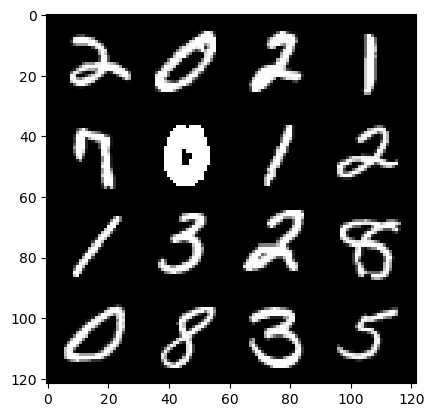

365: step 171600/ Gen loss: 1.993289002577463/ disc_loss: 0.28720082605878505


  0%|          | 0/469 [00:00<?, ?it/s]

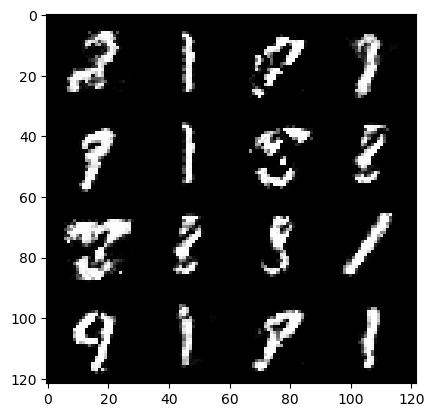

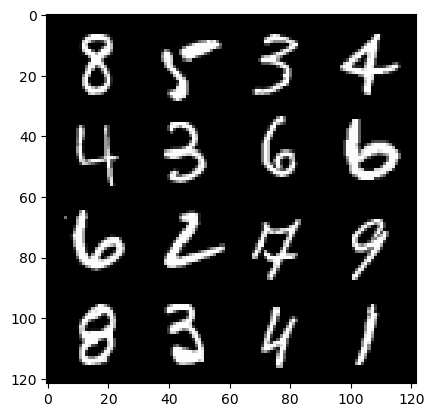

366: step 171900/ Gen loss: 1.9968566874663045/ disc_loss: 0.307209282517433


  0%|          | 0/469 [00:00<?, ?it/s]

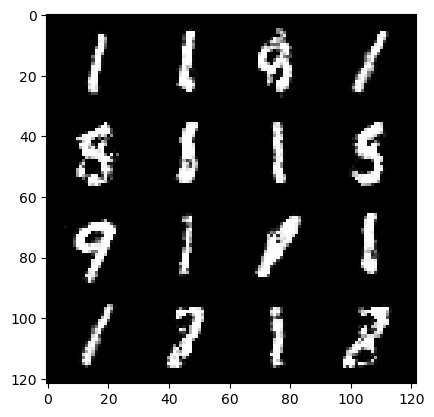

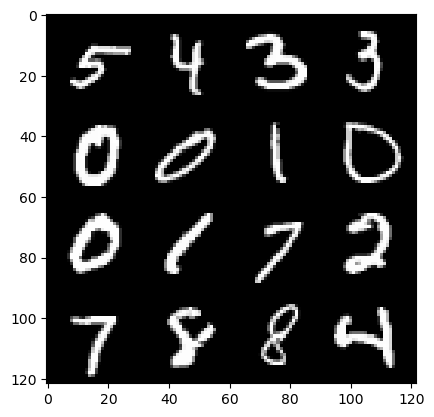

367: step 172200/ Gen loss: 1.9380140181382493/ disc_loss: 0.3234507156908514


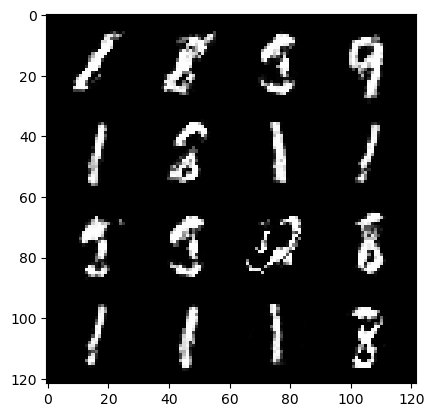

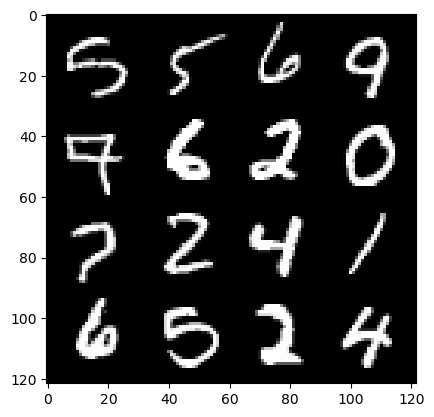

367: step 172500/ Gen loss: 1.9944218560059863/ disc_loss: 0.27670539324482274


  0%|          | 0/469 [00:00<?, ?it/s]

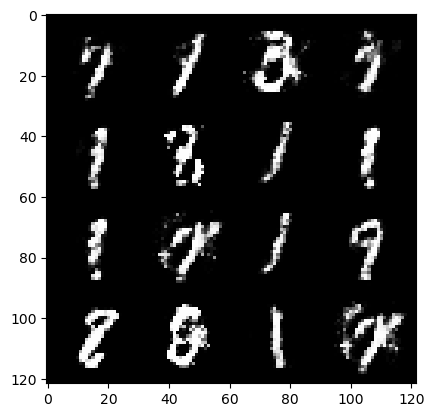

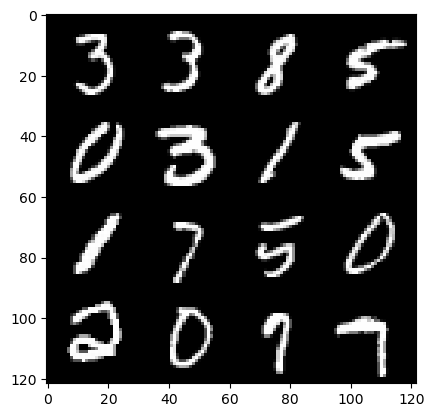

368: step 172800/ Gen loss: 1.9677581731478375/ disc_loss: 0.2876597038408122


  0%|          | 0/469 [00:00<?, ?it/s]

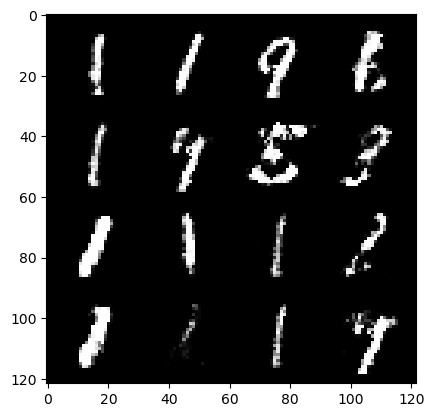

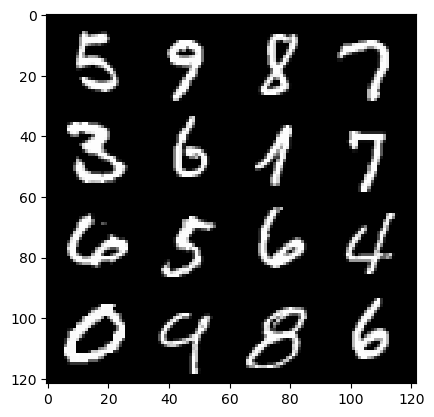

369: step 173100/ Gen loss: 1.911477729479472/ disc_loss: 0.292399108062188


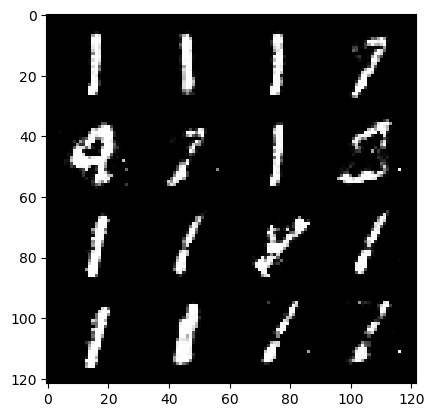

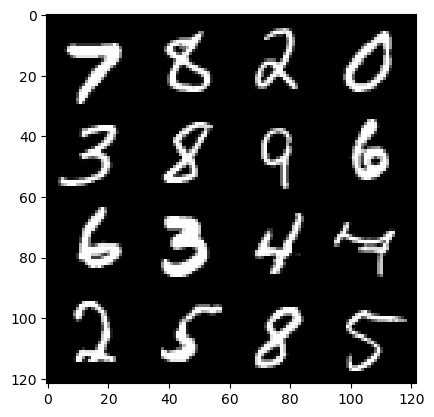

369: step 173400/ Gen loss: 2.054693998893101/ disc_loss: 0.2671717306474845


  0%|          | 0/469 [00:00<?, ?it/s]

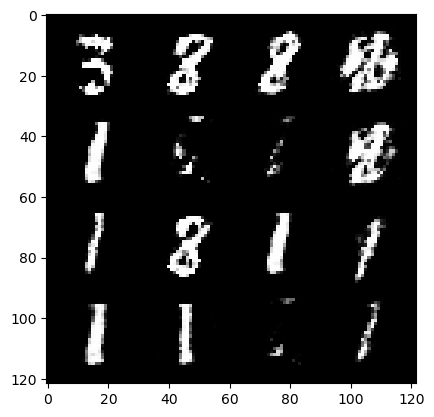

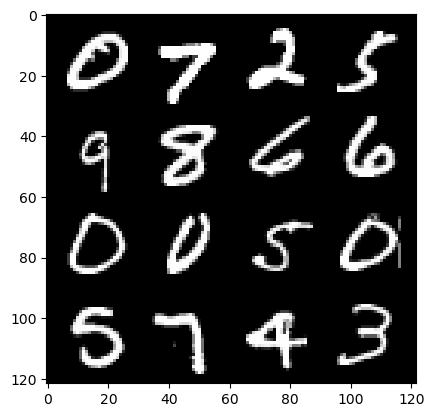

370: step 173700/ Gen loss: 2.223765062888463/ disc_loss: 0.28218890751401576


  0%|          | 0/469 [00:00<?, ?it/s]

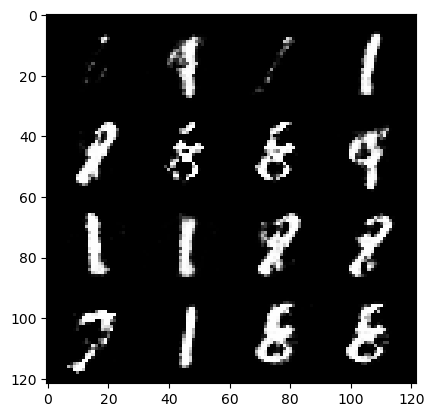

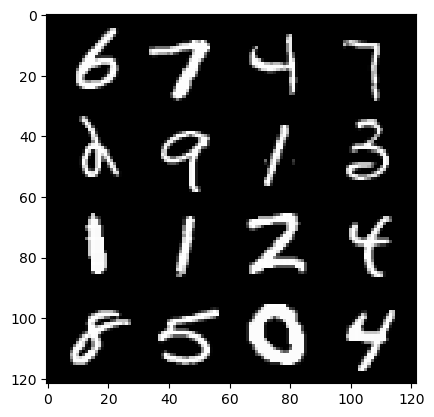

371: step 174000/ Gen loss: 2.293303409020105/ disc_loss: 0.23810926059881843


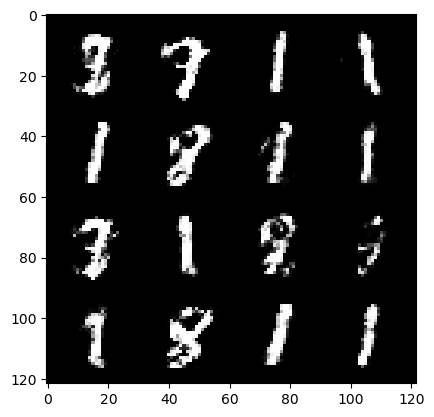

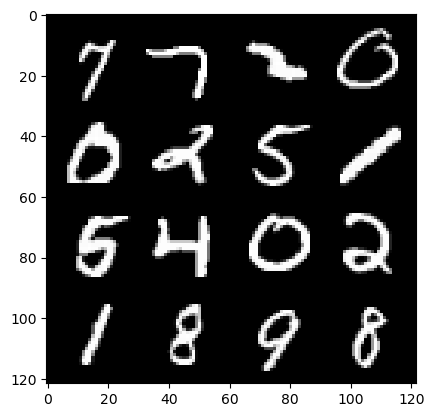

371: step 174300/ Gen loss: 2.0514989912509916/ disc_loss: 0.27167326688766474


  0%|          | 0/469 [00:00<?, ?it/s]

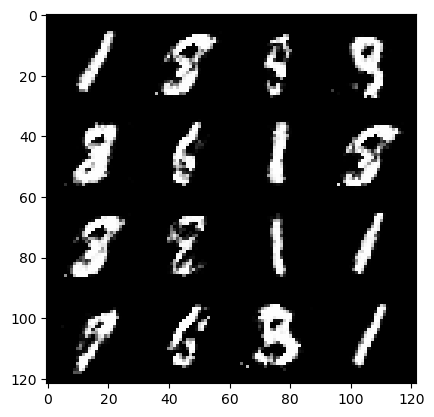

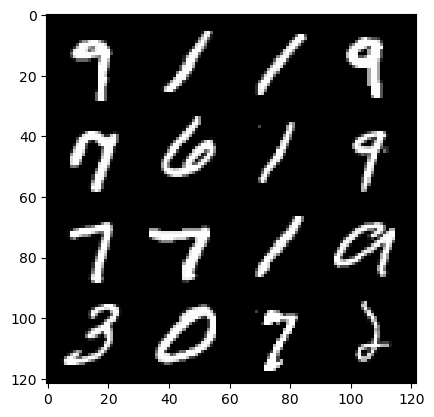

372: step 174600/ Gen loss: 2.047894880374274/ disc_loss: 0.2868799395859241


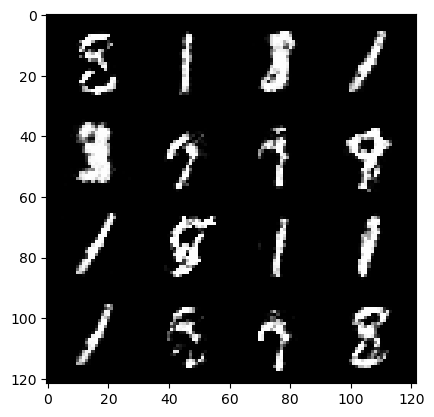

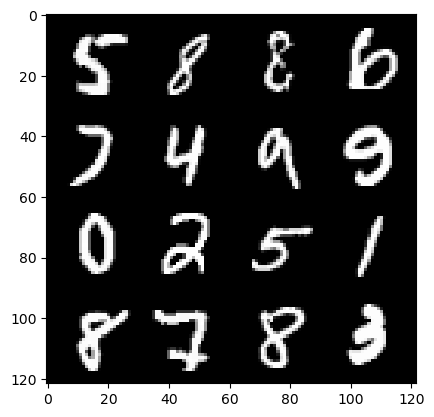

372: step 174900/ Gen loss: 2.06202178200086/ disc_loss: 0.2796128574013708


  0%|          | 0/469 [00:00<?, ?it/s]

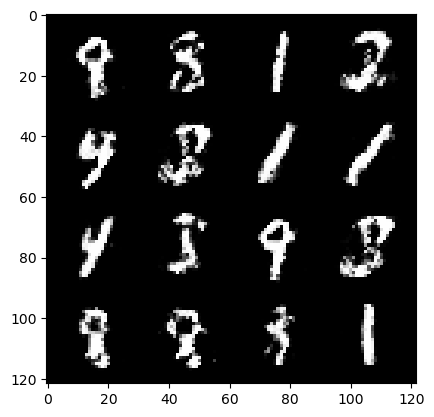

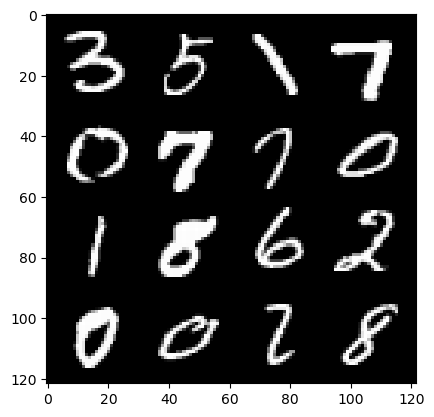

373: step 175200/ Gen loss: 2.069516595999401/ disc_loss: 0.2868768071631592


  0%|          | 0/469 [00:00<?, ?it/s]

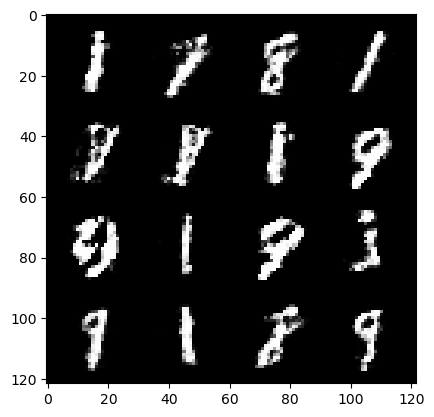

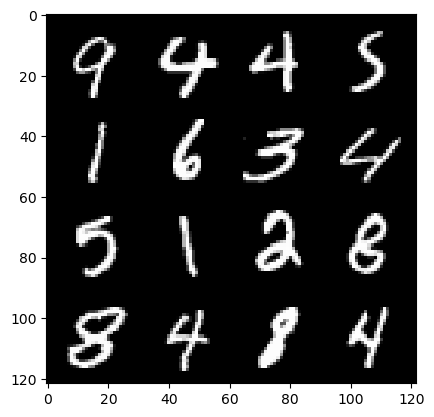

374: step 175500/ Gen loss: 2.013570458491641/ disc_loss: 0.28326166629791244


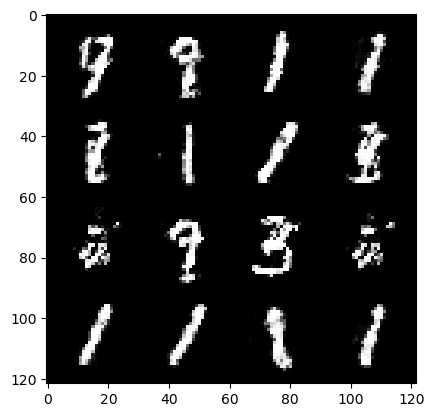

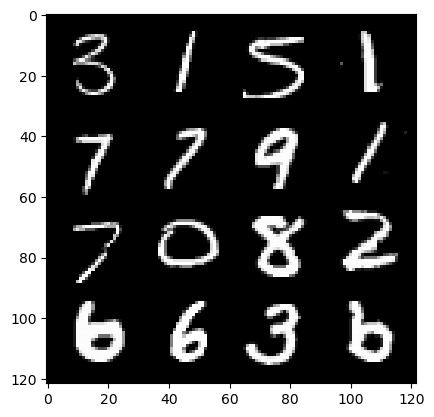

374: step 175800/ Gen loss: 2.1000145216782875/ disc_loss: 0.2691189980506895


  0%|          | 0/469 [00:00<?, ?it/s]

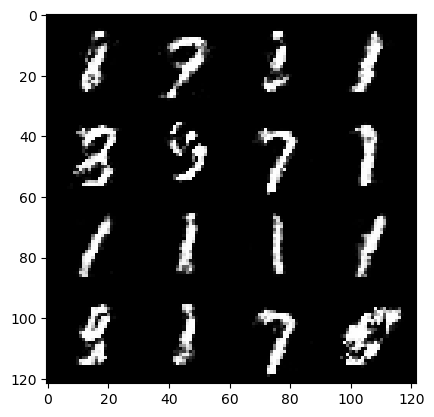

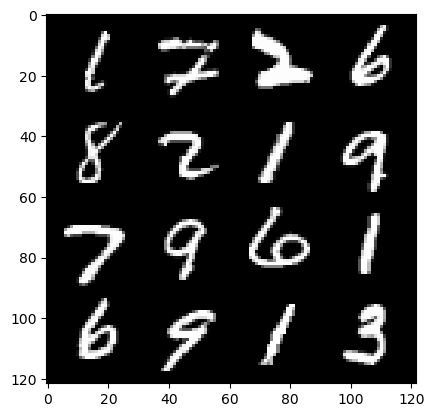

375: step 176100/ Gen loss: 2.02365432103475/ disc_loss: 0.312600945631663


  0%|          | 0/469 [00:00<?, ?it/s]

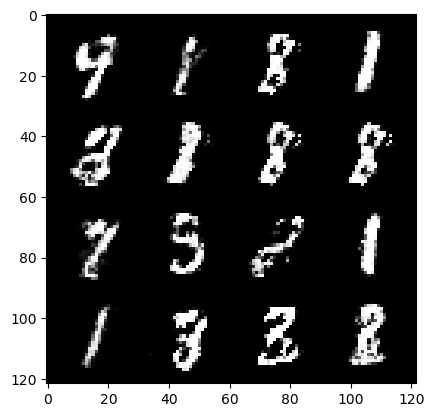

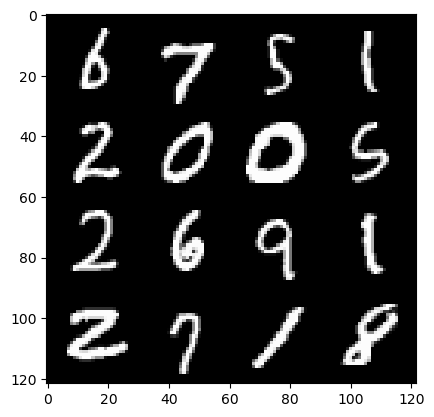

376: step 176400/ Gen loss: 2.016913402080534/ disc_loss: 0.27947711651523893


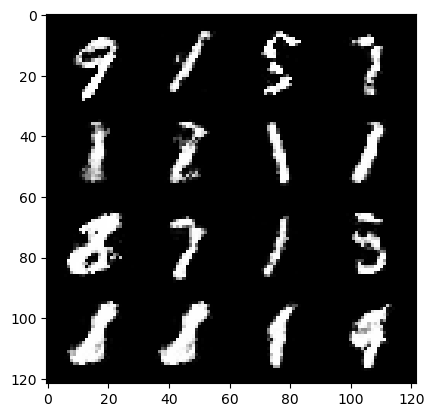

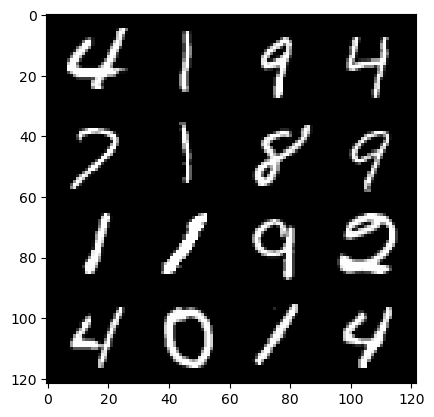

376: step 176700/ Gen loss: 2.0494770920276637/ disc_loss: 0.29917607913414673


  0%|          | 0/469 [00:00<?, ?it/s]

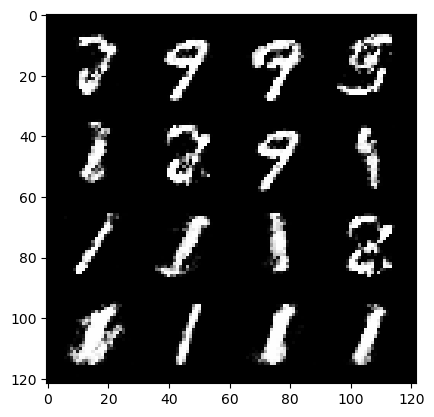

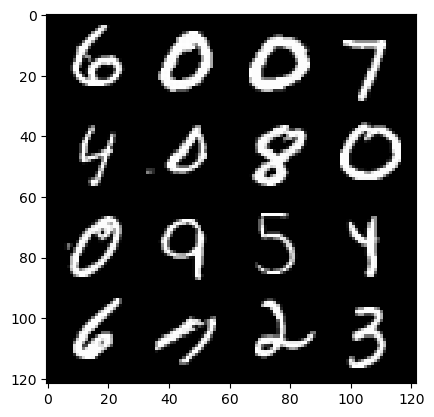

377: step 177000/ Gen loss: 2.105977849960329/ disc_loss: 0.27300533697009094


  0%|          | 0/469 [00:00<?, ?it/s]

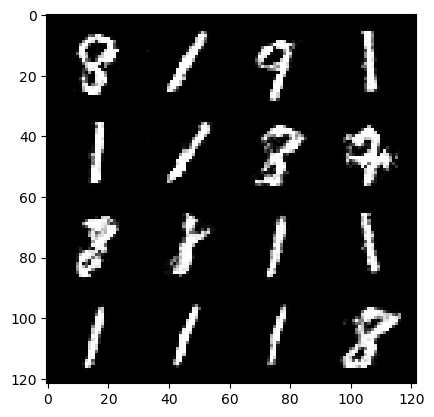

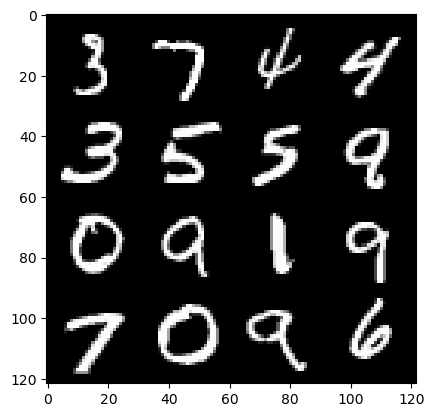

378: step 177300/ Gen loss: 2.020404076973599/ disc_loss: 0.30955155481894825


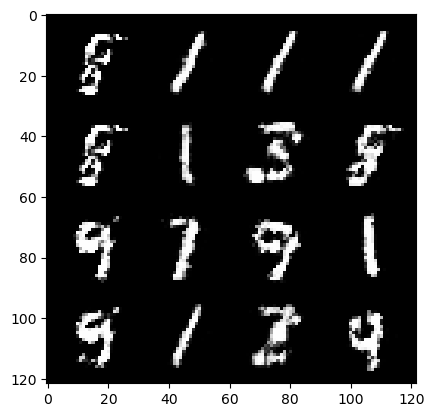

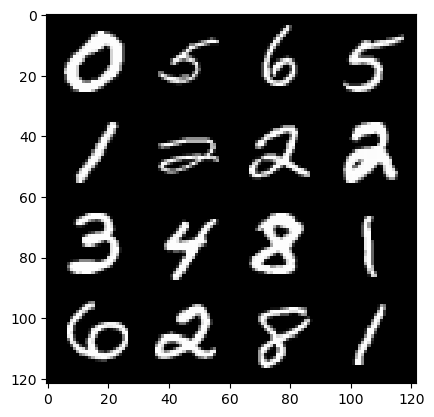

378: step 177600/ Gen loss: 1.9610221429665882/ disc_loss: 0.322652898877859


  0%|          | 0/469 [00:00<?, ?it/s]

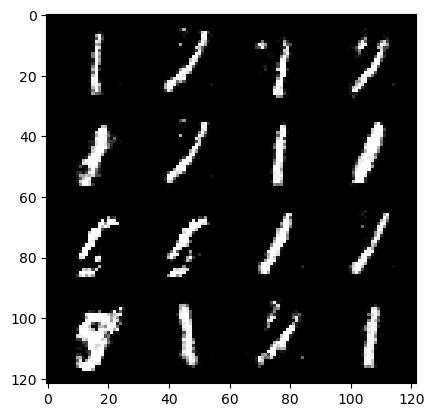

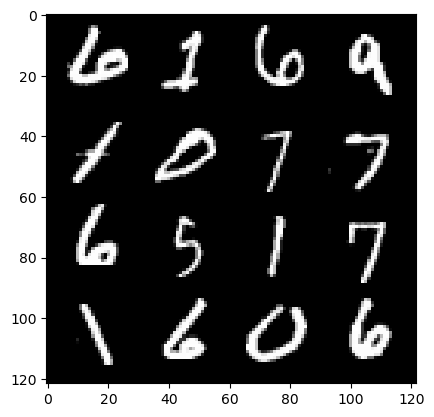

379: step 177900/ Gen loss: 1.928165492216746/ disc_loss: 0.3070411883791288


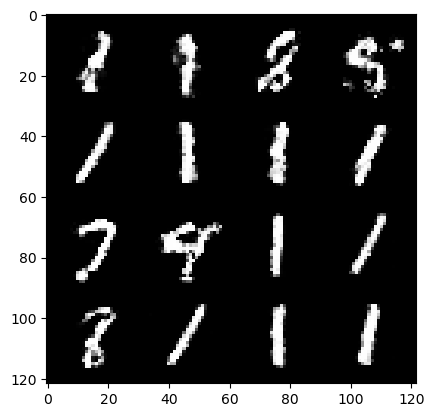

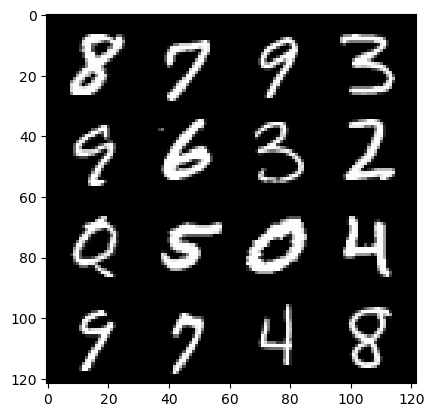

379: step 178200/ Gen loss: 2.0080865291754404/ disc_loss: 0.29757475798328703


  0%|          | 0/469 [00:00<?, ?it/s]

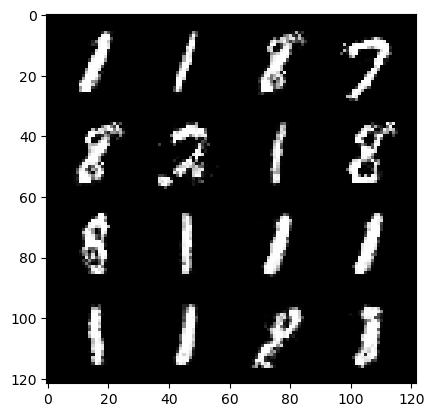

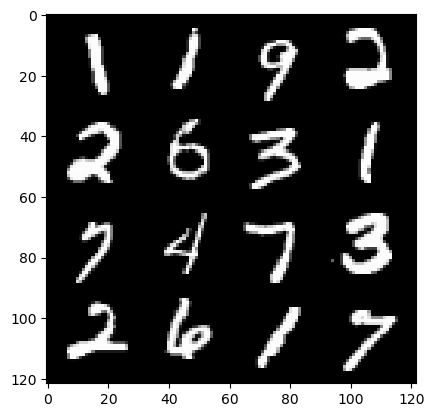

380: step 178500/ Gen loss: 1.9729570976893112/ disc_loss: 0.30198545585076003


  0%|          | 0/469 [00:00<?, ?it/s]

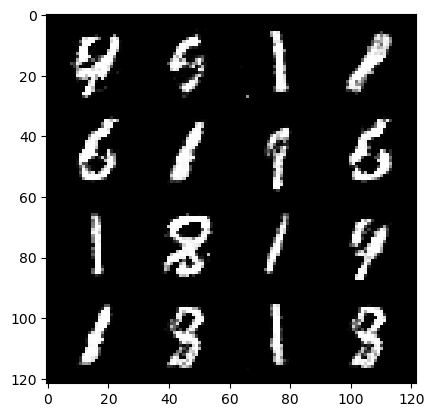

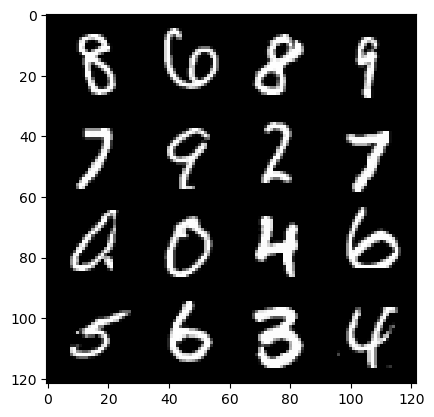

381: step 178800/ Gen loss: 1.9245664644241338/ disc_loss: 0.31235588788986235


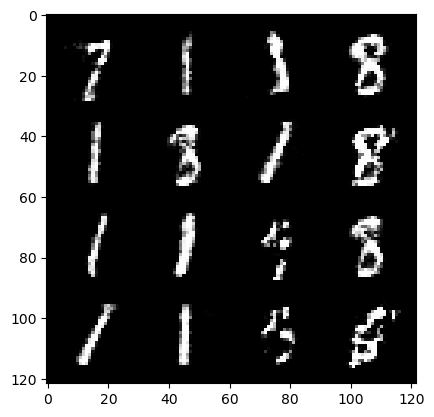

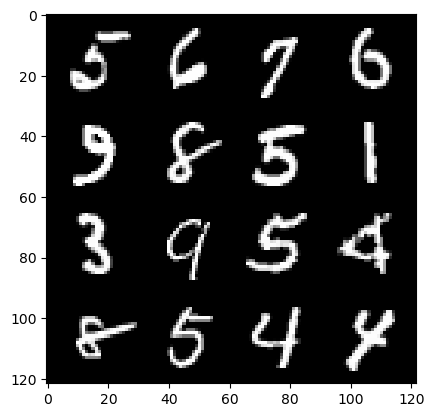

381: step 179100/ Gen loss: 1.863099633852641/ disc_loss: 0.32804358859856925


  0%|          | 0/469 [00:00<?, ?it/s]

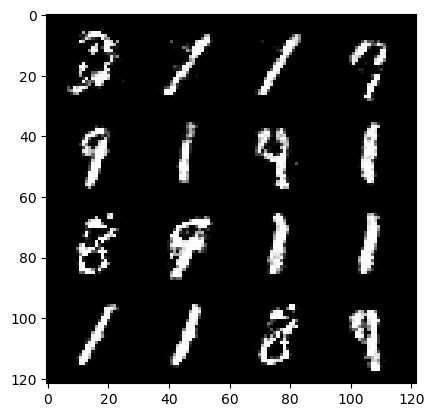

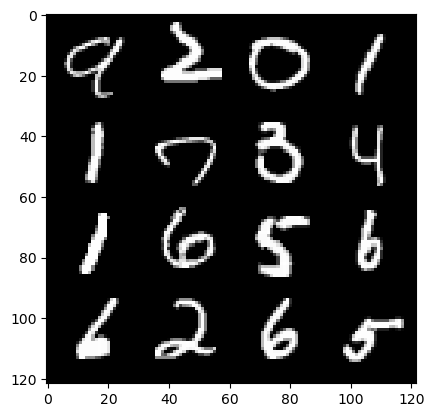

382: step 179400/ Gen loss: 1.863977286020915/ disc_loss: 0.3273034439484279


  0%|          | 0/469 [00:00<?, ?it/s]

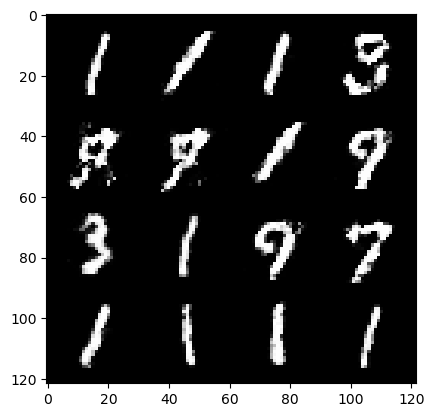

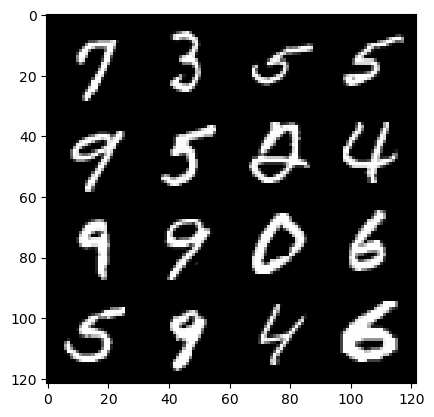

383: step 179700/ Gen loss: 1.8429529376824707/ disc_loss: 0.30414297282695757


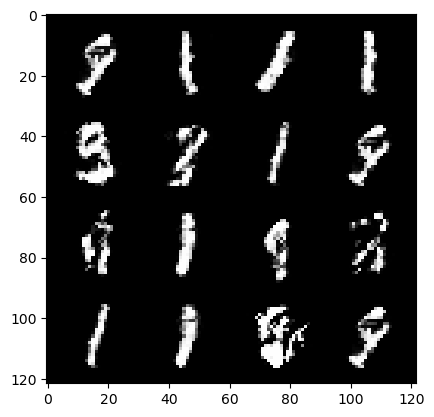

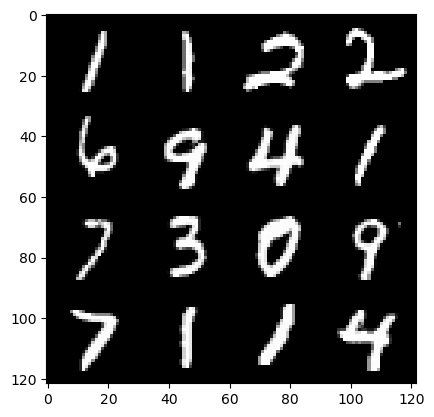

383: step 180000/ Gen loss: 1.8645401895046239/ disc_loss: 0.30796117320656774


  0%|          | 0/469 [00:00<?, ?it/s]

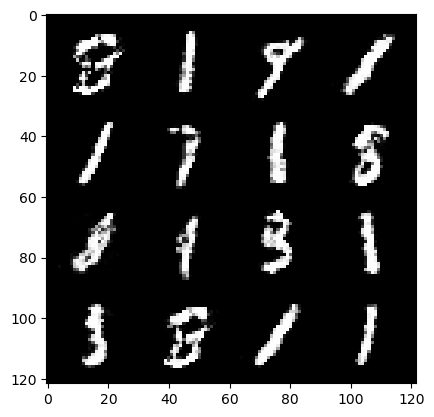

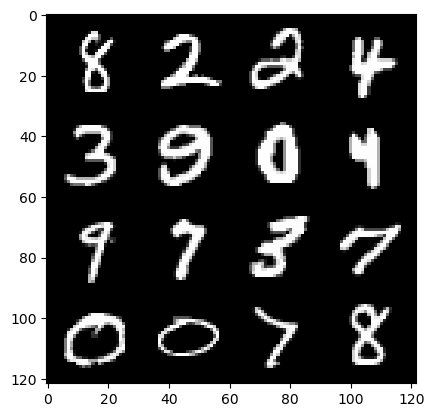

384: step 180300/ Gen loss: 1.9996952553590142/ disc_loss: 0.2837351432442667


  0%|          | 0/469 [00:00<?, ?it/s]

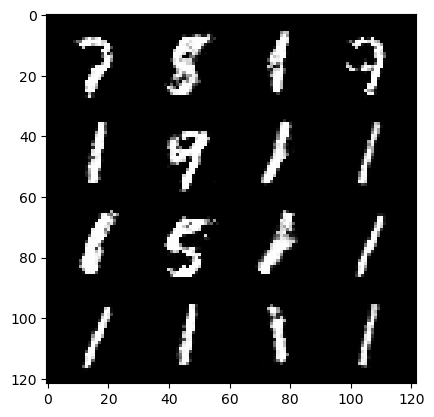

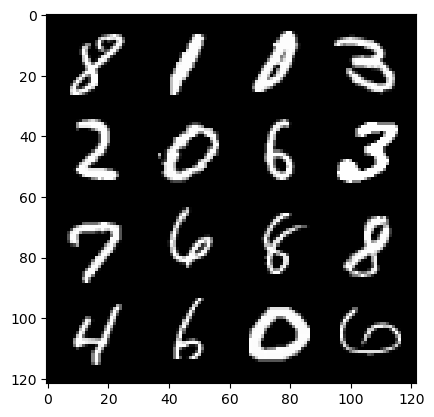

385: step 180600/ Gen loss: 1.9423987257480613/ disc_loss: 0.29331977720061947


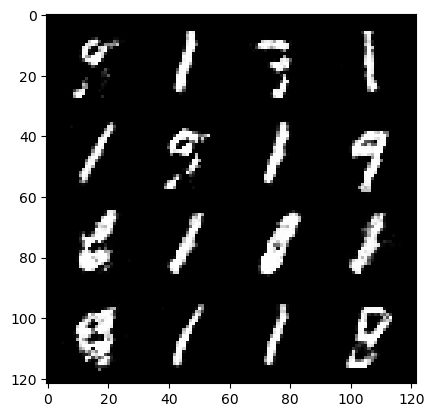

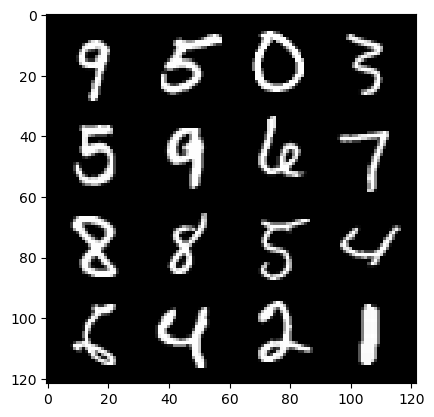

385: step 180900/ Gen loss: 1.90476284424464/ disc_loss: 0.30671759903430973


  0%|          | 0/469 [00:00<?, ?it/s]

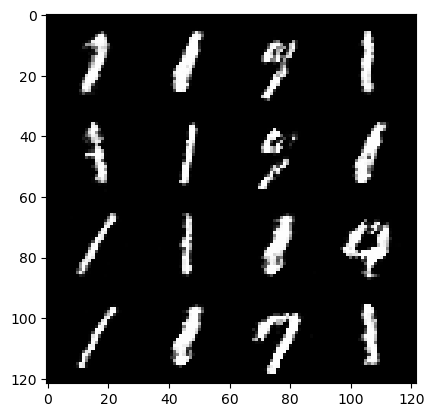

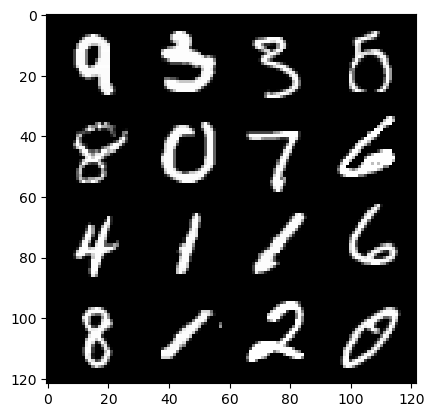

386: step 181200/ Gen loss: 1.9422226977348338/ disc_loss: 0.29050398429234836


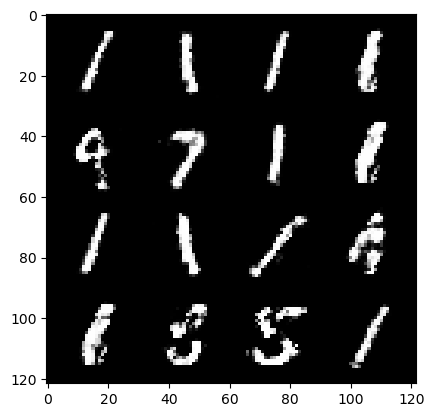

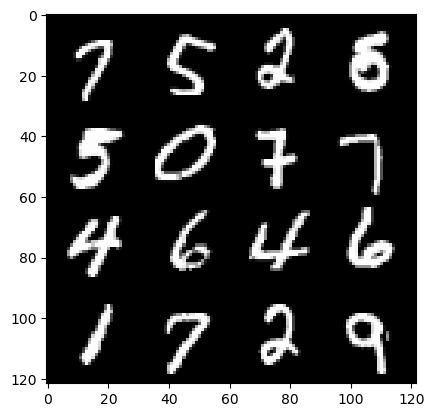

386: step 181500/ Gen loss: 1.953796106576919/ disc_loss: 0.29548034812013324


  0%|          | 0/469 [00:00<?, ?it/s]

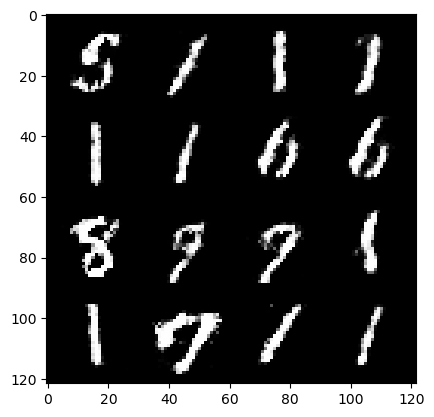

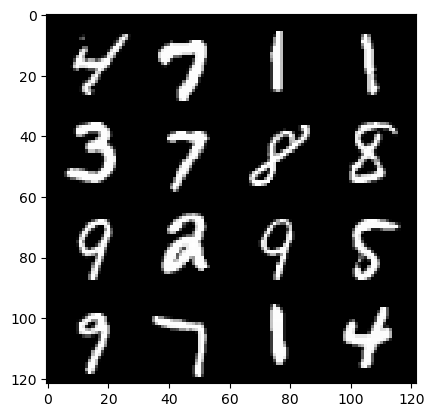

387: step 181800/ Gen loss: 1.9517070857683823/ disc_loss: 0.3101290393869084


  0%|          | 0/469 [00:00<?, ?it/s]

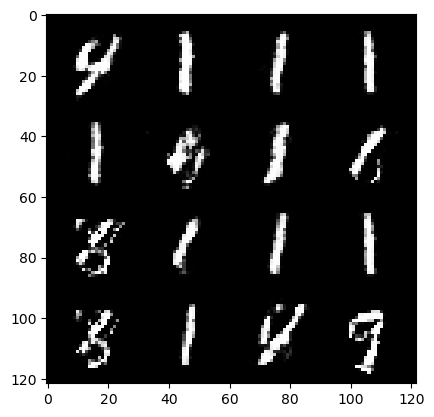

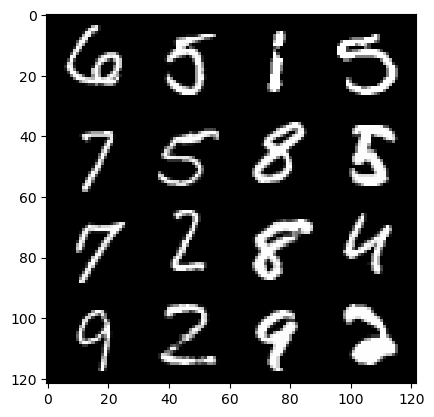

388: step 182100/ Gen loss: 1.978778768380483/ disc_loss: 0.296912236114343


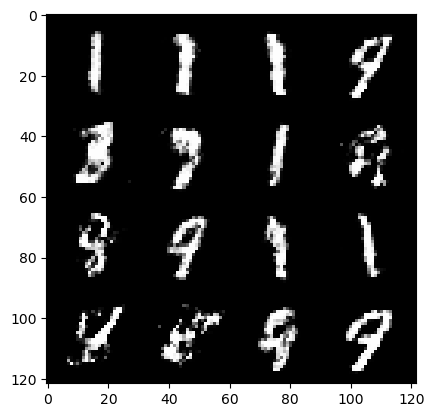

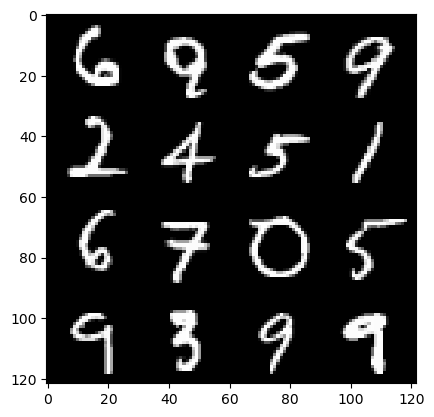

388: step 182400/ Gen loss: 2.025364849964776/ disc_loss: 0.27819683874646817


  0%|          | 0/469 [00:00<?, ?it/s]

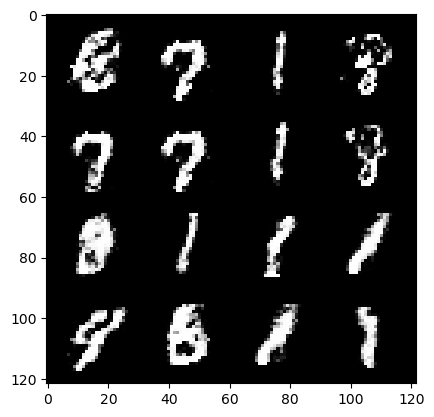

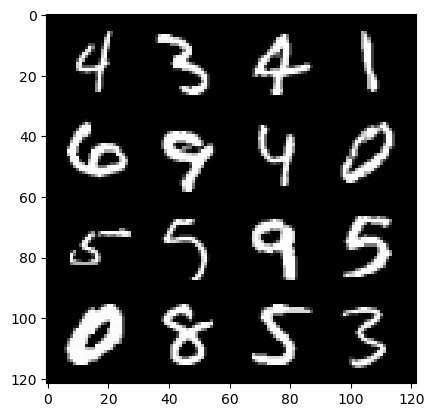

389: step 182700/ Gen loss: 1.9004822067419693/ disc_loss: 0.31388549074530603


  0%|          | 0/469 [00:00<?, ?it/s]

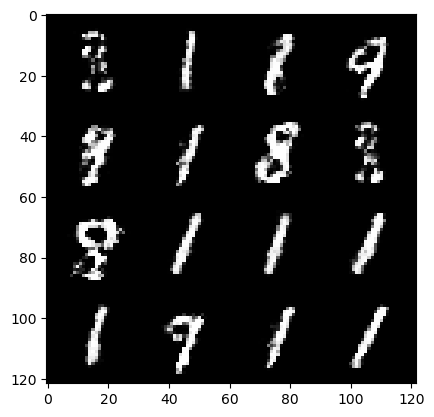

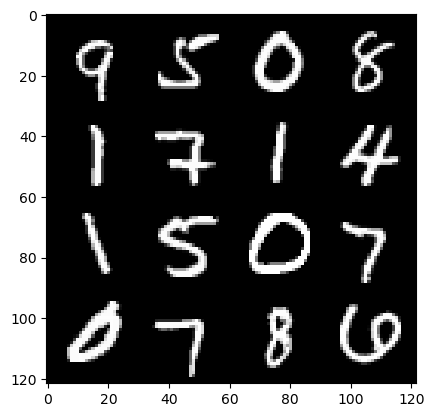

390: step 183000/ Gen loss: 1.9174989922841377/ disc_loss: 0.3107115560273332


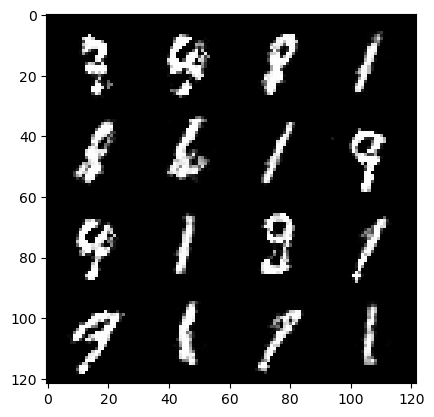

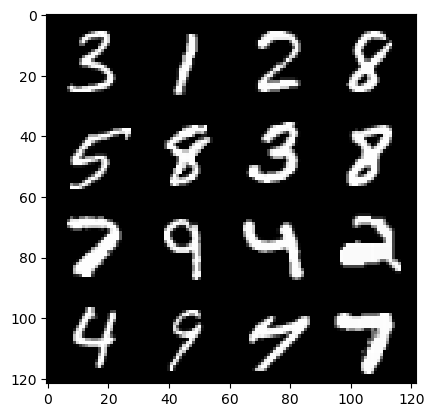

390: step 183300/ Gen loss: 1.883053202231725/ disc_loss: 0.3229043564697105


  0%|          | 0/469 [00:00<?, ?it/s]

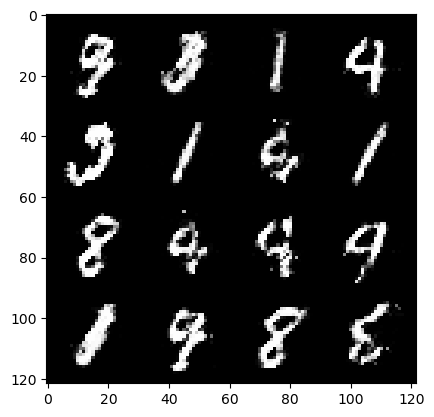

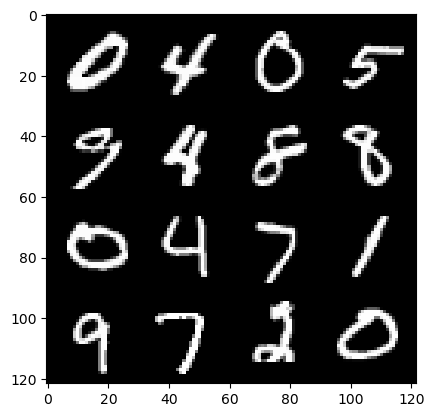

391: step 183600/ Gen loss: 1.8594446039199835/ disc_loss: 0.30858238011598604


  0%|          | 0/469 [00:00<?, ?it/s]

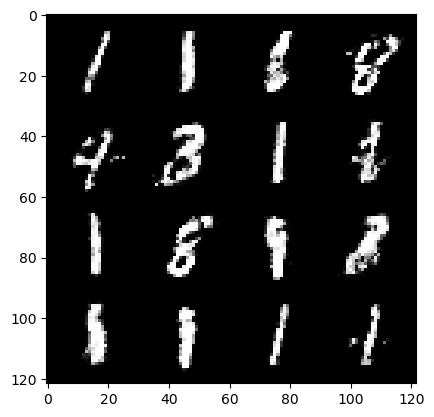

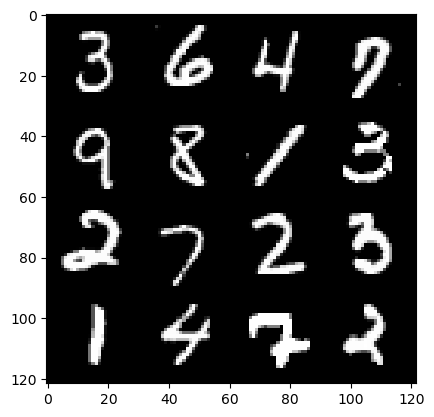

392: step 183900/ Gen loss: 1.9006617009639726/ disc_loss: 0.3011959834893543


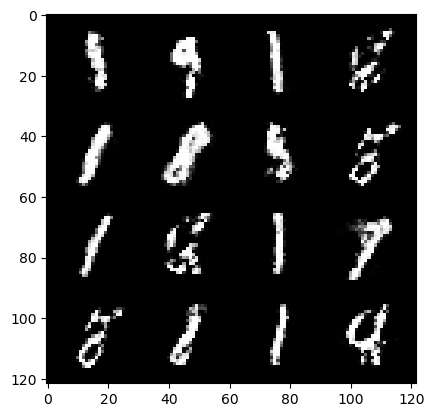

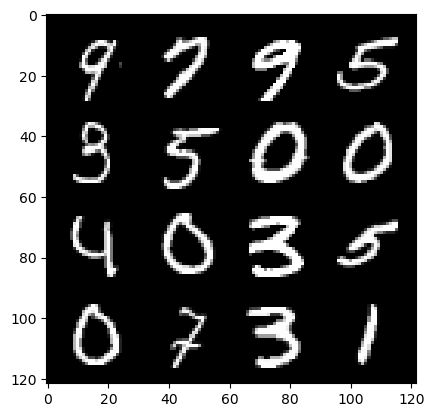

392: step 184200/ Gen loss: 1.90013329466184/ disc_loss: 0.307565799454848


  0%|          | 0/469 [00:00<?, ?it/s]

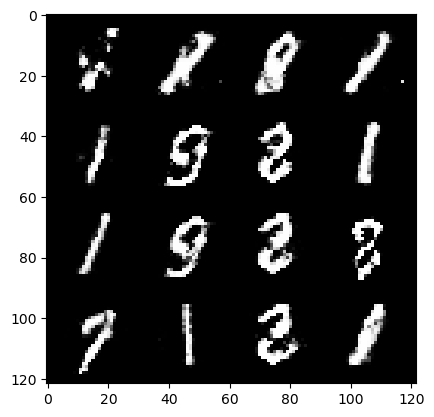

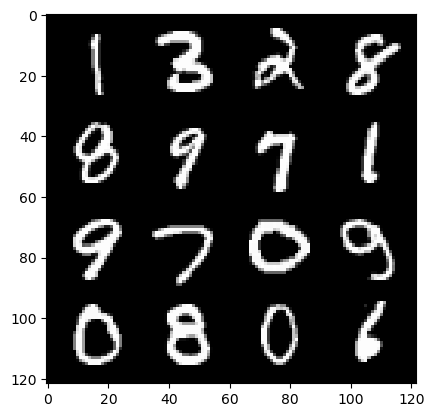

393: step 184500/ Gen loss: 2.0049700808525084/ disc_loss: 0.2828390579919019


  0%|          | 0/469 [00:00<?, ?it/s]

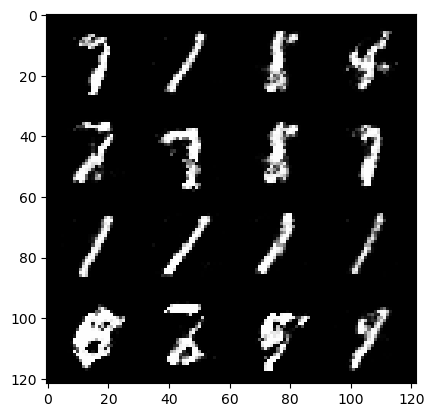

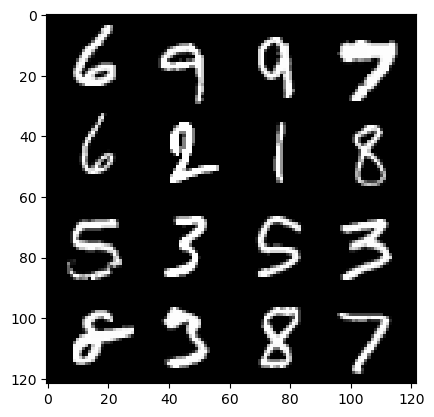

394: step 184800/ Gen loss: 1.9636948883533472/ disc_loss: 0.29038293987512576


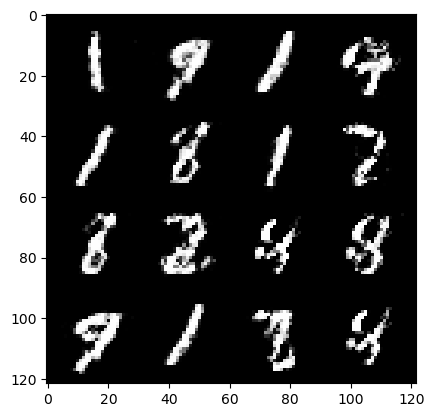

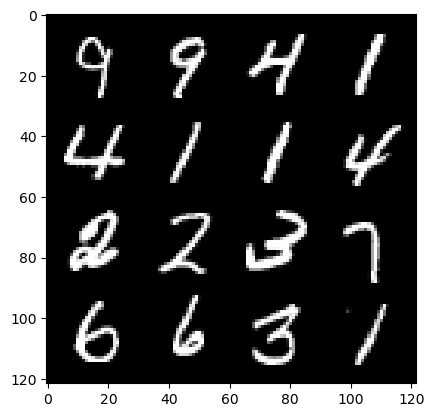

394: step 185100/ Gen loss: 2.014350101947784/ disc_loss: 0.299802057792743


  0%|          | 0/469 [00:00<?, ?it/s]

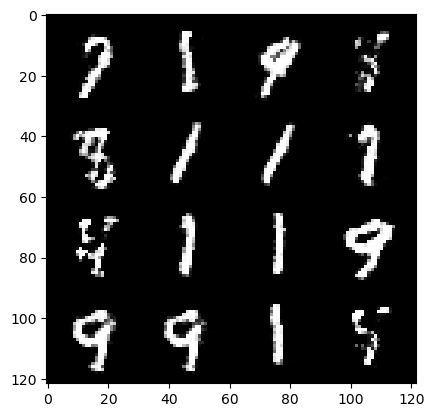

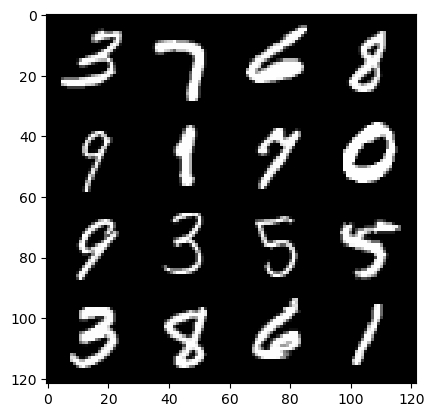

395: step 185400/ Gen loss: 1.9577748445669811/ disc_loss: 0.29852713714043283


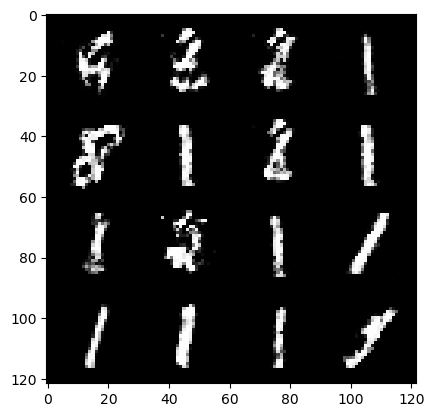

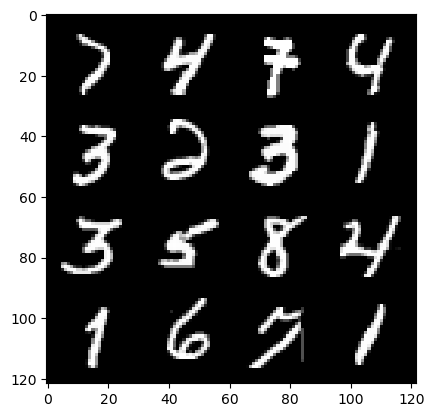

395: step 185700/ Gen loss: 1.9336426389217378/ disc_loss: 0.3114196341236432


  0%|          | 0/469 [00:00<?, ?it/s]

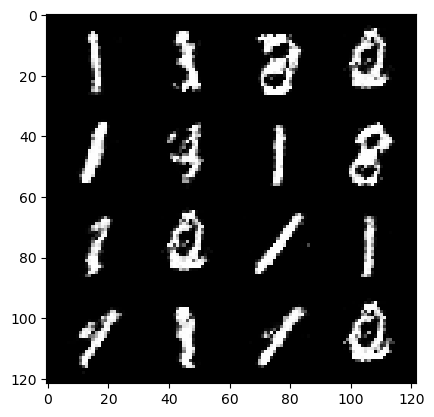

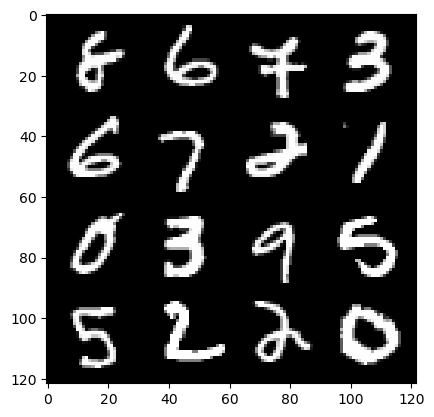

396: step 186000/ Gen loss: 1.9279456587632504/ disc_loss: 0.3046549347539742


  0%|          | 0/469 [00:00<?, ?it/s]

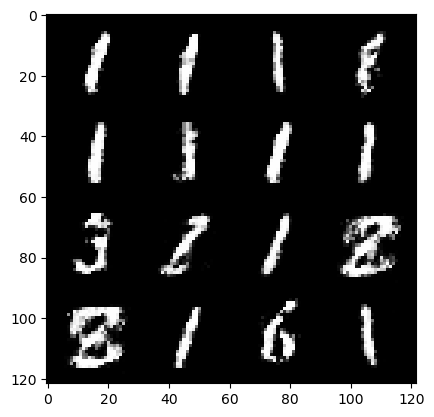

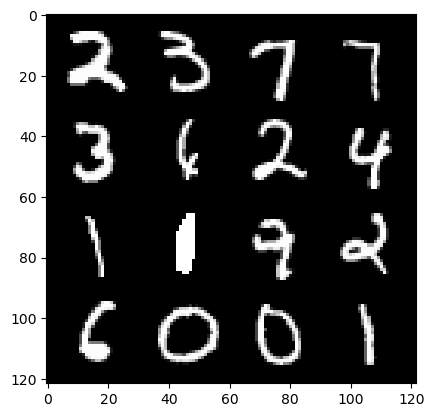

397: step 186300/ Gen loss: 1.9368715401490537/ disc_loss: 0.31148058369755716


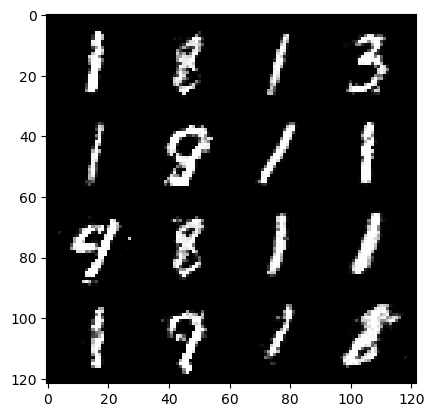

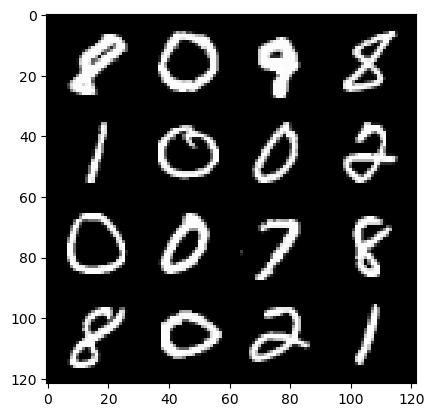

397: step 186600/ Gen loss: 1.885334906578063/ disc_loss: 0.30801836669445065


  0%|          | 0/469 [00:00<?, ?it/s]

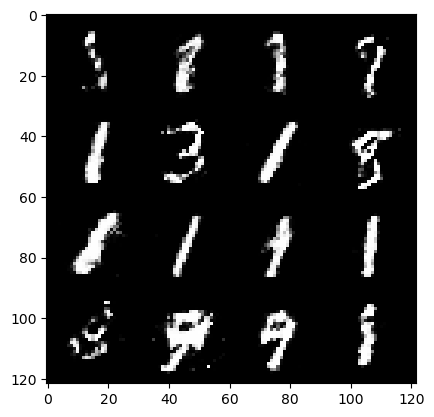

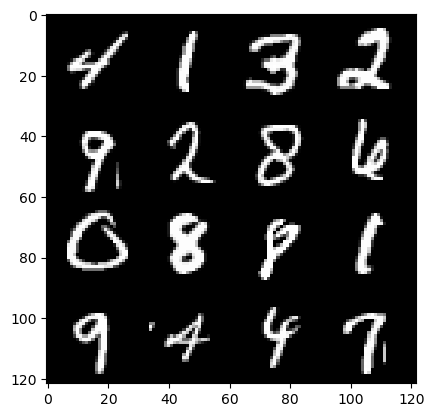

398: step 186900/ Gen loss: 1.9201586151123045/ disc_loss: 0.30777266527215635


  0%|          | 0/469 [00:00<?, ?it/s]

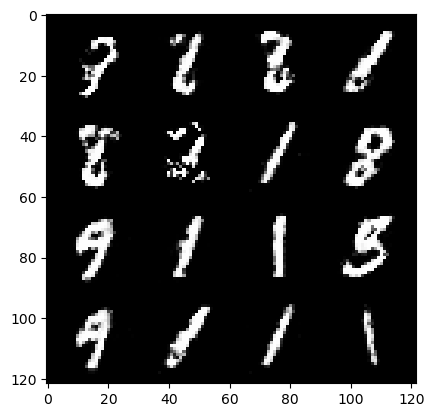

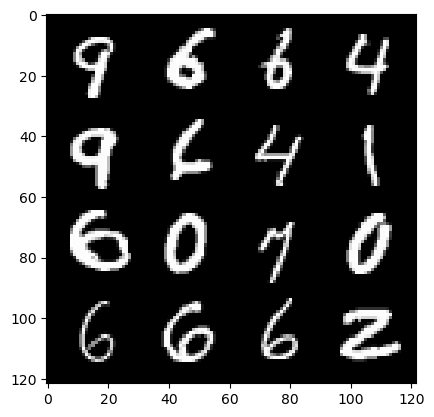

399: step 187200/ Gen loss: 1.935757567485174/ disc_loss: 0.2975548730293909


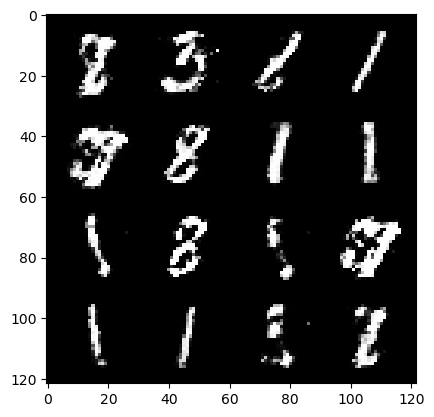

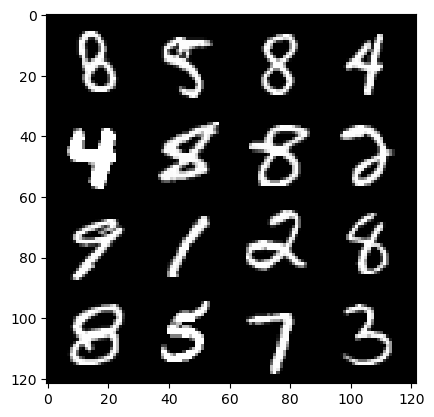

399: step 187500/ Gen loss: 1.919653759797414/ disc_loss: 0.3029098479946453


  0%|          | 0/469 [00:00<?, ?it/s]

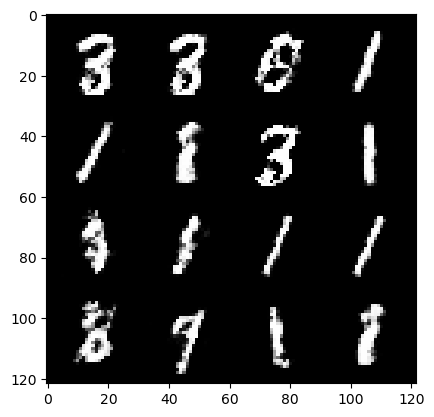

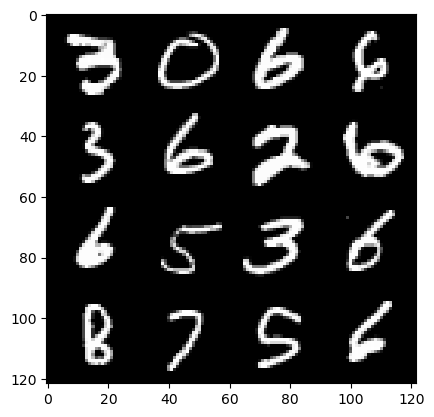

400: step 187800/ Gen loss: 1.9333094314734134/ disc_loss: 0.2930131048460803


  0%|          | 0/469 [00:00<?, ?it/s]

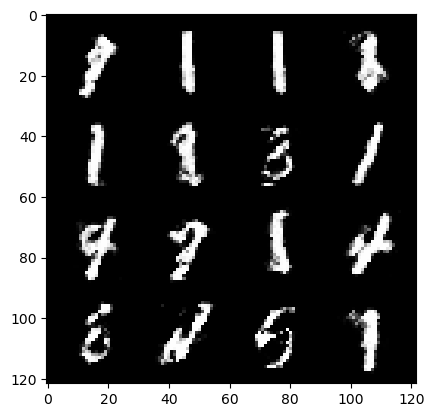

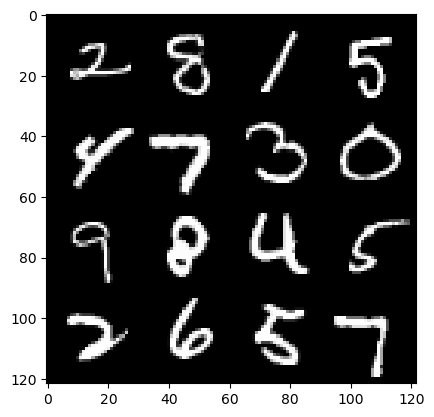

401: step 188100/ Gen loss: 1.9372503149509432/ disc_loss: 0.3062724608679611


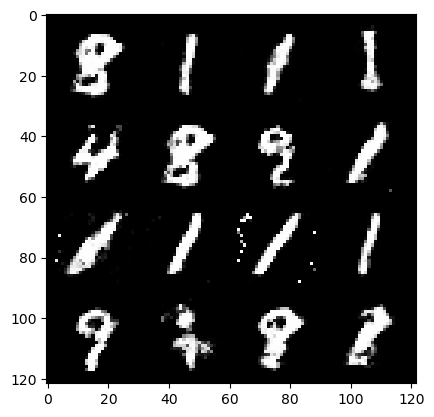

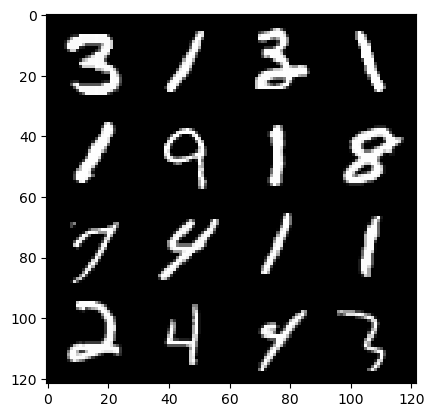

401: step 188400/ Gen loss: 2.100686024824779/ disc_loss: 0.314793761173884


  0%|          | 0/469 [00:00<?, ?it/s]

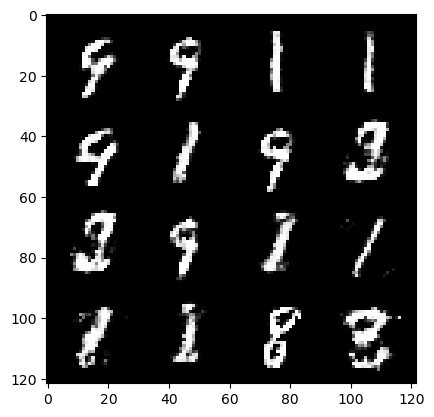

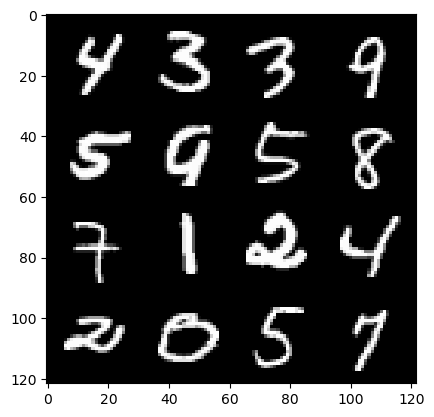

402: step 188700/ Gen loss: 2.0690541267395024/ disc_loss: 0.29793238808711336


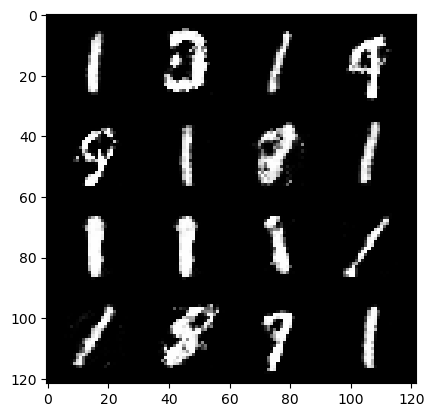

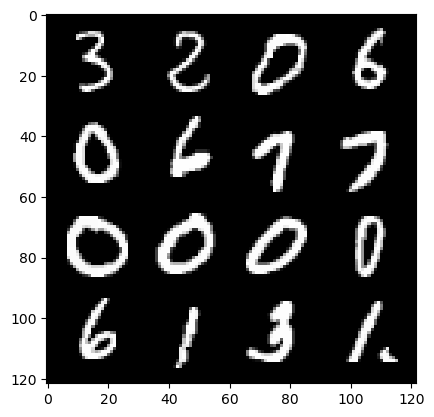

402: step 189000/ Gen loss: 1.9343642000357302/ disc_loss: 0.293641403814157


  0%|          | 0/469 [00:00<?, ?it/s]

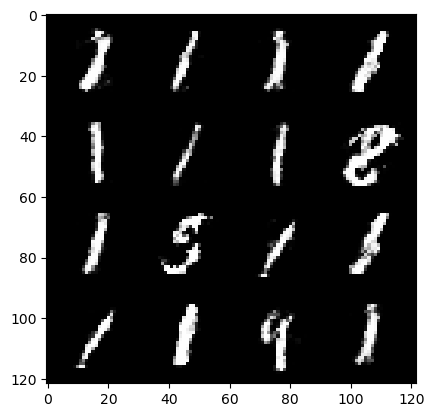

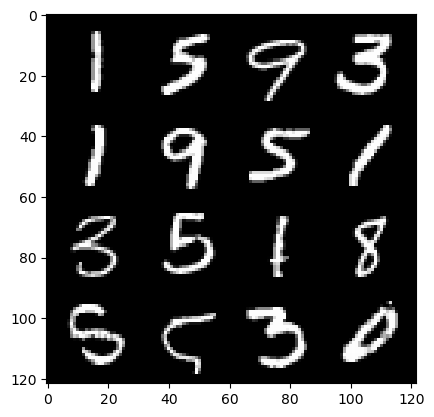

403: step 189300/ Gen loss: 1.9216388185818987/ disc_loss: 0.2982838163276514


  0%|          | 0/469 [00:00<?, ?it/s]

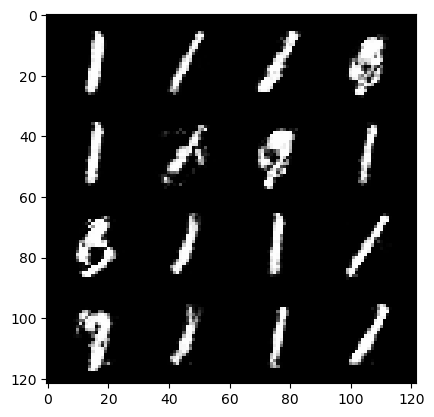

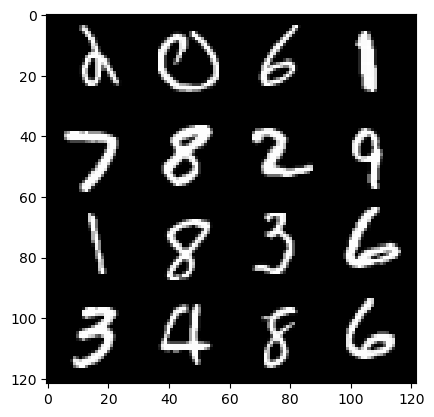

404: step 189600/ Gen loss: 2.003963416814804/ disc_loss: 0.29218899254997566


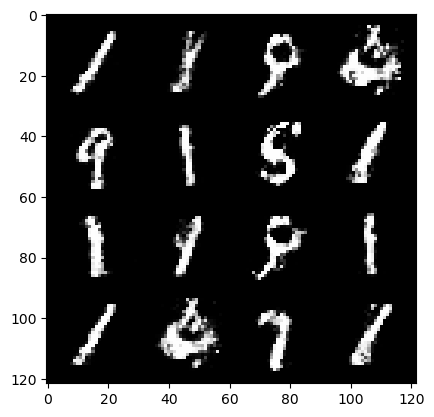

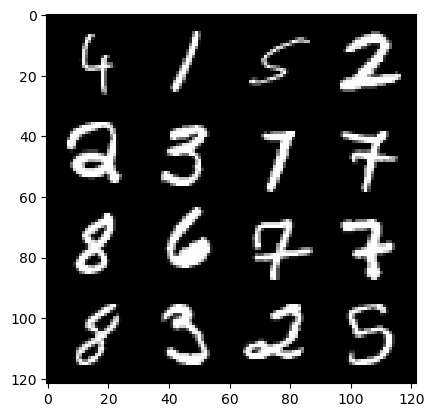

404: step 189900/ Gen loss: 1.9283937688668578/ disc_loss: 0.2986851774156091


  0%|          | 0/469 [00:00<?, ?it/s]

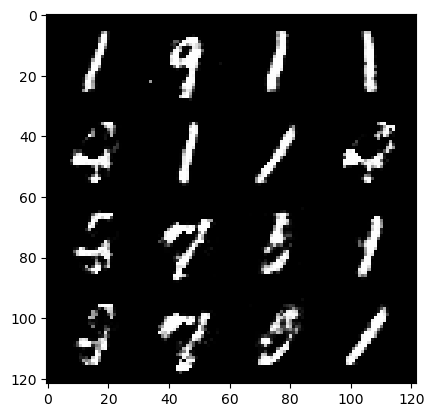

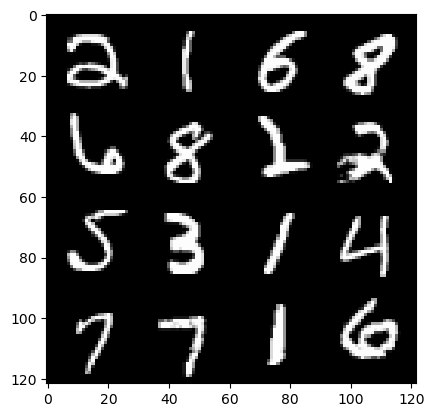

405: step 190200/ Gen loss: 2.006842574278514/ disc_loss: 0.304782614360253


  0%|          | 0/469 [00:00<?, ?it/s]

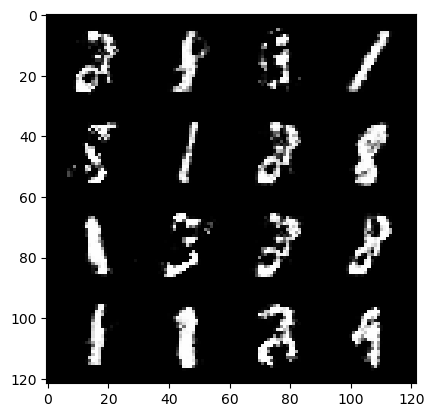

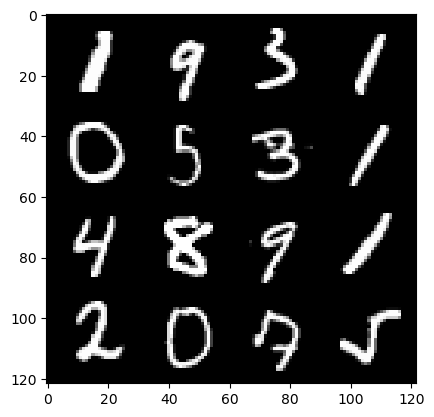

406: step 190500/ Gen loss: 1.9678308105468743/ disc_loss: 0.31045051266749685


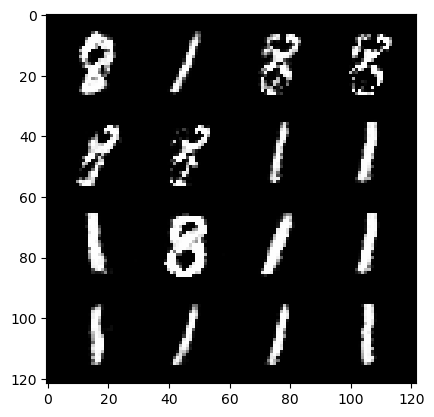

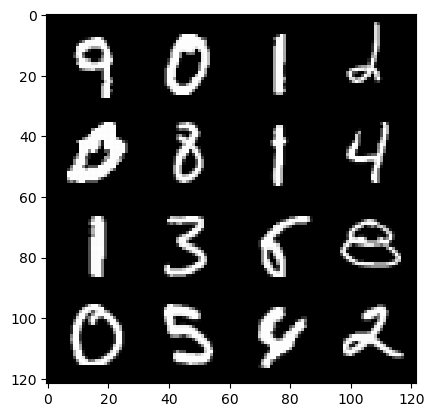

406: step 190800/ Gen loss: 2.0158363572756444/ disc_loss: 0.2815614296992619


  0%|          | 0/469 [00:00<?, ?it/s]

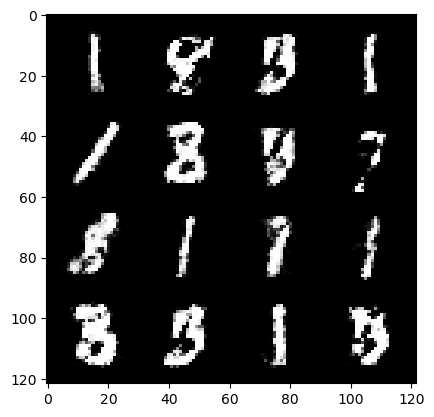

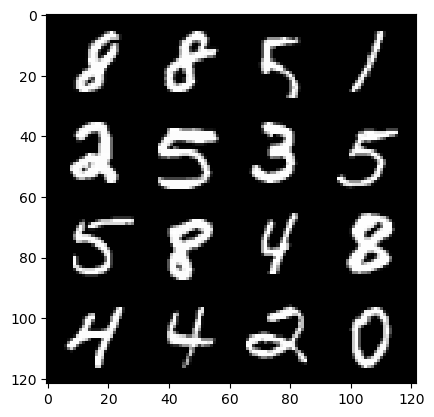

407: step 191100/ Gen loss: 2.040631925264994/ disc_loss: 0.2758598625659944


  0%|          | 0/469 [00:00<?, ?it/s]

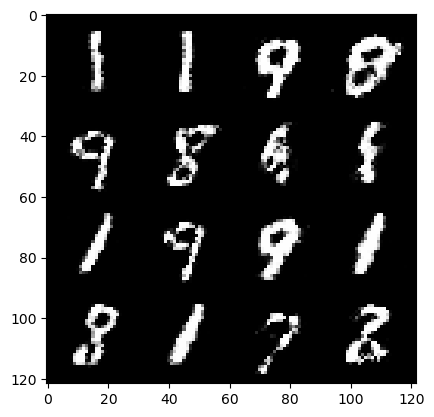

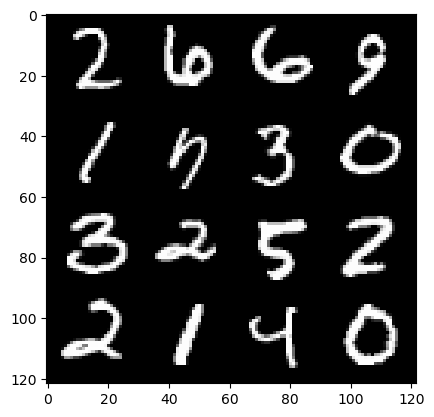

408: step 191400/ Gen loss: 1.929199775854747/ disc_loss: 0.31158320133884726


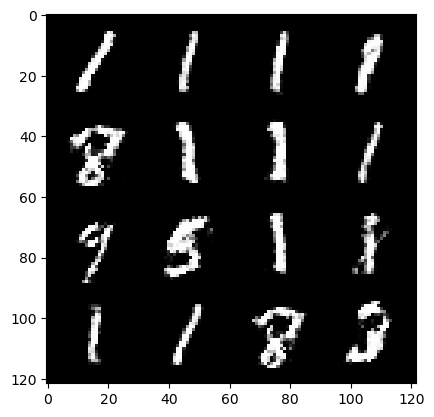

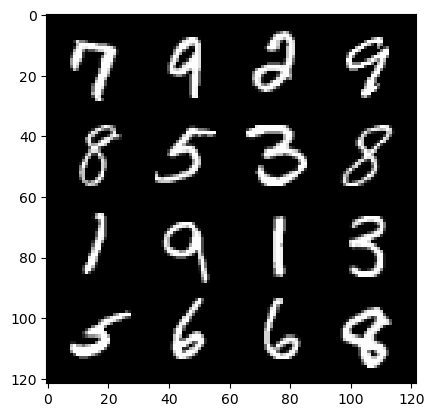

408: step 191700/ Gen loss: 1.8699131206671402/ disc_loss: 0.30140730534990623


  0%|          | 0/469 [00:00<?, ?it/s]

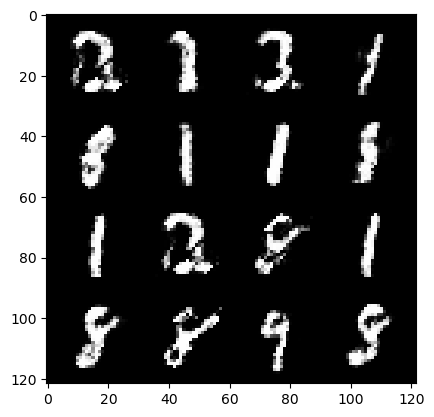

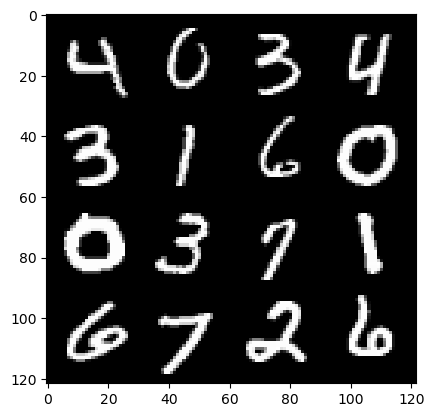

409: step 192000/ Gen loss: 1.9761051221688606/ disc_loss: 0.27718726178010333


  0%|          | 0/469 [00:00<?, ?it/s]

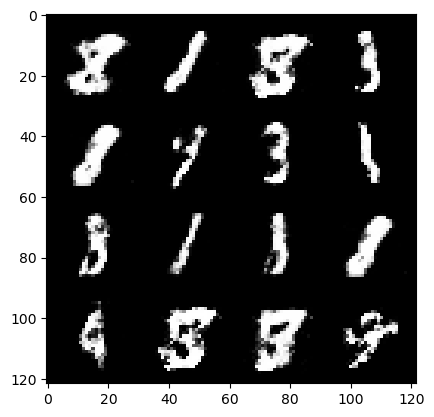

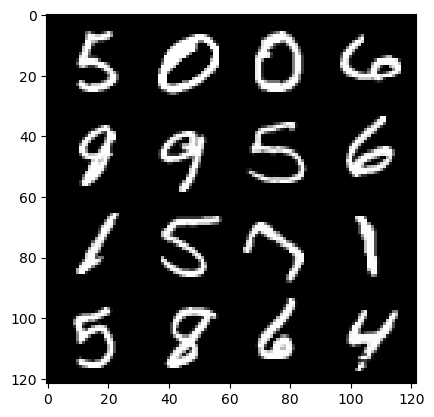

410: step 192300/ Gen loss: 2.00703864534696/ disc_loss: 0.28129552920659395


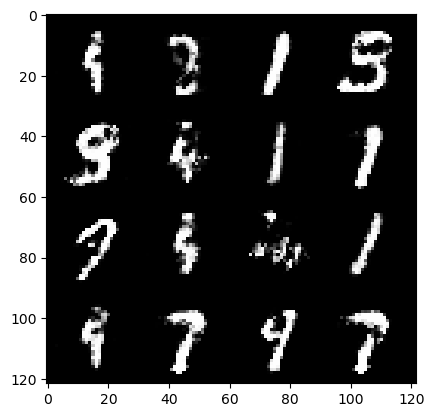

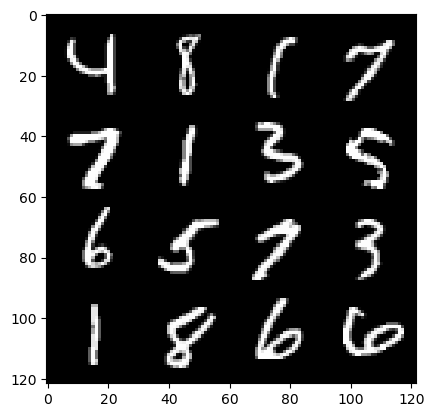

410: step 192600/ Gen loss: 1.9926003817717226/ disc_loss: 0.2885459072391191


  0%|          | 0/469 [00:00<?, ?it/s]

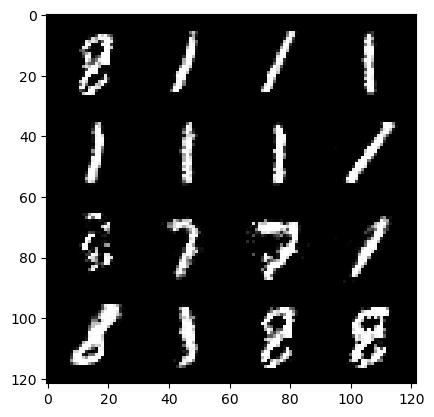

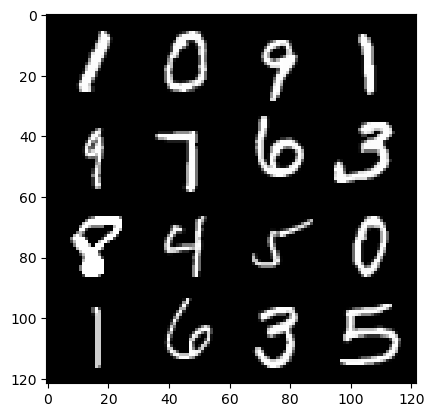

411: step 192900/ Gen loss: 1.9546646086374924/ disc_loss: 0.29675409828623134


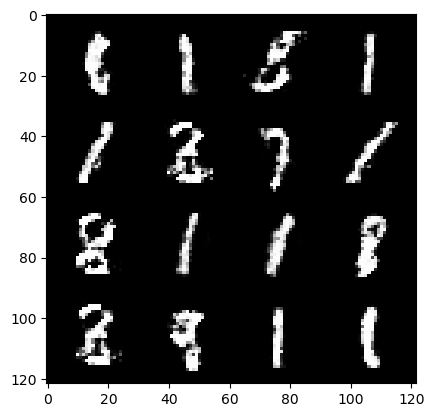

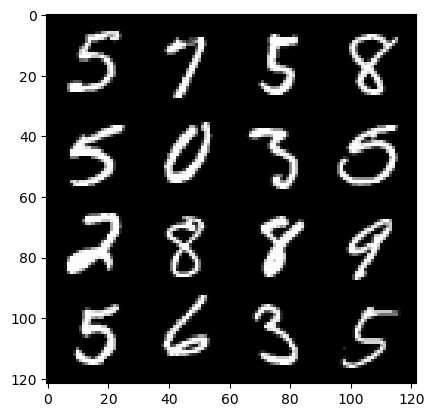

411: step 193200/ Gen loss: 2.014109838406246/ disc_loss: 0.29703402688105895


  0%|          | 0/469 [00:00<?, ?it/s]

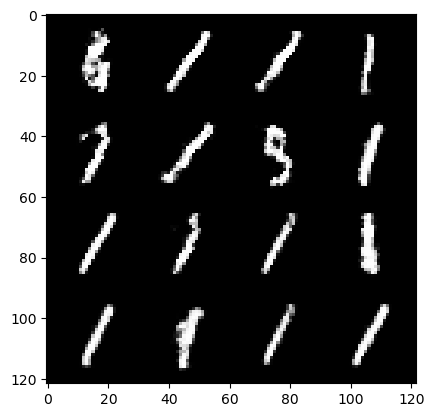

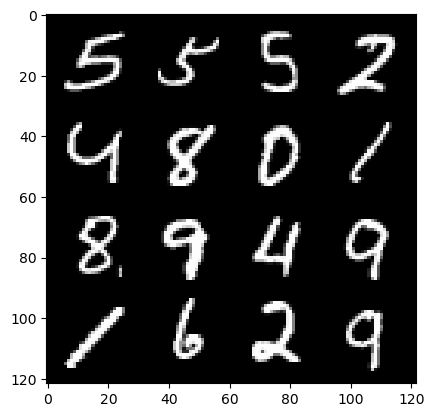

412: step 193500/ Gen loss: 2.0576299377282465/ disc_loss: 0.2777314900855222


  0%|          | 0/469 [00:00<?, ?it/s]

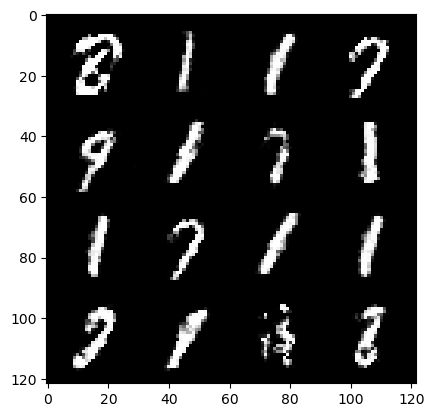

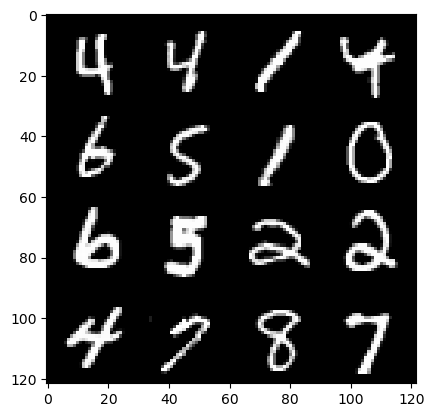

413: step 193800/ Gen loss: 1.996643059253693/ disc_loss: 0.298852946609259


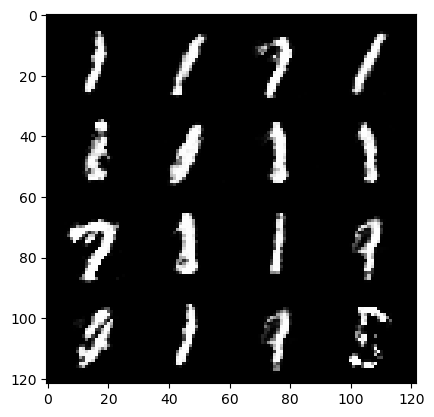

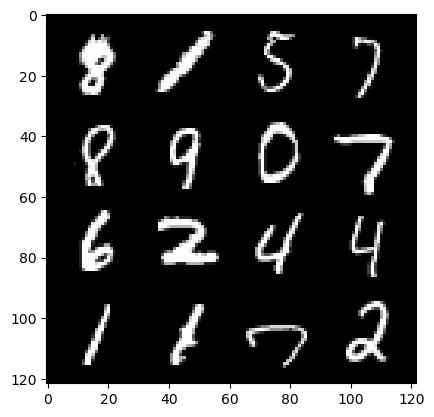

413: step 194100/ Gen loss: 2.0667724553744007/ disc_loss: 0.2743260491887727


  0%|          | 0/469 [00:00<?, ?it/s]

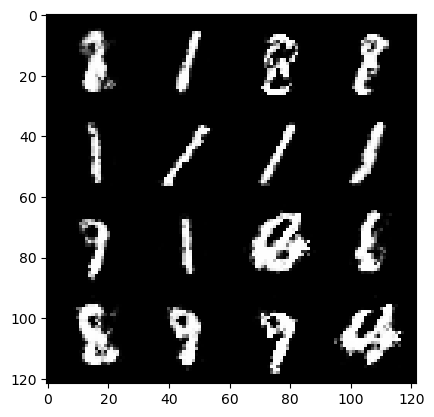

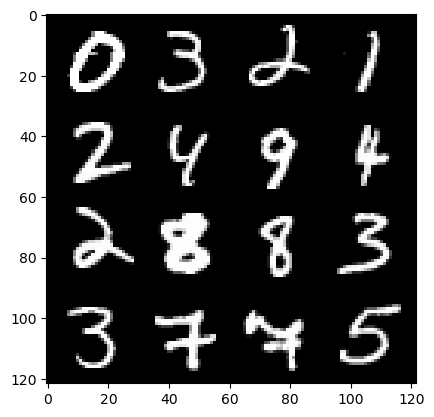

414: step 194400/ Gen loss: 2.0414280021190643/ disc_loss: 0.27712536682685224


  0%|          | 0/469 [00:00<?, ?it/s]

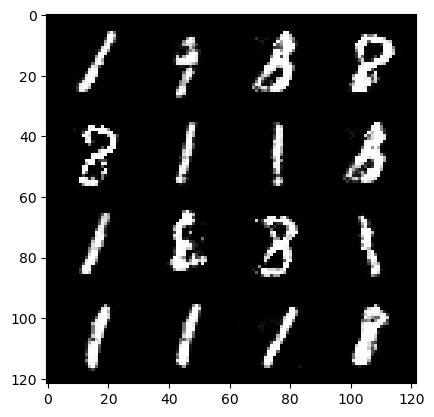

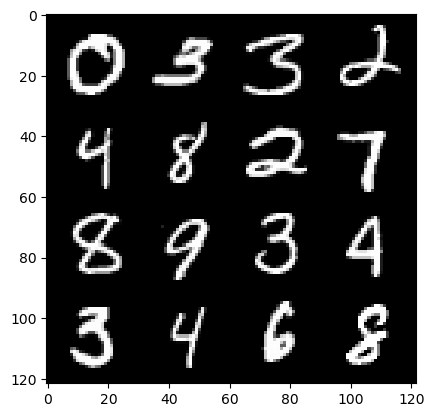

415: step 194700/ Gen loss: 1.9612064925829567/ disc_loss: 0.3046794105569519


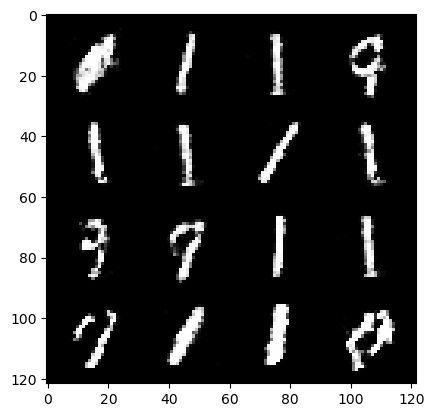

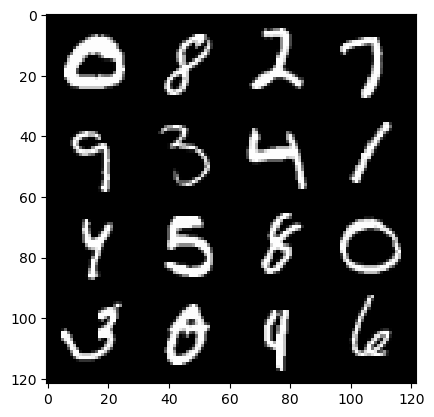

415: step 195000/ Gen loss: 1.944862693150839/ disc_loss: 0.3034820790588857


  0%|          | 0/469 [00:00<?, ?it/s]

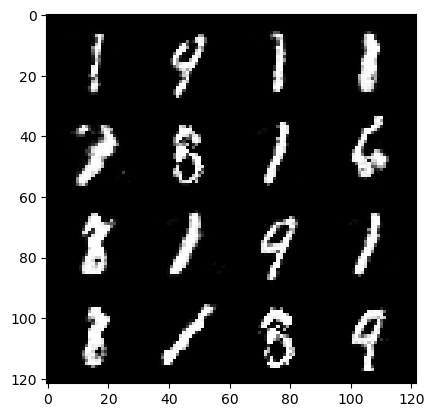

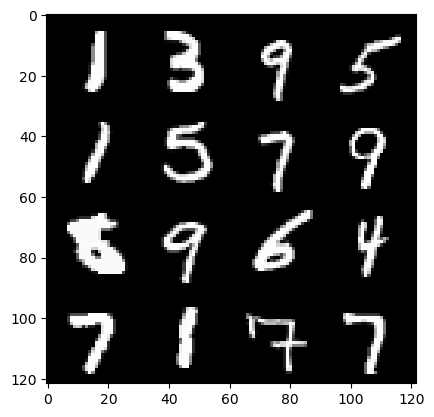

416: step 195300/ Gen loss: 2.119238419930142/ disc_loss: 0.27521094024181353


  0%|          | 0/469 [00:00<?, ?it/s]

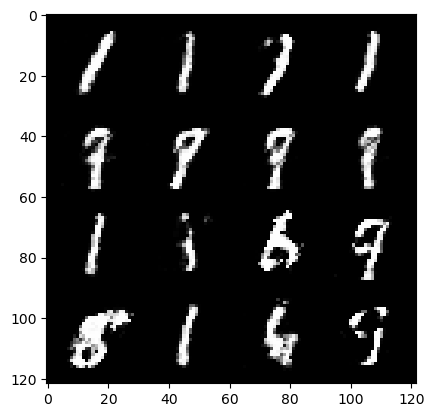

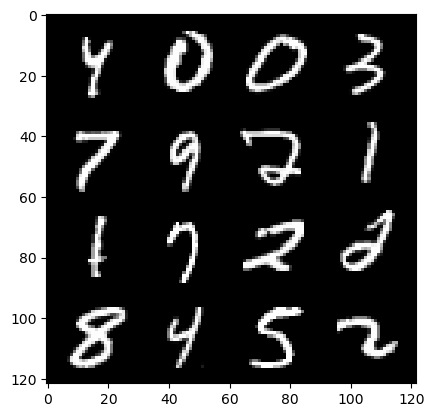

417: step 195600/ Gen loss: 2.0438758122920997/ disc_loss: 0.2857067919274171


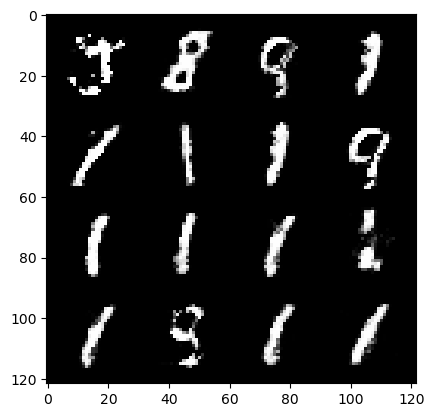

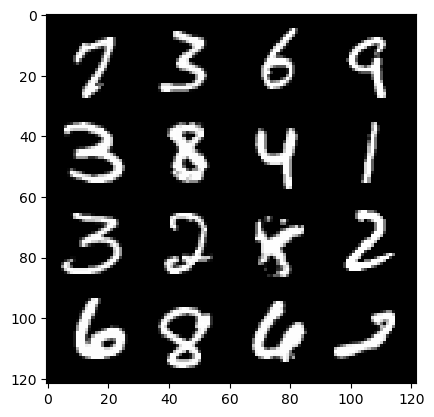

417: step 195900/ Gen loss: 2.0693650718530026/ disc_loss: 0.2754242046674093


  0%|          | 0/469 [00:00<?, ?it/s]

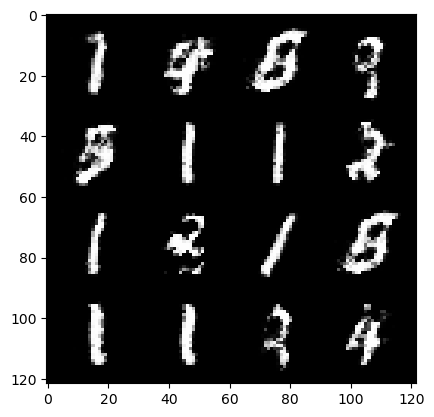

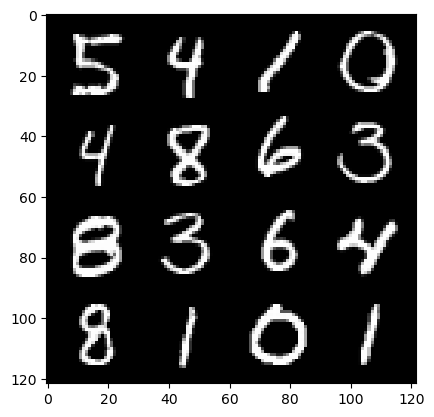

418: step 196200/ Gen loss: 2.06385054508845/ disc_loss: 0.2818616980314255


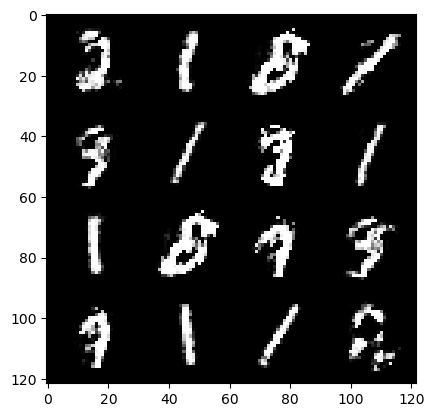

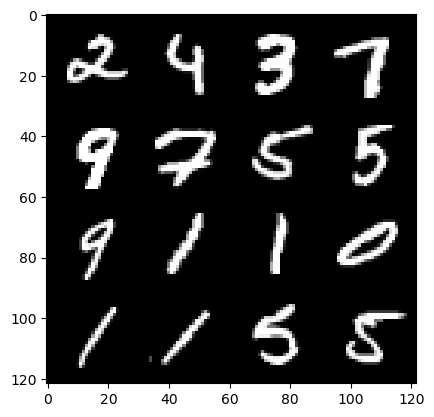

418: step 196500/ Gen loss: 2.0987644159793857/ disc_loss: 0.26100201139847434


  0%|          | 0/469 [00:00<?, ?it/s]

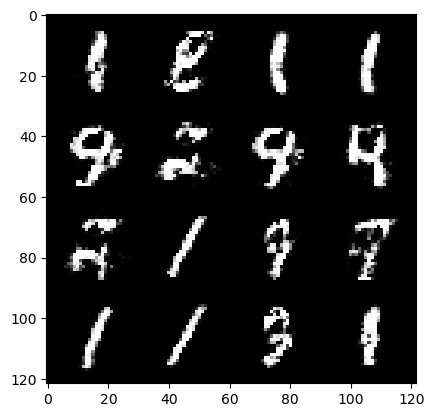

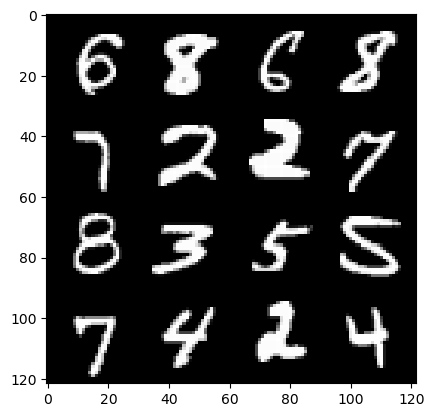

419: step 196800/ Gen loss: 2.1501653357346857/ disc_loss: 0.24966386655966424


  0%|          | 0/469 [00:00<?, ?it/s]

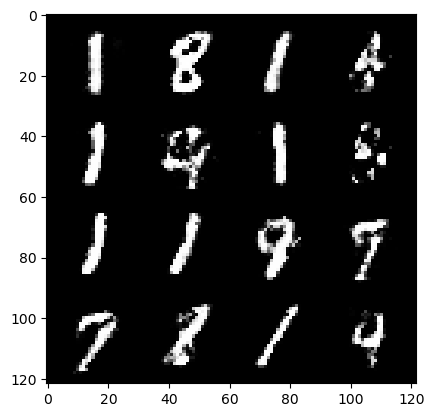

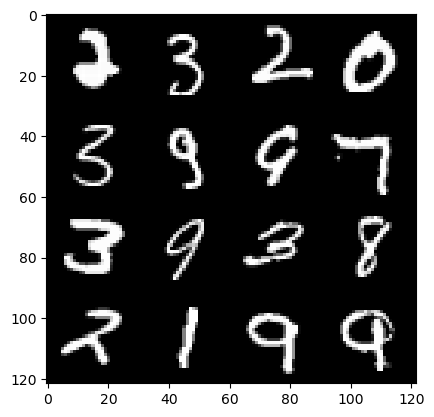

420: step 197100/ Gen loss: 2.1775382332007096/ disc_loss: 0.2633821538587412


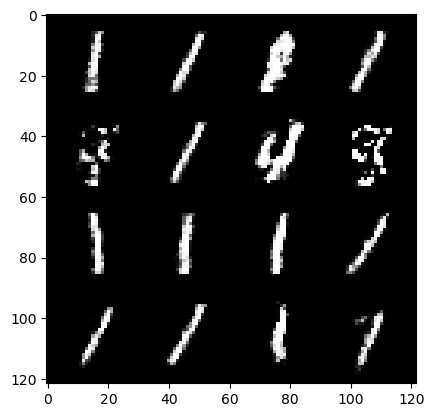

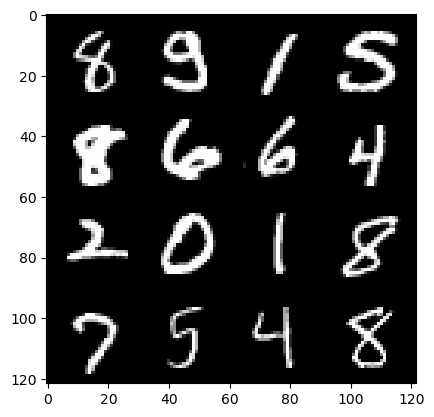

420: step 197400/ Gen loss: 2.1804338880379994/ disc_loss: 0.2552924625078836


  0%|          | 0/469 [00:00<?, ?it/s]

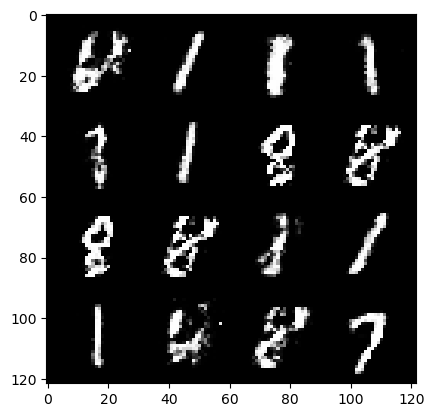

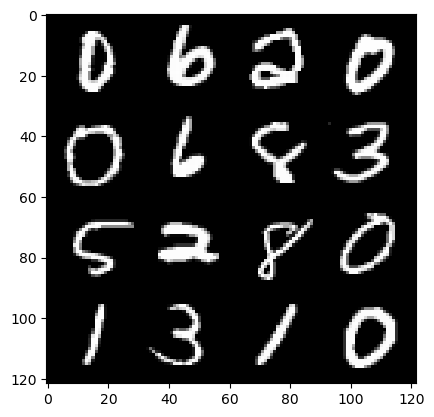

421: step 197700/ Gen loss: 2.1460722112655635/ disc_loss: 0.2544898383319375


  0%|          | 0/469 [00:00<?, ?it/s]

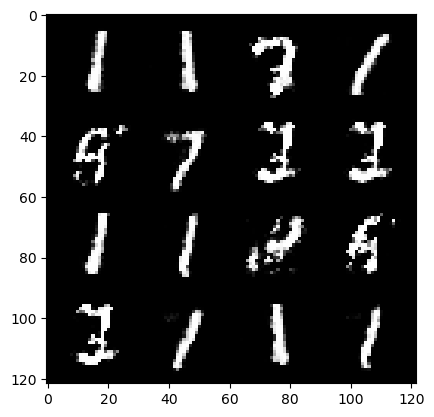

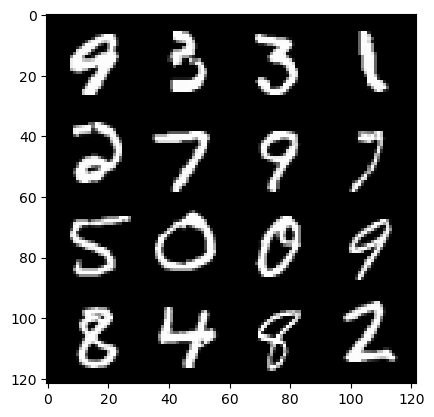

422: step 198000/ Gen loss: 2.1882058505217237/ disc_loss: 0.2567857800920805


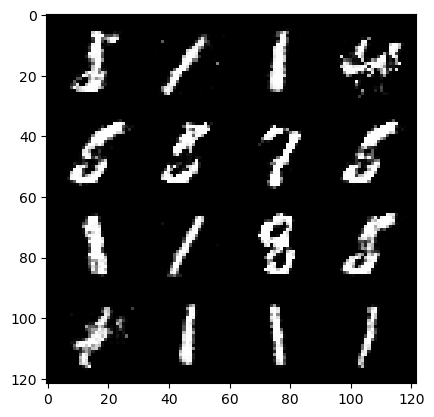

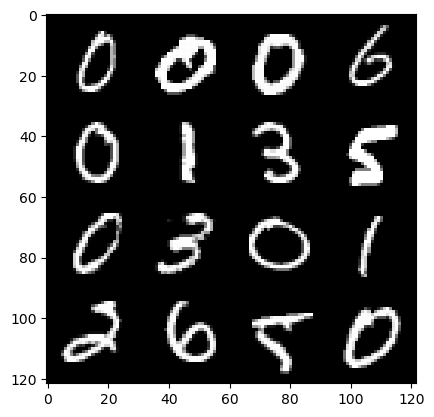

422: step 198300/ Gen loss: 2.1016911152998627/ disc_loss: 0.29647682011127463


  0%|          | 0/469 [00:00<?, ?it/s]

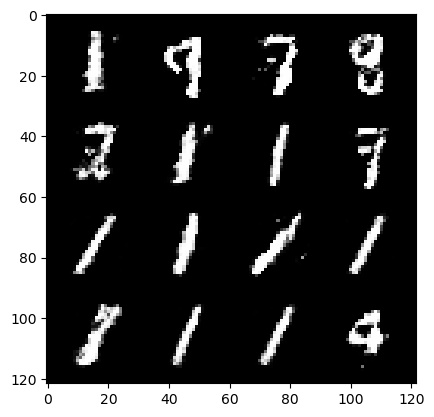

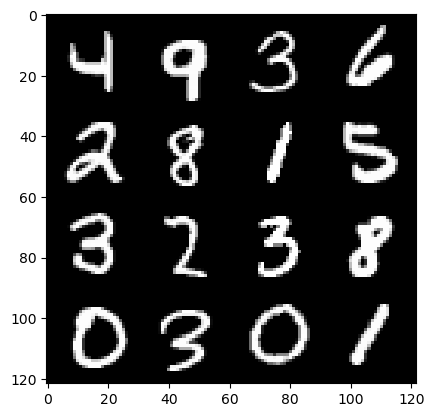

423: step 198600/ Gen loss: 2.1679378350575758/ disc_loss: 0.28305240561564776


  0%|          | 0/469 [00:00<?, ?it/s]

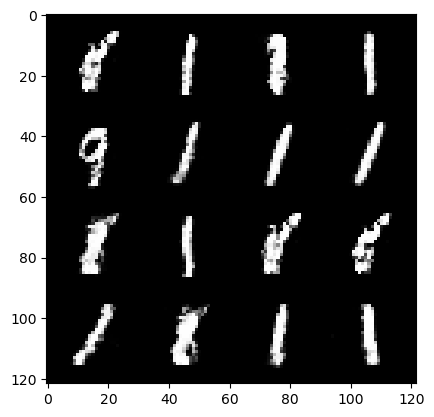

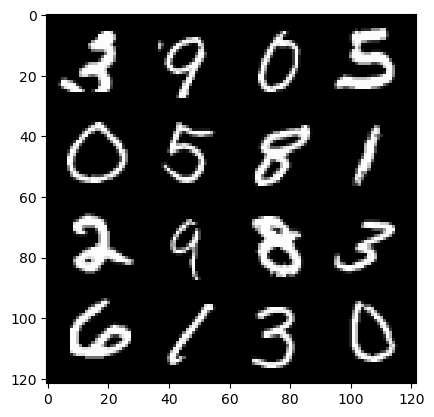

424: step 198900/ Gen loss: 2.137915334701538/ disc_loss: 0.2803078303734461


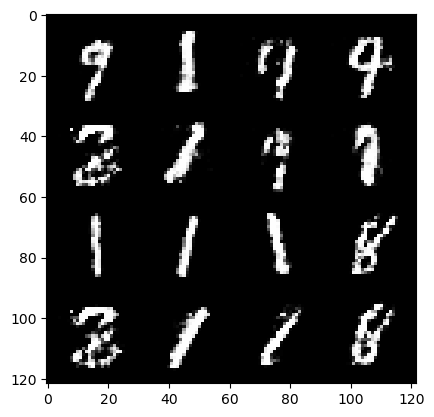

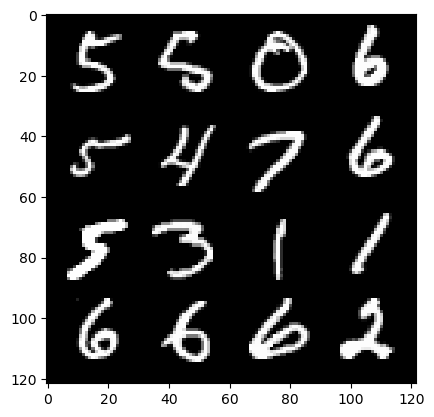

424: step 199200/ Gen loss: 2.131152925888698/ disc_loss: 0.2677017806470394


  0%|          | 0/469 [00:00<?, ?it/s]

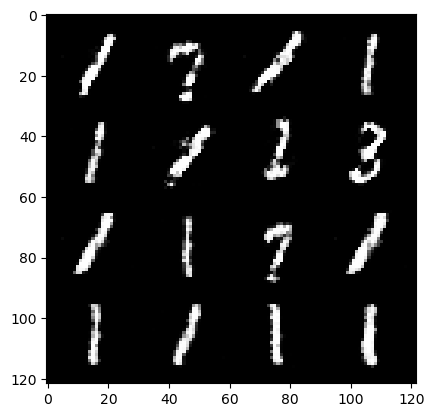

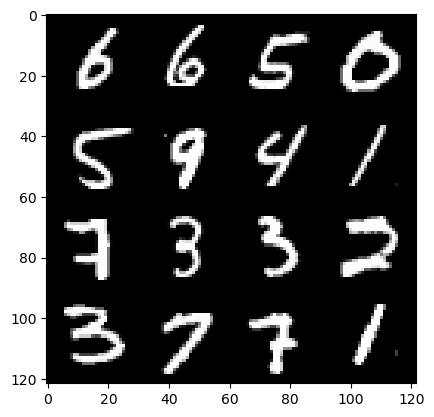

425: step 199500/ Gen loss: 2.091013888518017/ disc_loss: 0.28559292837977435


  0%|          | 0/469 [00:00<?, ?it/s]

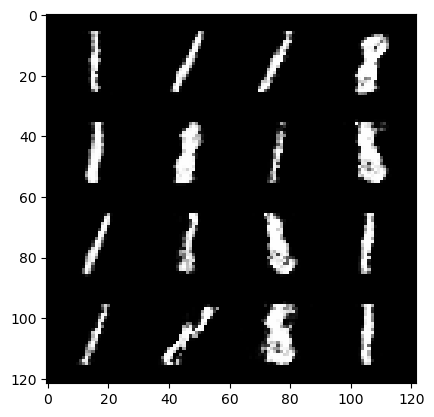

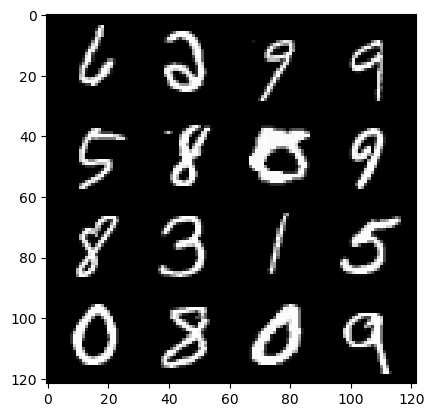

426: step 199800/ Gen loss: 2.0108202226956693/ disc_loss: 0.29876635804772383


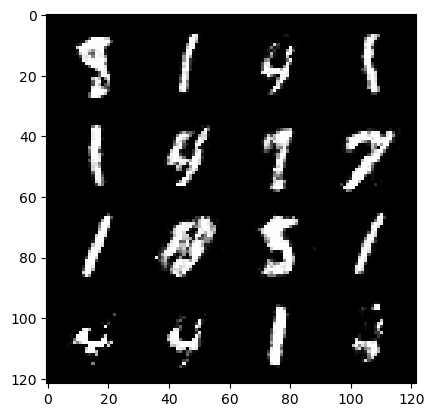

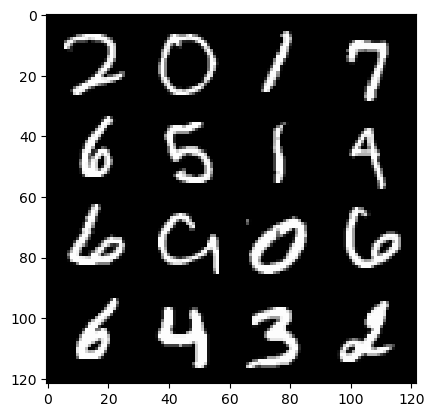

426: step 200100/ Gen loss: 1.9791943013668074/ disc_loss: 0.3105140297114852


  0%|          | 0/469 [00:00<?, ?it/s]

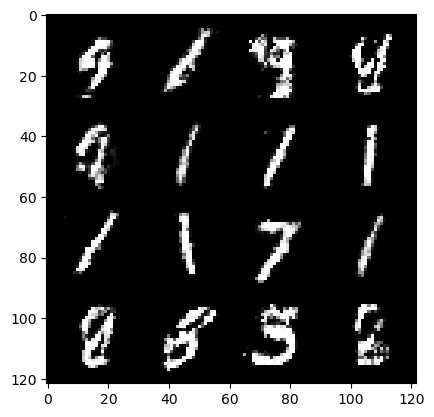

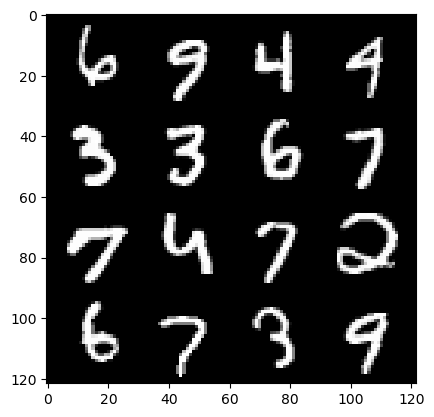

427: step 200400/ Gen loss: 1.9755938009421026/ disc_loss: 0.3012866020202637


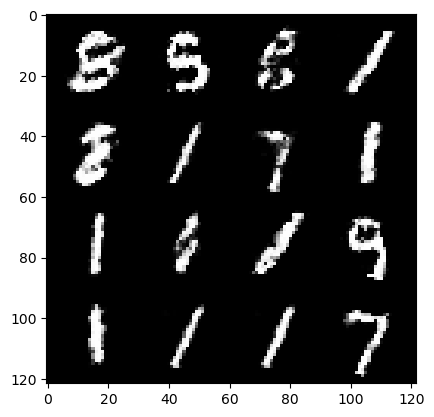

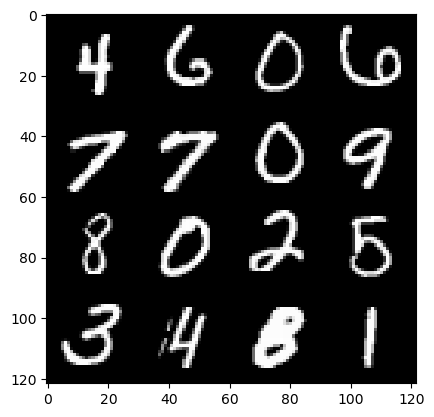

427: step 200700/ Gen loss: 1.895329160292944/ disc_loss: 0.3065379256506758


  0%|          | 0/469 [00:00<?, ?it/s]

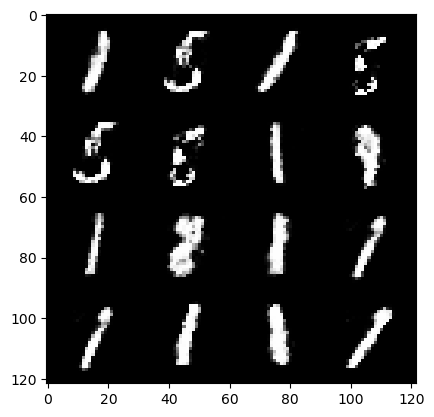

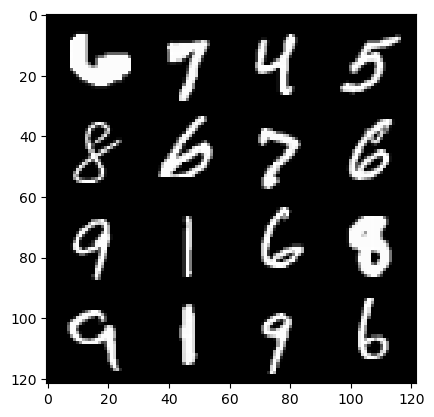

428: step 201000/ Gen loss: 1.8892873052755992/ disc_loss: 0.324806194752455


  0%|          | 0/469 [00:00<?, ?it/s]

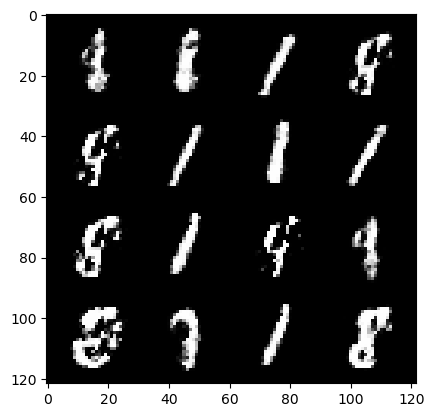

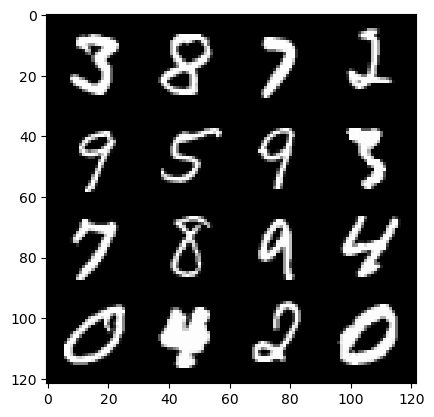

429: step 201300/ Gen loss: 1.9444246983528133/ disc_loss: 0.3086304932832717


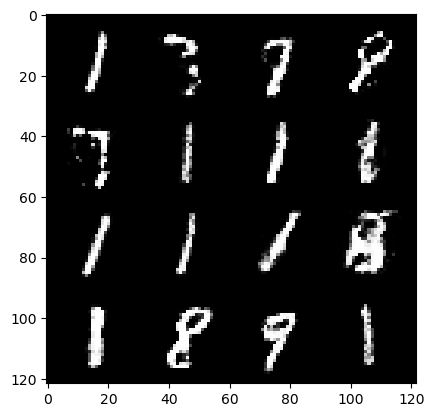

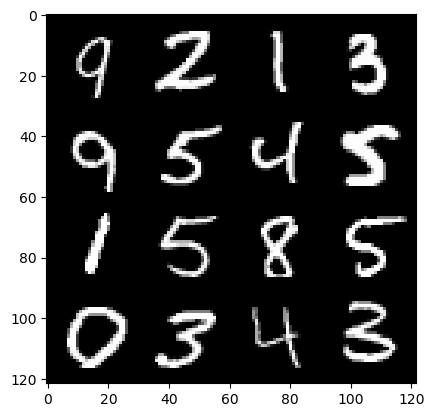

429: step 201600/ Gen loss: 1.973119517564774/ disc_loss: 0.30374088659882564


  0%|          | 0/469 [00:00<?, ?it/s]

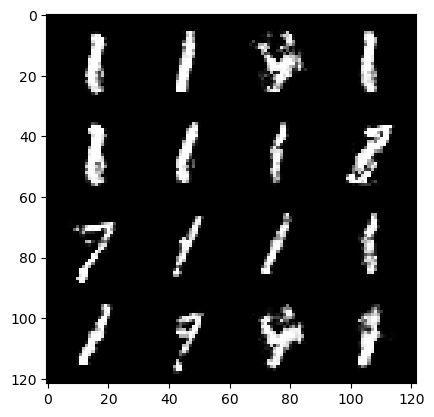

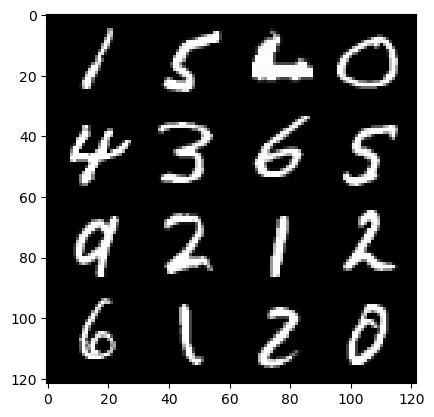

430: step 201900/ Gen loss: 2.0489831948280335/ disc_loss: 0.29677587260802596


  0%|          | 0/469 [00:00<?, ?it/s]

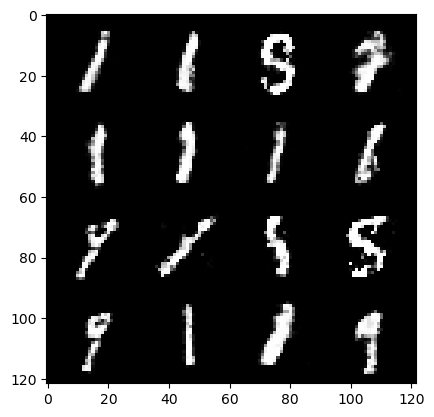

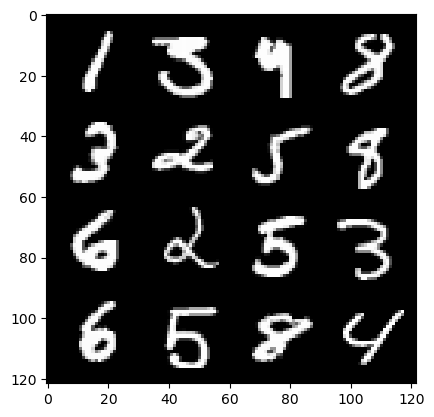

431: step 202200/ Gen loss: 2.0183917125066135/ disc_loss: 0.2907797832290332


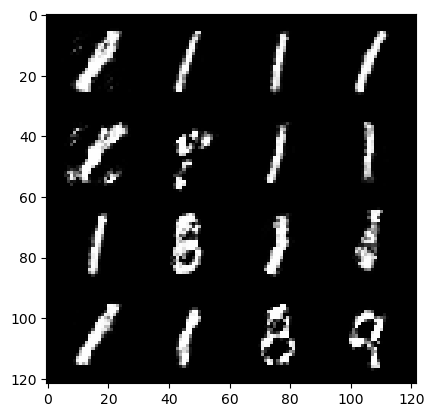

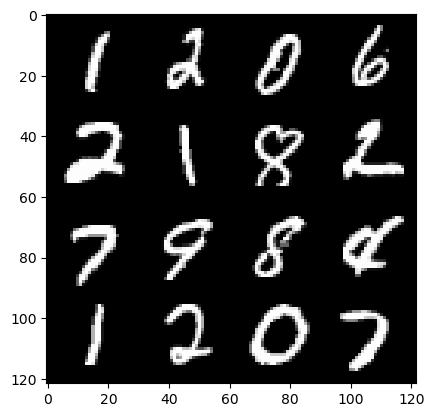

431: step 202500/ Gen loss: 2.093594032128653/ disc_loss: 0.27880640283226976


  0%|          | 0/469 [00:00<?, ?it/s]

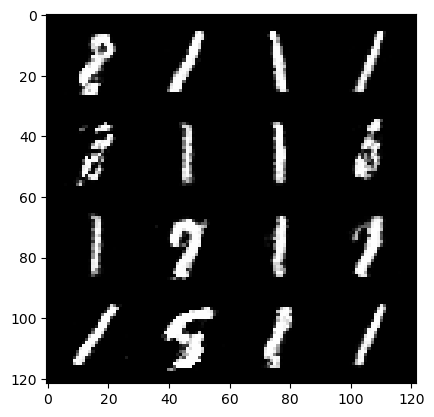

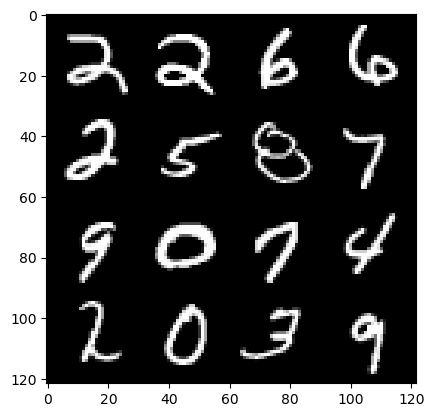

432: step 202800/ Gen loss: 2.0897991844018318/ disc_loss: 0.27363635842998824


  0%|          | 0/469 [00:00<?, ?it/s]

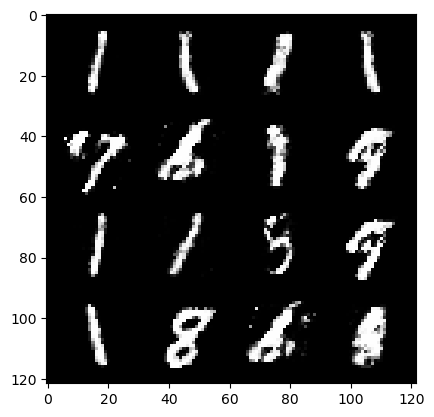

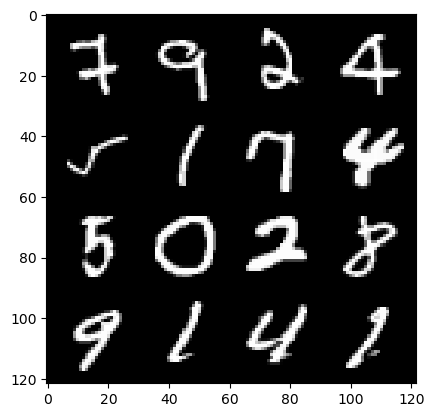

433: step 203100/ Gen loss: 2.035735359986624/ disc_loss: 0.28476184243957187


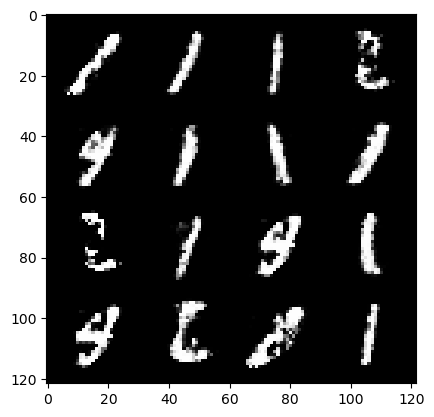

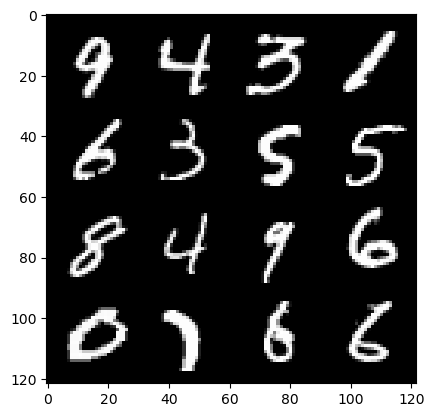

433: step 203400/ Gen loss: 2.015867342154185/ disc_loss: 0.28166668022672314


  0%|          | 0/469 [00:00<?, ?it/s]

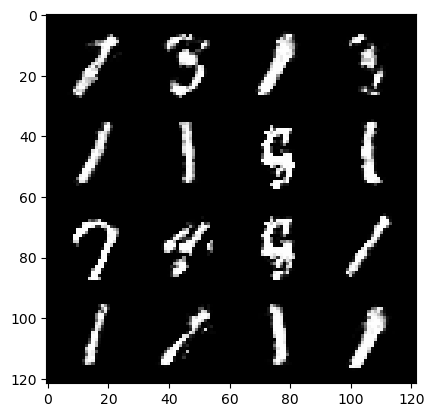

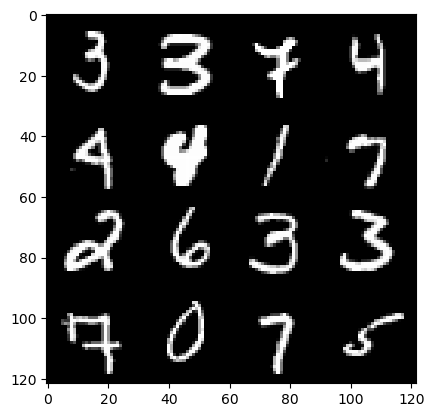

434: step 203700/ Gen loss: 1.9307748667399078/ disc_loss: 0.3016785983244577


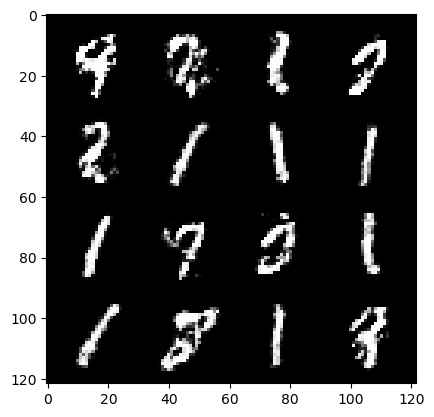

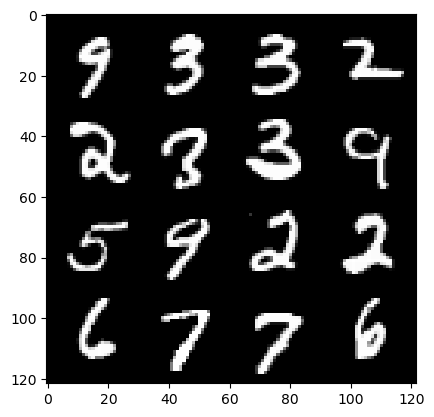

434: step 204000/ Gen loss: 1.9841974476973223/ disc_loss: 0.29489977627992614


  0%|          | 0/469 [00:00<?, ?it/s]

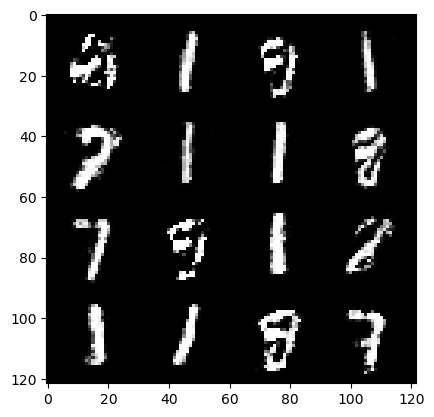

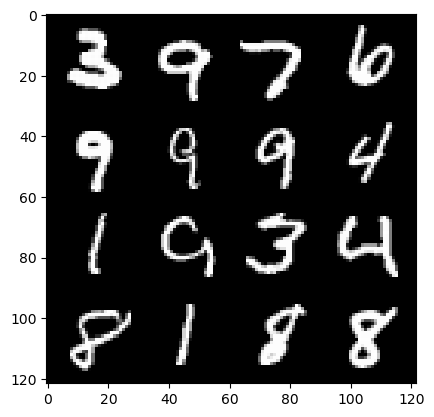

435: step 204300/ Gen loss: 2.1436911360422757/ disc_loss: 0.26444156199693686


  0%|          | 0/469 [00:00<?, ?it/s]

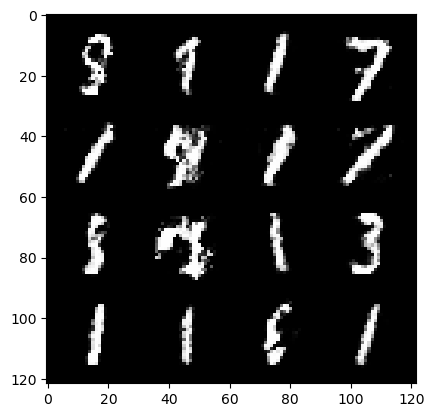

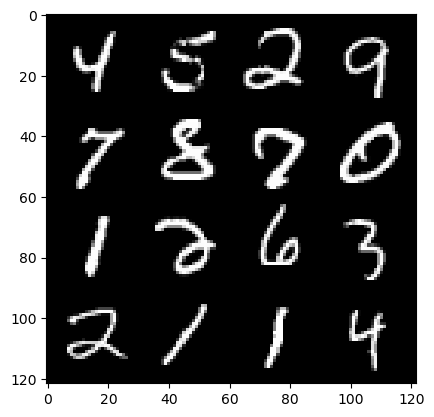

436: step 204600/ Gen loss: 2.0608825433254245/ disc_loss: 0.28822968254486736


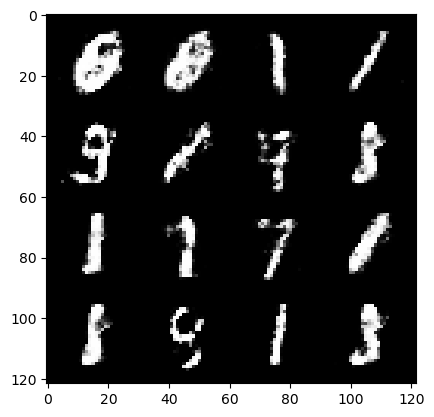

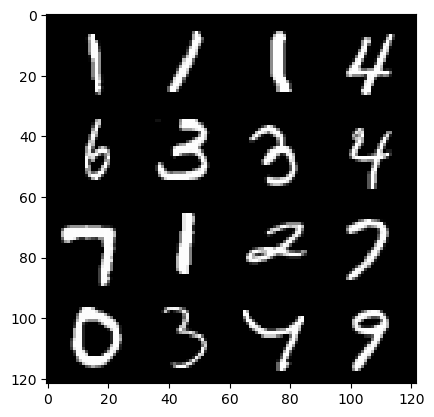

436: step 204900/ Gen loss: 1.9931007798512783/ disc_loss: 0.3094995926817258


  0%|          | 0/469 [00:00<?, ?it/s]

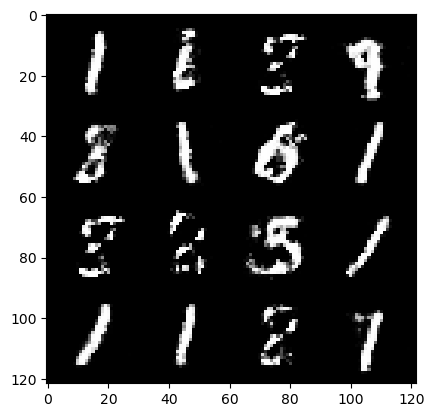

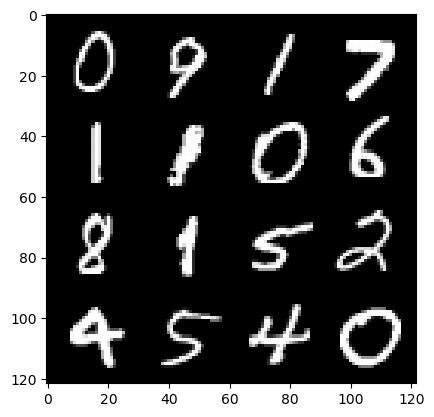

437: step 205200/ Gen loss: 1.9711540285746256/ disc_loss: 0.29175799518823586


  0%|          | 0/469 [00:00<?, ?it/s]

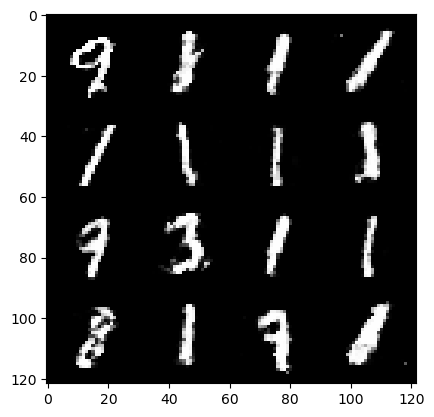

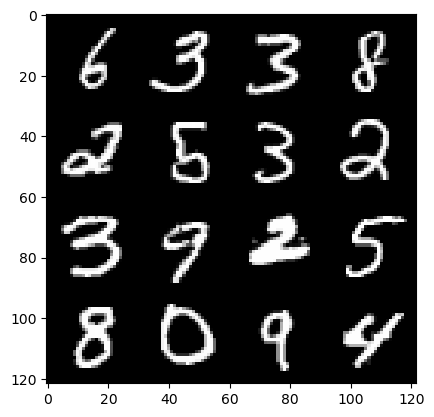

438: step 205500/ Gen loss: 2.026173514127733/ disc_loss: 0.2947567074000836


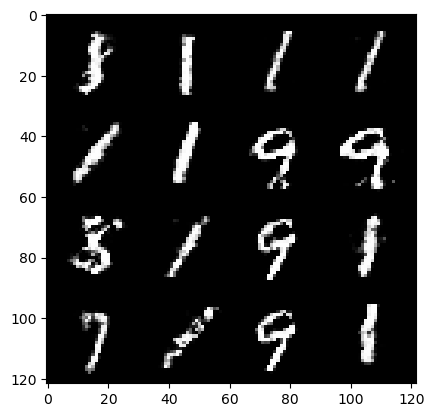

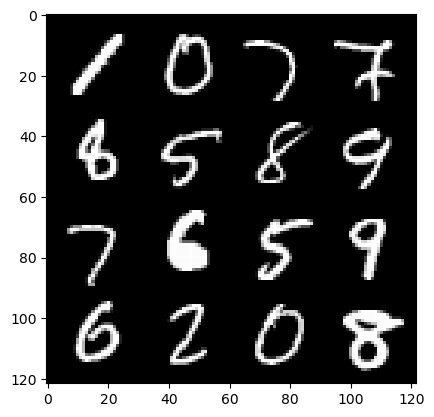

438: step 205800/ Gen loss: 1.9610979080200186/ disc_loss: 0.3047047638396423


  0%|          | 0/469 [00:00<?, ?it/s]

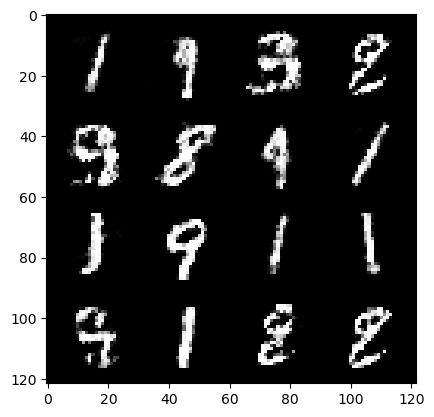

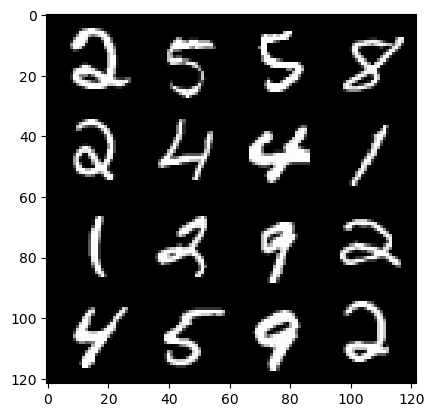

439: step 206100/ Gen loss: 1.9486300138632455/ disc_loss: 0.309352498948574


  0%|          | 0/469 [00:00<?, ?it/s]

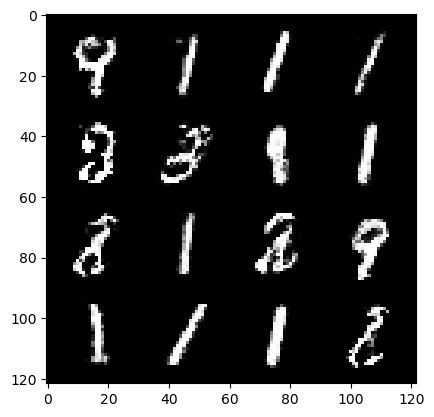

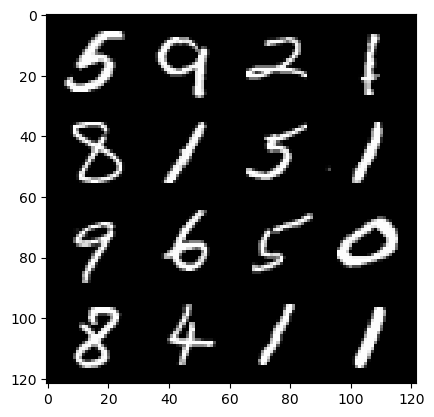

440: step 206400/ Gen loss: 1.922480386892955/ disc_loss: 0.3094895295302073


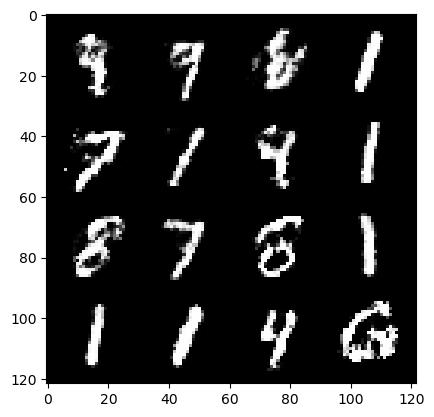

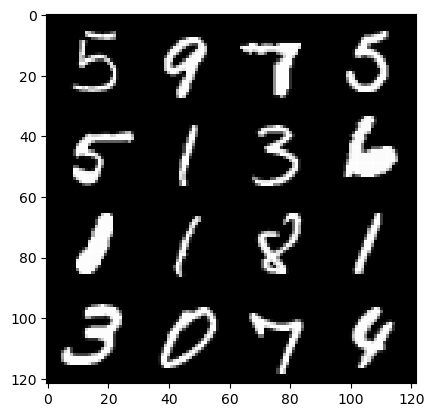

440: step 206700/ Gen loss: 1.8912288443247491/ disc_loss: 0.3234085507194204


  0%|          | 0/469 [00:00<?, ?it/s]

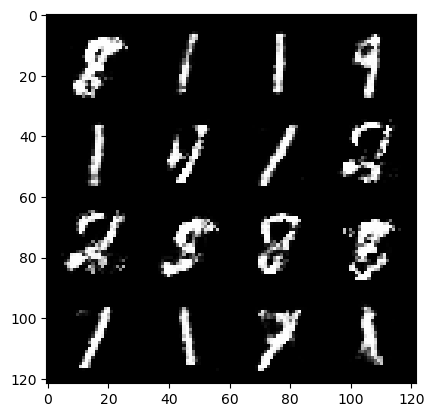

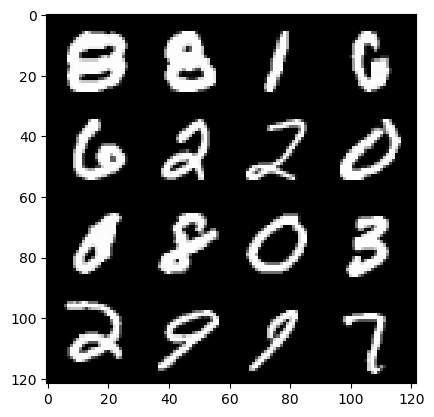

441: step 207000/ Gen loss: 1.9100428561369585/ disc_loss: 0.3231126101811725


  0%|          | 0/469 [00:00<?, ?it/s]

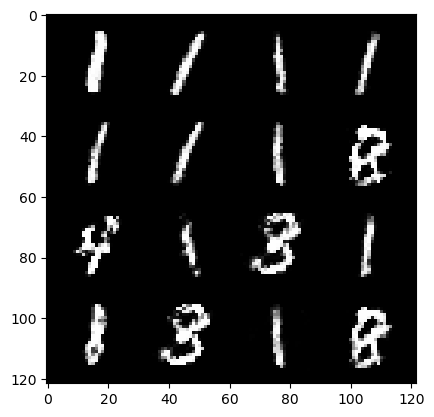

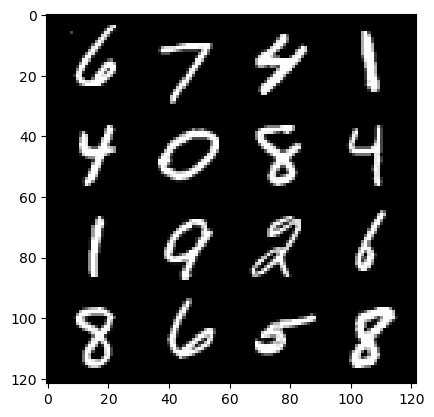

442: step 207300/ Gen loss: 1.9498893789450327/ disc_loss: 0.3004200304547945


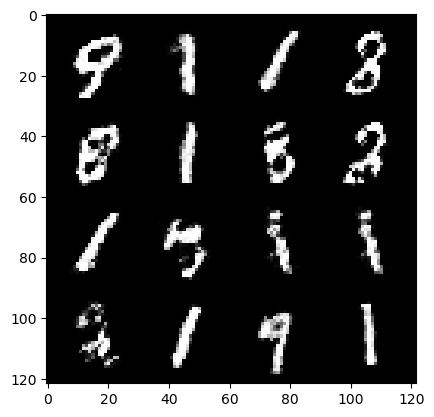

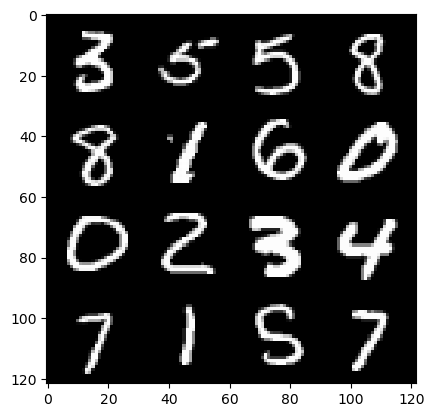

442: step 207600/ Gen loss: 1.9439411342144006/ disc_loss: 0.3147513873378435


  0%|          | 0/469 [00:00<?, ?it/s]

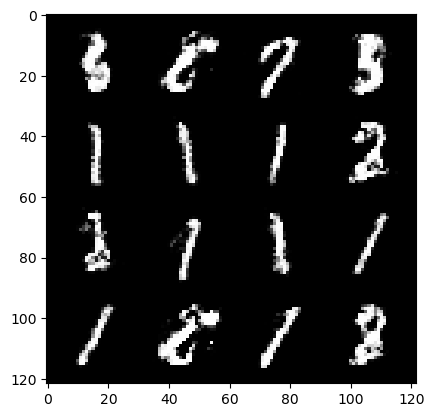

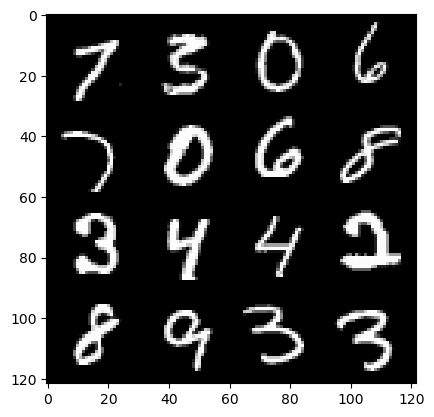

443: step 207900/ Gen loss: 2.006333208878834/ disc_loss: 0.310463284601768


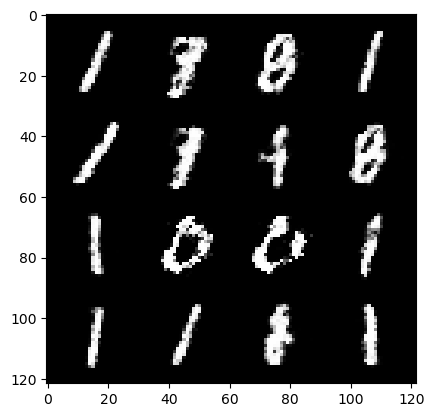

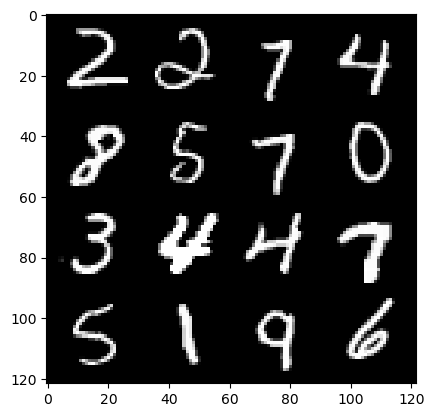

443: step 208200/ Gen loss: 2.1056326385339093/ disc_loss: 0.2923335505525273


  0%|          | 0/469 [00:00<?, ?it/s]

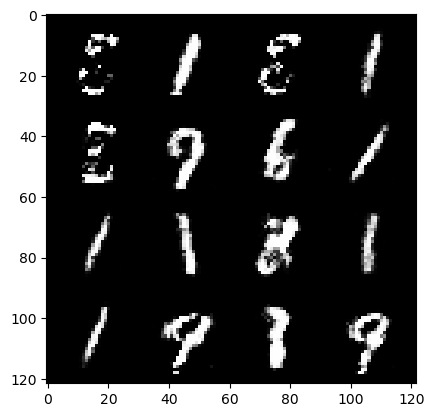

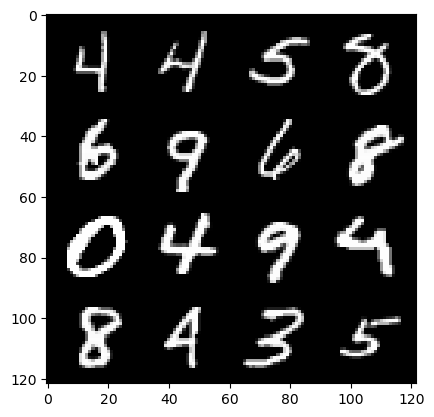

444: step 208500/ Gen loss: 2.103050553401311/ disc_loss: 0.28673692246278104


  0%|          | 0/469 [00:00<?, ?it/s]

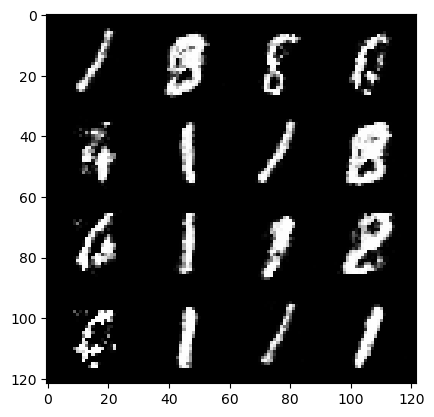

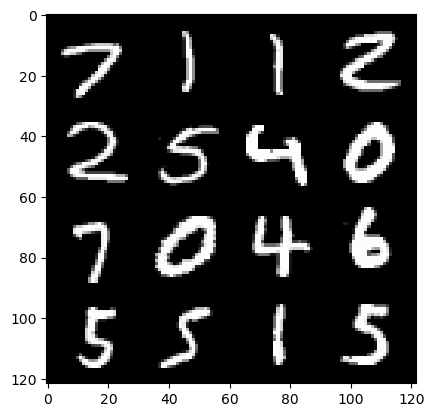

445: step 208800/ Gen loss: 1.9368536702791843/ disc_loss: 0.30915679022669784


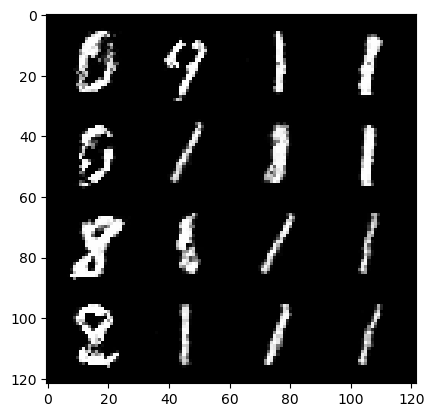

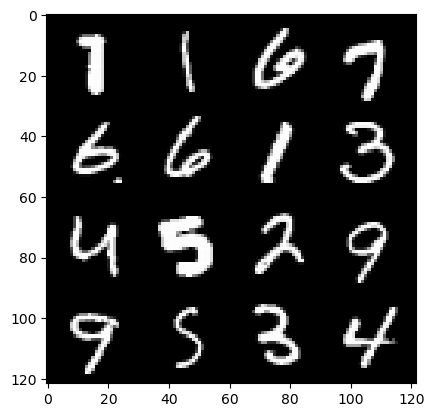

445: step 209100/ Gen loss: 1.9433611138661693/ disc_loss: 0.2908526040116947


  0%|          | 0/469 [00:00<?, ?it/s]

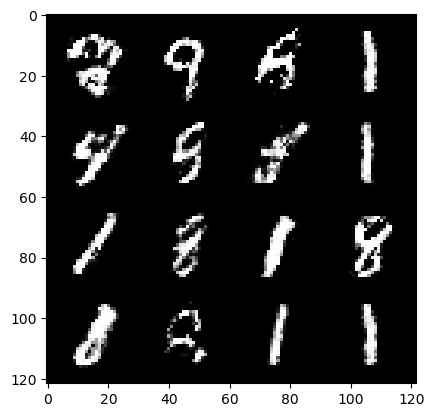

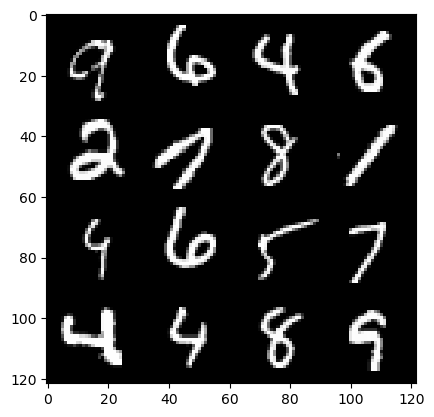

446: step 209400/ Gen loss: 1.9293573403358462/ disc_loss: 0.29881212860345857


  0%|          | 0/469 [00:00<?, ?it/s]

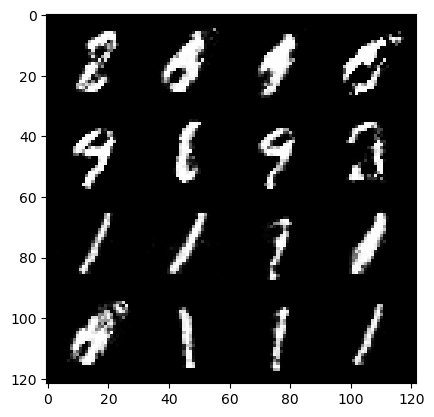

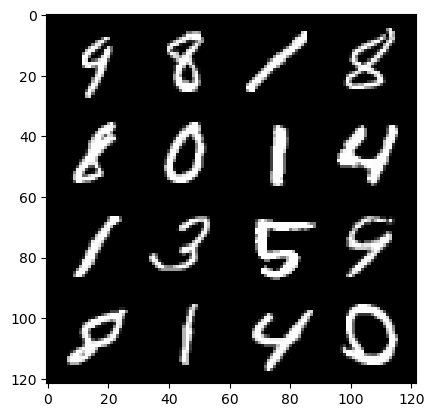

447: step 209700/ Gen loss: 1.9447118608156841/ disc_loss: 0.3010201502343019


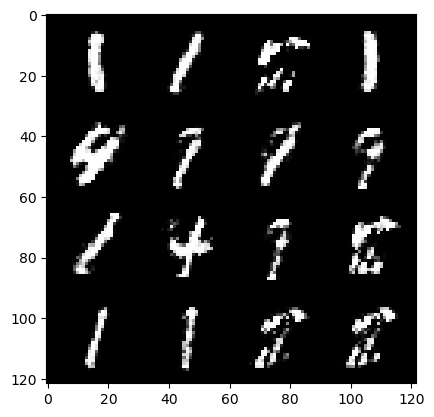

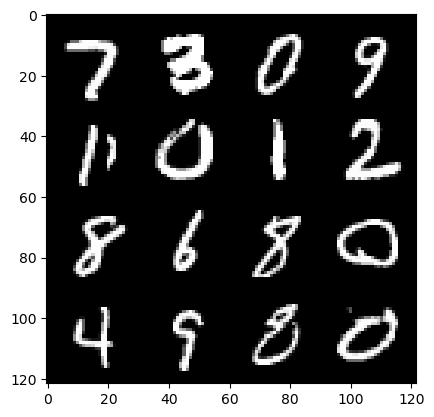

447: step 210000/ Gen loss: 2.0429960906505595/ disc_loss: 0.2826146328945956


  0%|          | 0/469 [00:00<?, ?it/s]

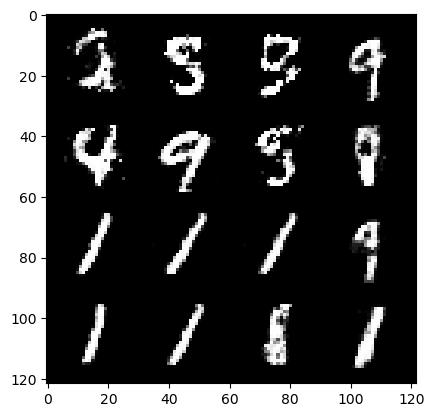

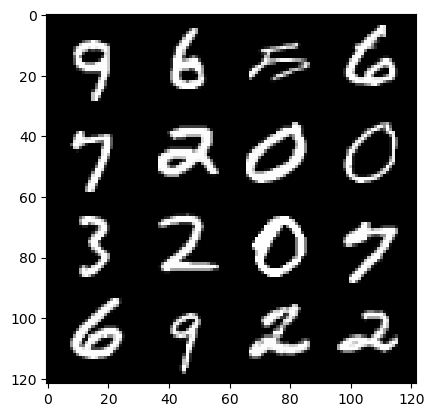

448: step 210300/ Gen loss: 2.02769959449768/ disc_loss: 0.30982870141665136


  0%|          | 0/469 [00:00<?, ?it/s]

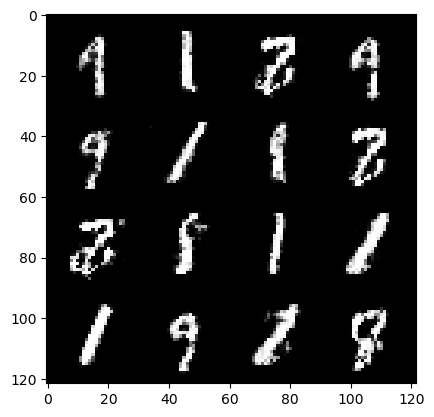

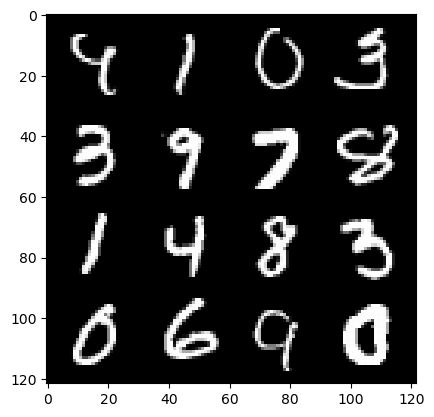

449: step 210600/ Gen loss: 1.8401590820153546/ disc_loss: 0.33072554290294653


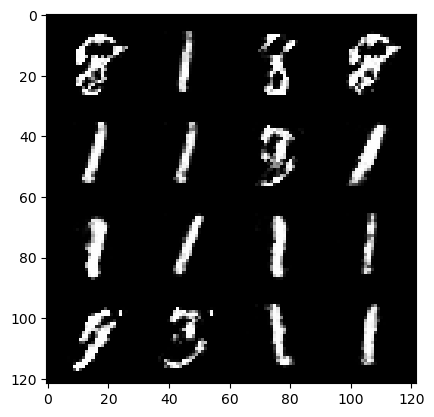

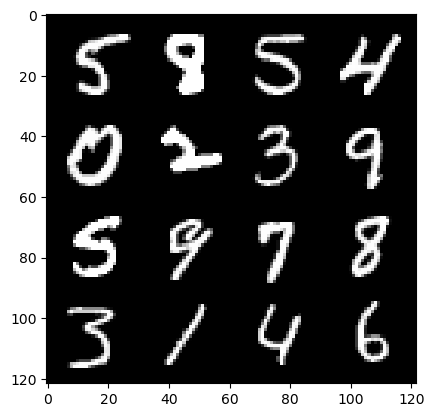

449: step 210900/ Gen loss: 1.8956654965877533/ disc_loss: 0.3062930573523046


  0%|          | 0/469 [00:00<?, ?it/s]

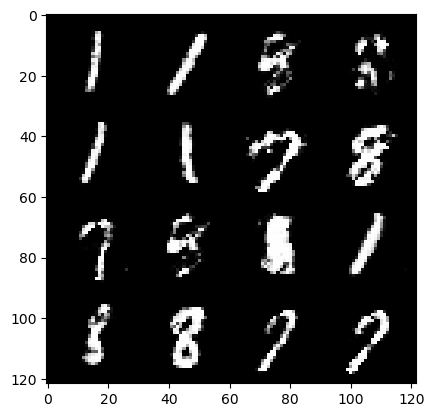

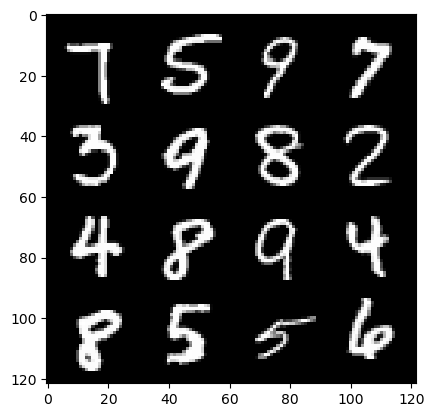

450: step 211200/ Gen loss: 1.9681516710917155/ disc_loss: 0.286417456517617


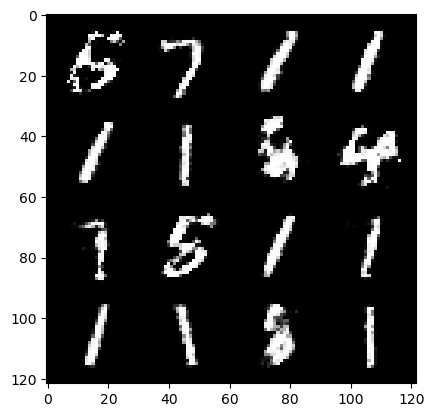

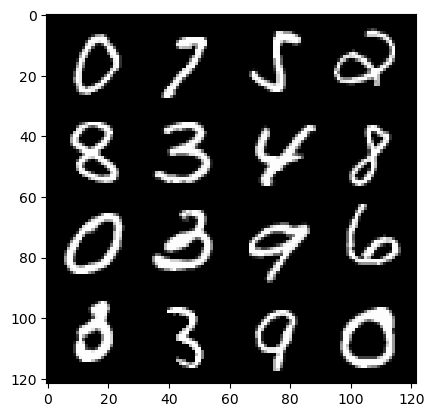

450: step 211500/ Gen loss: 2.040232101281485/ disc_loss: 0.2946116471787295


  0%|          | 0/469 [00:00<?, ?it/s]

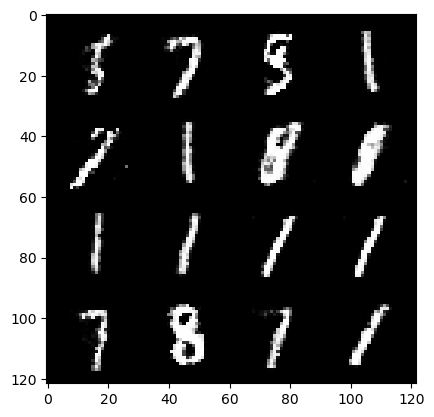

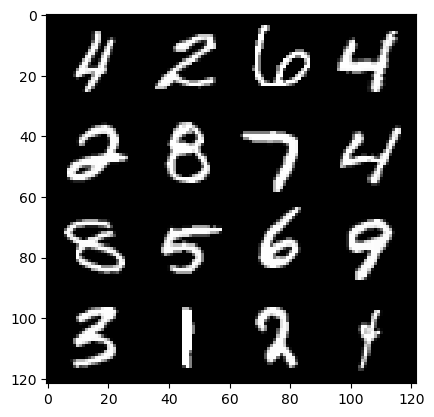

451: step 211800/ Gen loss: 2.01169959584872/ disc_loss: 0.27485442176461233


  0%|          | 0/469 [00:00<?, ?it/s]

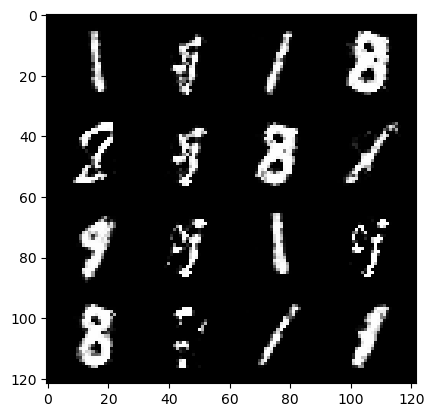

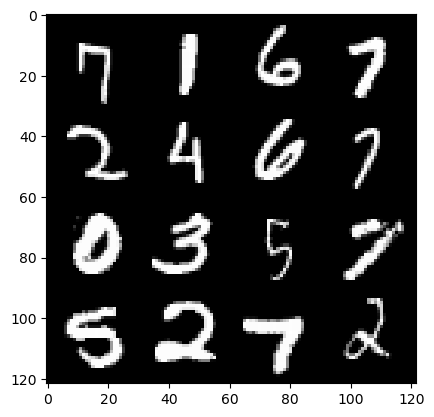

452: step 212100/ Gen loss: 2.0115642400582634/ disc_loss: 0.27917288064956663


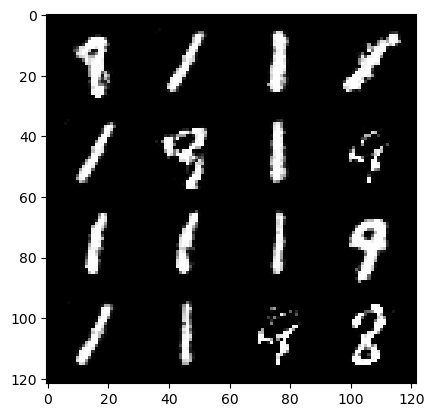

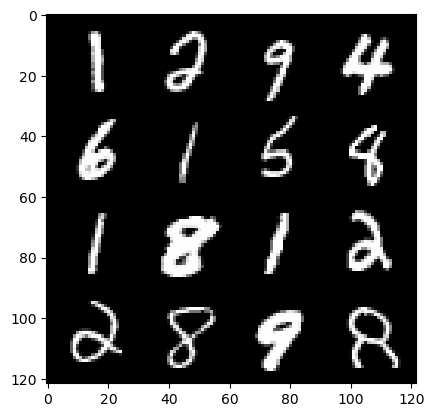

452: step 212400/ Gen loss: 1.9976554818948111/ disc_loss: 0.28736372902989377


  0%|          | 0/469 [00:00<?, ?it/s]

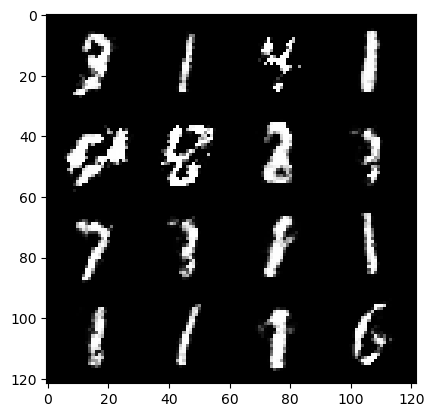

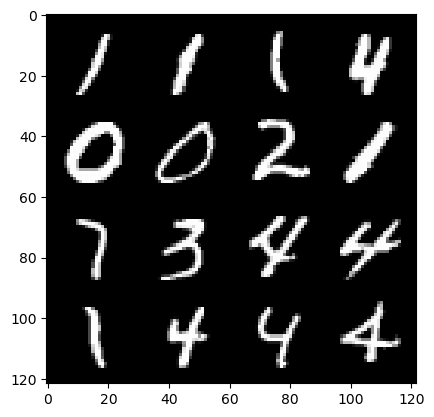

453: step 212700/ Gen loss: 2.0461106391747803/ disc_loss: 0.3007002064585687


  0%|          | 0/469 [00:00<?, ?it/s]

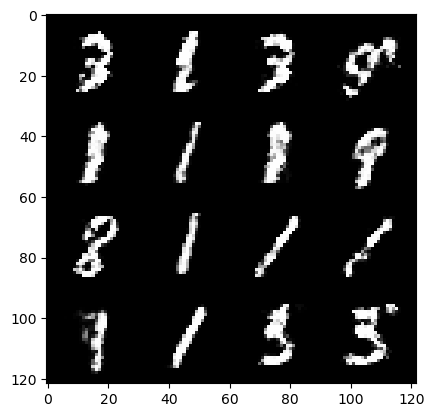

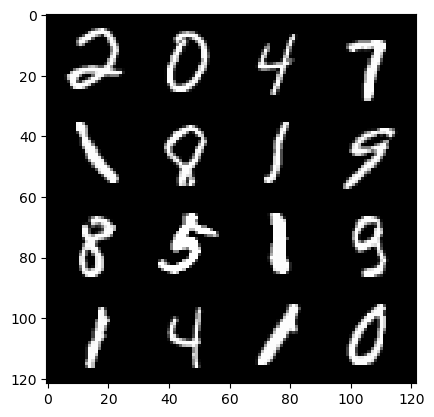

454: step 213000/ Gen loss: 1.950209235350291/ disc_loss: 0.30199913447101917


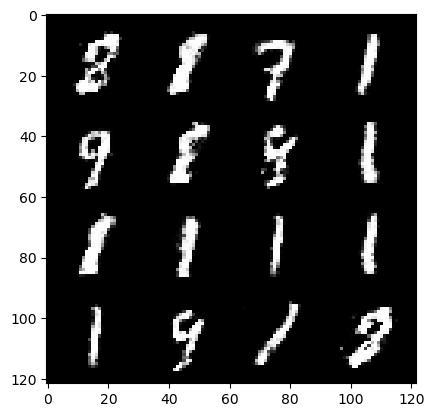

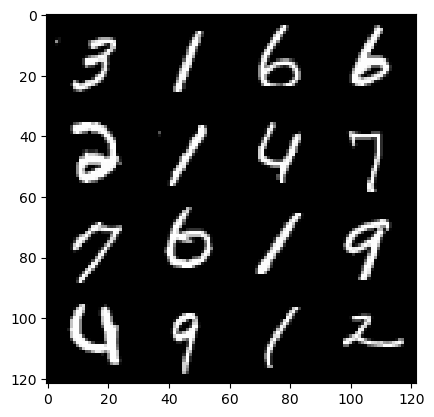

454: step 213300/ Gen loss: 2.0268867790699003/ disc_loss: 0.3011132731537027


  0%|          | 0/469 [00:00<?, ?it/s]

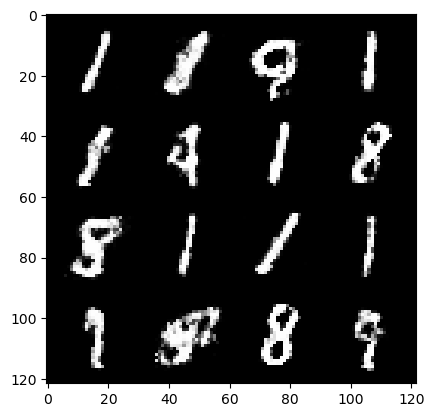

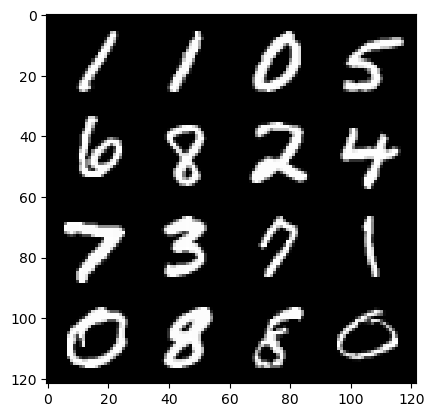

455: step 213600/ Gen loss: 2.036992422739666/ disc_loss: 0.30012473021944364


  0%|          | 0/469 [00:00<?, ?it/s]

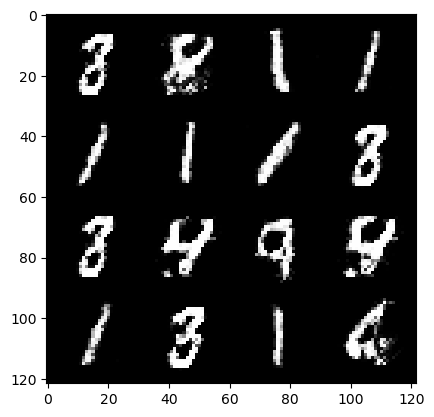

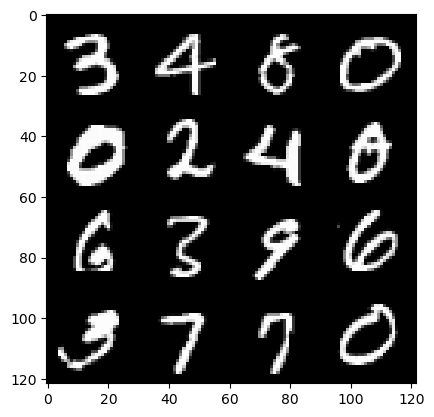

456: step 213900/ Gen loss: 2.053877082268397/ disc_loss: 0.2982331734399


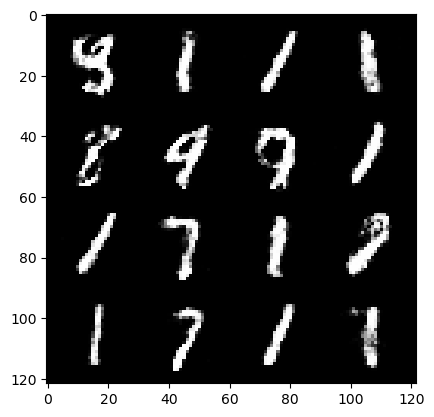

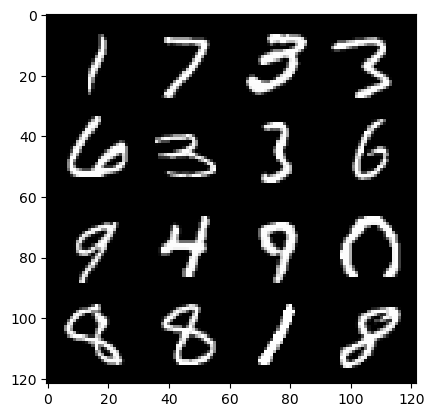

456: step 214200/ Gen loss: 2.063181161085763/ disc_loss: 0.29342770690719305


  0%|          | 0/469 [00:00<?, ?it/s]

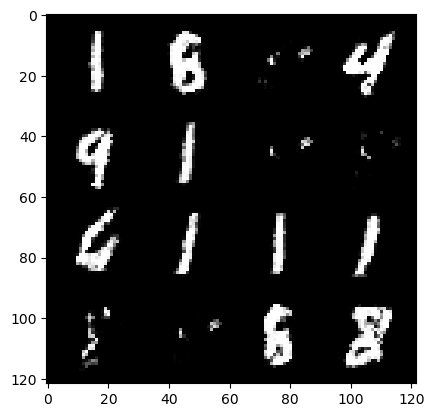

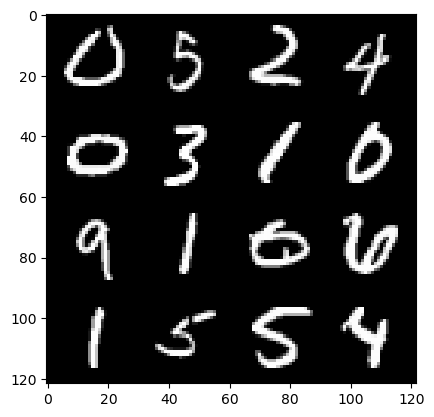

457: step 214500/ Gen loss: 2.0900007645289107/ disc_loss: 0.3076007356246312


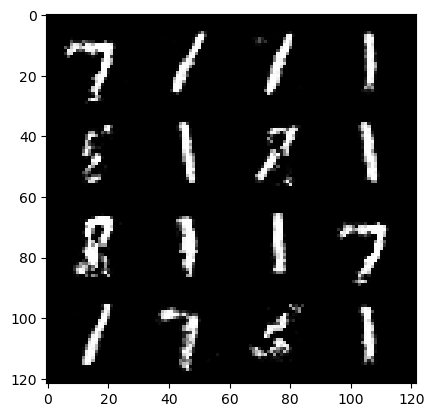

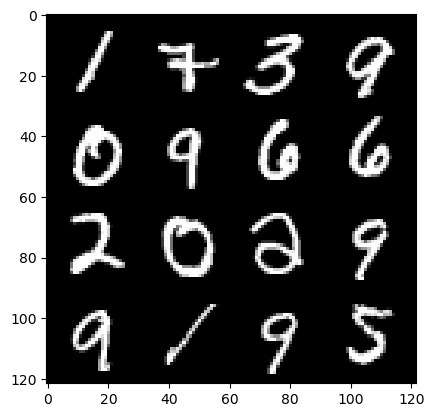

457: step 214800/ Gen loss: 2.0372702916463212/ disc_loss: 0.2899653210739293


  0%|          | 0/469 [00:00<?, ?it/s]

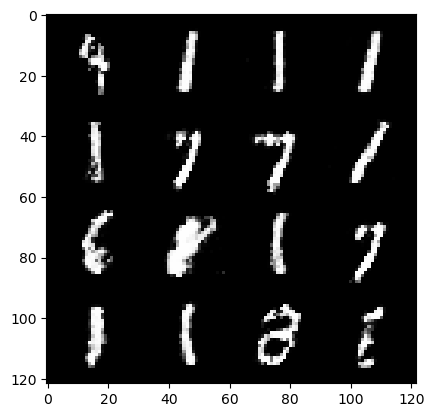

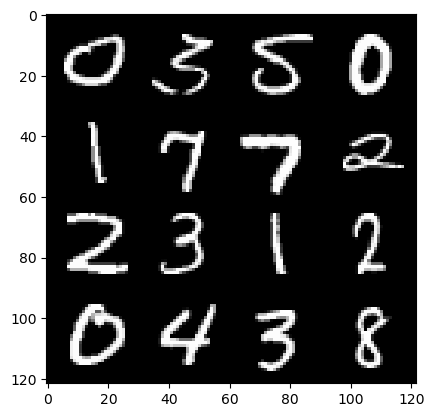

458: step 215100/ Gen loss: 1.987922007640204/ disc_loss: 0.30705933714906364


  0%|          | 0/469 [00:00<?, ?it/s]

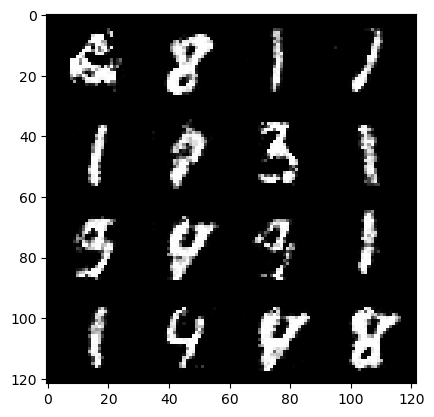

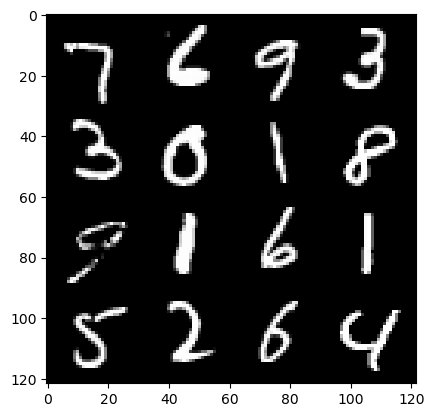

459: step 215400/ Gen loss: 1.9445014528433497/ disc_loss: 0.32305393889546413


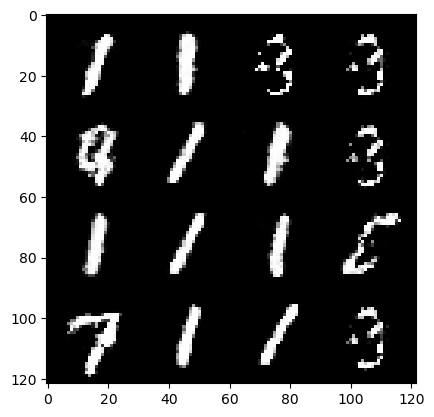

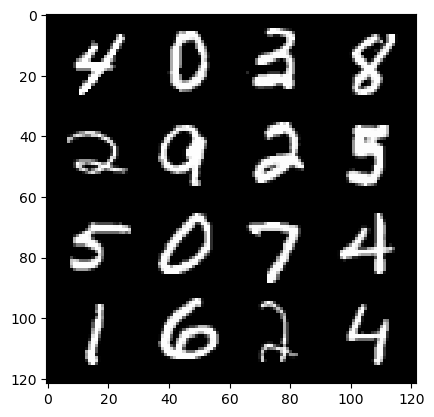

459: step 215700/ Gen loss: 2.008200838565825/ disc_loss: 0.29535101463397345


  0%|          | 0/469 [00:00<?, ?it/s]

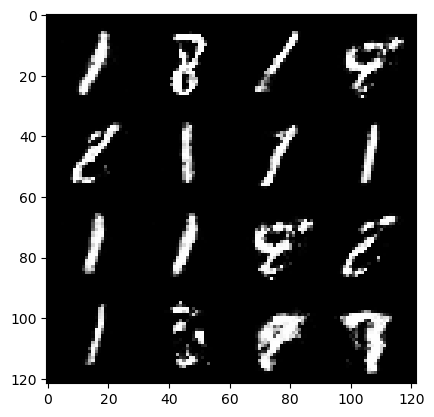

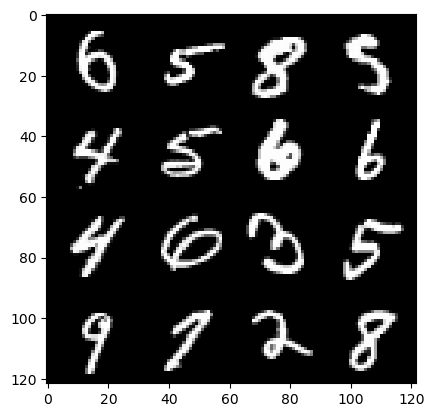

460: step 216000/ Gen loss: 2.033664112488429/ disc_loss: 0.2801373324791592


  0%|          | 0/469 [00:00<?, ?it/s]

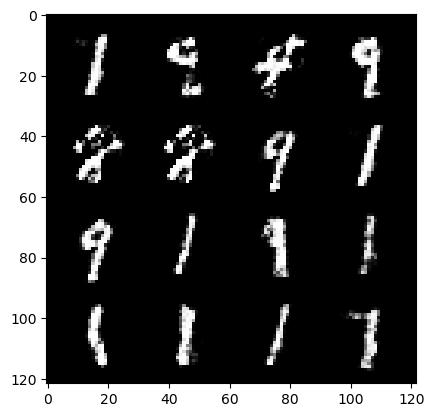

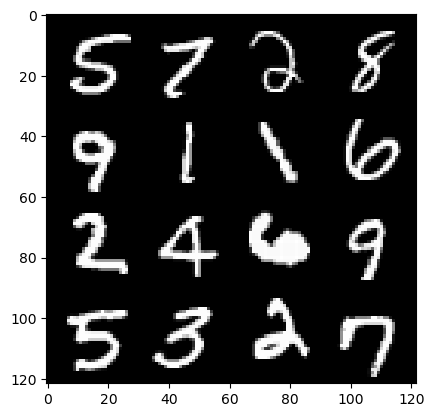

461: step 216300/ Gen loss: 2.004368094205855/ disc_loss: 0.28632976368069674


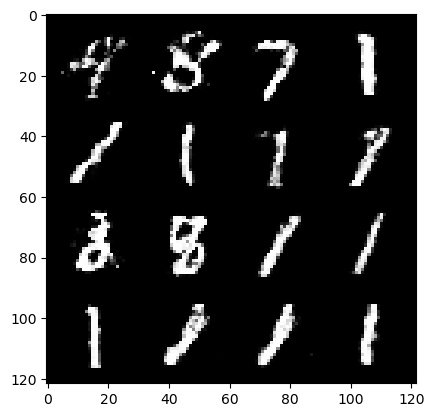

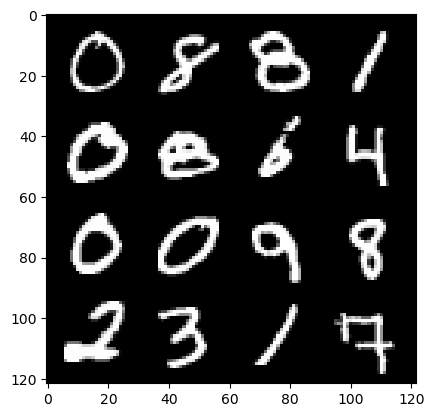

461: step 216600/ Gen loss: 2.135820045073826/ disc_loss: 0.26286857351660736


  0%|          | 0/469 [00:00<?, ?it/s]

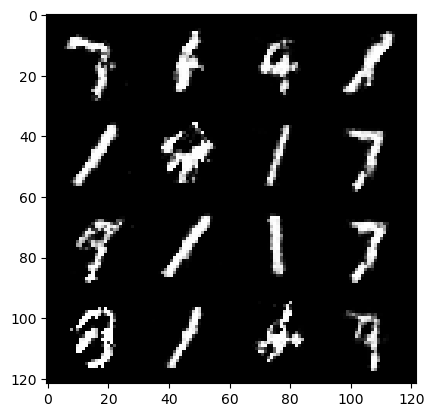

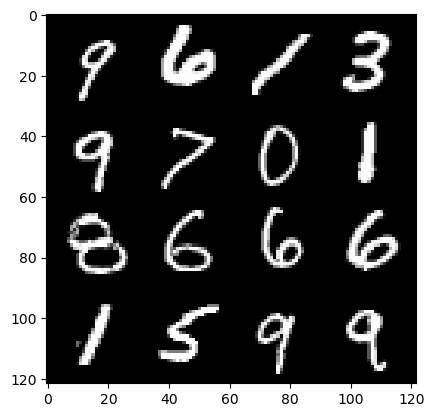

462: step 216900/ Gen loss: 2.0781723066171027/ disc_loss: 0.2924262701471646


  0%|          | 0/469 [00:00<?, ?it/s]

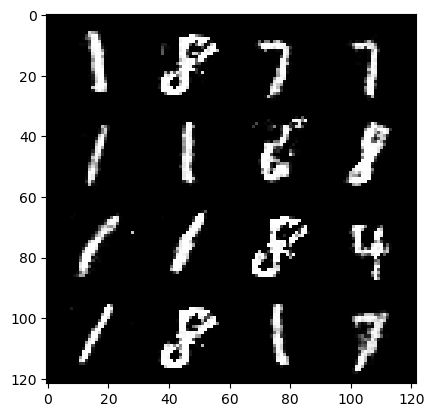

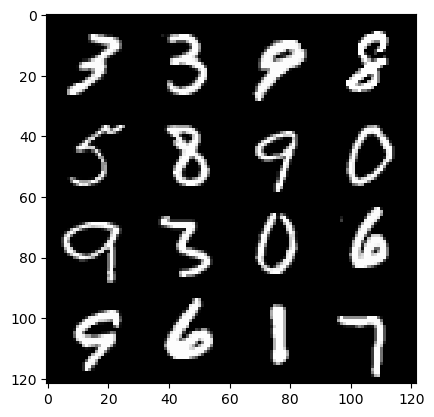

463: step 217200/ Gen loss: 2.0663990863164257/ disc_loss: 0.2910214389860629


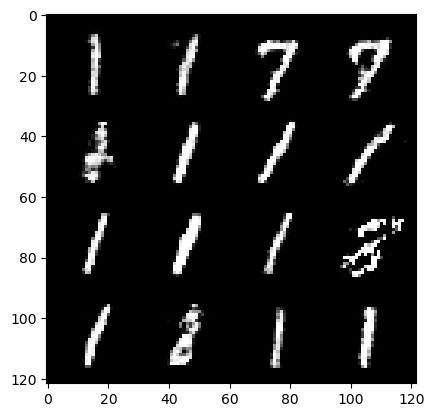

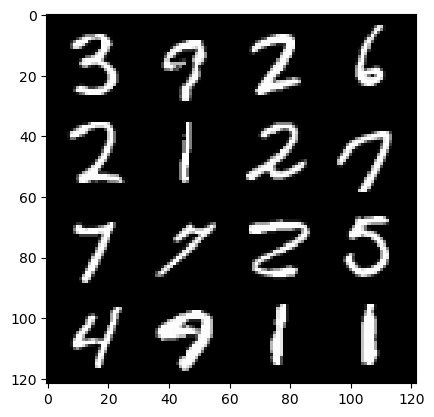

463: step 217500/ Gen loss: 1.9750955363114673/ disc_loss: 0.304510597983996


  0%|          | 0/469 [00:00<?, ?it/s]

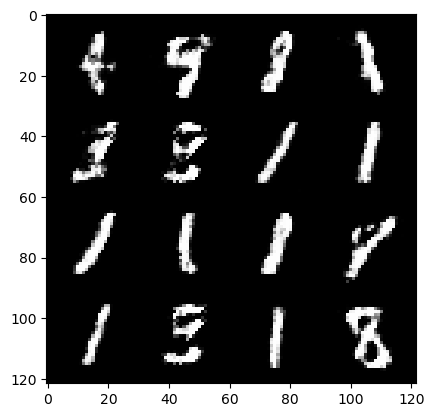

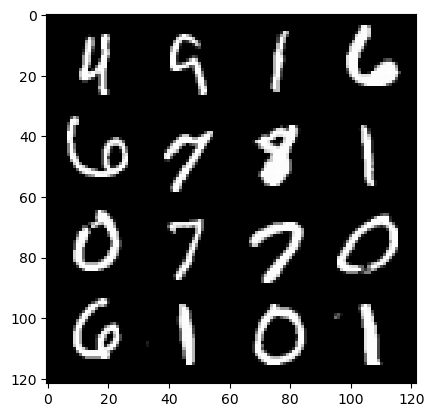

464: step 217800/ Gen loss: 1.9976523260275532/ disc_loss: 0.2931568941970667


  0%|          | 0/469 [00:00<?, ?it/s]

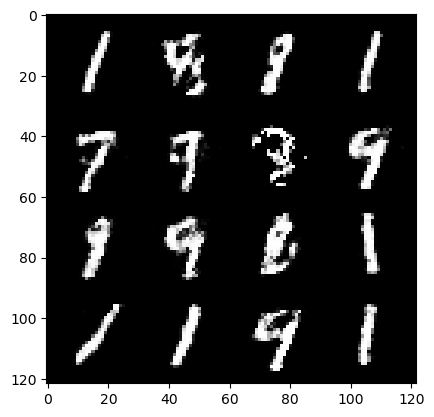

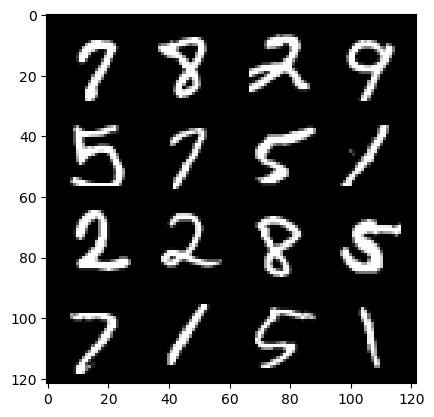

465: step 218100/ Gen loss: 1.9874013137817383/ disc_loss: 0.2930687063435713


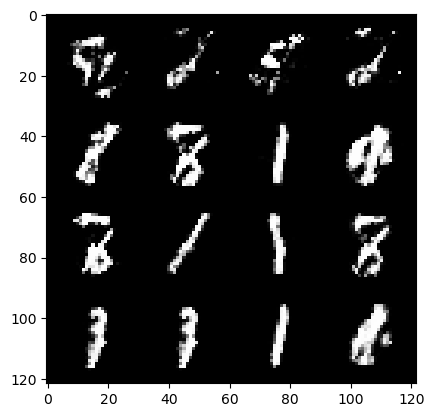

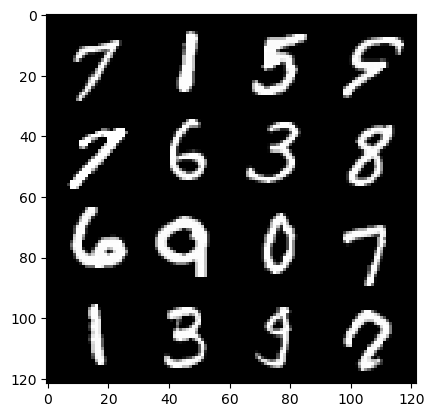

465: step 218400/ Gen loss: 2.0153762543201443/ disc_loss: 0.28359349707762416


  0%|          | 0/469 [00:00<?, ?it/s]

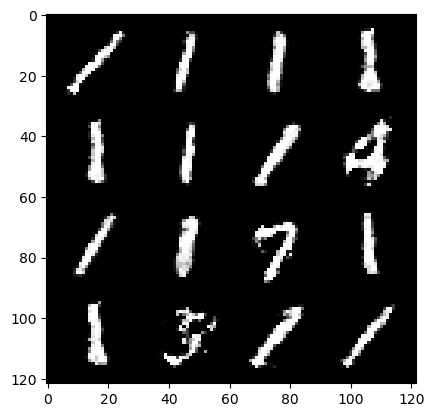

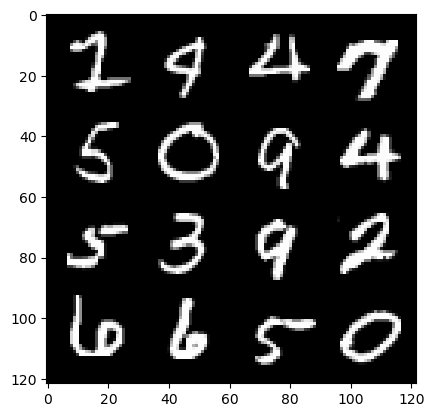

466: step 218700/ Gen loss: 2.0737728909651443/ disc_loss: 0.2828182002405322


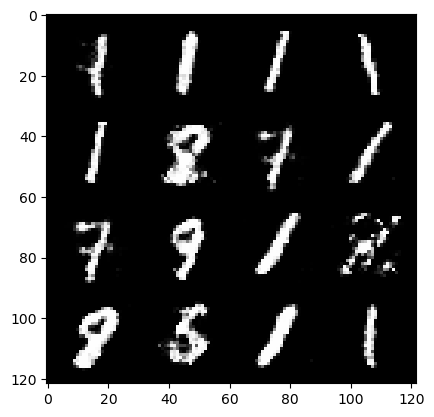

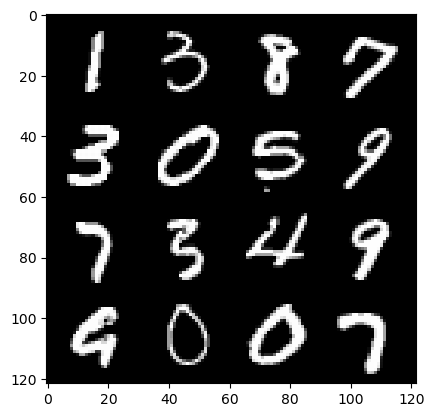

466: step 219000/ Gen loss: 2.0918703194459303/ disc_loss: 0.2963717363278071


  0%|          | 0/469 [00:00<?, ?it/s]

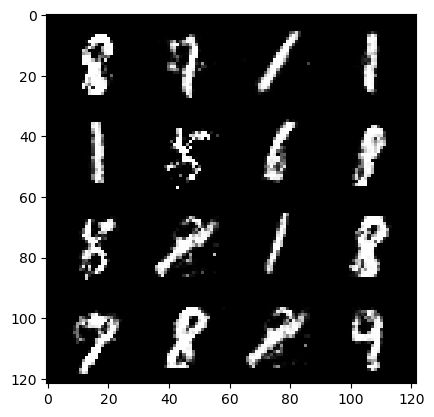

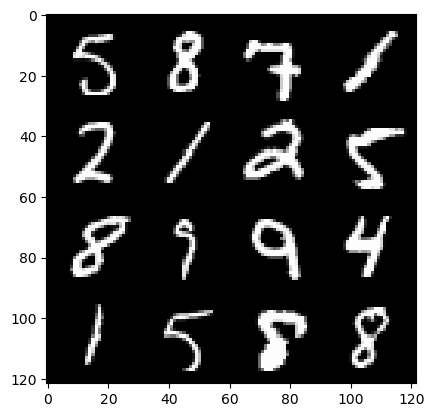

467: step 219300/ Gen loss: 1.9253255244096112/ disc_loss: 0.2996332750221095


  0%|          | 0/469 [00:00<?, ?it/s]

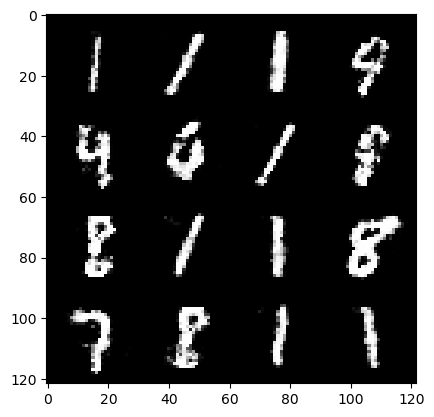

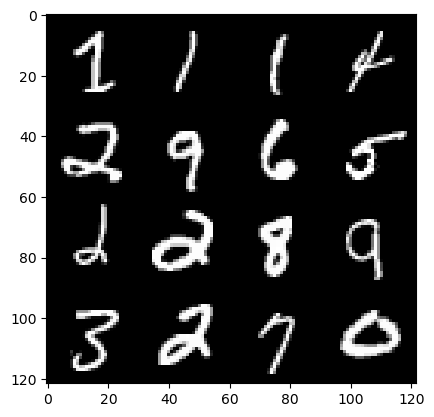

468: step 219600/ Gen loss: 1.915465004841487/ disc_loss: 0.30343036115169514


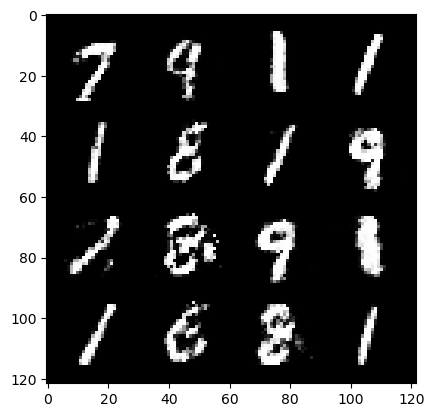

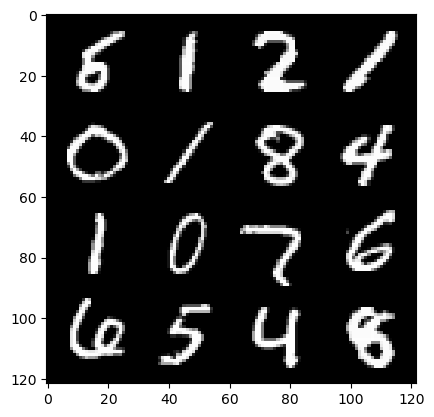

468: step 219900/ Gen loss: 1.941769931713738/ disc_loss: 0.31108573481440555


  0%|          | 0/469 [00:00<?, ?it/s]

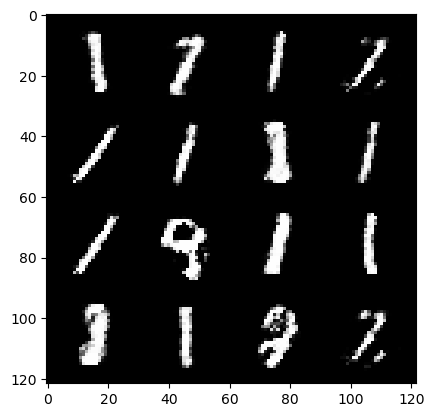

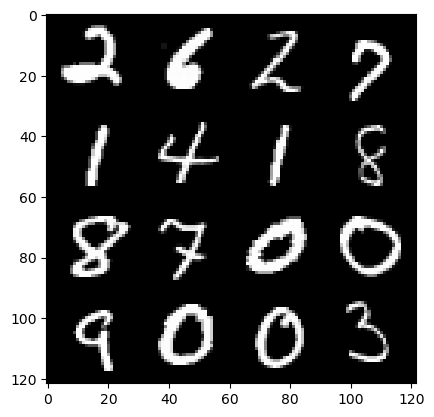

469: step 220200/ Gen loss: 2.024221473137537/ disc_loss: 0.2964644629259902


  0%|          | 0/469 [00:00<?, ?it/s]

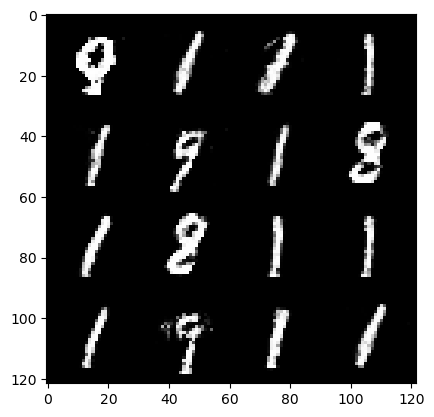

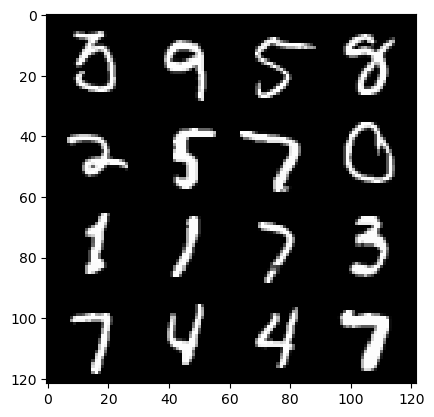

470: step 220500/ Gen loss: 1.9480734610557555/ disc_loss: 0.3131689313054084


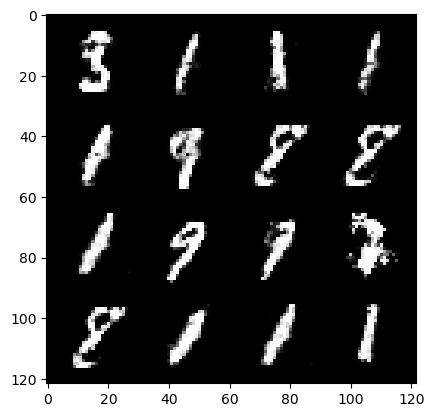

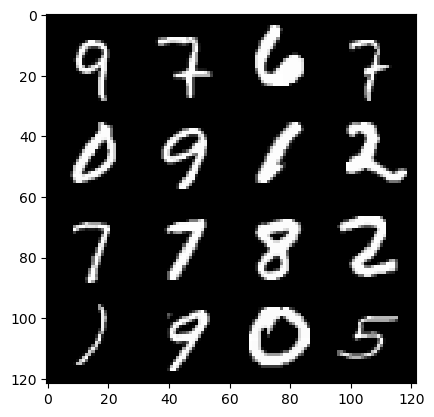

470: step 220800/ Gen loss: 1.9760776352882385/ disc_loss: 0.3071989862124127


  0%|          | 0/469 [00:00<?, ?it/s]

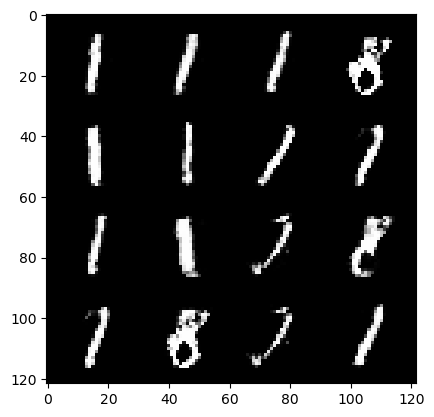

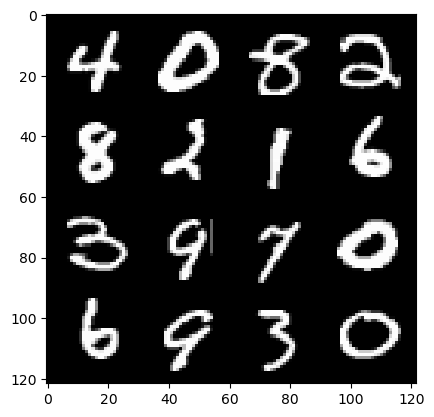

471: step 221100/ Gen loss: 2.029555246432622/ disc_loss: 0.29681733732422205


  0%|          | 0/469 [00:00<?, ?it/s]

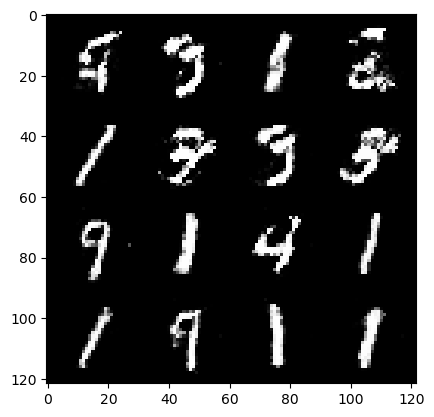

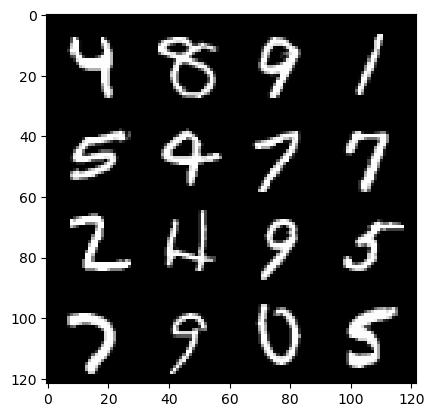

472: step 221400/ Gen loss: 2.0518975929419216/ disc_loss: 0.2897897002597649


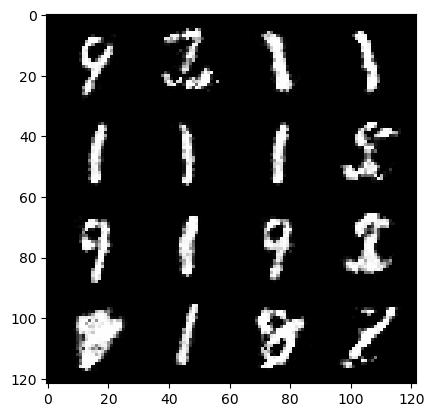

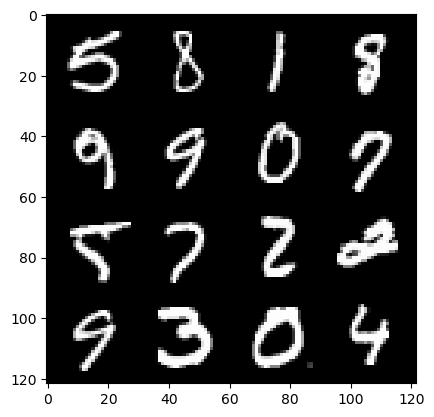

472: step 221700/ Gen loss: 2.0198276809851317/ disc_loss: 0.3037930017213027


  0%|          | 0/469 [00:00<?, ?it/s]

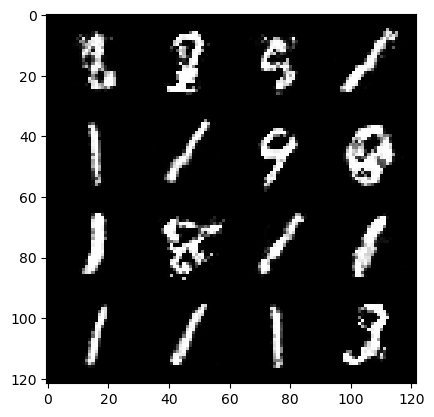

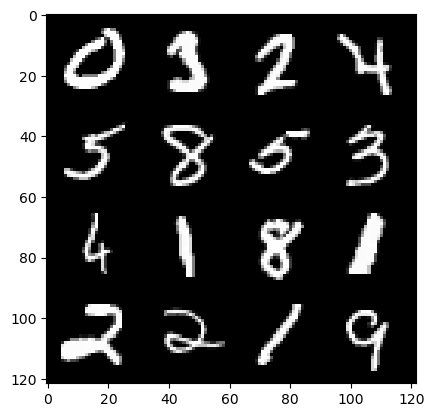

473: step 222000/ Gen loss: 2.1116920487085964/ disc_loss: 0.2754758064448833


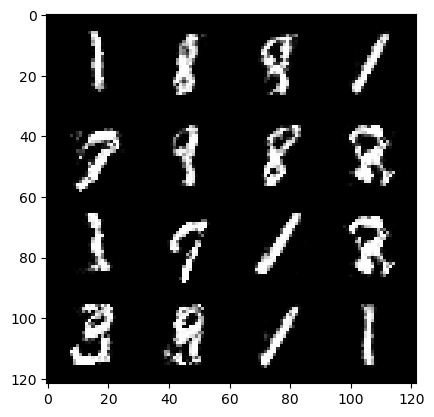

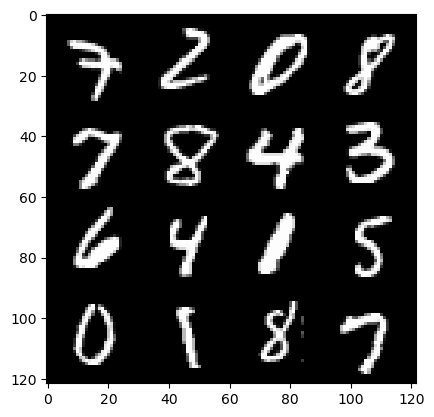

473: step 222300/ Gen loss: 1.9967320144176477/ disc_loss: 0.2906685287257035


  0%|          | 0/469 [00:00<?, ?it/s]

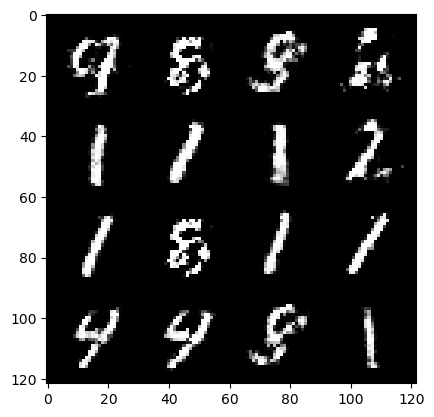

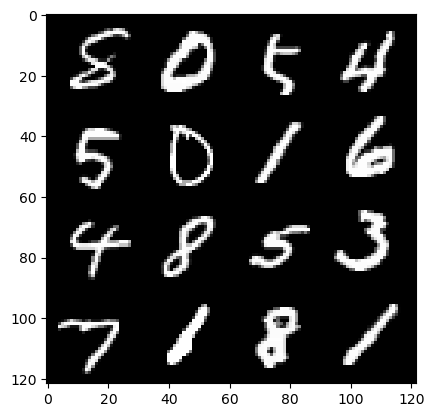

474: step 222600/ Gen loss: 2.053482694228492/ disc_loss: 0.30574419488509497


  0%|          | 0/469 [00:00<?, ?it/s]

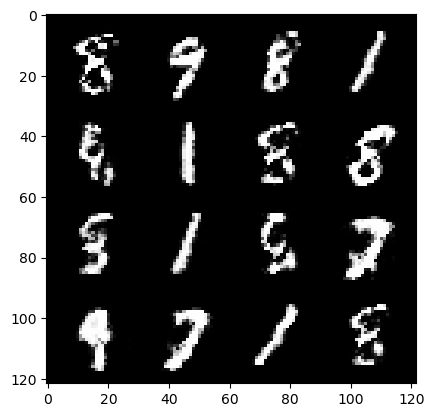

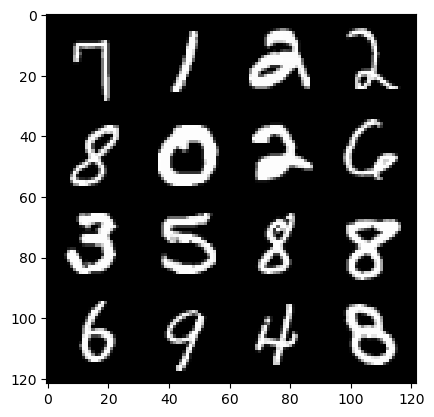

475: step 222900/ Gen loss: 2.054458849827449/ disc_loss: 0.2749223647018274


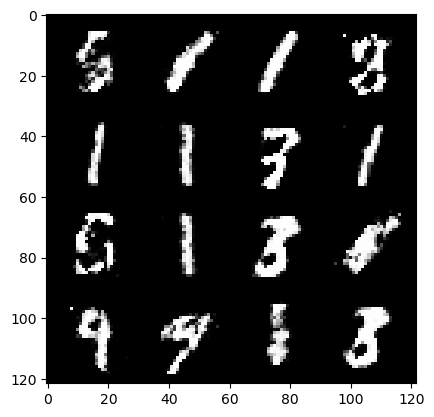

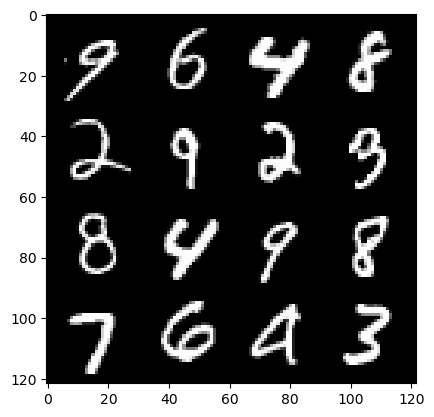

475: step 223200/ Gen loss: 2.016118702093759/ disc_loss: 0.3018450288971267


  0%|          | 0/469 [00:00<?, ?it/s]

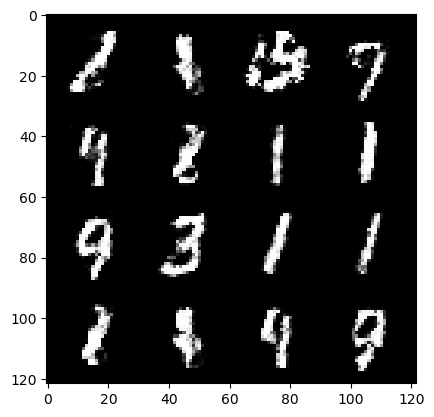

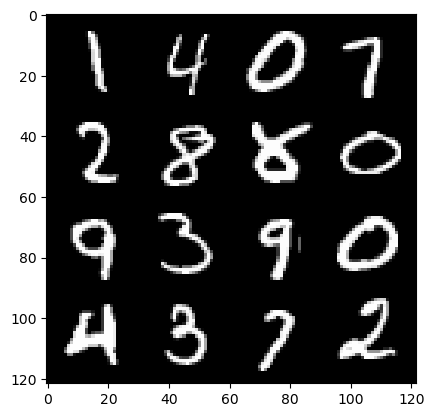

476: step 223500/ Gen loss: 2.1604205207029974/ disc_loss: 0.2743231585125129


  0%|          | 0/469 [00:00<?, ?it/s]

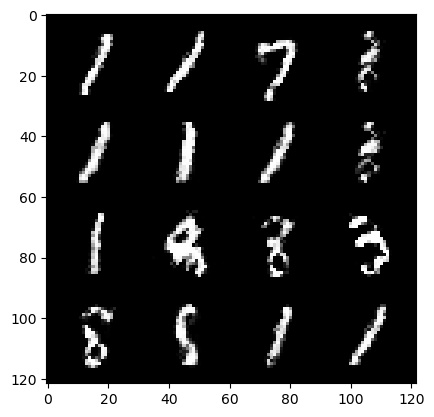

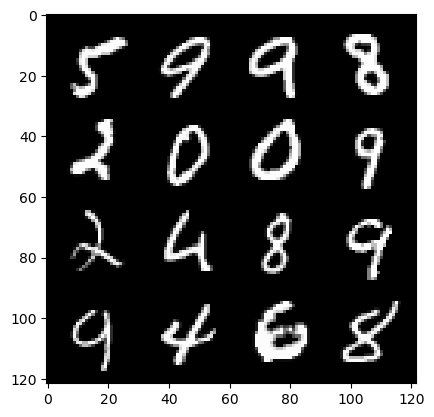

477: step 223800/ Gen loss: 2.0298944973945625/ disc_loss: 0.30407143423954647


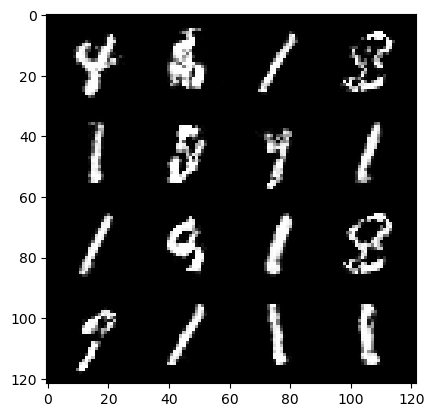

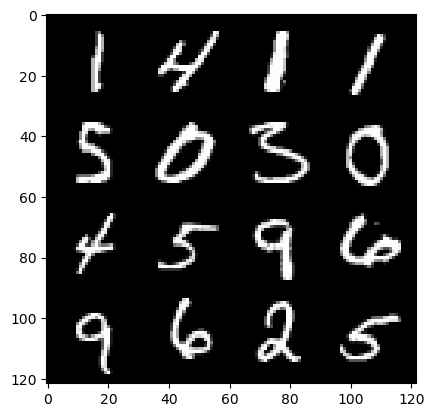

477: step 224100/ Gen loss: 2.0307692575454714/ disc_loss: 0.2889468046526114


  0%|          | 0/469 [00:00<?, ?it/s]

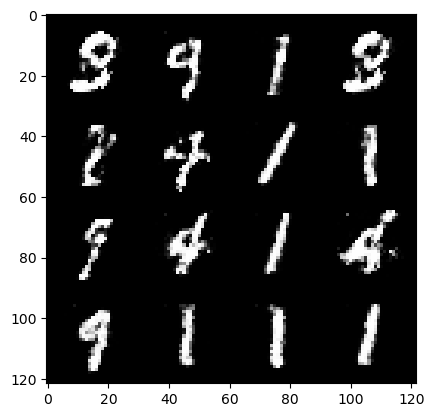

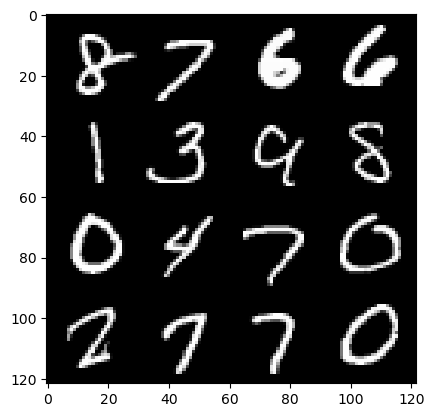

478: step 224400/ Gen loss: 2.0357342402140293/ disc_loss: 0.28220836778481806


  0%|          | 0/469 [00:00<?, ?it/s]

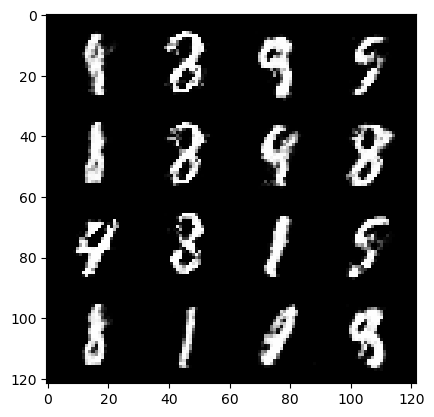

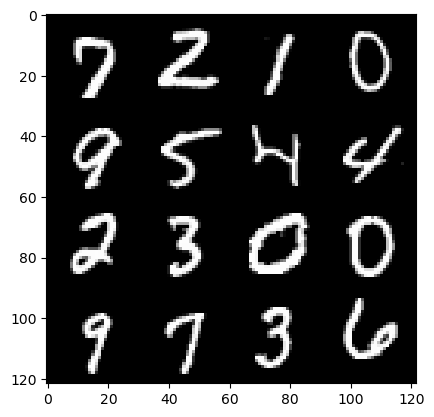

479: step 224700/ Gen loss: 2.1375612270832054/ disc_loss: 0.2624238984783492


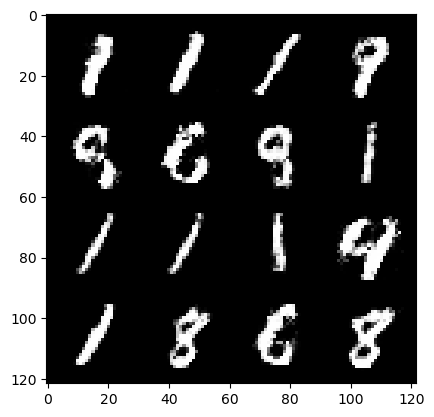

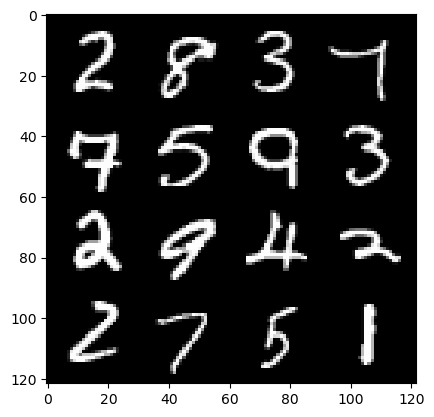

479: step 225000/ Gen loss: 2.2047880387306207/ disc_loss: 0.26286679257949197


  0%|          | 0/469 [00:00<?, ?it/s]

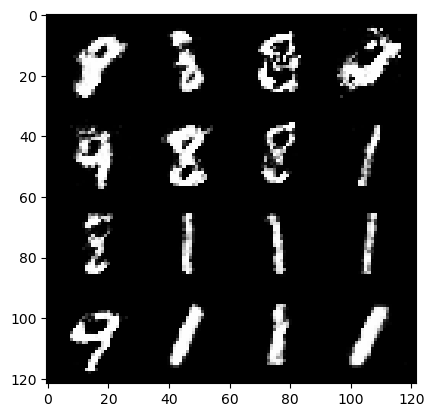

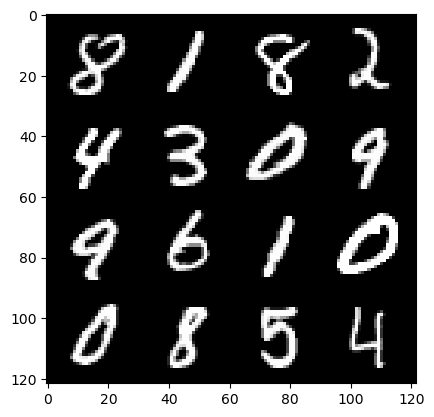

480: step 225300/ Gen loss: 2.1182930072148642/ disc_loss: 0.29226366152365996


  0%|          | 0/469 [00:00<?, ?it/s]

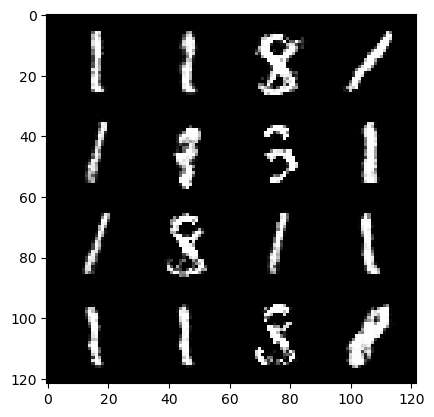

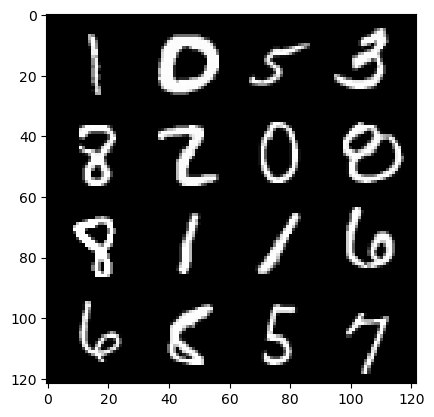

481: step 225600/ Gen loss: 2.115553562641143/ disc_loss: 0.2687456547220547


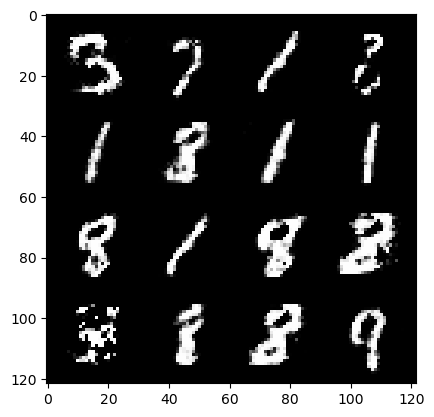

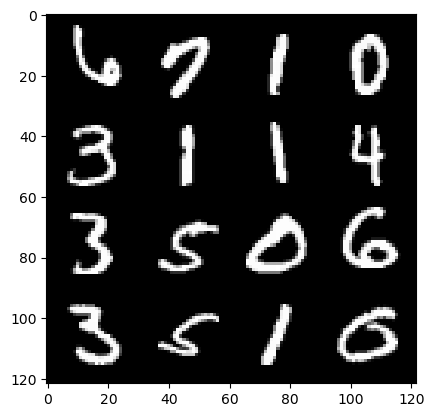

481: step 225900/ Gen loss: 2.122229960759479/ disc_loss: 0.2860342154403525


  0%|          | 0/469 [00:00<?, ?it/s]

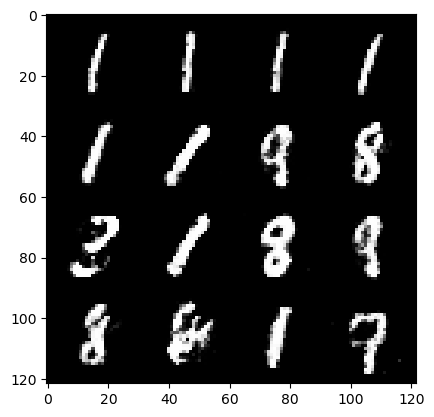

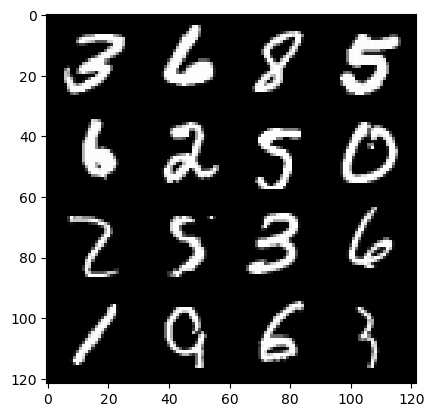

482: step 226200/ Gen loss: 2.2467133104801174/ disc_loss: 0.2679698711633681


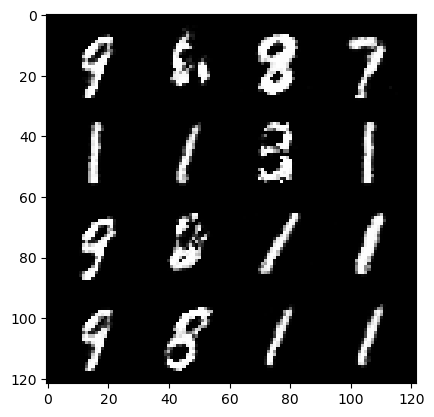

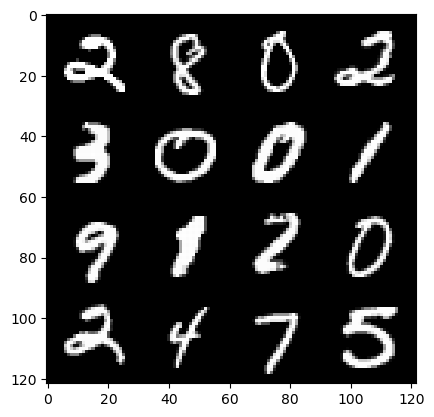

482: step 226500/ Gen loss: 2.117101513942081/ disc_loss: 0.2856936105092365


  0%|          | 0/469 [00:00<?, ?it/s]

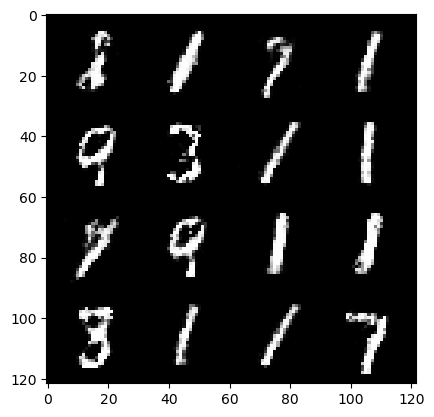

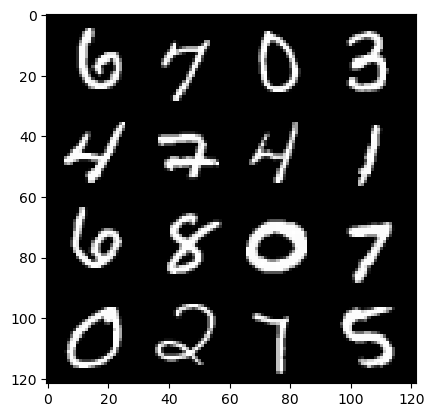

483: step 226800/ Gen loss: 2.090535420974096/ disc_loss: 0.28197753513852764


  0%|          | 0/469 [00:00<?, ?it/s]

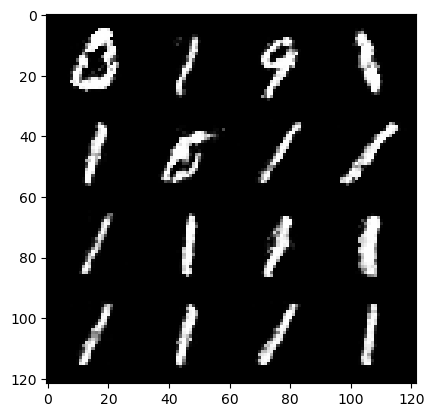

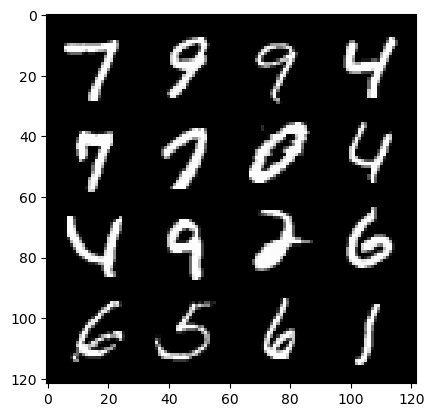

484: step 227100/ Gen loss: 2.0706662277380623/ disc_loss: 0.2853907324373721


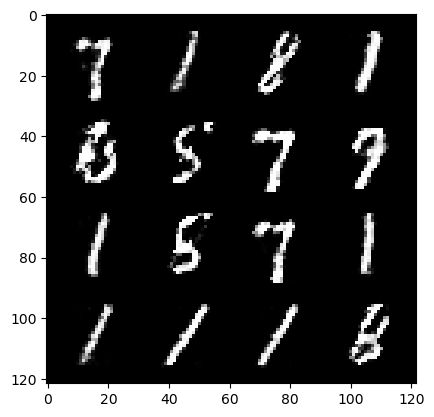

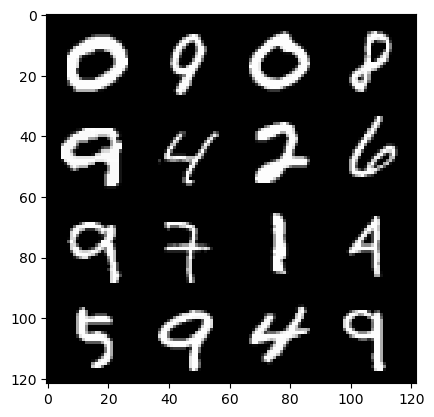

484: step 227400/ Gen loss: 2.0255769860744484/ disc_loss: 0.30198976481954243


  0%|          | 0/469 [00:00<?, ?it/s]

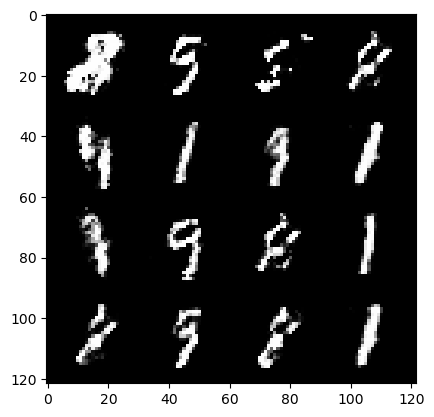

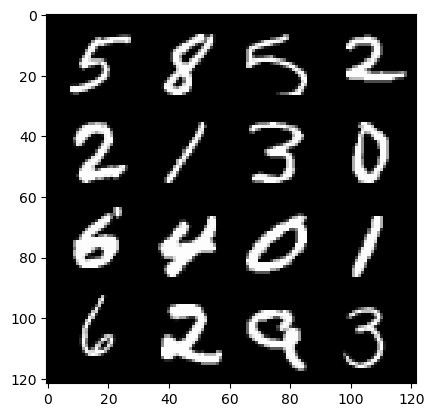

485: step 227700/ Gen loss: 1.983499543666839/ disc_loss: 0.288932935645183


  0%|          | 0/469 [00:00<?, ?it/s]

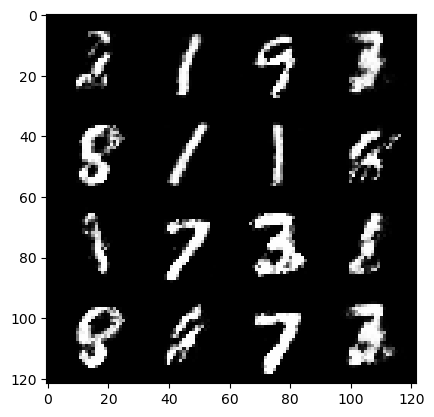

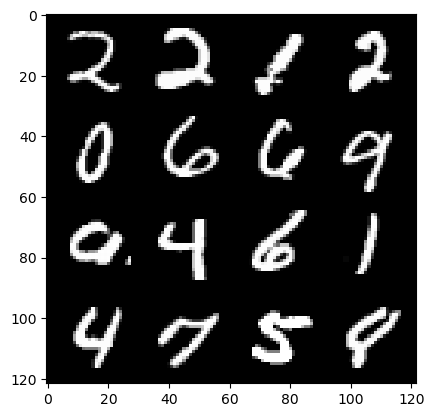

486: step 228000/ Gen loss: 2.048835792541503/ disc_loss: 0.2904659747083982


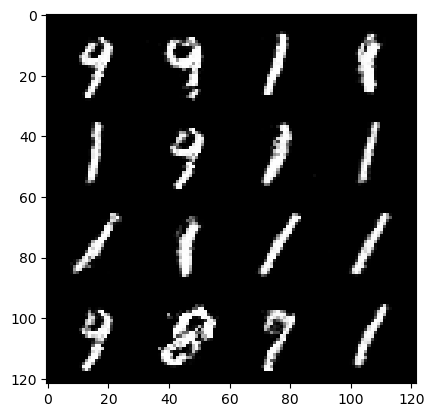

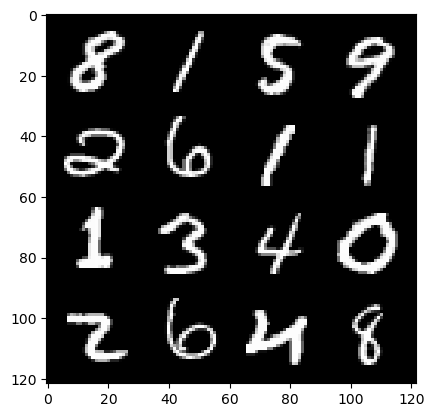

486: step 228300/ Gen loss: 2.040948951641717/ disc_loss: 0.2873125690221787


  0%|          | 0/469 [00:00<?, ?it/s]

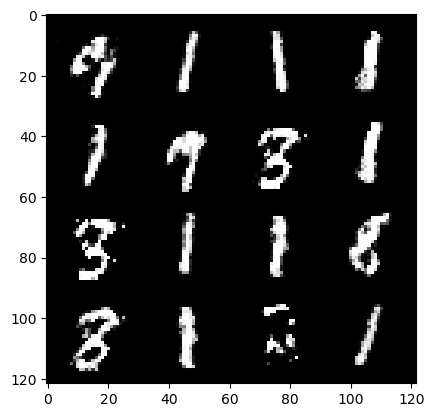

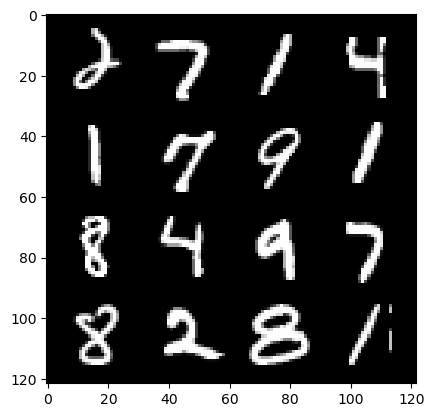

487: step 228600/ Gen loss: 2.0657087739308673/ disc_loss: 0.2939400828381377


  0%|          | 0/469 [00:00<?, ?it/s]

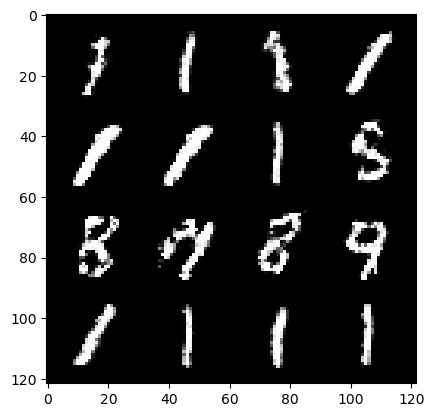

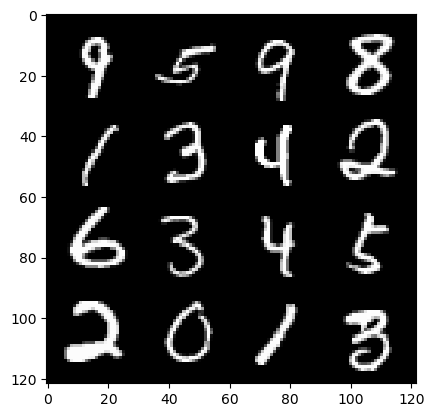

488: step 228900/ Gen loss: 2.0612995107968652/ disc_loss: 0.2930655088524026


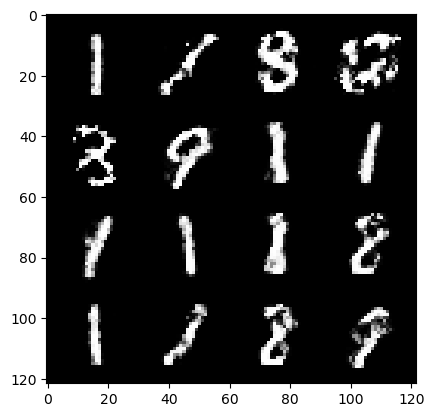

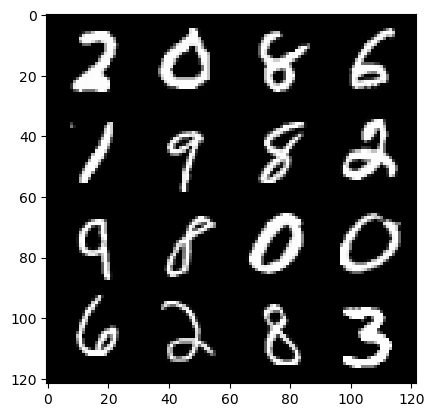

488: step 229200/ Gen loss: 2.084422010183334/ disc_loss: 0.28310562690099067


  0%|          | 0/469 [00:00<?, ?it/s]

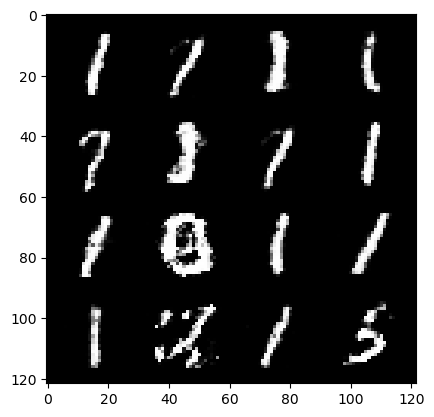

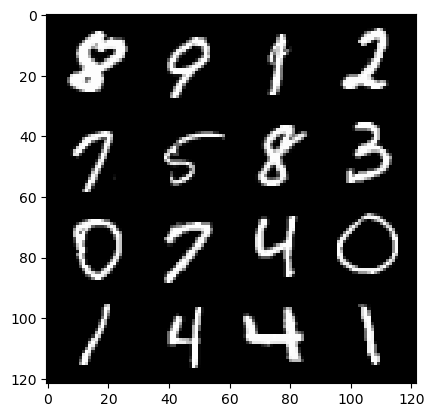

489: step 229500/ Gen loss: 2.1076430217425024/ disc_loss: 0.2871415543556216


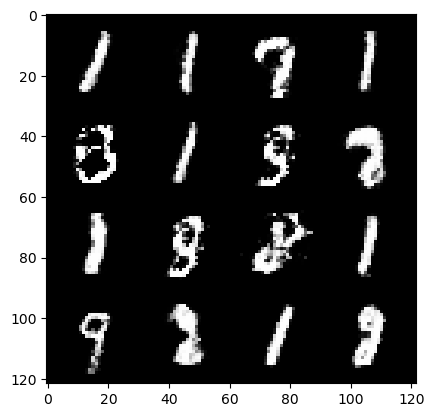

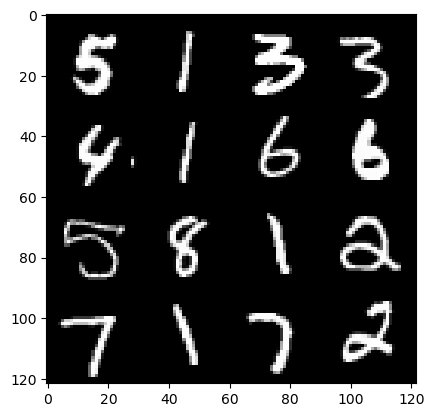

489: step 229800/ Gen loss: 2.034900230964025/ disc_loss: 0.3016233714918294


  0%|          | 0/469 [00:00<?, ?it/s]

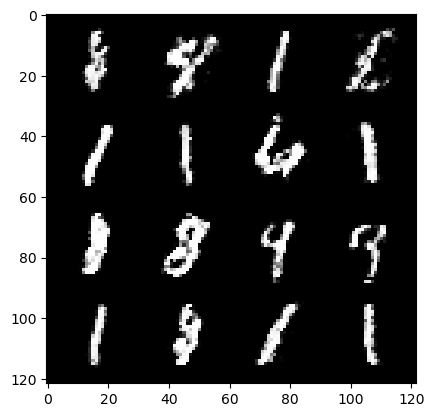

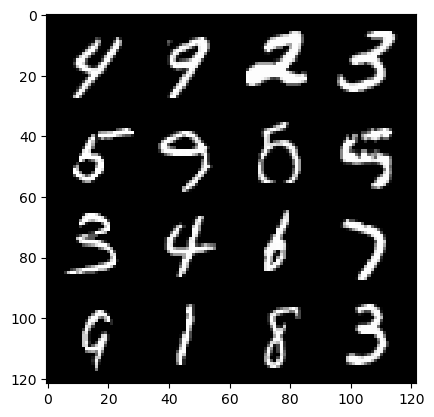

490: step 230100/ Gen loss: 2.0649755720297502/ disc_loss: 0.28515244846542676


  0%|          | 0/469 [00:00<?, ?it/s]

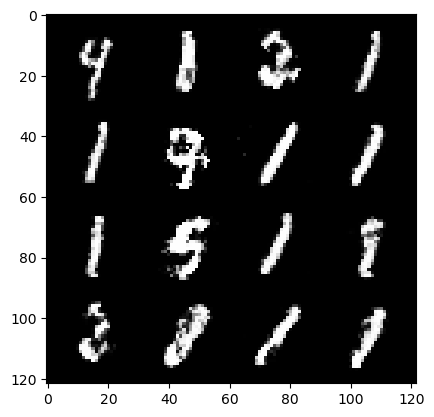

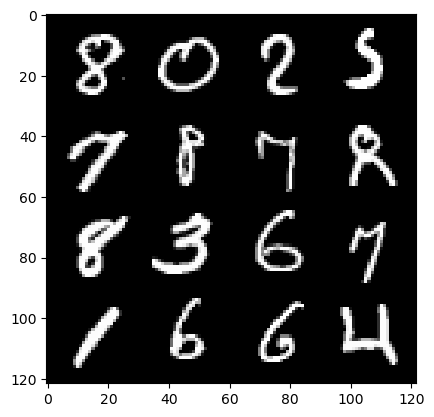

491: step 230400/ Gen loss: 2.0255474082628884/ disc_loss: 0.30408708825707437


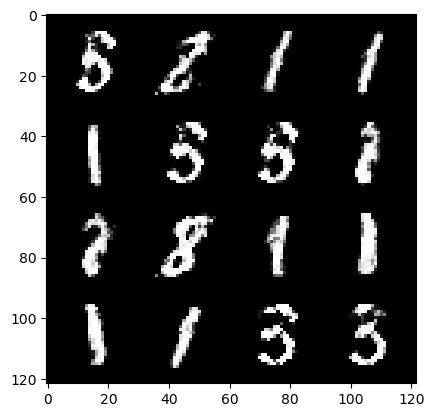

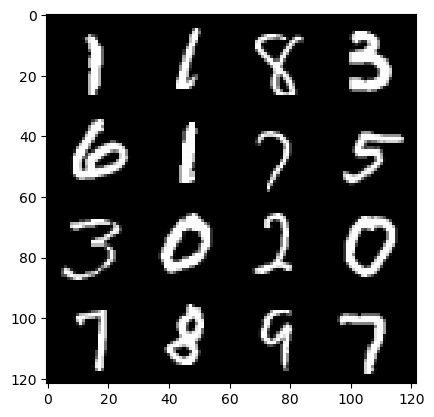

491: step 230700/ Gen loss: 2.0446379840374016/ disc_loss: 0.2835268799463908


  0%|          | 0/469 [00:00<?, ?it/s]

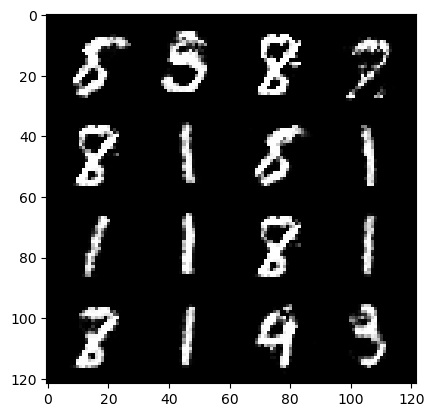

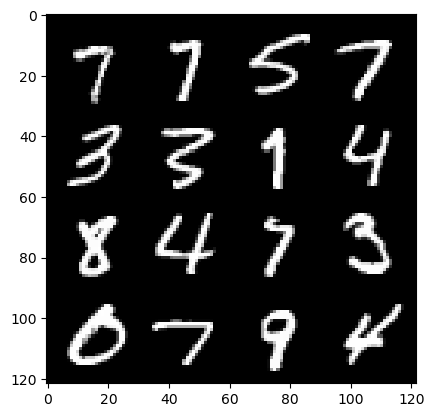

492: step 231000/ Gen loss: 2.009090068737667/ disc_loss: 0.28801303426424657


  0%|          | 0/469 [00:00<?, ?it/s]

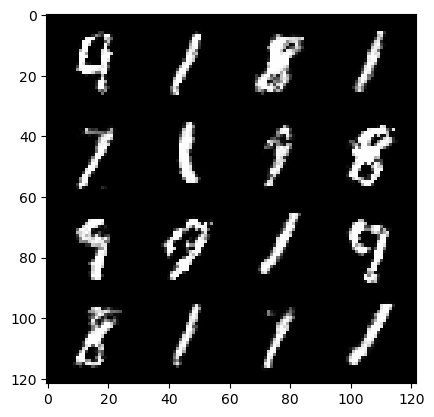

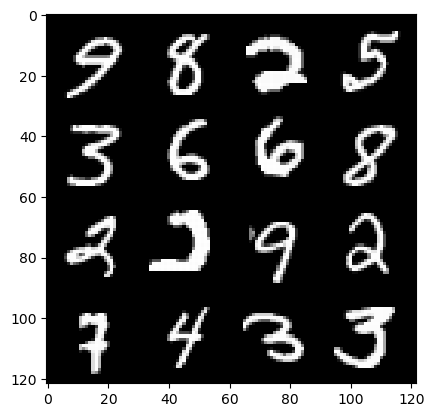

493: step 231300/ Gen loss: 2.072164722681048/ disc_loss: 0.2832403695583341


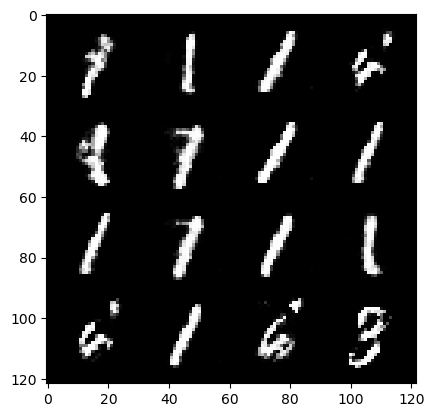

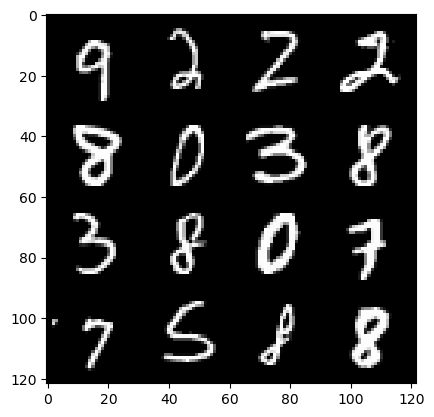

493: step 231600/ Gen loss: 2.0631111812591554/ disc_loss: 0.3136199330786866


  0%|          | 0/469 [00:00<?, ?it/s]

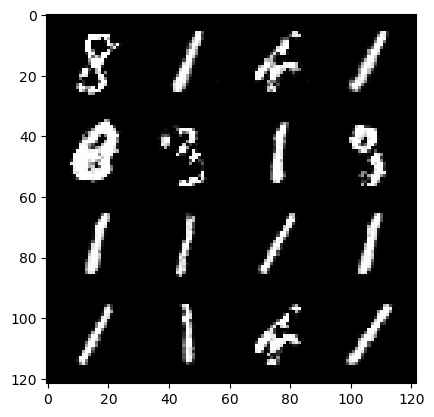

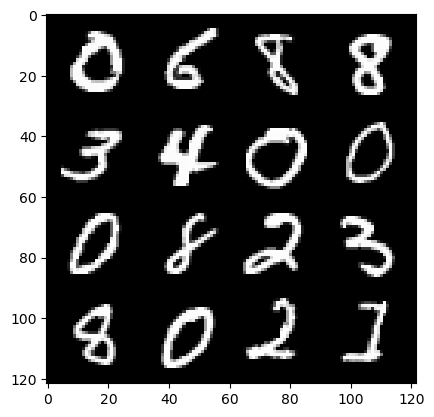

494: step 231900/ Gen loss: 2.1216268042723323/ disc_loss: 0.2769642263650892


  0%|          | 0/469 [00:00<?, ?it/s]

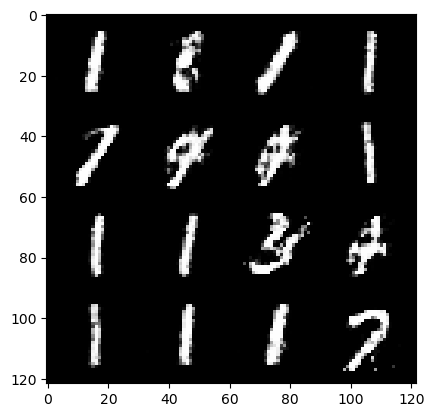

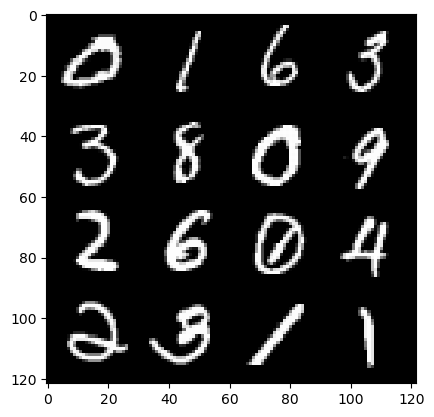

495: step 232200/ Gen loss: 2.0593822614351915/ disc_loss: 0.26935765549540513


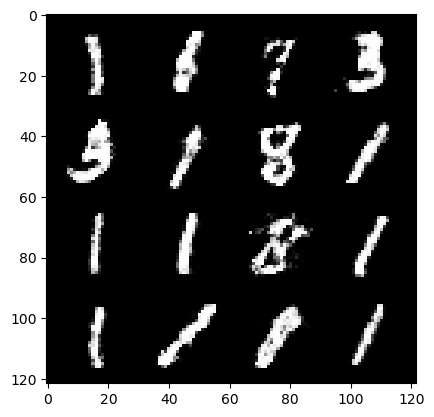

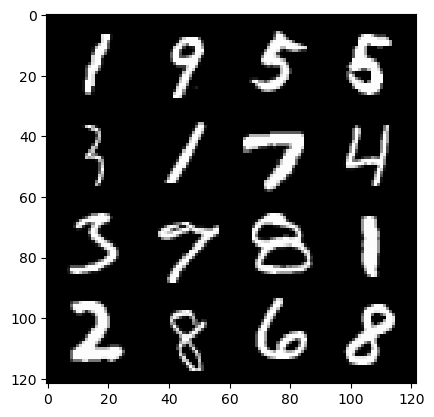

495: step 232500/ Gen loss: 2.0559769586722063/ disc_loss: 0.27509531691670414


  0%|          | 0/469 [00:00<?, ?it/s]

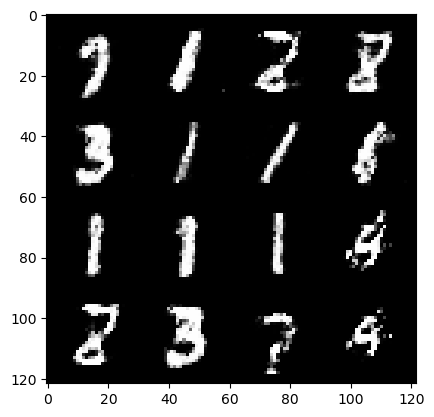

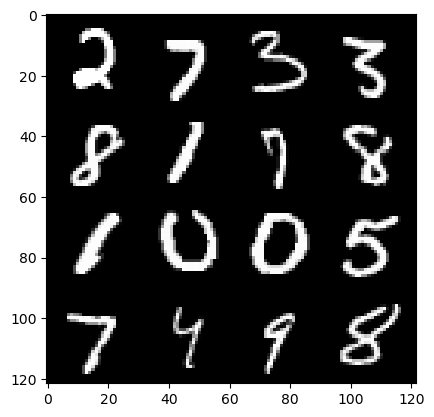

496: step 232800/ Gen loss: 2.0856176495552075/ disc_loss: 0.26631248787045453


  0%|          | 0/469 [00:00<?, ?it/s]

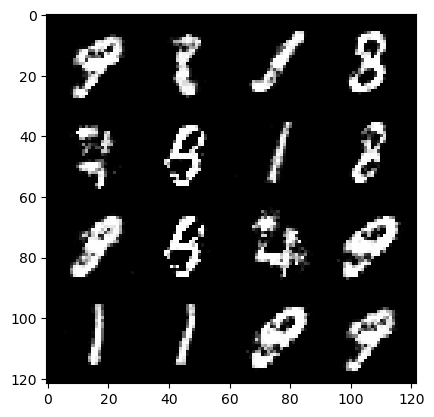

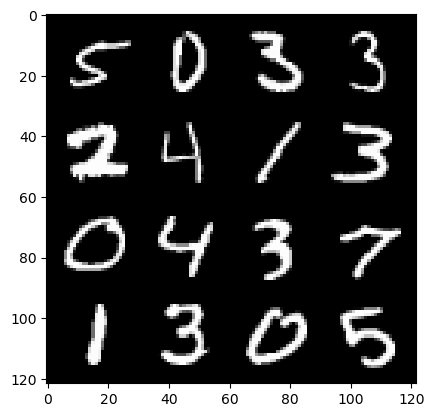

497: step 233100/ Gen loss: 2.069175165891646/ disc_loss: 0.27672295341889064


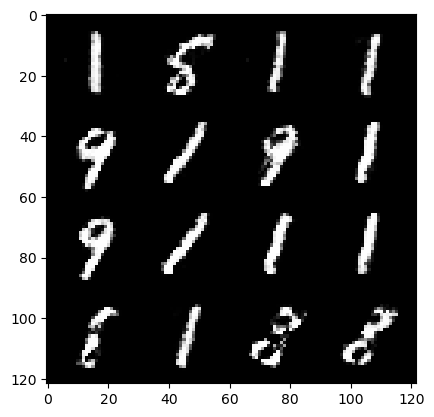

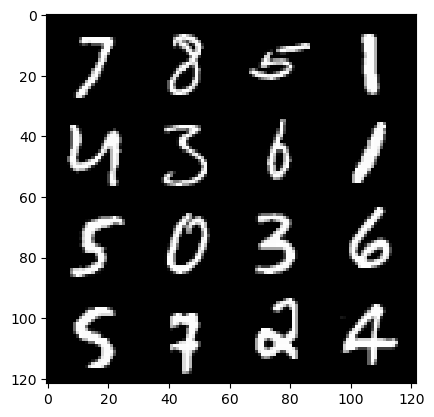

497: step 233400/ Gen loss: 2.016843092044194/ disc_loss: 0.2885497091710569


  0%|          | 0/469 [00:00<?, ?it/s]

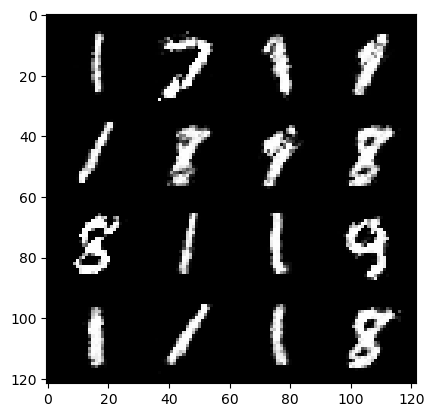

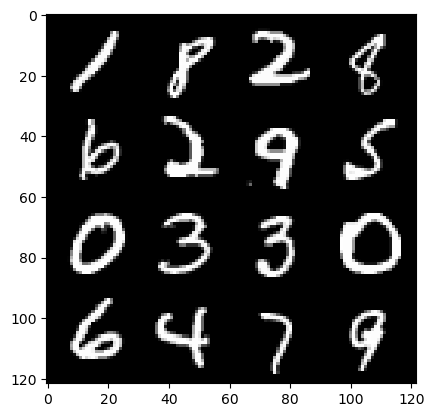

498: step 233700/ Gen loss: 2.0243640943368266/ disc_loss: 0.29278013875087083


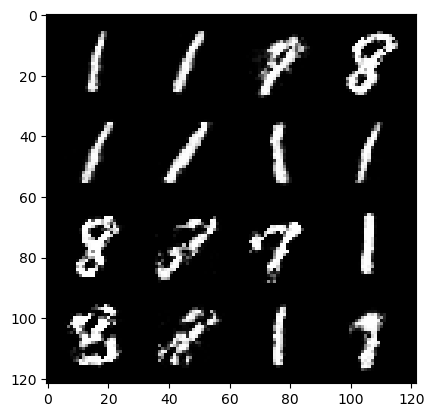

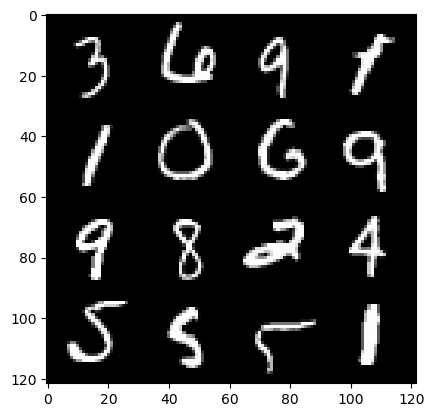

498: step 234000/ Gen loss: 1.974001111984252/ disc_loss: 0.28899848967790626


  0%|          | 0/469 [00:00<?, ?it/s]

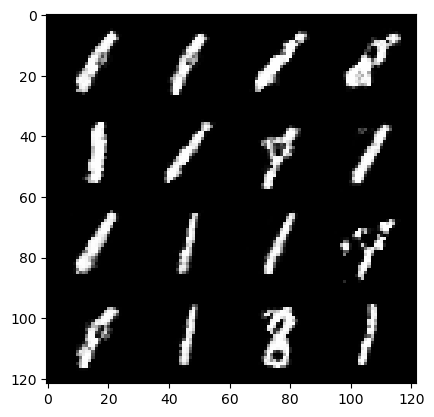

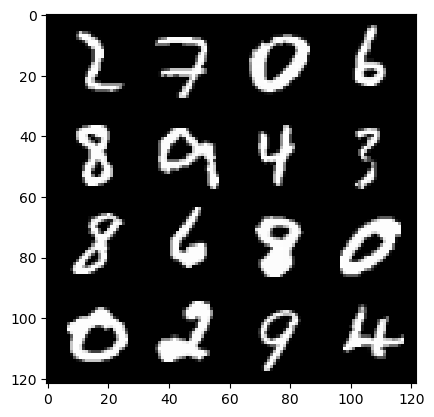

499: step 234300/ Gen loss: 1.9661524180571237/ disc_loss: 0.2939945295453073


In [14]:
for epoch in range(epochs):
      for real, _ in tqdm(dataloader):
            
        ### discriminator
        disc_opt.zero_grad()#take the discriminator optimzer and set its gradient to zero

        cur_bs = len(real) # size of real : 128 x 1 x 28 x 28, cur_bs = current batch_size
        real = real.view(cur_bs, -1) # resize it to  128 x 728, -1 shows that we are concentrating the size from after 128 to just one dimension
        real = real.to(device)

        disc_loss = calc_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)

        disc_loss.backward(retain_graph = True) # if you don't use retain_graph the graph bein 
        #used to compure the gradinet is gonna be freed. It wont be availabvle fo reuse by other variables.
        disc_opt.step()

        ###  generator
        gen_opt.zero_grad() #set the gradient values to 0 at the beginning
        gen_loss = calc_gen_loss(loss_func, gen, disc, cur_bs, z_dim) # we don't need real images here
        gen_loss.backward(retain_graph = True)
        gen_opt.step()

        ### visualization & stats
        mean_disc_loss += disc_loss.item()/info_step
        mean_gen_loss += gen_loss.item()/info_step # this is going to adding the values in  proportion to 
        #period  in which we are going to visualize info. Every 300 steps we are going to visualize the 
        # average of discriminator loss and generator loss.

        if cur_step % info_step == 0 and cur_step>0:# when do we show the info as visualization
            fake_noise = gen_noise(cur_bs, z_dim)
            fake = gen(fake_noise)
            show(fake)
            show(real)
            print(f"{epoch}: step {cur_step}/ Gen loss: {mean_gen_loss}/ disc_loss: {mean_disc_loss}")
            mean_gen_loss, mean_disc_loss = 0,0 

        cur_step+=1




